### Intended as a script which generates a .cvs report in one run

In [1]:
import tensorflow as tf;
import numpy as np;
import matplotlib.pyplot as plt;
print(tf.__version__);
import pandas as pd;

from sklearn.preprocessing import StandardScaler;
from sklearn.metrics import mean_squared_error;

2.3.0


In [2]:
pd.set_option('display.max_columns', 300);
pd.set_option('display.max_rows', 300);
tf.keras.backend.set_floatx('float64');

In [3]:
from tensorflow.python.client import device_lib

def get_available_gpus():
    local_device_protos = device_lib.list_local_devices()
    return [x.name for x in local_device_protos if x.device_type == 'GPU']

get_available_gpus()

[]

In [4]:
MONTHS = 72;
SPLIT = 60; # 2014-2018: training, 2019: testing.
# BATCH_SIZE = 19; # used in NN_v1
BATCH_SIZE = 24;
WINDOW_SIZE = 12;

TEST_LENGTH = MONTHS - SPLIT;

### Data preparation

In [5]:
multi_data = pd.read_csv('../data/zri_acs_bikeshare_merged.csv', index_col = 0);
zip_ids = multi_data.index.unique();

multi_data.drop(["City", "State", "Metro", "CountyName", "year", "month", "datetime"],\
                 axis = 1, inplace = True);

multi_data.head()

,zri,percent_white,percent_black,percent_asian,percent_hispanic,percent_native_am,percent_other_race,percent_0_17,percent_18_39,percent_40_64,percent_65+,percent_rental_units_vacant,percent_rental_units_occupied,percent_graduate_deg,percent_bachelors,percent_associates,percent_highschool,percent_less_highschool,percent_commute_public_transport,percent_commute_less_30,percent_buildings_less_10_units,percent_buildings_10_19_units,percent_buildings_20_49_units,percent_buildings_50+_units,percent_commute_30_to_59,percent_commute_60_to_89,percent_commute_90_more,percent_new_city,percent_new_unit,percent_units_owner_occupied,median_building_age,income_per_capita,poverty_rate,total_pop,percent_workforce_unemployed,percent_work_from_home,median_age,percent_female,gini_index,percent_not_us_citizen,bs_total_stations,bs_total_systems,has_bike_sharing
zip,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
1013,928.0,0.728315,0.020951,0.013732,0.219830,0.0,0.004959,0.230010,0.311464,0.309663,0.148864,0.068131,0.931869,0.028046,0.056892,0.259500,0.384872,0.225671,0.023499,0.741732,0.890613,0.030177,0.034856,0.044355,0.227721,0.017344,0.013031,0.108543,0.040940,0.443651,62.0,20475.25,0.191440,22343.583333,0.104130,0.009346,36.416667,0.509533,0.420742,0.056062,0.0,0.0,0
1013,931.0,0.727052,0.021179,0.013708,0.220867,0.0,0.004917,0.229526,0.311552,0.310406,0.148516,0.067207,0.932793,0.028179,0.057377,0.259450,0.384586,0.225073,0.023365,0.740587,0.889943,0.030154,0.035083,0.044820,0.227757,0.017701,0.013401,0.108828,0.040926,0.441963,62.0,20517.50,0.192359,22296.166667,0.104147,0.009839,36.433333,0.508816,0.420483,0.056165,0.0,0.0,0
1013,934.0,0.725788,0.021408,0.013685,0.221904,0.0,0.004874,0.229041,0.311641,0.311150,0.148168,0.066283,0.933717,0.028313,0.057863,0.259400,0.384301,0.224475,0.023230,0.739441,0.889273,0.030131,0.035311,0.045285,0.227792,0.018058,0.013771,0.109112,0.040912,0.440275,62.0,20559.75,0.193277,22248.750000,0.104165,0.010332,36.450000,0.508100,0.420225,0.056267,0.0,0.0,0
1013,929.0,0.724525,0.021636,0.013661,0.222940,0.0,0.004832,0.228557,0.311729,0.311894,0.147820,0.065359,0.934641,0.028446,0.058348,0.259350,0.384016,0.223877,0.023096,0.738295,0.888603,0.030108,0.035538,0.045750,0.227828,0.018415,0.014142,0.109397,0.040897,0.438587,62.0,20602.00,0.194196,22201.333333,0.104182,0.010825,36.466667,0.507383,0.419967,0.056370,0.0,0.0,0
1013,929.0,0.723261,0.021864,0.013638,0.223977,0.0,0.004789,0.228072,0.311818,0.312638,0.147472,0.064435,0.935565,0.028579,0.058833,0.259299,0.383730,0.223279,0.022961,0.737149,0.887934,0.030086,0.035766,0.046215,0.227864,0.018772,0.014512,0.109682,0.040883,0.436898,62.0,20644.25,0.195114,22153.916667,0.104199,0.011318,36.483333,0.506666,0.419708,0.056472,0.0,0.0,0


In [6]:
FEATURES = multi_data.shape[1] - 1;

### Utility functions

In [7]:
@tf.autograph.experimental.do_not_convert
def windowed_dataset(series, window_size, batch_size, shuffle_buffer):
    dataset = tf.data.Dataset.from_tensor_slices(series); #(43,)
    dataset = dataset.window(window_size + 1, shift=1, drop_remainder=True);
    dataset = dataset.flat_map(lambda window: window.batch(window_size + 1)); #(13,43)
    dataset = dataset.shuffle(shuffle_buffer)\
                     .map(lambda window: (window[:-1], window[-1][0]));
    dataset = dataset.batch(batch_size).prefetch(1);
    return dataset;

In [8]:
def plot_series(time, series, format="-", start=0, end=None):
    plt.plot(time[start:end], series[start:end], format)
    plt.xlabel("Time Frame")
    plt.ylabel("ZRI")
    plt.grid(True)

### Neural network center

In [9]:
class myCallbacks(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs={}):
        mse = logs.get("mse");
        if(mse < 0.01):
            print("\nGot an mse at {:.4f} in round {} and stopped training\n".format(mse, epoch));
            self.model.stop_training = True;

In [10]:
def NN_model(dataset, test = None):
    tf.keras.backend.clear_session();
    # dataset = windowed_dataset(x_train, window_size, batch_size, shuffle_buffer_size)

    callback = myCallbacks();
    
    model = tf.keras.models.Sequential([
#         tf.keras.layers.Lambda(lambda x: tf.expand_dims(x, axis=-1),
#                           input_shape=[None]),
#       tf.keras.layers.Conv1D(filters=32, kernel_size=3,
#                           strides=1, padding="causal",
#                           activation="relu",
#                           input_shape=[None, WINDOW_SIZE, FEATURES+1]),
        tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True, input_shape = [None, WINDOW_SIZE, FEATURES+1])),
        #tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(16, return_sequences=True)),
        # tf.keras.layers.SimpleRNN(8, return_sequences=True),
        #  tf.keras.layers.SimpleRNN(16, return_sequences=True),
        tf.keras.layers.Dense(8, activation="relu"),
    #   tf.keras.layers.Dense(16, activation="relu"),
        tf.keras.layers.Dense(1)
        # tf.keras.layers.Lambda(lambda x: x * 2.0)
    ]);
    
    optimizer = tf.keras.optimizers.SGD(learning_rate=3e-4, momentum=0.9)
    model.compile(loss=tf.keras.losses.Huber(),
                  optimizer="adam",
                  metrics=["mae", "mse"])

    model.build((None,12,43))
    # model.summary()

    if not test: history = model.fit(dataset, epochs=500, callbacks = [callback], verbose = 0);
    else: history = model.fit(dataset, epochs=500, validation_data=test,\
                              callbacks=[callback], verbose = 0);
    return model;

In [11]:
def NN_forecast(model, series_transformed):
    forecast = []
    results = []
    for time in range(MONTHS - WINDOW_SIZE):
        forecast.append(model.predict(series_transformed[np.newaxis, time:time + WINDOW_SIZE, :]))

    results = [float(x[0][0]) for x in forecast];
    timeline = range(WINDOW_SIZE, MONTHS);
    time_test = range(SPLIT, MONTHS);
    actual = list(series_transformed[WINDOW_SIZE:, 0]);

    forecast = series_transformed[SPLIT - WINDOW_SIZE:,:].copy();

    for time in range(TEST_LENGTH): # Change temp[time + WINDOW_SIZE]
        forecast[time + WINDOW_SIZE, 0] =\
        model.predict(forecast[np.newaxis, time:time + WINDOW_SIZE, :])[0][0];

    pure_forecast = forecast[WINDOW_SIZE:,0];
    
    print(len(results), len(actual), len(pure_forecast))
    
    return results, actual, pure_forecast;

In [12]:
@tf.autograph.experimental.do_not_convert
def NN_test(ZONE, plot=False):
    '''
    Input: ZONE
    Output: the RMSE of a NN model on the predicted train, partially predicted test, and complete predicted test.
    '''
    # Collection of data
    series_frame = multi_data[multi_data.index == ZONE];
    # series_frame.sort_values("datetime", ascending = True, inplace = True);
    
    # Standardization
    scaler = StandardScaler();
    series_transformed = scaler.fit_transform(series_frame);
    
    # Train test split
    series_train = series_transformed[:SPLIT];
    series_test = series_transformed[SPLIT-WINDOW_SIZE:];
    
    # Window the training set to make input of the NN
    dataset_train = windowed_dataset(series_train, WINDOW_SIZE, BATCH_SIZE, 60);
    # dataset_test = windowed_dataset(series_test, WINDOW_SIZE, BATCH_SIZE, 60);
    
    model = NN_model(dataset_train);
    
    time_train = list(range(SPLIT));
    time_test = list(range(SPLIT, MONTHS));
    
    # Forecasting
    results, actual, pure_forecast = NN_forecast(model, series_transformed);
    
    # Compute MSE
    MSE_train = mean_squared_error(actual[:-TEST_LENGTH], results[:-TEST_LENGTH])**0.5 * scaler.var_[0]**0.5;
    MSE_test = mean_squared_error(actual[-TEST_LENGTH:], results[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    MSE_pure = mean_squared_error(actual[-TEST_LENGTH:], pure_forecast[-TEST_LENGTH:])**0.5 * scaler.var_[0]**0.5;
    
    if plot: # If the plot option is selected, plot the graph.
        time_actual = range(WINDOW_SIZE, MONTHS);
        plt.figure(figsize=(10, 6))
        plot_series(time_actual, actual);
        plot_series(time_actual, results);
        plot_series(time_test, pure_forecast);
        plt.show();

    return MSE_train, MSE_test, MSE_pure,\
        np.array(pure_forecast[-TEST_LENGTH:]) * scaler.var_[0]**0.5 + scaler.mean_[0];

### The script


Got an mse at 0.0099 in round 67 and stopped training

60 60 12


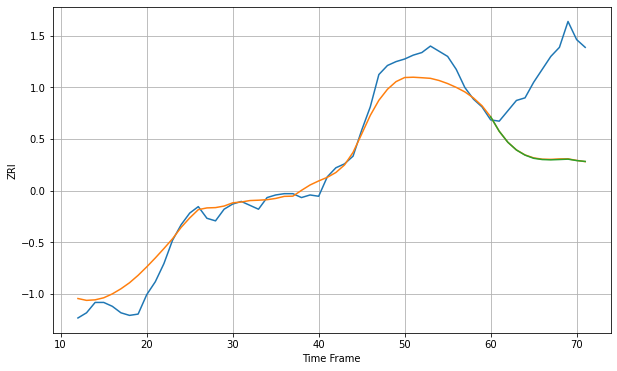

Wall time: 6.23 s
1013 12.452259584481887 66.93879515913535 67.11257084255794 [1101.39556287 1090.18947998 1081.72320991 1075.72536983 1071.7828104
 1069.32835845 1068.35861126 1068.12660118 1068.37686942 1068.66314919
 1067.58179498 1066.89293264]

Got an mse at 0.0099 in round 45 and stopped training

60 60 12


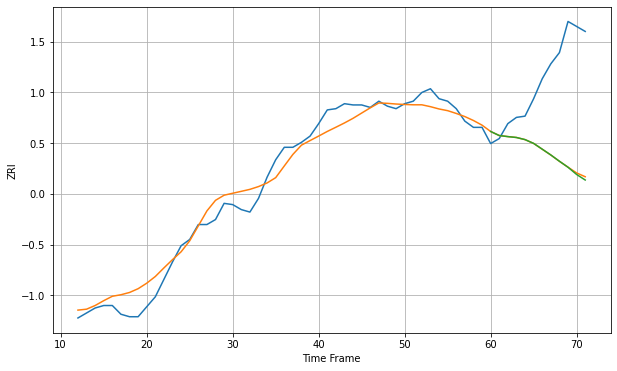

Wall time: 5.72 s
1020 10.361150327938452 70.35129846323515 70.88081219766659 [1124.70264992 1121.43946633 1120.57655567 1119.86684957 1118.17321378
 1115.13058434 1110.50367168 1105.85232685 1100.80111951 1095.97960849
 1090.18792846 1085.74040871]

Got an mse at 0.0098 in round 128 and stopped training

60 60 12


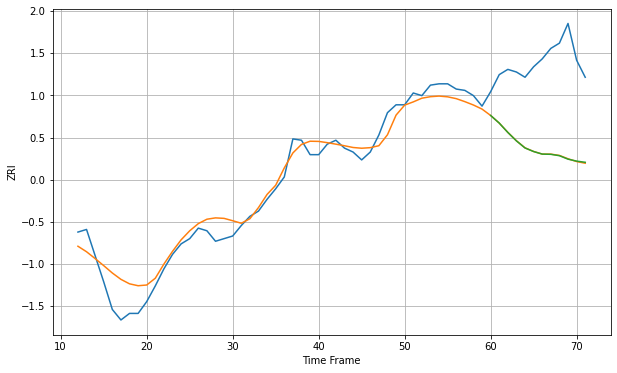

Wall time: 7.62 s
1040 10.922427618529637 66.94650512910074 66.95658527333224 [1093.87674904 1088.06557833 1080.94129105 1074.50305567 1069.10068207
 1066.38072737 1064.42951963 1064.26090748 1063.21419478 1060.5759723
 1059.08348243 1058.17645311]

Got an mse at 0.0099 in round 114 and stopped training

60 60 12


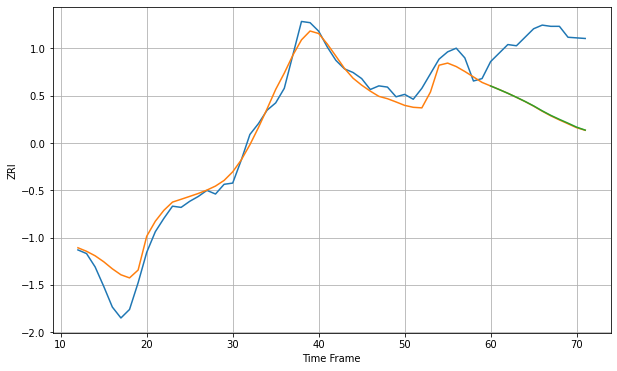

Wall time: 7.09 s
1085 11.220728831723582 60.68123885009969 60.42392507510565 [1151.9278057  1148.96793463 1145.90741997 1142.62161413 1139.20543485
 1135.52372726 1131.45092022 1127.72606975 1124.43768898 1121.30831254
 1118.0420237  1115.59093614]

Got an mse at 0.0099 in round 88 and stopped training

60 60 12


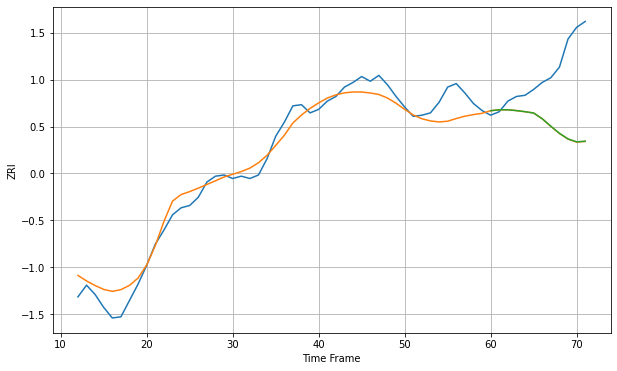

Wall time: 6.55 s
1104 11.67976750735435 53.27077698721438 53.17095530499812 [1116.84839696 1117.63354349 1117.63118919 1116.94857025 1116.00956687
 1114.890182   1109.99519024 1103.60260553 1097.56923912 1092.78283894
 1090.28314308 1090.8303765 ]

Got an mse at 0.0098 in round 65 and stopped training

60 60 12


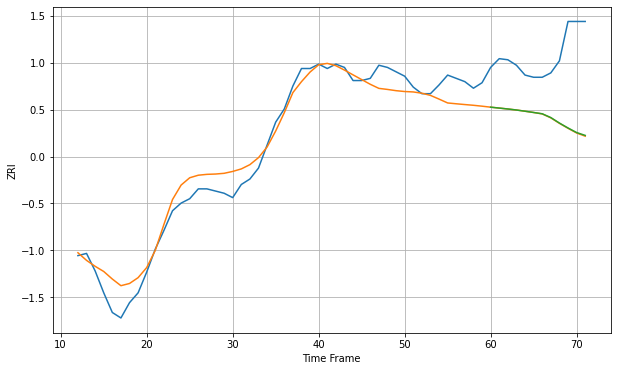

Wall time: 6 s
1108 14.223883188116957 62.03408916359618 61.79528239594129 [1161.664806   1160.83809583 1160.01150838 1159.08281201 1157.96873881
 1156.81707243 1155.63252266 1152.16869531 1147.15324963 1142.65151093
 1138.4845899  1135.86158401]

Got an mse at 0.0099 in round 66 and stopped training

60 60 12


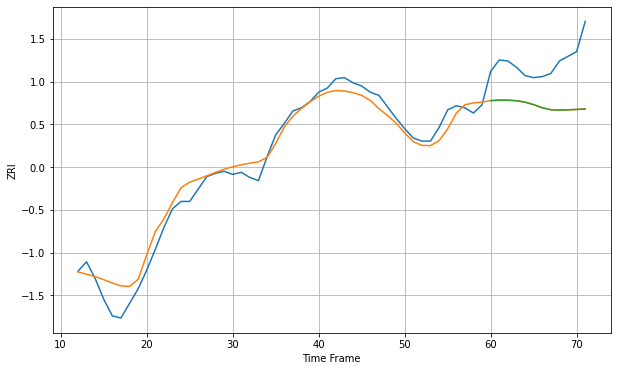

Wall time: 5.91 s
1109 11.443523596881239 43.91490243532603 43.99645519715382 [1160.90716807 1161.3868854  1161.35578396 1160.79509045 1159.40924848
 1157.01075354 1153.99023337 1152.12173062 1151.8034554  1152.09370119
 1152.41828379 1152.81580912]

Got an mse at 0.0099 in round 100 and stopped training

60 60 12


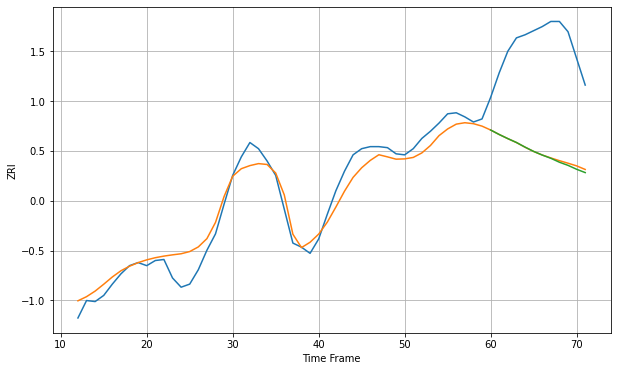

Wall time: 6.81 s
1420 13.074350529351959 105.7072864699612 106.57637326644698 [1220.19976887 1215.81741427 1211.80821652 1208.04644476 1203.54500539
 1199.35536021 1195.81450662 1192.6514893  1188.79705257 1185.75246604
 1181.9392447  1178.69567158]

Got an mse at 0.0098 in round 65 and stopped training

60 60 12


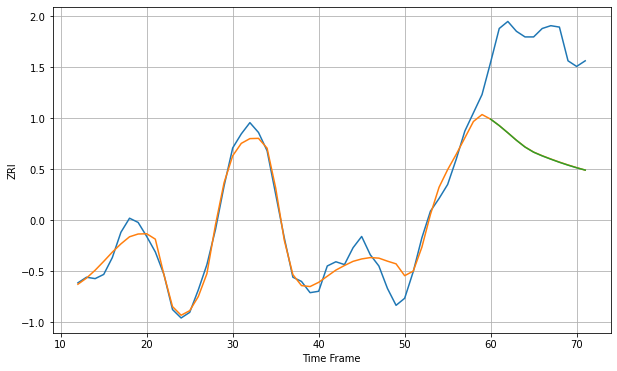

Wall time: 5.92 s
1440 8.456093869283528 78.89976677918689 78.97015726422735 [1174.48192876 1169.90366089 1164.76135413 1159.45237907 1154.63743304
 1150.97567657 1148.34341147 1146.00493165 1143.78928526 1141.75769848
 1139.88997125 1138.23512763]

Got an mse at 0.0099 in round 95 and stopped training

60 60 12


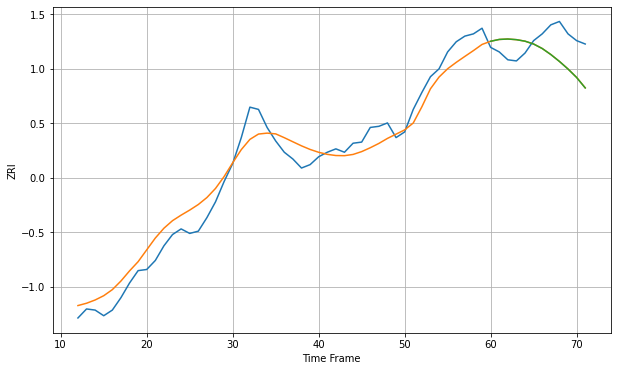

Wall time: 6.69 s
1453 13.840875146673515 23.492193891850086 23.528819151906625 [1324.43811404 1326.0532194  1326.42634176 1325.85850549 1324.5085089
 1321.98121071 1318.00339503 1312.66875759 1306.55272086 1299.81958255
 1292.31439203 1283.04516705]

Got an mse at 0.0099 in round 87 and stopped training

60 60 12


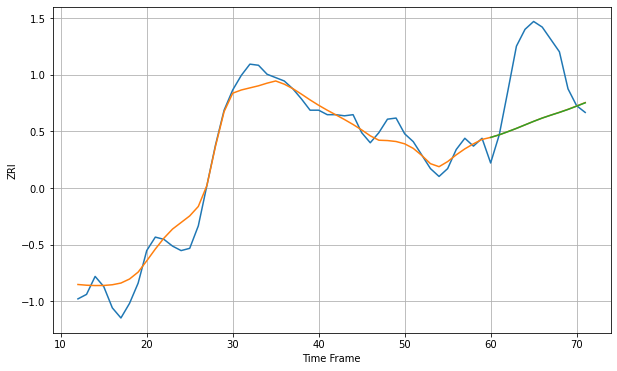

Wall time: 6.52 s
1545 12.041798113950774 55.33377028857756 55.34767213181254 [1523.77613436 1526.06716387 1528.87245313 1531.80046146 1534.93510495
 1538.05397577 1540.98499736 1543.57637536 1546.03631089 1548.6850961
 1551.59654971 1554.58855086]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


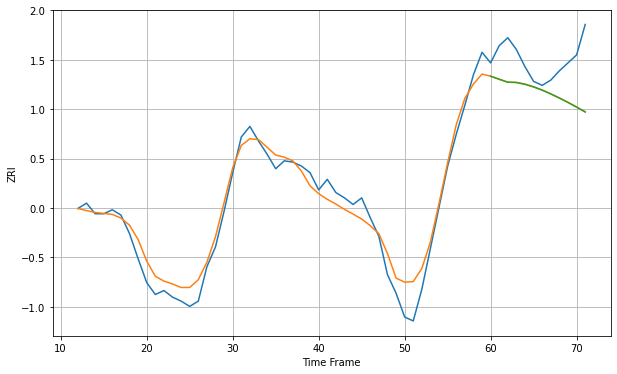

Wall time: 5.81 s
1550 10.576249838207024 28.91438734474341 28.93608416595158 [1222.92889756 1220.59770304 1218.37744988 1218.17278532 1216.80818057
 1214.82377194 1212.38517202 1209.50573563 1206.3974586  1203.08718073
 1199.58678953 1195.91907108]

Got an mse at 0.0100 in round 68 and stopped training

60 60 12


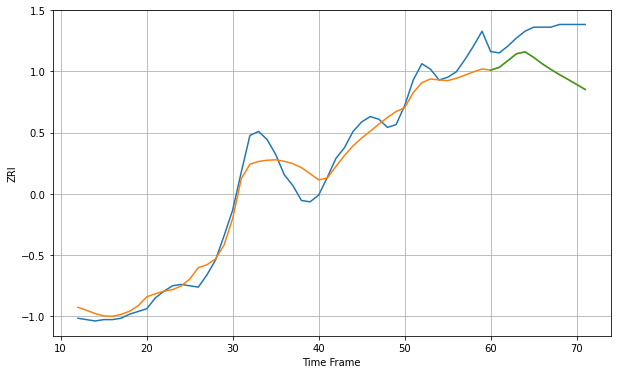

Wall time: 6.17 s
1602 10.814513115241628 29.230783878566065 29.275398658961077 [1376.25205797 1378.32732183 1383.26370622 1388.36838801 1389.76405721
 1385.72910688 1380.96676346 1376.84118787 1372.95485889 1369.37993773
 1365.68921094 1361.87992956]

Got an mse at 0.0096 in round 29 and stopped training

60 60 12


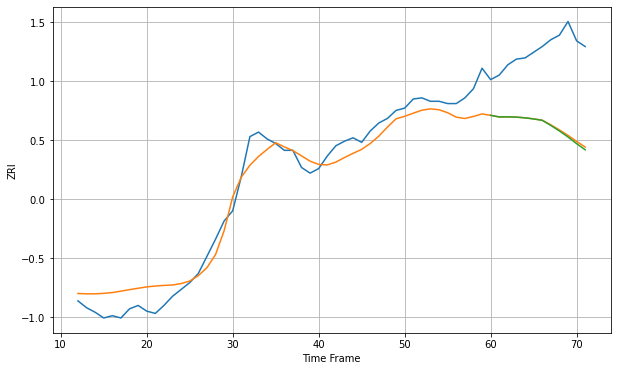

Wall time: 5.03 s
1603 14.421298751502396 67.90742917558204 68.70970254888516 [1269.69275802 1268.28477103 1268.3679251  1268.10729173 1267.48865814
 1266.52380107 1265.30747919 1260.82928408 1255.97194231 1250.71392882
 1244.85925919 1239.47833549]

Got an mse at 0.0099 in round 47 and stopped training

60 60 12


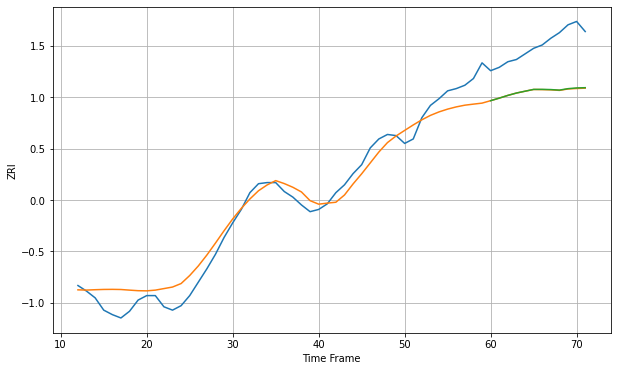

Wall time: 5.7 s
1604 13.129099681884963 42.390143925719876 42.18677437201481 [1317.20034983 1319.48081558 1321.91462264 1324.03424612 1325.66449464
 1327.28175338 1327.31559656 1327.12937844 1326.64736194 1327.94597674
 1328.58807262 1328.82430256]

Got an mse at 0.0098 in round 60 and stopped training

60 60 12


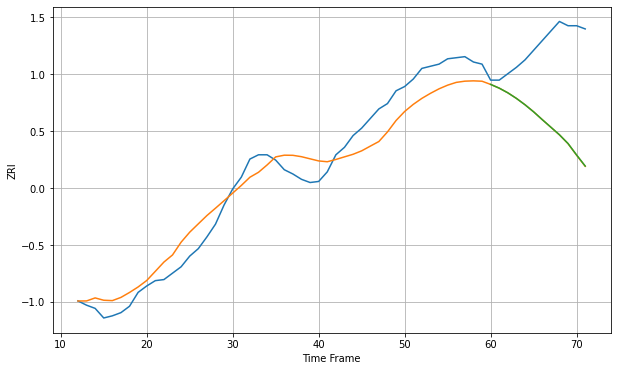

Wall time: 5.69 s
1605 18.12707386220429 78.95057972559589 78.86003227688799 [1294.97981857 1291.47661898 1287.10527652 1281.852022   1275.8885276
 1269.26359597 1261.99716758 1254.90165894 1247.78145985 1239.58919572
 1228.81371387 1218.45339844]

Got an mse at 0.0099 in round 45 and stopped training

60 60 12


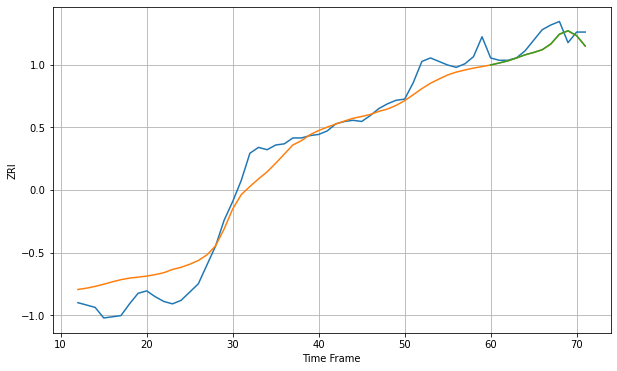

Wall time: 5.23 s
1610 16.120852900011432 9.51628709901959 9.463667591985313 [1314.01884887 1315.70495933 1317.50969849 1319.96624656 1322.64207694
 1324.64829964 1326.99259415 1331.92559292 1340.26144394 1343.1717015
 1339.00315844 1330.18406946]

Got an mse at 0.0097 in round 140 and stopped training

60 60 12


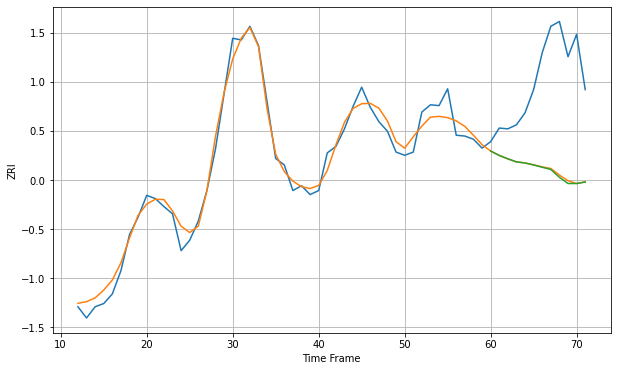

Wall time: 7.38 s
1702 13.272138859717794 121.79394224314827 122.74506379581116 [2265.3504924  2259.8435074  2255.56497845 2251.74489306 2250.42854209
 2247.92831333 2245.07402134 2242.30513295 2232.54305239 2224.77718744
 2224.80477196 2226.62266614]

Got an mse at 0.0098 in round 74 and stopped training

60 60 12


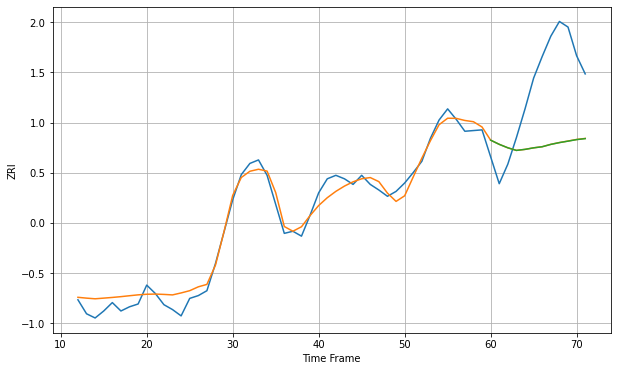

Wall time: 5.92 s
1752 13.666927293677064 107.20351667889035 107.28038408239532 [2052.2679475  2046.30886869 2041.35303022 2037.62644864 2039.10034916
 2041.29415321 2042.87786507 2046.23272467 2048.76964002 2050.85874625
 2053.0526736  2054.47883389]

Got an mse at 0.0100 in round 154 and stopped training

60 60 12


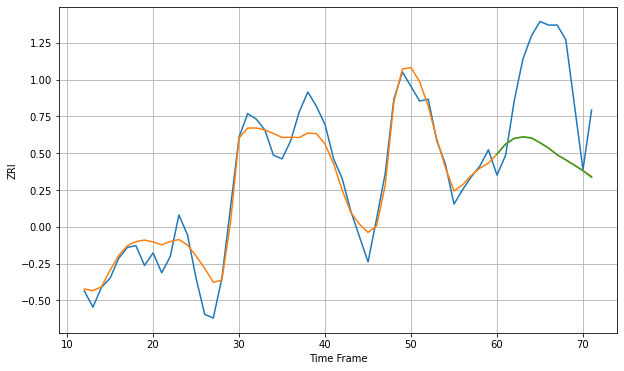

Wall time: 7.73 s
1757 9.526749607458585 47.235417995863536 47.28429271155167 [1453.65788539 1459.16692849 1462.32071899 1463.12806764 1462.6055224
 1459.95440323 1456.97948252 1453.22621176 1450.44737543 1447.49579875
 1444.40238549 1440.79486066]

Got an mse at 0.0100 in round 146 and stopped training

60 60 12


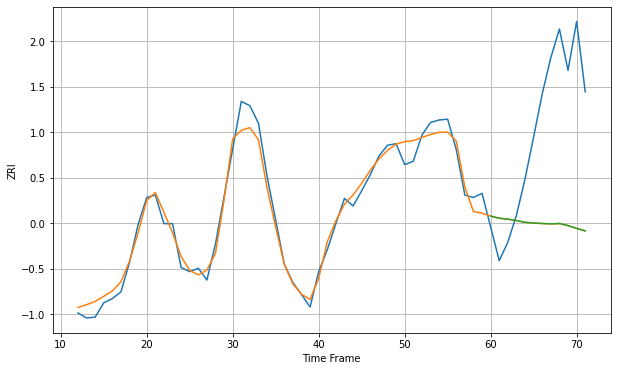

Wall time: 7.54 s
1760 13.027795104638278 145.53099308193248 145.50788864038537 [2267.98117664 2265.41023258 2264.33554777 2262.61441908 2260.59431751
 2259.63773117 2259.19005953 2258.71124522 2259.14457721 2256.66610455
 2253.36629493 2250.38555353]

Got an mse at 0.0099 in round 147 and stopped training

60 60 12


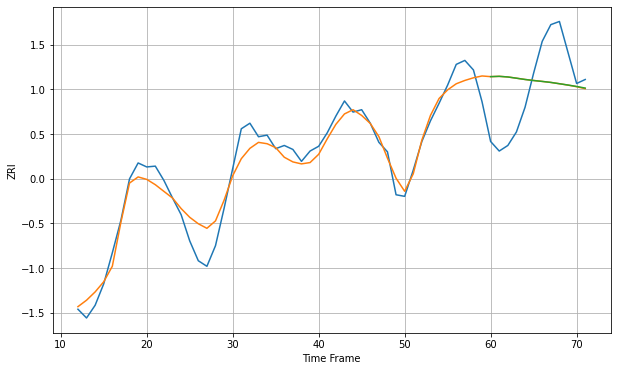

Wall time: 7.57 s
1801 18.214622296189717 60.96861219407657 60.94311327119613 [2284.58774866 2284.96840957 2284.18262203 2282.63156447 2281.02198626
 2279.72207839 2278.57087631 2277.3198807  2275.68701869 2274.02601859
 2272.22655856 2270.20572293]

Got an mse at 0.0100 in round 171 and stopped training

60 60 12


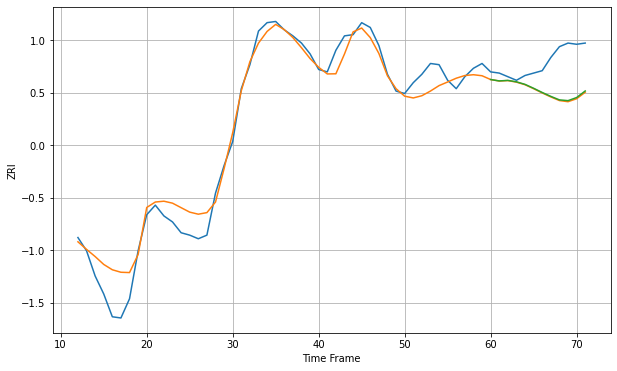

Wall time: 8.1 s
1830 13.67303224412642 28.707053345414995 28.156965639734256 [1619.62672518 1618.46961967 1618.918175   1617.72508592 1615.59989542
 1612.3367533  1608.84565108 1605.59938111 1602.68101891 1602.04268742
 1604.62144142 1610.10818646]

Got an mse at 0.0099 in round 106 and stopped training

60 60 12


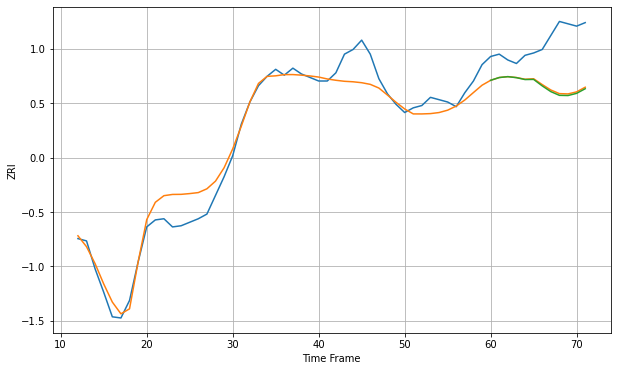

Wall time: 6.59 s
1832 13.459760354673643 39.59825216207422 40.51891546000636 [1566.58970388 1568.97931296 1569.71630692 1568.85892081 1567.24030605
 1567.36287321 1561.80903489 1556.90238114 1553.70845439 1553.55197968
 1555.41987209 1559.38073995]

Got an mse at 0.0097 in round 103 and stopped training

60 60 12


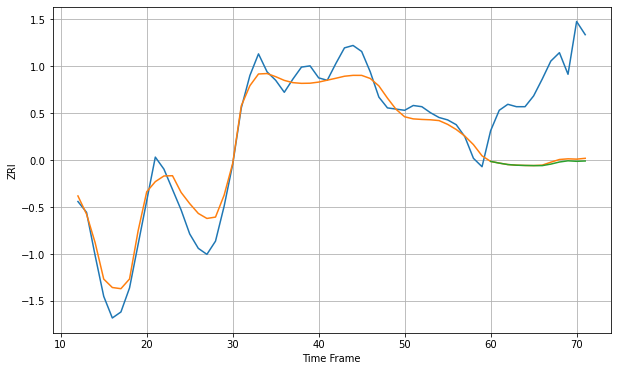

Wall time: 6.6 s
1841 13.38849856294444 71.94524683993538 73.0014634146248 [1566.41768849 1565.00491689 1563.80161543 1563.27561869 1563.04122754
 1562.93153521 1562.90924229 1564.17349421 1565.91480681 1566.92756031
 1566.49898111 1566.78123766]

Got an mse at 0.0100 in round 182 and stopped training

60 60 12


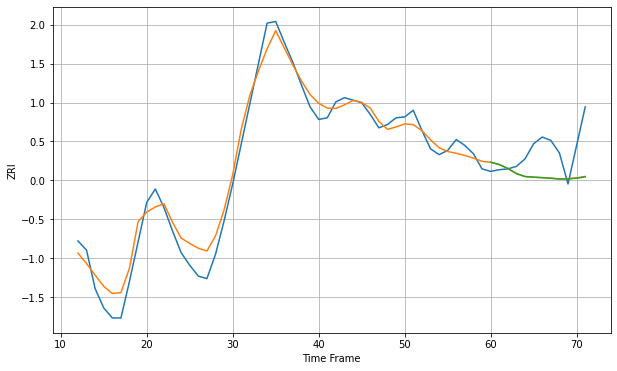

Wall time: 8.36 s
1843 16.12709179126831 36.57116147142541 36.70160142525153 [1682.92568674 1680.20563925 1675.50358904 1669.42857679 1665.85795096
 1665.07304801 1664.51094002 1663.79817391 1662.9044381  1663.08078406
 1663.87902978 1665.55789366]

Got an mse at 0.0099 in round 136 and stopped training

60 60 12


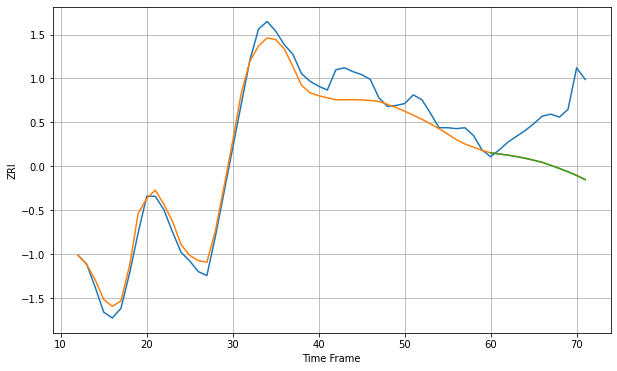

Wall time: 7.49 s
1844 13.526135407606665 56.346781823891924 56.426763234264676 [1670.97924615 1669.82496291 1668.58721513 1667.16035433 1665.39604473
 1663.35221948 1661.18109396 1658.04094521 1654.80671795 1651.30772285
 1647.52577129 1643.11388058]

Got an mse at 0.0098 in round 153 and stopped training

60 60 12


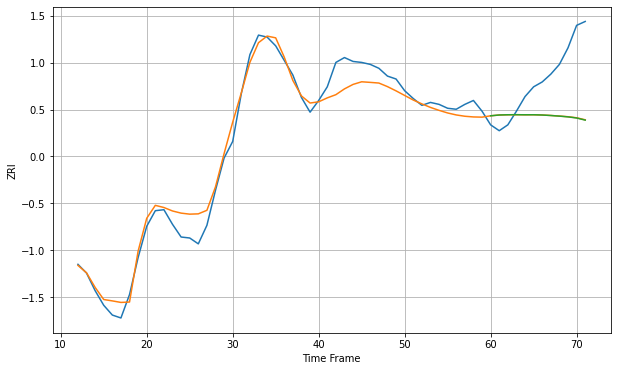

Wall time: 8.12 s
1845 13.454782930105342 51.25253337796816 51.367312850892695 [1803.28108973 1804.10277362 1804.35542881 1804.4175769  1804.32827201
 1804.35698265 1804.09003797 1803.58385474 1802.93939786 1802.18653861
 1801.02484582 1798.85960821]

Got an mse at 0.0097 in round 82 and stopped training

60 60 12


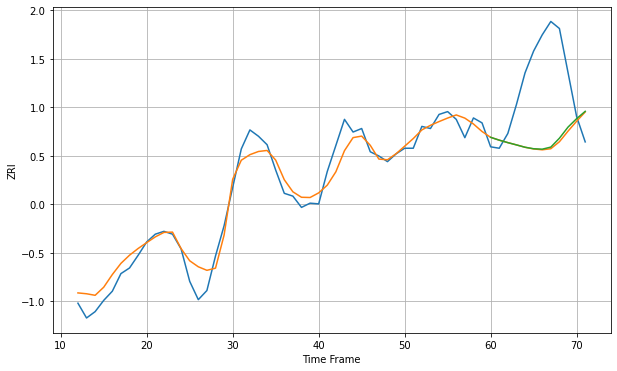

Wall time: 6.34 s
1850 18.606341100420916 103.34463398467415 101.85090046003718 [1978.49927451 1974.47917538 1970.96899141 1967.7500534  1964.41925071
 1962.27490913 1961.66858714 1964.62037172 1977.24280573 1993.00334686
 2004.96791127 2015.40452073]

Got an mse at 0.0100 in round 99 and stopped training

60 60 12


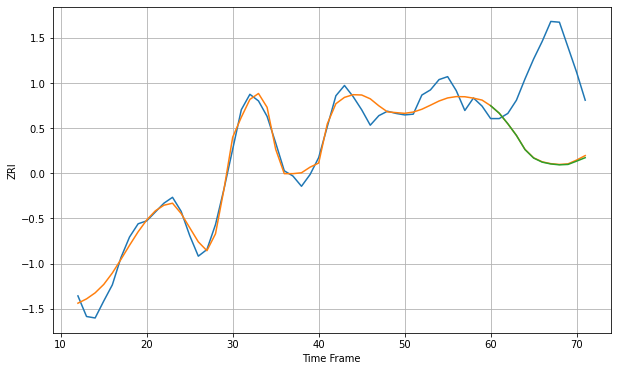

Wall time: 6.68 s
1851 14.511115756364541 121.34569733650507 121.92002156003726 [2002.52758002 1992.31647381 1977.99309377 1962.11429216 1942.8586016
 1931.37418336 1925.78649896 1923.31274884 1922.13700156 1922.67608039
 1927.15368273 1931.8654462 ]

Got an mse at 0.0097 in round 113 and stopped training

60 60 12


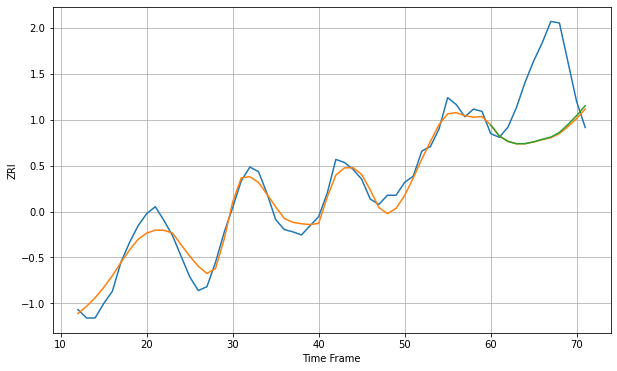

Wall time: 7.06 s
1852 14.868353306494761 86.1631694008428 85.56215239930127 [1976.35560372 1961.86582937 1954.72272406 1951.59214349 1951.67776524
 1954.06210484 1957.36288084 1960.32321834 1966.44111358 1976.94191325
 1988.47410149 2001.55168956]

Got an mse at 0.0098 in round 84 and stopped training

60 60 12


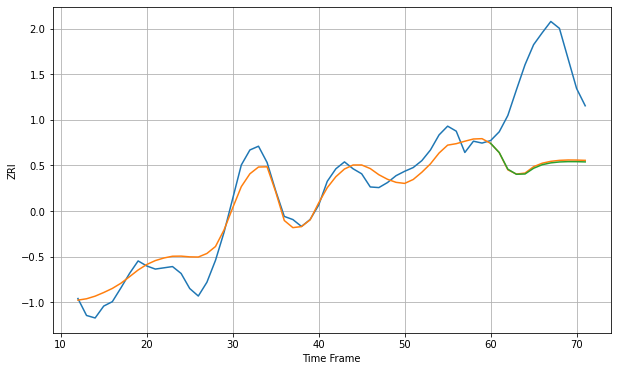

Wall time: 6.34 s
1854 22.363753112562218 152.40691278649726 154.16770828708965 [2007.54803023 1992.88389035 1966.36609625 1958.23249309 1958.67500478
 1967.83859431 1973.50086243 1976.42598455 1977.86964329 1978.39304223
 1978.33775769 1977.97448015]

Got an mse at 0.0099 in round 113 and stopped training

60 60 12


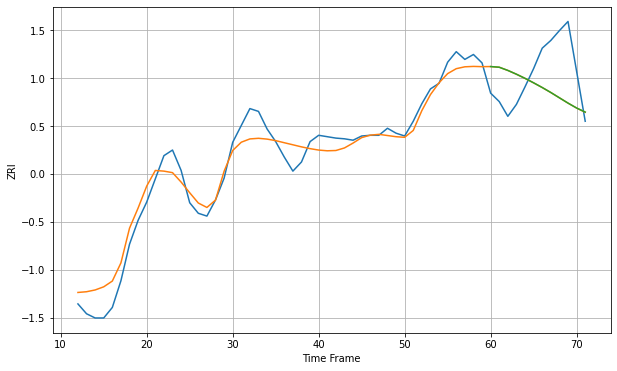

Wall time: 7.12 s
1876 20.679508438000365 61.01736184763214 61.00120374734265 [2188.82482768 2187.85666326 2183.33026697 2177.94327598 2172.0453023
 2165.66946152 2159.00715228 2151.90223007 2144.35158361 2136.81836015
 2129.8224439  2124.05808071]

Got an mse at 0.0099 in round 98 and stopped training

60 60 12


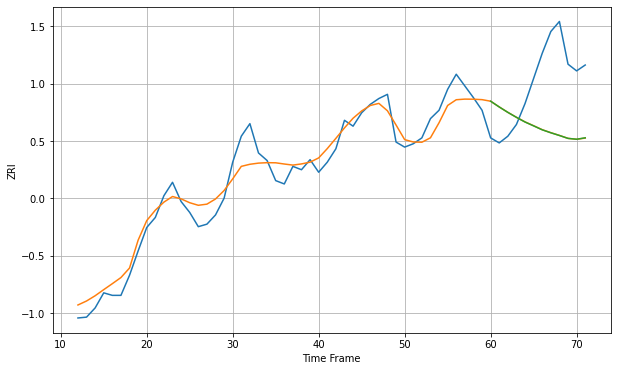

Wall time: 6.75 s
1880 16.828984428297467 77.37851539495125 77.40254673083999 [2220.7963983  2213.92058983 2207.46262116 2201.51390954 2195.95379939
 2191.33499422 2186.64026067 2183.10004424 2179.87649821 2176.40411392
 2175.38404645 2177.10592579]

Got an mse at 0.0099 in round 67 and stopped training

60 60 12


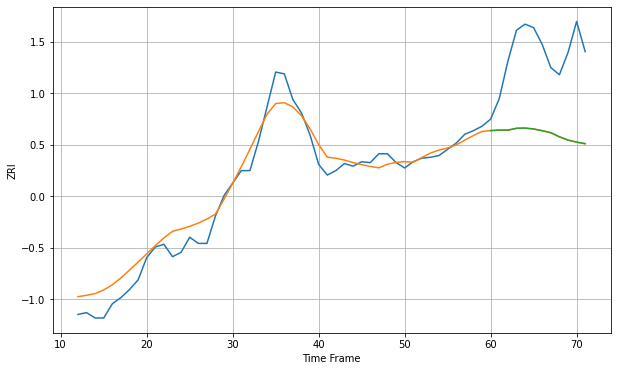

Wall time: 6.04 s
1902 16.068532824310036 93.54833282607768 93.5204114778878 [1749.07854281 1749.6597025  1749.56060919 1751.6448448  1751.89346786
 1750.86063511 1748.91114566 1746.65337653 1742.08494342 1738.40824827
 1736.09601938 1734.38658267]

Got an mse at 0.0100 in round 74 and stopped training

60 60 12


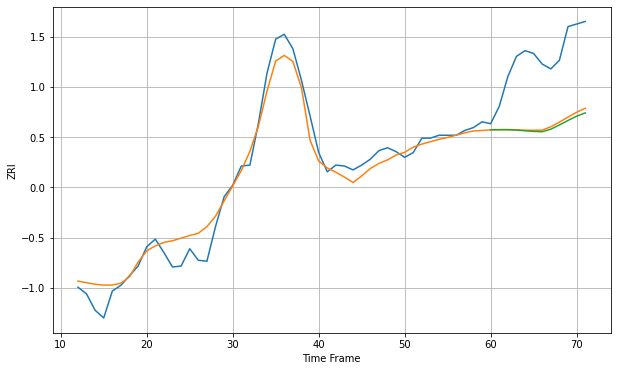

Wall time: 6.14 s
1905 14.45680341058585 71.06799526319882 73.14878775113058 [1749.69028729 1749.80343641 1749.80798001 1749.35774667 1748.64607593
 1748.01678789 1747.68253154 1750.32107281 1754.72284273 1759.40620855
 1763.82248434 1767.21635971]

Got an mse at 0.0099 in round 100 and stopped training

60 60 12


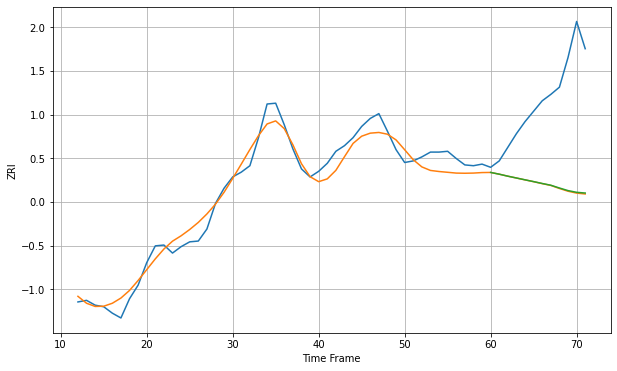

Wall time: 6.76 s
1915 14.44693594787968 116.84928892797475 116.34510714350547 [1811.61379126 1809.42987768 1806.93389766 1804.67571146 1802.40141863
 1800.17446984 1797.83046895 1795.6508387  1792.19308537 1788.94946707
 1786.81074063 1785.9121537 ]

Got an mse at 0.0097 in round 97 and stopped training

60 60 12


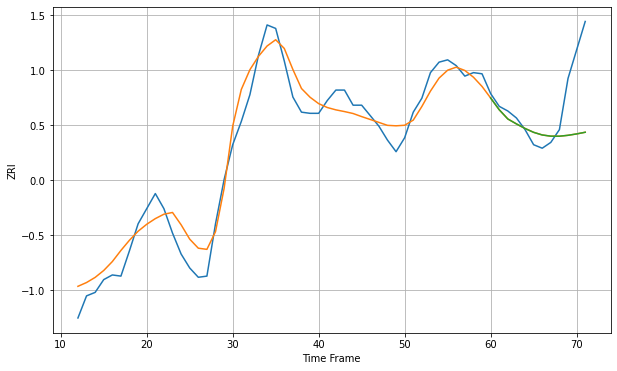

Wall time: 6.69 s
1930 15.11212413043702 37.73242996106089 37.733858604928635 [1763.18233704 1753.05710863 1745.13200237 1740.88602547 1736.96725062
 1733.65127707 1731.38947306 1730.3510992  1730.32279235 1731.09495053
 1732.286921   1733.7205753 ]

Got an mse at 0.0099 in round 66 and stopped training

60 60 12


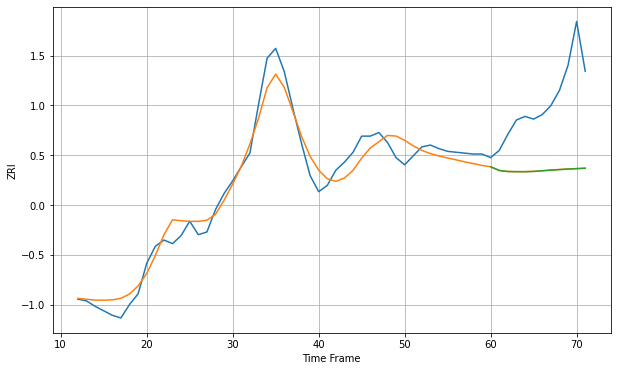

Wall time: 5.96 s
1960 14.856654313620783 82.56839294331468 82.63670267560106 [1783.81043549 1779.65809309 1778.48307746 1778.32704704 1778.30727666
 1778.59956237 1779.29771335 1780.02452761 1780.64534696 1781.19851447
 1781.67454467 1782.12541571]

Got an mse at 0.0100 in round 121 and stopped training

60 60 12


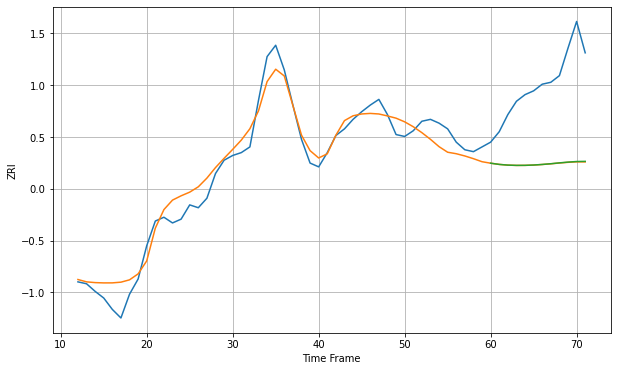

Wall time: 7.28 s
1970 15.219183287540243 88.08311469600585 87.90911785391829 [1814.86502704 1813.58820136 1812.86234725 1812.55765604 1812.60439538
 1812.94204608 1813.53844741 1814.30227947 1815.20613937 1816.00941649
 1816.62816624 1816.79827709]

Got an mse at 0.0098 in round 63 and stopped training

60 60 12


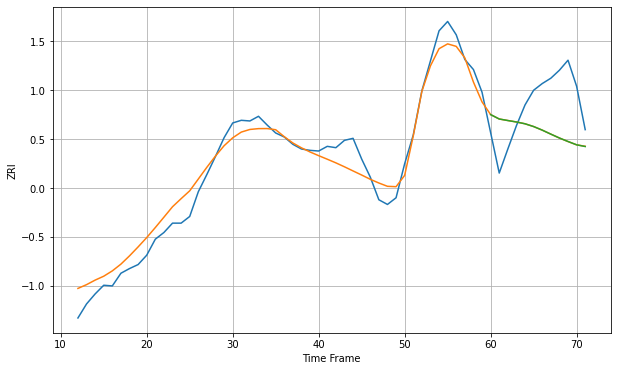

Wall time: 5.85 s
2026 21.554201504677856 69.64983251052485 69.64771129800447 [2225.53073719 2218.94733929 2216.66056848 2214.48295224 2211.77250937
 2207.63477941 2202.28938145 2196.30466066 2190.48739356 2185.24192009
 2180.29715948 2177.74037252]

Got an mse at 0.0099 in round 71 and stopped training

60 60 12


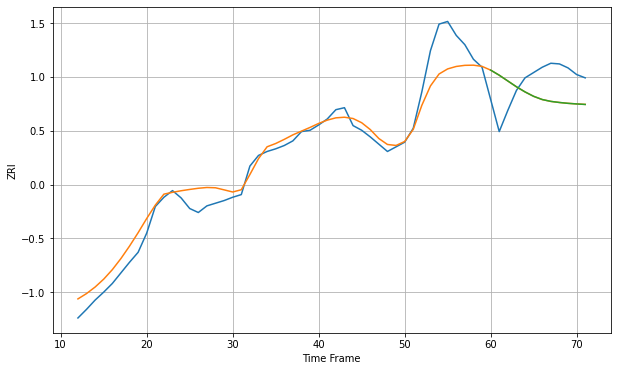

Wall time: 6.09 s
2062 24.01462510399931 48.62044902031592 48.633643561538115 [2181.66087642 2173.98277193 2165.26568711 2156.56657555 2148.81724388
 2142.16831059 2137.31048418 2134.51930005 2132.85676192 2131.55798479
 2130.66301999 2129.87131674]

Got an mse at 0.0098 in round 62 and stopped training

60 60 12


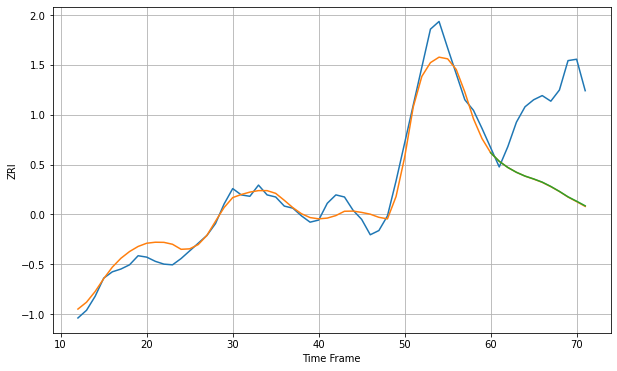

Wall time: 5.81 s
2072 17.4648268269246 124.878203841193 124.57368174404267 [1923.29515534 1911.03162927 1902.20629863 1895.31155026 1889.90920874
 1885.84496799 1881.24868171 1875.10304976 1867.99457118 1860.24998883
 1853.95441434 1847.37327573]

Got an mse at 0.0100 in round 179 and stopped training

60 60 12


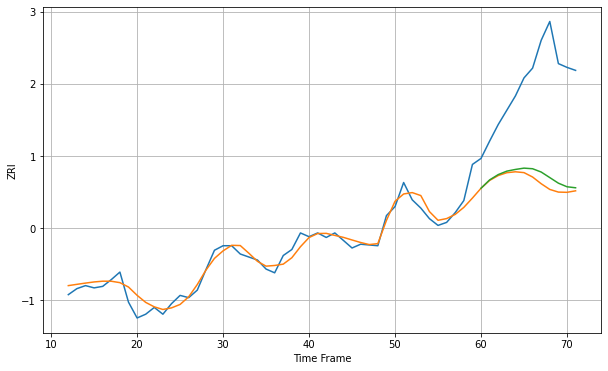

Wall time: 8.57 s
2111 11.607705395644517 138.79980534665992 130.8348550865178 [2814.36463063 2825.44410011 2832.51898745 2837.11131993 2839.36083263
 2841.1071036  2840.30250009 2835.91845557 2828.52646553 2821.13548981
 2816.35481125 2815.00751157]

Got an mse at 0.0099 in round 165 and stopped training

60 60 12


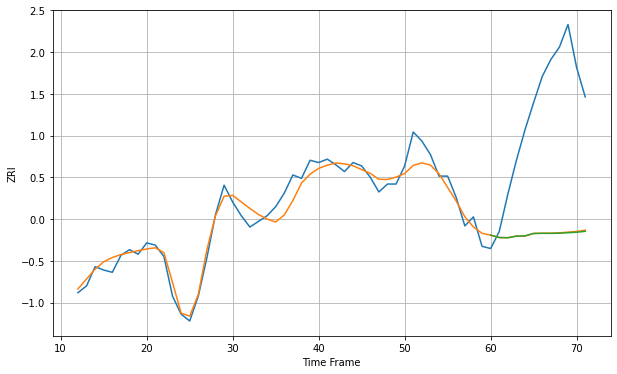

Wall time: 8.35 s
2113 9.640036020796202 117.7853974454836 118.08444207178688 [2605.83240924 2603.74513434 2603.55633426 2604.99684508 2605.14083865
 2607.32517433 2607.43445003 2607.40354284 2607.54873598 2607.99510182
 2608.39166557 2609.23144698]

Got an mse at 0.0098 in round 154 and stopped training

60 60 12


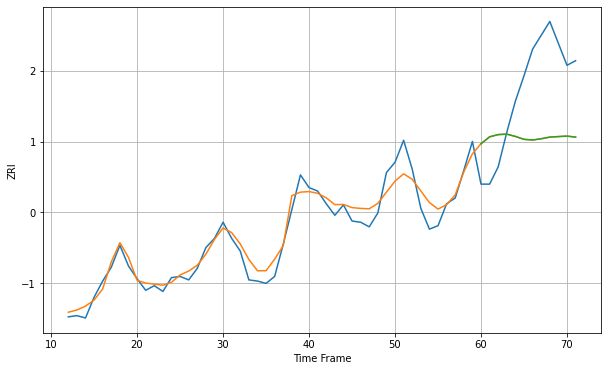

Wall time: 8.08 s
2114 10.161702757975483 62.34165990823934 62.341089721004465 [2793.00924025 2799.03665472 2800.96675577 2801.34736755 2799.36966714
 2796.8441447  2796.2600636  2797.35968003 2798.78331171 2799.21645545
 2799.61471612 2798.74938428]

Got an mse at 0.0097 in round 261 and stopped training

60 60 12


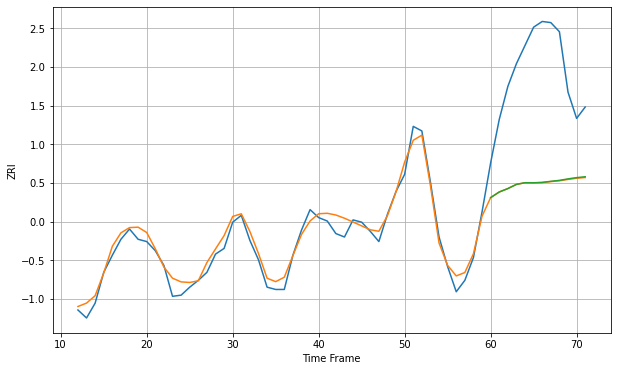

Wall time: 10.5 s
2115 7.709941693738158 102.56748085818468 102.38174539870367 [2922.54491559 2927.45998551 2930.45858501 2934.15884181 2935.62437612
 2935.56966062 2935.87843414 2936.82317169 2937.65430246 2938.95928075
 2940.06324069 2940.83818938]

Got an mse at 0.0099 in round 129 and stopped training

60 60 12


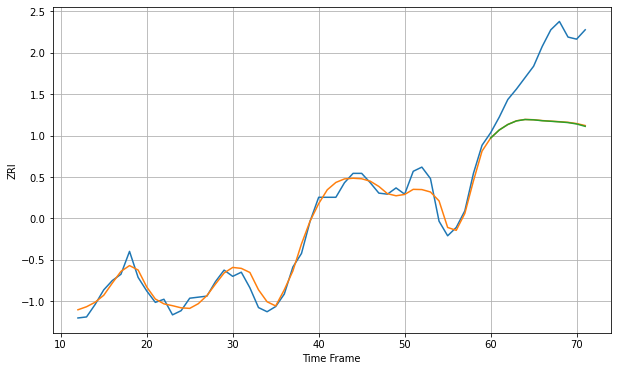

Wall time: 7.39 s
2116 8.484625274625042 64.40752576513448 64.63122636793261 [2816.92213627 2824.66499299 2829.95590936 2833.41713197 2834.74762262
 2834.445783   2833.61003378 2833.06246256 2832.50185644 2831.81456808
 2830.47071563 2828.18842869]

Got an mse at 0.0099 in round 155 and stopped training

60 60 12


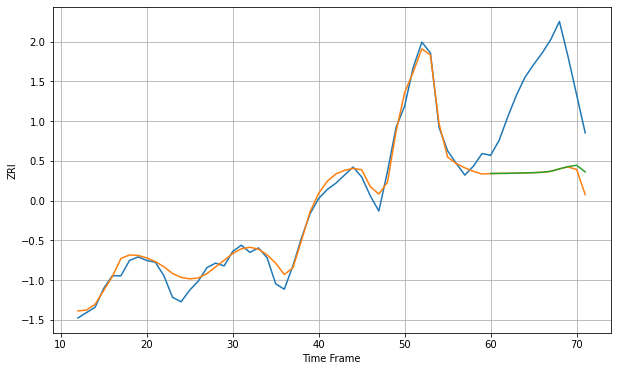

Wall time: 8.03 s
2118 10.341983117749487 104.85987039206772 103.38083947242009 [2932.753373   2932.91781543 2932.97475597 2933.22605324 2933.49942238
 2933.73967853 2934.1495601  2935.25623696 2937.94504621 2940.47436513
 2941.96838153 2934.61107727]

Got an mse at 0.0099 in round 155 and stopped training

60 60 12


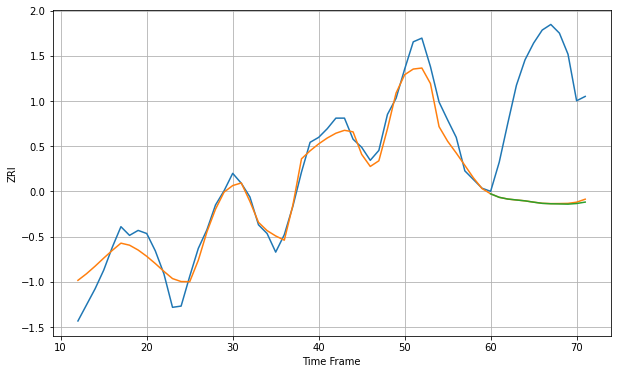

Wall time: 8.01 s
2119 24.78701730508529 207.90813563964 208.59402669048256 [2778.96642279 2773.34604636 2770.55241967 2769.08198433 2767.64955205
 2765.52899297 2763.62951697 2762.94917139 2762.68047898 2762.33670472
 2763.35393351 2765.64996398]

Got an mse at 0.0100 in round 143 and stopped training

60 60 12


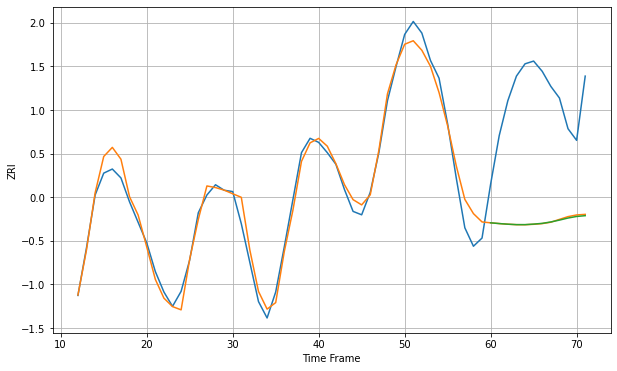

Wall time: 7.73 s
2120 17.45134452319992 183.1454450399703 183.51306138062677 [3124.26599934 3123.1887273  3122.26107211 3121.6430989  3121.64109805
 3122.39792708 3123.49310385 3125.53027667 3128.24334327 3131.28315799
 3133.56800836 3134.7437508 ]

Got an mse at 0.0099 in round 174 and stopped training

60 60 12


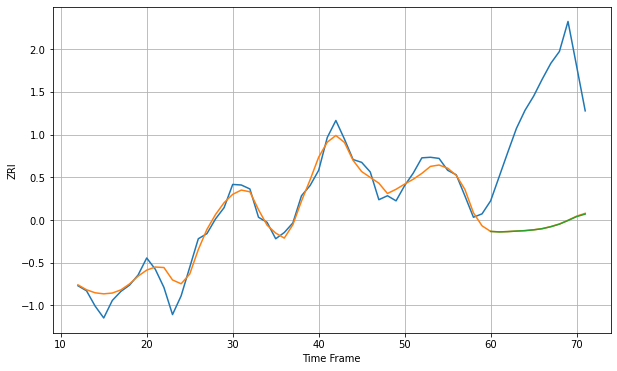

Wall time: 8.46 s
2121 17.743953938676672 230.66651933766516 230.95944956439243 [2357.96472256 2357.1112111  2357.64754141 2358.54177633 2359.31694002
 2360.73281714 2362.78360057 2366.30132702 2370.83679633 2377.27794131
 2384.16619156 2388.61253886]

Got an mse at 0.0099 in round 187 and stopped training

60 60 12


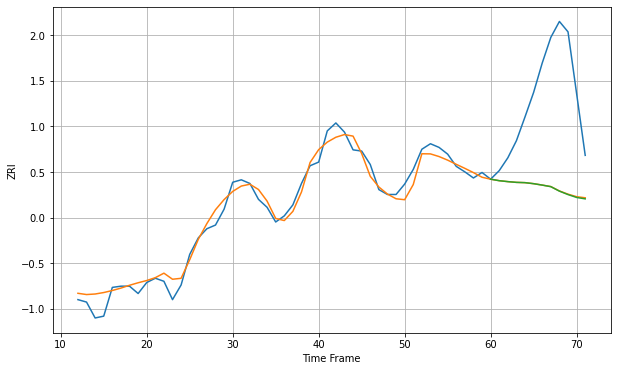

Wall time: 8.75 s
2122 15.525339720785155 163.38099298543958 163.7122379959804 [2408.01541599 2405.56114561 2404.02530084 2402.80689416 2402.34304459
 2400.66100787 2398.35776262 2395.78283557 2388.45226955 2382.8411844
 2378.14500292 2375.82682661]

Got an mse at 0.0100 in round 108 and stopped training

60 60 12


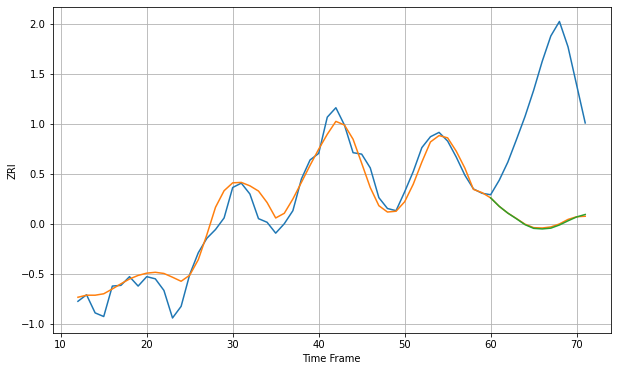

Wall time: 6.89 s
2124 18.34591868460174 178.56435753127977 179.34395178981325 [2302.65933274 2290.97571603 2281.63176293 2273.86159469 2265.70714629
 2260.63186006 2259.8277709  2260.90386301 2265.24329845 2271.01376411
 2276.31319833 2279.75868355]

Got an mse at 0.0099 in round 133 and stopped training

60 60 12


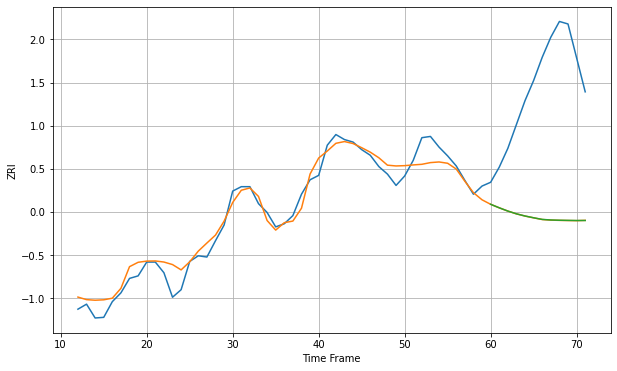

Wall time: 7.47 s
2125 18.503313333905048 219.0586989848696 218.94101603522574 [2468.96093402 2463.37436546 2458.19923197 2453.78564492 2450.31571789
 2447.50489016 2444.88704592 2443.98889153 2443.57356609 2443.34064866
 2443.13786674 2443.17875055]

Got an mse at 0.0100 in round 112 and stopped training

60 60 12


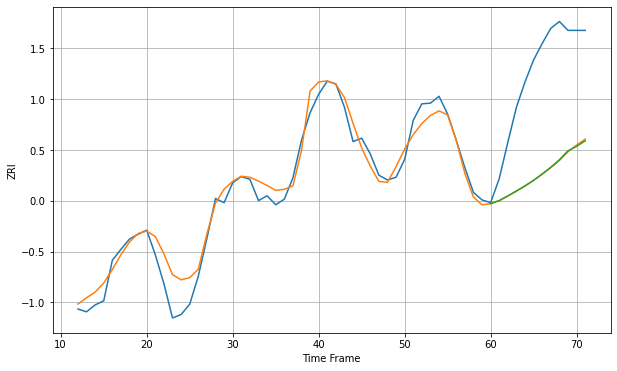

Wall time: 6.97 s
2126 20.682798680563096 152.38349955332427 152.39443822972143 [2285.54696148 2289.99496263 2296.77720575 2303.93848752 2311.42863633
 2319.57560972 2328.83057398 2338.63133776 2349.59142436 2362.5922547
 2369.02400592 2377.08615205]
60 60 12


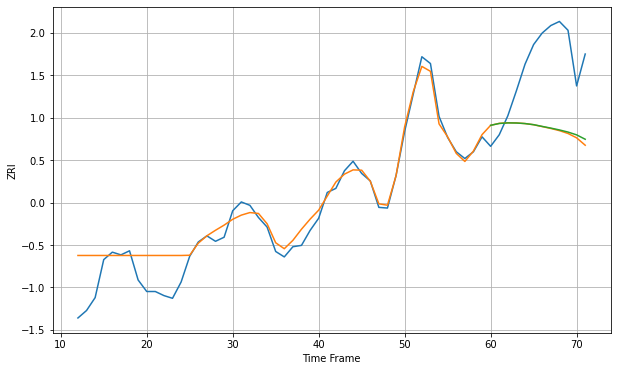

Wall time: 16.1 s
2127 28.354701702403855 108.09619594057813 106.48214991780195 [2891.93502939 2894.65114426 2895.48381121 2895.32939744 2894.50892893
 2892.89894664 2890.32839863 2887.83693651 2885.14211808 2881.98493056
 2877.86558497 2871.40007732]

Got an mse at 0.0100 in round 127 and stopped training

60 60 12


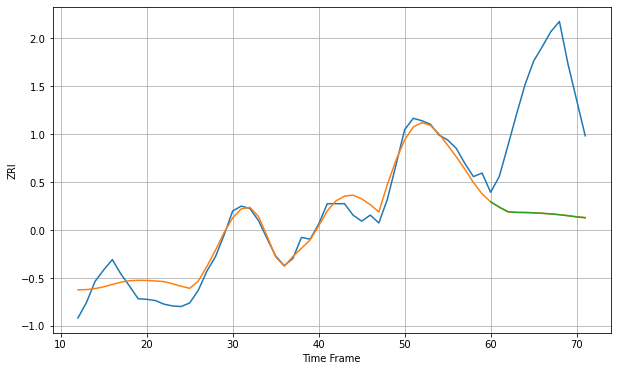

Wall time: 7.36 s
2128 20.56445792258216 212.34873077892368 212.47235943850984 [2444.07163082 2435.31579427 2427.71313434 2426.53462643 2426.35270634
 2425.85748264 2424.99144105 2423.9952277  2422.65660849 2420.92385736
 2419.06102073 2417.53756526]

Got an mse at 0.0099 in round 231 and stopped training

60 60 12


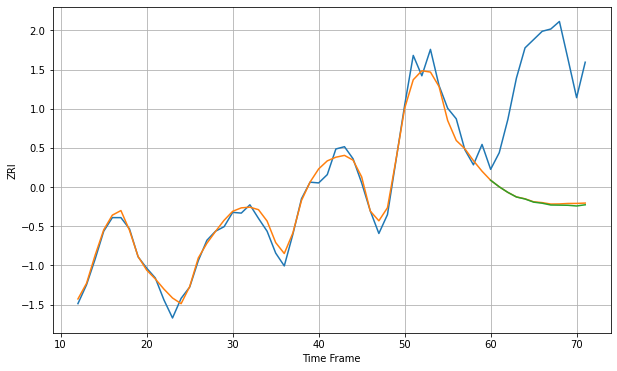

Wall time: 9.76 s
2129 12.77542719096082 177.38864625962304 178.51439627644277 [2761.5251649  2752.85698658 2745.46721653 2739.34704052 2736.70050599
 2732.53878937 2731.0830859  2728.71922455 2728.55096427 2728.36383179
 2727.44695939 2729.03202629]

Got an mse at 0.0099 in round 82 and stopped training

60 60 12


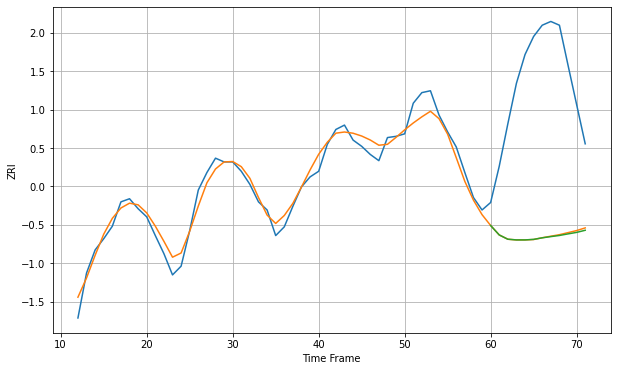

Wall time: 6.34 s
2130 16.27212612018665 255.34593529629763 256.08317987503824 [2584.13130875 2569.00515746 2562.16082525 2561.05612891 2561.04540206
 2561.90897897 2564.40415118 2566.35536213 2568.16445324 2570.6846978
 2573.0958883  2576.50552198]
60 60 12


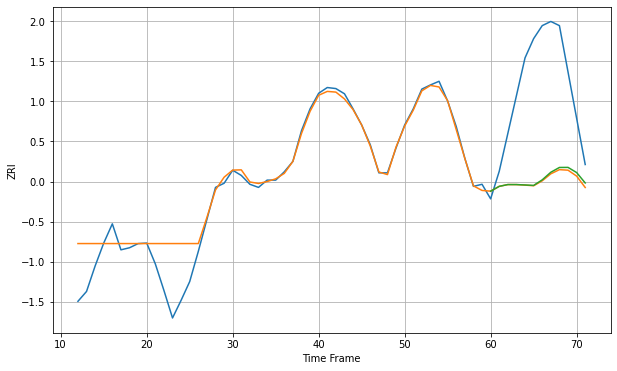

Wall time: 16.3 s
2131 38.958515684531314 200.24712297689274 198.17663925060177 [2381.75593566 2391.03473337 2394.46183682 2394.45128175 2393.69423997
 2392.84881401 2403.5404756  2418.14777559 2427.33224259 2427.47642966
 2417.57988923 2397.54789722]

Got an mse at 0.0100 in round 89 and stopped training

60 60 12


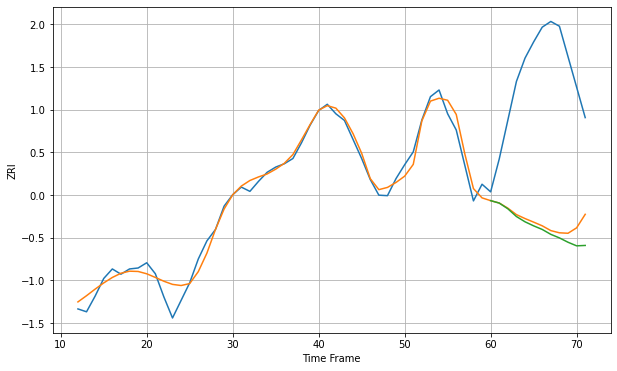

Wall time: 6.6 s
2132 19.59613828943818 316.26564310762416 329.841662134078 [2354.51366011 2349.4268335  2337.43869611 2321.17747333 2310.06991255
 2301.56754225 2294.00830199 2283.69241275 2276.24409287 2267.11337813
 2259.57681609 2260.39190493]

Got an mse at 0.0100 in round 193 and stopped training

60 60 12


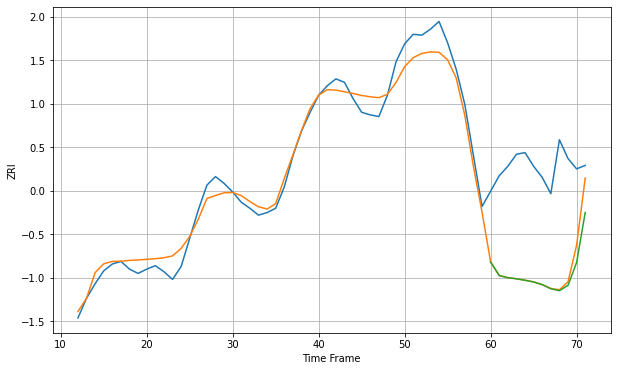

Wall time: 8.91 s
2134 14.914694758212892 124.53758181549122 127.35361901724784 [2519.33015151 2503.49491957 2501.05332967 2499.69171326 2498.00461678
 2496.05607456 2492.87937763 2488.12484026 2485.83339466 2492.14461735
 2518.72707303 2577.00417859]

Got an mse at 0.0098 in round 149 and stopped training

60 60 12


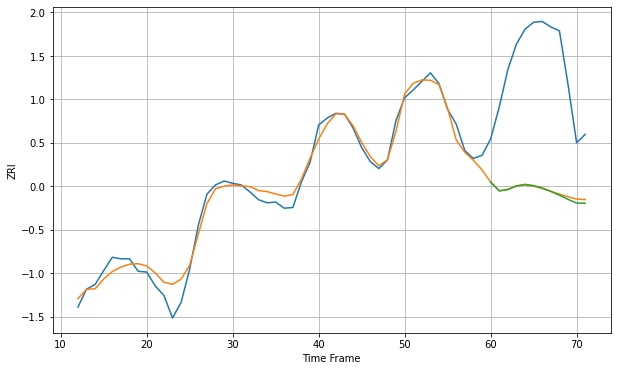

Wall time: 7.93 s
2135 12.34178866705544 164.23065143537303 164.86470538447753 [2692.56177986 2681.33859137 2683.02530235 2687.49123304 2689.69225135
 2688.07352669 2685.0403985  2680.59878023 2675.7813133  2670.39324859
 2665.74131517 2665.39672935]

Got an mse at 0.0099 in round 133 and stopped training

60 60 12


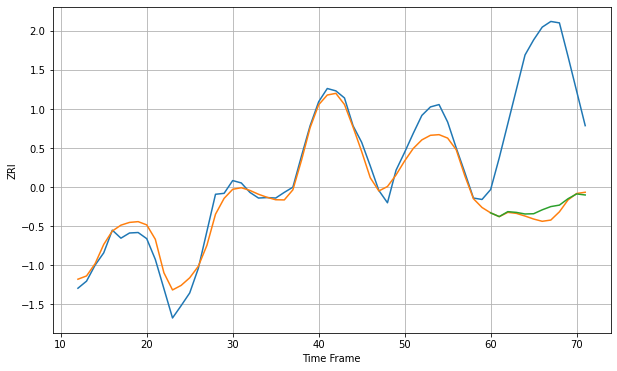

Wall time: 7.43 s
2136 26.02687992671257 295.55381138052206 286.06211038048104 [2318.64594476 2310.68076037 2321.19926112 2319.59623797 2316.24151667
 2316.77900752 2325.06499649 2331.93544792 2335.02810761 2348.54916971
 2358.7138125  2356.51128858]

Got an mse at 0.0098 in round 72 and stopped training

60 60 12


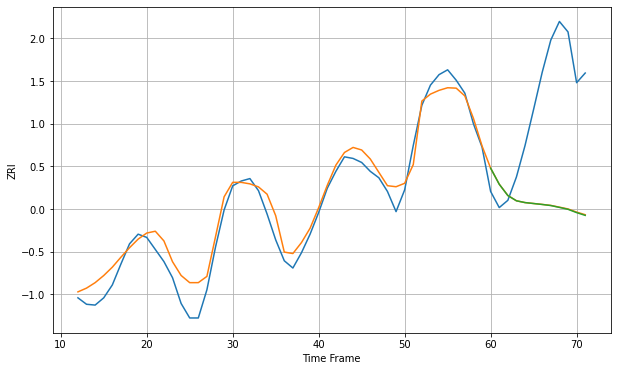

Wall time: 6 s
2138 18.183068825075196 143.88027823145003 144.14967764818363 [2549.92055825 2529.96405035 2515.96265683 2509.43184203 2507.2136566
 2506.04751206 2504.870667   2503.5378726  2501.22836705 2498.86483704
 2494.77132429 2491.32806212]

Got an mse at 0.0092 in round 144 and stopped training

60 60 12


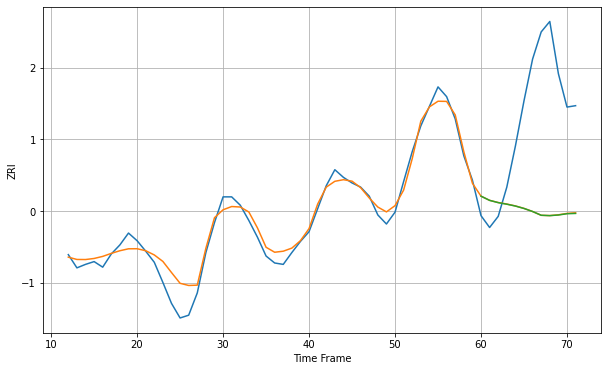

Wall time: 7.68 s
2139 15.879889393426518 162.76056680810112 162.91985281420926 [2610.00680426 2603.95373524 2600.7171327  2598.45634099 2595.80515099
 2592.33248011 2587.96693987 2582.56027141 2582.04908244 2582.92518727
 2584.77342178 2585.2012073 ]

Got an mse at 0.0097 in round 127 and stopped training

60 60 12


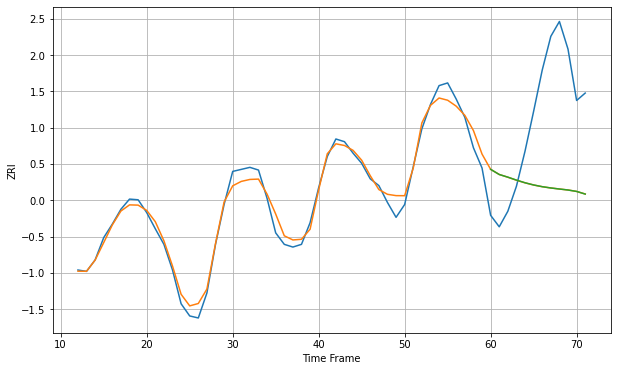

Wall time: 7.32 s
2140 12.618701434730339 145.21738300583203 145.22254855197724 [2580.05833785 2572.42413343 2568.51219261 2564.13064339 2560.19907826
 2556.93996405 2554.38563345 2552.48167919 2550.92695792 2549.4736044
 2547.35238481 2543.42829989]

Got an mse at 0.0099 in round 152 and stopped training

60 60 12


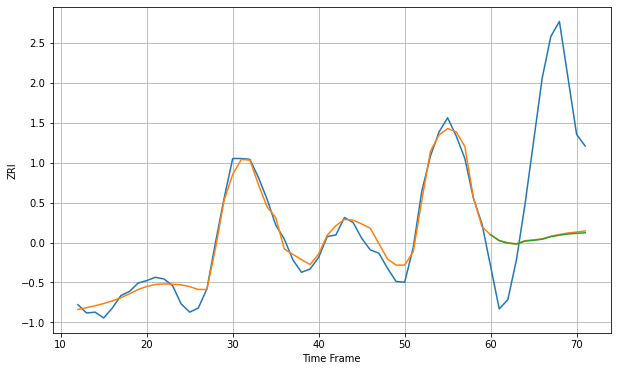

Wall time: 7.89 s
2141 11.74875573011491 144.25766984173674 144.8708538276803 [2551.19665535 2544.08643449 2541.13579797 2539.97412732 2543.5327693
 2544.5487183  2545.80836493 2548.8984891  2550.70094496 2552.21386205
 2552.85569888 2553.58244891]

Got an mse at 0.0097 in round 124 and stopped training

60 60 12


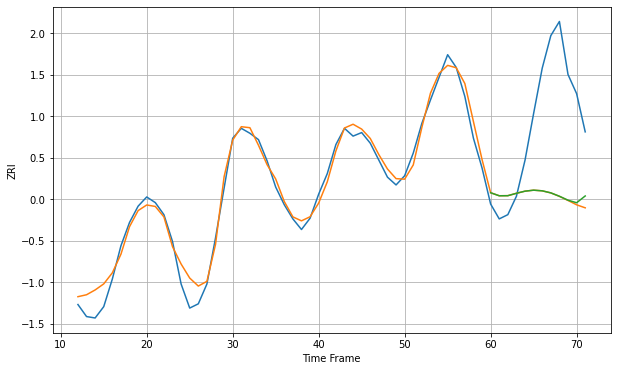

Wall time: 7.29 s
2143 15.116715015916009 136.66525679459664 135.29384371407556 [2439.95967566 2435.67790666 2435.77640895 2439.18170028 2442.18892109
 2443.58672888 2442.68576303 2439.79102782 2435.0069786  2429.43894545
 2425.8310385  2435.40739108]

Got an mse at 0.0098 in round 120 and stopped training

60 60 12


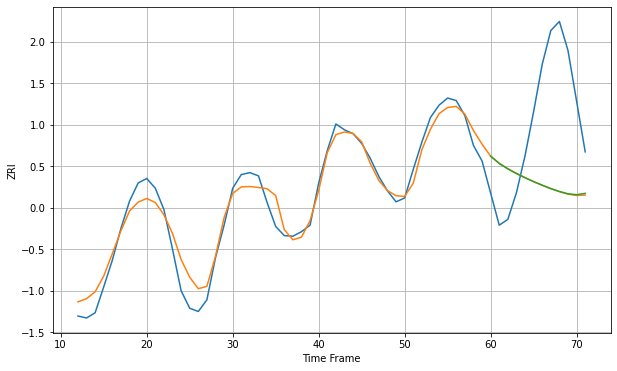

Wall time: 7.18 s
2144 20.277459280109948 149.85102993159592 149.5083759233737 [2602.42147803 2591.24271088 2582.8872545  2575.71441355 2569.25257459
 2563.14816133 2557.62096789 2552.46834329 2547.9374535  2544.42108658
 2543.00689521 2545.03997009]

Got an mse at 0.0100 in round 177 and stopped training

60 60 12


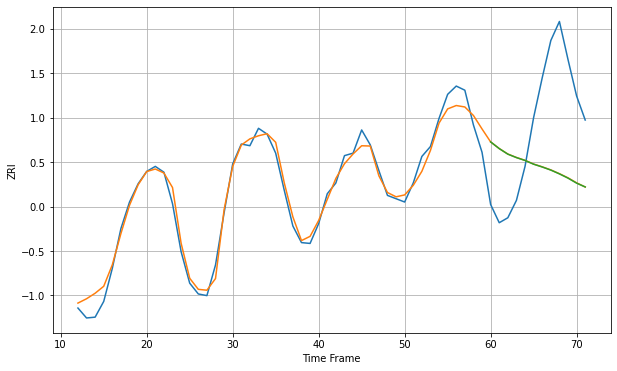

Wall time: 8.47 s
2145 11.706133680574387 105.36237364805486 105.49094988941447 [2415.56635167 2407.49644536 2400.80415374 2396.64352552 2393.18154668
 2388.66039394 2385.30999094 2381.56476881 2376.96792634 2371.85340324
 2365.78464755 2361.18911593]

Got an mse at 0.0099 in round 85 and stopped training

60 60 12


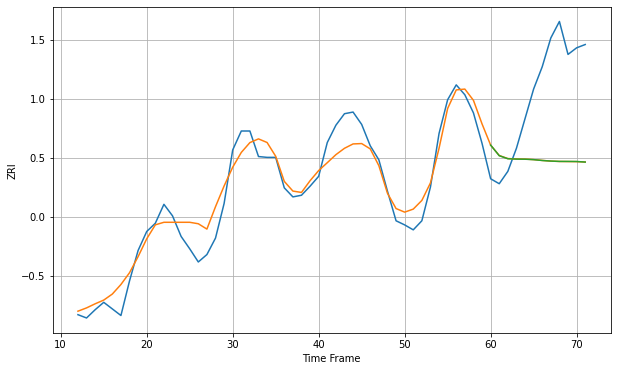

Wall time: 6.33 s
2148 20.51195497163014 105.5004875119348 105.46587286141528 [2236.90233188 2224.02879741 2220.33159977 2219.87697664 2219.76485948
 2219.21781168 2218.22316388 2217.49844461 2217.09883489 2217.07467394
 2216.98918987 2216.29111382]

Got an mse at 0.0096 in round 87 and stopped training

60 60 12


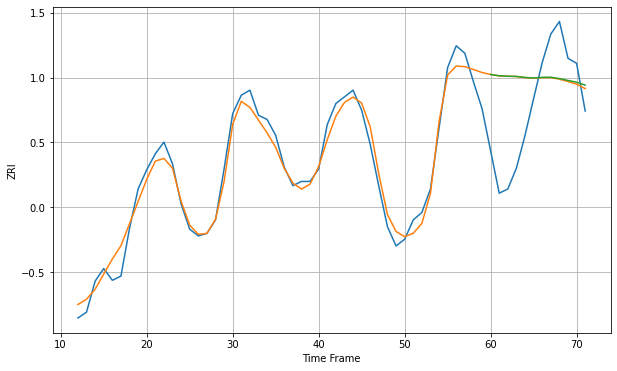

Wall time: 6.39 s
2149 14.708184520162611 78.10922281731825 78.10754440666743 [2342.68254258 2341.1101054  2340.64299037 2340.38377894 2339.13632429
 2338.49923482 2339.24126117 2339.39971683 2337.82744988 2335.57454669
 2333.4968819  2329.99388475]

Got an mse at 0.0099 in round 89 and stopped training

60 60 12


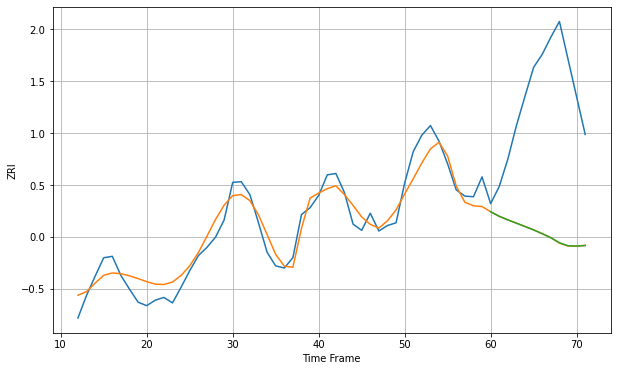

Wall time: 6.55 s
2150 20.952680650162943 210.14170420955202 210.13300012329418 [2367.11632253 2360.46320759 2355.304069   2350.42386943 2345.52390173
 2340.56453179 2335.00967811 2329.09667755 2321.87443471 2317.4081507
 2317.04409339 2317.73576331]

Got an mse at 0.0099 in round 146 and stopped training

60 60 12


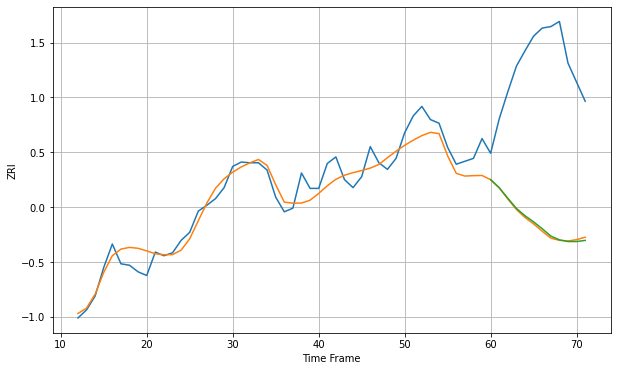

Wall time: 7.8 s
2151 19.29018281827379 219.3292994792495 218.53776644488286 [2324.89201064 2313.90143153 2299.48429481 2285.65864025 2275.59358382
 2267.24036237 2257.91000054 2247.84592761 2242.6940928  2240.3978206
 2240.42116726 2241.93979726]

Got an mse at 0.0100 in round 278 and stopped training

60 60 12


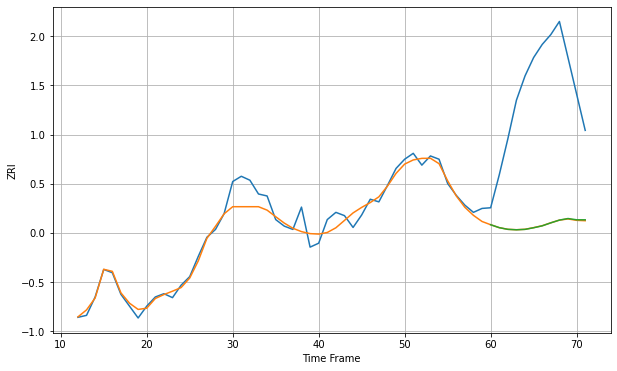

Wall time: 10.9 s
2152 15.245408071081924 214.82773126472082 214.69510592286937 [2417.14594215 2412.69001939 2410.11040653 2409.44200504 2410.04620933
 2412.53530837 2415.44759883 2420.01146923 2424.22963107 2426.58999692
 2424.66713841 2424.62300397]

Got an mse at 0.0098 in round 136 and stopped training

60 60 12


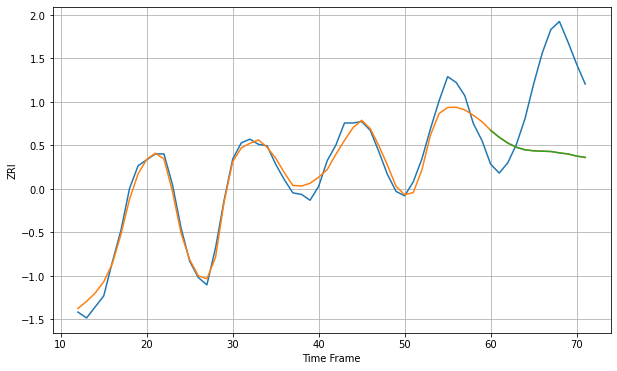

Wall time: 7.51 s
2155 13.923403348656008 108.46456603699185 108.42275510440246 [2393.10028368 2383.53425611 2375.6931238  2369.94434918 2366.50169418
 2365.18221723 2364.68841927 2364.26323725 2362.38561522 2360.93862494
 2358.07251749 2356.35623106]

Got an mse at 0.0099 in round 90 and stopped training

60 60 12


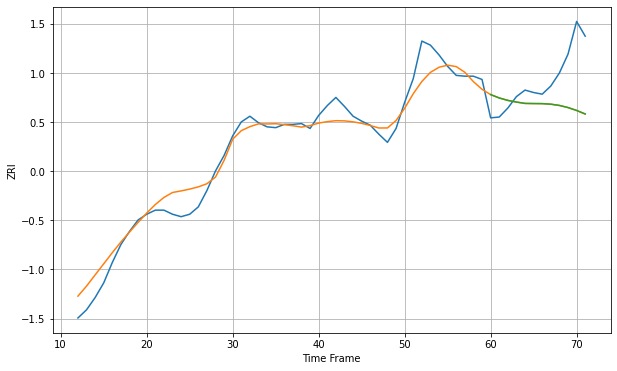

Wall time: 6.5 s
2169 16.91045624804609 49.514922089858516 49.454900070927216 [2008.4593406  2004.35925948 2001.36659155 1999.34069013 1997.67622817
 1997.50749725 1997.40773507 1996.73745756 1995.20226131 1992.61858986
 1989.09297646 1984.7953045 ]

Got an mse at 0.0099 in round 180 and stopped training

60 60 12


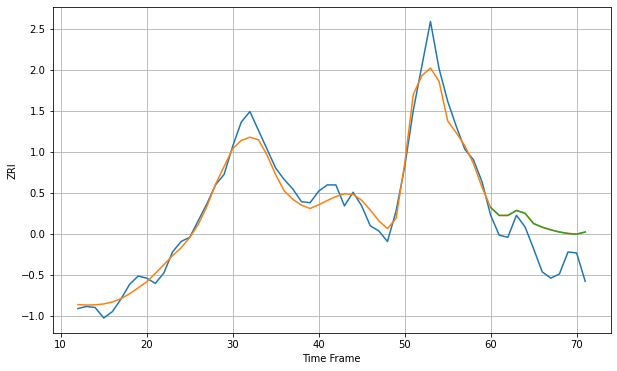

Wall time: 8.69 s
2170 11.365328870795734 28.91137786809296 28.874362287973295 [1914.49652664 1906.86946929 1906.86698458 1911.64875012 1908.9380005
 1899.06239286 1895.62593641 1893.09135616 1891.02155826 1889.64763026
 1888.97937168 1891.02396096]

Got an mse at 0.0099 in round 142 and stopped training

60 60 12


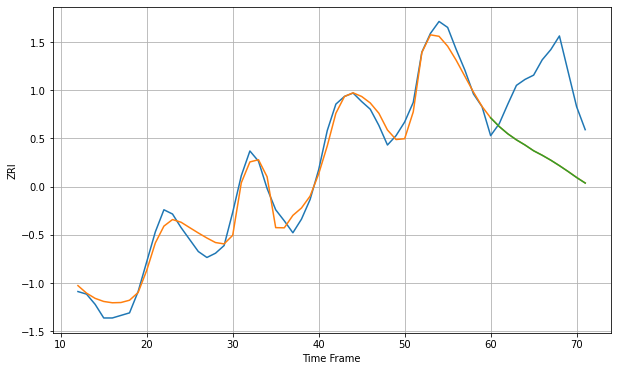

Wall time: 7.68 s
2171 13.060943965057287 89.7905445040866 89.81059891593367 [2186.9022036  2176.67604629 2168.13309331 2161.07394985 2154.99968611
 2148.24530072 2142.96612033 2137.15564555 2130.76425415 2123.98443537
 2116.86074014 2110.34400312]

Got an mse at 0.0099 in round 71 and stopped training

60 60 12


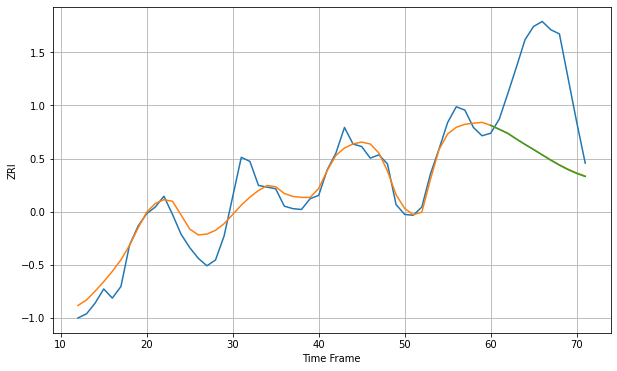

Wall time: 6.06 s
2176 18.883500497631513 107.9937460967231 108.2468123185668 [2276.60136486 2271.82584099 2266.850508   2260.05128684 2253.53895181
 2247.30115998 2240.80964142 2234.46239168 2228.48032959 2223.12991049
 2218.52719109 2214.81562798]
60 60 12


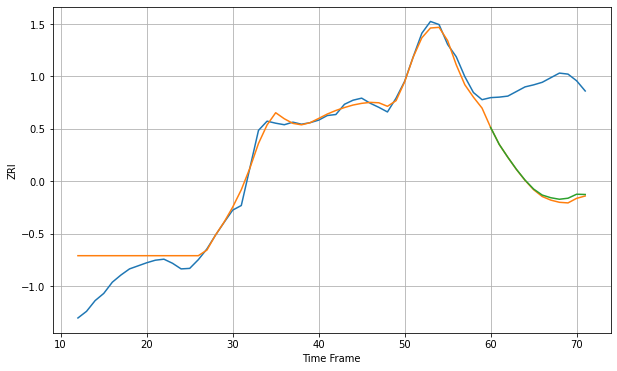

Wall time: 16 s
2184 32.56159540360864 194.66805316669667 191.05663774787695 [2136.61740119 2103.54445385 2078.34372524 2054.76254877 2033.75145652
 2016.19950626 2004.42801432 1999.19803222 1996.22740862 1998.26514084
 2006.07149003 2005.56749424]

Got an mse at 0.0099 in round 154 and stopped training

60 60 12


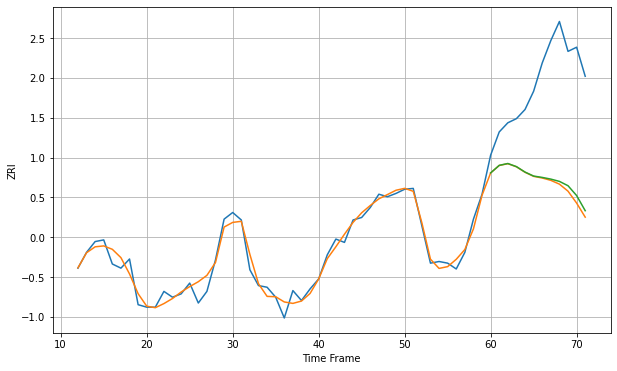

Wall time: 7.97 s
2210 9.593318729520556 129.83232682180224 126.50788889929945 [2902.65400877 2911.76641645 2913.99298811 2910.2259126  2903.66510458
 2898.87645184 2897.23066188 2895.20556254 2892.45449788 2887.23151671
 2875.40011772 2857.16380041]

Got an mse at 0.0098 in round 94 and stopped training

60 60 12


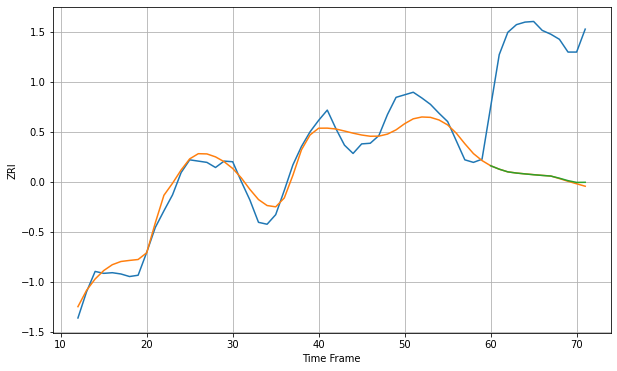

Wall time: 6.58 s
2215 20.172039723491636 214.17111178704172 213.334663443453 [2360.74992653 2355.35476775 2351.13393746 2349.26635936 2347.90544144
 2346.65422154 2345.52907527 2344.5353202  2341.19719544 2337.36960858
 2334.56328065 2334.76169928]

Got an mse at 0.0100 in round 147 and stopped training

60 60 12


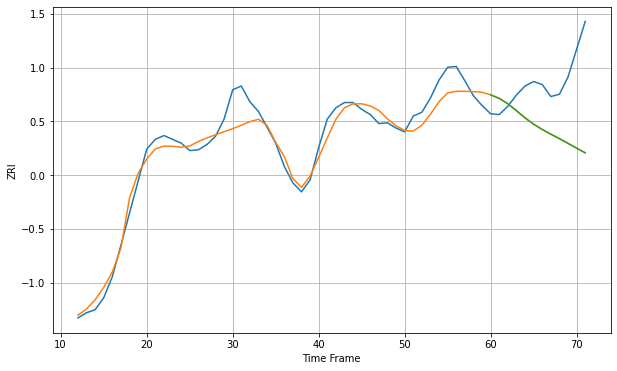

Wall time: 7.92 s
2301 17.72343079970321 77.42373566204175 77.46097001775935 [1680.22694248 1675.5761914  1668.38928584 1659.17512987 1649.58355343
 1641.18433913 1634.09864898 1627.87633034 1621.89207001 1615.58470988
 1609.19556622 1602.9452048 ]

Got an mse at 0.0100 in round 58 and stopped training

60 60 12


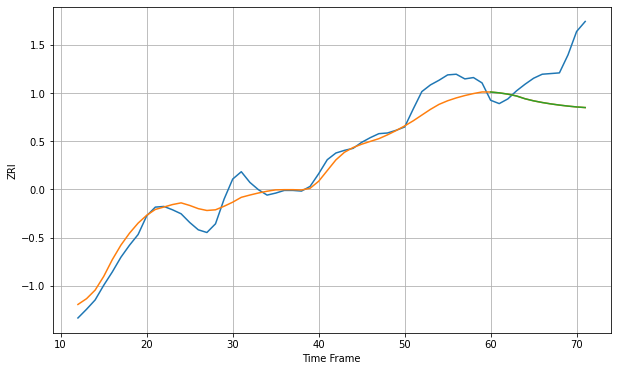

Wall time: 5.94 s
2302 19.388129041528693 60.28495202057461 60.27346878182188 [1713.37560185 1712.09266865 1710.18918684 1707.46028801 1703.26192113
 1700.12765166 1697.65246159 1695.56479484 1693.78942043 1692.27493584
 1691.00662762 1690.08924905]

Got an mse at 0.0099 in round 61 and stopped training

60 60 12


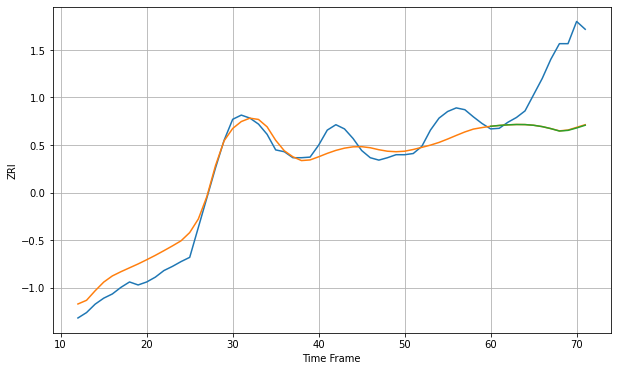

Wall time: 6.01 s
2360 24.40024364218767 100.52998564509441 100.90201628176365 [1773.37233944 1774.7352452  1775.76030204 1776.34305787 1776.20573888
 1775.04956515 1772.81348545 1769.49202907 1765.43217176 1766.56801433
 1770.5758119  1775.119494  ]

Got an mse at 0.0100 in round 161 and stopped training

60 60 12


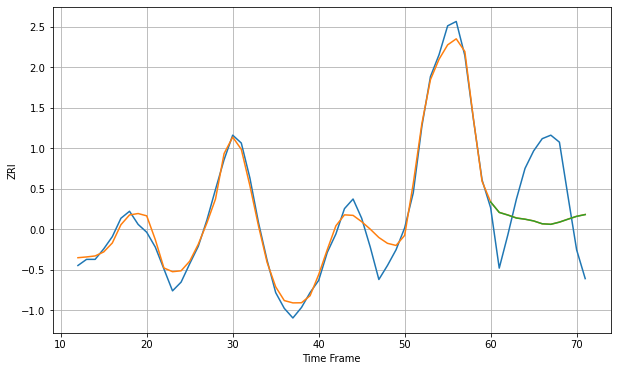

Wall time: 8.31 s
2445 12.37839847366397 64.93019691401581 64.92410971684451 [2796.63584633 2784.68840608 2781.66454585 2778.27191151 2776.91167163
 2774.95123308 2771.67933782 2771.0876465  2773.57453147 2776.96257104
 2780.1897311  2782.21969443]

Got an mse at 0.0099 in round 73 and stopped training

60 60 12


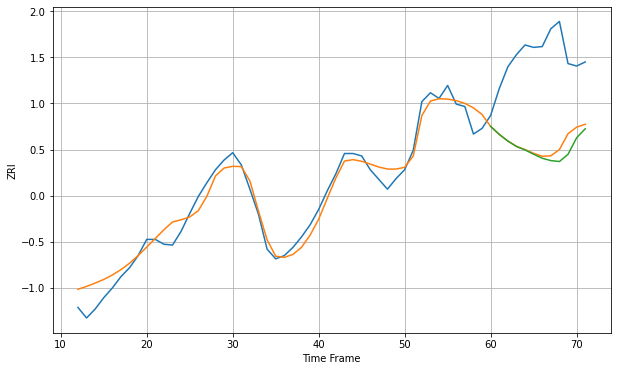

Wall time: 6.13 s
2446 14.904157390252482 110.06602288805628 115.94758768605494 [2899.46423512 2889.61518114 2881.41747764 2874.70913489 2870.40617819
 2865.16028243 2860.17241698 2857.25779134 2856.12073305 2865.01218164
 2885.39945207 2896.50657337]

Got an mse at 0.0098 in round 115 and stopped training

60 60 12


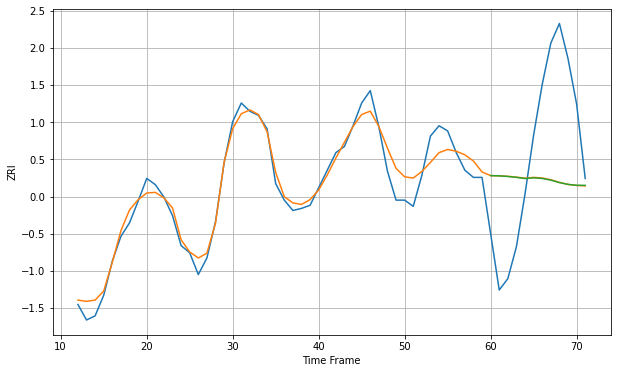

Wall time: 7.05 s
2451 12.291607922400209 92.22078363927018 92.30599942761452 [2435.73014906 2435.49028488 2434.89995468 2434.03611782 2432.91560906
 2433.56484835 2432.97779858 2431.35672911 2428.9656918  2427.22748961
 2426.37833822 2426.31480874]

Got an mse at 0.0098 in round 100 and stopped training

60 60 12


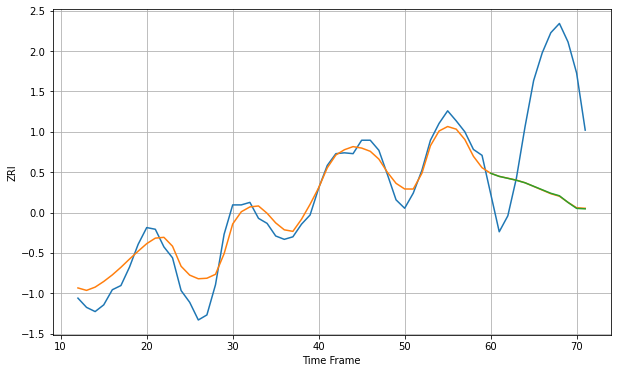

Wall time: 6.71 s
2453 17.52824756393006 130.32641222677003 130.27526480961117 [2396.6655131  2392.93067898 2390.63678327 2388.310911   2385.33784719
 2381.16661596 2377.0165389  2372.84138452 2369.85549379 2361.93562311
 2354.82736074 2354.30024991]

Got an mse at 0.0099 in round 106 and stopped training

60 60 12


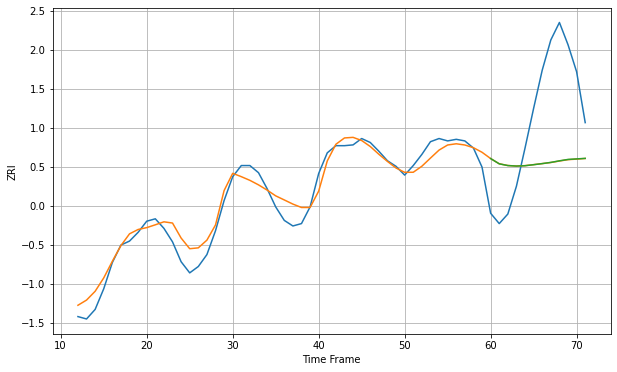

Wall time: 7.03 s
2458 14.61620499970536 101.34841474668706 101.23250962546955 [2557.80454299 2551.17061226 2548.99512177 2548.3446388  2548.77093899
 2550.07144683 2551.45654255 2552.9565382  2554.95037101 2556.69352938
 2557.37430779 2558.02729881]

Got an mse at 0.0099 in round 109 and stopped training

60 60 12


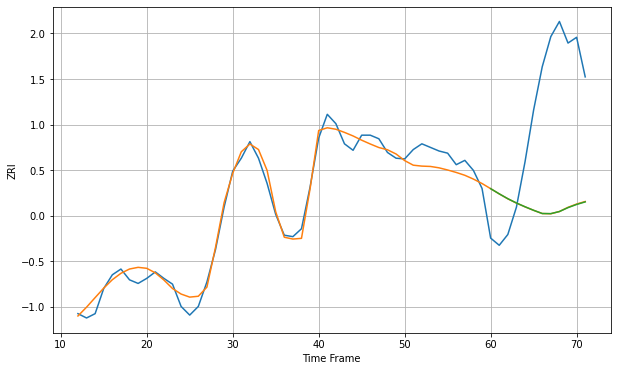

Wall time: 6.97 s
2460 13.933961215443318 169.15306886421777 169.2877757752425 [2617.68239307 2610.48866422 2603.72191536 2597.79239828 2592.51308186
 2587.61382088 2583.13795879 2583.00108837 2585.90409413 2591.3401864
 2595.72004619 2599.29842166]

Got an mse at 0.0098 in round 95 and stopped training

60 60 12


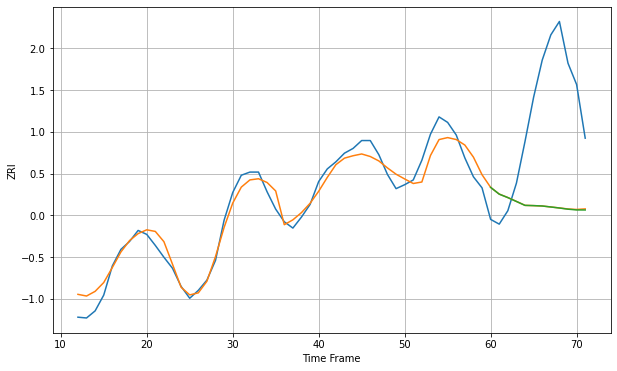

Wall time: 7.02 s
2472 14.684888479715696 139.78233205811236 139.9561066305443 [2391.60673518 2383.01990319 2378.6593674  2373.74142512 2368.77057528
 2368.48256499 2368.00731835 2366.74378048 2365.44132313 2363.95271699
 2363.00146121 2362.95467225]
60 60 12


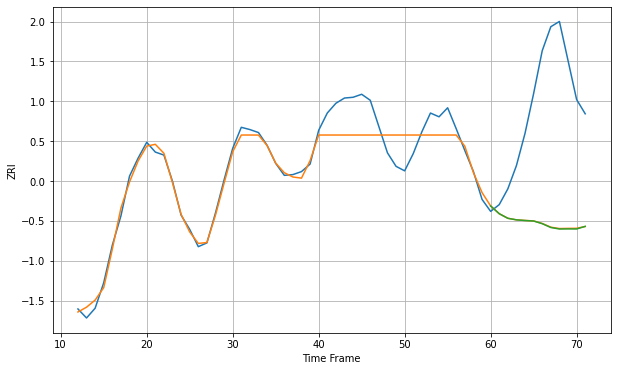

Wall time: 16.5 s
2474 21.468857387468905 171.1686780602447 171.48935413071095 [2346.22921062 2335.90740082 2329.79375986 2327.71014105 2326.83081621
 2326.16900354 2322.6213314  2317.52835698 2315.53371486 2315.65847399
 2315.54827767 2319.04615204]

Got an mse at 0.0098 in round 87 and stopped training

60 60 12


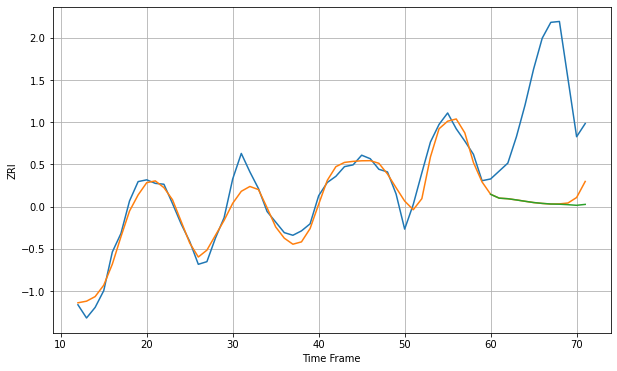

Wall time: 6.32 s
2476 12.697871460220524 126.78893327283131 128.76840100932756 [2264.54724057 2260.1573512  2259.52355507 2258.1584558  2256.65083789
 2255.213197   2254.23507976 2253.51736613 2253.30254564 2252.76355862
 2252.05632828 2253.09875446]

Got an mse at 0.0100 in round 101 and stopped training

60 60 12


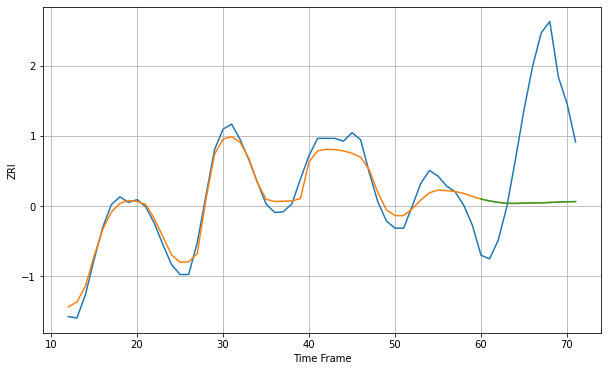

Wall time: 6.65 s
2478 15.527999473185723 144.77691996390845 144.74215695875267 [2477.87906482 2475.15401499 2473.24357611 2471.82650536 2471.72395734
 2472.14992685 2472.42167043 2472.49574071 2473.06839663 2473.62080219
 2474.02359539 2474.34711065]

Got an mse at 0.0099 in round 216 and stopped training

60 60 12


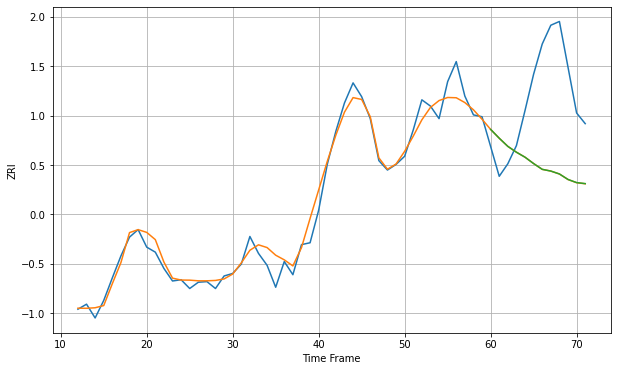

Wall time: 9.39 s
2494 18.261127396897994 140.89326492701824 140.84100790065875 [2822.80663906 2808.74580924 2795.73549887 2786.43332337 2778.45981347
 2768.29347821 2759.09784189 2756.35617985 2751.72755224 2742.96401033
 2737.96487895 2736.35441744]

Got an mse at 0.0100 in round 114 and stopped training

60 60 12


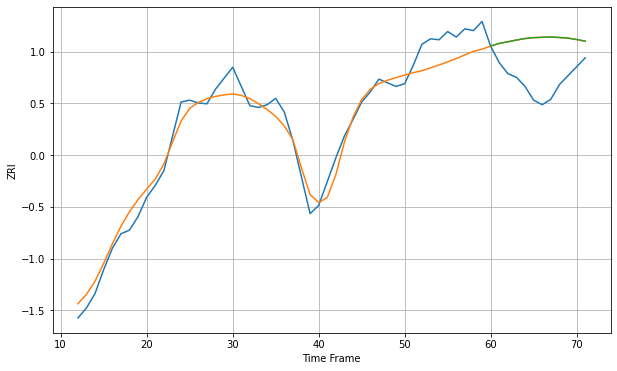

Wall time: 7.05 s
2703 16.049543997022816 46.81809432970204 46.85707138765639 [1430.02937823 1433.02599403 1434.80619383 1436.68327329 1438.36497981
 1439.31525798 1439.73164282 1440.03293216 1439.48372582 1438.84328716
 1437.32948199 1435.56386529]

Got an mse at 0.0100 in round 69 and stopped training

60 60 12


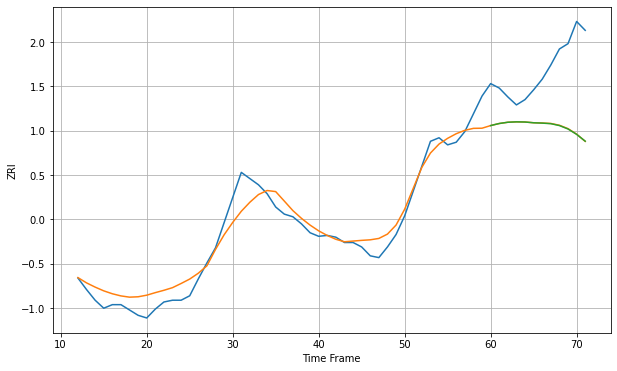

Wall time: 5.82 s
2721 15.371716096438018 71.93301550880358 72.04361492899118 [1057.72787074 1060.0607562  1061.48026358 1061.92278647 1061.73181331
 1060.86722251 1060.49351486 1059.8561027  1057.746473   1053.88353563
 1047.83766095 1040.16114858]

Got an mse at 0.0099 in round 63 and stopped training

60 60 12


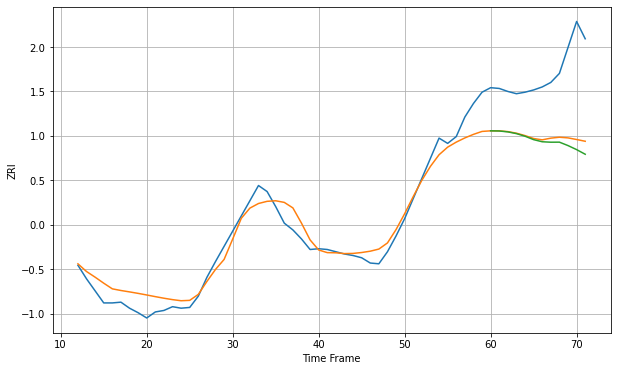

Wall time: 5.75 s
2723 17.816545440810273 88.8640906979214 95.5193076223489 [1123.67172    1123.46477356 1122.28028283 1119.96009972 1116.5068191
 1111.96087875 1109.15311119 1108.55847081 1108.62411561 1104.07626846
 1098.71126386 1092.54950041]

Got an mse at 0.0099 in round 57 and stopped training

60 60 12


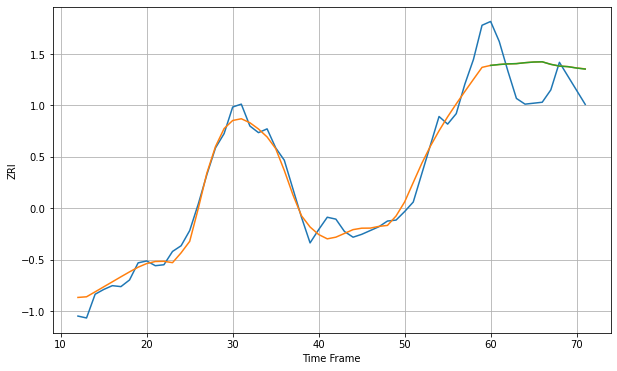

Wall time: 5.54 s
2740 12.124104114270562 32.28446057261177 32.2537350143949 [1256.7716743  1257.71860173 1258.35319626 1258.62382433 1259.61092558
 1260.30552501 1260.567126   1257.88634284 1256.06146685 1255.43564654
 1253.97987325 1252.88410571]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


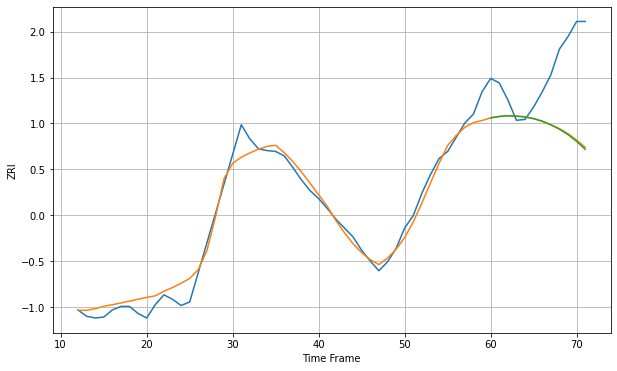

Wall time: 5.39 s
2746 11.787792697140247 73.98163249462253 74.77948687096828 [1103.72315994 1105.25295587 1106.15136308 1105.59423652 1104.77312024
 1102.84269905 1099.9337104  1095.82095614 1091.04595571 1084.98058487
 1077.30643159 1068.43791335]

Got an mse at 0.0099 in round 113 and stopped training

60 60 12


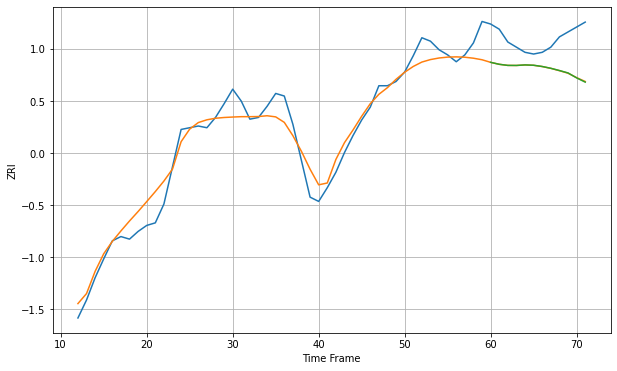

Wall time: 6.79 s
2780 17.2331340922497 39.06884246712329 39.14647087891813 [1371.30793804 1369.02127244 1367.74135312 1367.672926   1368.31069405
 1367.91140953 1366.45070067 1364.35793518 1361.76618378 1358.94361039
 1353.1919049  1348.21822998]

Got an mse at 0.0097 in round 129 and stopped training

60 60 12


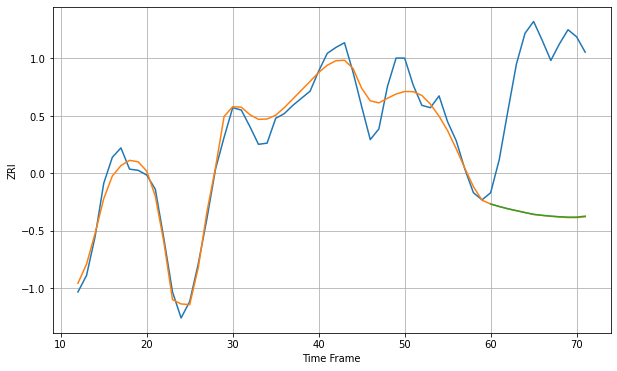

Wall time: 7.26 s
2840 12.312073869413727 129.92541800269592 129.74039871234132 [1805.48343485 1803.35130161 1801.47024402 1799.85674249 1798.27335462
 1796.73878079 1795.90274022 1795.2270633  1794.71023566 1794.33251589
 1794.36779242 1795.21672608]

Got an mse at 0.0100 in round 83 and stopped training

60 60 12


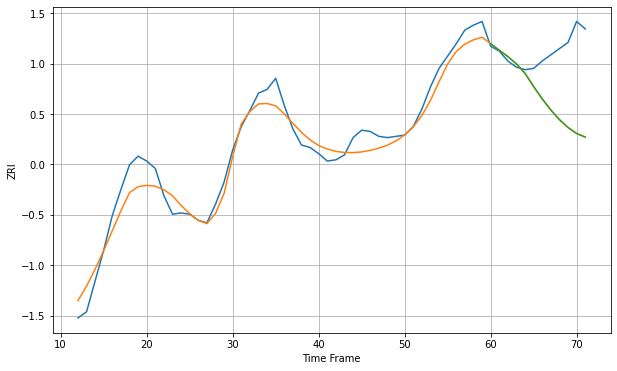

Wall time: 6.2 s
2860 11.223224813086132 47.52800360964219 47.53681313583569 [1202.0446566  1196.73235525 1191.60192014 1185.68659028 1178.02518836
 1167.2944282  1157.31069128 1148.34915212 1140.56466872 1134.19123004
 1129.28736914 1126.42606584]
60 60 12


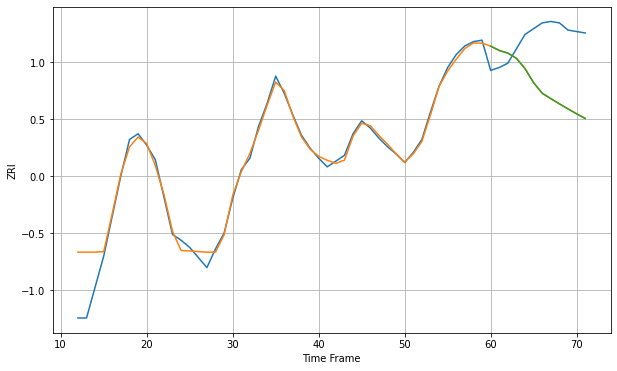

Wall time: 15.7 s
2861 10.374962384468006 41.55615694897475 41.52971790641025 [1192.86333224 1189.85970327 1188.00759173 1184.38225505 1177.23200527
 1167.46809603 1160.15311854 1156.3833718  1152.75301056 1149.25616895
 1145.85030593 1142.69010387]

Got an mse at 0.0097 in round 86 and stopped training

60 60 12


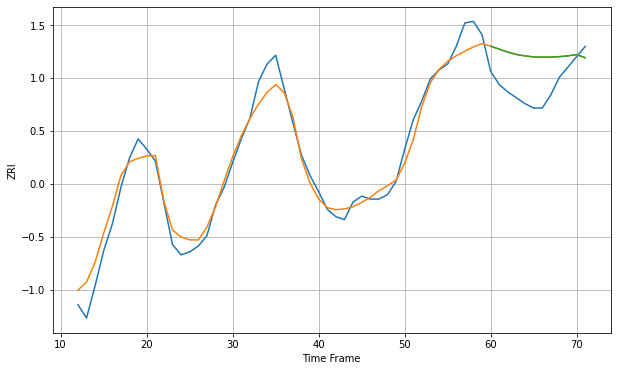

Wall time: 6.21 s
2863 9.400939957527454 24.033873015182433 24.045443592958247 [1217.12699416 1215.13405104 1213.09084821 1211.51054703 1210.55476628
 1209.86543969 1209.68836858 1209.76268403 1210.01589487 1210.55526544
 1211.42778706 1209.27658859]

Got an mse at 0.0098 in round 104 and stopped training

60 60 12


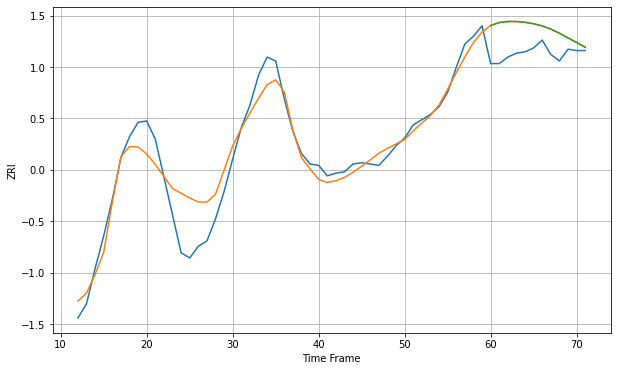

Wall time: 6.65 s
2864 15.034932281985823 20.632570634868337 20.615594248023356 [1288.20628686 1290.46990057 1291.29477753 1291.24520046 1290.66834753
 1289.54793955 1287.84165655 1285.44549998 1282.2604675  1278.64345452
 1275.15440517 1271.38615589]

Got an mse at 0.0092 in round 146 and stopped training

60 60 12


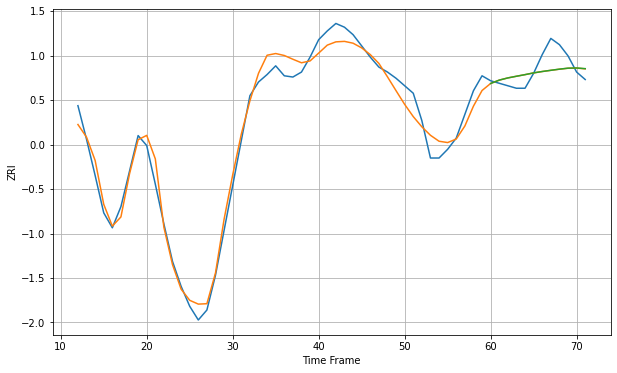

Wall time: 7.58 s
2891 9.821078926404665 11.812563764416058 11.808173428209072 [1201.84321561 1204.52193381 1206.28885874 1207.63230574 1208.92926039
 1210.32961392 1211.44270814 1212.40845249 1213.32626444 1214.12854466
 1214.28262797 1213.73444889]

Got an mse at 0.0099 in round 200 and stopped training

60 60 12


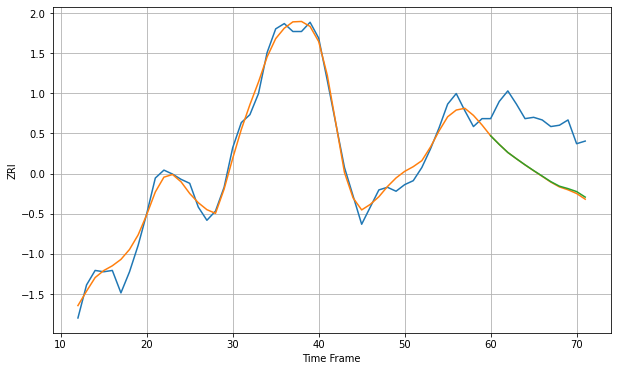

Wall time: 8.93 s
2893 7.553941386378715 40.743605244386664 40.27452527059726 [1218.99779696 1212.47277729 1206.3755952  1201.61478655 1197.02248294
 1192.66487107 1188.48621181 1184.26353111 1180.84077879 1178.99153532
 1176.74529671 1172.56018197]

Got an mse at 0.0099 in round 106 and stopped training

60 60 12


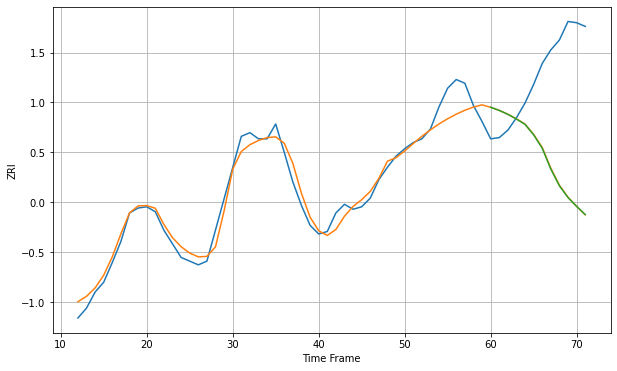

Wall time: 6.65 s
2895 9.477200633684705 89.62848556195915 89.82178527363736 [1093.53432075 1091.00715587 1087.84460213 1084.03114137 1079.70517425
 1071.27773454 1060.39135445 1043.49648554 1029.95525254 1020.47327215
 1013.32179277 1006.74340714]

Got an mse at 0.0099 in round 117 and stopped training

60 60 12


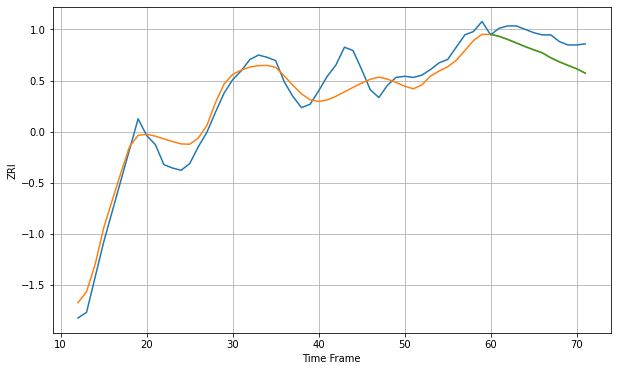

Wall time: 6.89 s
2904 14.063543903072263 16.800514114846678 16.773432280477905 [1239.49593904 1237.68343613 1234.89840907 1231.74217013 1228.61441672
 1225.71628564 1222.95973088 1218.51540631 1214.88587594 1211.70982001
 1208.73262623 1204.90444182]

Got an mse at 0.0099 in round 41 and stopped training

60 60 12


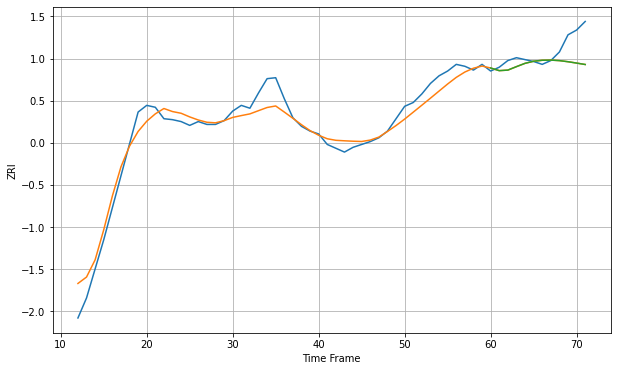

Wall time: 5.27 s
2905 12.53566578779316 19.068468535440264 19.0659281417292 [1273.1991676  1270.4237729  1270.98467351 1274.61292881 1278.09400855
 1280.275677   1281.30384327 1281.47618589 1280.9390502  1279.77570748
 1278.35586784 1276.85958055]

Got an mse at 0.0100 in round 65 and stopped training

60 60 12


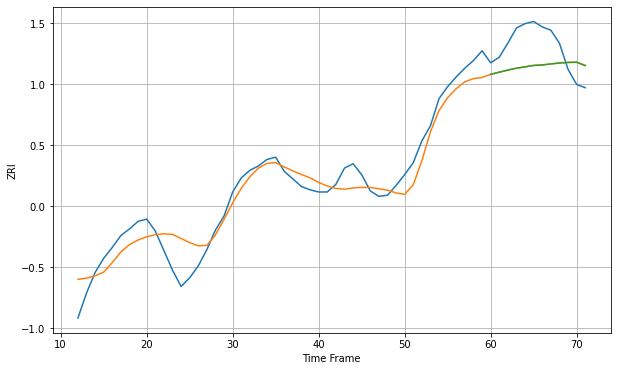

Wall time: 5.92 s
2906 15.726581056107808 27.28302826698615 27.24769719708458 [1540.28263643 1542.30789798 1544.19090789 1545.98531609 1547.18077159
 1548.54032863 1548.9428956  1549.91729275 1550.70962788 1551.24812046
 1551.41904211 1548.32548634]

Got an mse at 0.0099 in round 69 and stopped training

60 60 12


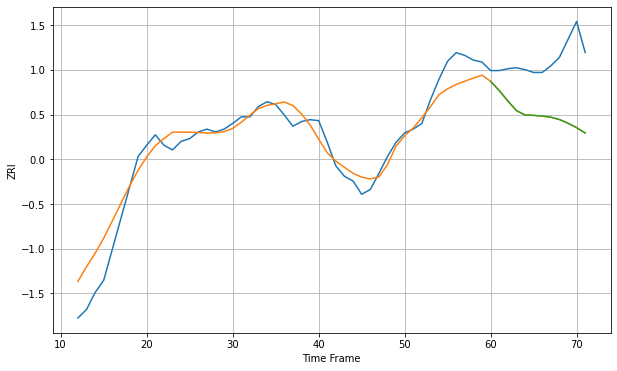

Wall time: 5.91 s
2907 17.831111028486117 61.48143869311385 61.49913607469544 [1240.561542   1230.8502714  1219.84954904 1209.60728058 1204.93049382
 1204.57287182 1203.83381607 1202.61644094 1200.16638809 1196.25861541
 1191.55967666 1185.76086759]

Got an mse at 0.0099 in round 84 and stopped training

60 60 12


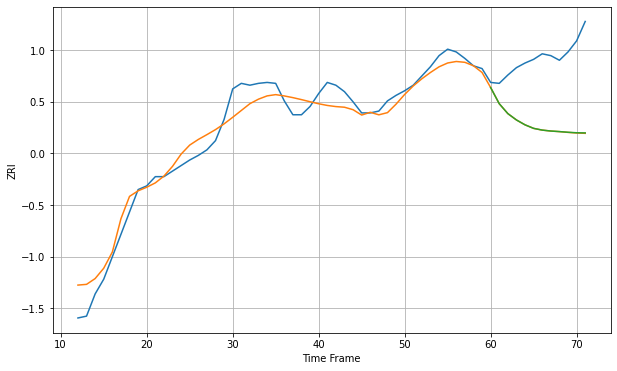

Wall time: 6.18 s
2908 14.937787468836765 74.82660329909685 74.71431437611999 [1255.47147204 1237.9742536  1227.25657385 1220.3749865  1215.09543199
 1211.26892991 1209.39979177 1208.38562174 1207.78699002 1207.04443084
 1206.50760338 1206.35328737]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


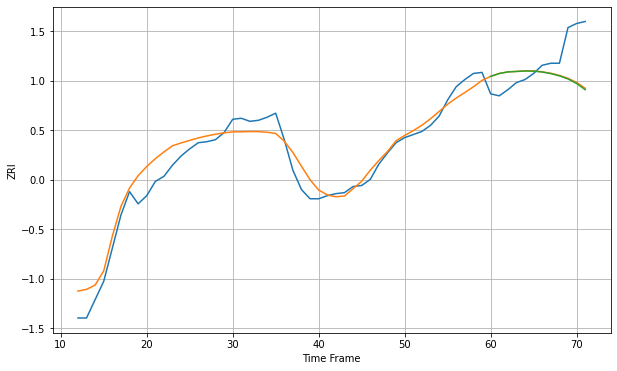

Wall time: 5.46 s
2909 13.355492520550806 31.211728825276733 31.70027693344894 [1251.11979001 1253.91382686 1255.46703125 1255.91926517 1256.42334786
 1256.26102231 1255.3875285  1253.85019892 1251.62787219 1248.59895356
 1244.12714795 1238.07389036]

Got an mse at 0.0098 in round 38 and stopped training

60 60 12


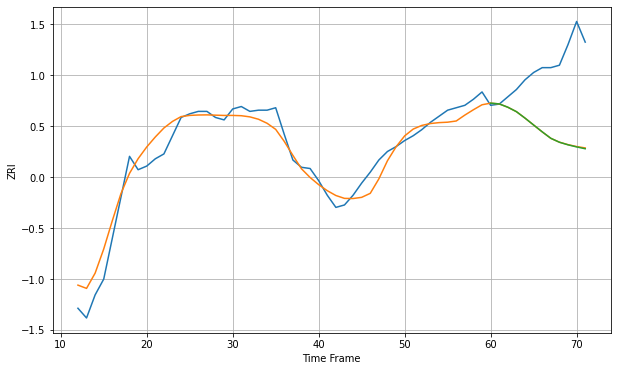

Wall time: 5.08 s
2910 10.92679287209962 56.586179890435986 56.73371569674719 [1206.77750707 1206.15732227 1203.41841664 1199.772064   1194.45619385
 1188.80147971 1183.16969174 1177.85695272 1174.59913588 1172.48673399
 1170.76817022 1169.26295048]

Got an mse at 0.0100 in round 77 and stopped training

60 60 12


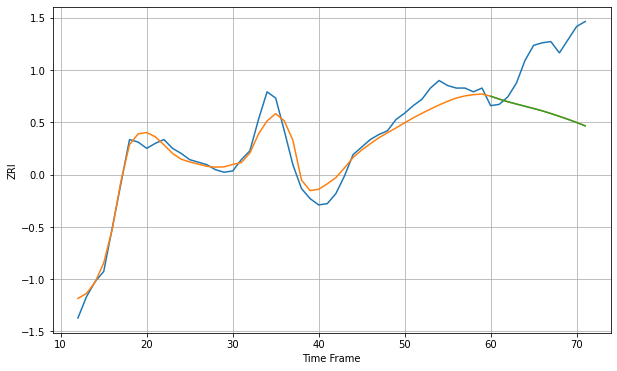

Wall time: 6 s
2914 9.039079722783208 49.77031627830306 49.802398615574134 [1259.49472708 1257.18908346 1255.13026845 1253.27369734 1251.50191362
 1249.7397009  1247.86174024 1245.72812912 1243.46562068 1241.10043305
 1238.55103417 1235.88571592]

Got an mse at 0.0099 in round 44 and stopped training

60 60 12


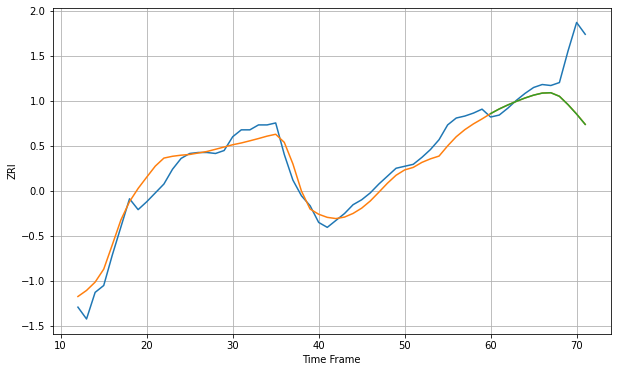

Wall time: 5.39 s
2920 12.695216930756771 41.23618418026128 41.284154511601805 [1232.48727968 1237.19685539 1241.26128231 1244.93603075 1248.3328474
 1251.22379262 1253.30049783 1253.65663139 1250.03865193 1241.58687208
 1231.98785091 1221.50452955]

Got an mse at 0.0098 in round 67 and stopped training

60 60 12


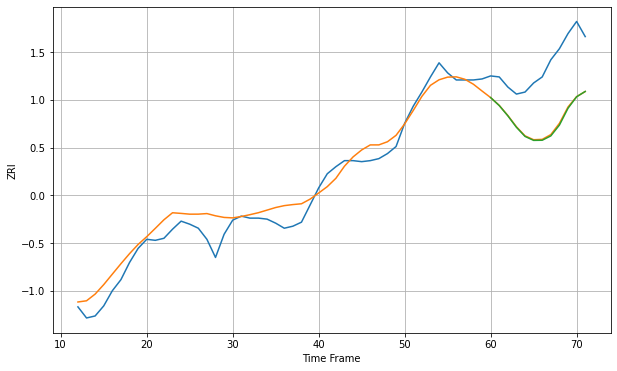

Wall time: 6.01 s
3038 13.727420893359643 55.370415269548715 56.069156150340845 [1344.52553661 1336.62818807 1326.46800493 1315.08558863 1306.01939803
 1302.08470033 1302.21876511 1306.54131307 1317.26327472 1333.95756532
 1345.32557149 1350.61514722]

Got an mse at 0.0098 in round 44 and stopped training

60 60 12


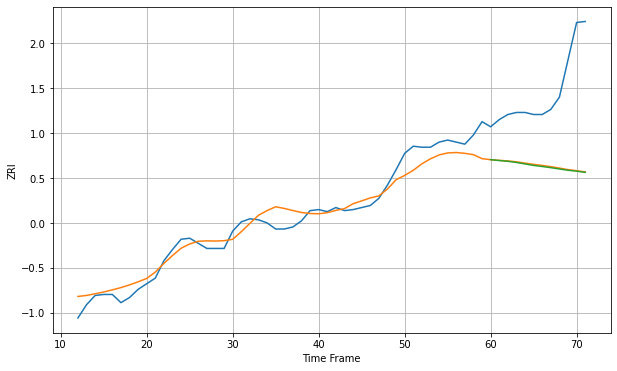

Wall time: 5.49 s
3060 11.886876884367728 79.83031065325176 80.36697281950994 [1403.82537021 1402.98030579 1402.2272842  1401.11066949 1399.63404678
 1398.230829   1397.15722941 1396.01763284 1394.74020828 1393.47312173
 1392.56219956 1391.41938713]

Got an mse at 0.0100 in round 42 and stopped training

60 60 12


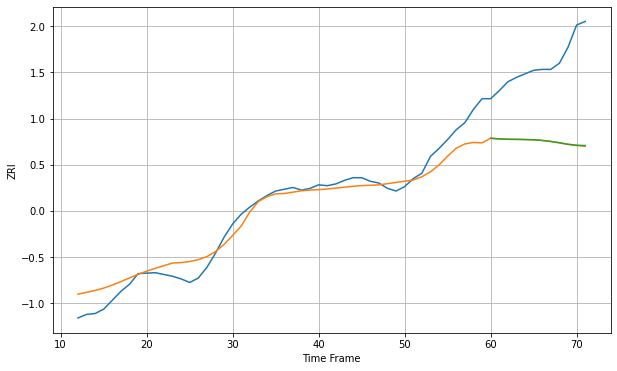

Wall time: 5.22 s
3102 15.631851699217798 89.83128442877421 89.63157766816049 [1259.47728249 1258.69721104 1258.31920714 1258.20616968 1258.03544538
 1257.74907127 1257.0329262  1255.89628628 1254.4008704  1252.70969957
 1251.5867719  1251.19884476]

Got an mse at 0.0096 in round 40 and stopped training

60 60 12


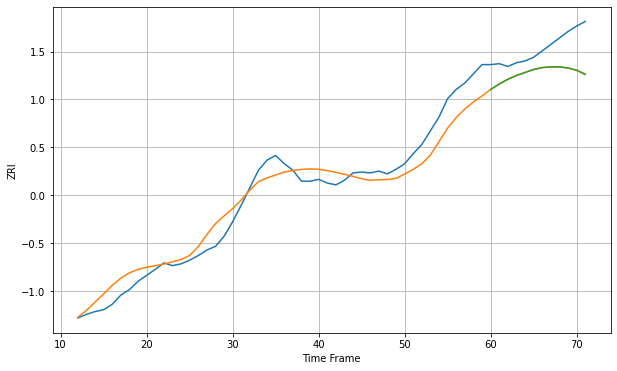

Wall time: 5.19 s
3103 16.47514163727958 30.52639130977158 30.305999894659692 [1252.87670002 1258.86557376 1264.0652039  1268.128609   1271.46162842
 1274.73844173 1276.8060372  1277.62773578 1277.54975431 1276.43461406
 1273.99533586 1269.62273477]

Got an mse at 0.0099 in round 45 and stopped training

60 60 12


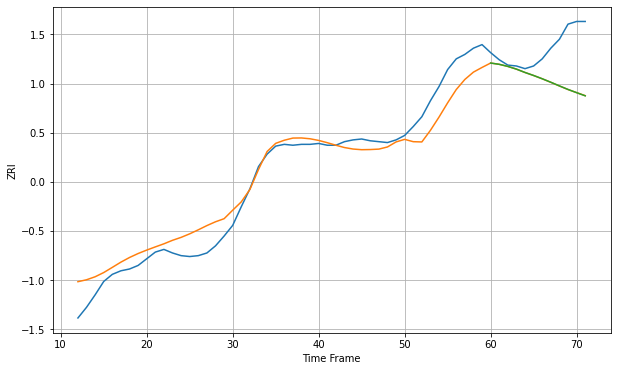

Wall time: 5.29 s
3104 18.905646076874586 44.489319126558975 44.502174705466985 [1277.30761443 1275.86723698 1273.53403007 1270.47555276 1266.71671754
 1263.33024696 1259.65770462 1255.73052336 1251.63159604 1247.64420461
 1244.0504868  1240.47559366]

Got an mse at 0.0100 in round 151 and stopped training

60 60 12


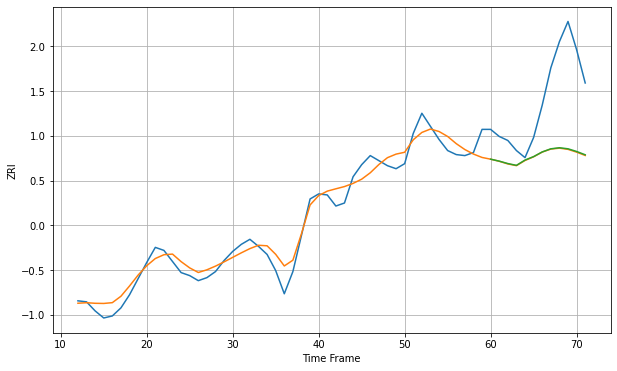

Wall time: 7.7 s
3301 10.976728151470702 67.07710071025028 66.72897300008326 [1281.44709841 1279.51032796 1277.11624109 1275.32988027 1280.57797306
 1284.01131721 1288.64006736 1291.7198177  1292.78916374 1291.74508638
 1289.09578223 1285.80167538]

Got an mse at 0.0099 in round 23 and stopped training

60 60 12


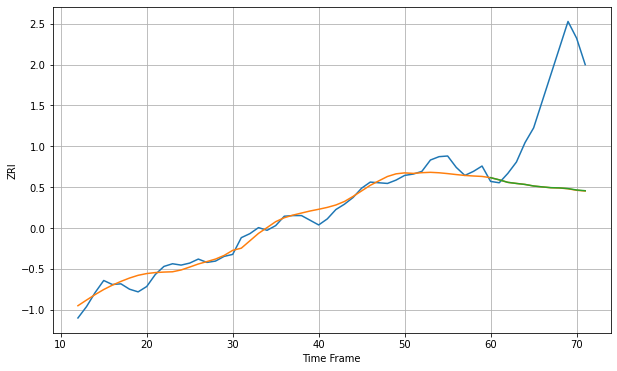

Wall time: 4.78 s
3820 11.363861330640805 144.64217039775912 144.46791975368095 [1366.59741138 1363.38282159 1359.62833599 1357.99230899 1356.49765145
 1354.18117818 1352.84444676 1351.69316075 1351.36046994 1350.32818902
 1348.21335177 1347.09814086]

Got an mse at 0.0099 in round 53 and stopped training

60 60 12


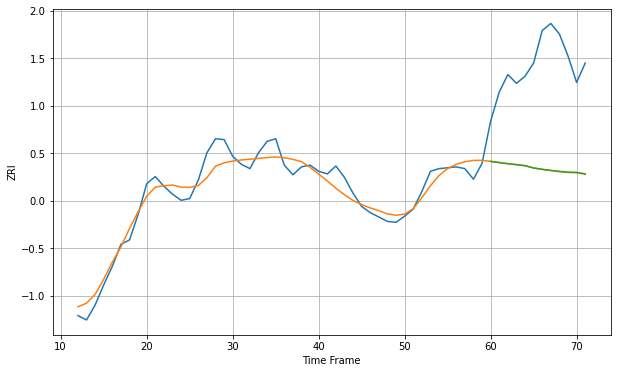

Wall time: 5.47 s
4101 12.84791211123254 120.13945387652971 119.99323560848597 [1680.26150165 1678.93696126 1677.62056879 1676.55880424 1675.37575702
 1672.7860806  1671.24286445 1669.9812127  1668.86040165 1668.00413186
 1667.72863906 1666.018629  ]

Got an mse at 0.0099 in round 105 and stopped training

60 60 12


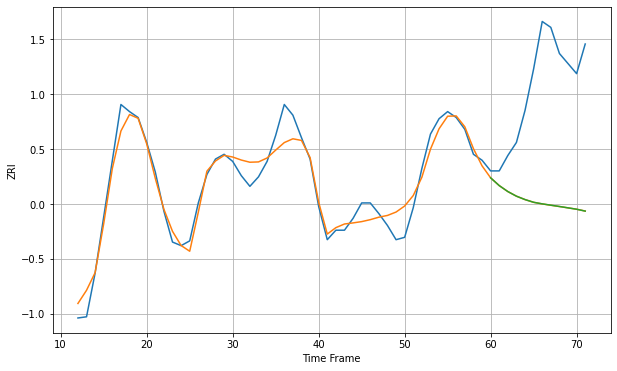

Wall time: 6.66 s
4102 11.328626950364042 104.87698209433249 104.85545764078721 [1636.14364722 1629.6113479  1624.586628   1620.69393688 1617.83106915
 1615.54764765 1614.21596433 1613.0997202  1612.01398756 1610.8539319
 1609.67512197 1608.11083223]

Got an mse at 0.0098 in round 71 and stopped training

60 60 12


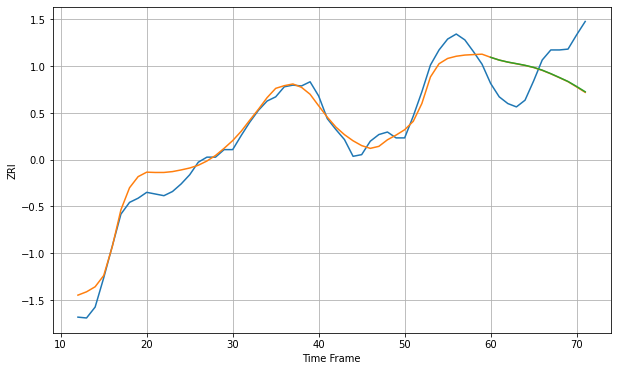

Wall time: 5.85 s
4103 14.612632361682376 45.24982125566032 45.07558700452722 [1602.19593837 1598.92187356 1596.51935489 1594.63224514 1592.65528689
 1590.19871686 1586.87089173 1582.68884439 1578.09331072 1573.37100344
 1567.39881493 1561.06326191]

Got an mse at 0.0100 in round 290 and stopped training

60 60 12


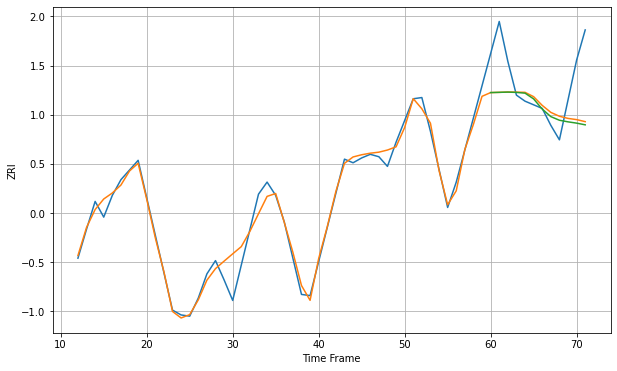

Wall time: 10.9 s
4210 8.48302872539924 34.36151320887714 35.05947086696729 [1054.1196719  1054.30627524 1054.51089427 1054.25900762 1053.64787905
 1048.88807314 1040.44834611 1034.21648117 1031.20861556 1029.88880381
 1028.82545988 1027.41984554]

Got an mse at 0.0099 in round 194 and stopped training

60 60 12


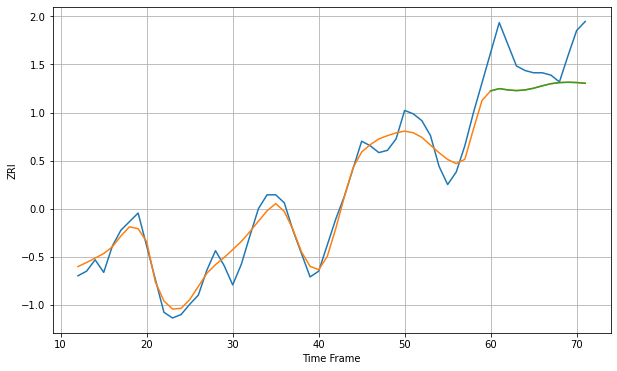

Wall time: 8.85 s
4240 10.973976482372391 32.57918386177108 32.6271672838649 [1038.12696271 1040.10288545 1038.99153649 1038.36962675 1038.93657869
 1040.46038172 1042.55431256 1044.38943074 1045.3731788  1045.67228984
 1045.40425117 1044.76077699]

Got an mse at 0.0100 in round 148 and stopped training

60 60 12


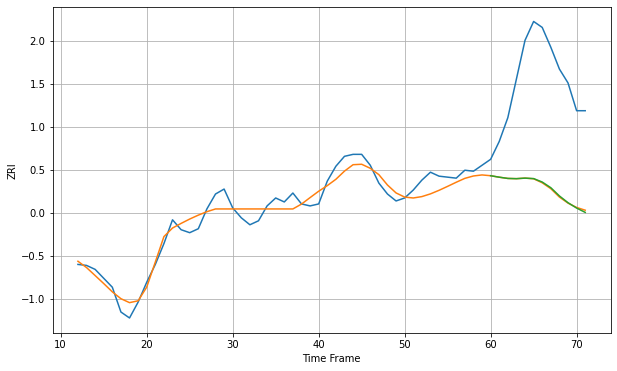

Wall time: 7.6 s
4401 10.252164462195749 113.92102506232877 113.77164644479102 [1111.44288341 1109.96855217 1108.71265592 1108.4749541  1109.00614598
 1108.55970355 1105.0895481  1099.36069022 1091.05115614 1084.24086715
 1078.82885808 1074.47978892]

Got an mse at 0.0099 in round 166 and stopped training

60 60 12


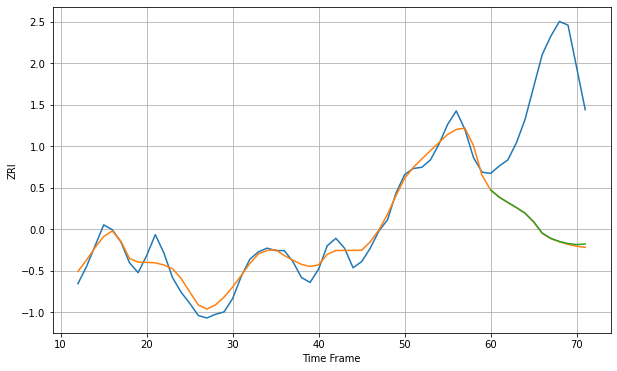

Wall time: 8.08 s
4901 7.890155004310724 118.93749692052288 118.36370951977852 [858.45875915 852.60938838 848.26270148 844.09488847 839.52495744
 832.5810241  823.39829919 818.98830063 816.47772651 814.74595156
 813.89880085 814.39003323]

Got an mse at 0.0100 in round 99 and stopped training

60 60 12


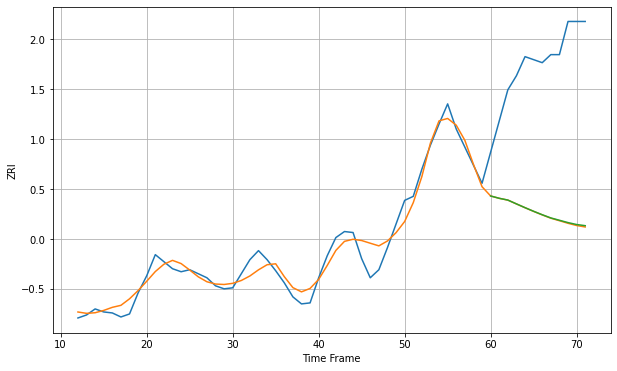

Wall time: 6.49 s
4937 10.81130716136822 153.18766361829742 152.7547798625687 [972.3733671  970.07106433 968.31195207 964.51011581 960.74995724
 957.13972297 953.72419815 950.53560594 948.21637196 945.89295751
 943.97542558 942.8290294 ]

Got an mse at 0.0100 in round 81 and stopped training

60 60 12


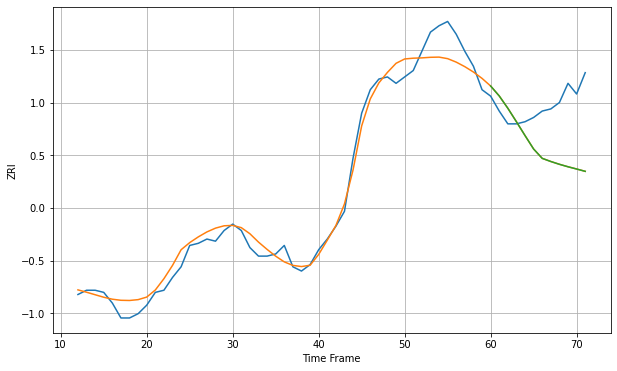

Wall time: 6.09 s
6010 6.115758572332052 24.546312469134275 24.552030146854776 [1067.74638427 1063.08034771 1057.31590236 1050.98870429 1044.51175266
 1038.19951657 1033.82279306 1032.34869404 1031.03692114 1029.88002863
 1028.8301361  1027.74366767]

Got an mse at 0.0099 in round 87 and stopped training

60 60 12


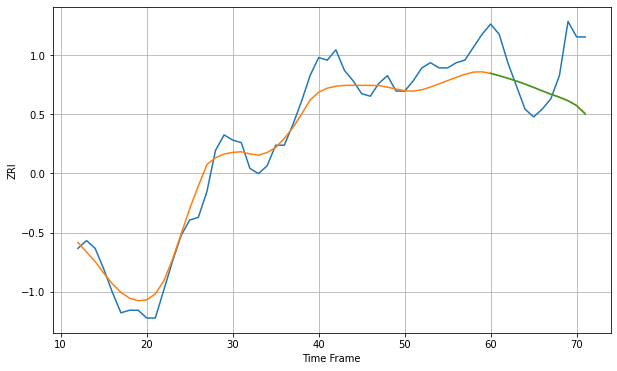

Wall time: 6.2 s
6040 6.632884265154451 17.159186219789966 17.237862554168643 [1180.87828229 1179.96612577 1178.97362571 1177.8986077  1176.71903844
 1175.42870368 1174.08029    1172.79467546 1171.62836745 1170.21787204
 1168.36272208 1165.04194256]

Got an mse at 0.0097 in round 101 and stopped training

60 60 12


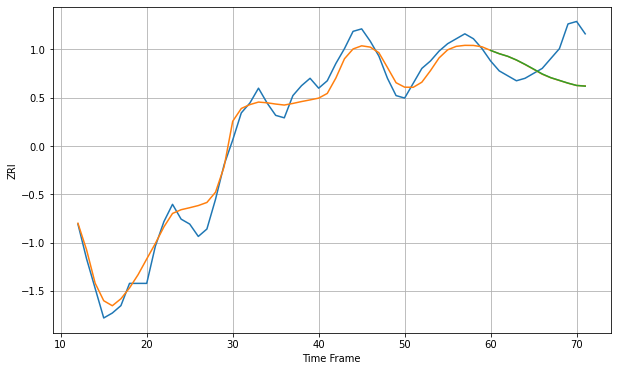

Wall time: 6.59 s
6051 4.980278339034353 13.405907191087072 13.407870947199415 [1105.27950234 1103.96144228 1102.88984136 1101.41108386 1099.63768842
 1097.73103919 1095.77158428 1094.2563174  1093.15496323 1092.05137595
 1091.10515028 1090.81757797]

Got an mse at 0.0099 in round 124 and stopped training

60 60 12


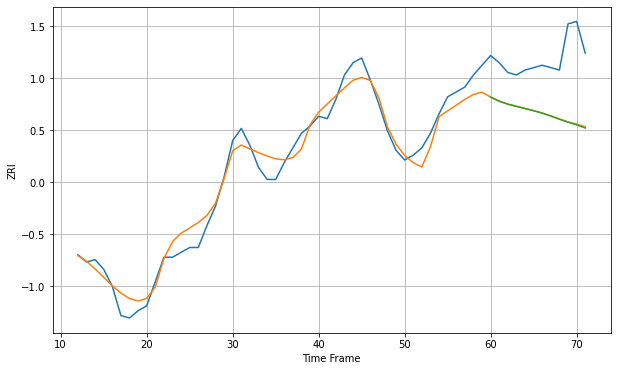

Wall time: 7.24 s
6053 5.419656297632134 24.080596250010217 24.21381940551309 [1148.8671768  1147.20041955 1145.96633667 1145.06583798 1144.17408726
 1143.27920024 1142.27525423 1141.09087099 1139.76864205 1138.56064854
 1137.45520624 1136.16583772]

Got an mse at 0.0100 in round 149 and stopped training

60 60 12


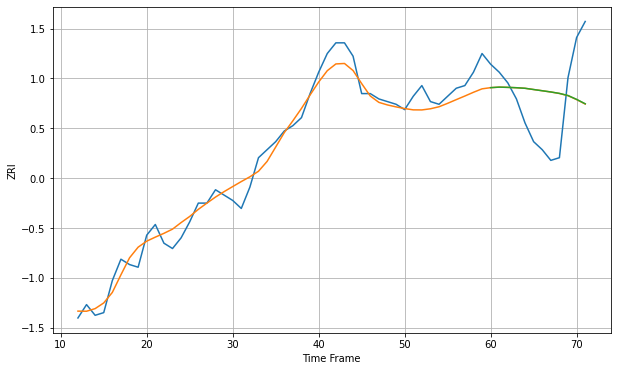

Wall time: 7.59 s
6082 4.820732958535047 18.120241564234444 18.101112547001787 [1224.2214655  1224.41840936 1224.32767111 1224.19622529 1223.9857876
 1223.52084893 1223.06657962 1222.60847193 1222.07614094 1221.27687506
 1219.83580516 1218.18898565]

Got an mse at 0.0098 in round 155 and stopped training

60 60 12


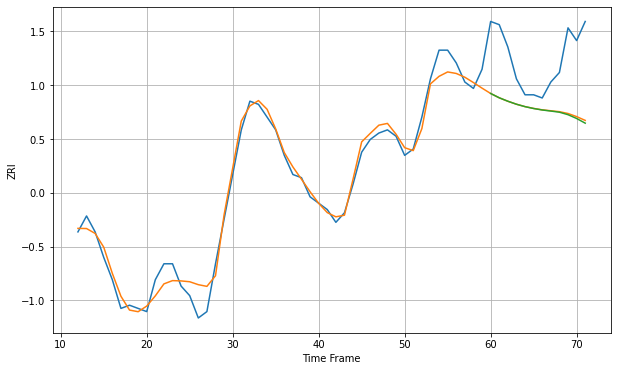

Wall time: 7.74 s
6106 3.5488974967801683 18.075132042309267 18.325170646433705 [1106.41350745 1105.06278095 1103.98406731 1103.04268417 1102.28320583
 1101.69695923 1101.2350449  1100.90071318 1100.53888884 1099.76125071
 1098.57437067 1097.10214274]

Got an mse at 0.0100 in round 85 and stopped training

60 60 12


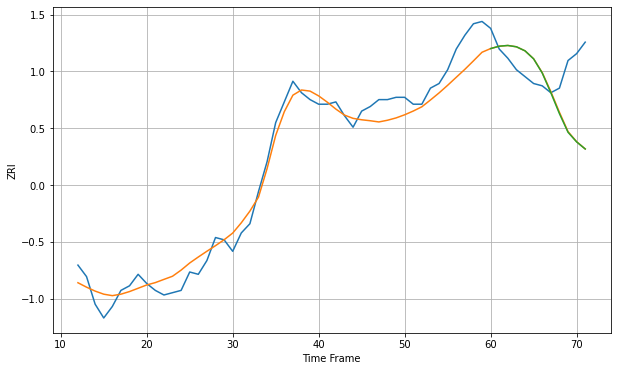

Wall time: 6.13 s
6108 6.643610975757764 20.764222599078693 20.841327636865906 [1199.20738089 1200.23715028 1200.55643303 1199.97986519 1198.21776356
 1194.73064263 1188.5784317  1180.01341756 1170.90360987 1162.80131279
 1158.6078878  1155.51911494]

Got an mse at 0.0100 in round 197 and stopped training

60 60 12


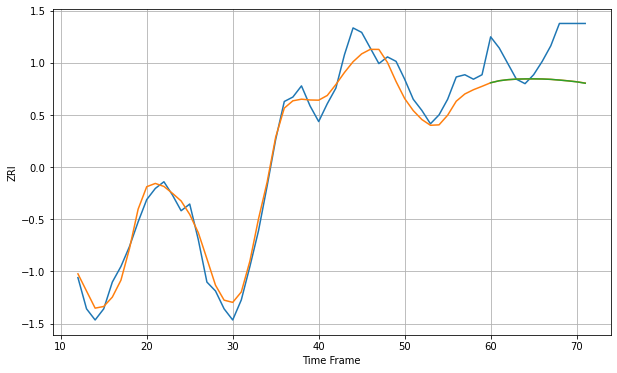

Wall time: 8.7 s
6112 5.882224348173851 17.543886032518365 17.562793388926316 [1132.39848974 1133.30715024 1133.7876299  1134.02517771 1134.12932571
 1134.15200928 1134.09429236 1133.92219496 1133.60911604 1133.25510182
 1132.82202431 1132.19464855]

Got an mse at 0.0099 in round 139 and stopped training

60 60 12


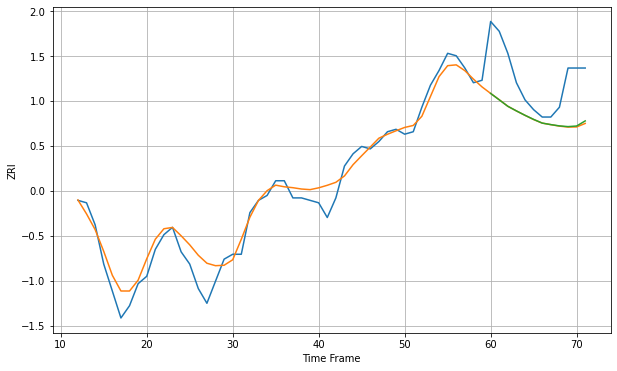

Wall time: 7.38 s
6114 5.49097463733497 18.357606955015157 18.19163797740679 [1109.63540607 1107.01403514 1104.38526199 1102.49848838 1100.7085633
 1099.03483388 1097.52534143 1096.91093262 1096.38119205 1096.09196041
 1096.33757553 1098.4191956 ]

Got an mse at 0.0099 in round 102 and stopped training

60 60 12


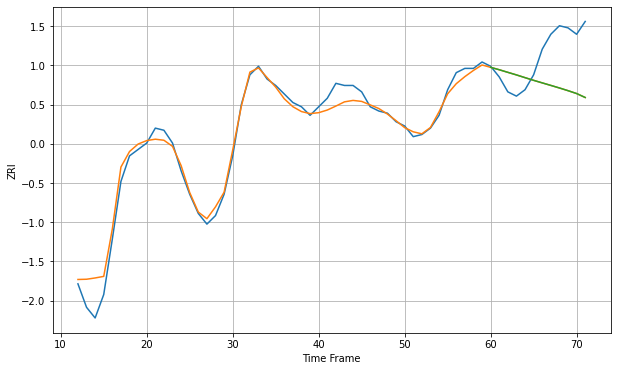

Wall time: 6.63 s
6119 4.8501429434454675 20.039441785962417 20.03617551126527 [1380.49034956 1379.36921096 1378.14830433 1376.94336557 1375.6594353
 1374.40144306 1373.20835739 1372.02628231 1370.8239531  1369.56114034
 1368.21234877 1366.35917961]

Got an mse at 0.0100 in round 168 and stopped training

60 60 12


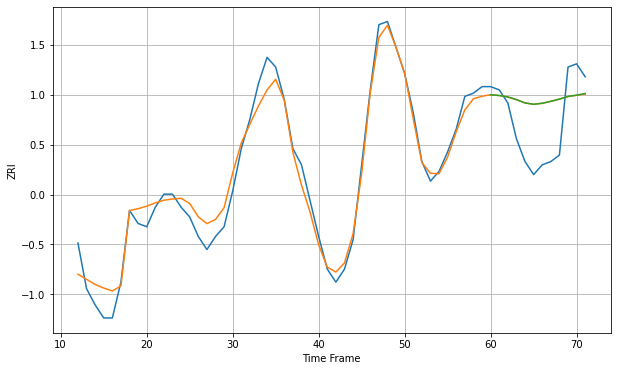

Wall time: 7.97 s
6320 4.29977343008641 13.360582038690557 13.35488567479214 [1061.51005003 1061.2740788  1060.82495909 1060.0202376  1058.99135184
 1058.584926   1058.89275088 1059.49049313 1060.17662382 1060.98687529
 1061.3858502  1061.89083456]

Got an mse at 0.0099 in round 135 and stopped training

60 60 12


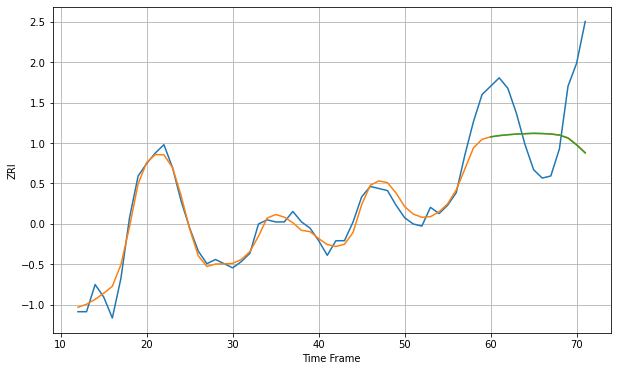

Wall time: 7.26 s
6360 5.438700743674941 27.75489758473242 27.838841939959195 [1085.73622084 1086.33662119 1086.75044752 1087.05968651 1087.25500881
 1087.42320237 1087.32212276 1087.10800533 1086.58669388 1085.13749589
 1081.84914849 1078.01030397]

Got an mse at 0.0099 in round 107 and stopped training

60 60 12


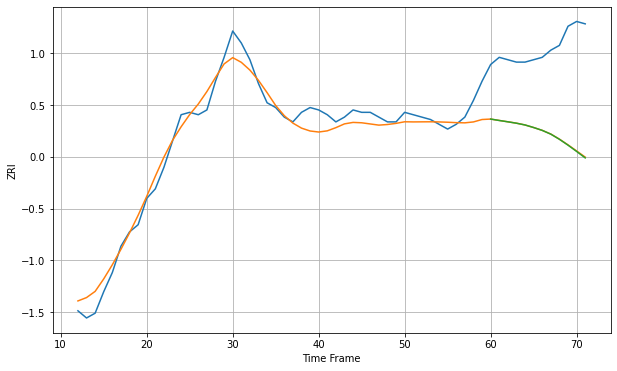

Wall time: 6.59 s
6401 5.342583530801286 36.783200900551485 36.87733953844428 [1212.18532495 1211.59269257 1211.03591903 1210.45210062 1209.71825356
 1208.64678629 1207.44904307 1205.87410236 1203.72059734 1201.2728627
 1198.64225285 1195.94355345]

Got an mse at 0.0100 in round 102 and stopped training

60 60 12


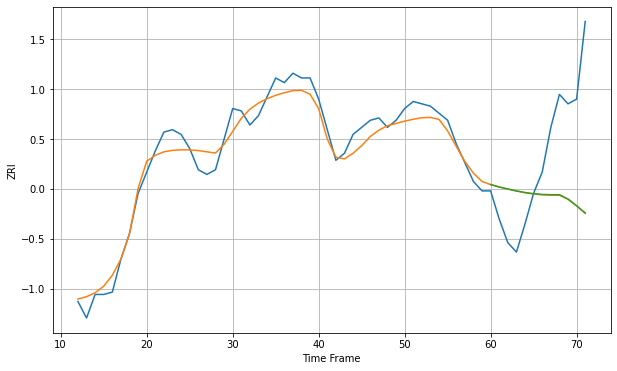

Wall time: 6.49 s
6405 5.407285547101523 34.97358073322502 34.88582110203113 [1300.68657257 1299.66492119 1298.78511387 1297.98236297 1297.29453293
 1296.79521575 1296.49306419 1296.39559971 1296.39805974 1294.52516935
 1291.66812028 1288.62090448]

Got an mse at 0.0100 in round 77 and stopped training

60 60 12


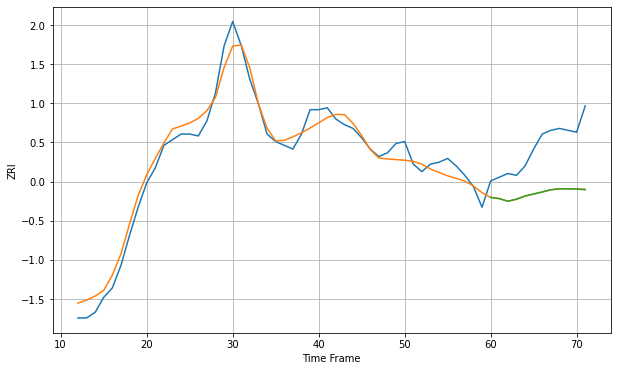

Wall time: 5.93 s
6418 5.970618838710508 26.251329790904435 26.273746083780743 [1199.25449902 1198.6029199  1197.20470928 1198.27857736 1199.97999626
 1201.07585532 1202.15418497 1203.31175274 1203.86289763 1203.84836703
 1203.70165136 1203.38181646]

Got an mse at 0.0100 in round 76 and stopped training

60 60 12


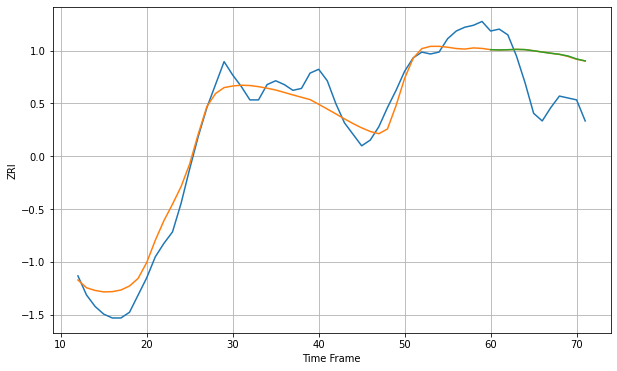

Wall time: 5.92 s
6450 8.676200475261373 22.611168168886394 22.64859553306967 [1151.25630367 1151.11016438 1151.22379716 1151.4025708  1151.27290288
 1150.68082766 1150.01861225 1149.3858246  1148.81721492 1147.9677341
 1146.39589733 1145.37020609]

Got an mse at 0.0100 in round 104 and stopped training

60 60 12


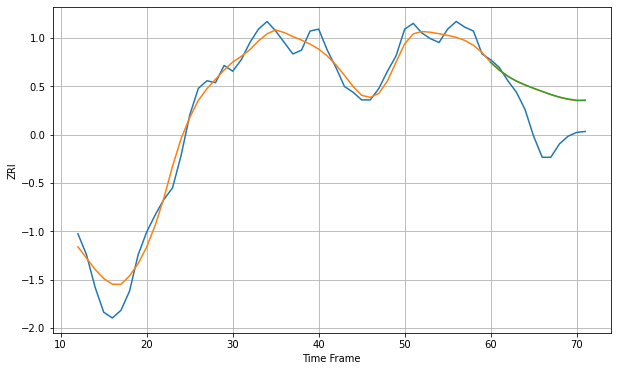

Wall time: 6.52 s
6451 6.791003090202285 19.56118663021373 19.634301410782818 [1135.64067159 1131.60251346 1128.35197108 1125.81550988 1123.83322146
 1122.06204383 1120.43705413 1118.83002697 1117.4792808  1116.46361517
 1115.78027498 1115.83256634]
60 60 12


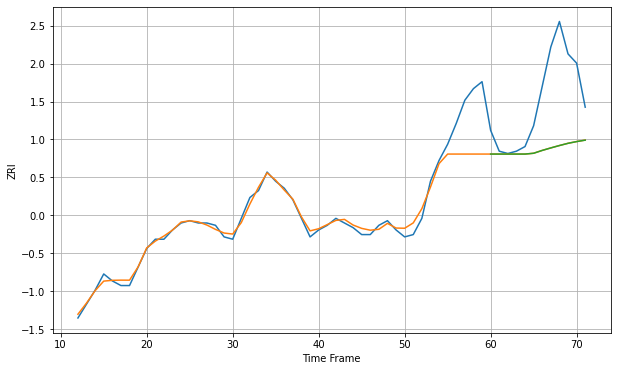

Wall time: 15.4 s
6457 7.433089392124893 26.8164804944734 26.82259377442282 [1221.7584371  1221.7584371  1221.7584371  1221.7584371  1221.7584371
 1222.10848556 1223.33432447 1224.41030379 1225.43923811 1226.39551485
 1227.14290028 1227.76427846]

Got an mse at 0.0099 in round 93 and stopped training

60 60 12


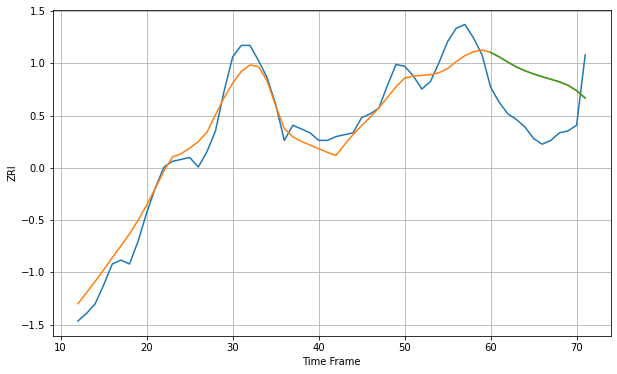

Wall time: 6.31 s
6460 8.276690245399358 27.196365487753308 27.214529609185952 [1455.31178022 1452.94317729 1450.17994736 1447.65799524 1445.63255638
 1443.967065   1442.51224509 1441.19591361 1439.84232713 1438.05483641
 1435.27425465 1431.35897927]

Got an mse at 0.0099 in round 255 and stopped training

60 60 12


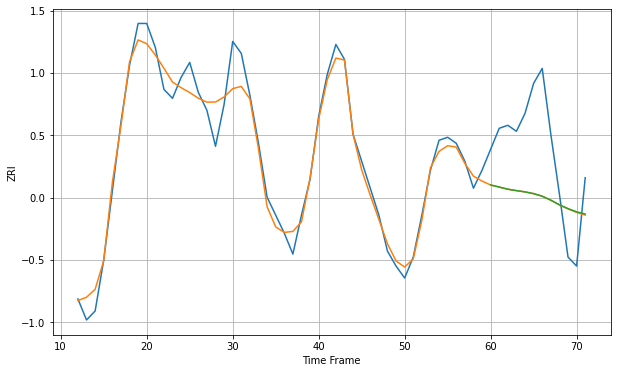

Wall time: 9.92 s
6484 5.029386955381633 23.23011867064466 23.22586269005959 [1421.06922737 1420.38220037 1419.65835221 1419.19261838 1418.76621939
 1418.18072471 1417.32522236 1416.00884638 1414.46993693 1413.18837842
 1412.11243023 1411.37210466]

Got an mse at 0.0099 in round 180 and stopped training

60 60 12


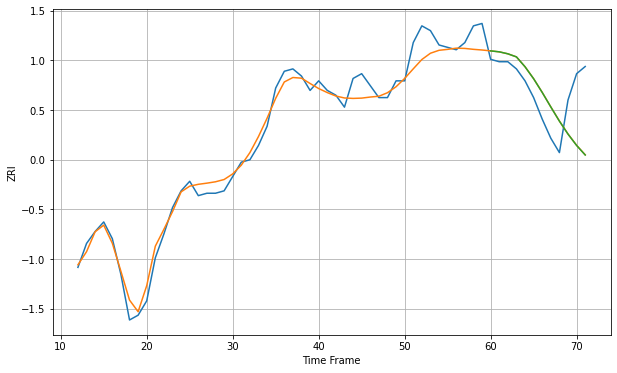

Wall time: 8.22 s
6489 5.048492796821438 16.064528826377305 16.084396439914162 [1251.53141267 1251.13771476 1250.31483269 1249.02184781 1244.89058601
 1239.88363811 1234.14819047 1228.07019795 1222.1460584  1216.73332396
 1211.98733632 1207.99168716]

Got an mse at 0.0100 in round 64 and stopped training

60 60 12


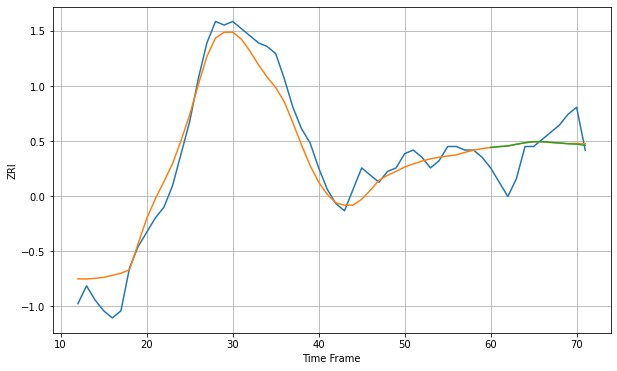

Wall time: 5.65 s
6492 4.951249539437207 7.271064791075418 7.293832339138271 [1218.72844784 1218.97163071 1219.15246998 1219.63265049 1220.07136972
 1220.35801492 1220.36367021 1220.1761242  1219.9815894  1219.76943788
 1219.65412103 1219.31755444]

Got an mse at 0.0100 in round 133 and stopped training

60 60 12


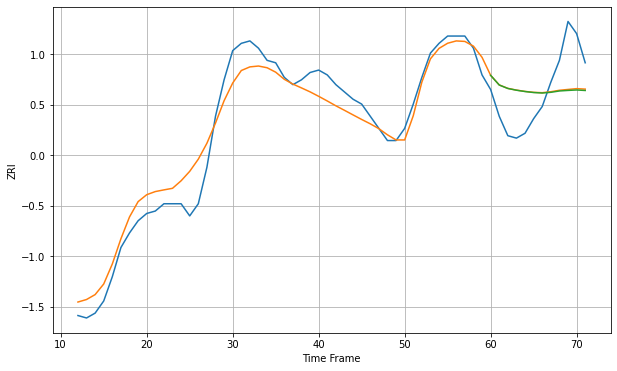

Wall time: 7.2 s
6511 7.418140536539125 15.79979444896298 15.957412429384213 [1262.83792385 1258.85328362 1257.42999881 1256.7128964  1256.17037968
 1255.76057482 1255.56171181 1255.85011399 1256.39883814 1256.6272855
 1256.80945393 1256.60311409]

Got an mse at 0.0099 in round 73 and stopped training

60 60 12


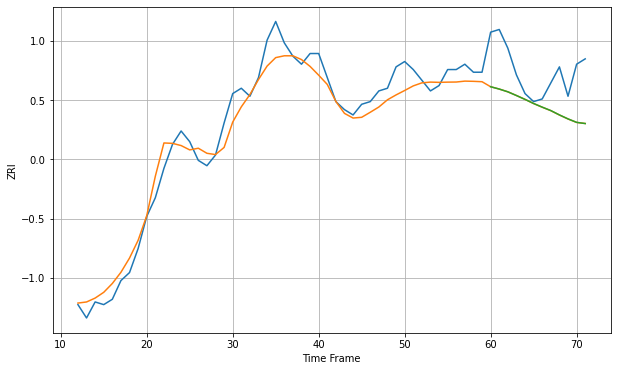

Wall time: 5.84 s
6512 5.61241045698181 15.334451839638563 15.327131008015044 [1309.56429179 1308.69679708 1307.6651794  1306.27672468 1304.83217083
 1303.29048708 1301.92510663 1300.64023857 1299.01669072 1297.52631157
 1296.22962279 1295.78450264]

Got an mse at 0.0099 in round 182 and stopped training

60 60 12


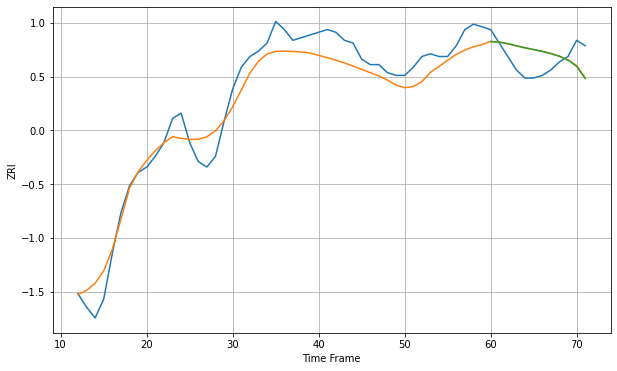

Wall time: 8.28 s
6513 6.631970088427966 7.711458750701765 7.7675170538320115 [1246.55469731 1246.35741021 1245.75649544 1244.97350096 1244.21596057
 1243.56408414 1242.89990903 1242.09802291 1241.06376825 1239.65493873
 1237.38632533 1232.8060487 ]

Got an mse at 0.0097 in round 72 and stopped training

60 60 12


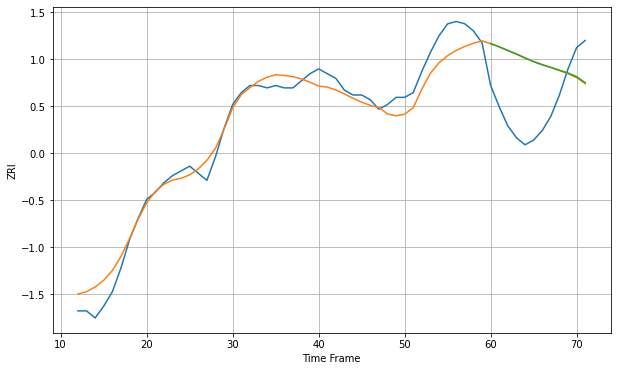

Wall time: 5.94 s
6515 6.025173656511217 24.9122703066307 24.85199157814626 [1239.65961742 1238.3014753  1236.76005426 1235.26471889 1233.60782962
 1232.0495374  1230.74844629 1229.62704187 1228.44162906 1227.30888567
 1225.72911357 1223.20080727]

Got an mse at 0.0099 in round 122 and stopped training

60 60 12


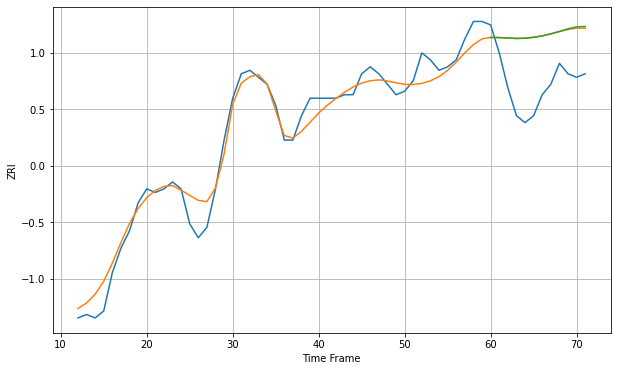

Wall time: 6.98 s
6516 4.013884303942562 15.615715965288809 15.673784763491053 [1268.42469971 1268.38953423 1268.23938389 1268.12646332 1268.18376543
 1268.43818547 1268.8491401  1269.43389903 1270.15378369 1270.89456355
 1271.45355784 1271.56814761]

Got an mse at 0.0099 in round 76 and stopped training

60 60 12


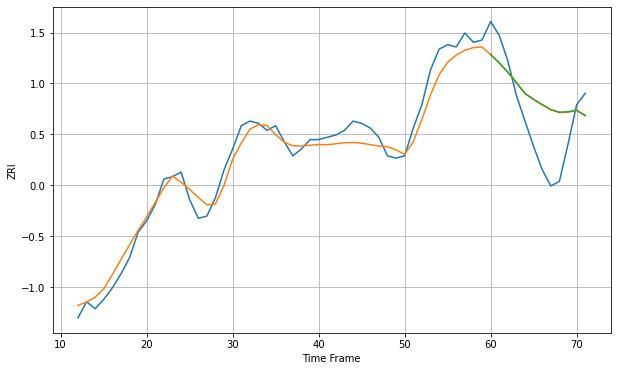

Wall time: 5.93 s
6519 5.1799734086245515 18.249425213294245 18.28593145116234 [1279.7691705  1276.13414248 1272.0604497  1267.59178764 1262.8531871
 1260.35420993 1258.08554909 1255.96853083 1254.8119389  1255.03379714
 1255.68355831 1253.41135696]

Got an mse at 0.0100 in round 69 and stopped training

60 60 12


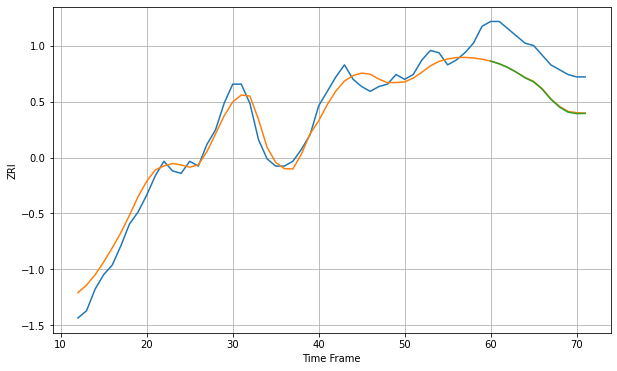

Wall time: 5.76 s
6604 5.1939717162733325 15.241397532126415 15.401630078012543 [1339.56271208 1338.44087183 1336.90257073 1334.90051139 1332.65838555
 1330.92466626 1327.91671121 1323.70882008 1320.5161038  1318.37821199
 1317.77076235 1317.84586241]

Got an mse at 0.0099 in round 143 and stopped training

60 60 12


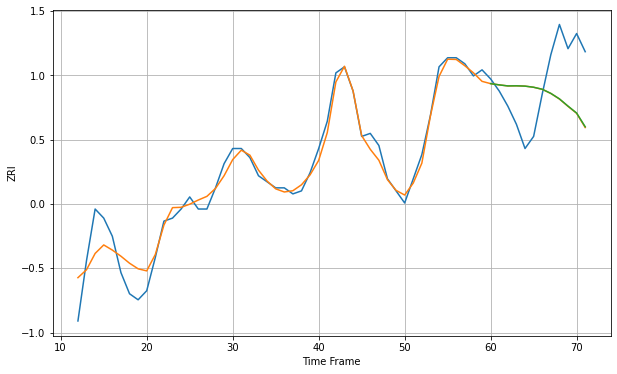

Wall time: 7.43 s
6605 4.632071460930544 16.74147967670488 16.679558522995723 [1407.44199519 1407.031558   1406.68585686 1406.72459095 1406.6226125
 1406.24927309 1405.5882296  1404.22598012 1402.41361817 1400.01814743
 1397.72597273 1393.19743805]

Got an mse at 0.0099 in round 120 and stopped training

60 60 12


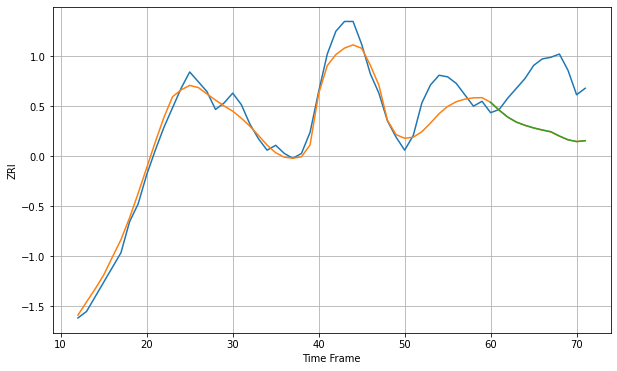

Wall time: 6.92 s
6606 8.581967063909303 33.085435592094484 33.03708655874901 [1417.32535356 1412.52234821 1408.24675316 1405.22336729 1403.24771152
 1401.67438464 1400.43450222 1399.35452072 1396.66042348 1394.3872222
 1393.281123   1393.81866102]

Got an mse at 0.0100 in round 143 and stopped training

60 60 12


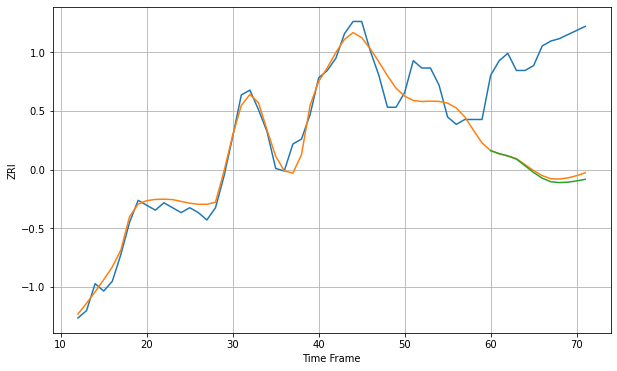

Wall time: 7.43 s
6607 5.889020321434287 48.7236055865125 49.851137236604764 [1296.29083216 1295.03727881 1294.11305278 1292.8240265  1290.10709201
 1287.36359228 1285.02973214 1283.58707896 1283.23711791 1283.42474113
 1283.92146983 1284.59181592]

Got an mse at 0.0099 in round 75 and stopped training

60 60 12


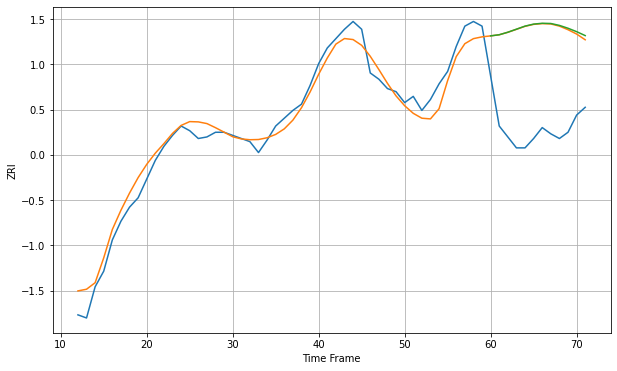

Wall time: 5.89 s
6608 7.942243645723838 64.05235618934502 64.52781816541706 [1366.7659179  1367.48914995 1369.1086416  1371.0521138  1373.02206175
 1374.31373916 1374.84052118 1374.69798112 1373.48079037 1371.6516567
 1369.46974482 1366.94112134]

Got an mse at 0.0099 in round 153 and stopped training

60 60 12


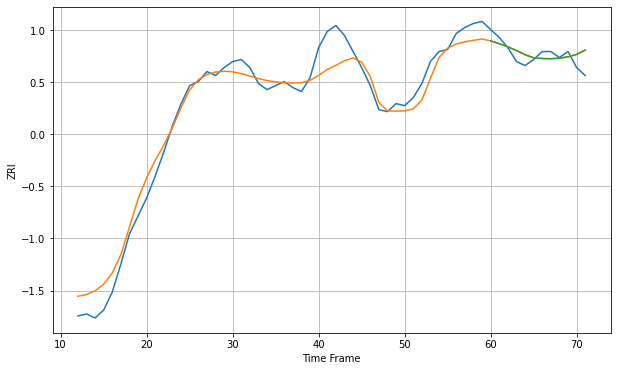

Wall time: 7.63 s
6610 7.454502729942225 5.32865326901509 5.316402965255354 [1322.30277108 1320.9291691  1319.35055547 1317.52731232 1315.43703476
 1313.84000242 1313.49392838 1313.40440244 1313.67295486 1314.3436633
 1315.56428142 1317.68331623]

Got an mse at 0.0099 in round 117 and stopped training

60 60 12


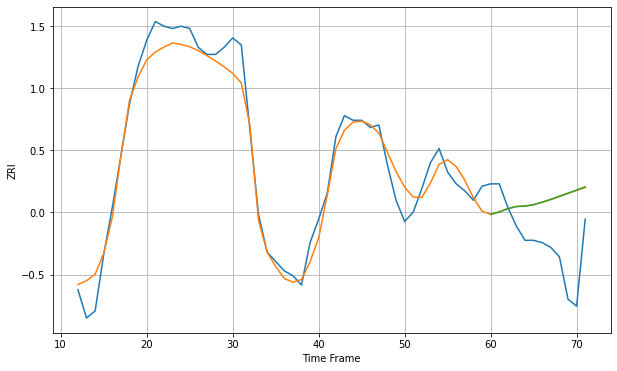

Wall time: 6.86 s
6614 7.37004936631387 23.828215585682507 23.887553944730065 [1471.03444419 1472.06119231 1473.43871974 1474.36075858 1474.53522941
 1475.15397463 1476.18081642 1477.39861304 1478.71017746 1480.0381115
 1481.3662731  1482.70588835]

Got an mse at 0.0100 in round 106 and stopped training

60 60 12


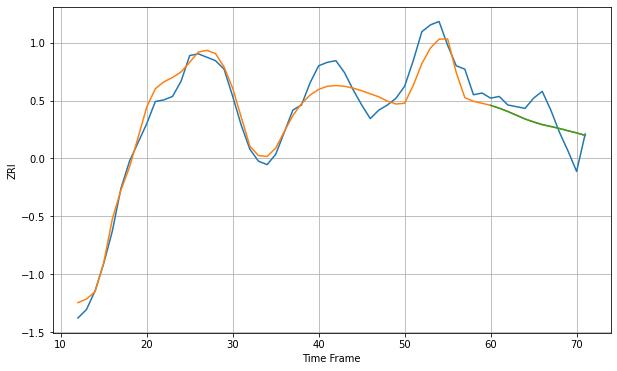

Wall time: 6.58 s
6615 8.1069087117763 11.069470745698984 11.070662083683061 [1465.76849978 1464.09032804 1462.16965653 1459.97898647 1457.78055441
 1456.0353844  1454.47668315 1453.36249158 1452.20923091 1450.85268725
 1449.61358762 1448.15813532]

Got an mse at 0.0100 in round 112 and stopped training

60 60 12


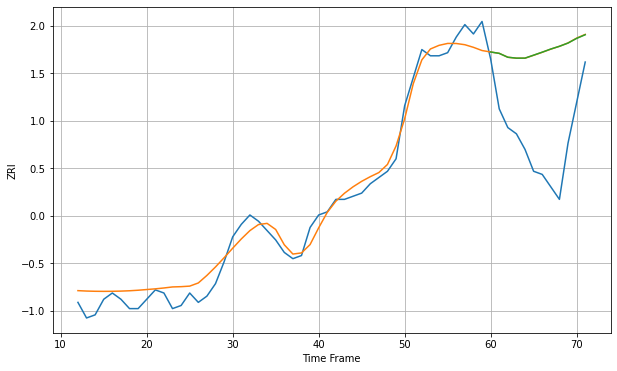

Wall time: 6.75 s
6704 4.1833640882869965 30.37485916613041 30.38108278935761 [979.22234391 978.78108796 977.53651347 977.24765435 977.25634935
 978.20411947 979.16164482 980.1697597  981.04460573 982.08243598
 983.57483498 984.74704245]

Got an mse at 0.0099 in round 111 and stopped training

60 60 12


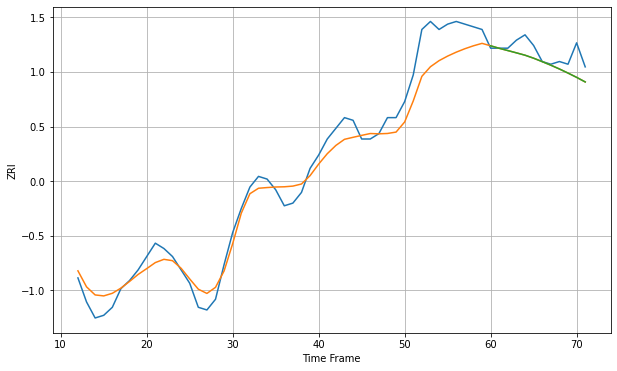

Wall time: 6.86 s
6705 6.690816511402326 5.185286390159282 5.185701581396875 [1006.88842641 1005.95258856 1005.10479251 1004.25036257 1003.36989513
 1002.24729258 1000.96049916  999.63217535  998.20919308  996.6795969
  995.07842714  993.35892736]

Got an mse at 0.0099 in round 55 and stopped training

60 60 12


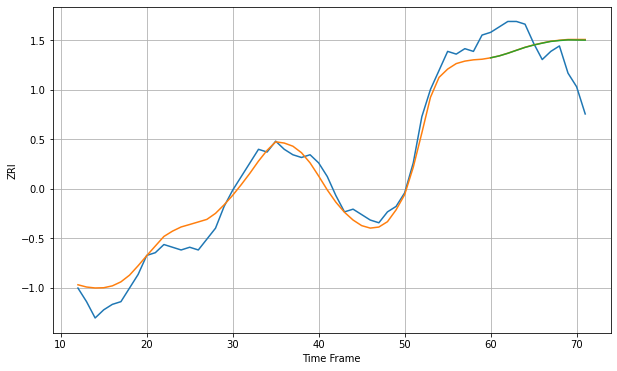

Wall time: 5.7 s
6708 4.857863933843377 12.185970607515838 12.107126231354345 [1004.63670467 1005.34657733 1006.3048612  1007.39355605 1008.46693579
 1009.32460201 1010.02889271 1010.66259447 1010.991339   1011.23699606
 1011.17830276 1011.14250073]

Got an mse at 0.0099 in round 159 and stopped training

60 60 12


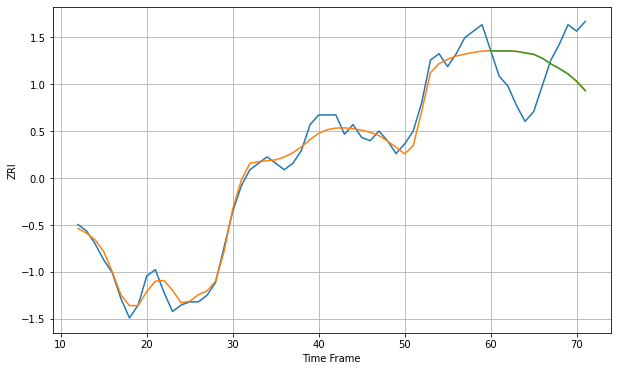

Wall time: 7.79 s
6710 3.1806841062751996 13.814944710314844 13.844920411847966 [915.91214533 915.82617827 915.83605947 915.72156213 915.24266205
 914.8237879  913.61205983 911.84285399 910.36774898 908.69586528
 906.4068237  903.50966182]

Got an mse at 0.0100 in round 164 and stopped training

60 60 12


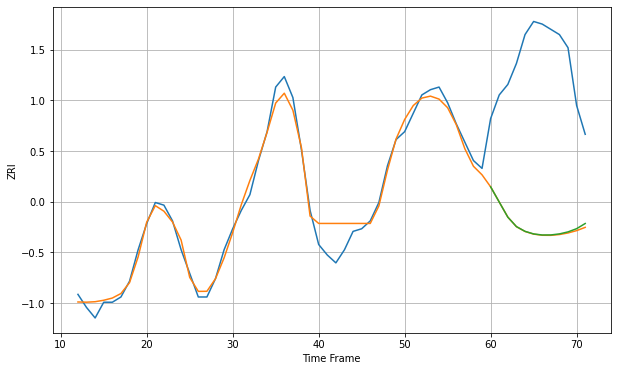

Wall time: 7.86 s
6770 4.284798735911047 63.20303728615776 62.985638945777055 [1104.9708856  1099.18228152 1093.41997344 1089.82443835 1088.01500803
 1087.02620295 1086.62437656 1086.64397815 1087.03954575 1087.80714318
 1089.03010014 1091.00092671]

Got an mse at 0.0100 in round 111 and stopped training

60 60 12


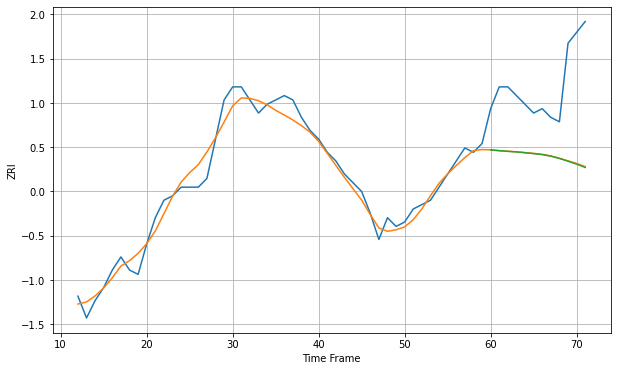

Wall time: 6.71 s
6790 2.5034727705039006 18.011710887859365 18.083985751270063 [862.55833143 862.36630298 862.21947141 862.08276733 861.89769746
 861.69835525 861.46968767 861.10655918 860.57566174 859.94997366
 859.28914052 858.52425574]

Got an mse at 0.0100 in round 195 and stopped training

60 60 12


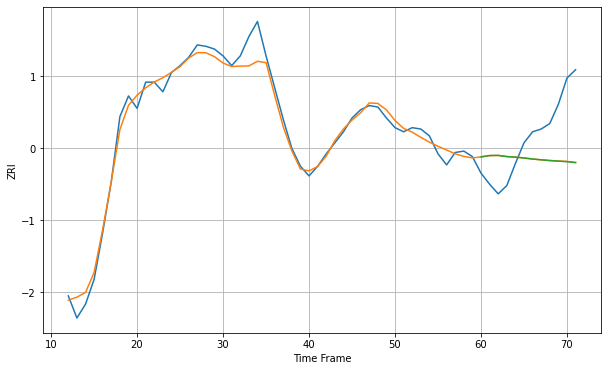

Wall time: 8.67 s
6810 7.312479754856062 33.43255416859981 33.494349787609856 [1647.79754904 1648.77907504 1648.89490408 1648.01616373 1647.63009248
 1647.01193981 1646.25388604 1645.68227057 1645.14253668 1644.7278766
 1644.351974   1643.63056459]

Got an mse at 0.0099 in round 243 and stopped training

60 60 12


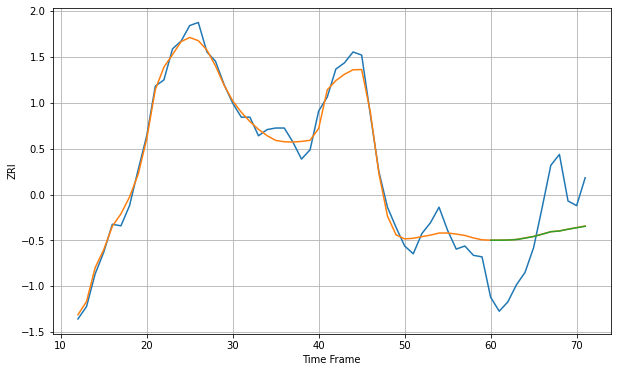

Wall time: 9.68 s
6824 6.749776991278905 32.26236434730233 32.2730364596751 [1848.75419392 1848.73910719 1848.82841939 1849.14839129 1850.08387703
 1851.09968433 1852.61347817 1854.19059342 1854.66826455 1855.78602748
 1856.77065648 1857.71365354]

Got an mse at 0.0099 in round 201 and stopped training

60 60 12


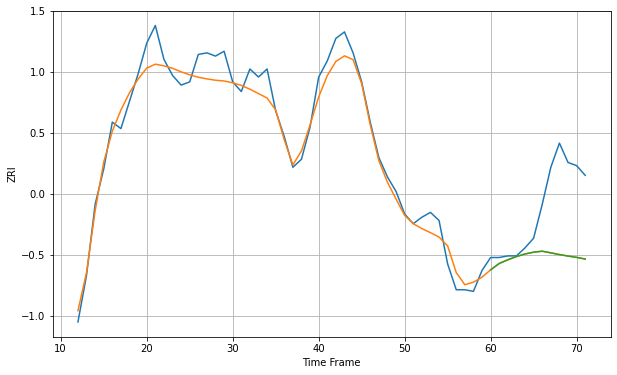

Wall time: 8.75 s
6825 9.379971594394098 38.63980520094231 38.6640512233862 [1636.3691762  1640.29690677 1642.60826274 1644.59375345 1646.19889131
 1647.30823086 1647.91091951 1646.89856505 1645.81946473 1644.88827807
 1644.07597414 1643.0203618 ]

Got an mse at 0.0098 in round 179 and stopped training

60 60 12


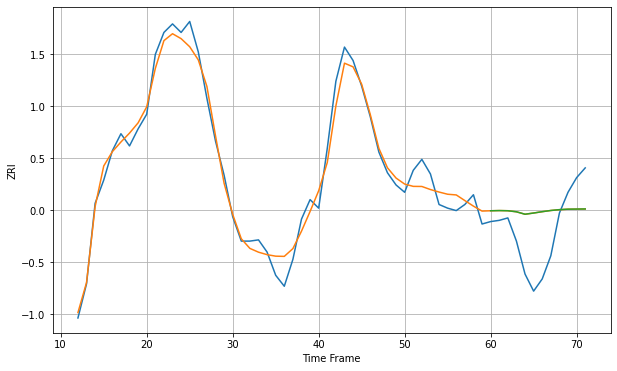

Wall time: 8.3 s
6830 10.243343330797966 33.746349607006856 33.744809149553475 [2321.86180444 2322.02217262 2321.8870622  2321.02000069 2319.02387444
 2320.01579327 2321.11626036 2322.10222957 2322.78341975 2323.16897332
 2323.25741536 2323.3462345 ]

Got an mse at 0.0100 in round 407 and stopped training

60 60 12


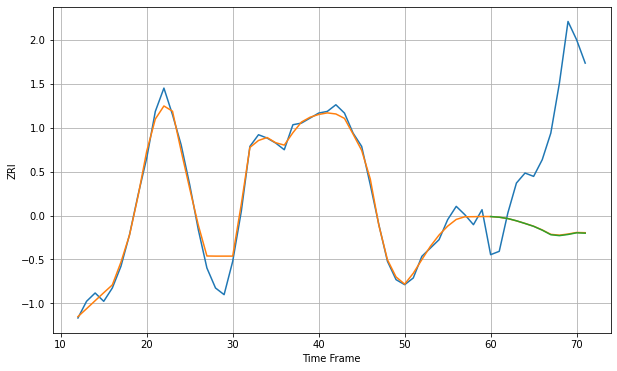

Wall time: 13.4 s
6851 5.571943032459101 68.98795597744332 69.14998646061056 [1813.88671434 1813.48787472 1812.69551904 1811.34521305 1809.72773716
 1808.02054071 1805.73150452 1802.98260456 1802.42642009 1803.12366631
 1804.13046626 1803.90111841]

Got an mse at 0.0096 in round 130 and stopped training

60 60 12


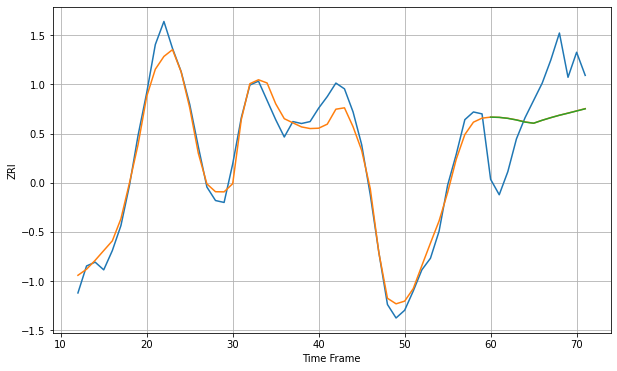

Wall time: 7.14 s
6854 6.697403577687557 26.35609173637845 26.36361276459633 [1830.31759368 1830.18622406 1829.677374   1828.83492293 1827.74446962
 1827.15719713 1828.68958469 1830.04369075 1831.28607635 1832.37046208
 1833.50617768 1834.64100886]

Got an mse at 0.0097 in round 126 and stopped training

60 60 12


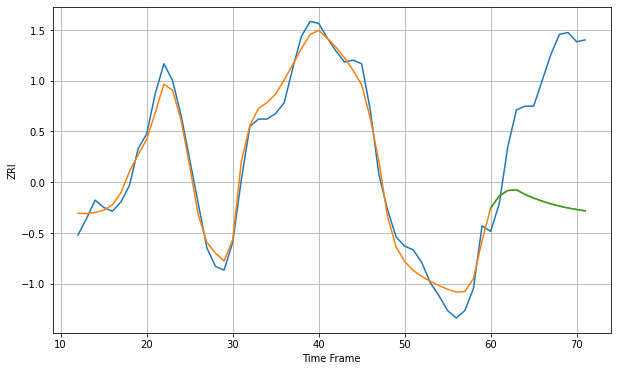

Wall time: 7.05 s
6855 7.077071790533886 66.4887857043921 66.41979153208426 [1810.70266357 1817.30532852 1820.20730692 1820.56687827 1818.09703174
 1816.13116064 1814.4332867  1812.99017493 1811.77254664 1810.75023305
 1809.93680841 1809.22564752]

Got an mse at 0.0098 in round 178 and stopped training

60 60 12


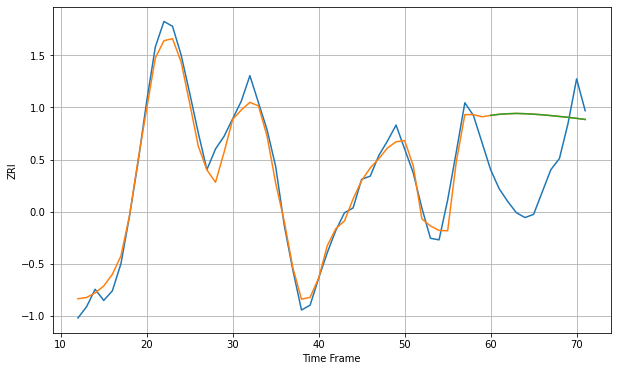

Wall time: 8.26 s
6902 7.9276941623267625 44.07965681722382 44.08065356418585 [2136.07104349 2136.7630494  2137.12171714 2137.30207705 2137.139229
 2136.84961401 2136.44907254 2135.95300398 2135.41471573 2134.87668988
 2134.2288417  2133.52382758]

Got an mse at 0.0100 in round 155 and stopped training

60 60 12


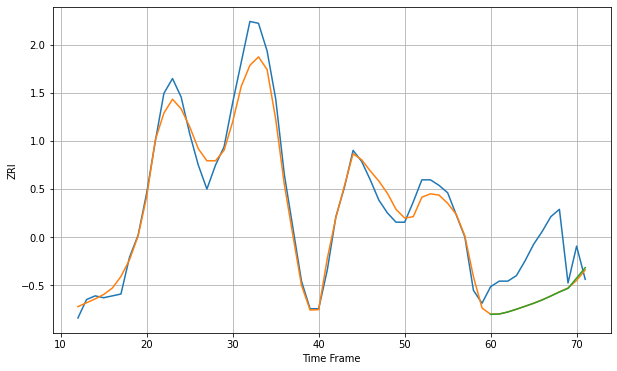

Wall time: 7.71 s
6906 7.789070138685681 26.470537551418587 26.45180048933537 [1900.99828995 1901.15468875 1902.26215697 1903.75128674 1905.34060524
 1906.97515251 1908.80438002 1910.90165119 1913.09475466 1915.07815855
 1920.67904551 1926.32483382]

Got an mse at 0.0098 in round 48 and stopped training

60 60 12


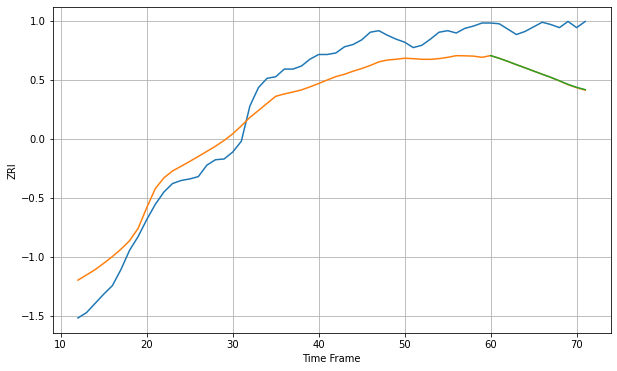

Wall time: 5.34 s
7002 30.66006402848773 63.0395172948125 62.83790861777772 [1791.57343842 1788.03707064 1784.04887142 1779.78121575 1775.69719247
 1771.48189976 1767.31240012 1763.26409386 1758.79559858 1754.10971782
 1750.2635153  1747.26898642]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


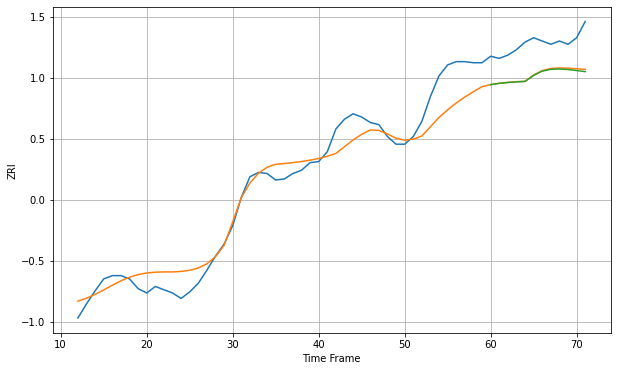

Wall time: 5.31 s
7003 16.89546912065895 29.2700436897197 29.97666665965575 [1620.83311053 1622.04770939 1622.8320153  1623.4095358  1623.75882132
 1629.33868806 1633.24542875 1634.94262463 1635.24688269 1634.76597994
 1633.81895157 1632.82703205]

Got an mse at 0.0100 in round 102 and stopped training

60 60 12


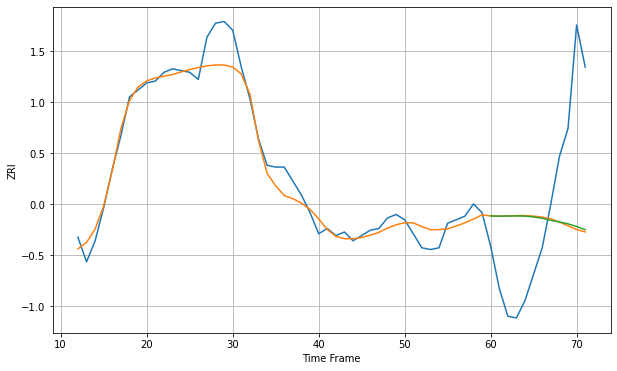

Wall time: 6.52 s
7030 8.470776206801462 57.26659887479934 56.62993107809897 [2518.12005059 2518.04299658 2518.09203948 2518.16238352 2518.06257038
 2517.57459388 2516.85623971 2515.64289349 2514.75203609 2513.67177307
 2512.12427053 2510.34365525]

Got an mse at 0.0098 in round 95 and stopped training

60 60 12


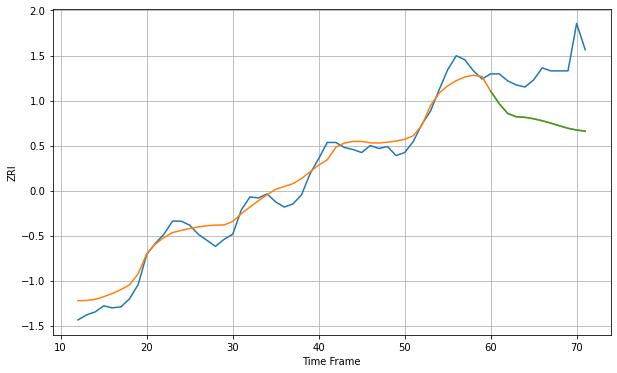

Wall time: 6.33 s
7055 11.669757471183617 53.905350323292986 53.98170980401084 [1718.93279584 1706.45171465 1696.63005677 1693.46578695 1692.9202452
 1691.49013322 1689.51918321 1687.13961718 1684.55155822 1682.00689864
 1680.28498548 1679.11958308]

Got an mse at 0.0100 in round 55 and stopped training

60 60 12


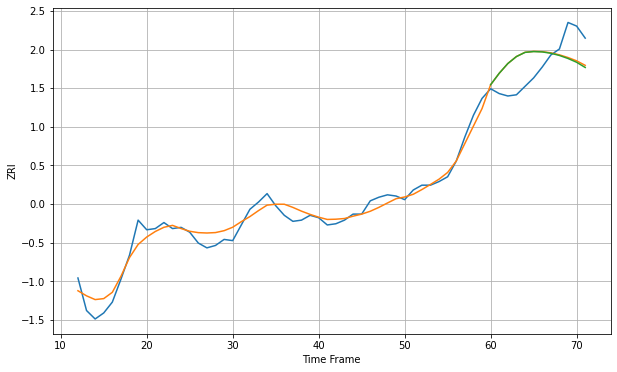

Wall time: 5.45 s
7093 7.434089830474373 21.774423344341873 22.1224103323585 [1991.33654875 2000.85946495 2008.92115358 2014.70974189 2018.17779006
 2018.85997169 2018.56861196 2017.46175103 2015.61996692 2013.11972903
 2009.97925238 2005.66466488]

Got an mse at 0.0099 in round 67 and stopped training

60 60 12


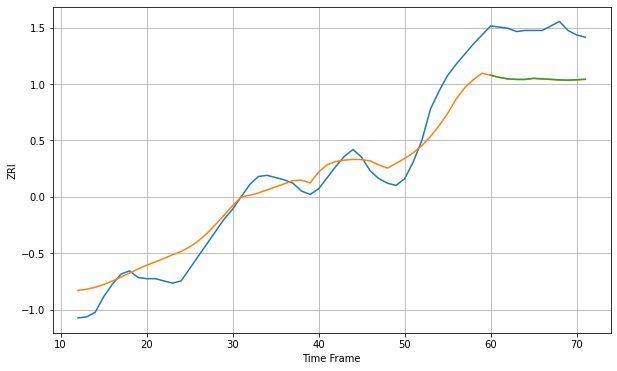

Wall time: 5.74 s
7109 16.99090894752616 44.13206535010046 44.0279150218412 [1575.11329991 1573.21974603 1571.86191515 1571.38556052 1571.40300987
 1572.39262215 1571.93789026 1571.52501433 1571.006929   1570.81449522
 1571.13950061 1571.4775609 ]

Got an mse at 0.0100 in round 39 and stopped training

60 60 12


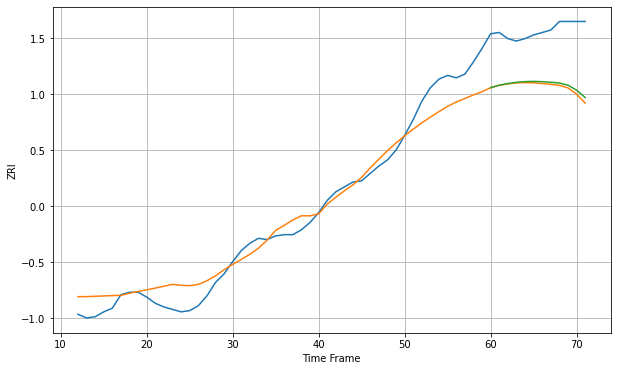

Wall time: 5.09 s
7111 13.824689546875831 46.94992166060661 45.270728465652645 [1398.98286485 1401.00866369 1402.31147497 1403.35473782 1403.92428938
 1404.07057156 1403.85289545 1403.39244746 1402.75911367 1400.98013677
 1396.88875406 1390.91436362]

Got an mse at 0.0098 in round 46 and stopped training

60 60 12


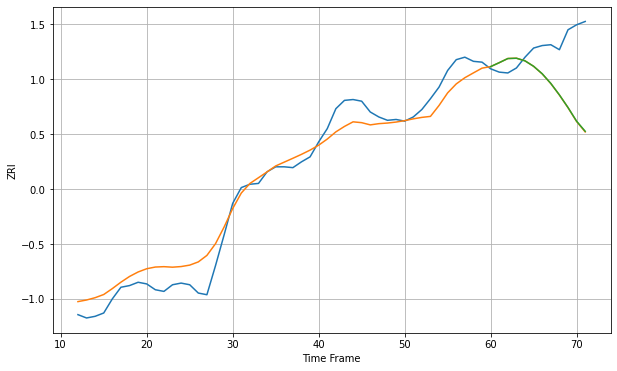

Wall time: 5.27 s
7201 19.120263589807603 62.89629422727486 62.64796895082397 [1742.64782377 1747.38055315 1752.35896737 1752.70567616 1749.55186924
 1743.02591745 1734.02118753 1722.38915884 1708.55315089 1693.39231863
 1676.90643986 1664.75786177]

Got an mse at 0.0099 in round 45 and stopped training

60 60 12


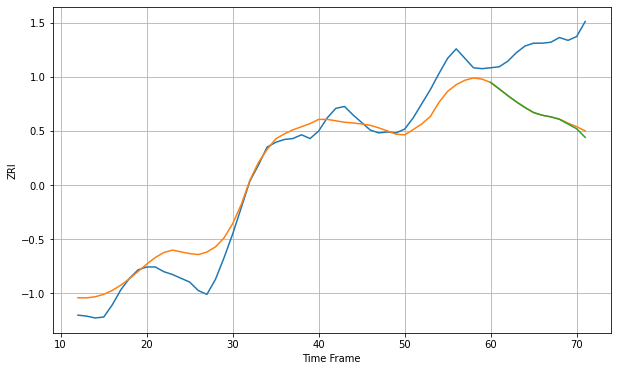

Wall time: 5.34 s
7202 18.92795689808375 73.1866829057057 74.4314475740538 [1678.44336872 1671.53530335 1664.47142188 1657.8983976  1651.90960513
 1646.59795792 1643.73755793 1641.95773989 1639.36255762 1634.37948018
 1629.3949192  1620.26322105]

Got an mse at 0.0099 in round 32 and stopped training

60 60 12


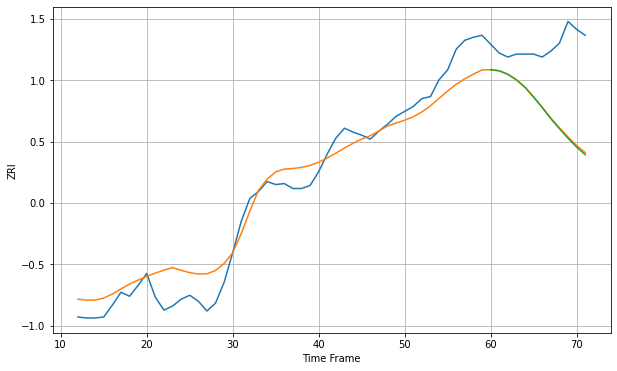

Wall time: 4.97 s
7206 20.427903370994926 71.30605457283637 72.1753388514991 [1695.19228616 1694.11268982 1690.5300262  1684.9398183  1677.33913966
 1667.43456371 1656.89029578 1645.65309188 1635.55542675 1625.81981122
 1616.90974936 1609.14961353]

Got an mse at 0.0100 in round 38 and stopped training

60 60 12


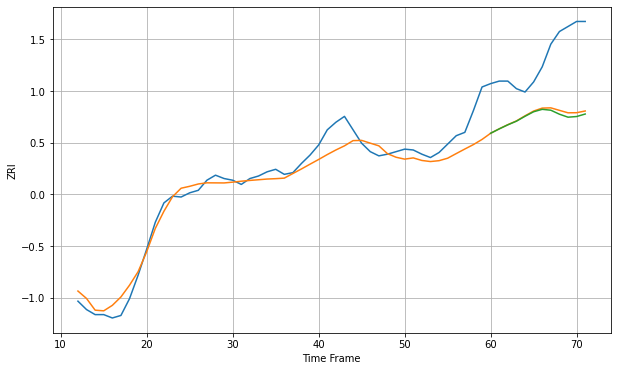

Wall time: 5.07 s
7302 16.656588506686006 72.78121617407973 75.3159453060008 [2451.90070329 2457.09993877 2461.93853366 2466.27944162 2472.11024776
 2477.50220595 2480.39679677 2479.35048823 2474.59794774 2471.04307822
 2471.81866543 2474.81351597]

Got an mse at 0.0095 in round 79 and stopped training

60 60 12


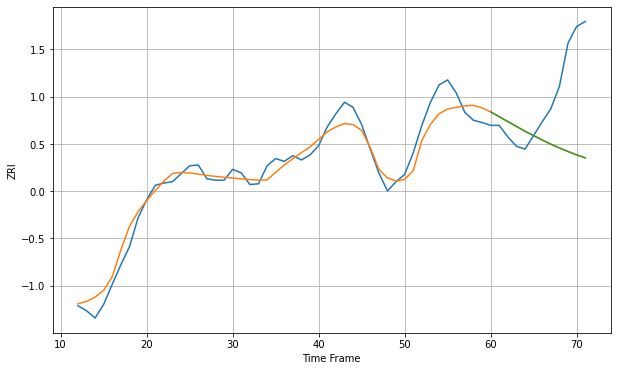

Wall time: 6 s
7960 16.784081486596932 92.47156484517052 92.48893083291921 [2239.65731677 2233.03931399 2226.27036015 2219.54139277 2212.85816388
 2206.7292514  2200.65176717 2194.88642208 2189.62553466 2184.75353303
 2180.03064658 2175.9553972 ]

Got an mse at 0.0099 in round 88 and stopped training

60 60 12


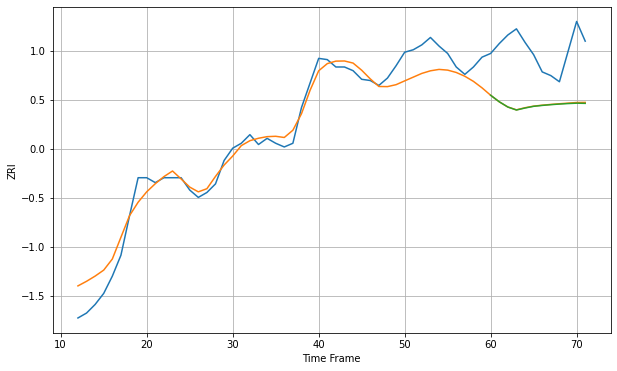

Wall time: 6.2 s
8901 12.767350087154064 46.453322338945625 46.685043449138576 [1712.02712442 1706.72721916 1702.47727931 1700.02737341 1701.65751963
 1703.02633651 1703.76541888 1704.367638   1704.86880063 1705.27321087
 1705.57964407 1705.43493667]

Got an mse at 0.0099 in round 177 and stopped training

60 60 12


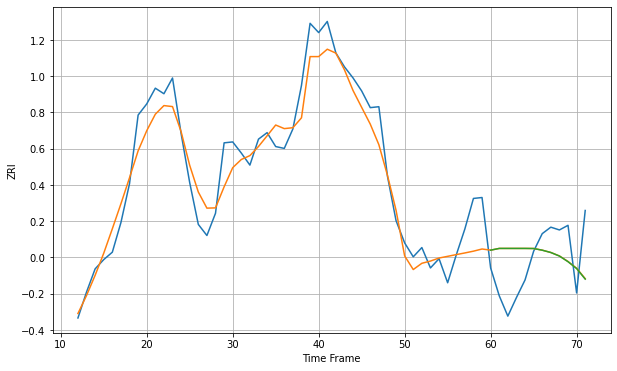

Wall time: 8.19 s
10001 23.910084420225772 42.611369156754165 42.701078503448784 [3674.19304917 3676.0618168  3676.0618168  3676.0618168  3676.0618168
 3675.94413063 3674.15315598 3671.64080827 3667.82891934 3661.72712542
 3654.34733945 3642.93748402]

Got an mse at 0.0098 in round 315 and stopped training

60 60 12


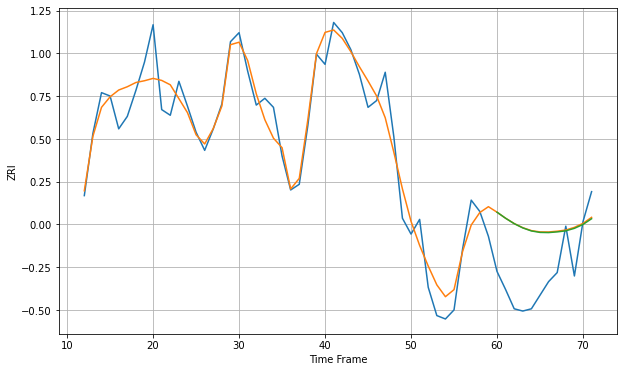

Wall time: 11.4 s
10002 17.900675571610332 51.103593345765056 50.91612701537881 [3493.34942141 3487.9844247  3483.23292658 3479.46102441 3476.77356425
 3475.49237026 3475.34135226 3475.93730361 3476.88398288 3479.07940251
 3482.51820057 3487.5738028 ]

Got an mse at 0.0099 in round 136 and stopped training

60 60 12


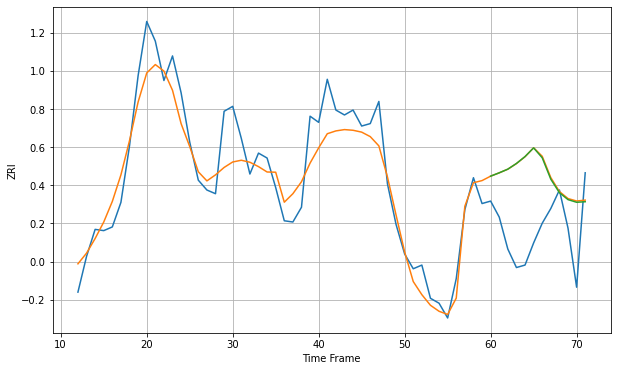

Wall time: 7.28 s
10003 20.196036145495732 55.047969561474964 54.83373813588226 [3683.27035315 3685.98385814 3688.96691778 3693.57432816 3699.19320144
 3706.25298807 3698.18468894 3680.76507453 3669.84298151 3664.19800688
 3662.03724895 3662.47923135]

Got an mse at 0.0098 in round 66 and stopped training

60 60 12


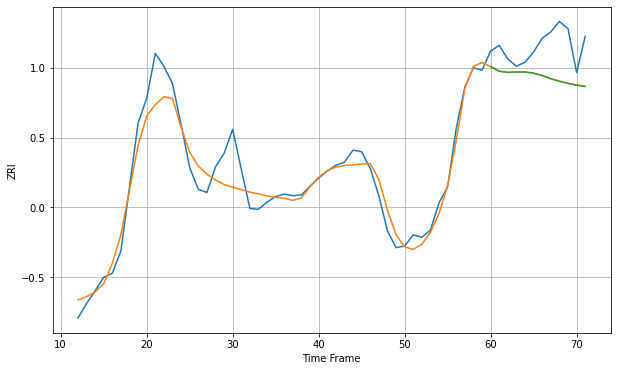

Wall time: 5.7 s
10005 21.239332266100057 43.37412115258707 43.5107076899406 [3681.51818922 3675.76383965 3674.31991608 3674.82683846 3674.77318209
 3673.28943736 3670.35670364 3666.34799329 3663.21819543 3660.48971706
 3658.19637443 3656.60760134]

Got an mse at 0.0100 in round 90 and stopped training

60 60 12


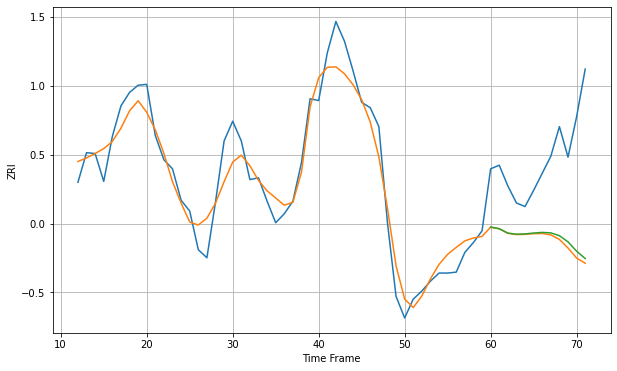

Wall time: 6.26 s
10009 21.937817813290746 102.51253384438353 99.34552257352182 [3675.09800518 3673.38104708 3668.45732375 3667.22019739 3667.56663891
 3668.52750761 3669.23629223 3668.70710346 3665.59222054 3658.69166441
 3648.35625646 3640.14936612]

Got an mse at 0.0099 in round 125 and stopped training

60 60 12


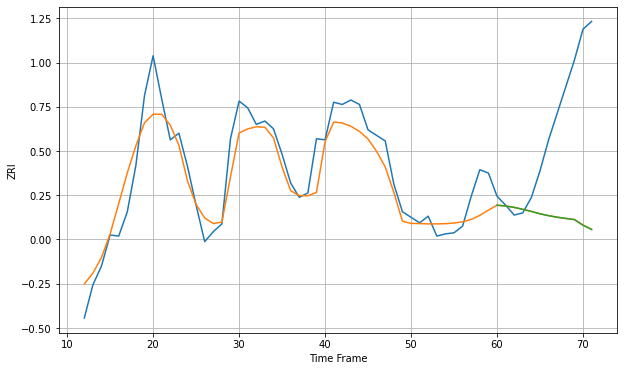

Wall time: 7.06 s
10010 20.15277391623975 98.6661173205094 98.73467479875433 [3650.92793612 3650.2341311  3648.96382119 3647.20540747 3645.28687476
 3643.16821939 3641.47224483 3640.07046869 3638.95794996 3637.99130176
 3632.7639315  3628.99085598]

Got an mse at 0.0099 in round 72 and stopped training

60 60 12


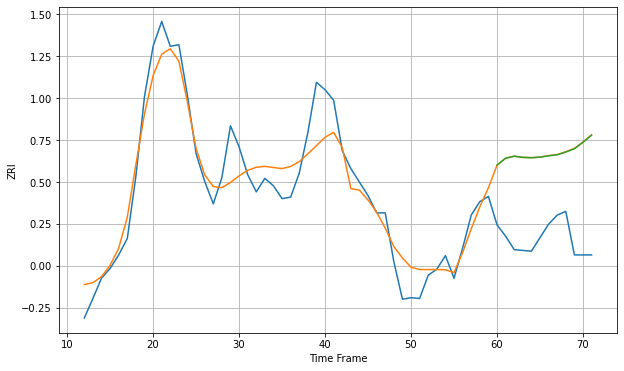

Wall time: 5.86 s
10011 30.34568959324822 117.06379839080427 116.87423919142817 [3866.49529717 3875.8678466  3878.47478956 3876.94426414 3876.50854048
 3877.19894744 3879.08788134 3880.39412813 3884.0376962  3888.42605671
 3897.02894181 3906.49823979]

Got an mse at 0.0099 in round 171 and stopped training

60 60 12


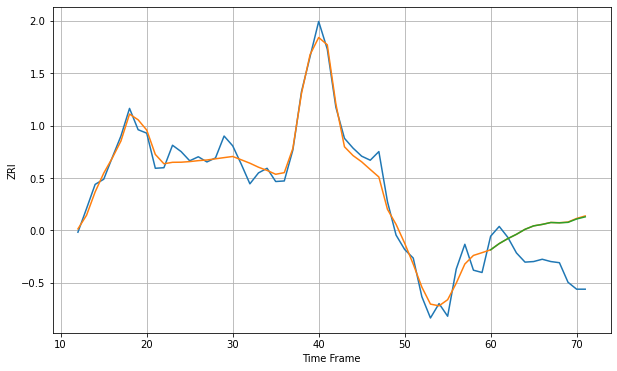

Wall time: 8.07 s
10012 18.295982537077137 73.54726632909828 73.09192389135612 [3548.4187051  3559.22378644 3567.84876404 3575.29734247 3583.97893666
 3589.96533822 3592.48734711 3595.79209382 3595.23407874 3596.08711592
 3601.91546567 3605.64652765]

Got an mse at 0.0099 in round 91 and stopped training

60 60 12


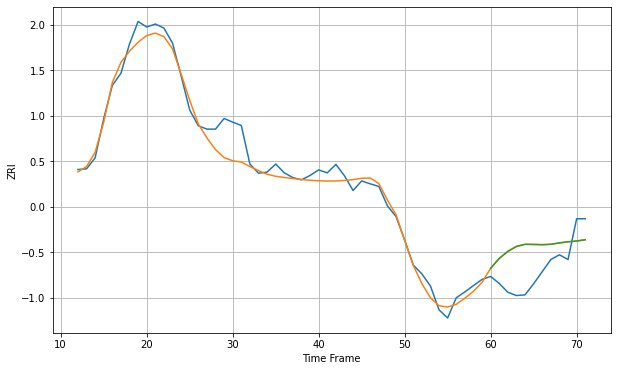

Wall time: 6.26 s
10013 33.51193008959232 83.26463864789031 83.27382984370621 [4464.19076774 4491.15356367 4510.20846518 4523.68751605 4529.50299842
 4529.15899221 4528.50079138 4529.50910818 4533.2848595  4536.36009328
 4538.3954929  4541.83408257]

Got an mse at 0.0100 in round 100 and stopped training

60 60 12


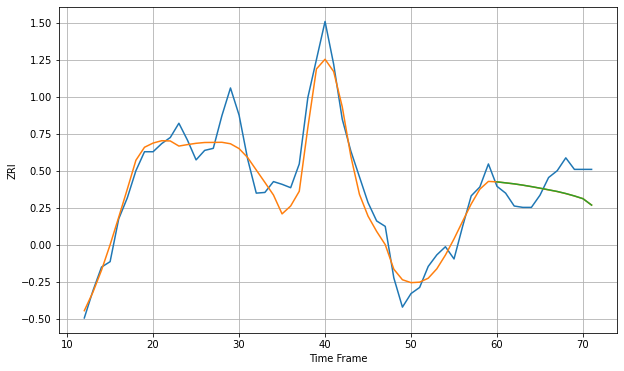

Wall time: 6.59 s
10014 26.089509122952585 33.75099114530437 33.729964046050156 [3836.5813365  3835.13941243 3833.6625796  3831.78173335 3829.65247627
 3827.33868063 3824.90772166 3822.46828685 3819.42317493 3815.87086865
 3811.80112335 3802.35979971]

Got an mse at 0.0099 in round 192 and stopped training

60 60 12


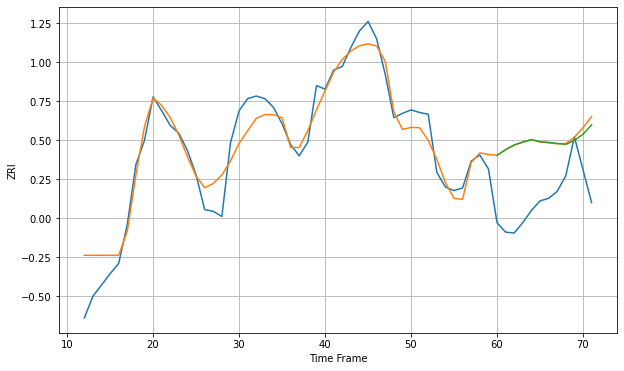

Wall time: 8.58 s
10016 22.052378926130846 74.10178553782283 72.8488437555278 [3592.57410574 3599.13345819 3604.59129937 3607.96707287 3610.80577308
 3608.40711881 3607.51976632 3606.39130868 3605.18434877 3609.8193776
 3616.98399366 3627.67984596]

Got an mse at 0.0100 in round 204 and stopped training

60 60 12


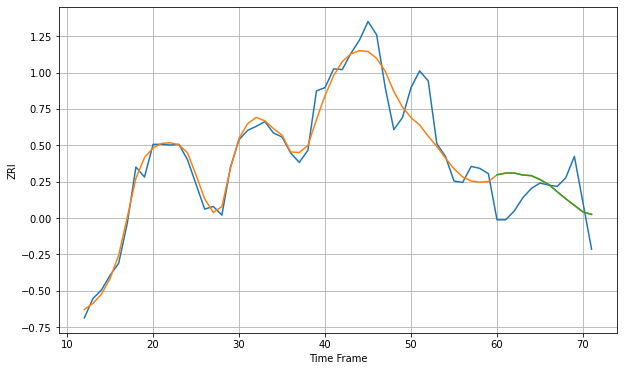

Wall time: 8.78 s
10017 24.928509639439895 44.3601219815574 44.331345755800406 [3511.37392601 3513.96901231 3514.08893689 3511.09642449 3510.10402505
 3504.27045648 3497.03934152 3486.1100943  3475.495562   3465.5666322
 3455.62511143 3451.89434603]

Got an mse at 0.0098 in round 68 and stopped training

60 60 12


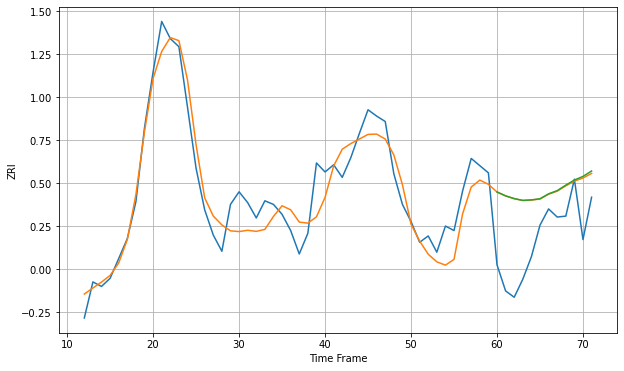

Wall time: 5.85 s
10018 23.228446080583577 64.30569064967675 64.66948944858086 [3669.80351721 3665.4698705  3662.44288789 3660.44861307 3661.00848455
 3662.27716583 3667.75796709 3671.28348938 3677.40636906 3683.06345624
 3687.07615921 3693.09793056]

Got an mse at 0.0100 in round 60 and stopped training

60 60 12


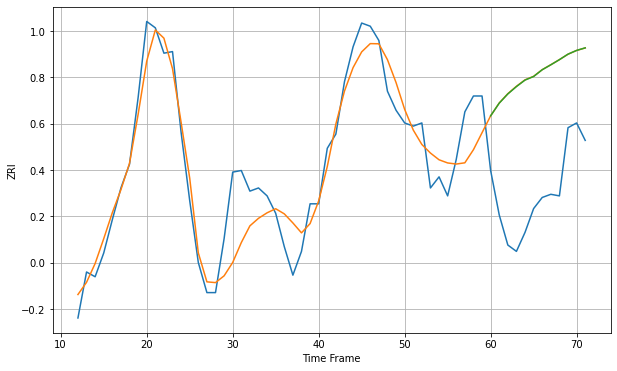

Wall time: 5.57 s
10019 18.221605228704327 76.66237277895918 76.59024697171603 [3634.48352877 3642.49468701 3648.28800949 3652.93770181 3657.036407
 3659.29583841 3663.55663448 3666.67121078 3669.91703785 3673.37724375
 3675.74565748 3677.35519178]

Got an mse at 0.0098 in round 93 and stopped training

60 60 12


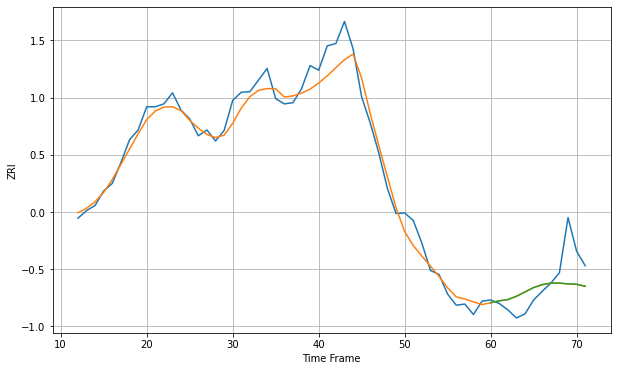

Wall time: 6.26 s
10021 22.26300686993893 42.54993656635338 42.4339141401561 [3112.13789083 3115.5851721  3117.70777457 3123.37865615 3130.89038385
 3138.40840917 3143.42447445 3146.09292401 3146.12442679 3144.80820408
 3144.12791528 3140.87185049]

Got an mse at 0.0099 in round 40 and stopped training

60 60 12


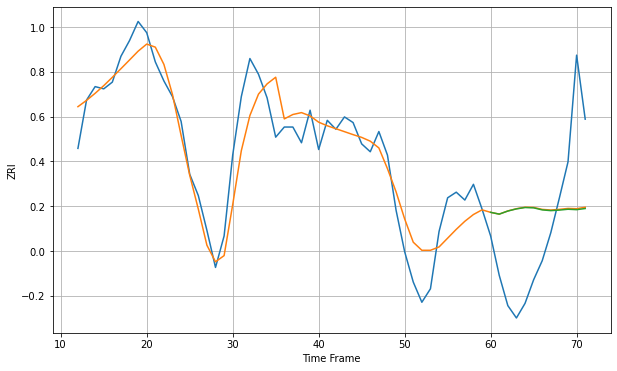

Wall time: 5.11 s
10022 23.126437145095327 71.0711387174823 71.24027387618816 [3973.05723088 3971.4598406  3974.21457381 3976.12228785 3977.33742602
 3977.06086358 3975.22867912 3974.57761374 3975.05578694 3975.81164001
 3975.43336292 3976.44747044]

Got an mse at 0.0099 in round 113 and stopped training

60 60 12


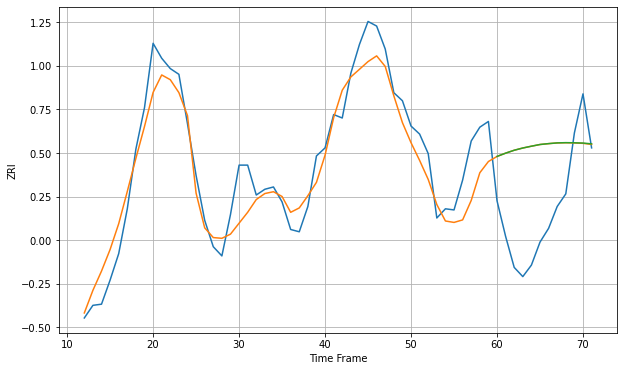

Wall time: 6.73 s
10023 22.23072387010258 70.68445490970801 70.6888643183848 [3553.55375596 3556.41256682 3558.94227895 3560.88753661 3562.46701636
 3563.94756479 3564.72203076 3565.34302433 3565.54854582 3565.44157451
 3565.19300641 3564.52232371]

Got an mse at 0.0099 in round 270 and stopped training

60 60 12


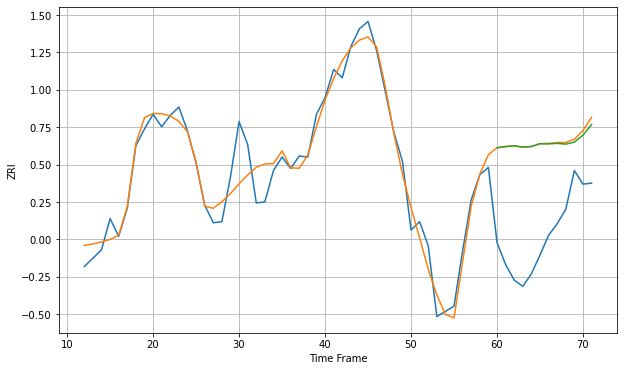

Wall time: 10.3 s
10024 16.179398315081635 94.5174039112478 93.70820196266945 [3468.94889044 3469.98290283 3470.8226776  3469.47521844 3470.09834952
 3472.73112891 3472.62741867 3473.10042768 3472.35900308 3474.35085207
 3481.0004146  3491.20175748]

Got an mse at 0.0100 in round 238 and stopped training

60 60 12


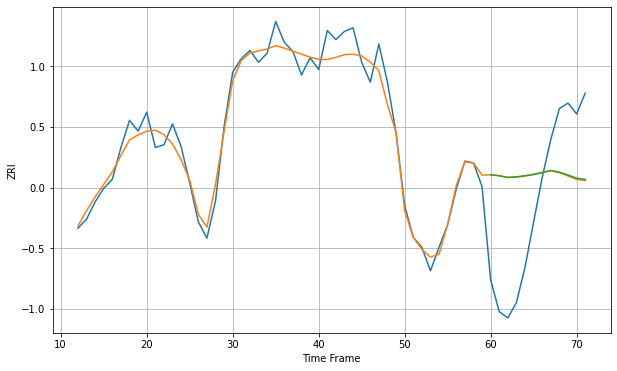

Wall time: 9.53 s
10025 14.50359105150205 99.60096721216613 99.40784770427256 [3624.88833606 3623.84830446 3622.07331142 3622.64608876 3623.87222522
 3625.44966977 3627.45764325 3629.64508518 3627.84654473 3624.67876236
 3621.13734321 3619.83251755]

Got an mse at 0.0100 in round 204 and stopped training

60 60 12


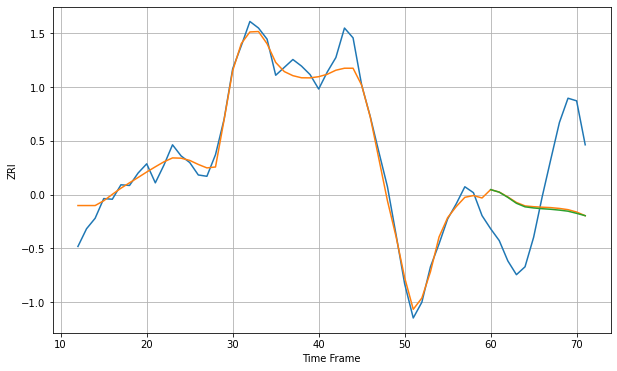

Wall time: 8.79 s
10027 19.413865134621396 105.51828541830963 106.20438703852496 [3019.66806384 3015.75112521 3007.84420698 2998.83386851 2993.42264823
 2991.71529121 2990.55058262 2989.66447338 2988.41329391 2986.76636787
 2983.50543044 2979.90710813]

Got an mse at 0.0100 in round 157 and stopped training

60 60 12


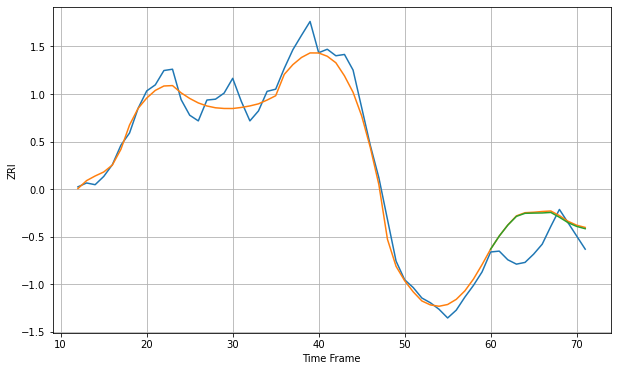

Wall time: 7.78 s
10028 27.63961934616108 66.29384977937045 65.0159135906156 [3055.56602854 3085.67411993 3110.98890796 3131.09197711 3138.0872271
 3138.57257437 3138.90440805 3140.10016616 3129.04822011 3116.63571448
 3107.9778275  3102.64111849]

Got an mse at 0.0098 in round 195 and stopped training

60 60 12


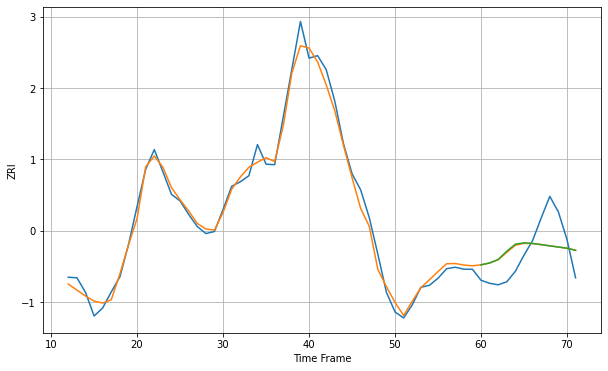

Wall time: 8.58 s
10029 16.766354084132846 52.00461921187618 52.463771599705225 [2797.73019722 2801.42811746 2808.43744606 2824.88442231 2838.93774596
 2841.4253214  2840.32273494 2838.02830087 2835.4652377  2833.1934068
 2830.73428515 2826.54784744]

Got an mse at 0.0099 in round 163 and stopped training

60 60 12


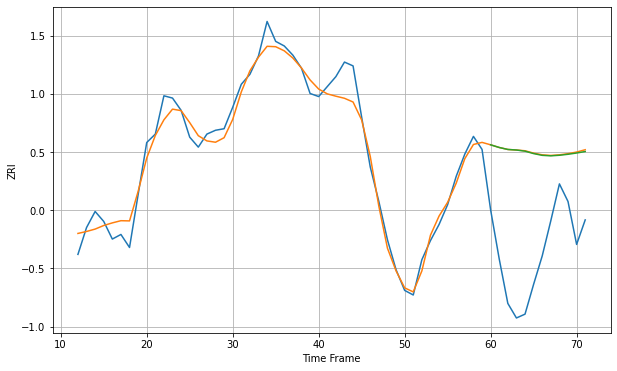

Wall time: 7.87 s
10031 17.198431536286908 142.74585954533435 142.29028643804634 [2790.00382048 2786.5194743  2783.94756698 2783.21213815 2781.72295117
 2778.53606783 2776.26785461 2775.63717933 2776.36100493 2777.65890478
 2779.31266507 2781.22651433]

Got an mse at 0.0099 in round 93 and stopped training

60 60 12


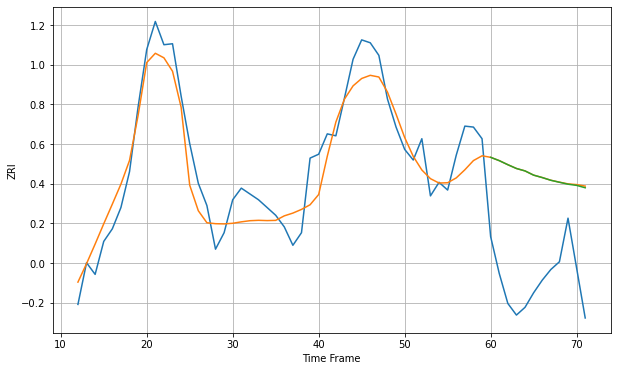

Wall time: 6.74 s
10036 24.616933655325735 112.48934888179143 112.23722487228915 [3567.79833251 3564.37088151 3560.17746825 3556.26807011 3553.76047652
 3549.40558967 3546.91496355 3544.09685827 3542.04457648 3540.04391558
 3538.83593259 3536.37678501]

Got an mse at 0.0099 in round 83 and stopped training

60 60 12


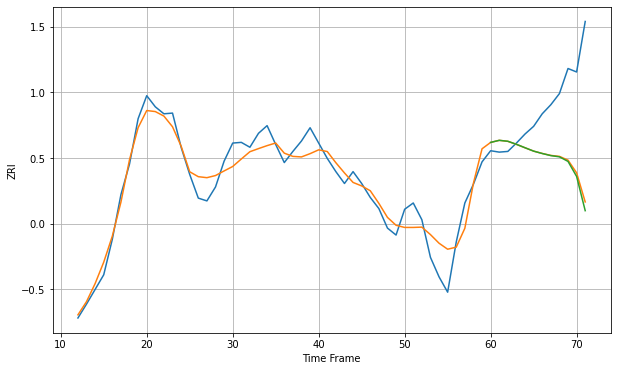

Wall time: 6.09 s
10038 21.290300424213203 101.76372242486514 105.30993647383332 [3901.94446895 3904.92695036 3903.56756363 3899.2277664  3894.28577255
 3889.44093647 3886.01584723 3883.00961175 3881.23280678 3874.67724244
 3853.11322297 3803.96718292]

Got an mse at 0.0099 in round 102 and stopped training

60 60 12


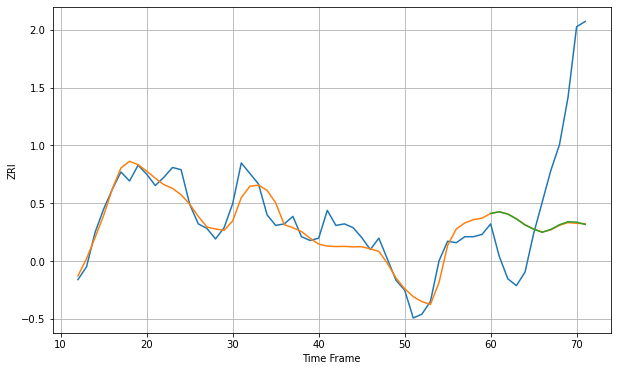

Wall time: 6.5 s
10065 18.980145175012296 132.38399516520155 132.07895292363267 [3985.88325449 3988.12988979 3985.04276342 3978.59490098 3970.54451083
 3964.94176728 3960.84654182 3964.65086434 3970.88199342 3974.91078511
 3974.36818138 3971.23245878]

Got an mse at 0.0100 in round 62 and stopped training

60 60 12


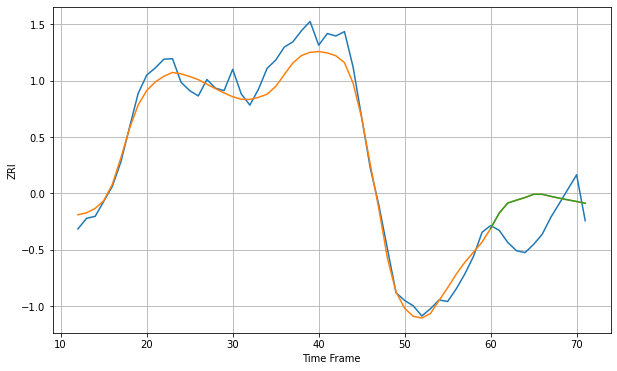

Wall time: 5.6 s
10075 29.747063102294184 68.50472982207263 68.47621979533679 [3062.93943176 3094.9128049  3115.65077765 3121.41697995 3126.84092469
 3133.58875858 3133.65336398 3129.44376864 3125.5906799  3122.13407998
 3118.81182088 3115.11423891]

Got an mse at 0.0100 in round 115 and stopped training

60 60 12


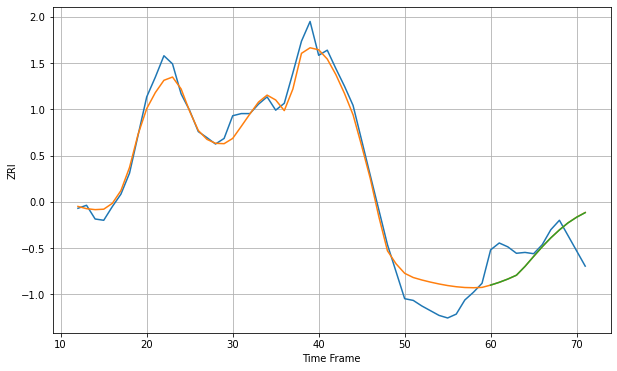

Wall time: 6.87 s
10128 32.91650568657606 63.36645517416305 63.29865935749334 [2836.70630558 2843.19530595 2850.84739525 2859.79591557 2880.35699841
 2903.57903402 2926.18317554 2946.9581398  2965.49575015 2981.9166803
 2995.09718331 3005.8397647 ]

Got an mse at 0.0099 in round 119 and stopped training

60 60 12


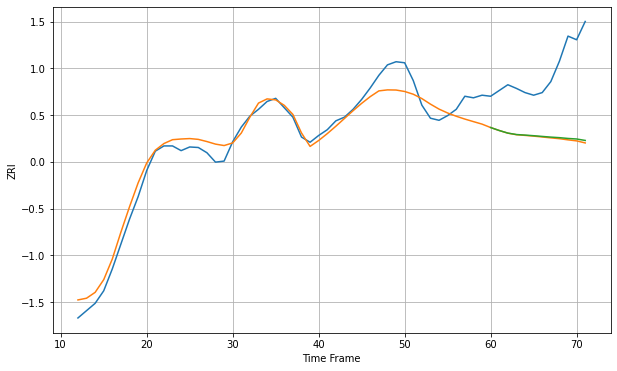

Wall time: 6.84 s
10302 24.210774179086666 132.32095918537914 130.41348882510079 [1807.15457729 1801.50493684 1796.55337073 1793.78964992 1792.71916256
 1791.53047246 1790.17151574 1788.86216771 1787.80764713 1786.30129597
 1785.26690355 1782.48663501]

Got an mse at 0.0099 in round 56 and stopped training

60 60 12


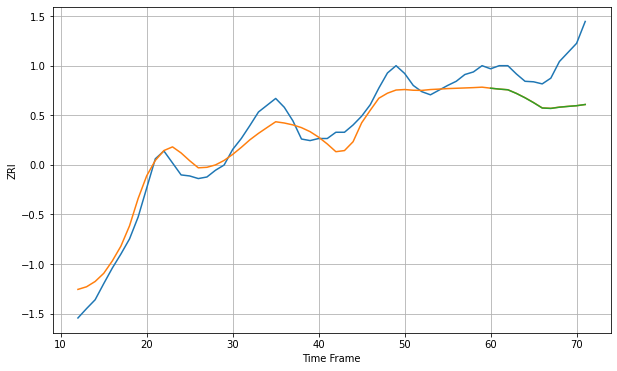

Wall time: 5.6 s
10303 27.018782596282097 78.15621615623762 78.24781136477276 [2027.73598716 2025.98729425 2024.66720694 2017.61947306 2009.25481913
 1999.84837659 1989.62667416 1988.80492881 1991.18284408 1992.70148403
 1994.0484799  1996.36778219]

Got an mse at 0.0099 in round 112 and stopped training

60 60 12


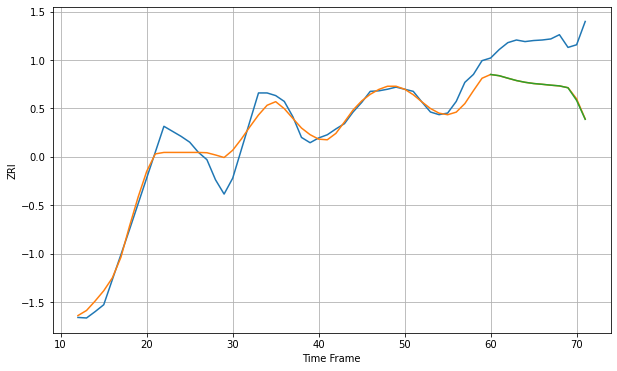

Wall time: 6.75 s
10304 22.845677137602927 91.47939260524912 91.85014548338295 [1901.86287868 1899.55083039 1894.89488784 1890.44838433 1887.13580306
 1884.81824627 1883.35222108 1881.71193191 1880.35578513 1876.73934262
 1852.92798033 1817.20621505]

Got an mse at 0.0099 in round 112 and stopped training

60 60 12


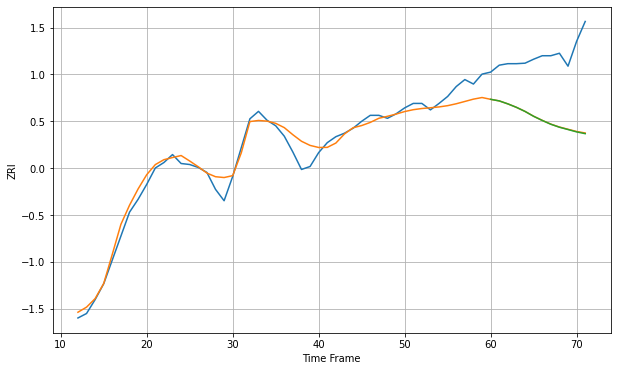

Wall time: 6.7 s
10305 20.423946919179684 129.90626090105383 130.33463885599605 [1892.2509957  1889.0615127  1883.07402589 1876.08529216 1867.85931038
 1858.05254302 1849.73294645 1842.06651516 1836.05790619 1831.412524
 1826.64973547 1823.08741686]

Got an mse at 0.0097 in round 73 and stopped training

60 60 12


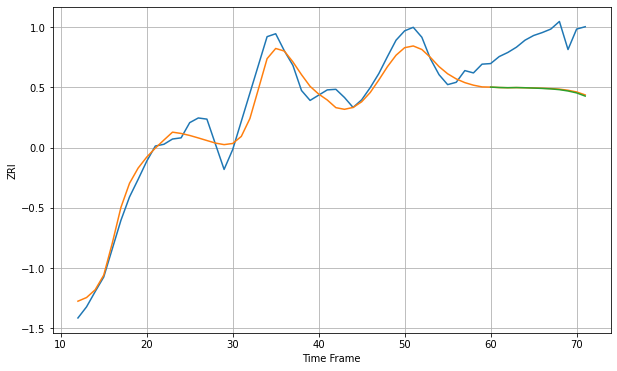

Wall time: 5.85 s
10306 22.131032468286257 86.7501685395228 87.40991959137332 [1873.77065017 1873.08283899 1872.74770424 1872.99305876 1872.65622868
 1872.11885212 1871.50837374 1870.70203997 1869.39602392 1867.13302067
 1863.85185464 1858.40776545]

Got an mse at 0.0099 in round 70 and stopped training

60 60 12


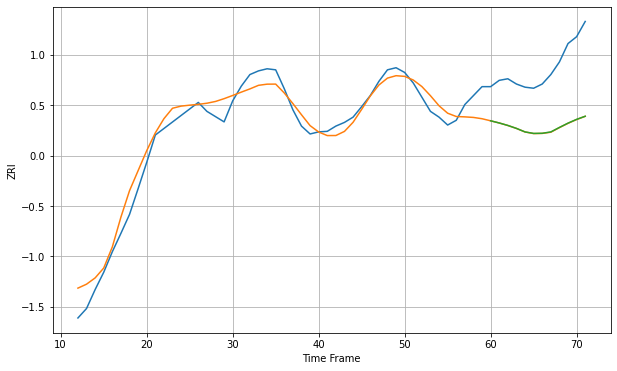

Wall time: 5.76 s
10310 24.623420359334975 114.5212202258555 114.29283306574692 [1872.04078054 1867.92264993 1863.21812095 1857.61251848 1850.90159636
 1848.08074344 1848.32081938 1850.89206857 1859.45887575 1867.61764516
 1874.77349718 1880.70566953]

Got an mse at 0.0099 in round 117 and stopped training

60 60 12


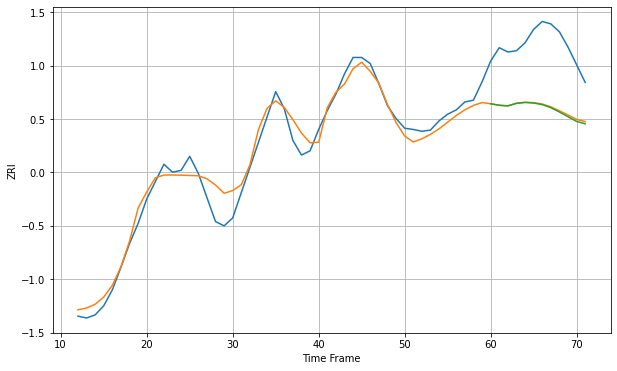

Wall time: 6.85 s
10312 20.506754981221327 104.45134296026455 105.71174353300611 [1737.1142215  1734.61015114 1733.60836441 1737.73859241 1739.20752346
 1738.33455975 1735.72767733 1730.67364876 1723.56303317 1715.93191295
 1708.10851378 1704.29569579]

Got an mse at 0.0098 in round 84 and stopped training

60 60 12


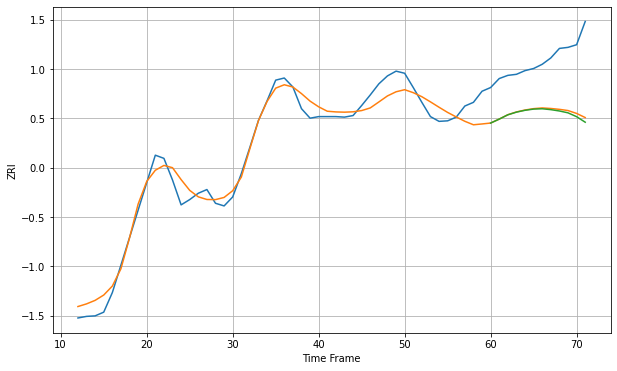

Wall time: 6.09 s
10314 23.012931995757004 102.40361592820078 105.48413883393414 [1792.79340479 1800.24741933 1808.37762668 1813.45289868 1816.91711719
 1819.22783107 1819.81083285 1818.16136005 1815.62457631 1812.11827272
 1804.80789674 1794.40005683]

Got an mse at 0.0095 in round 27 and stopped training

60 60 12


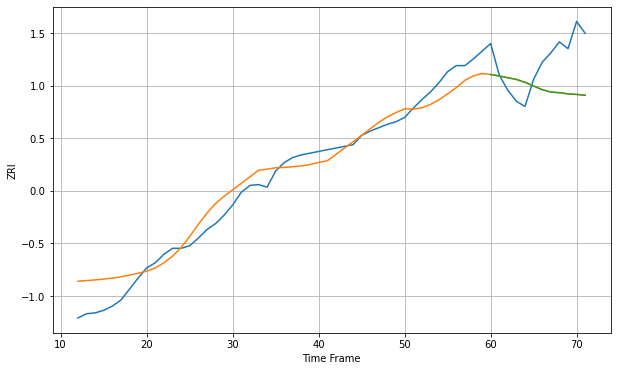

Wall time: 4.81 s
10453 18.509177047070366 45.96833126439503 45.93518780858938 [1650.57834991 1648.85017522 1646.79607913 1644.7552788  1641.33536438
 1637.01015126 1632.73347902 1629.91813653 1629.15762135 1627.7930873
 1627.14856831 1626.22342772]

Got an mse at 0.0099 in round 33 and stopped training

60 60 12


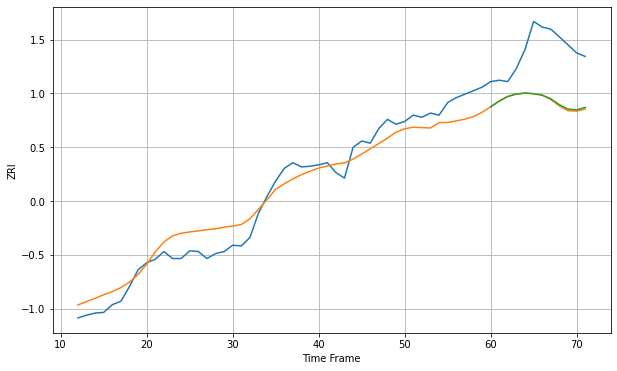

Wall time: 4.98 s
10455 22.630822112501654 76.0364797332245 75.11062878755766 [1854.90010412 1863.31285248 1869.79608757 1873.25461321 1874.54804708
 1873.69336079 1871.7005194  1866.44311698 1857.9764626  1851.80738668
 1850.55011958 1854.14078683]

Got an mse at 0.0100 in round 38 and stopped training

60 60 12


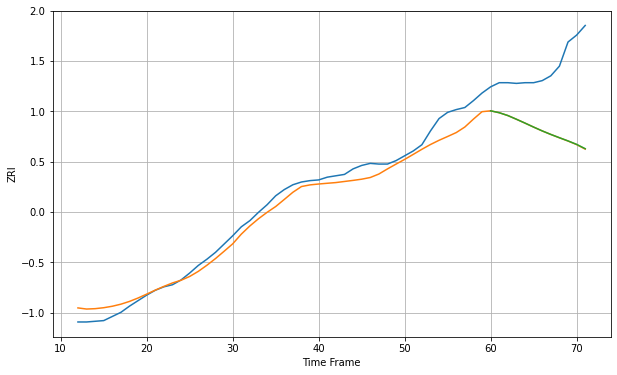

Wall time: 5.08 s
10456 15.252968811125113 98.73702138022588 98.55903534348363 [1753.21092082 1750.47583457 1746.36951572 1741.00530216 1735.40508897
 1729.63236589 1724.09834172 1718.98440326 1714.20786957 1709.57736586
 1704.56189924 1698.32289669]

Got an mse at 0.0098 in round 36 and stopped training

60 60 12


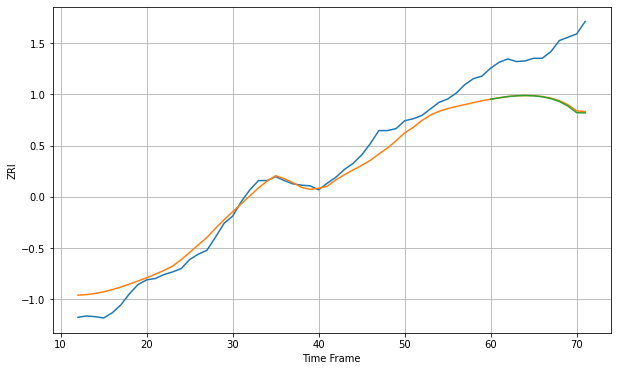

Wall time: 5.06 s
10457 19.020654116803456 80.06070352090764 81.11843445174878 [1816.67690305 1818.84754909 1820.77803451 1821.93894744 1822.35845636
 1821.91863601 1820.42946794 1817.67535612 1813.2448731  1806.276016
 1796.21808693 1795.93068077]

Got an mse at 0.0097 in round 32 and stopped training

60 60 12


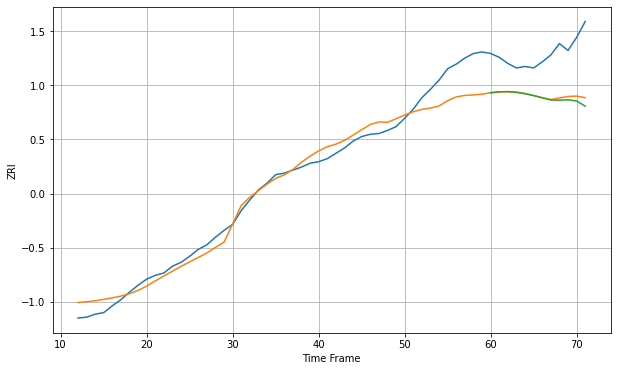

Wall time: 4.95 s
10458 19.49989375006896 57.71231352415985 60.814248716605526 [1705.47231669 1706.656095   1706.94084908 1706.14282344 1704.32101453
 1701.77697412 1698.92496046 1696.01308826 1695.67127053 1696.2692806
 1694.67089227 1687.90606243]

Got an mse at 0.0098 in round 27 and stopped training

60 60 12


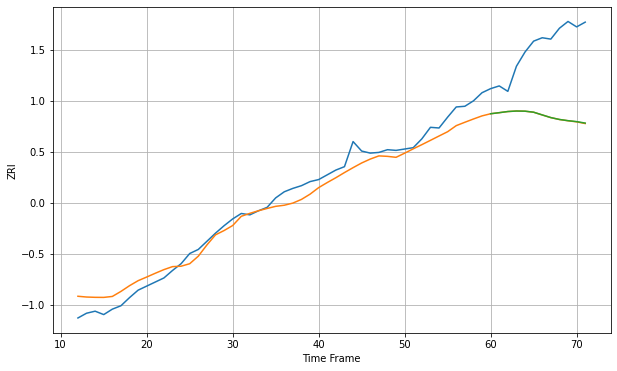

Wall time: 4.81 s
10459 16.85627852725274 105.88280250055189 105.71319962281393 [1792.99908223 1794.56277436 1796.27062047 1797.01070354 1796.78826838
 1795.28551283 1791.28489543 1787.34082882 1784.57302449 1782.796805
 1781.40826566 1779.23991178]

Got an mse at 0.0096 in round 35 and stopped training

60 60 12


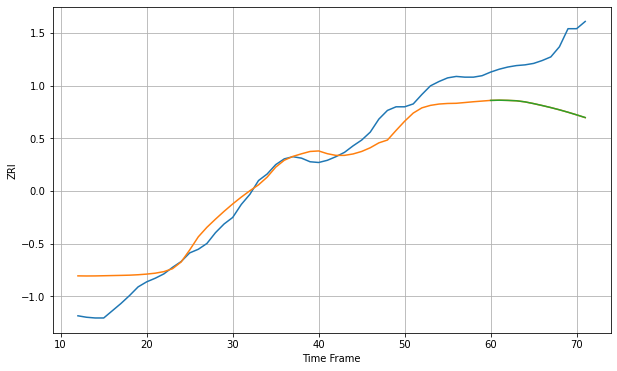

Wall time: 4.99 s
10460 26.753415318797526 79.15283604835703 79.12800375134162 [1769.84153097 1770.1293311  1769.85463581 1769.3523342  1767.82203558
 1765.42482035 1762.76553195 1759.93681822 1756.84919986 1753.48013953
 1749.86989135 1746.16259656]

Got an mse at 0.0099 in round 30 and stopped training

60 60 12


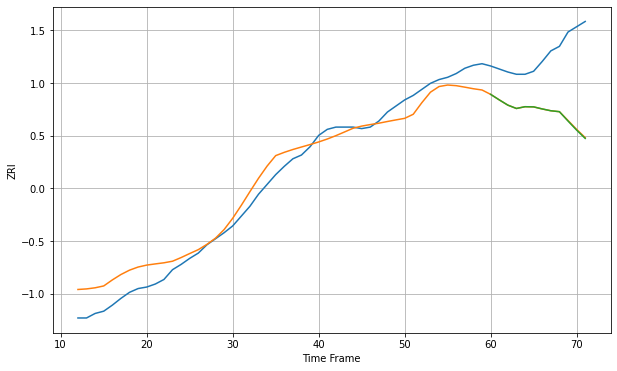

Wall time: 4.88 s
10461 20.494182414233922 84.09522436317155 84.46535675072181 [1797.38385924 1790.09118459 1783.12093773 1778.67439548 1781.02718496
 1780.79856878 1778.06894081 1775.67037068 1774.41364212 1762.02239584
 1750.01476737 1738.96626985]

Got an mse at 0.0096 in round 37 and stopped training

60 60 12


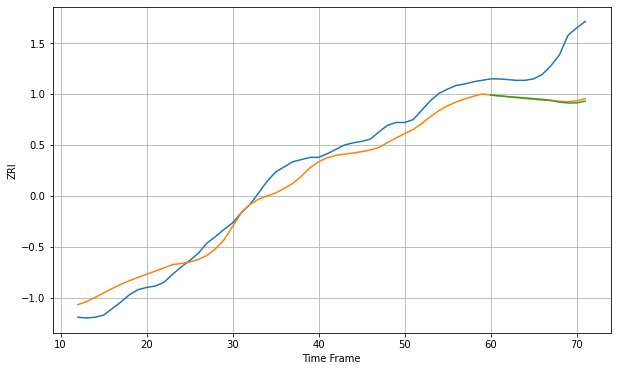

Wall time: 5.04 s
10462 18.784390136322756 58.35971996675202 59.47825666113359 [1787.82693414 1786.67588076 1785.68796851 1784.75134513 1783.77622847
 1782.82363952 1781.87607021 1780.32572613 1777.99428041 1776.78939962
 1776.93913597 1779.29940709]

Got an mse at 0.0099 in round 99 and stopped training

60 60 12


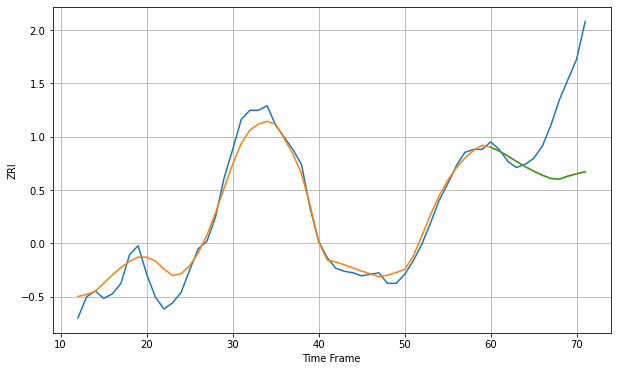

Wall time: 6.43 s
10463 8.734810006260357 45.02355571430257 45.146478842917794 [1796.4510446  1793.9027615  1790.60596192 1787.05828312 1783.63917273
 1780.56318514 1777.91224559 1775.67422969 1775.18628176 1777.19216809
 1778.71468924 1780.07170494]

Got an mse at 0.0098 in round 32 and stopped training

60 60 12


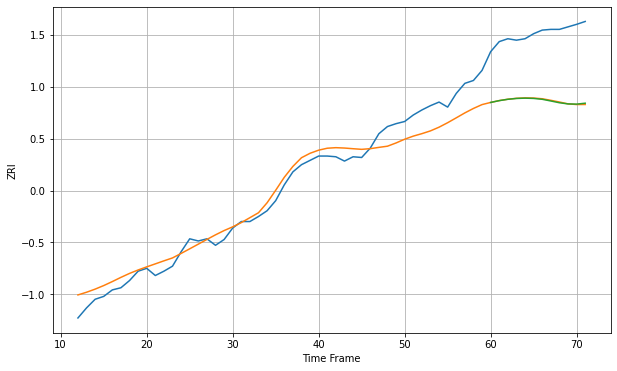

Wall time: 4.93 s
10465 19.960335458662556 94.07407089535596 94.17645037721611 [1859.4707108  1861.99539489 1863.8488638  1865.02041254 1865.43846825
 1865.05604978 1863.86221593 1861.5102941  1859.05263899 1857.42677995
 1857.14331852 1858.43035638]

Got an mse at 0.0096 in round 27 and stopped training

60 60 12


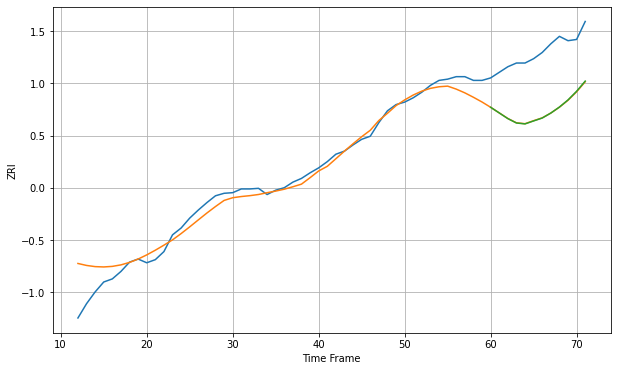

Wall time: 4.83 s
10466 20.59854839901335 93.42929776802423 93.32856648860118 [1845.65433083 1836.54067255 1827.41023958 1820.32353144 1818.85027608
 1823.64493381 1828.33901419 1836.33178813 1846.01788496 1857.51955963
 1871.48503851 1887.87089202]

Got an mse at 0.0098 in round 31 and stopped training

60 60 12


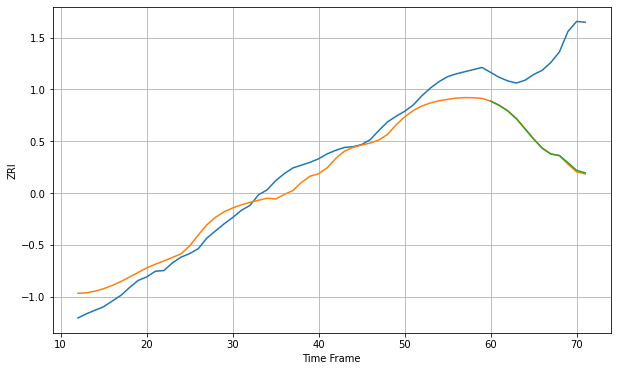

Wall time: 4.89 s
10467 20.867136716336486 128.1396682744681 127.47614474489949 [1748.44915112 1742.44414996 1734.53392906 1723.4692438  1709.15655062
 1694.69733787 1681.91276631 1673.71163404 1671.46428963 1661.39143604
 1650.56887299 1647.11162841]

Got an mse at 0.0099 in round 31 and stopped training

60 60 12


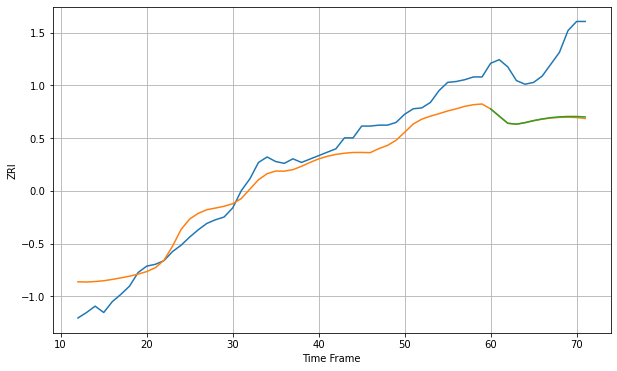

Wall time: 4.9 s
10468 19.756130153598065 69.82961601527869 69.27693792558968 [1510.8692692  1502.9199535  1495.05442914 1494.04183958 1495.81385126
 1498.03018068 1499.85948465 1501.23718061 1502.13212774 1502.56152269
 1502.5227342  1502.05023153]

Got an mse at 0.0097 in round 25 and stopped training

60 60 12


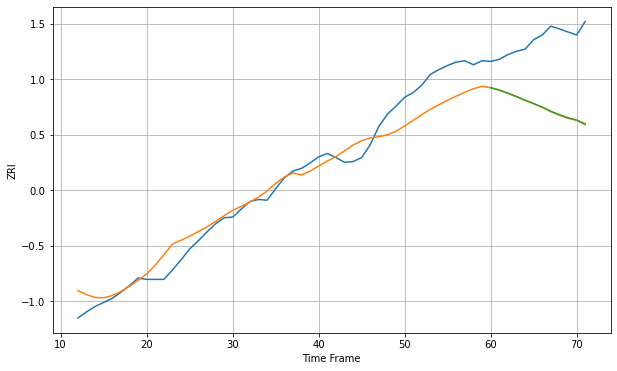

Wall time: 4.78 s
10469 26.255048471925093 101.80881000151318 101.68300508278901 [1861.16550895 1857.69382722 1853.07477918 1848.0829712  1842.74172922
 1837.71018527 1832.59399206 1826.42954121 1821.2839207  1816.76989319
 1813.24770029 1806.62419799]

Got an mse at 0.0098 in round 18 and stopped training

60 60 12


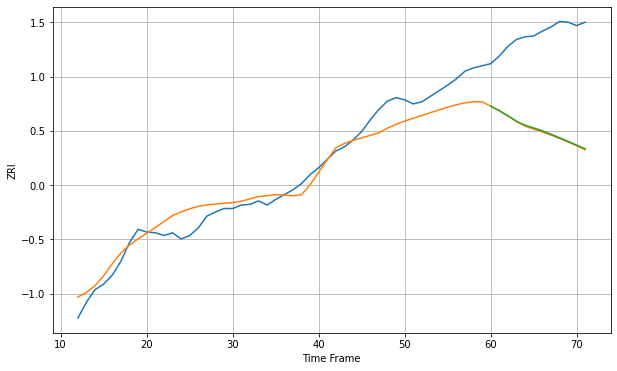

Wall time: 4.72 s
10470 23.23073877644435 140.3980499647676 139.4632406595391 [1812.82654792 1806.20227985 1798.90271366 1790.87825091 1785.25134223
 1781.3036095  1777.26189819 1772.38135253 1767.23981303 1761.98793503
 1756.53172651 1750.95928375]

Got an mse at 0.0098 in round 51 and stopped training

60 60 12


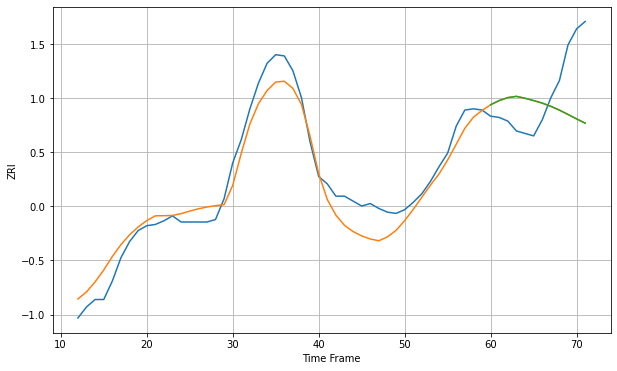

Wall time: 5.37 s
10471 14.326177480784391 40.06452335199476 40.097091794594554 [1859.31295965 1862.73466237 1865.11869721 1866.11589508 1864.58229198
 1862.70402551 1860.65673775 1858.04106878 1854.93726894 1851.4024549
 1847.77397382 1844.28500024]

Got an mse at 0.0096 in round 25 and stopped training

60 60 12


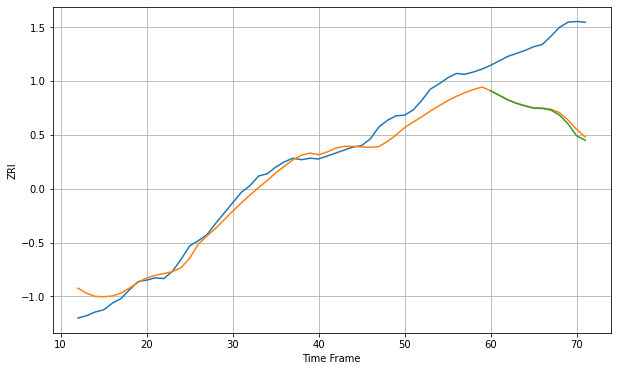

Wall time: 4.78 s
10472 17.021909049921735 98.2537294623162 101.0059011698224 [1792.66998622 1786.60352048 1780.49513411 1775.84108669 1772.32133838
 1769.35619822 1768.95904478 1766.68278455 1760.07791811 1748.28499714
 1732.14897364 1726.18759722]

Got an mse at 0.0099 in round 38 and stopped training

60 60 12


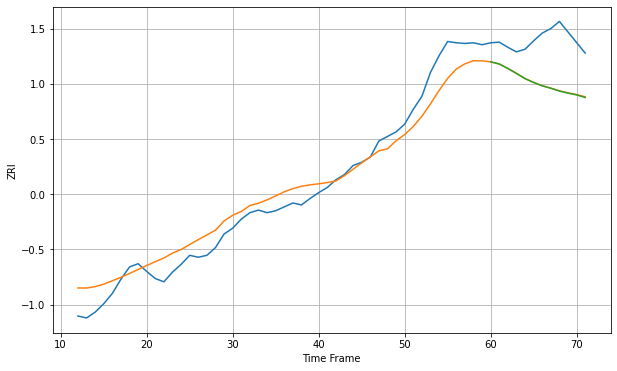

Wall time: 5.07 s
10473 26.36689878579008 68.89478928595194 69.20816892412034 [2008.52125129 2005.16749596 1998.22943318 1990.55935523 1982.52544141
 1976.52999303 1971.36416473 1967.61064078 1963.29883315 1960.03291295
 1957.29123133 1953.26867913]

Got an mse at 0.0099 in round 86 and stopped training

60 60 12


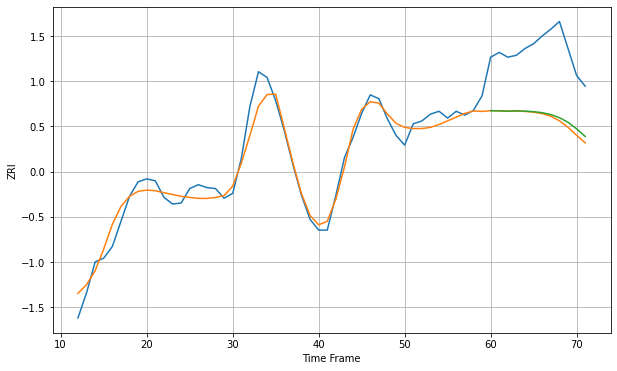

Wall time: 6.17 s
10528 12.04444859238866 71.6287267536498 69.50023953657325 [2471.63342573 2471.45743189 2471.14519534 2471.4647819  2471.13599651
 2470.61444588 2469.52189726 2467.59759825 2464.40953707 2459.60692297
 2452.83370868 2444.92526456]

Got an mse at 0.0099 in round 136 and stopped training

60 60 12


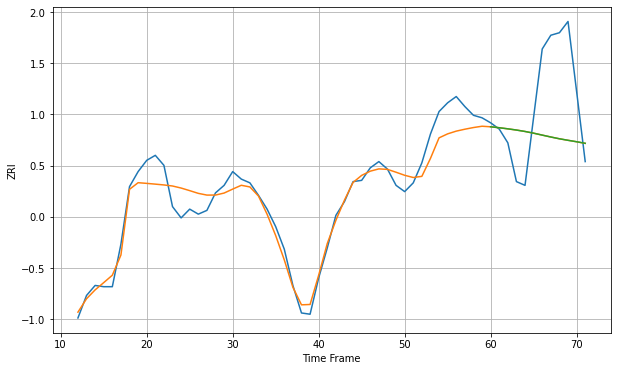

Wall time: 7.22 s
10543 11.718700632239853 52.634052009304725 52.63192564989405 [2425.81082632 2425.05912757 2424.18226379 2423.21402277 2422.07367844
 2420.71048386 2419.16845902 2417.65316305 2416.23168935 2415.01434313
 2413.86327153 2412.61516365]

Got an mse at 0.0096 in round 52 and stopped training

60 60 12


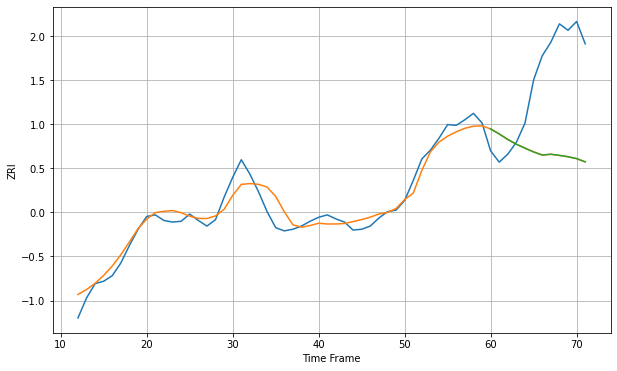

Wall time: 5.37 s
10562 13.480779316237854 111.78142750180108 111.76160530494866 [2103.50658045 2097.21136759 2090.28521848 2084.30955236 2079.38539788
 2074.70866032 2070.83330629 2071.86785034 2070.48047126 2068.74761834
 2066.40515006 2062.39188201]

Got an mse at 0.0098 in round 106 and stopped training

60 60 12


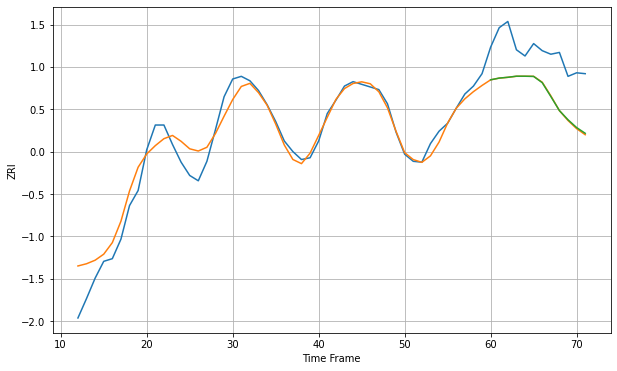

Wall time: 6.6 s
10573 16.45002117485135 50.34860383517674 50.04217573131521 [2255.05955908 2257.03324445 2257.94017075 2259.16841598 2259.13260196
 2258.89873916 2251.8563857  2236.22156898 2220.3109541  2209.93369511
 2201.13813231 2194.64753261]

Got an mse at 0.0100 in round 32 and stopped training

60 60 12


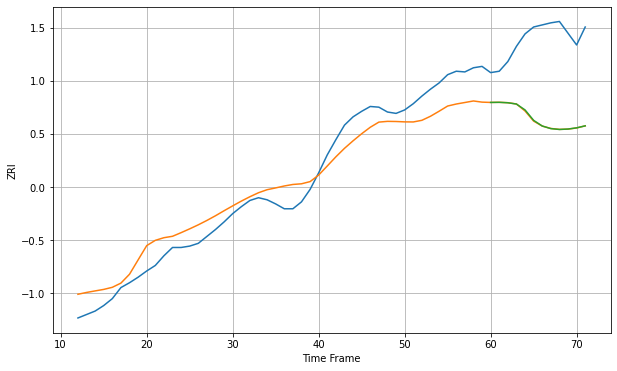

Wall time: 4.92 s
10701 28.16598595061662 118.54265946931808 118.3307655554202 [1993.85604258 1993.99623949 1993.37504123 1991.52219865 1983.03572643
 1967.93257946 1959.75665666 1955.96228733 1954.72600491 1955.35723403
 1957.09385004 1959.99037461]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


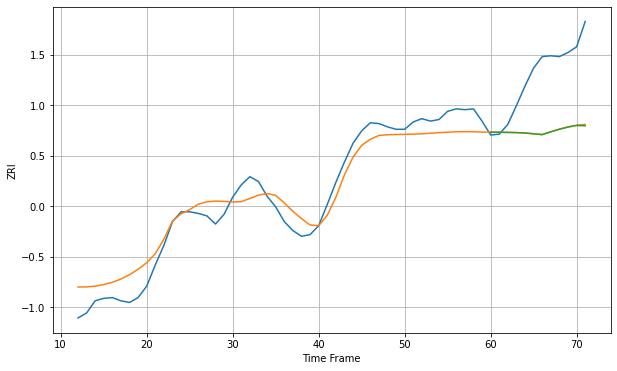

Wall time: 5.31 s
10703 19.73681616983741 76.38354783524929 76.7320836048437 [2107.48596774 2107.35005607 2107.16517416 2106.95936944 2106.43227295
 2105.49081194 2104.4608613  2107.86736948 2111.02419749 2113.67992422
 2115.64834715 2115.28628533]

Got an mse at 0.0099 in round 120 and stopped training

60 60 12


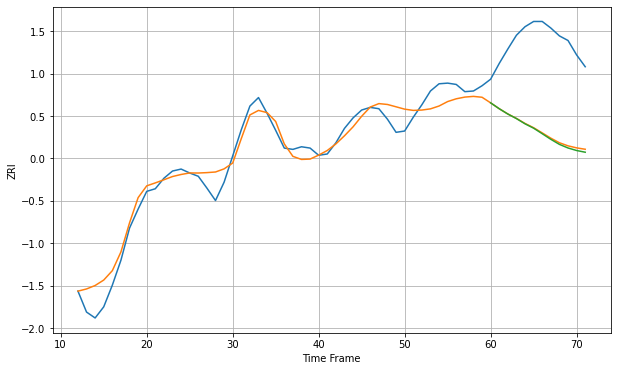

Wall time: 6.88 s
10704 19.798567897304597 136.9883696128789 138.70989484107835 [2159.92399039 2150.96716976 2142.89346617 2135.96099506 2127.96703283
 2121.30705644 2112.89976119 2104.34053932 2096.63159103 2091.14033955
 2087.29031787 2084.66655404]

Got an mse at 0.0100 in round 73 and stopped training

60 60 12


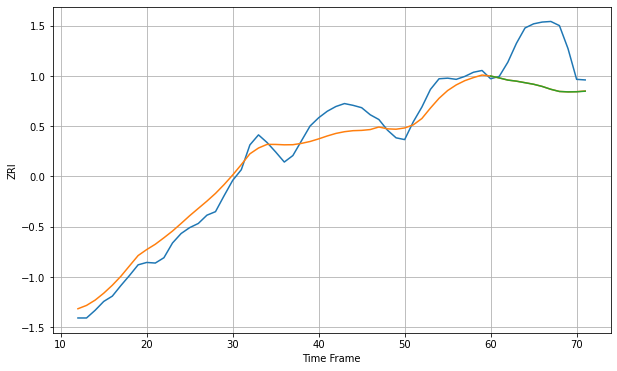

Wall time: 5.86 s
10705 23.625884901658804 75.13323368171474 75.15590660844578 [1995.60166872 1992.42364947 1988.78927141 1986.93707056 1984.31692838
 1981.68537022 1977.99831656 1973.15534836 1969.46748314 1968.7662964
 1968.97237505 1969.96244021]

Got an mse at 0.0099 in round 82 and stopped training

60 60 12


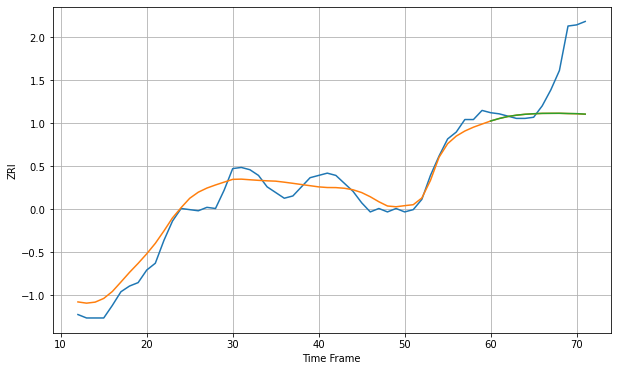

Wall time: 6.04 s
10940 10.245098595909349 41.38886517318828 41.34680207242375 [1425.71903604 1427.91136598 1429.64599052 1430.82426935 1431.60989182
 1432.08149241 1432.39933826 1432.45168244 1432.49156236 1432.28931622
 1432.16725695 1431.76461043]

Got an mse at 0.0097 in round 83 and stopped training

60 60 12


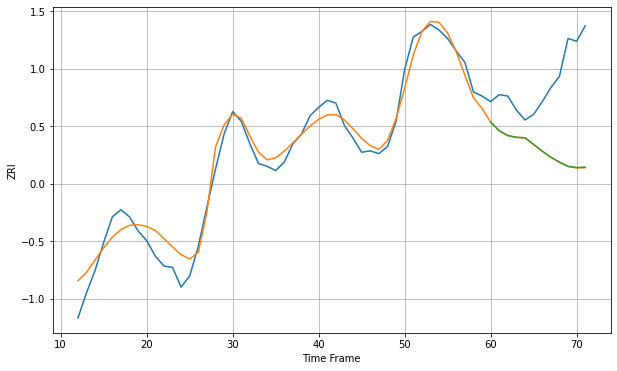

Wall time: 6.07 s
10960 10.019234161274886 55.339404945914985 55.196819369845215 [1839.4582619  1833.26119837 1829.90170386 1828.60596723 1828.30105143
 1823.56011584 1818.77932111 1814.45997702 1811.00138144 1807.98192927
 1807.09209308 1807.41928019]

Got an mse at 0.0099 in round 98 and stopped training

60 60 12


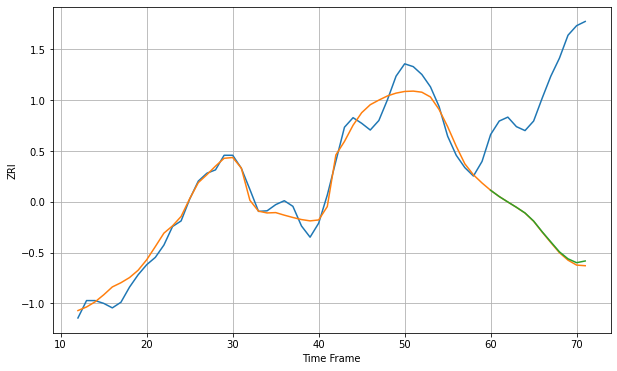

Wall time: 6.37 s
10977 20.92585493845165 277.3060490209322 275.01251652990345 [2007.57065933 1996.43330315 1986.74863331 1977.30551178 1967.14316342
 1952.79713307 1933.57016617 1915.62935597 1897.90646009 1885.44470202
 1878.53485891 1881.61046874]

Got an mse at 0.0099 in round 59 and stopped training

60 60 12


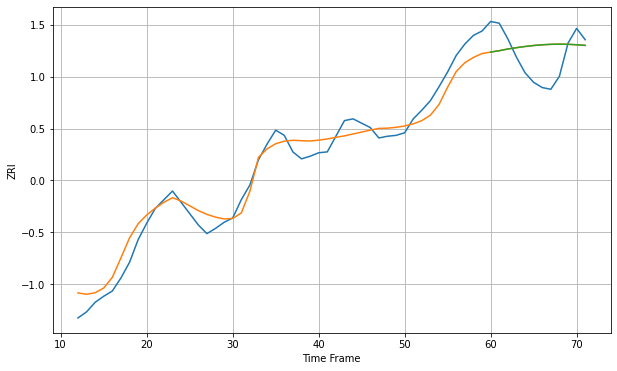

Wall time: 5.53 s
11001 15.05895342018494 31.683855429415292 31.69425556423847 [2165.81101344 2167.359792   2169.3392595  2170.85366205 2172.2196281
 2173.36156875 2174.18335443 2174.71130468 2174.90862393 2174.75171554
 2174.19660035 2173.44216068]

Got an mse at 0.0100 in round 128 and stopped training

60 60 12


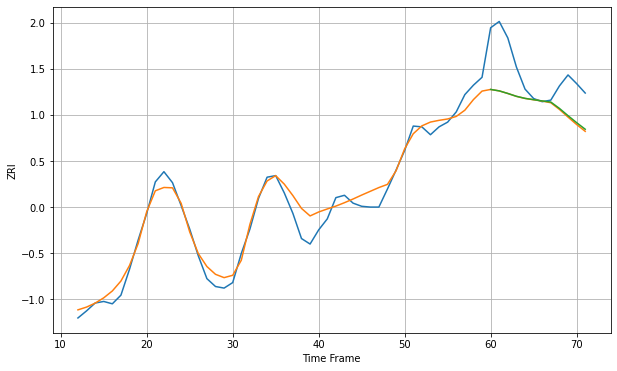

Wall time: 7.09 s
11003 13.93995815760404 49.418184807133365 48.75372354788851 [2206.56674932 2204.74136835 2201.4618812  2197.83389886 2195.22505854
 2193.56008732 2191.94642024 2190.52170919 2182.47612418 2173.23993258
 2164.34680815 2155.96865411]

Got an mse at 0.0098 in round 104 and stopped training

60 60 12


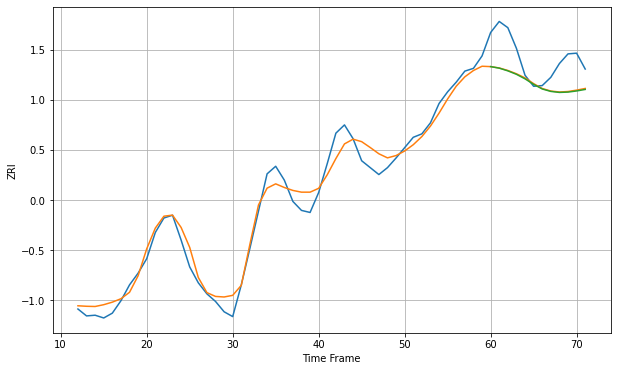

Wall time: 6.54 s
11010 16.55375288558194 41.82527524752105 42.37804749123676 [2383.51593676 2381.30281992 2377.37359432 2372.3615629  2365.79667121
 2357.79217123 2351.1031337  2347.55686517 2346.08888116 2346.57676399
 2348.22314079 2350.4207103 ]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


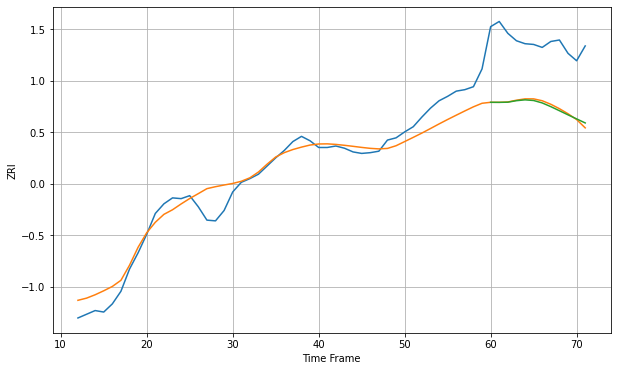

Wall time: 5.31 s
11050 19.66716022925977 88.66638725370922 89.08148388634623 [2557.9577107  2557.86788652 2558.09669073 2560.13030625 2561.25710869
 2560.37277336 2557.09252632 2552.09361131 2546.57903385 2541.01641525
 2535.56295741 2530.10669671]

Got an mse at 0.0098 in round 186 and stopped training

60 60 12


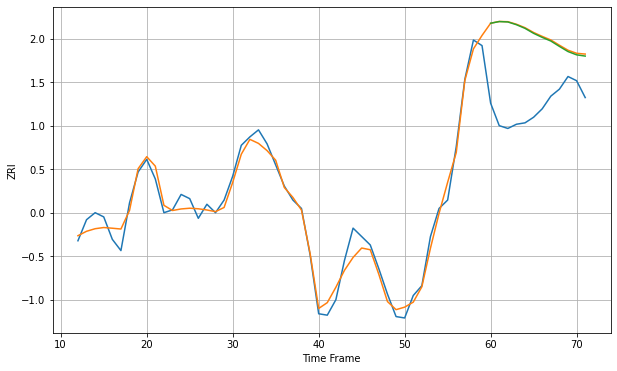

Wall time: 8.38 s
11101 7.068274172075116 53.83556258082932 53.391102006063264 [2544.95229385 2546.13767883 2545.86208216 2543.90131562 2541.29252475
 2537.7469788  2534.86753441 2532.28579494 2528.44578324 2524.78229422
 2522.43916265 2521.55135342]

Got an mse at 0.0099 in round 200 and stopped training

60 60 12


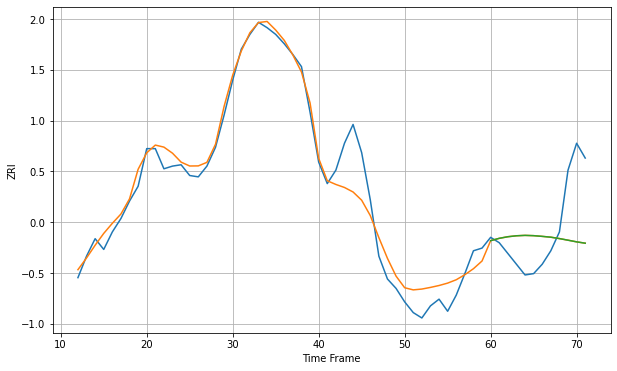

Wall time: 8.86 s
11102 13.469001166686871 35.29879382605407 35.30190453857997 [2185.51557754 2187.25925618 2188.44879868 2189.1610206  2189.45747256
 2189.24534656 2188.71744662 2188.10908807 2187.0743792  2185.87504259
 2184.63709663 2183.63755042]

Got an mse at 0.0099 in round 103 and stopped training

60 60 12


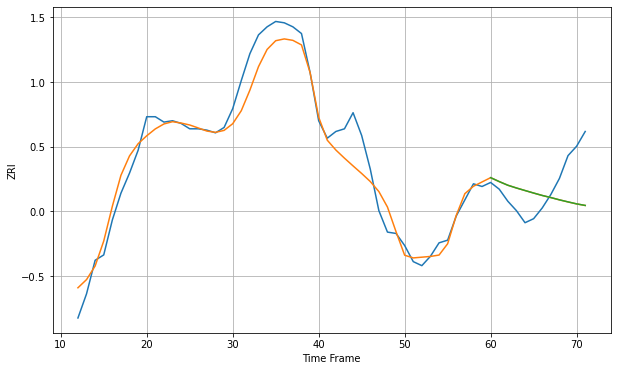

Wall time: 6.51 s
11103 13.048398980938059 25.559864084528556 25.547008921621963 [2157.59177034 2154.65095151 2151.93424416 2149.88601527 2147.99486667
 2146.12065522 2144.32298332 2142.75825787 2141.05451326 2139.51855604
 2138.04749413 2136.88234927]

Got an mse at 0.0100 in round 139 and stopped training

60 60 12


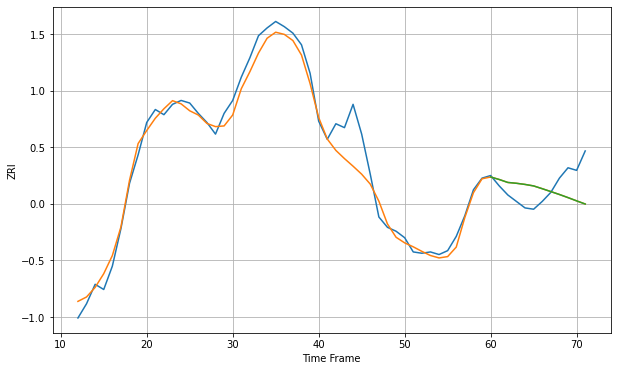

Wall time: 7.34 s
11104 11.396132687394916 18.23335019982806 18.237539300365466 [2102.8868375  2100.94115663 2098.66351586 2098.0276128  2097.13800278
 2095.98241627 2093.84538399 2091.61958186 2089.36570588 2086.9584924
 2084.44474339 2082.00700089]

Got an mse at 0.0099 in round 125 and stopped training

60 60 12


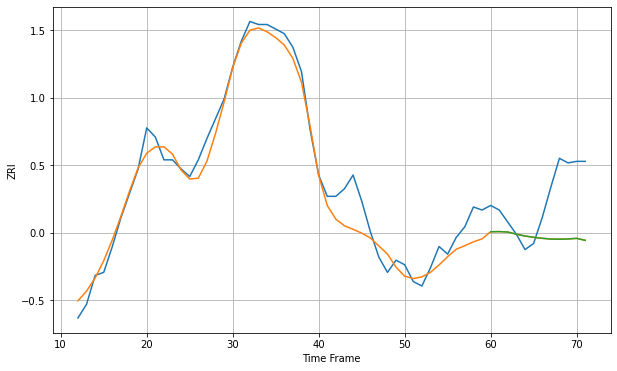

Wall time: 7.01 s
11105 10.798607340125175 32.367296559465636 32.39187185010836 [2169.68486325 2169.81777044 2169.5109408  2168.07739301 2166.90205848
 2166.04806384 2165.38488262 2164.89240665 2164.78752336 2164.93604432
 2165.3492425  2164.03907726]

Got an mse at 0.0098 in round 92 and stopped training

60 60 12


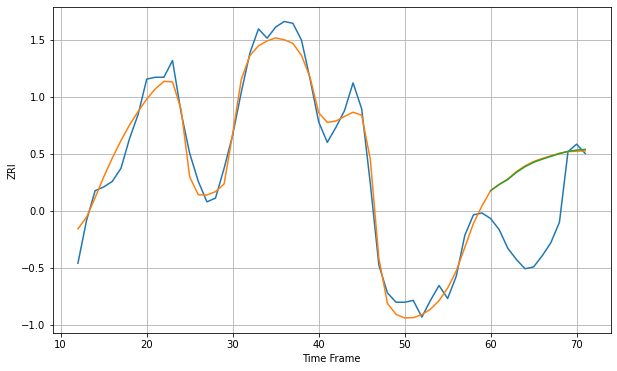

Wall time: 6.28 s
11106 7.802502778709799 37.68688788412484 37.39744183007425 [2149.01658989 2152.33659739 2155.00979031 2158.83353913 2161.87705786
 2164.23643801 2165.92436173 2167.41671435 2168.90896389 2170.14854279
 2170.81525209 2171.19897764]

Got an mse at 0.0099 in round 210 and stopped training

60 60 12


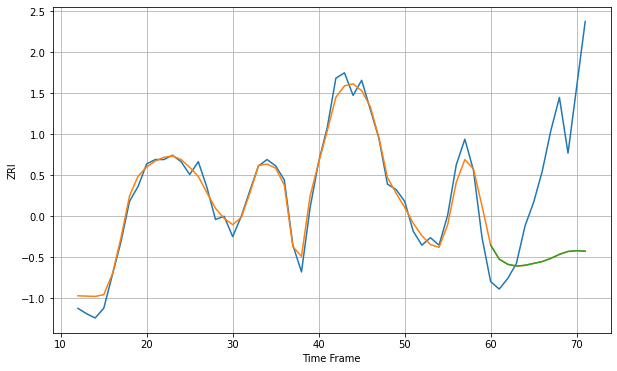

Wall time: 8.89 s
11201 9.722695317809734 103.05810485801449 103.01388307054297 [2873.15005218 2859.94295628 2855.09425213 2853.49717348 2854.20234334
 2855.97980938 2857.71135931 2860.69051068 2864.41395859 2867.16762504
 2867.86282223 2867.39780224]
60 60 12


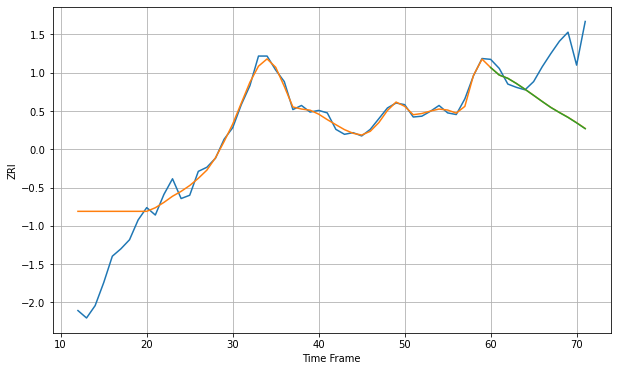

Wall time: 15.4 s
11203 35.28378056361649 62.232126848209205 62.33599234861906 [2147.05252335 2137.94487251 2133.96019293 2127.6670973  2120.65278091
 2113.27902527 2105.81809644 2098.61086926 2092.42880549 2086.54412033
 2079.89619892 2072.81572429]
60 60 12


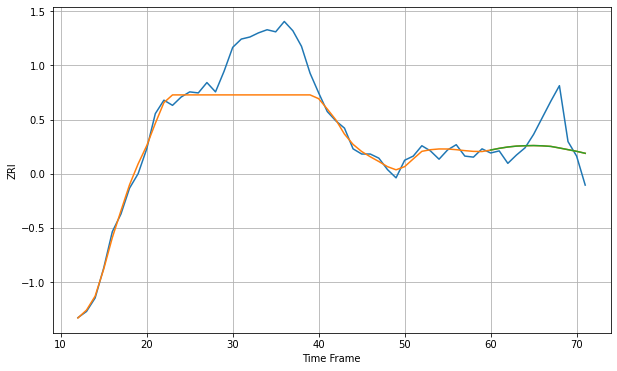

Wall time: 15.4 s
11204 25.974849887672598 25.39561845695298 25.400251554848552 [2000.84828774 2002.48644604 2003.77832713 2004.64404019 2005.01000355
 2005.17885544 2004.91230823 2004.34915309 2002.83728342 2001.21684045
 1999.61796964 1997.69805705]

Got an mse at 0.0100 in round 176 and stopped training

60 60 12


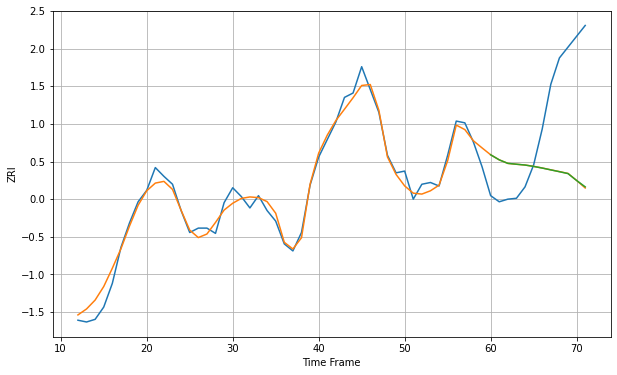

Wall time: 8.15 s
11205 10.195453554878796 99.4137425895074 99.26773098884301 [2831.59317175 2825.81050665 2821.79801352 2820.82502464 2819.90860539
 2818.33720562 2816.45637613 2814.36119537 2812.30450013 2810.1449025
 2802.2664857  2795.0406554 ]

Got an mse at 0.0099 in round 146 and stopped training

60 60 12


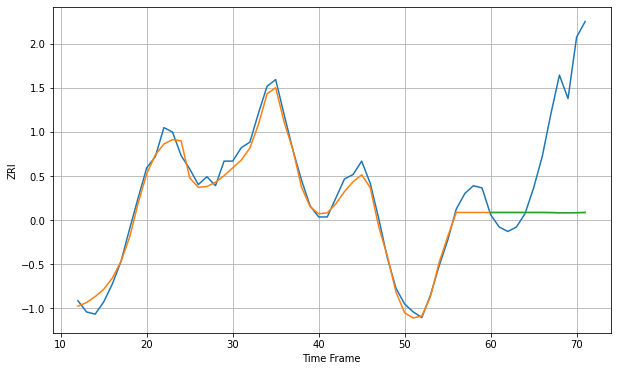

Wall time: 7.49 s
11206 8.83942520412196 87.05500473542278 87.05724534189852 [2544.02480817 2544.02480817 2544.02480817 2544.02480817 2544.02480817
 2544.02480817 2544.02480817 2543.94007132 2543.78565098 2543.75210001
 2543.81415288 2544.01899847]

Got an mse at 0.0098 in round 41 and stopped training

60 60 12


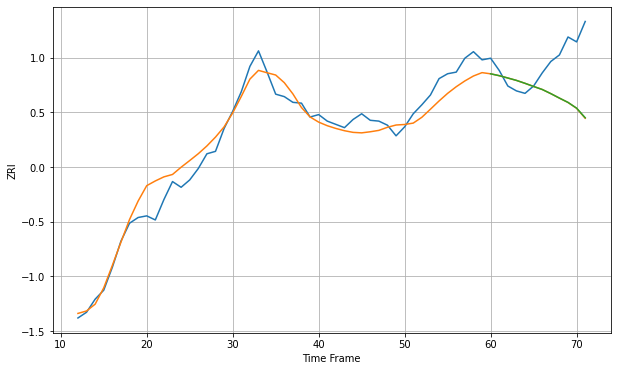

Wall time: 6.08 s
11207 17.328969810027406 52.16934292408974 52.00596455600984 [2242.91564442 2240.63217981 2237.78146674 2234.86071289 2231.27144881
 2227.41979122 2223.73537417 2218.6532841  2213.1911005  2207.90835987
 2200.87070251 2189.12528008]

Got an mse at 0.0099 in round 100 and stopped training

60 60 12


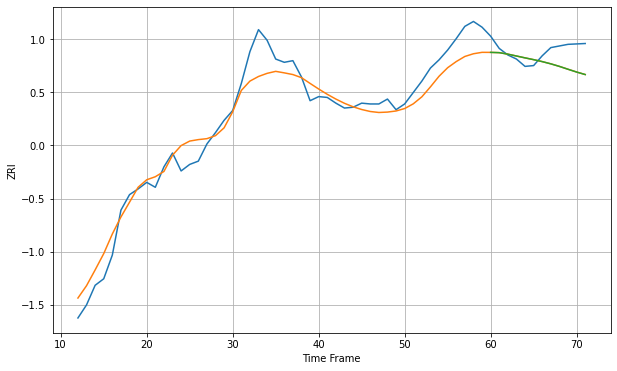

Wall time: 6.48 s
11208 20.853477506347556 20.85542675959857 20.873409259123992 [2232.1564252  2231.81626358 2229.98601122 2227.713261   2225.43572691
 2223.24371005 2220.85265493 2218.1190055  2214.98218362 2211.48216913
 2208.07605095 2205.01263579]

Got an mse at 0.0080 in round 325 and stopped training

60 60 12


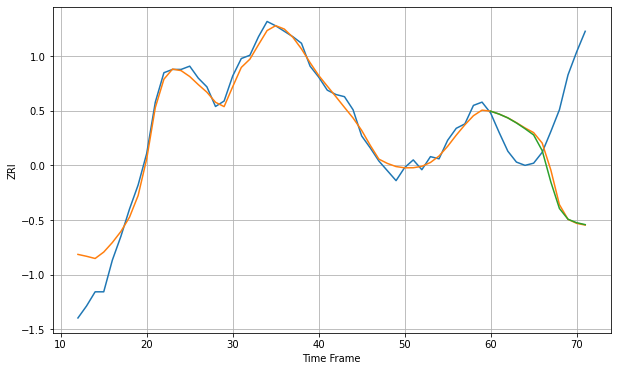

Wall time: 11.5 s
11209 14.084123755120517 85.27276700144574 85.71856119781995 [2083.69210287 2081.00504273 2077.52248168 2072.90612618 2067.61782177
 2061.91883251 2047.49444626 2018.80290718 1994.45203357 1984.55606972
 1981.40410679 1979.63539503]

Got an mse at 0.0100 in round 98 and stopped training

60 60 12


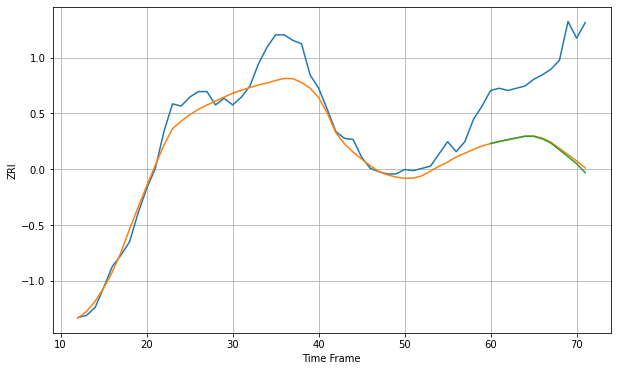

Wall time: 6.41 s
11210 15.853874693554772 76.60259544328119 77.98240512335106 [1912.32445004 1914.12405435 1915.75954561 1917.33133153 1918.88505006
 1918.76703946 1916.60145467 1912.72184177 1906.68862975 1900.53487408
 1894.1852301  1886.17023107]

Got an mse at 0.0100 in round 233 and stopped training

60 60 12


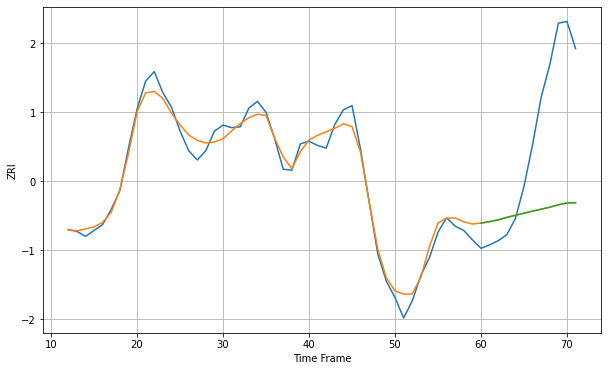

Wall time: 9.58 s
11211 11.502624652678621 122.3504806773506 122.27969074492248 [2735.716706   2737.3705976  2739.50434628 2742.33416149 2744.85230859
 2747.22529561 2749.76097241 2752.01796285 2754.37556812 2757.27961761
 2759.4608472  2759.77278792]

Got an mse at 0.0100 in round 117 and stopped training

60 60 12


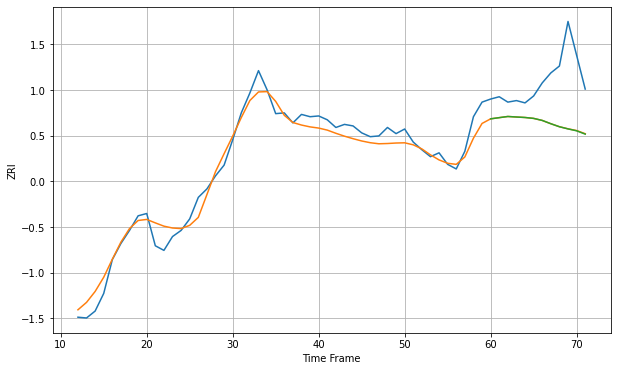

Wall time: 6.8 s
11212 14.626622626758245 63.860096289061694 63.967969778054595 [2133.22907585 2134.78191573 2136.3002886  2135.62522264 2134.9953513
 2133.82257679 2131.17749683 2126.89105118 2122.94721007 2120.1306565
 2117.65860011 2113.34036713]

Got an mse at 0.0099 in round 106 and stopped training

60 60 12


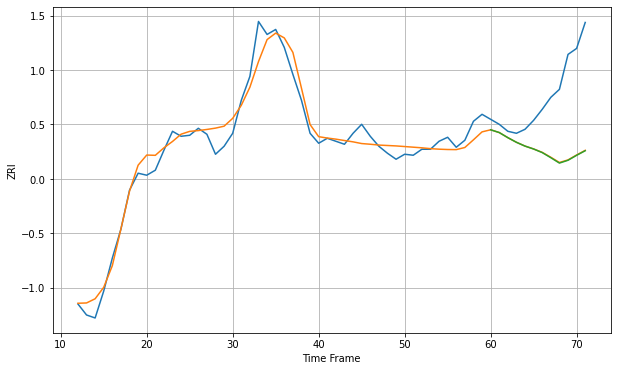

Wall time: 6.62 s
11213 12.257828029637805 65.32082803143416 65.58617024785582 [2293.49753758 2290.73892696 2285.62294227 2280.97430992 2277.15591839
 2274.2523948  2270.65872758 2265.53291063 2260.13356618 2262.96430186
 2267.92585028 2272.51538537]

Got an mse at 0.0100 in round 33 and stopped training

60 60 12


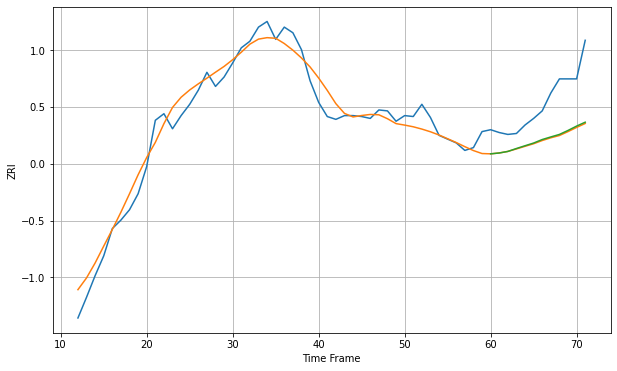

Wall time: 4.98 s
11214 14.218943729747618 44.20072966761642 43.35076440105828 [2054.37530309 2055.27523089 2056.92305686 2060.03191331 2062.96848278
 2065.85304614 2069.572977   2072.32168533 2074.99001321 2079.22778872
 2083.85300746 2087.99135287]

Got an mse at 0.0099 in round 282 and stopped training

60 60 12


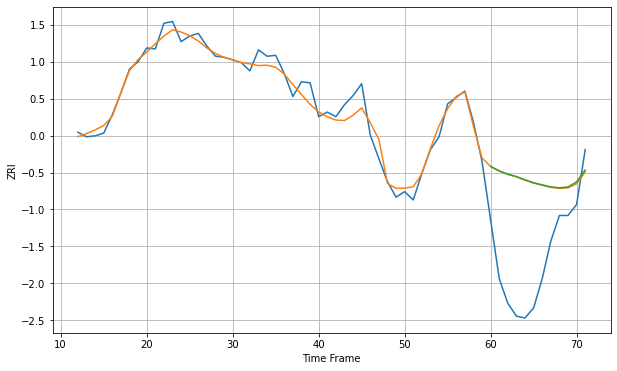

Wall time: 10.6 s
11215 10.102397925865619 99.3278376698074 99.53589745208039 [2544.51700429 2539.6534722  2536.08779879 2533.48372521 2529.92352121
 2526.74906514 2524.45525374 2522.1459038  2521.28175734 2522.11422836
 2527.69171329 2540.71071825]

Got an mse at 0.0099 in round 95 and stopped training

60 60 12


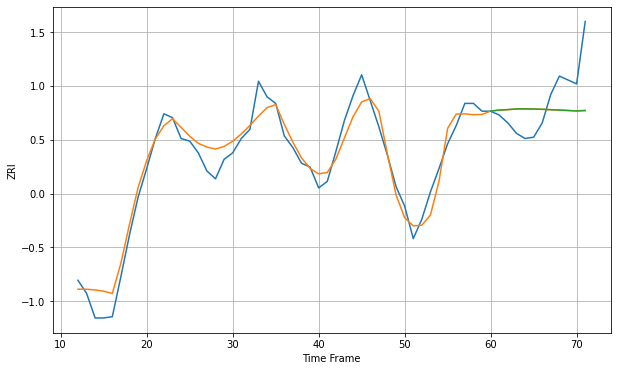

Wall time: 6.34 s
11216 11.132637760861959 25.912833933940913 25.920586371162734 [2506.10370751 2506.84415816 2507.2176656  2507.72305249 2507.79066981
 2507.65822458 2507.45285442 2507.15727363 2506.87688036 2506.53435299
 2506.20318478 2506.52217342]

Got an mse at 0.0099 in round 381 and stopped training

60 60 12


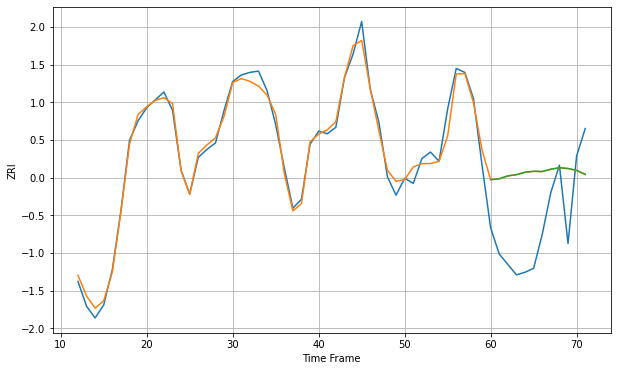

Wall time: 12.8 s
11217 6.284789318799198 53.08836128532014 53.08075371178755 [2827.90755504 2828.53143114 2830.7604617  2831.70326356 2833.5567331
 2834.29612646 2834.11680232 2835.90514579 2837.00877406 2836.45265051
 2835.06808486 2832.02936268]

Got an mse at 0.0098 in round 203 and stopped training

60 60 12


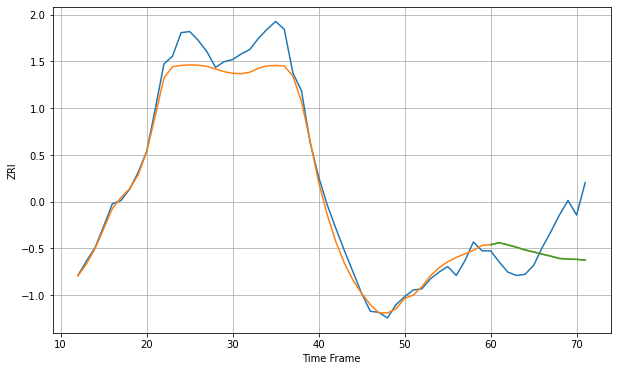

Wall time: 8.78 s
11218 13.792249501063269 33.31416464391169 33.300359039235445 [2040.49038705 2042.24355748 2040.35016146 2038.23469967 2035.8155014
 2033.98823325 2032.05114506 2030.22666314 2028.21816411 2027.61864993
 2027.38076949 2026.69530374]

Got an mse at 0.0099 in round 59 and stopped training

60 60 12


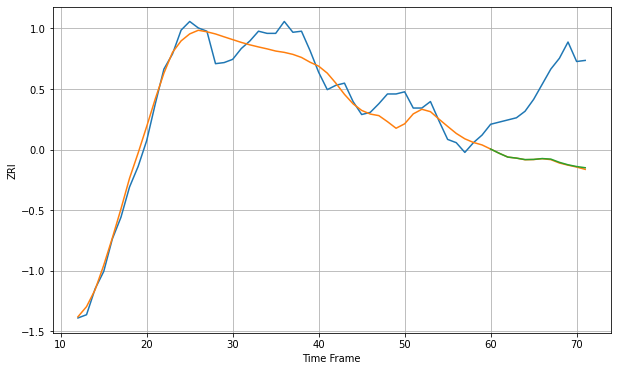

Wall time: 5.53 s
11219 13.508983671003326 72.29492896654995 71.88241088111798 [2088.08961815 2084.17437665 2080.67393579 2079.72689352 2078.36379546
 2078.52007861 2079.30298207 2078.81172529 2075.82449372 2073.54904365
 2071.95396541 2070.83929947]

Got an mse at 0.0099 in round 346 and stopped training

60 60 12


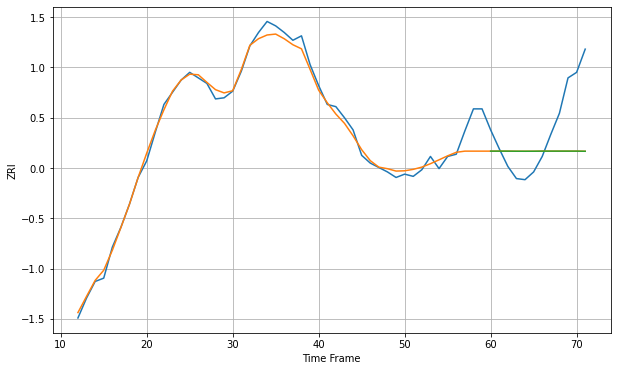

Wall time: 12 s
11220 9.4785955607611 42.409230336694435 42.41184730435343 [2045.79460369 2045.79460369 2045.77727897 2045.70914585 2045.6869215
 2045.71202853 2045.79460369 2045.79460369 2045.79460369 2045.79460369
 2045.79460369 2045.67671569]

Got an mse at 0.0100 in round 146 and stopped training

60 60 12


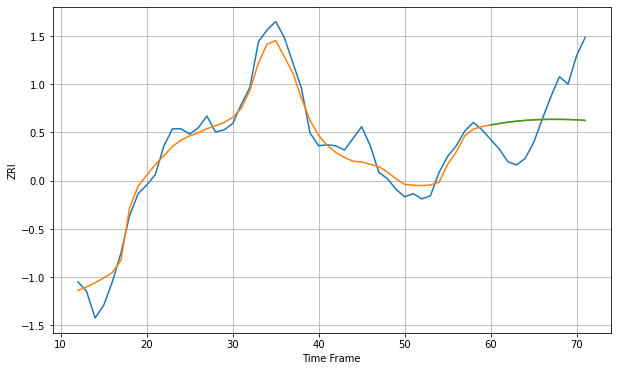

Wall time: 7.51 s
11221 12.481489071184358 39.289406430402636 39.259572793949815 [2448.61254222 2449.97377866 2451.18811567 2452.15142933 2452.91481725
 2453.41051132 2453.76702625 2453.92757445 2453.89590375 2453.7721671
 2453.48090461 2452.94902044]

Got an mse at 0.0100 in round 115 and stopped training

60 60 12


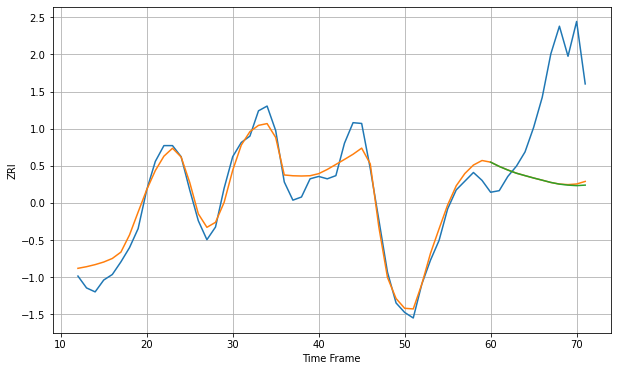

Wall time: 6.81 s
11222 16.274396891472314 118.53270559762959 119.32616536706144 [2753.0551341  2747.6880967  2743.12677507 2739.10282342 2736.02581922
 2733.04196242 2730.27467929 2727.41067964 2725.27769194 2724.02982173
 2723.36627129 2724.02405873]

Got an mse at 0.0099 in round 69 and stopped training

60 60 12


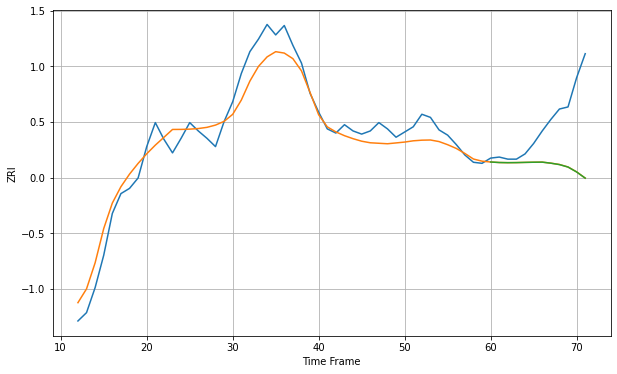

Wall time: 5.75 s
11223 15.29082602479767 51.27277792168635 51.31518401907389 [2003.25987287 2002.77162112 2002.62596784 2002.69488721 2002.89142962
 2003.04794841 2003.13371059 2002.13138807 2000.78883807 1998.43193778
 1993.72028783 1987.80936269]

Got an mse at 0.0100 in round 46 and stopped training

60 60 12


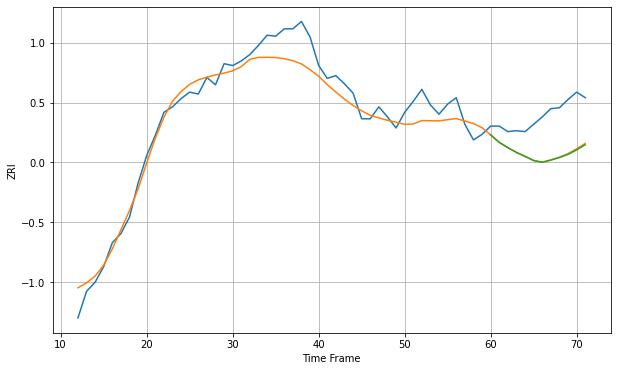

Wall time: 5.27 s
11224 16.999839768324083 42.586586777621925 43.06219537906527 [2100.42331216 2092.34102767 2086.56462222 2081.3610108  2077.08012918
 2072.5048998  2070.62325289 2072.92027842 2075.74288902 2079.18584315
 2084.02405405 2089.70860057]

Got an mse at 0.0099 in round 113 and stopped training

60 60 12


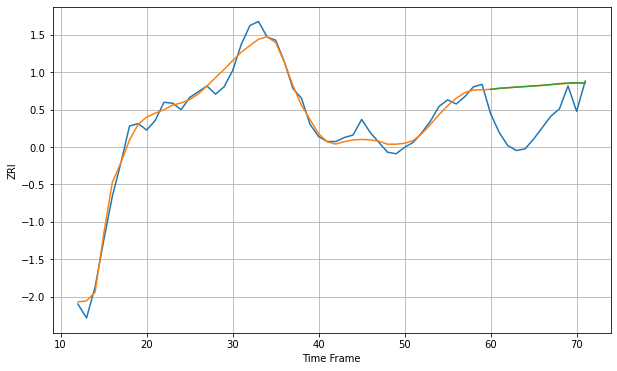

Wall time: 6.75 s
11225 10.480882076930898 50.987999823310844 51.10646626234783 [2306.90840464 2308.14438253 2308.86710452 2309.6759493  2310.36448195
 2311.10014242 2311.84639342 2312.83883655 2313.8898479  2314.58387986
 2314.95302994 2314.58821373]

Got an mse at 0.0097 in round 56 and stopped training

60 60 12


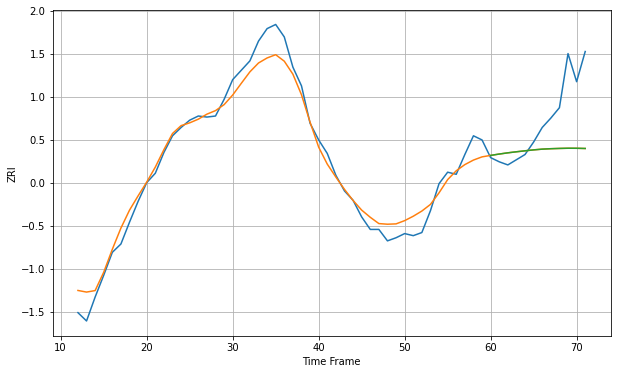

Wall time: 5.66 s
11226 12.789219462641478 44.92578613243847 44.91688939756615 [2027.14488316 2028.44796855 2029.62223588 2030.63407914 2031.5630144
 2032.45928184 2033.1615355  2033.58627466 2033.84872414 2034.03681516
 2034.0048014  2033.80439944]

Got an mse at 0.0100 in round 60 and stopped training

60 60 12


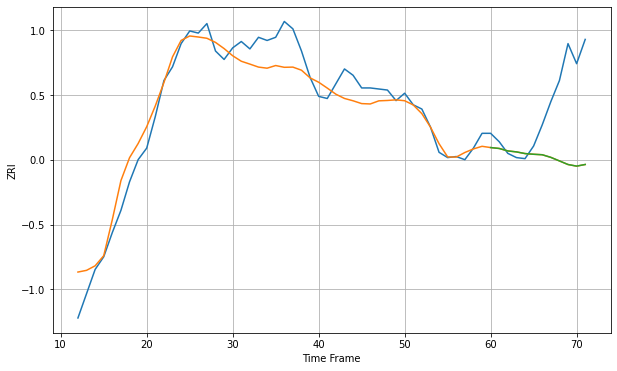

Wall time: 5.71 s
11228 17.211220394817026 62.148719776579284 62.13592937688122 [2097.4970015  2096.63198363 2094.30582071 2093.39754442 2091.80534485
 2091.13991726 2090.69784096 2088.2141636  2084.83775684 2081.43244516
 2079.92016175 2081.46723715]

Got an mse at 0.0100 in round 107 and stopped training

60 60 12


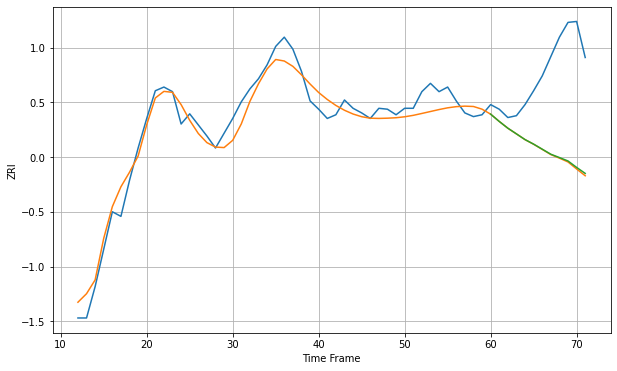

Wall time: 6.84 s
11229 14.66348368530709 93.56976348760227 92.75662247575941 [2066.6563265  2058.78169196 2051.4602099  2045.31188986 2039.11929899
 2034.20153407 2028.74651399 2023.28365241 2019.66878802 2015.95657607
 2009.00203488 2002.51013491]

Got an mse at 0.0096 in round 54 and stopped training

60 60 12


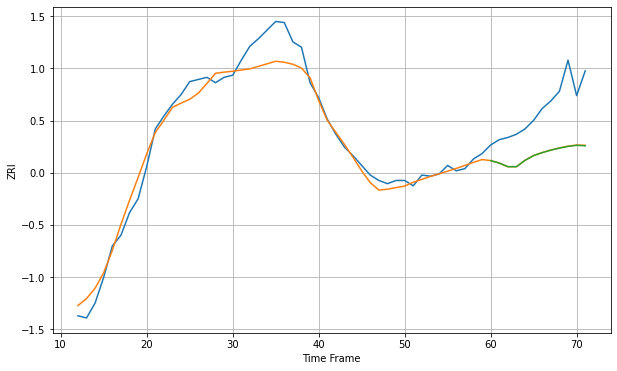

Wall time: 5.43 s
11230 13.082267103948347 44.85434414642906 44.997245053175696 [1955.4870248  1953.20224125 1949.85948112 1949.81310654 1955.71880388
 1960.17307061 1962.87564282 1965.21367689 1967.13305266 1968.73531996
 1969.72013178 1969.27450503]
60 60 12


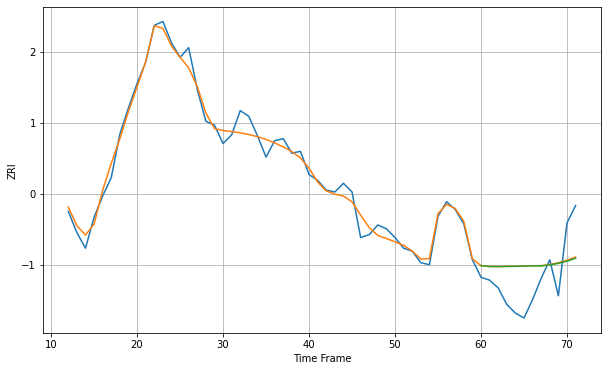

Wall time: 15.4 s
11231 9.09701024243539 34.69898191754831 34.888716493193094 [2718.01073838 2717.15760788 2717.07855801 2717.23180523 2717.34571347
 2717.6128344  2717.83046727 2717.75116612 2718.79055821 2720.36470157
 2722.59789147 2725.6390578 ]

Got an mse at 0.0100 in round 102 and stopped training

60 60 12


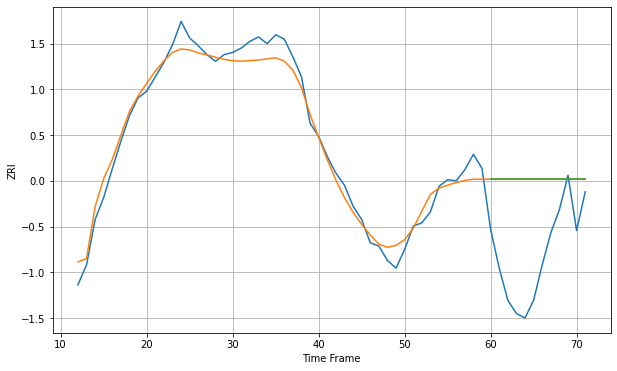

Wall time: 6.5 s
11232 11.353460556639956 78.71082515209721 78.71082515209721 [2132.42478754 2132.42478754 2132.42478754 2132.42478754 2132.42478754
 2132.42478754 2132.42478754 2132.42478754 2132.42478754 2132.42478754
 2132.42478754 2132.42478754]

Got an mse at 0.0097 in round 41 and stopped training

60 60 12


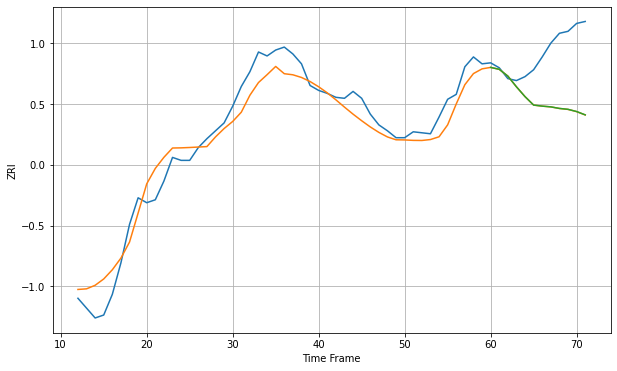

Wall time: 5.14 s
11233 17.39735080211039 55.967263984103845 55.919435330199995 [2308.37321171 2306.42538937 2299.56148849 2288.6957089  2278.69094425
 2270.13199447 2269.05653375 2268.30967471 2266.7273778  2265.81246649
 2263.57015695 2260.18664476]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


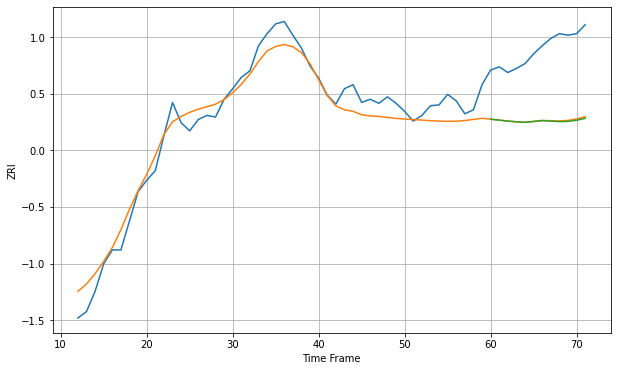

Wall time: 5.49 s
11234 18.610784738081847 88.3053822148528 88.97396348251472 [2037.42394673 2036.20801565 2035.05876474 2034.1296171  2033.44192641
 2034.55625524 2035.60318907 2035.00211248 2034.38965499 2034.6477848
 2036.03697349 2038.45723908]

Got an mse at 0.0099 in round 95 and stopped training

60 60 12


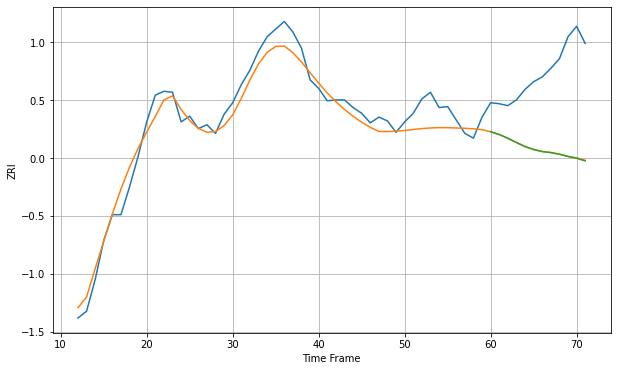

Wall time: 6.33 s
11235 14.559838875164171 85.12412021204838 85.29490795703886 [2081.69818738 2078.7934073  2074.92054559 2070.4291979  2066.22923299
 2063.09452194 2060.95079962 2059.94069778 2058.21175186 2055.8297296
 2053.95993139 2051.22938295]

Got an mse at 0.0100 in round 114 and stopped training

60 60 12


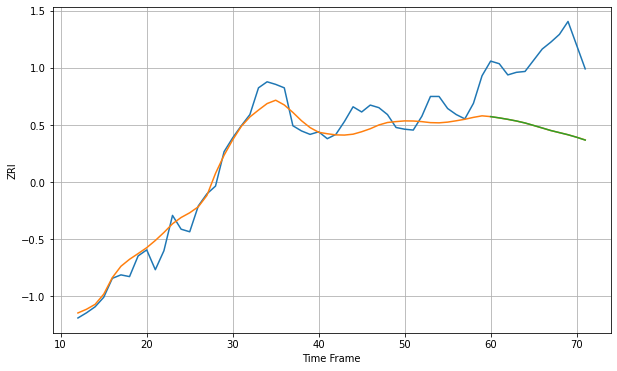

Wall time: 6.77 s
11236 16.84220408222379 86.90275818422029 86.8977131186741 [2075.60979816 2074.14289227 2072.45632059 2070.54413535 2068.24854387
 2065.37585132 2062.44998007 2059.48179221 2057.03924612 2054.58380004
 2051.67515449 2048.39270729]
60 60 12


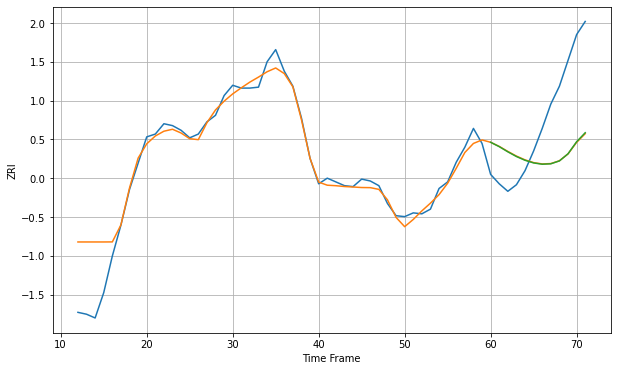

Wall time: 15.4 s
11237 21.953226511905232 67.69442171341893 67.42508246251212 [2451.23407563 2446.60518414 2441.0764179  2436.06203922 2432.06814465
 2429.22705158 2427.86210771 2428.31863712 2431.40018734 2438.95049415
 2451.82176541 2461.42244369]

Got an mse at 0.0099 in round 260 and stopped training

60 60 12


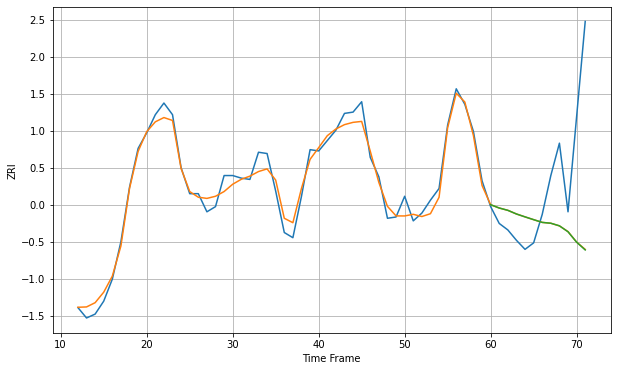

Wall time: 10 s
11238 7.286112574033838 63.13013159878176 63.22936734374237 [2704.47275191 2701.92201823 2700.13851725 2697.31719961 2695.08306539
 2692.92815445 2690.81669491 2690.17229238 2688.17276713 2683.57331609
 2675.56487044 2669.54672534]

Got an mse at 0.0098 in round 48 and stopped training

60 60 12


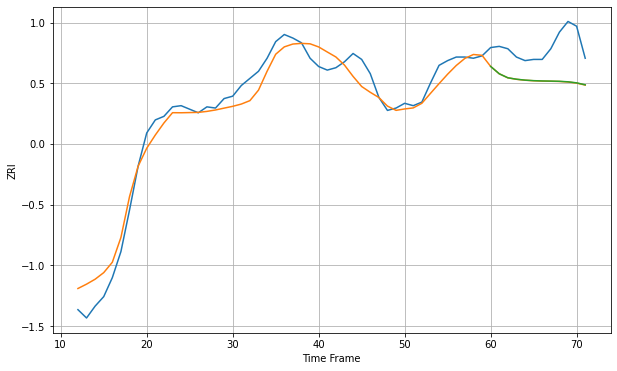

Wall time: 5.34 s
11354 11.841810610379348 29.678054433562504 29.564949612322856 [2108.09495713 2101.90746738 2098.52312138 2097.31408682 2096.54019321
 2096.09660921 2095.83838355 2095.71710856 2095.54837588 2095.12697513
 2094.24872348 2092.58627146]

Got an mse at 0.0100 in round 100 and stopped training

60 60 12


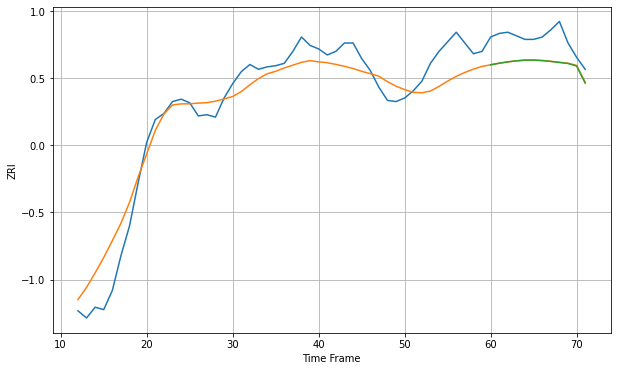

Wall time: 6.46 s
11355 17.76684543136015 21.41626148151079 21.52339922163483 [2163.76808088 2165.06958656 2166.19237384 2167.07138306 2167.65225052
 2167.68554228 2167.27445513 2166.57307793 2165.71522977 2164.86983882
 2162.73275388 2148.40290039]

Got an mse at 0.0099 in round 40 and stopped training

60 60 12


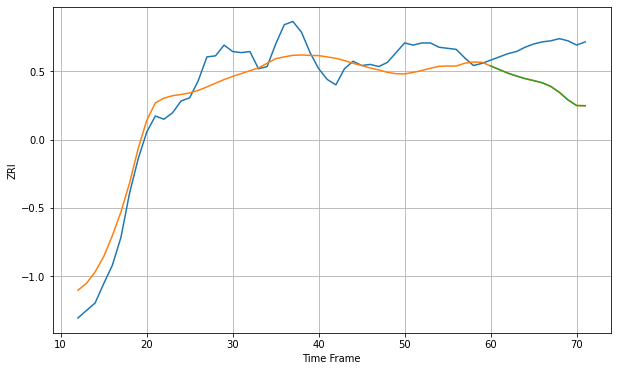

Wall time: 5.14 s
11356 18.741162612455494 39.21734959785017 39.292658466449154 [2196.60738816 2193.21615199 2189.95139117 2187.23247092 2184.84123871
 2182.96571931 2180.91172665 2177.44675725 2171.90235276 2164.89552022
 2159.7544745  2159.54408047]

Got an mse at 0.0100 in round 42 and stopped training

60 60 12


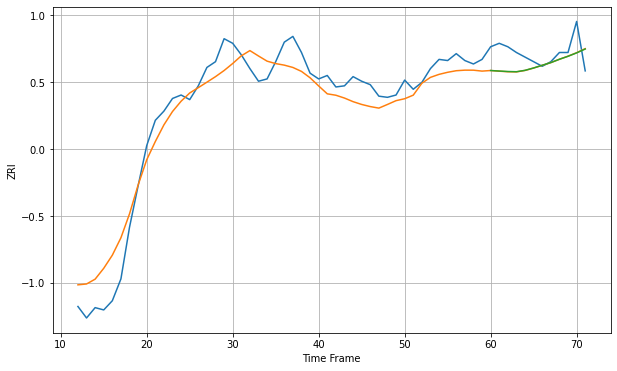

Wall time: 5.26 s
11357 16.889502980427427 16.074153308121826 16.004066405006387 [2212.3221946  2211.8636343  2211.45611645 2211.27275015 2212.4768275
 2214.53888823 2216.89353054 2219.21036967 2222.1048672  2224.71457507
 2227.65126911 2231.02517435]

Got an mse at 0.0096 in round 41 and stopped training

60 60 12


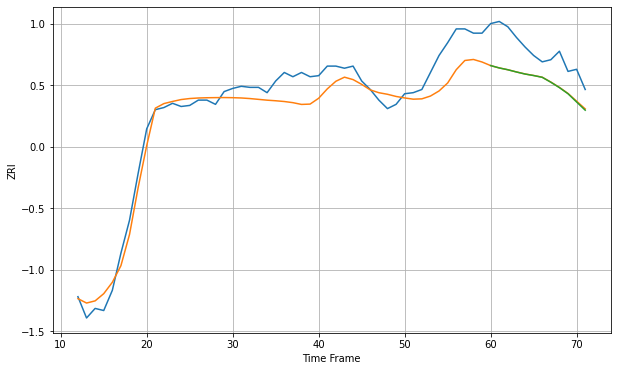

Wall time: 5.13 s
11358 16.928897037116652 29.77001692717034 29.96314602328029 [2179.48639319 2177.27294983 2175.56462968 2173.46858687 2171.5389535
 2170.11428737 2168.45403406 2163.82522348 2158.75173472 2152.98303658
 2145.21932725 2137.51175161]

Got an mse at 0.0099 in round 67 and stopped training

60 60 12


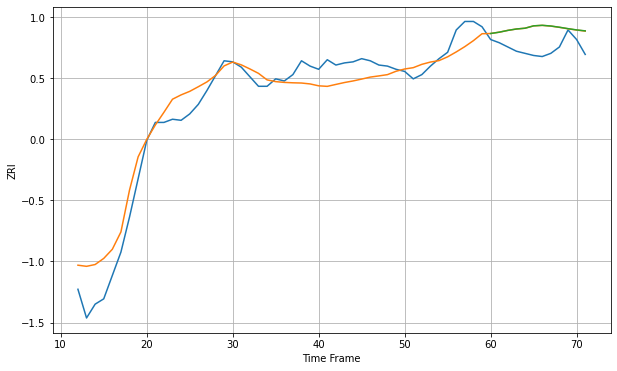

Wall time: 5.83 s
11360 17.596556527929277 19.50872931592347 19.563487131341716 [2279.67158388 2280.91660298 2282.60093376 2283.91171819 2284.65564768
 2286.88768567 2287.37901492 2286.72576101 2285.57118889 2284.24476308
 2283.05737257 2282.15483939]

Got an mse at 0.0097 in round 35 and stopped training

60 60 12


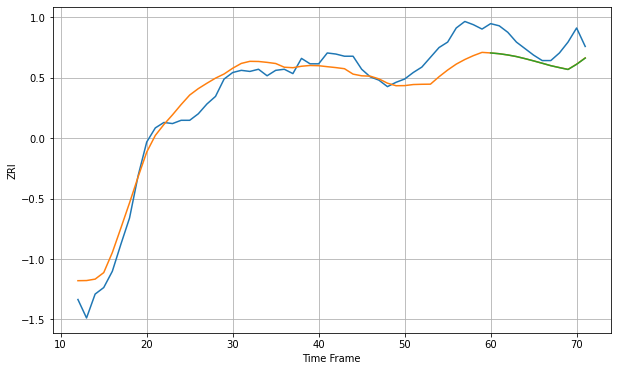

Wall time: 5.02 s
11361 15.81489734919485 18.652444101599283 18.693061661612084 [2182.02108865 2181.29698394 2180.15669886 2178.68215601 2176.77156101
 2174.70103378 2172.52472528 2170.277467   2168.50470686 2166.79650245
 2171.54372209 2177.2987104 ]

Got an mse at 0.0100 in round 83 and stopped training

60 60 12


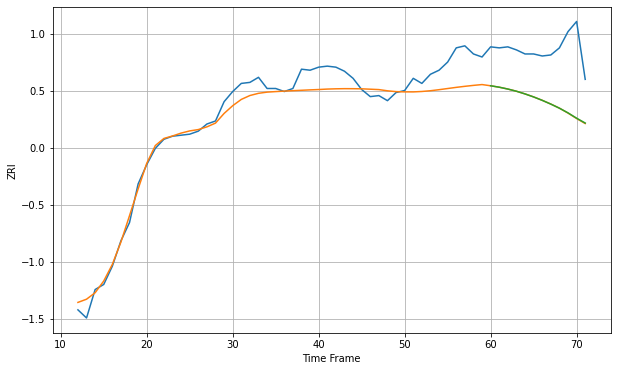

Wall time: 6.07 s
11364 14.959194759377356 53.94959028586917 53.85272190912362 [2213.66359804 2212.26087648 2210.44465944 2208.28357194 2205.64032519
 2202.67004803 2199.32031388 2195.62247092 2191.58299762 2186.99714776
 2181.73539608 2176.97879357]

Got an mse at 0.0098 in round 26 and stopped training

60 60 12


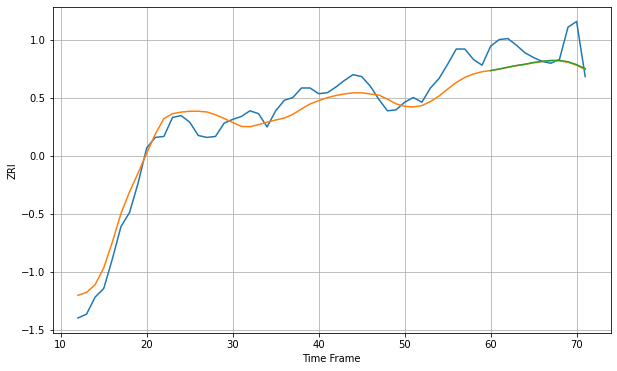

Wall time: 4.81 s
11365 16.101636554619493 23.677563228376968 23.490175766157122 [2214.31604187 2215.96667983 2217.86359147 2219.66169997 2221.02459708
 2222.84266701 2224.16692161 2225.01784435 2225.04400952 2223.60559708
 2220.58514929 2216.25122443]

Got an mse at 0.0098 in round 38 and stopped training

60 60 12


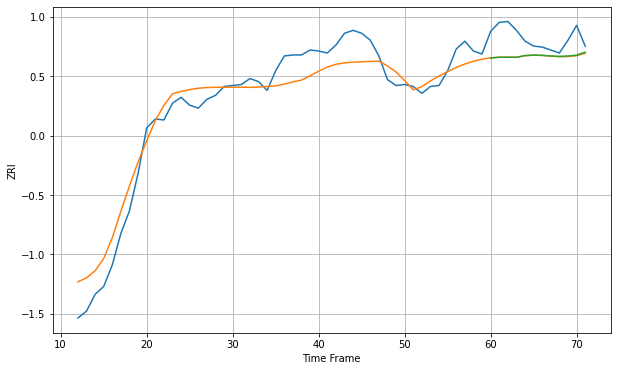

Wall time: 5.07 s
11366 18.512876815635188 21.886219075727055 21.728554626390068 [2200.02485808 2200.67375911 2200.69275213 2200.64134385 2202.36292049
 2202.85163247 2202.631688   2201.94363112 2201.55168751 2201.89932722
 2202.84112767 2205.84191067]
60 60 12


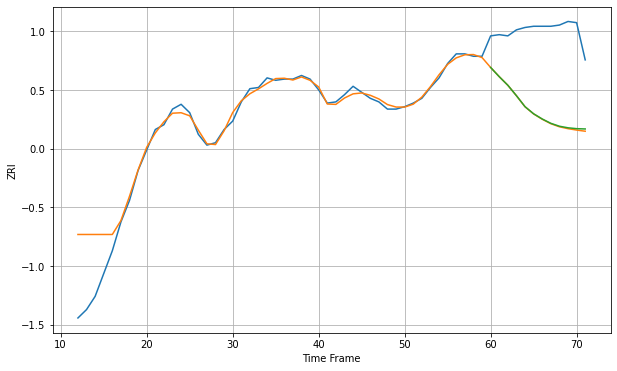

Wall time: 15.4 s
11367 16.444726650406288 68.06891227213981 67.60151000555706 [2052.67963043 2045.01908311 2037.87095133 2029.18689862 2020.00976827
 2014.09773774 2009.76461482 2006.15444218 2003.72925113 2002.41898172
 2001.70241256 2001.45272031]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


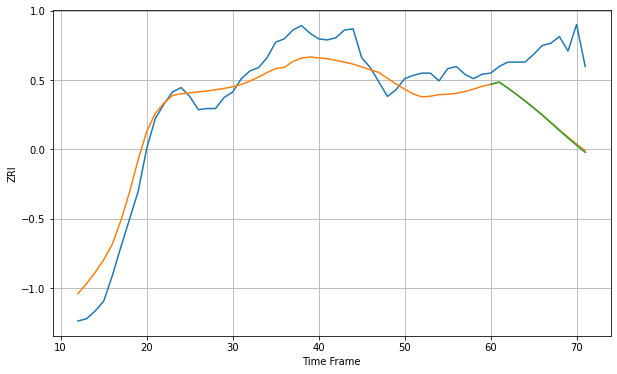

Wall time: 5.38 s
11368 19.50273064501821 61.220090691985384 61.73203688320998 [2202.87647752 2204.89148753 2199.52606365 2193.84009829 2187.85420998
 2181.58488326 2175.1475022  2168.17714876 2161.16435193 2154.34445319
 2147.78633485 2141.3620213 ]

Got an mse at 0.0099 in round 51 and stopped training

60 60 12


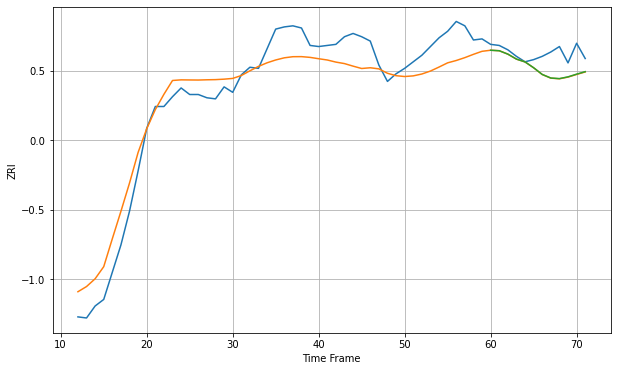

Wall time: 5.34 s
11369 20.056700667513336 15.81137364870178 15.685670672232076 [2239.60219532 2239.14812684 2236.04887331 2231.48176582 2228.91863465
 2223.55140122 2217.40750864 2214.12269616 2213.5822486  2215.19677402
 2217.66978511 2219.95836895]

Got an mse at 0.0100 in round 53 and stopped training

60 60 12


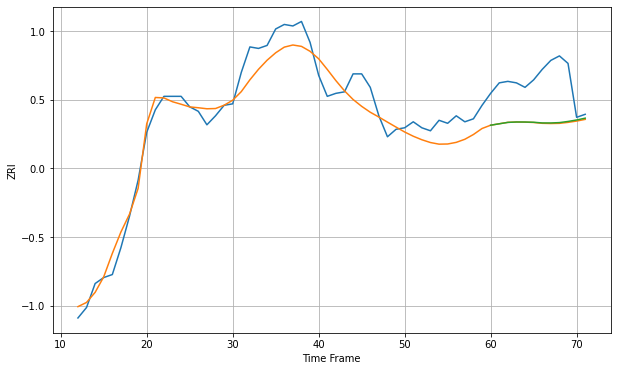

Wall time: 5.41 s
11370 10.950475798262723 29.789853926620893 29.568203035829505 [2140.71716124 2141.67114926 2142.60342089 2142.86168634 2142.84623824
 2142.69063063 2142.24277857 2142.22352397 2142.46364259 2143.23039021
 2144.21074225 2145.4322883 ]

Got an mse at 0.0099 in round 73 and stopped training

60 60 12


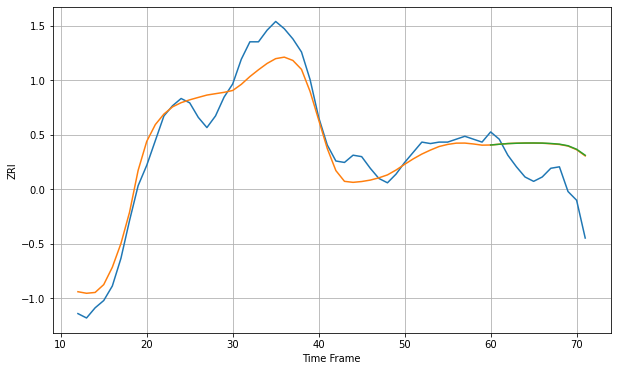

Wall time: 5.95 s
11372 11.977085151265875 25.98537082872159 26.146711451230427 [1981.00998802 1981.51477119 1981.96967186 1982.20588593 1982.34604272
 1982.38341906 1982.33039902 1982.04366943 1981.58350316 1980.4905961
 1978.07668442 1973.95523673]

Got an mse at 0.0099 in round 68 and stopped training

60 60 12


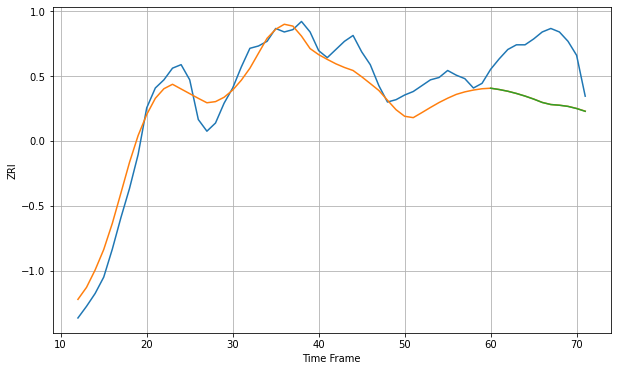

Wall time: 5.74 s
11373 15.831350043850021 46.285563213988446 46.30754691851403 [2145.82278356 2144.6931563  2143.22284069 2141.32029544 2139.08792431
 2136.53234885 2133.62435433 2131.8426506  2131.23890454 2130.2413265
 2128.41339087 2126.05011284]

Got an mse at 0.0098 in round 84 and stopped training

60 60 12


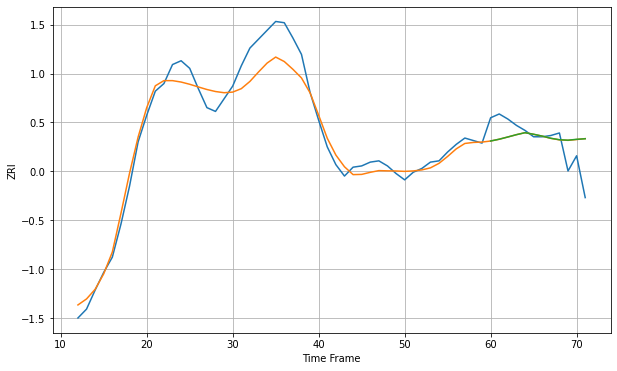

Wall time: 6.13 s
11374 12.156227209981783 18.13377308600279 18.13326374676493 [1998.6557423  2000.07435719 2001.83213504 2003.66382011 2005.22566531
 2003.99143499 2002.52360737 2000.81491235 1999.66772941 1999.31028258
 1999.99810815 2000.4451878 ]

Got an mse at 0.0100 in round 66 and stopped training

60 60 12


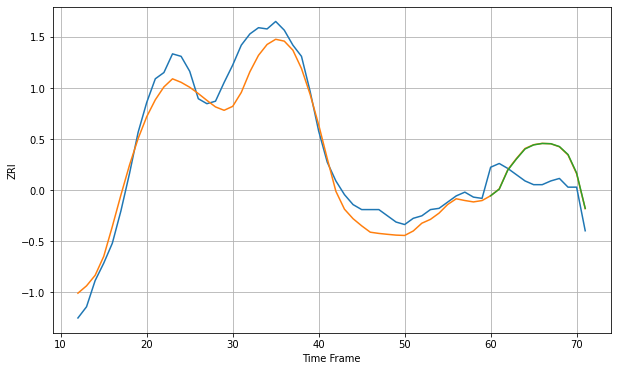

Wall time: 5.71 s
11375 14.191548048426586 23.367173764319343 23.392343648343118 [1985.10648348 1990.39444648 2005.72233359 2014.61051265 2022.64618811
 2025.92518265 2027.07348637 2026.87257585 2024.58264979 2018.20599644
 2003.36485917 1974.9862369 ]

Got an mse at 0.0099 in round 58 and stopped training

60 60 12


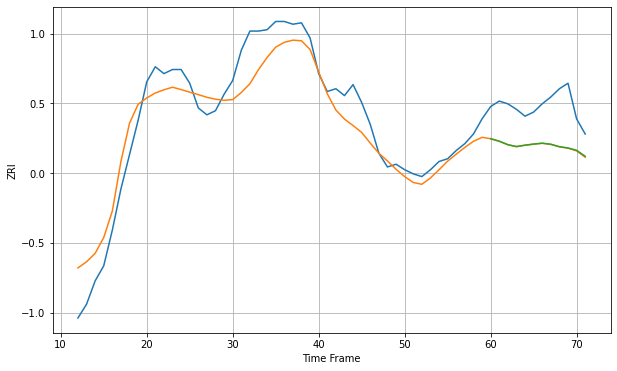

Wall time: 5.5 s
11377 16.49623818816388 30.140228842247446 30.022502985295116 [2118.58185825 2116.77798184 2114.23208209 2112.86042888 2113.87630279
 2114.68812852 2115.30709076 2114.57102269 2112.77112075 2111.83579521
 2110.14058084 2105.79499134]

Got an mse at 0.0099 in round 36 and stopped training

60 60 12


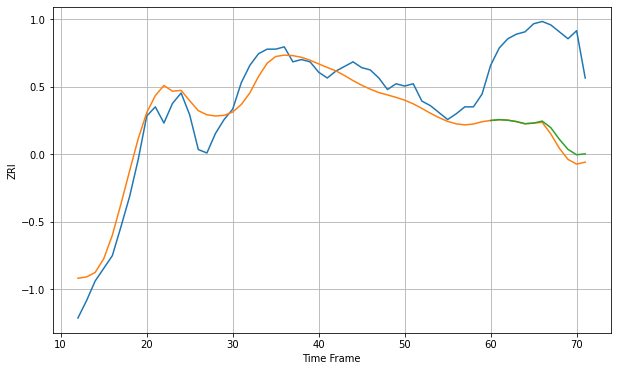

Wall time: 5.02 s
11378 15.624986676850135 85.16265773161926 81.5304475387823 [2113.17871105 2113.88552479 2113.43974092 2112.22740559 2110.38485083
 2110.86291437 2112.68191356 2106.92284316 2096.82429586 2088.13389718
 2083.46443168 2084.2610831 ]

Got an mse at 0.0100 in round 51 and stopped training

60 60 12


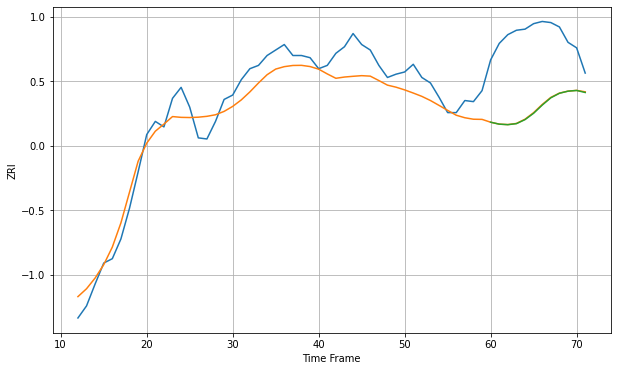

Wall time: 5.39 s
11379 16.601296150574658 66.80430296335716 67.06009218025702 [2091.26253068 2089.49086453 2089.01390139 2089.94575601 2093.61612996
 2099.40666213 2106.8366205  2113.46986732 2117.60603496 2119.53555841
 2120.17770718 2118.32258328]

Got an mse at 0.0099 in round 69 and stopped training

60 60 12


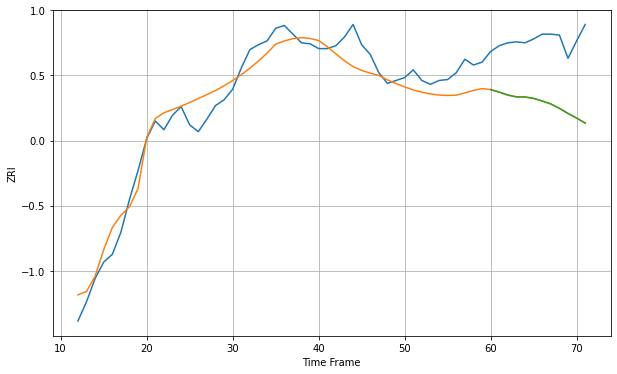

Wall time: 5.76 s
11385 17.935090904049023 66.31863522753765 66.37646168247412 [2132.58801053 2129.96396616 2126.91618075 2125.03006427 2124.92667318
 2123.43929154 2120.76048017 2117.69994773 2113.09992752 2107.82799407
 2102.98960319 2097.76425719]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


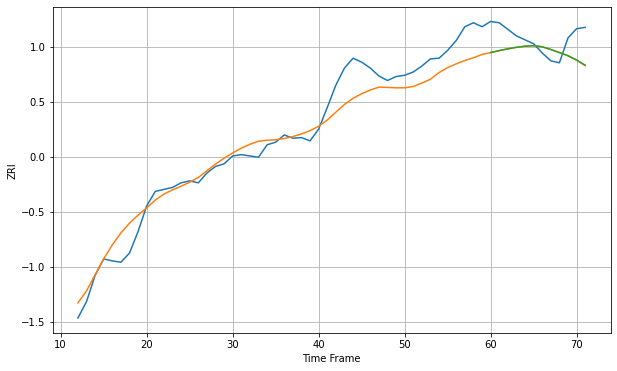

Wall time: 5.37 s
11412 26.299914045706945 32.15688788737224 32.03266578331446 [2167.61509605 2170.59171638 2173.26431158 2175.56796428 2177.29447813
 2178.11486466 2176.36061619 2172.29175981 2167.61665906 2162.79118437
 2156.22042162 2148.33730498]

Got an mse at 0.0100 in round 52 and stopped training

60 60 12


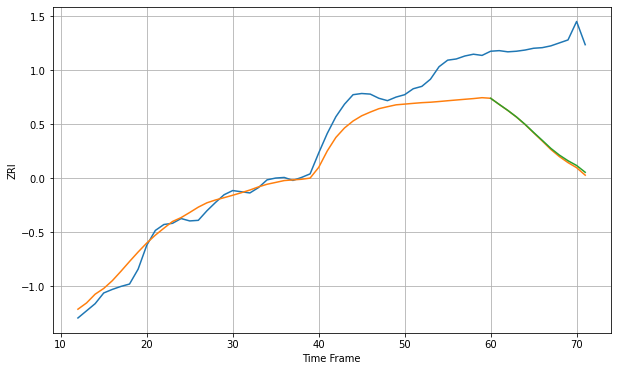

Wall time: 5.38 s
11413 30.972021204185943 161.82385814158857 159.87972714273116 [2161.9880764  2151.6844473  2141.6271448  2130.69530169 2118.29425734
 2104.62749268 2091.42345868 2077.90111952 2066.52923754 2057.07811841
 2049.10776056 2037.70107141]

Got an mse at 0.0100 in round 50 and stopped training

60 60 12


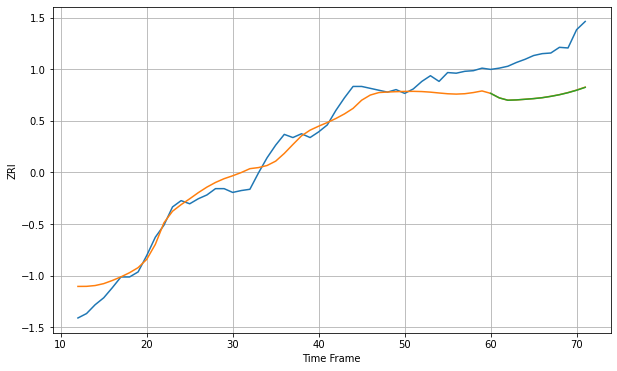

Wall time: 5.39 s
11414 21.21128269833392 70.09114944851322 70.21606448418163 [2154.04939648 2146.90520199 2143.16241617 2143.64669711 2144.64138651
 2145.69226018 2147.12839156 2149.27743811 2151.86391311 2155.11249712
 2158.98855028 2163.5475288 ]

Got an mse at 0.0097 in round 59 and stopped training

60 60 12


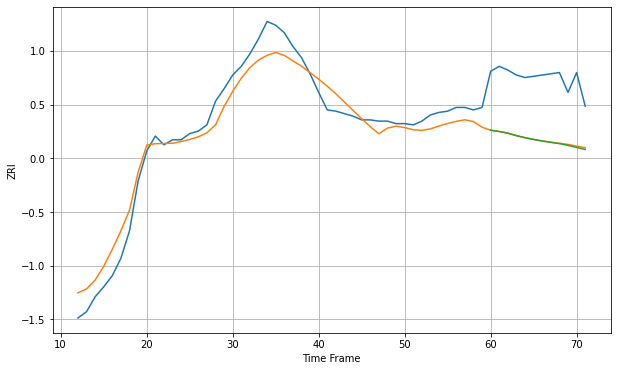

Wall time: 5.63 s
11415 12.504954597470608 50.12714046449234 50.44633724616124 [1902.6982886  1901.69110172 1900.30870812 1898.32530557 1896.68696997
 1895.27511526 1894.0264226  1892.93651203 1891.94061533 1890.54032651
 1888.88377444 1887.24972851]

Got an mse at 0.0091 in round 23 and stopped training

60 60 12


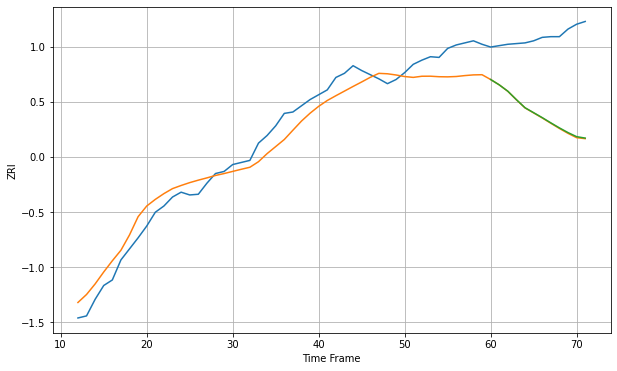

Wall time: 4.75 s
11416 24.61484646039461 116.12351898049769 115.48461854050491 [2127.02438027 2119.29335529 2110.07734377 2097.84357633 2086.17624832
 2079.03842537 2071.87940722 2064.33009134 2057.01876052 2050.22966303
 2044.3463906  2042.25676587]

Got an mse at 0.0098 in round 47 and stopped training

60 60 12


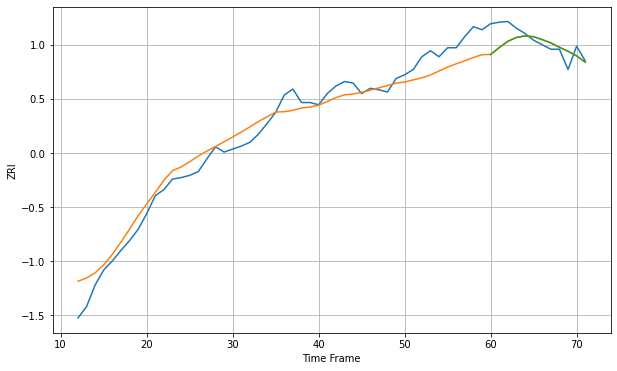

Wall time: 5.27 s
11417 19.29768876651723 19.539706369978866 19.562557767127473 [2083.02199042 2092.1800247  2100.50404095 2105.66307619 2107.72376075
 2106.69601608 2102.80476695 2098.47504691 2092.61616401 2087.33341316
 2081.25236786 2072.85032012]

Got an mse at 0.0099 in round 76 and stopped training

60 60 12


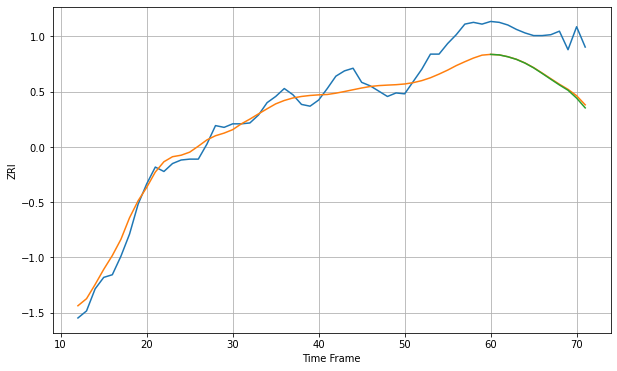

Wall time: 5.92 s
11418 16.650258752346932 48.28459021807104 49.34020349677141 [2043.69599431 2043.11218764 2041.00646747 2038.0404882  2033.80323469
 2028.43309395 2022.07602215 2015.52002567 2009.05117805 2003.05790861
 1994.14462408 1983.06447742]

Got an mse at 0.0097 in round 34 and stopped training

60 60 12


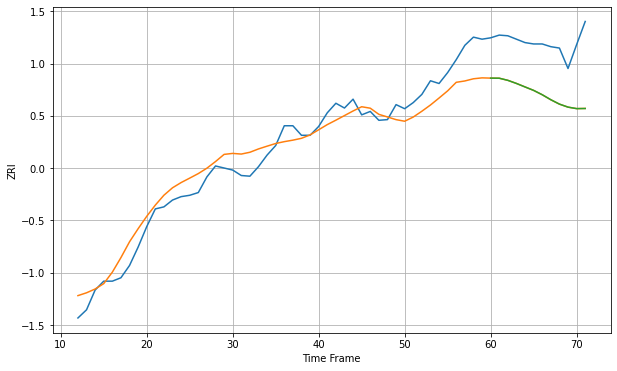

Wall time: 5 s
11419 24.759894230925905 77.21169799372714 77.21629425561832 [2124.88424573 2124.7466029  2121.62344185 2117.05899196 2111.9242534
 2106.8859644  2100.5348     2093.19216757 2086.76835794 2082.34824989
 2080.14389571 2080.30016383]

Got an mse at 0.0098 in round 25 and stopped training

60 60 12


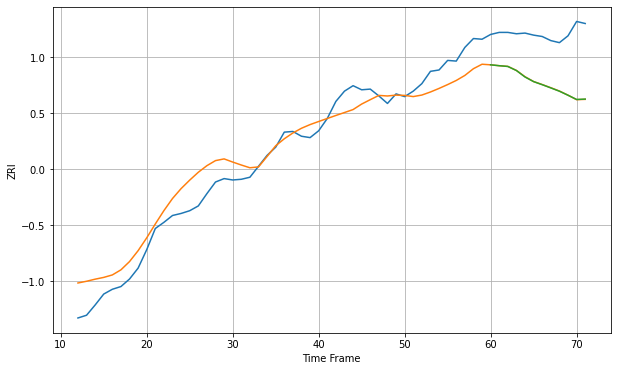

Wall time: 4.81 s
11420 26.8124004373257 74.22220491027919 74.25653905087415 [2136.53205465 2135.22957446 2134.15194996 2128.16336103 2118.71122211
 2111.9482276  2107.4679159  2102.74801264 2097.90479087 2092.01947593
 2085.79731678 2086.40098449]

Got an mse at 0.0099 in round 57 and stopped training

60 60 12


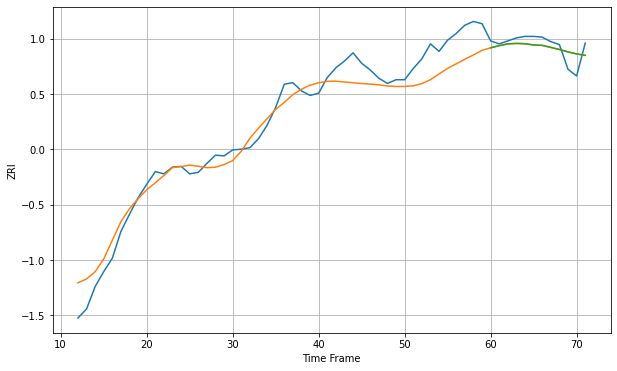

Wall time: 5.5 s
11421 23.057976868729423 13.826021025250883 13.825007430270372 [2123.74751991 2126.58623216 2128.98944353 2129.58708273 2129.21778479
 2127.56537958 2126.96860523 2124.27516391 2121.46071305 2118.26062672
 2115.50909427 2113.60833502]

Got an mse at 0.0098 in round 54 and stopped training

60 60 12


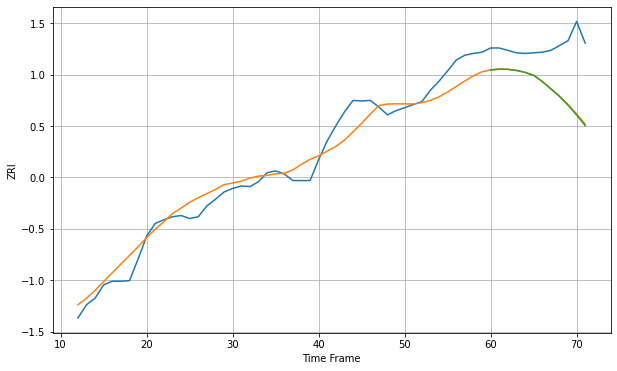

Wall time: 5.7 s
11422 23.61004855524148 77.94559410839452 78.85176202748264 [2192.59500557 2193.93520981 2193.54462794 2191.70880994 2188.53097871
 2183.53273551 2173.37573972 2161.11421267 2148.61823791 2134.16960879
 2117.72319928 2100.15987322]

Got an mse at 0.0098 in round 46 and stopped training

60 60 12


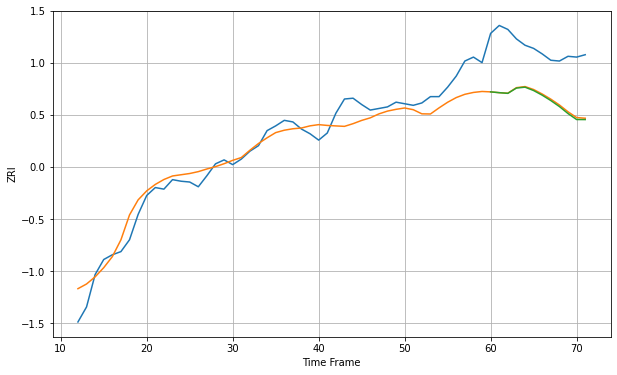

Wall time: 5.55 s
11423 18.512055848675345 66.92104085919831 68.06728526057886 [2032.00534759 2031.00145684 2030.13923357 2036.83954838 2037.96197733
 2033.69628566 2027.81309078 2021.0292843  2013.44566145 2004.59257309
 1997.03057812 1996.97436047]

Got an mse at 0.0098 in round 130 and stopped training

60 60 12


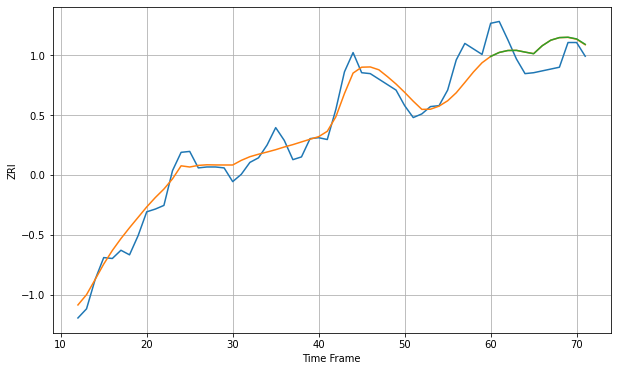

Wall time: 7.53 s
11426 15.159456268993521 23.577996936259233 23.60787004777714 [2127.7762141  2132.12377895 2134.25078376 2134.41785002 2132.54806811
 2130.763953   2139.44760774 2145.54135102 2148.3903592  2148.78317689
 2146.92767844 2141.02263135]

Got an mse at 0.0100 in round 105 and stopped training

60 60 12


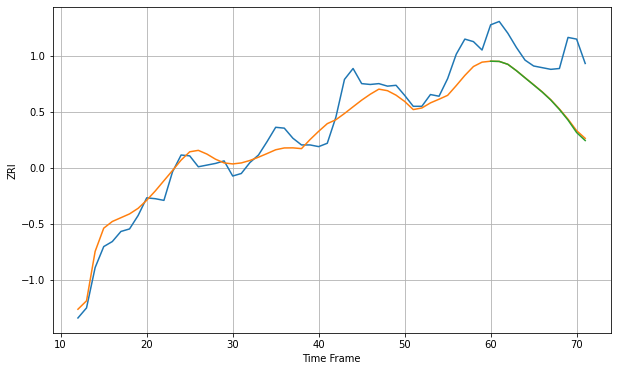

Wall time: 6.95 s
11427 18.187737687548562 58.431147059689685 59.33688577284356 [2135.67748985 2135.42318998 2131.97517639 2124.37161672 2115.878087
 2107.48955672 2098.94548652 2089.42008455 2078.21476675 2065.63610633
 2050.79559087 2041.24571459]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


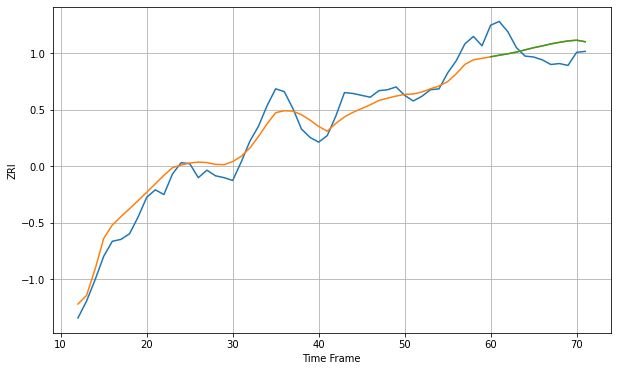

Wall time: 5.82 s
11428 14.57830231590756 21.113840748529896 21.09771414195845 [2047.2164438  2048.92132449 2050.43887024 2052.29602474 2054.63282189
 2056.94297755 2058.85175967 2061.00928798 2062.67474629 2064.18489176
 2064.92157851 2063.32028444]

Got an mse at 0.0099 in round 54 and stopped training

60 60 12


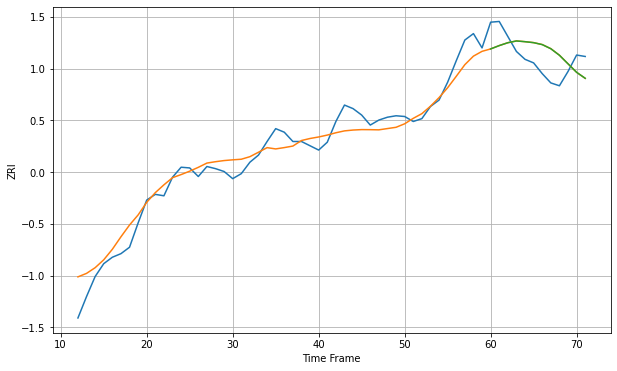

Wall time: 5.72 s
11429 18.735492872546306 31.19320724017282 31.14692803224374 [2121.55979888 2126.2254489  2130.2347338  2132.72529123 2131.68385139
 2130.32627214 2127.61470672 2121.84925197 2112.69127534 2100.70277254
 2088.8102324  2080.46468046]

Got an mse at 0.0097 in round 31 and stopped training

60 60 12


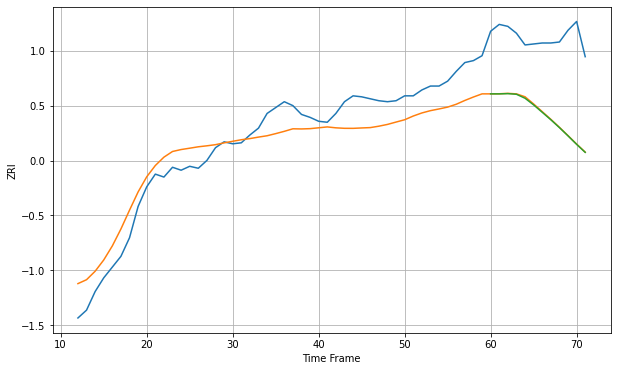

Wall time: 5.16 s
11432 23.024402014175894 81.44879536714822 81.83400994746513 [1952.01589125 1951.99995666 1952.25500284 1951.60902632 1947.54824757
 1940.74936332 1933.20332878 1925.58237316 1917.55827068 1909.10247034
 1900.44341957 1892.25458647]

Got an mse at 0.0100 in round 55 and stopped training

60 60 12


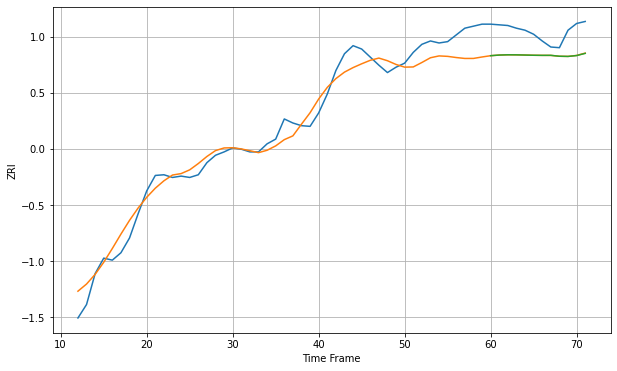

Wall time: 5.68 s
11433 21.12371062492318 37.410803278204554 37.48698075639971 [2161.0909739  2162.02733519 2162.42492445 2162.34510336 2162.0542975
 2161.73815639 2161.58079632 2161.62991046 2160.2811979  2159.99650449
 2161.28341817 2164.5132924 ]

Got an mse at 0.0099 in round 39 and stopped training

60 60 12


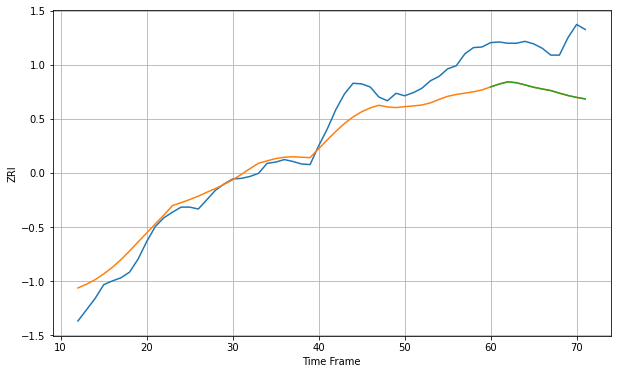

Wall time: 5.37 s
11434 29.957839888814483 77.86367348545328 77.76817538506174 [2124.23478703 2128.74583355 2132.30237937 2130.83247188 2127.37772443
 2123.68985582 2120.91894869 2118.37879121 2114.24624807 2110.44698506
 2107.45468186 2105.02907602]

Got an mse at 0.0098 in round 36 and stopped training

60 60 12


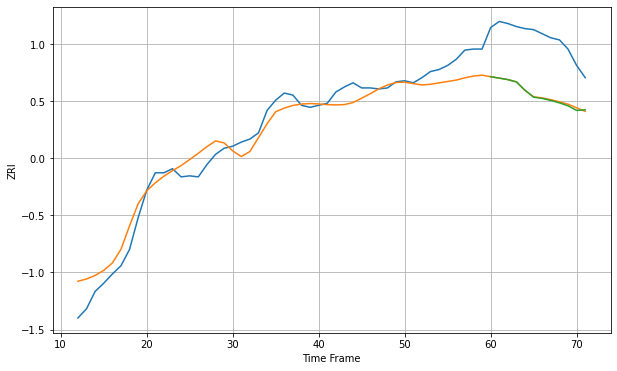

Wall time: 5.25 s
11435 14.631593215674776 54.96073041389108 55.42859428731626 [1963.98907937 1962.59558055 1961.14048709 1958.90728136 1950.68280438
 1943.93183706 1942.72962016 1940.74137989 1938.37732959 1935.52932822
 1930.99789332 1931.56431738]

Got an mse at 0.0099 in round 85 and stopped training

60 60 12


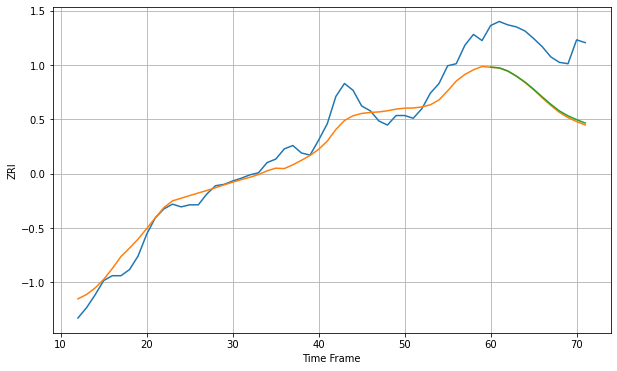

Wall time: 6.6 s
11436 22.45349147182523 82.06752478894416 80.66891423221409 [2078.91394279 2077.91431959 2073.32448767 2065.88414763 2057.03114838
 2046.70436406 2035.3374911  2024.55169372 2014.79896493 2007.5189851
 2001.95460498 1996.95811311]

Got an mse at 0.0098 in round 62 and stopped training

60 60 12


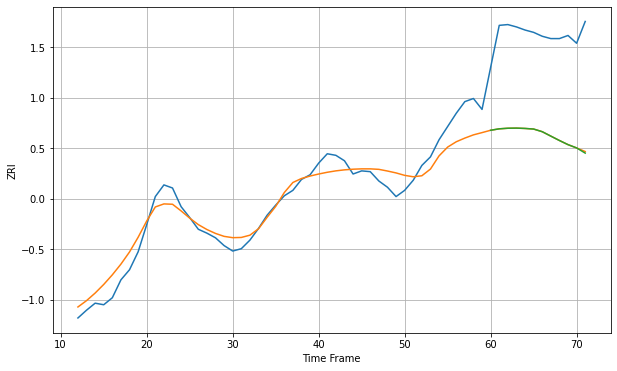

Wall time: 5.93 s
11542 18.818197006525505 130.3528251989658 130.56321989355348 [2319.18923708 2321.05000469 2321.80857965 2321.96880809 2321.5453326
 2320.76722624 2317.35276072 2311.67143836 2306.02956732 2300.72329333
 2296.52444848 2289.83066054]

Got an mse at 0.0099 in round 122 and stopped training

60 60 12


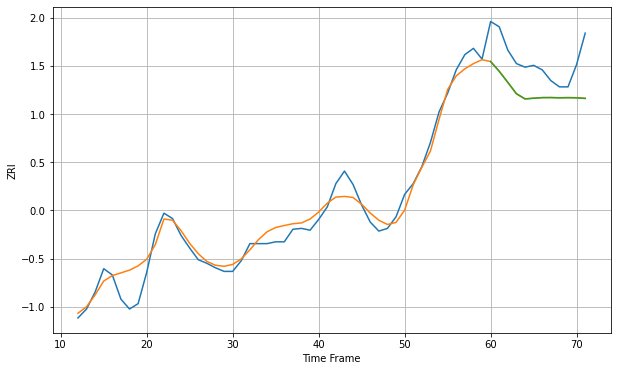

Wall time: 7.25 s
11550 13.804232074254676 38.48949908639552 38.54922735645446 [2243.25936686 2232.42562101 2220.02491225 2207.39958898 2201.58425233
 2202.27097272 2202.92084074 2202.96779668 2202.70310181 2202.86511301
 2202.675068   2202.0142341 ]

Got an mse at 0.0098 in round 50 and stopped training

60 60 12


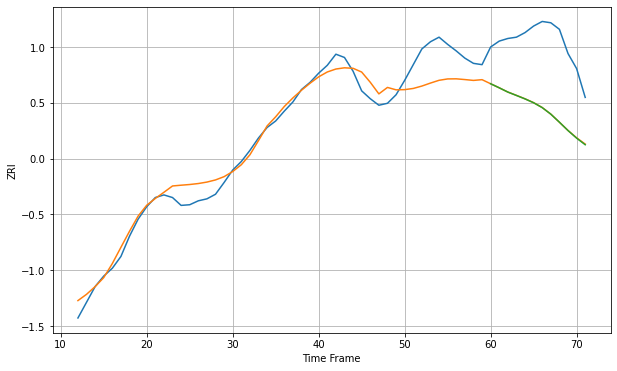

Wall time: 5.51 s
11561 24.505983005508423 105.58568158410067 105.75138612607712 [2442.83967554 2436.62905486 2430.14104087 2424.96992268 2419.6924743
 2413.80476399 2406.37102139 2396.37874634 2384.06731137 2371.34656989
 2359.75495292 2349.66894191]

Got an mse at 0.0098 in round 111 and stopped training

60 60 12


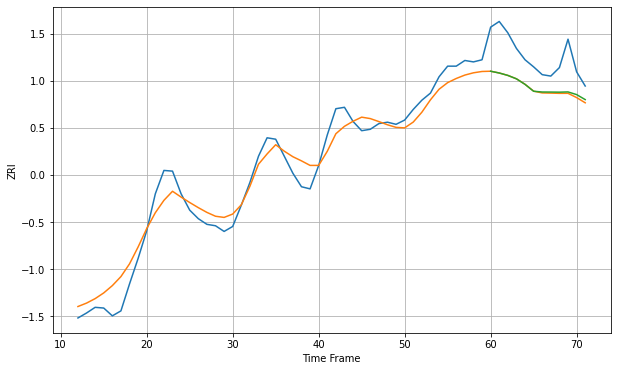

Wall time: 7.06 s
11563 20.863745209185907 47.609623169169176 46.72561363227097 [2274.85240062 2272.35337971 2268.94639262 2264.13569591 2256.33339175
 2246.60683453 2245.5485952  2245.46881859 2245.31414155 2245.66818617
 2241.90254733 2234.84293667]

Got an mse at 0.0100 in round 65 and stopped training

60 60 12


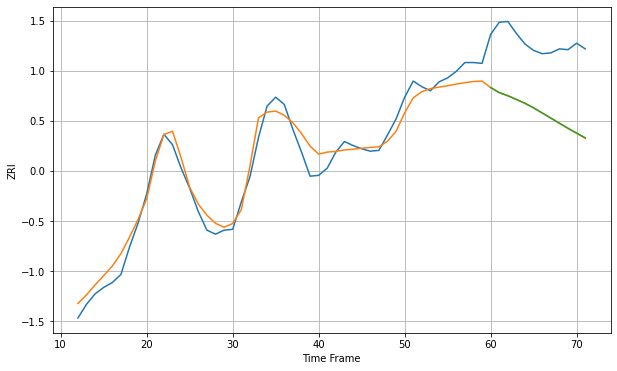

Wall time: 6.02 s
11580 15.200980158032504 87.83340956235986 87.67611746922272 [2177.9680946  2171.71339509 2167.81905322 2163.17902007 2158.41486083
 2152.77151514 2146.456604   2140.09914405 2133.73076728 2127.48813806
 2121.51353999 2115.63333557]

Got an mse at 0.0098 in round 59 and stopped training

60 60 12


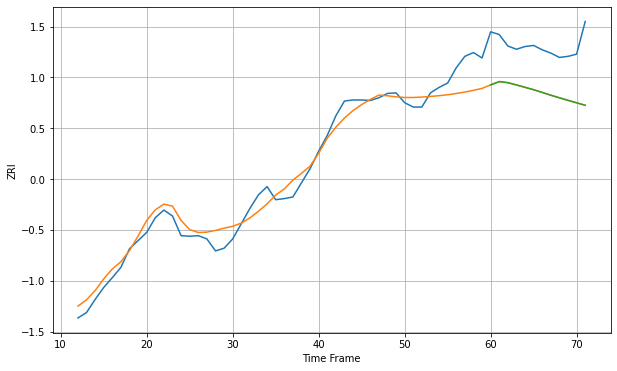

Wall time: 5.82 s
11590 24.721388986473883 88.35945134410689 88.32142617087871 [2512.60788637 2518.7202833  2516.70617789 2512.53889484 2508.18892388
 2503.77916942 2498.87410463 2493.7439535  2489.00009962 2484.37425777
 2479.8046707  2475.15888475]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


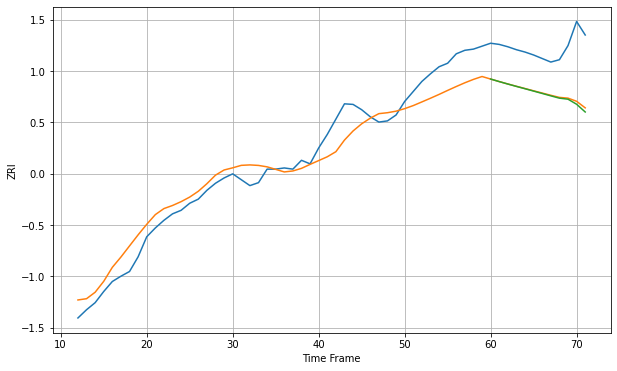

Wall time: 5.57 s
11691 30.18013671937749 79.36027021985686 81.44385206827364 [2152.11204732 2147.79191586 2143.63833967 2139.60235711 2135.65983469
 2131.63927902 2127.62366309 2123.55972632 2119.63851465 2117.8800062
 2109.25677335 2096.13197351]

Got an mse at 0.0099 in round 44 and stopped training

60 60 12


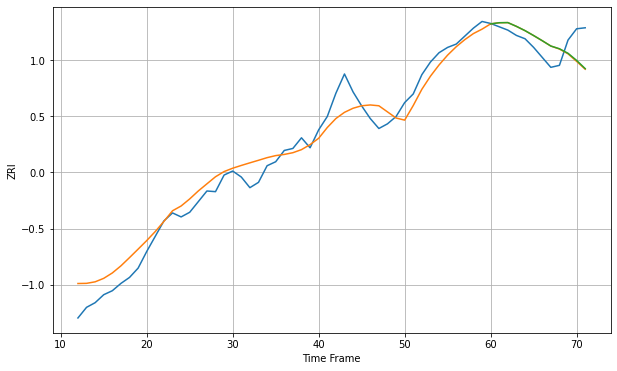

Wall time: 5.38 s
11692 22.571159119170677 28.556609462900948 28.178699090114954 [2207.37747859 2209.092605   2209.29677743 2203.6266176  2197.20549655
 2189.81584226 2182.09709108 2174.0540986  2169.96337344 2163.1600281
 2152.44093759 2140.05658524]

Got an mse at 0.0099 in round 63 and stopped training

60 60 12


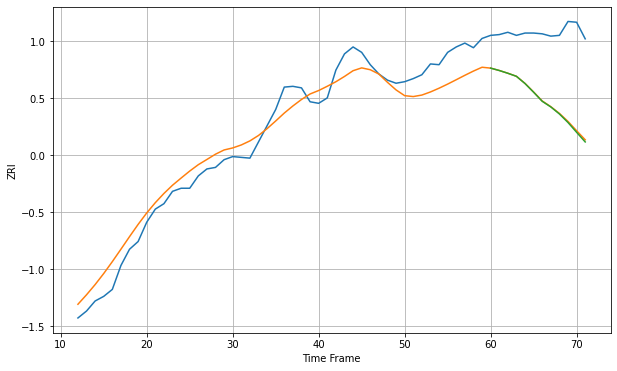

Wall time: 5.86 s
11694 22.462809330105912 91.01283907489727 91.94009934167325 [2116.58297211 2113.5002643  2109.92119961 2105.95403899 2096.59480954
 2085.34098938 2073.58559034 2066.29984381 2057.17678564 2046.12991062
 2033.4597425  2020.98667894]

Got an mse at 0.0100 in round 103 and stopped training

60 60 12


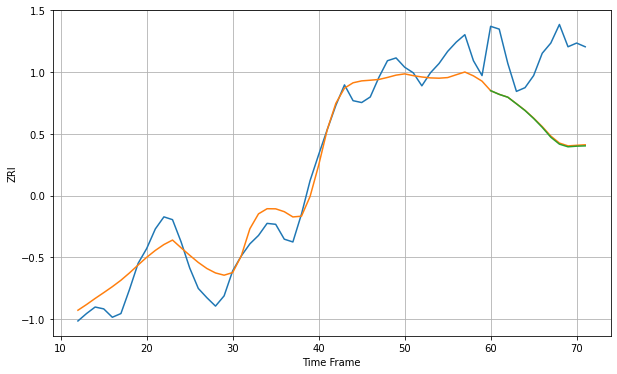

Wall time: 6.75 s
11758 19.74200259307551 82.15221465861106 82.86540353424496 [2392.77723775 2388.79178207 2385.71078079 2378.64236457 2371.41278437
 2362.86925251 2353.32877257 2342.67662943 2335.24095468 2332.37707374
 2333.05808391 2333.38114142]

Got an mse at 0.0098 in round 193 and stopped training

60 60 12


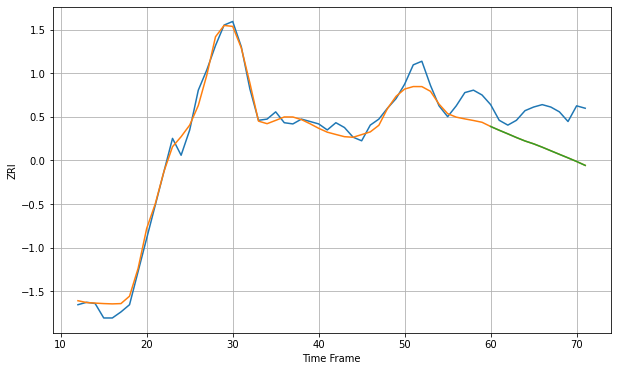

Wall time: 8.82 s
12047 9.067786520540604 30.69606458977107 30.703725379016735 [1112.86804972 1109.7458119  1106.76511743 1103.69992037 1100.84405788
 1098.47630309 1095.69823403 1092.72139526 1089.75720913 1086.84073005
 1083.8243925  1080.58483323]

Got an mse at 0.0099 in round 87 and stopped training

60 60 12


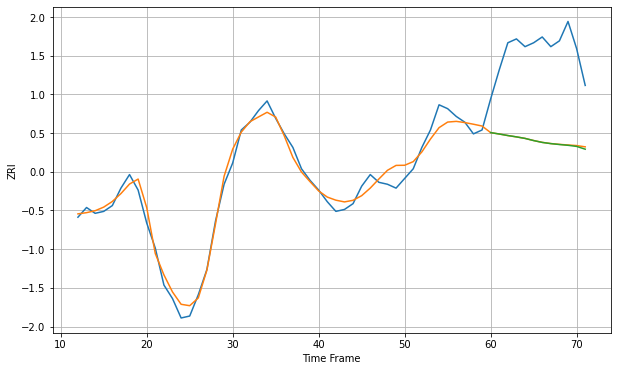

Wall time: 6.41 s
12180 4.690064606144486 47.35248823591059 47.49251885784933 [1000.65111875  999.93114283  999.1379336   998.45125137  997.65741273
  996.54560762  995.59104682  994.96508083  994.50743798  994.09923782
  993.52574671  992.09437223]

Got an mse at 0.0100 in round 124 and stopped training

60 60 12


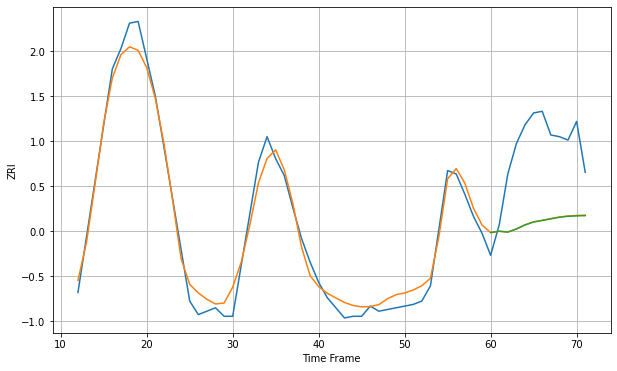

Wall time: 7.44 s
12182 7.238443937791099 46.62549592026611 46.72676531406389 [ 992.38557734  993.18825528  992.70765515  994.51495119  996.90928691
  998.66627869  999.55310172 1000.50354479 1001.45083974 1002.0064408
 1002.25891125 1002.38701148]

Got an mse at 0.0100 in round 147 and stopped training

60 60 12


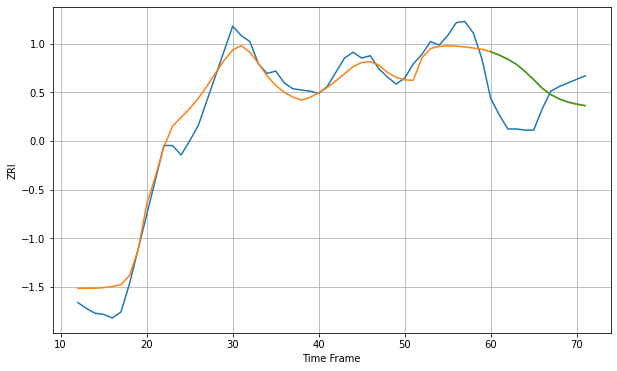

Wall time: 7.94 s
12189 13.198591238542734 37.274277279309516 37.23599612244175 [1135.38936794 1132.54582484 1129.02024048 1124.70922072 1118.68185901
 1111.83491455 1104.47770778 1099.14843279 1095.44989648 1092.86901547
 1091.16185895 1089.84284674]

Got an mse at 0.0099 in round 131 and stopped training

60 60 12


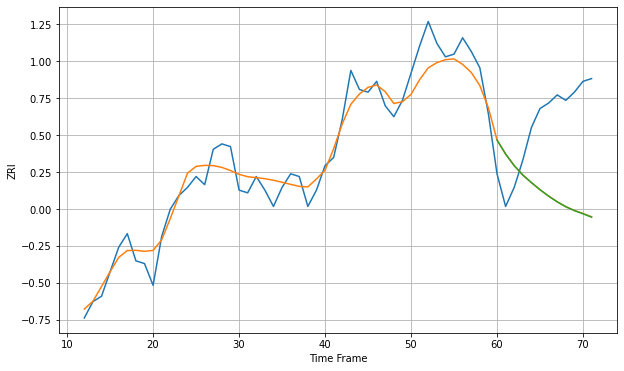

Wall time: 7.45 s
12202 6.194196736925534 32.90568639796447 32.94325283291273 [1093.4280917  1088.27166351 1084.00398741 1080.5502227  1077.77127795
 1075.15011013 1072.80245419 1070.69742584 1068.88759462 1067.47971128
 1066.31450305 1065.05864619]

Got an mse at 0.0099 in round 84 and stopped training

60 60 12


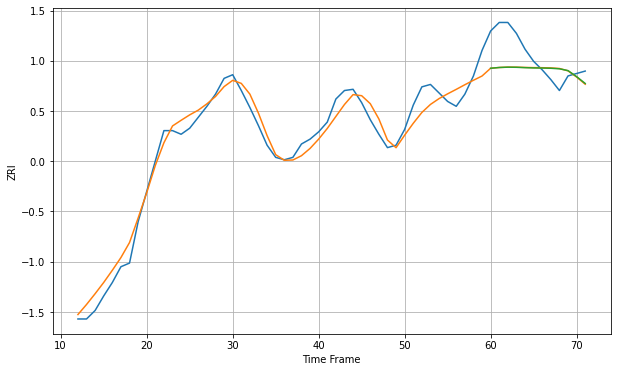

Wall time: 6.48 s
12203 9.639054624275538 20.92035991776067 20.905556898301167 [1283.31597133 1283.93870049 1284.20739815 1284.11114451 1283.8137493
 1283.58562151 1283.49209074 1283.31806131 1282.8725628  1281.37148602
 1276.43625205 1270.80819636]

Got an mse at 0.0098 in round 66 and stopped training

60 60 12


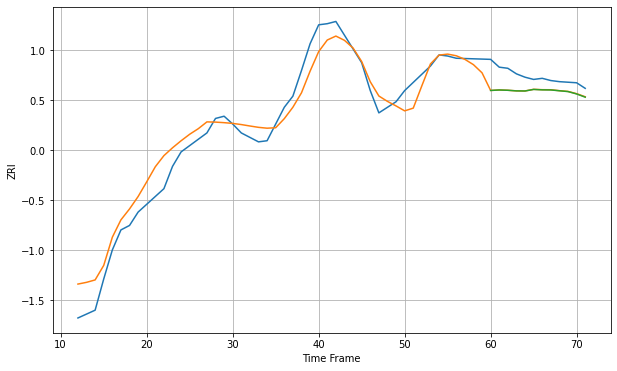

Wall time: 5.99 s
12206 14.51750129690866 14.4575710917118 14.524909652649166 [1209.11059557 1209.53568488 1209.26710347 1208.72967142 1208.62933142
 1210.03290842 1209.65092141 1209.55588554 1208.82752061 1208.09690497
 1205.97366267 1203.08032474]

Got an mse at 0.0100 in round 145 and stopped training

60 60 12


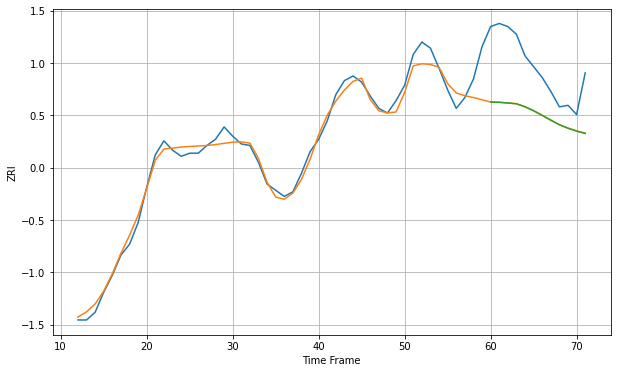

Wall time: 7.85 s
12208 7.132028761332083 34.51700382939083 34.55231239196928 [1248.11486856 1247.94413917 1247.51523948 1247.01595559 1245.05626875
 1242.48537175 1239.47603878 1236.35730051 1233.38503226 1231.14509196
 1229.25671758 1227.76681932]

Got an mse at 0.0099 in round 111 and stopped training

60 60 12


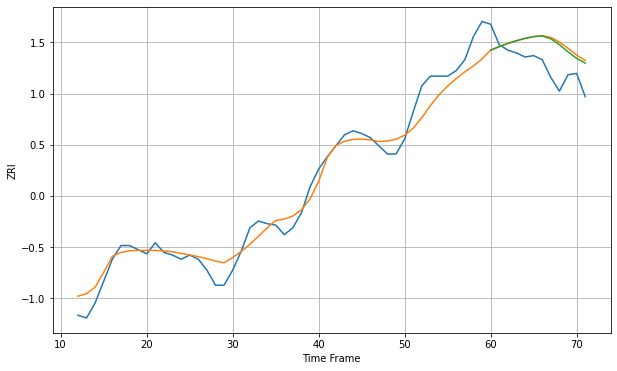

Wall time: 6.92 s
12209 10.418926142382333 19.50636638524047 18.50911759626765 [1176.02007716 1178.56358292 1180.88747833 1182.93237014 1184.62991329
 1185.87880104 1186.40121345 1184.31454936 1180.04061823 1174.77609107
 1169.97989099 1166.52352437]
60 60 12


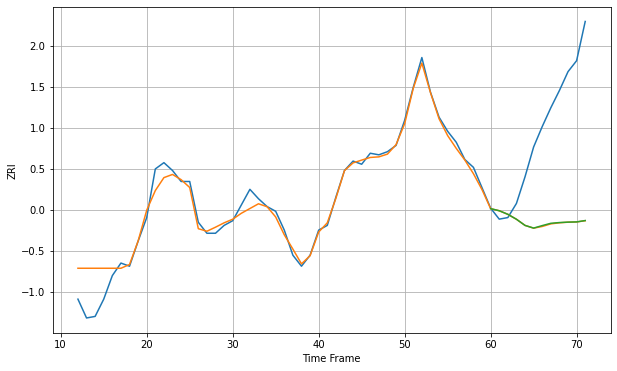

Wall time: 16.1 s
12210 8.453001481708865 68.5108371129395 68.38903610801786 [1040.67944807 1039.35260554 1037.07317371 1033.9352643  1030.00059293
 1028.29343874 1029.88546698 1031.35126443 1031.8207926  1032.09451248
 1032.22638095 1033.1069643 ]

Got an mse at 0.0100 in round 120 and stopped training

60 60 12


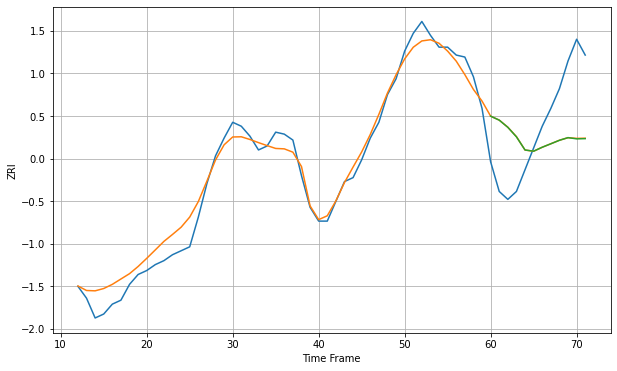

Wall time: 7.17 s
12303 6.536226688337193 30.19894918775937 30.238259110339005 [1016.09311379 1014.07646241 1010.44558435 1005.63923021  998.98858647
  998.3758615  1000.37787815 1002.1186464  1003.88447776 1005.23303108
 1004.61923599 1004.72571313]

Got an mse at 0.0099 in round 133 and stopped training

60 60 12


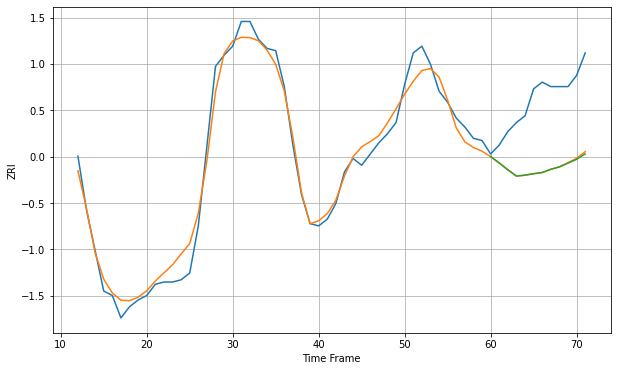

Wall time: 7.24 s
12304 5.627948823043967 31.27339017270088 31.470150763613887 [1014.82137571 1012.0092614  1008.96284051 1006.17145222 1006.56327124
 1007.22339126 1007.74327321 1009.17899903 1010.23012114 1011.92615772
 1013.6400971  1016.02775466]

Got an mse at 0.0098 in round 93 and stopped training

60 60 12


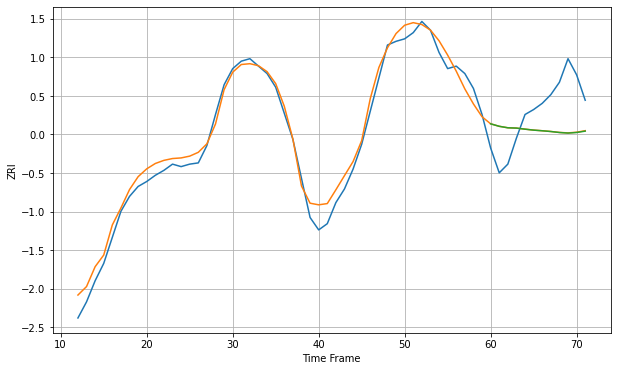

Wall time: 6.6 s
12306 8.560077305069282 32.20683236515227 32.29312627921481 [1056.49752643 1054.49272978 1053.30138729 1053.04737432 1052.18574207
 1051.4082695  1050.89261123 1050.28947858 1049.49491856 1049.03464944
 1049.49854778 1050.60505424]

Got an mse at 0.0100 in round 249 and stopped training

60 60 12


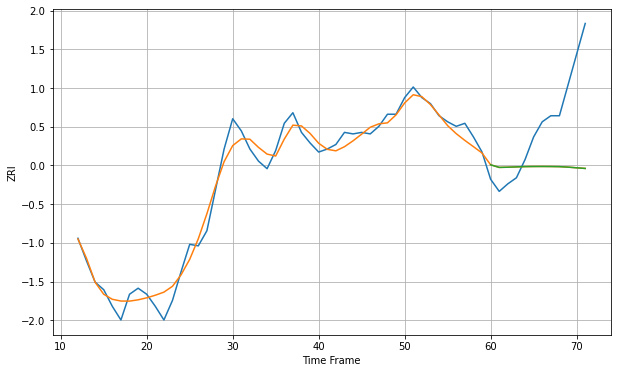

Wall time: 10.3 s
12307 6.991068329438252 42.63217768765827 42.64139243314109 [945.57037827 943.85402984 943.98134097 944.19121604 944.38918368
 944.45505466 944.4759839  944.43704883 944.35473971 944.03158971
 943.58771796 943.16013789]

Got an mse at 0.0099 in round 289 and stopped training

60 60 12


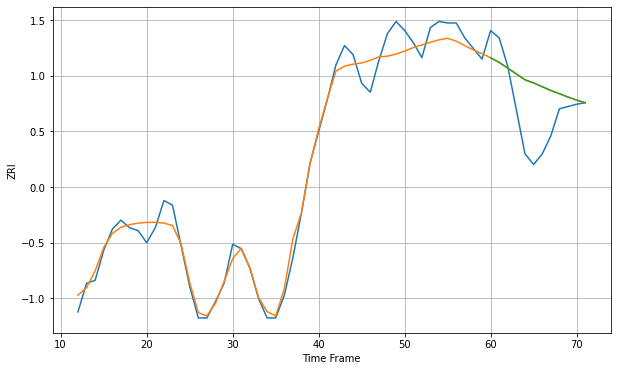

Wall time: 11 s
12401 8.581804125088455 28.258823891174533 28.258144250606655 [1423.87959197 1420.744208   1416.9960953  1413.11863786 1409.22432184
 1407.16203166 1404.65379488 1402.15048859 1400.01855272 1397.77080905
 1395.77213064 1394.06383284]

Got an mse at 0.0097 in round 41 and stopped training

60 60 12


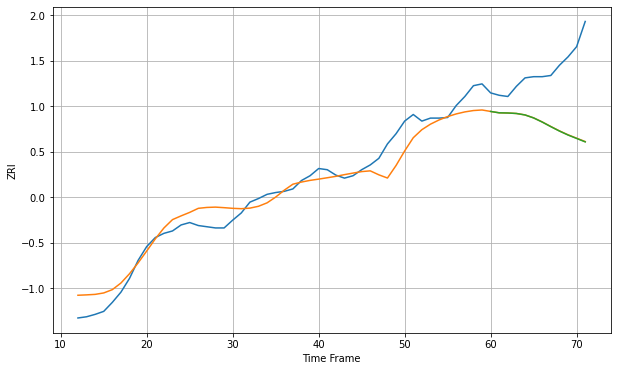

Wall time: 5.19 s
12508 24.18761303544616 99.21826177554479 99.45956632882422 [1552.08186679 1549.7911285  1549.50866333 1548.69139891 1546.2529969
 1541.28496448 1534.41318948 1526.75668206 1519.41238495 1512.8324789
 1507.11828938 1501.37934326]

Got an mse at 0.0100 in round 102 and stopped training

60 60 12


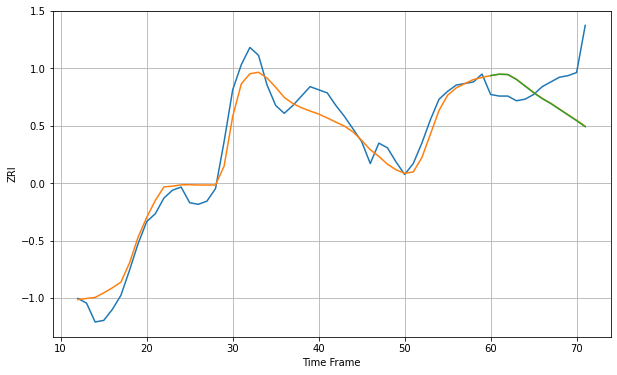

Wall time: 6.54 s
12550 9.387004417626175 24.34244594726275 24.470884506363717 [1414.03750606 1414.9256864  1414.71037724 1411.61666862 1407.42429943
 1403.17967948 1399.39358806 1396.22913392 1392.57582228 1388.9476402
 1385.31203605 1381.4453546 ]

Got an mse at 0.0098 in round 34 and stopped training

60 60 12


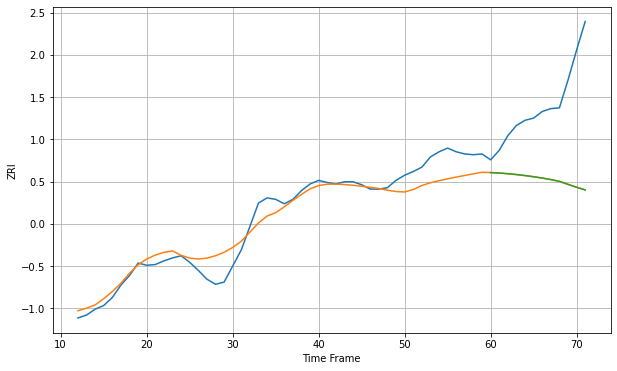

Wall time: 5.06 s
12590 19.245099895725897 114.25533550209542 114.27853691390425 [1472.6155217  1471.98525526 1471.05446099 1469.87664231 1468.49847726
 1466.92529776 1465.09724608 1463.0597626  1460.58870526 1456.49946834
 1452.51219167 1448.92756953]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


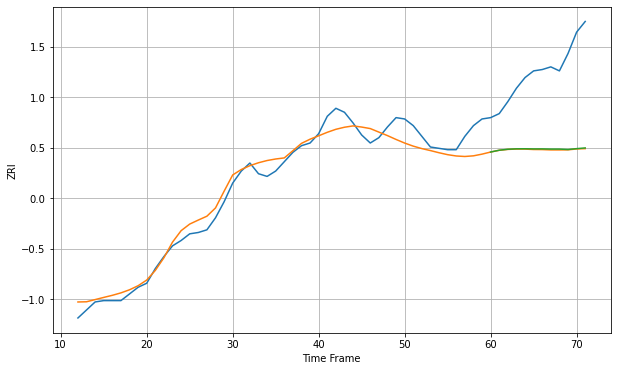

Wall time: 5.73 s
12601 9.318599875192739 60.53999303480921 60.19589601967012 [1221.2468777  1222.60626766 1223.32606878 1223.64859565 1223.69142021
 1223.56607767 1223.58593102 1223.45334577 1223.44902588 1223.14356172
 1223.78250032 1224.30720775]

Got an mse at 0.0100 in round 68 and stopped training

60 60 12


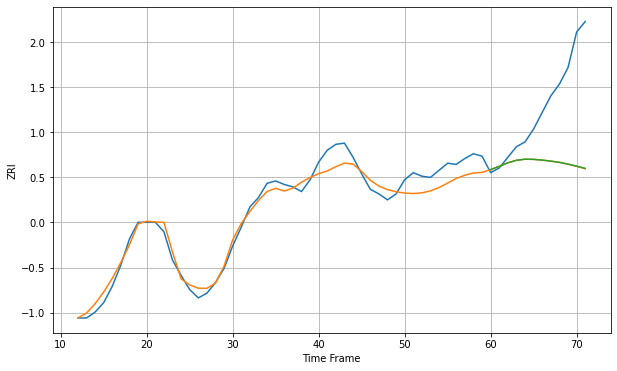

Wall time: 6.15 s
12603 9.144386976256616 61.40826291867201 61.31844366744208 [1392.60010342 1395.37344997 1398.33421922 1400.47776454 1401.40176988
 1401.27493168 1400.64671585 1399.78270621 1398.75914819 1397.27121021
 1395.53821186 1393.64971794]

Got an mse at 0.0099 in round 160 and stopped training

60 60 12


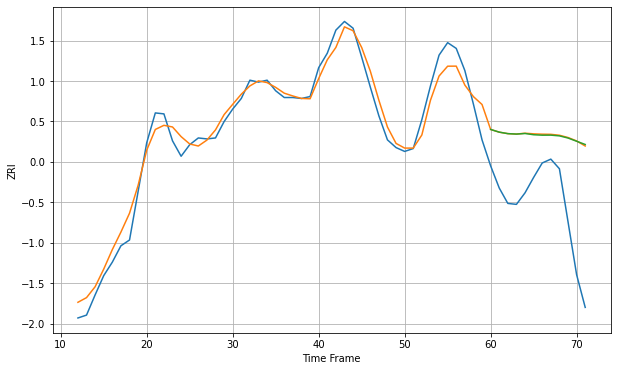

Wall time: 8.14 s
12866 13.107571174693927 81.17674542386573 81.21985029187577 [1721.82237657 1719.03289364 1717.4897942  1717.00779932 1717.62470779
 1716.33659858 1715.87191416 1715.92075028 1715.16327199 1712.92555266
 1709.57404125 1706.2122793 ]

Got an mse at 0.0100 in round 192 and stopped training

60 60 12


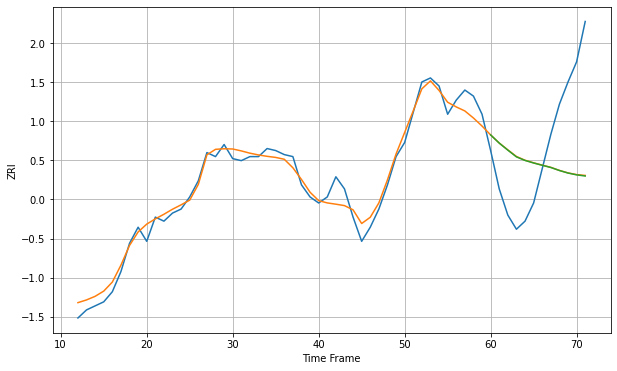

Wall time: 9.02 s
13203 4.918375726080578 37.15472598372577 37.19525053588618 [893.76080404 889.68611524 886.20964529 882.86813988 881.10114355
 879.83529026 878.70211908 877.61691708 876.11280966 874.8544977
 873.95283104 873.37639838]

Got an mse at 0.0099 in round 108 and stopped training

60 60 12


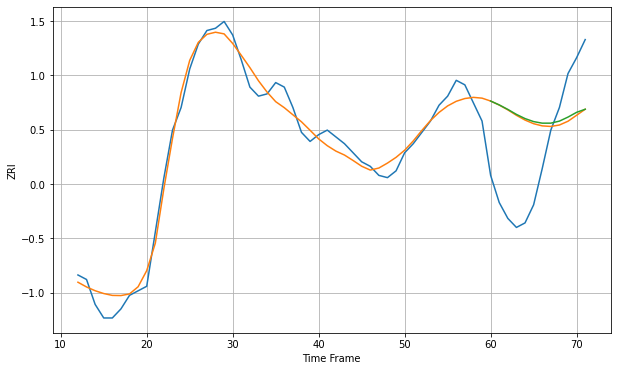

Wall time: 6.93 s
13204 5.299898995118294 33.5287029019977 33.6354580696423 [911.84264276 910.1273106  908.14460688 905.94234592 904.09825937
 902.76269643 902.06656285 902.07034236 902.97749947 904.75966633
 906.85338938 908.22299211]

Got an mse at 0.0099 in round 229 and stopped training

60 60 12


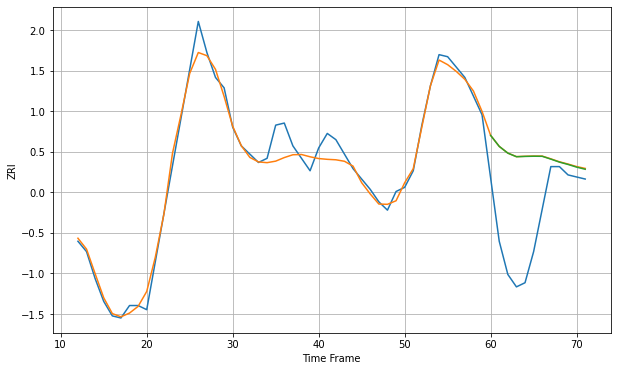

Wall time: 9.84 s
13205 5.460717250957072 37.06380307991475 37.01480715904452 [924.05410112 918.7465907  915.4978745  913.76842224 913.91555621
 914.0060096  913.9693868  912.61641051 911.17218815 910.04305954
 908.75011669 907.72367944]

Got an mse at 0.0098 in round 137 and stopped training

60 60 12


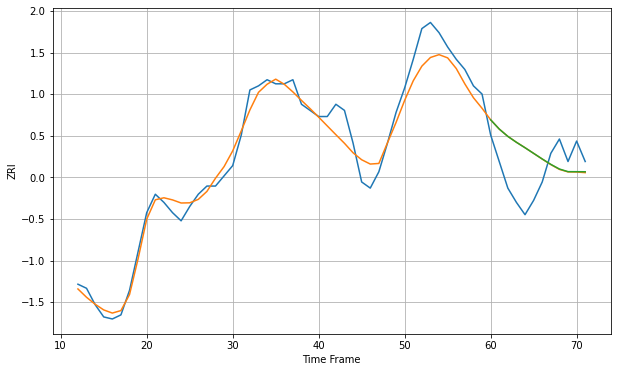

Wall time: 7.73 s
13206 7.012799736311448 18.42565853187899 18.383715221161836 [890.40812671 885.86970339 882.29312015 879.39446264 876.74085134
 873.98884429 871.24434929 868.60762232 866.32780615 865.04144012
 865.0294764  864.99130407]

Got an mse at 0.0099 in round 347 and stopped training

60 60 12


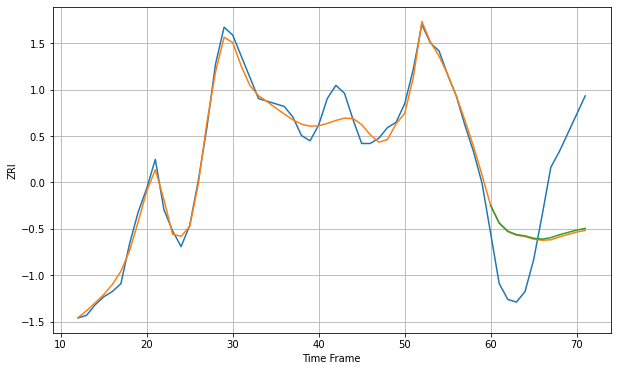

Wall time: 12.7 s
13208 3.840746314718753 29.384303637807122 29.005580745528857 [868.56295615 861.93583813 858.83386152 857.52213239 857.06064821
 856.14998036 855.81068295 856.3958742  857.45313765 858.37401875
 859.23489138 859.89023694]

Got an mse at 0.0099 in round 199 and stopped training

60 60 12


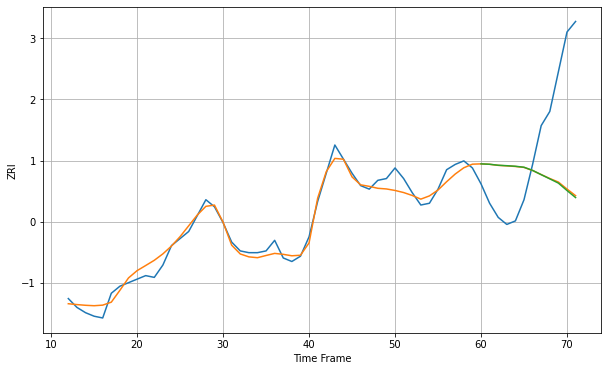

Wall time: 9.12 s
13440 4.463149197942217 48.00286692636173 48.41614939023159 [753.31564649 753.09398382 752.53701759 752.27925749 751.95894012
 751.40937334 749.61499879 747.2021991  744.83032995 742.41416843
 738.22504747 734.22262295]

Got an mse at 0.0099 in round 141 and stopped training

60 60 12


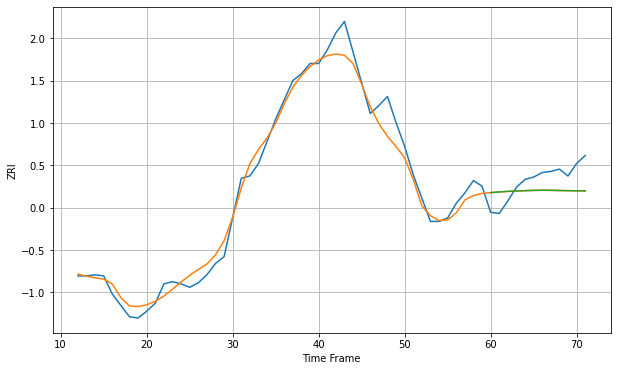

Wall time: 7.8 s
13501 10.611535594554848 17.23082080831531 17.224951627637843 [827.33408871 827.95313019 828.4278486  828.81214793 829.08677409
 829.29107142 829.42453379 829.36009426 829.2135279  829.07481056
 828.96449411 828.90410915]

Got an mse at 0.0098 in round 88 and stopped training

60 60 12


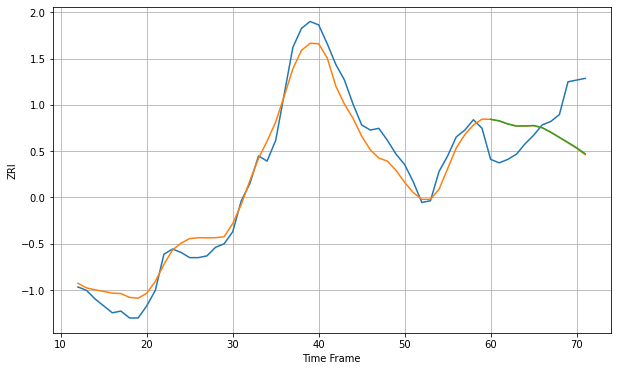

Wall time: 6.56 s
13502 8.712033987879211 24.078420846058854 23.92301895222883 [828.23166004 827.32846596 825.5516858  824.33874846 824.39934428
 824.6190015  823.38791923 820.75146371 817.77217198 814.81829674
 811.7496731  808.27196706]

Got an mse at 0.0099 in round 311 and stopped training

60 60 12


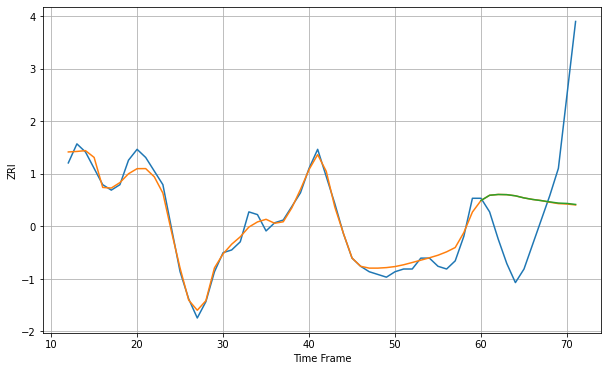

Wall time: 11.9 s
13601 2.808574795720553 27.85109224271887 27.779020539057935 [849.18677485 851.10979971 851.40028008 851.33146184 850.90753211
 850.13552304 849.57021558 849.14545145 848.66844227 848.23633994
 848.10568078 847.7337003 ]

Got an mse at 0.0095 in round 312 and stopped training

60 60 12


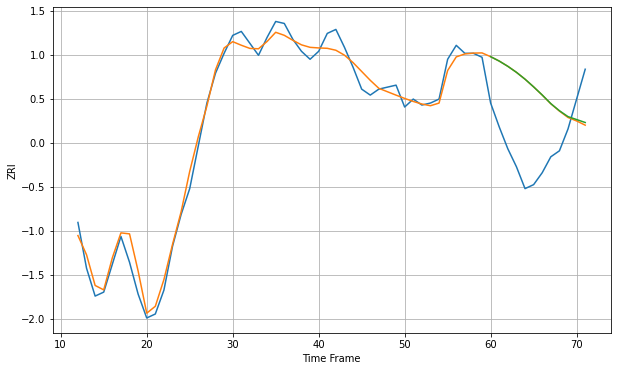

Wall time: 11.8 s
13760 5.148311438179041 34.903832232778484 34.82456869813155 [895.30727823 893.09293155 890.45807626 887.44646866 883.99871648
 880.13662617 876.05099854 871.71915398 868.14488857 865.17986577
 863.71241311 862.22885947]

Got an mse at 0.0100 in round 138 and stopped training

60 60 12


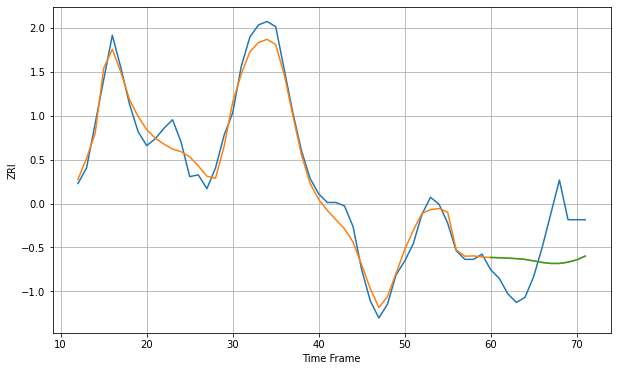

Wall time: 7.74 s
13903 6.833367598311586 23.602204402732458 23.58264536884922 [833.11432362 832.95960192 832.6971684  832.43048589 831.97354078
 831.12949069 830.20919154 829.65074872 829.65864849 830.38502334
 831.73231685 833.9036555 ]

Got an mse at 0.0100 in round 182 and stopped training

60 60 12


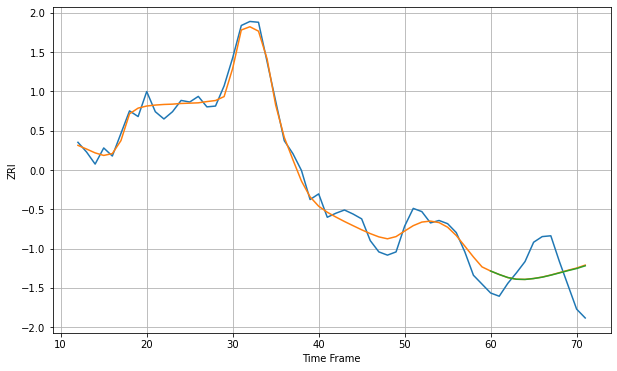

Wall time: 8.63 s
14020 11.315100314023923 37.0014337593437 36.847121819454635 [1226.27079608 1221.94054944 1218.17332123 1216.05964707 1215.81900551
 1216.91993803 1218.64473769 1221.12715294 1223.92783869 1226.76284148
 1229.37849565 1232.73456046]

Got an mse at 0.0097 in round 139 and stopped training

60 60 12


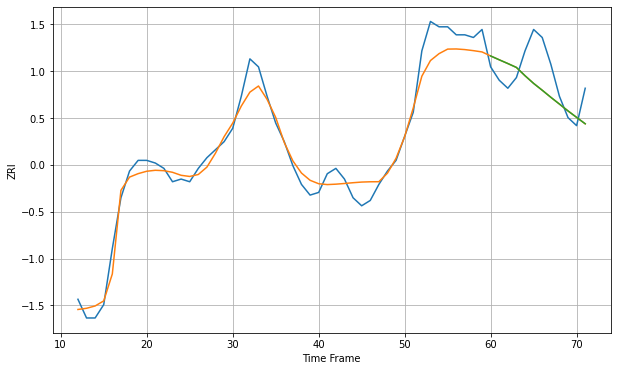

Wall time: 7.42 s
14043 5.366461081975307 10.856972212797963 10.85544317024478 [961.08893071 959.6503613  958.24930312 956.78629189 953.68607473
 950.80907004 948.25800641 945.61572018 943.07927616 940.50864103
 938.08975042 935.69418396]

Got an mse at 0.0100 in round 332 and stopped training

60 60 12


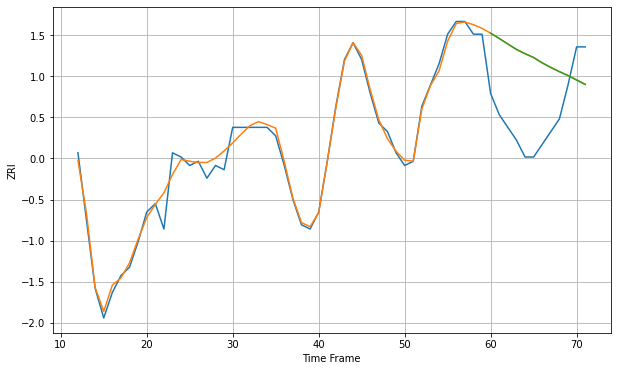

Wall time: 12.2 s
14150 2.0157621435105297 16.79443368318458 16.798402863990997 [898.23041332 896.98497828 895.68130864 894.40175481 893.39274
 892.48487348 891.22079582 890.13929848 889.14153174 888.22119402
 887.1574579  886.10462799]

Got an mse at 0.0099 in round 124 and stopped training

60 60 12


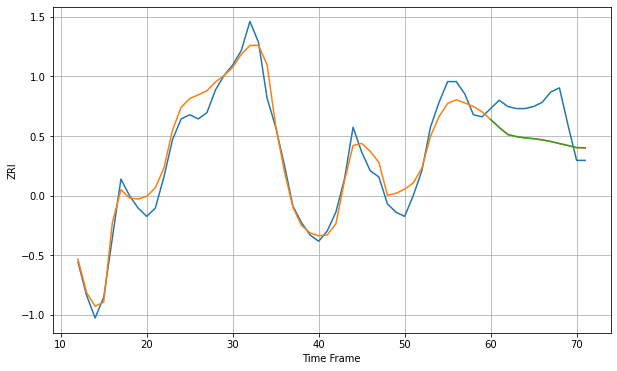

Wall time: 7.46 s
14201 6.487389083898329 15.297511851970812 15.258212491443048 [934.72958206 930.88512933 927.46581229 926.47588868 925.84710361
 925.48896189 924.91550676 924.14938036 923.1714511  922.20861804
 921.18684676 921.09808307]

Got an mse at 0.0099 in round 135 and stopped training

60 60 12


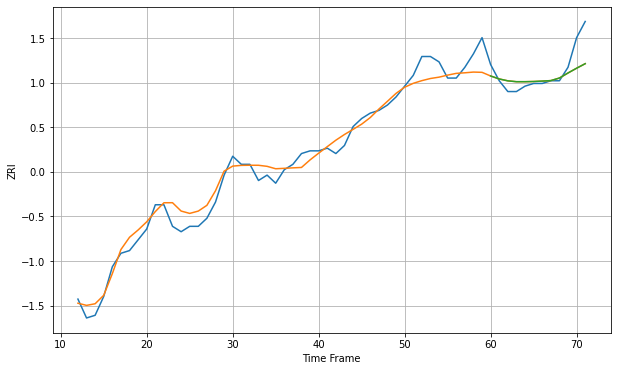

Wall time: 7.62 s
14206 4.3848254150123935 5.9935418772779245 5.991972338435879 [803.77650167 802.67060581 801.97052846 801.65482846 801.65727857
 801.72689186 801.8813014  802.06303557 803.0175057  804.88930401
 806.65866901 808.33914055]

Got an mse at 0.0098 in round 146 and stopped training

60 60 12


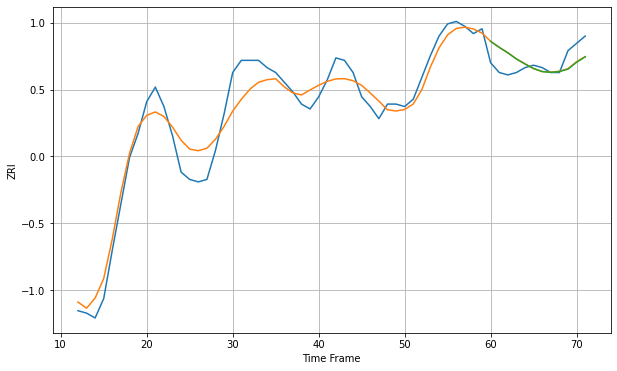

Wall time: 8.02 s
14207 6.944057050012374 6.390887431609885 6.4374523305613085 [821.82745785 819.34719332 817.09313924 814.57802572 812.53878726
 810.63730855 809.3795858  809.0568363  809.37496619 810.39133592
 813.21803197 815.45269784]

Got an mse at 0.0099 in round 69 and stopped training

60 60 12


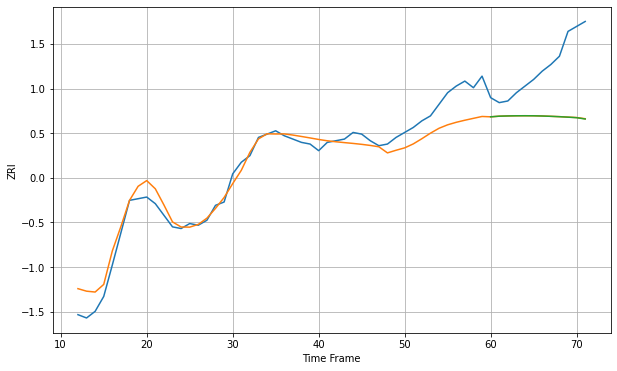

Wall time: 6.06 s
14208 9.555044366252858 33.496378485187364 33.54648112472154 [792.43213636 792.81633291 792.96961279 793.06319281 793.08938019
 793.06099837 792.92789538 792.73248864 792.51487636 792.22608982
 791.90258963 791.11253508]

Got an mse at 0.0097 in round 263 and stopped training

60 60 12


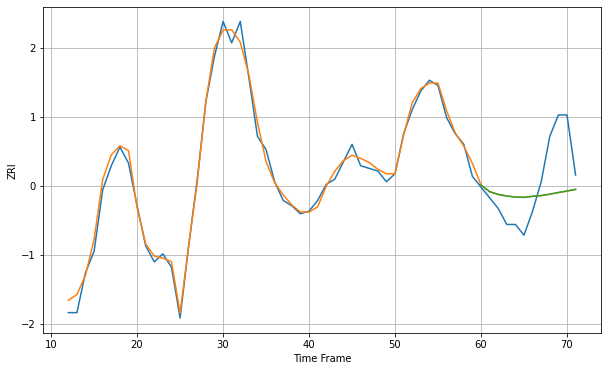

Wall time: 10.7 s
14209 2.9177302127343077 14.896560777855838 14.895818376013045 [1041.78572628 1039.27843487 1038.2521177  1037.64827585 1037.25510158
 1037.16216341 1037.54440843 1037.81883652 1038.34086316 1038.9558655
 1039.51725749 1040.15395175]

Got an mse at 0.0100 in round 141 and stopped training

60 60 12


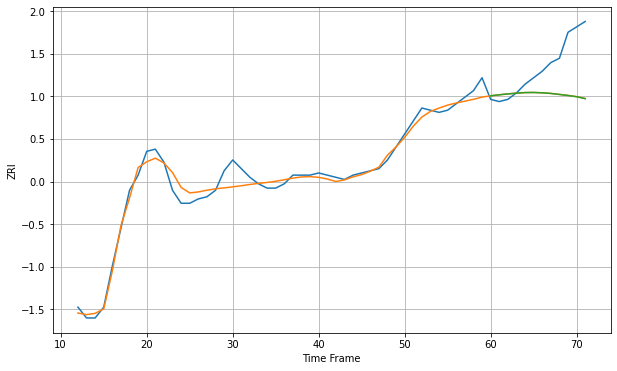

Wall time: 7.73 s
14210 3.864193841398367 17.84232998820146 17.86082169985514 [789.64389687 790.12096833 790.52688068 790.87486607 791.14438115
 791.19810962 791.03156541 790.74708556 790.27137001 789.79701223
 789.22697597 788.34319991]

Got an mse at 0.0098 in round 77 and stopped training

60 60 12


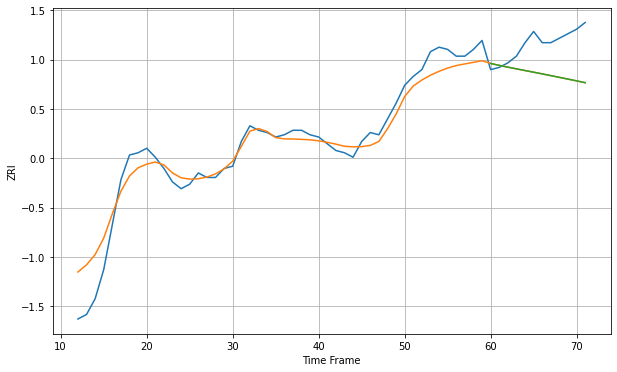

Wall time: 6.21 s
14211 7.202114922752889 15.543083789931545 15.528014766676094 [786.74695627 785.90187067 785.10798544 784.34869373 783.60080003
 782.85860879 782.10899682 781.34411887 780.56346958 779.78850282
 779.01219186 778.20497808]

Got an mse at 0.0099 in round 66 and stopped training

60 60 12


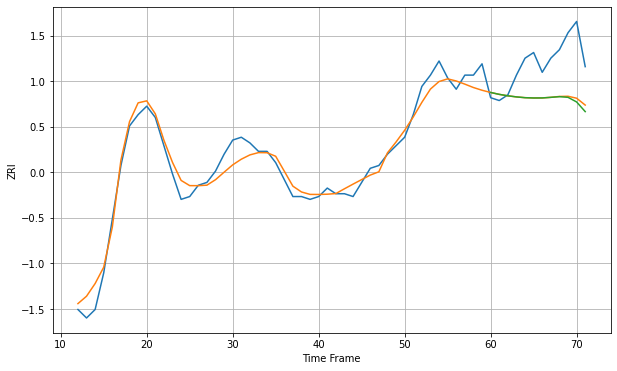

Wall time: 6.04 s
14212 4.063351899531009 14.436220340625821 14.8953711098391 [775.857142   775.1864636  774.67016943 774.28550798 774.01034643
 773.90760093 773.92300885 774.1328849  774.37141352 774.13460961
 772.49600867 769.0803474 ]

Got an mse at 0.0099 in round 115 and stopped training

60 60 12


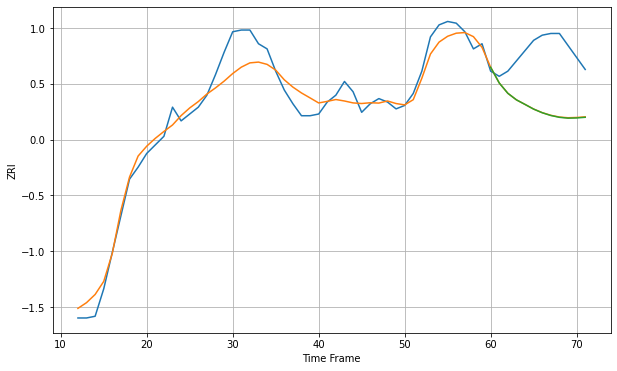

Wall time: 7.13 s
14213 8.62711731007784 33.87344561857921 33.98203251310641 [867.28836679 858.10829356 852.0976699  848.26012843 845.59395043
 842.86994402 840.74289651 839.14186821 838.071436   837.58034915
 837.70363174 838.09379603]

Got an mse at 0.0099 in round 125 and stopped training

60 60 12


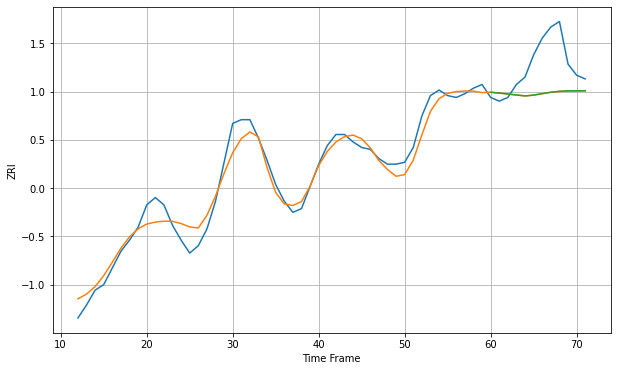

Wall time: 7.43 s
14214 6.329519694598343 19.435868672263776 19.39055477490154 [922.79545812 922.36989061 921.85882116 921.32103901 920.83206747
 921.24739466 922.06079507 922.81707261 923.32097881 923.57475033
 923.60835835 923.64910625]

Got an mse at 0.0100 in round 73 and stopped training

60 60 12


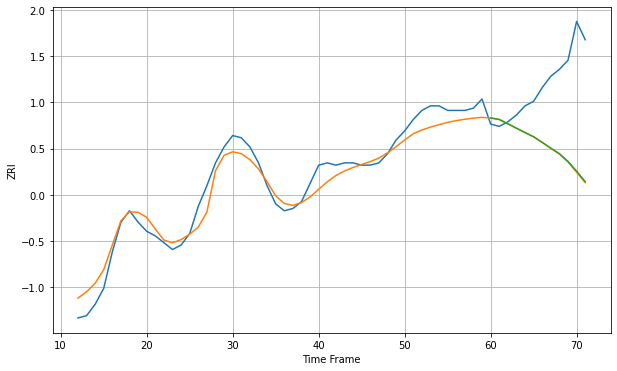

Wall time: 6.16 s
14215 5.652118828012871 33.761145036134664 33.556570736623 [776.68666192 776.03920442 774.13604285 772.20457402 770.28894179
 768.44772969 765.98858955 763.43631498 761.0265941  757.6598999
 753.34896646 748.81671037]

Got an mse at 0.0099 in round 99 and stopped training

60 60 12


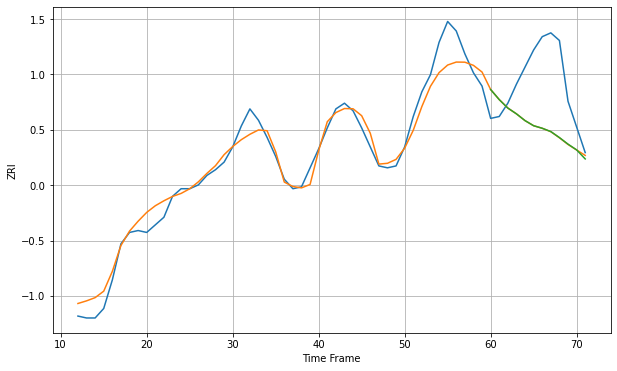

Wall time: 6.71 s
14216 7.161954514031418 30.624087333923747 30.597069105463955 [1041.19619055 1035.89085093 1031.43810544 1028.39642853 1024.83366111
 1022.15351117 1020.81825082 1019.06548655 1015.91700241 1012.45846346
 1009.42682102 1004.67639533]

Got an mse at 0.0098 in round 93 and stopped training

60 60 12


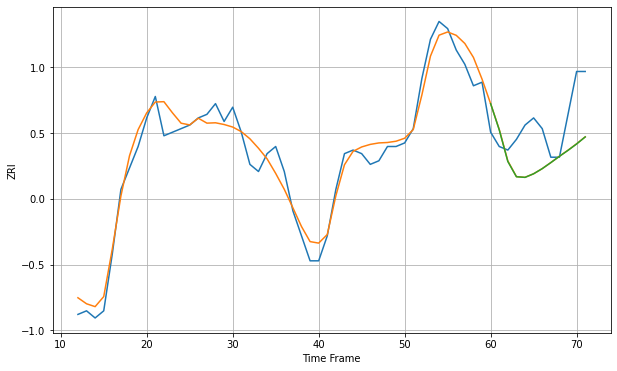

Wall time: 6.59 s
14217 4.016596971701725 11.677268796299003 11.693934918350985 [891.98510148 884.66494637 875.79901162 871.52832512 871.36159515
 872.36711404 873.79928592 875.48767144 877.25023837 878.92333533
 880.71021575 882.67348353]

Got an mse at 0.0100 in round 112 and stopped training

60 60 12


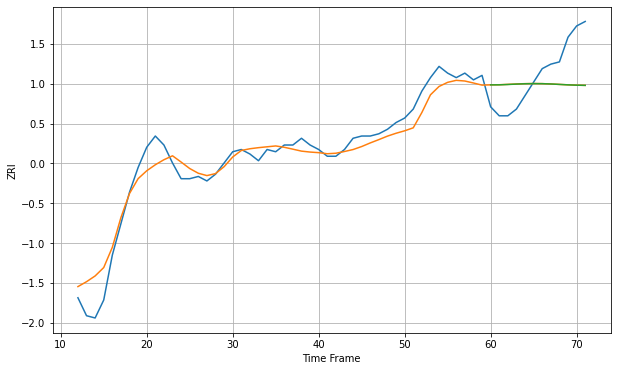

Wall time: 7.02 s
14218 6.2145872716135715 15.310111975044046 15.302775263376109 [824.7743387  824.79298628 824.94008372 825.12289849 825.27347351
 825.34298871 825.31146561 825.17233314 824.9773023  824.78434601
 824.63566963 824.544272  ]

Got an mse at 0.0100 in round 139 and stopped training

60 60 12


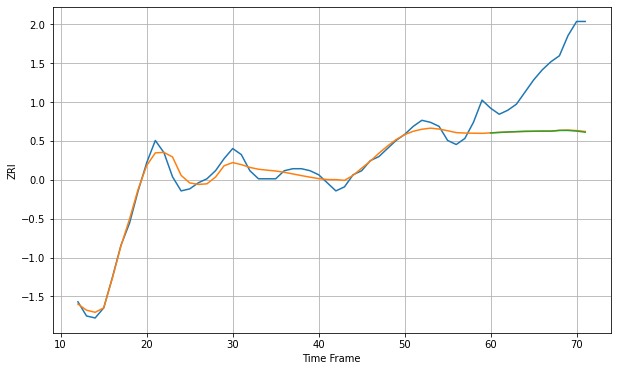

Wall time: 7.66 s
14220 4.26306236388413 33.07806965028872 33.1807504385394 [795.754189   795.99434583 796.19543319 796.37894226 796.51580529
 796.57063026 796.63763672 796.62505425 796.97441648 796.97033701
 796.66035055 796.10978596]

Got an mse at 0.0098 in round 163 and stopped training

60 60 12


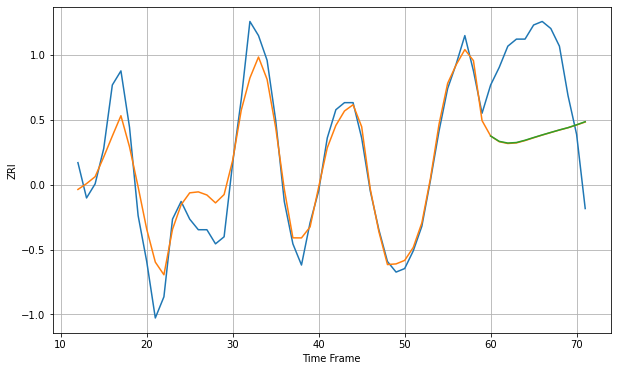

Wall time: 8.19 s
14221 6.4293868388338495 24.63710764361314 24.58650513422055 [1131.55469249 1130.03514311 1129.55241082 1129.70956588 1130.3476708
 1131.11687727 1131.86409838 1132.57167024 1133.27410334 1133.92207417
 1134.72757441 1135.60618175]

Got an mse at 0.0100 in round 185 and stopped training

60 60 12


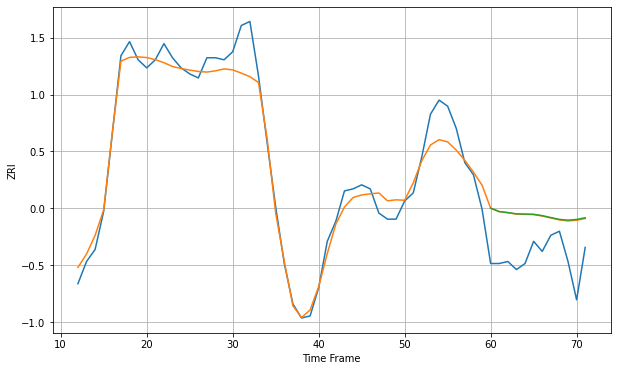

Wall time: 8.71 s
14222 8.571533394596932 22.55772759806188 22.71899454139833 [1085.42163627 1083.76030127 1083.23007952 1082.60248722 1082.496667
 1082.40636629 1081.72418656 1080.78893386 1079.88418805 1079.47650498
 1079.85119461 1080.69901728]

Got an mse at 0.0099 in round 145 and stopped training

60 60 12


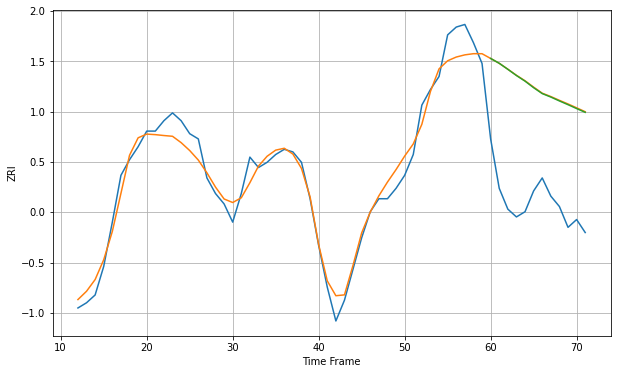

Wall time: 7.88 s
14224 5.338949885788184 44.44367765762367 44.292438531042166 [979.93152128 978.06748269 975.76330398 973.3752063  971.20816425
 968.68978214 966.42799676 965.0955408  963.59374735 962.16133643
 960.66441387 959.2186495 ]

Got an mse at 0.0100 in round 133 and stopped training

60 60 12


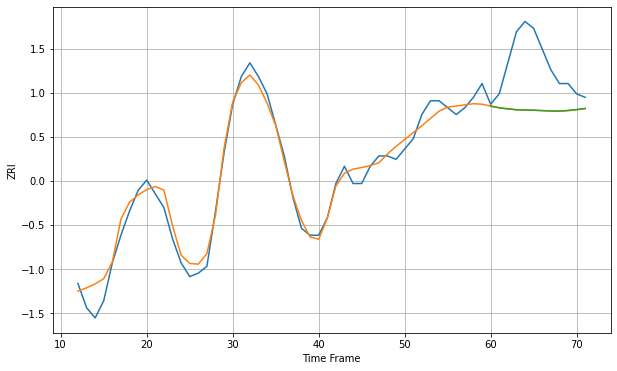

Wall time: 7.59 s
14225 3.243171968730185 14.574149306446545 14.565111205161871 [858.45872982 857.96268957 857.65351608 857.39377118 857.33069041
 857.26039098 857.14589134 857.04529437 857.0191537  857.18740132
 857.44941453 857.78419504]

Got an mse at 0.0099 in round 266 and stopped training

60 60 12


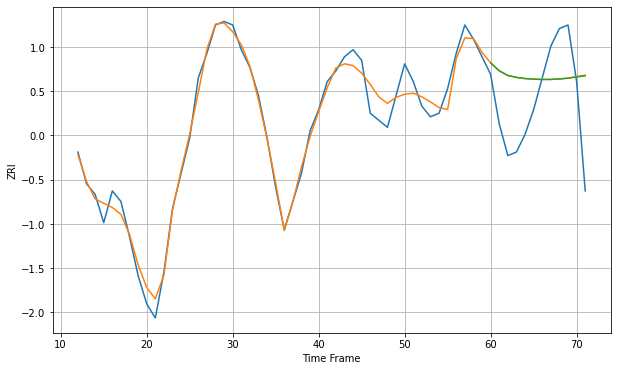

Wall time: 10.8 s
14228 3.3164307087813714 16.132967946396587 16.094240021250126 [1096.26005492 1094.03132142 1092.69238807 1092.14501909 1091.81855357
 1091.64918844 1091.57057941 1091.58091108 1091.71611535 1091.92892854
 1092.28334458 1092.60241689]

Got an mse at 0.0099 in round 202 and stopped training

60 60 12


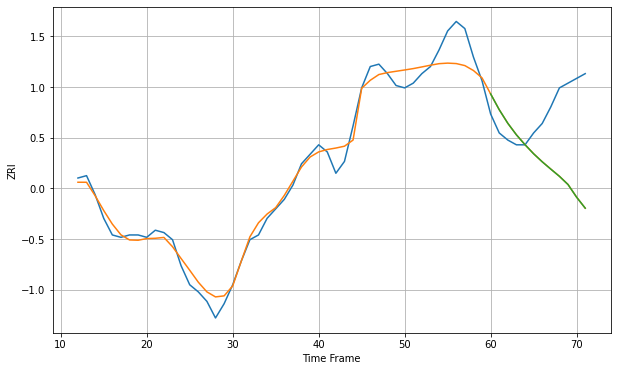

Wall time: 9.27 s
14301 5.570864856437779 29.15042277128121 29.161033406969263 [648.46345403 641.80414004 636.05927669 631.20519249 627.03550541
 623.22098415 619.83681124 616.74018766 613.71396927 610.25265275
 604.91388641 600.2988463 ]

Got an mse at 0.0098 in round 139 and stopped training

60 60 12


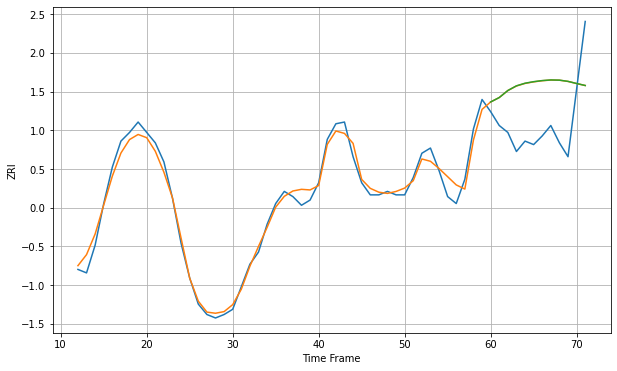

Wall time: 7.73 s
14607 4.906124914079079 30.24916217066718 30.301725927168377 [1084.57201656 1087.11839593 1091.17581864 1093.86817645 1095.38861603
 1096.27610744 1096.91112541 1097.27364006 1097.1631324  1096.44824338
 1095.22301022 1094.07133162]

Got an mse at 0.0099 in round 127 and stopped training

60 60 12


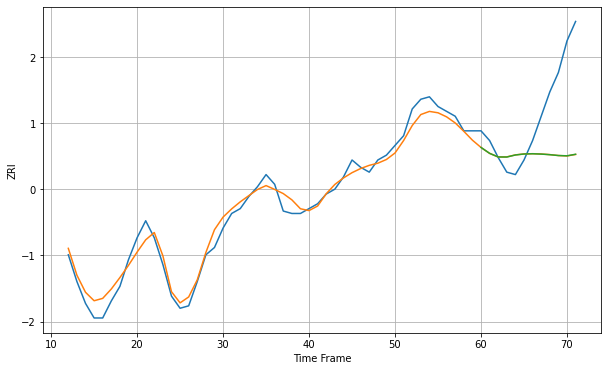

Wall time: 7.45 s
14609 3.935085784760007 25.039579240113298 25.016537498487313 [825.1622345  822.74225135 821.24153281 821.21935174 822.06022174
 822.46787904 822.56751889 822.42911362 822.18369942 821.84009202
 821.7252937  822.36038389]

Got an mse at 0.0100 in round 274 and stopped training

60 60 12


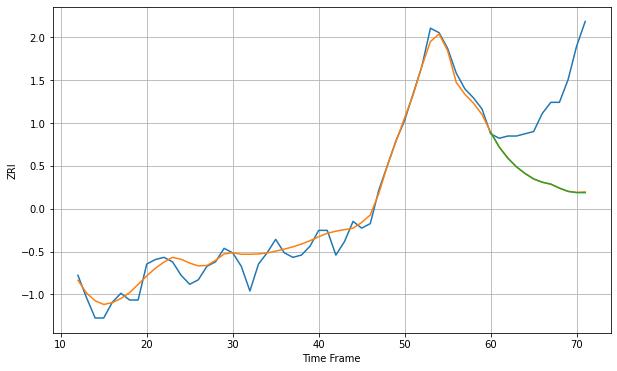

Wall time: 10.9 s
14611 4.6987406066776 37.89832342341727 37.97031219031872 [868.71472482 862.07787724 857.16040167 853.28860751 850.33323003
 847.90432676 846.44064468 845.58205965 843.8252379  842.34835692
 841.79938011 841.7817626 ]

Got an mse at 0.0100 in round 140 and stopped training

60 60 12


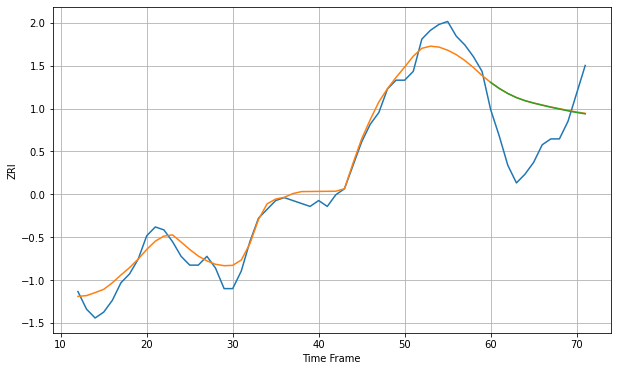

Wall time: 7.7 s
14613 4.322859890533913 17.213824714694553 17.199847637613708 [769.2449245  767.18670681 765.45629035 764.06804383 763.00590492
 762.18630315 761.46886348 760.78216271 760.16427906 759.55326592
 758.99741973 758.54374162]

Got an mse at 0.0098 in round 107 and stopped training

60 60 12


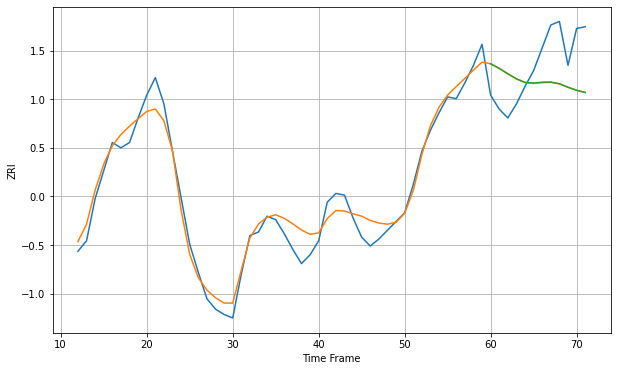

Wall time: 6.86 s
14620 7.70232741542781 24.64484968503648 24.60046516367642 [1092.90151537 1090.25371004 1087.19601112 1084.28085256 1082.27702817
 1081.89321529 1082.39436822 1082.49194983 1081.47369617 1079.50783057
 1077.77355847 1076.49941983]

Got an mse at 0.0100 in round 225 and stopped training

60 60 12


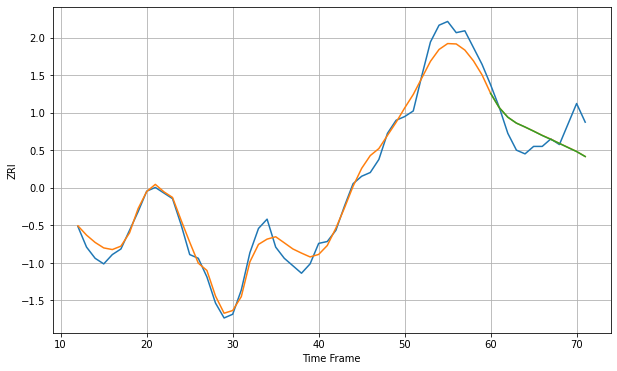

Wall time: 9.71 s
14621 6.055444853361383 12.152386526241445 12.168006188990928 [814.42950762 806.78601922 801.65007458 798.48691935 796.40525064
 794.17478034 791.85729315 789.76952553 787.59513931 785.38627615
 783.24152939 780.57620085]

Got an mse at 0.0099 in round 116 and stopped training

60 60 12


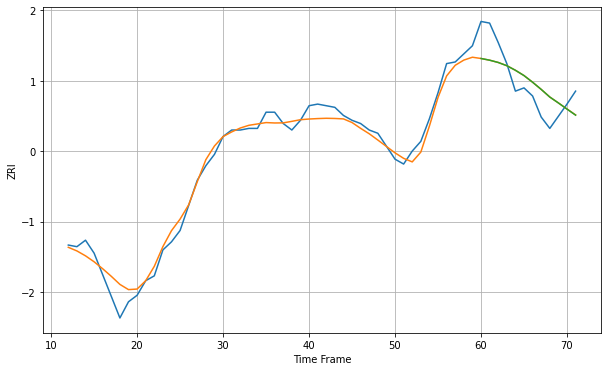

Wall time: 7.03 s
14701 5.892346530447676 14.301011685617812 14.312088279731203 [664.14739128 663.10399382 661.69584847 659.70603171 656.87426934
 653.60929112 649.50129973 645.07781173 640.35738512 636.7077782
 632.9219839  629.18875122]

Got an mse at 0.0099 in round 168 and stopped training

60 60 12


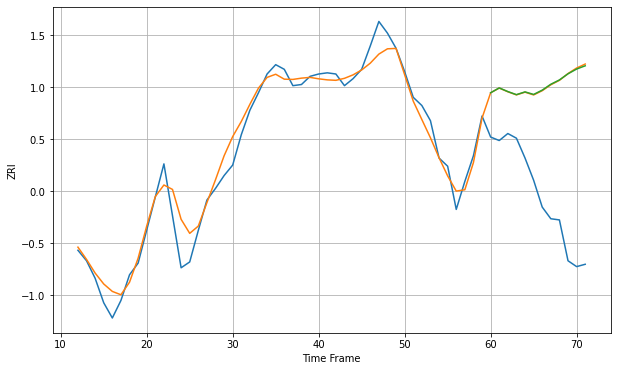

Wall time: 8.31 s
14850 12.486968160681036 106.50866644603708 106.32369271455504 [1582.92453965 1587.07929389 1583.94200117 1581.30684259 1583.67369964
 1581.49587267 1585.17265515 1590.22675347 1593.90063159 1599.16636008
 1603.23743562 1606.01952574]

Got an mse at 0.0098 in round 56 and stopped training

60 60 12


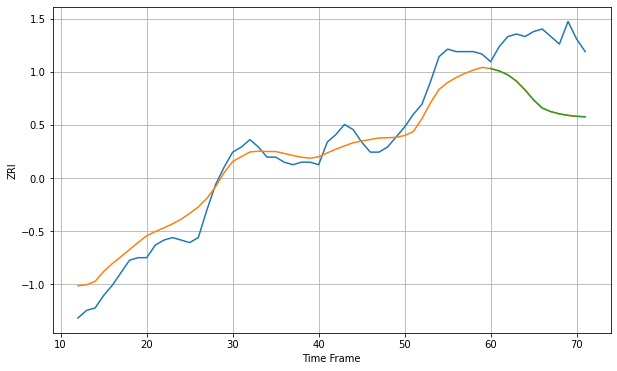

Wall time: 5.66 s
15202 6.892837385014892 25.12094308537604 25.05407366436679 [830.25762967 829.31147358 827.76952845 825.27240212 821.80559675
 817.81772878 814.59119217 813.15702654 812.25257694 811.64421931
 811.25537795 811.06545804]

Got an mse at 0.0097 in round 96 and stopped training

60 60 12


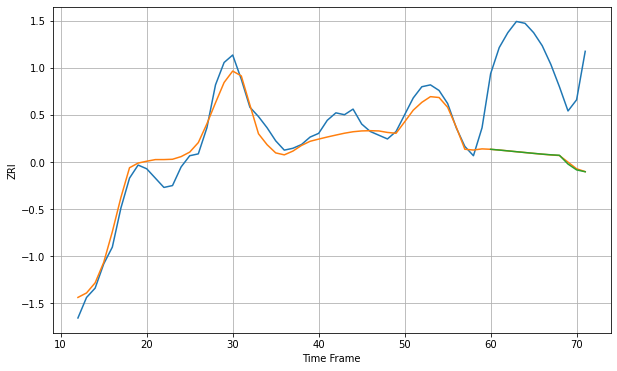

Wall time: 6.63 s
15206 6.810371498835423 54.73009083507633 54.79181095730747 [1053.45333822 1053.05077767 1052.6091928  1052.16260837 1051.72202809
 1051.28050094 1050.86110542 1050.50396579 1050.2394946  1045.53328131
 1042.4049957  1041.41296163]

Got an mse at 0.0100 in round 150 and stopped training

60 60 12


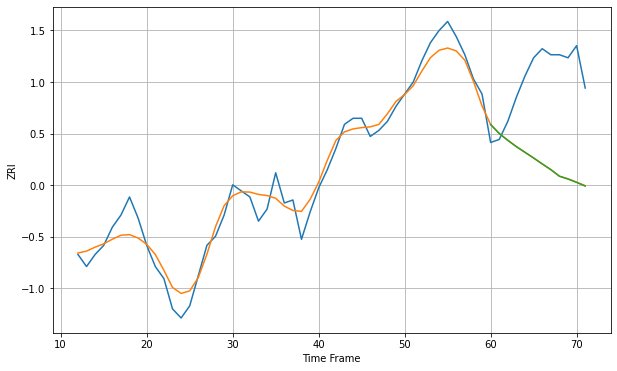

Wall time: 7.88 s
15210 4.686493840987162 30.635586822017594 30.66807060618821 [867.95072576 864.96636415 862.70832949 860.61697734 858.74522363
 856.86408213 854.92741206 853.03660346 850.84075749 849.916708
 848.802575   847.59129922]

Got an mse at 0.0100 in round 128 and stopped training

60 60 12


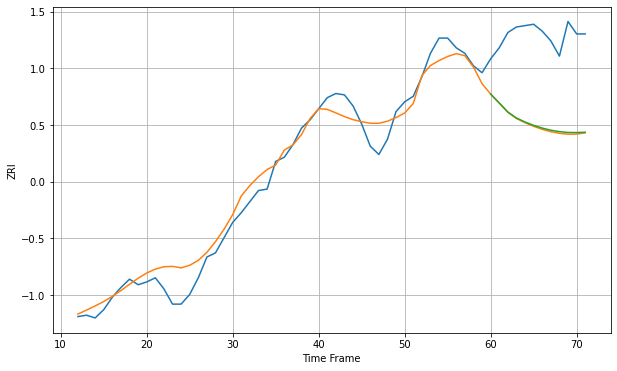

Wall time: 7.36 s
15212 10.78972578796855 64.28736966339825 63.604901203437755 [937.5983959  931.1616879  924.64827901 920.31465298 917.42897445
 915.02336041 913.04660726 911.51210375 910.48019822 909.88934435
 909.82655745 910.02665379]

Got an mse at 0.0098 in round 108 and stopped training

60 60 12


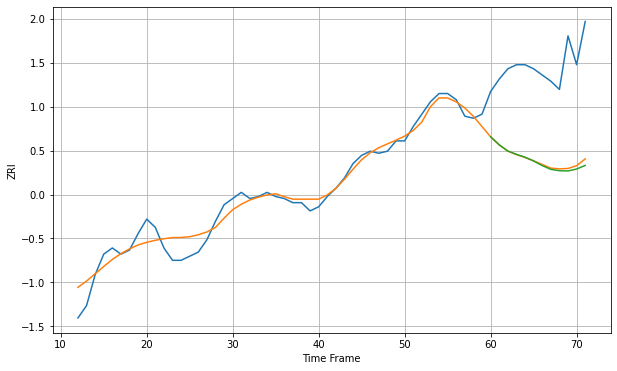

Wall time: 7.01 s
15216 5.332510780605843 45.823082186824884 46.63734399744026 [889.97590975 886.08161316 883.0858344  881.47811171 880.07626332
 878.2430645  876.01785343 874.17289186 873.51796249 873.39383434
 874.33852121 876.0724559 ]

Got an mse at 0.0100 in round 195 and stopped training

60 60 12


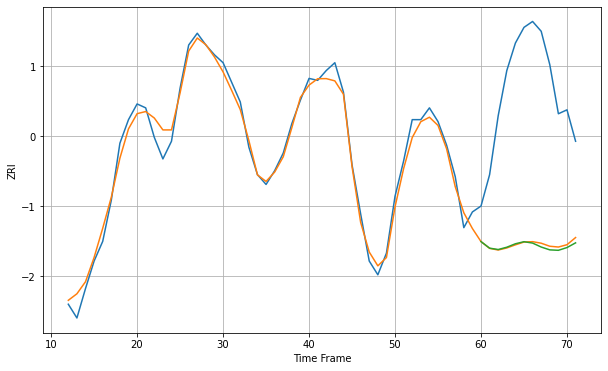

Wall time: 8.93 s
15217 5.142958236551012 82.4588479441468 83.15091773972762 [1165.89594292 1162.5509859  1161.85555914 1163.02849937 1164.78677324
 1165.84128465 1165.14289933 1163.12834998 1161.68279102 1161.46034993
 1162.86065878 1165.25562226]

Got an mse at 0.0100 in round 97 and stopped training

60 60 12


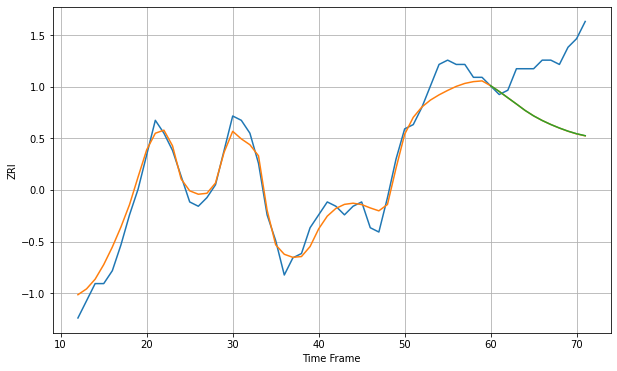

Wall time: 6.67 s
15221 3.1541129013485616 14.457045690405003 14.442786153968727 [898.04797027 896.70829325 895.24554182 893.79474135 892.30859599
 891.03161379 889.95322062 889.02402247 888.20124513 887.47359449
 886.87317403 886.41956204]

Got an mse at 0.0100 in round 262 and stopped training

60 60 12


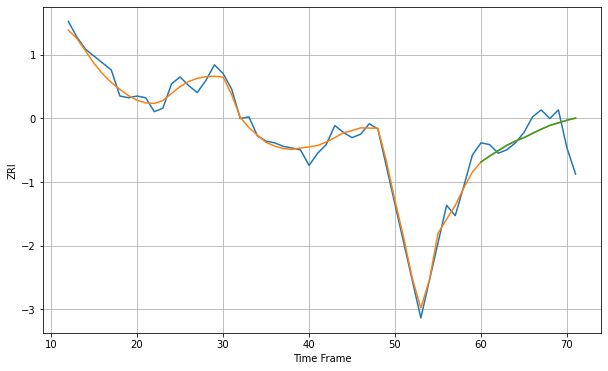

Wall time: 10.4 s
16365 4.462785488249157 12.116861198468587 12.169177981345674 [844.97903903 848.36526691 851.48213455 854.55940791 857.01217412
 858.99866077 861.48643565 863.84187048 866.06335935 867.51714576
 869.1050779  870.35629894]

Got an mse at 0.0099 in round 151 and stopped training

60 60 12


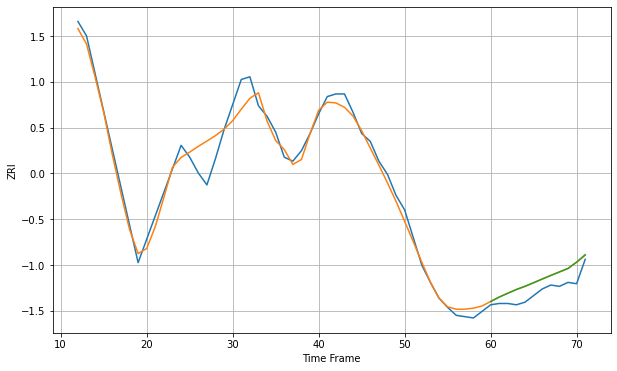

Wall time: 7.91 s
16502 8.992980000660678 9.484793940601694 9.523738054697594 [649.49657173 652.87391352 655.77354384 658.60847657 661.03363397
 663.74476592 666.56330734 669.27648014 671.93698387 674.58171462
 679.41232735 685.01739149]

Got an mse at 0.0098 in round 53 and stopped training

60 60 12


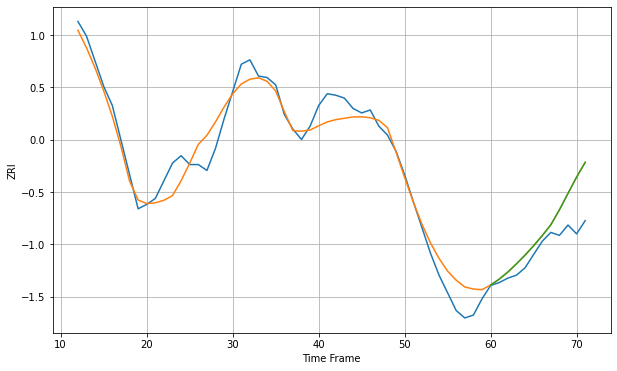

Wall time: 5.59 s
16503 10.714647693376062 18.34022788898246 18.340050157585424 [606.32977842 610.31585701 615.14536785 620.64219039 626.58689744
 632.96723556 639.78264522 647.15262034 657.31819348 668.41419782
 679.51791948 689.53367878]

Got an mse at 0.0099 in round 94 and stopped training

60 60 12


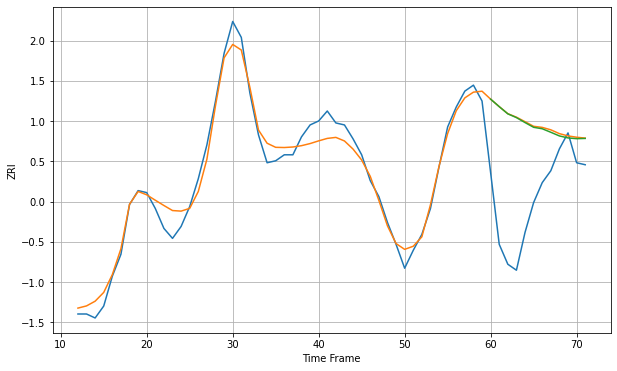

Wall time: 6.56 s
17013 6.022644809201783 44.67998781573697 44.43895539108335 [1025.95281613 1022.19007571 1018.57481733 1016.68807376 1014.19658817
 1011.81226537 1011.0851639  1009.31124833 1007.47639574 1006.47676911
 1006.09781675 1006.22230944]

Got an mse at 0.0099 in round 36 and stopped training

60 60 12


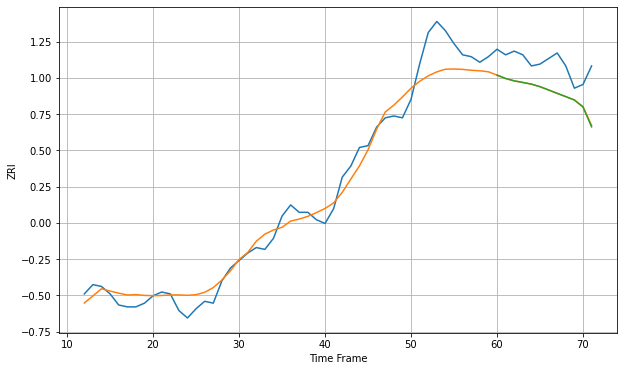

Wall time: 5.21 s
17022 8.574376995509827 16.67033072394669 16.802969786240364 [875.04220361 873.24426072 871.94339344 871.09280868 870.19235627
 868.80723652 867.03856751 865.23332419 863.4452508  861.62480132
 857.81262519 847.12230417]

Got an mse at 0.0099 in round 268 and stopped training

60 60 12


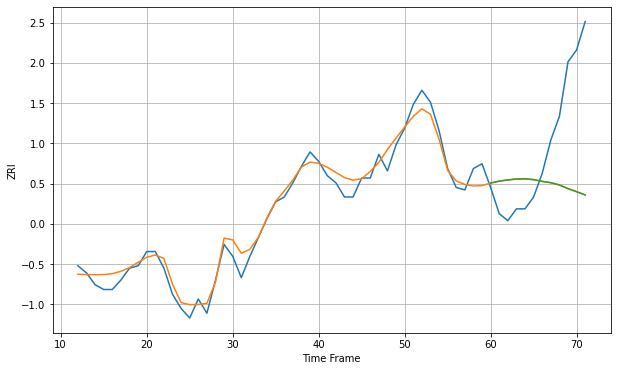

Wall time: 10.7 s
17401 4.488584829816718 33.930081319299205 33.918205727344656 [811.89425592 812.6794458  813.21046398 813.56806501 813.65028032
 813.32252121 812.58801825 812.0333649  811.07224422 809.54895719
 808.23828748 806.87625169]

Got an mse at 0.0099 in round 179 and stopped training

60 60 12


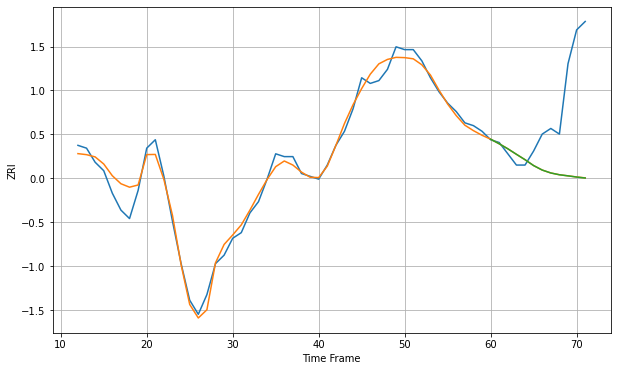

Wall time: 8.38 s
17404 3.3536180337203194 25.932629941962393 25.94784419927936 [857.18229792 855.55421136 853.77623422 851.81936031 849.90380539
 847.813028   846.22588899 845.19054011 844.55708839 844.16499411
 843.74368114 843.39677524]

Got an mse at 0.0099 in round 93 and stopped training

60 60 12


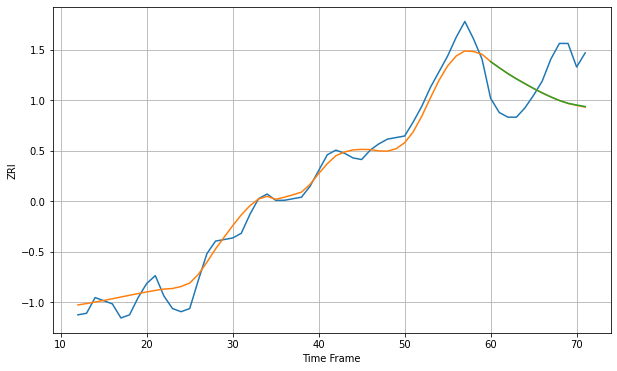

Wall time: 6.39 s
17512 7.384636548756428 26.160211512004143 26.0686239462531 [1035.39884939 1031.50923434 1027.79489365 1024.41315832 1021.31848906
 1018.28197359 1015.46755737 1012.90998838 1010.64226286 1008.8466352
 1007.76434308 1006.77942538]

Got an mse at 0.0099 in round 69 and stopped training

60 60 12


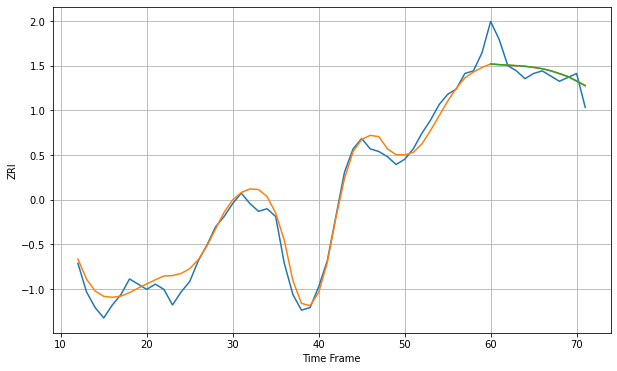

Wall time: 6.24 s
17522 4.215902776912986 6.354561451182259 6.33532820765487 [853.66987783 853.39992725 853.21902331 853.00504062 852.77595337
 852.34731112 851.82674313 851.02614025 849.94074714 848.77843883
 847.06952726 845.26514459]

Got an mse at 0.0099 in round 69 and stopped training

60 60 12


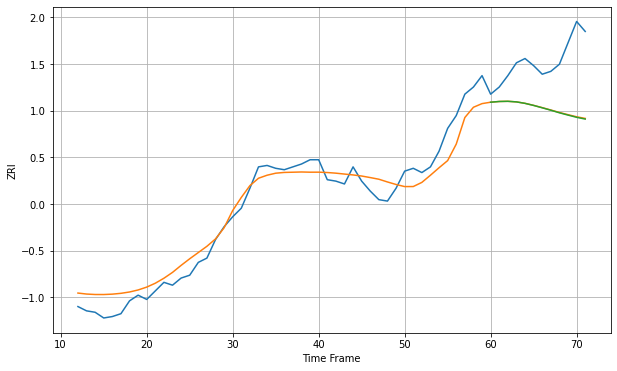

Wall time: 5.86 s
17543 10.18606438179209 36.66746892759631 36.861280319118954 [1099.36123972 1099.86488093 1099.98900483 1099.58049475 1098.54510825
 1097.08984922 1095.43974776 1093.738317   1091.93222259 1090.3209649
 1088.76611938 1087.53243105]

Got an mse at 0.0099 in round 86 and stopped training

60 60 12


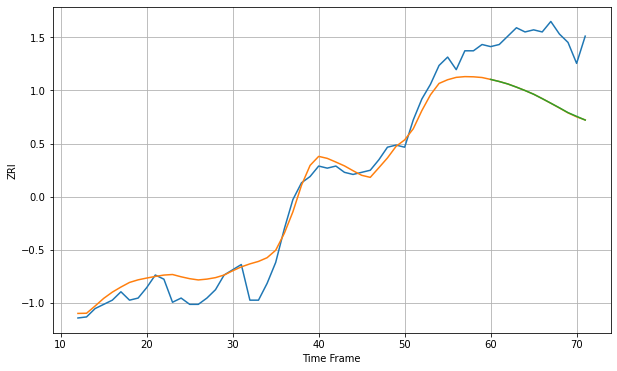

Wall time: 6.57 s
17552 7.558218138470568 29.95343223434188 29.92206560440514 [964.34485495 963.3453678  962.16942347 960.66409512 959.04099919
 957.28790675 955.18256791 953.00464649 950.79395125 948.49720337
 946.72052308 944.94813858]

Got an mse at 0.0099 in round 54 and stopped training

60 60 12


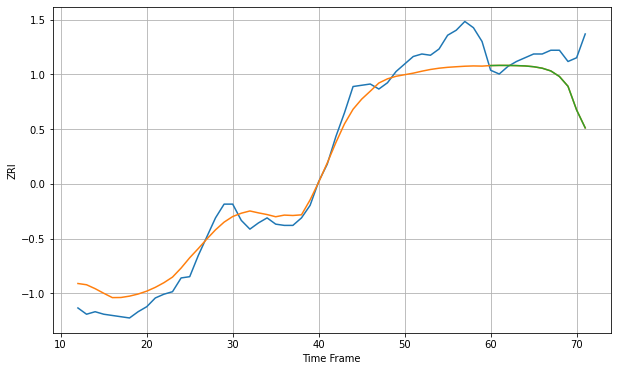

Wall time: 5.91 s
17602 14.237330203325653 27.120196666927498 27.127099985759834 [1072.75488078 1072.87998997 1072.8491     1072.73285856 1072.45632685
 1071.82626849 1070.64741236 1068.45771749 1064.02951443 1056.16660288
 1037.24441752 1022.95188433]

Got an mse at 0.0098 in round 47 and stopped training

60 60 12


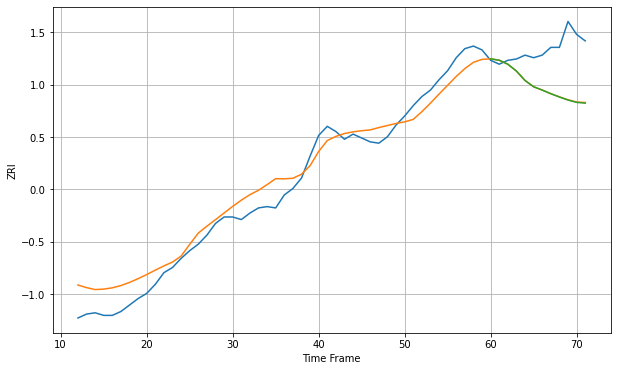

Wall time: 5.56 s
17603 12.435315776890826 33.06127388881044 33.196997619720705 [1137.11125569 1136.07362396 1132.97832285 1127.69596038 1120.41174466
 1115.55931973 1113.01133568 1110.19508045 1107.66130741 1105.30965382
 1103.50420547 1102.92231272]

Got an mse at 0.0099 in round 108 and stopped training

60 60 12


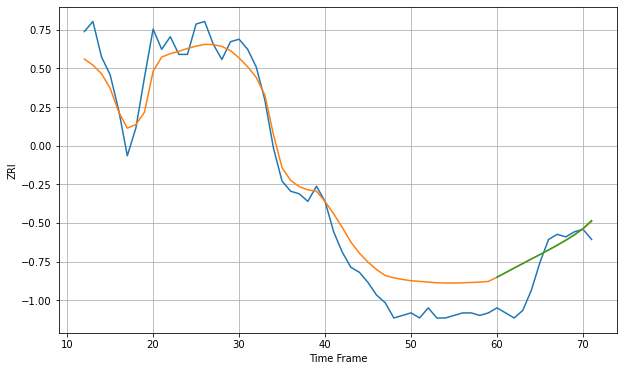

Wall time: 7.07 s
17701 9.388739114361915 10.716545895735019 10.736605058494634 [779.09040728 780.89769628 782.72005233 784.47645007 786.2845546
 788.02705492 789.84566115 791.71505162 793.69155239 795.8582065
 798.31997361 801.43714487]

Got an mse at 0.0100 in round 55 and stopped training

60 60 12


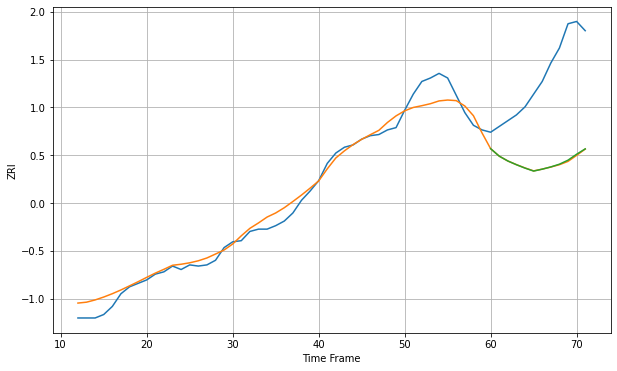

Wall time: 6.09 s
18018 9.108714064126055 78.28679711614997 77.9758086289432 [1072.72371201 1066.26844539 1062.07232572 1058.84125001 1055.89917758
 1053.33684358 1054.98316218 1056.92087378 1059.28887306 1062.77600851
 1067.91544295 1072.56175304]

Got an mse at 0.0100 in round 77 and stopped training

60 60 12


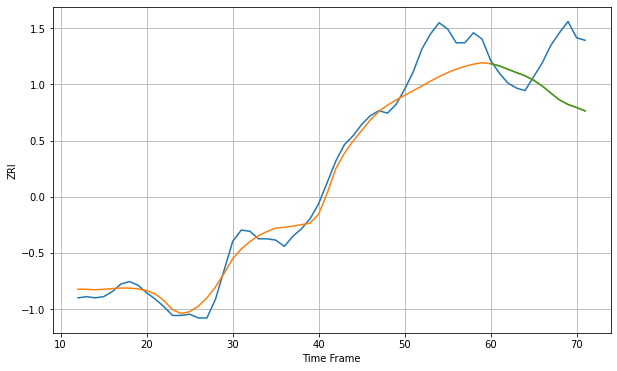

Wall time: 6.37 s
18042 13.939508151796538 36.150287744090555 36.161704324404475 [1127.43256342 1125.64729502 1122.99727314 1120.30125006 1117.78022883
 1114.26228794 1109.65428107 1104.02829625 1098.63734612 1094.94700736
 1092.46856433 1089.76579054]

Got an mse at 0.0100 in round 132 and stopped training

60 60 12


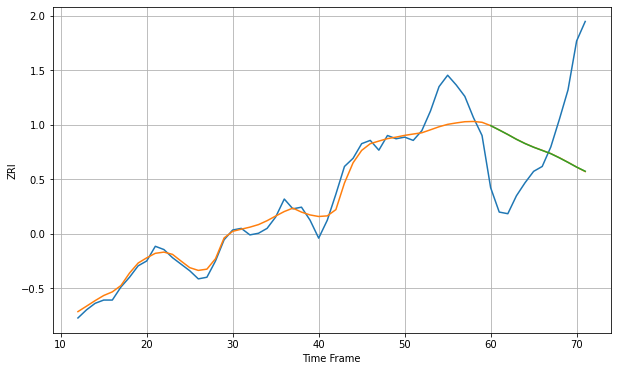

Wall time: 7.64 s
18102 8.257620415350674 46.07649098725003 46.05131903972814 [1095.07347528 1092.37790245 1089.60150196 1086.67243845 1084.06792762
 1081.80788805 1079.84643877 1077.85315413 1075.27339225 1072.49840929
 1069.6166691  1067.06159399]

Got an mse at 0.0100 in round 245 and stopped training

60 60 12


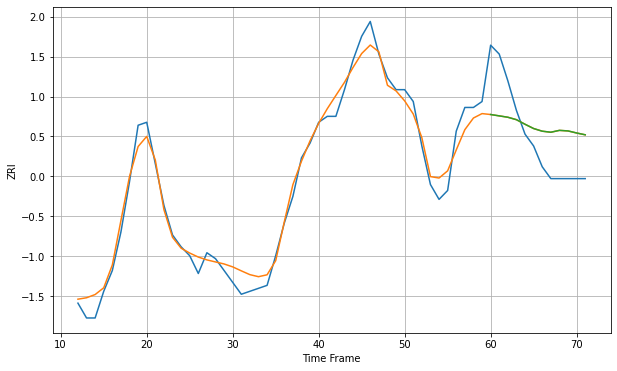

Wall time: 10.3 s
18232 4.249093756844569 14.587218079752782 14.594620340018736 [779.61608726 779.15597673 778.69571166 777.8724999  776.32925771
 774.88937583 773.99755042 773.64177277 774.27658845 774.08707189
 773.39517431 772.78074027]

Got an mse at 0.0100 in round 86 and stopped training

60 60 12


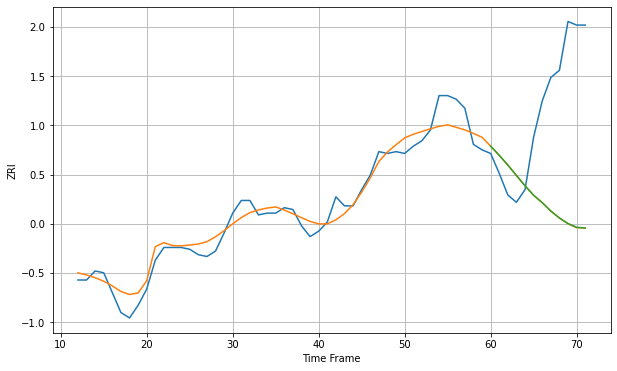

Wall time: 6.51 s
18951 7.05877316895589 67.46802421121096 67.41023524928808 [1359.04952227 1353.97851457 1348.57344306 1342.80648973 1337.12955722
 1331.86200334 1327.79607074 1323.16625359 1319.30295326 1316.2181412
 1314.15956427 1313.77596881]

Got an mse at 0.0097 in round 58 and stopped training

60 60 12


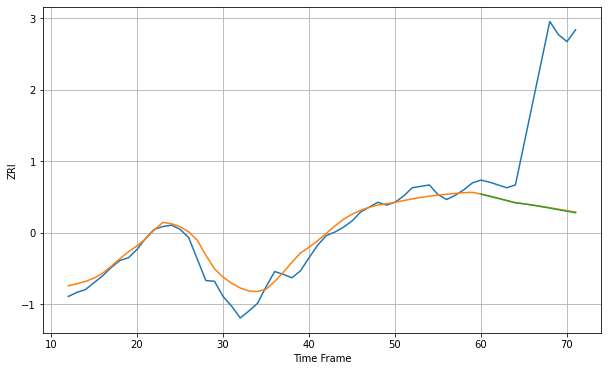

Wall time: 5.84 s
19007 15.270157320795178 168.0919679663732 168.51199557055304 [1229.83106927 1226.80347808 1223.71723057 1220.48063125 1217.31227137
 1215.74333028 1213.85851407 1211.80888157 1209.62049422 1207.33235993
 1205.08000345 1202.91716451]

Got an mse at 0.0100 in round 236 and stopped training

60 60 12


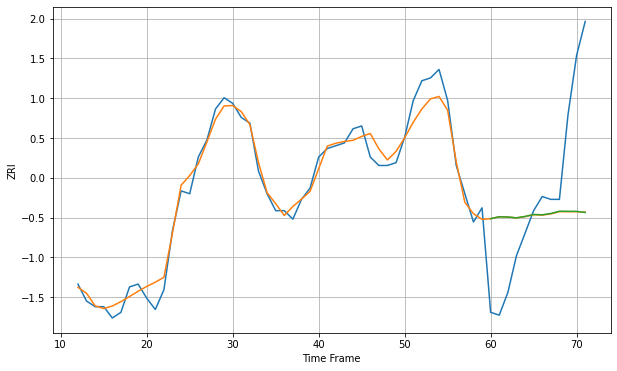

Wall time: 10.1 s
19103 4.170577488996405 31.81599180293032 31.792936774828245 [1679.15594975 1679.84306259 1679.75306527 1679.45636655 1679.94860547
 1680.65335072 1680.54062369 1681.00168346 1681.80616513 1681.77335086
 1681.75604113 1681.36509191]

Got an mse at 0.0099 in round 128 and stopped training

60 60 12


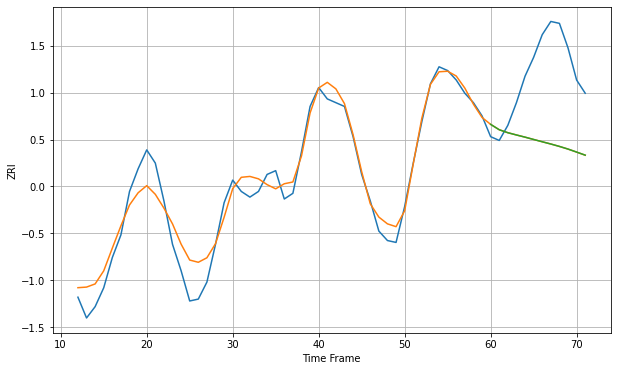

Wall time: 7.49 s
19104 8.739093570936273 41.221495578579216 41.214006474349844 [1276.5182074  1273.66475284 1272.09585714 1270.90062785 1269.74908241
 1268.51879301 1267.30258395 1266.11517911 1264.83873684 1263.43623987
 1261.84751502 1260.21476091]

Got an mse at 0.0098 in round 93 and stopped training

60 60 12


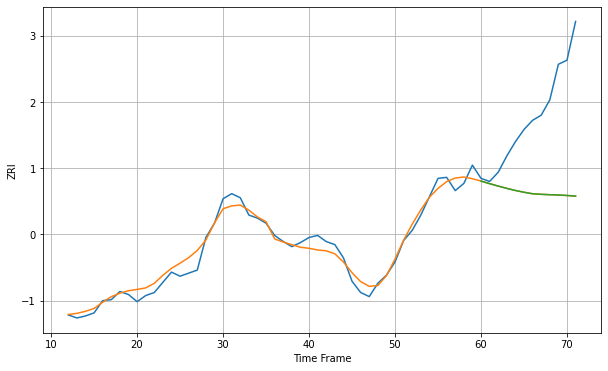

Wall time: 6.71 s
19106 7.773965314403574 86.94211140027512 86.89828510407054 [1763.33810191 1760.81222258 1758.43114568 1756.19207095 1754.12819277
 1752.3743942  1750.89395599 1750.33838542 1749.98839132 1749.69899508
 1749.26282527 1748.66256897]

Got an mse at 0.0098 in round 140 and stopped training

60 60 12


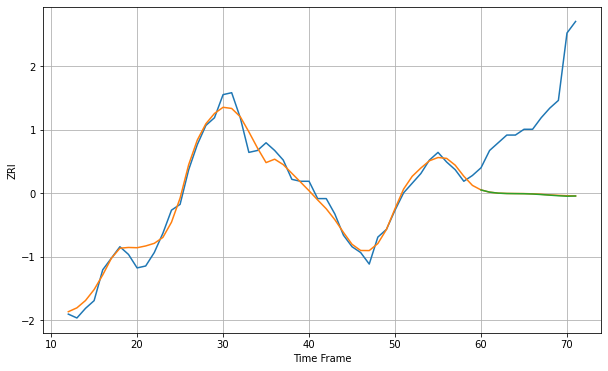

Wall time: 7.74 s
19107 4.52529845648437 47.224284310452106 47.32105541013636 [1559.49585779 1558.35143386 1557.82707913 1557.64362402 1557.58232716
 1557.53321378 1557.3843297  1557.10964637 1556.78656344 1556.48534441
 1556.24444997 1556.34749346]

Got an mse at 0.0100 in round 135 and stopped training

60 60 12


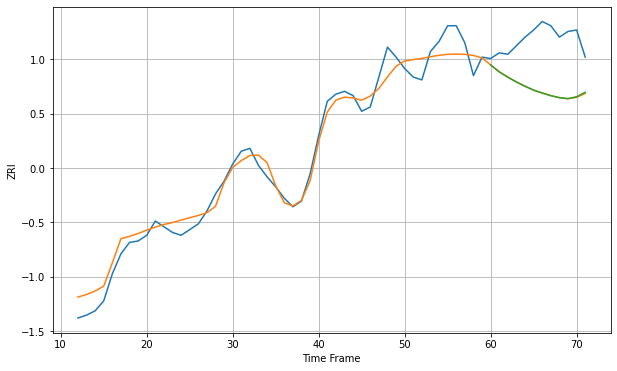

Wall time: 7.35 s
19120 9.04469403971728 36.39134858290735 36.31062774877417 [983.49694889 978.66031538 974.91606263 971.53782636 968.55509878
 965.81495742 963.81006995 961.95958795 960.53374845 959.85147794
 961.19207918 964.3234315 ]

Got an mse at 0.0099 in round 440 and stopped training

60 60 12


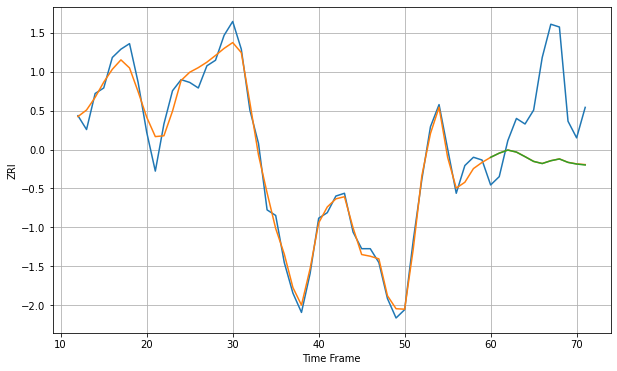

Wall time: 14.3 s
19121 4.131804926608622 25.330930242172798 25.350021052682823 [1345.97724154 1347.48349356 1348.59800879 1347.8629438  1346.21269391
 1344.49506279 1343.73612355 1344.74395334 1345.38612395 1344.14169743
 1343.55007271 1343.20868004]

Got an mse at 0.0099 in round 140 and stopped training

60 60 12


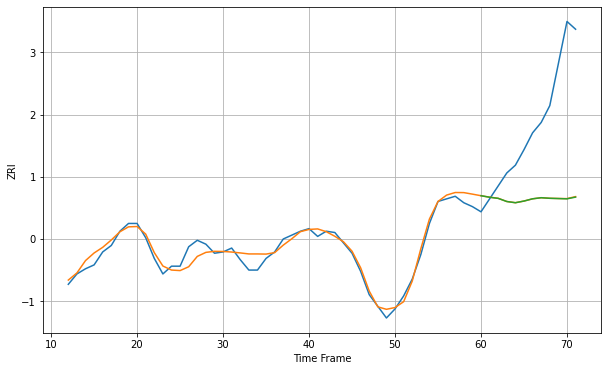

Wall time: 7.47 s
19123 5.4415857564045815 71.02620086464093 71.11963385415143 [1552.42026474 1551.24365867 1550.36992528 1547.94120447 1547.01961802
 1548.30812578 1550.03955997 1550.87894185 1550.42395842 1550.22642861
 1550.01217843 1551.35129223]

Got an mse at 0.0099 in round 196 and stopped training

60 60 12


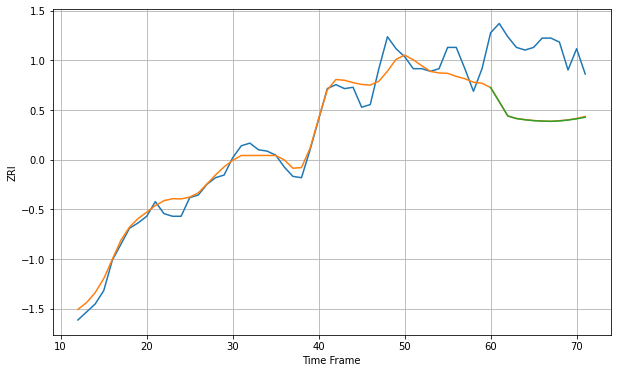

Wall time: 8.72 s
19124 8.696348715931677 53.07725961160972 53.19137073623231 [952.78426394 942.18375353 931.40781796 929.46651709 928.5822156
 927.90726841 927.56277404 927.36893587 927.70394064 928.3429732
 929.28393267 930.44597267]

Got an mse at 0.0098 in round 95 and stopped training

60 60 12


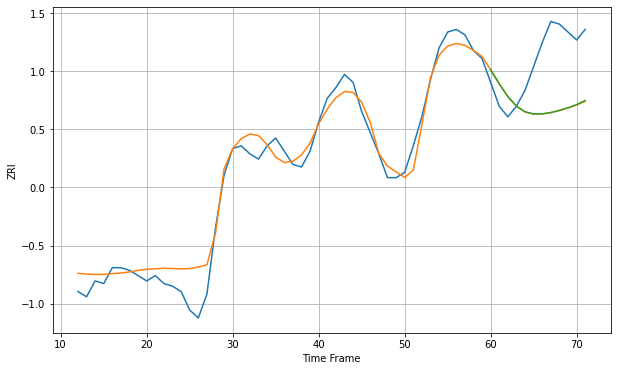

Wall time: 6.8 s
19128 5.850335090065248 21.764929317978925 21.680848583311967 [1252.74857922 1247.47428578 1242.62492416 1239.02245163 1236.87347376
 1236.0657905  1236.10157718 1236.60589898 1237.4114769  1238.43304318
 1239.60513143 1241.15116873]

Got an mse at 0.0100 in round 87 and stopped training

60 60 12


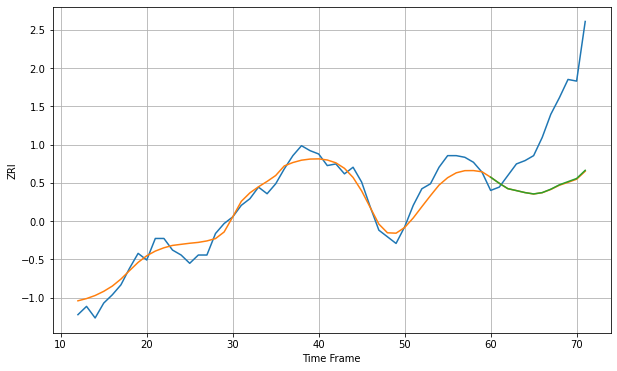

Wall time: 6.28 s
19130 6.375848005922543 43.59917026302629 43.362642678523386 [1523.98593073 1520.3201449  1517.06450155 1515.89933036 1514.68645928
 1513.88120379 1514.67747412 1516.752278   1519.40096339 1521.30103637
 1523.19793182 1528.1327599 ]

Got an mse at 0.0099 in round 91 and stopped training

60 60 12


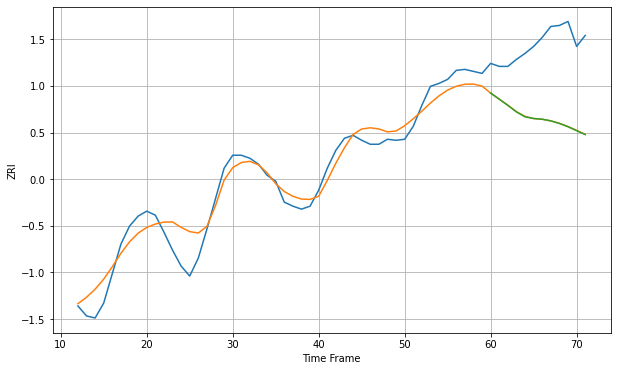

Wall time: 6.96 s
19131 15.422481412771932 75.62663603241705 75.77063034680646 [1139.2562765  1133.15104521 1126.94651884 1120.42559168 1115.44643844
 1113.86530938 1113.06967285 1111.43351174 1108.86151281 1105.5238658
 1101.61339822 1097.67260571]

Got an mse at 0.0097 in round 75 and stopped training

60 60 12


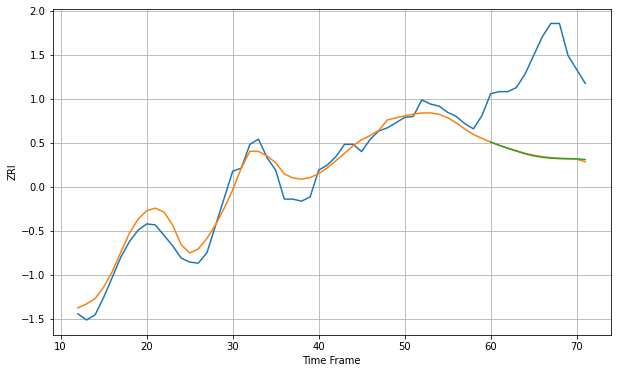

Wall time: 6.5 s
19139 11.686673665925623 90.0573118828649 90.2201974218985 [1097.21746454 1094.06035491 1091.13463358 1088.44217178 1085.86596941
 1083.8911623  1082.48080251 1081.63568125 1081.15664237 1080.98473797
 1081.00020247 1080.28646391]

Got an mse at 0.0099 in round 191 and stopped training

60 60 12


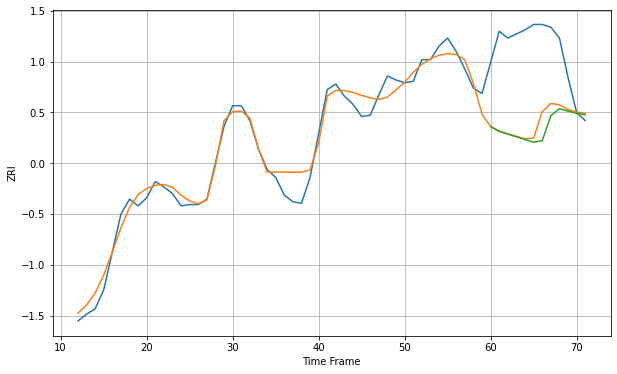

Wall time: 9.37 s
19140 8.572797447098836 59.37561386555812 63.03097372588835 [971.57307247 968.08803697 965.97358156 964.11173799 961.95813792
 959.99777798 961.16163964 979.5467249  984.78769633 983.0287872
 981.36797214 980.37728974]

Got an mse at 0.0100 in round 140 and stopped training

60 60 12


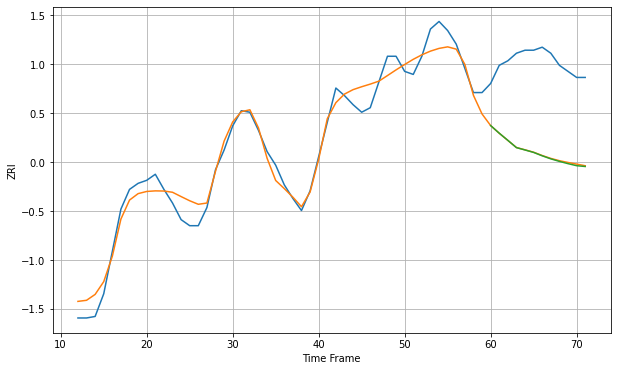

Wall time: 7.64 s
19141 8.861060975248217 59.55989737026012 59.866071118691224 [947.18724437 942.13933073 937.42650631 932.61014107 931.05052856
 929.43532917 927.18950197 925.18155698 923.50807038 922.00798845
 920.67153738 920.12962034]

Got an mse at 0.0100 in round 105 and stopped training

60 60 12


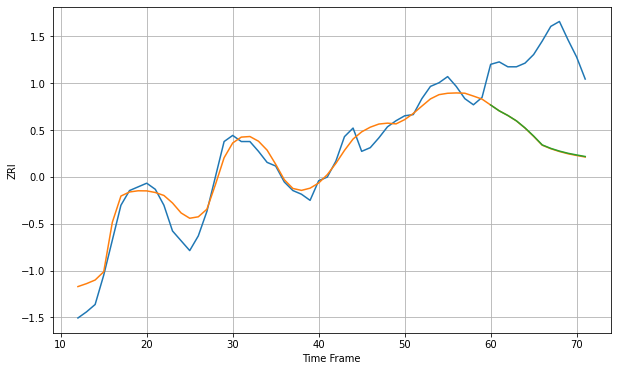

Wall time: 6.88 s
19143 11.140744577245776 71.36347908304269 71.11792121517406 [1114.83240766 1110.04864612 1106.28427772 1101.89109993 1096.12400483
 1089.4974338  1082.25011536 1079.39830184 1077.20266129 1075.4264535
 1074.04433568 1072.78116539]

Got an mse at 0.0099 in round 125 and stopped training

60 60 12


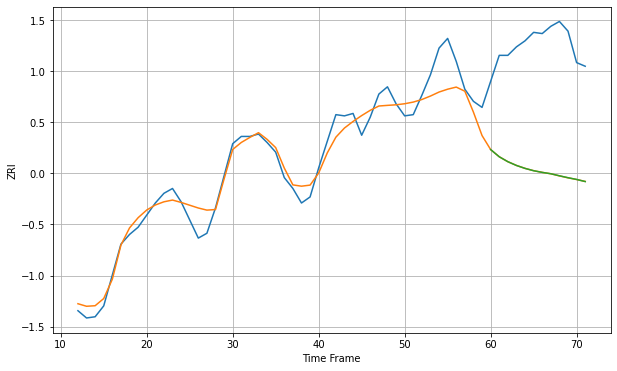

Wall time: 7.6 s
19144 12.907236715827363 103.69745845814528 103.68913130728217 [1025.14964819 1019.20754907 1015.1322282  1012.02165642 1009.59705036
 1007.67635977 1006.29631972 1005.17955109 1003.48109235 1001.90295063
 1000.46389584  998.7184479 ]

Got an mse at 0.0099 in round 233 and stopped training

60 60 12


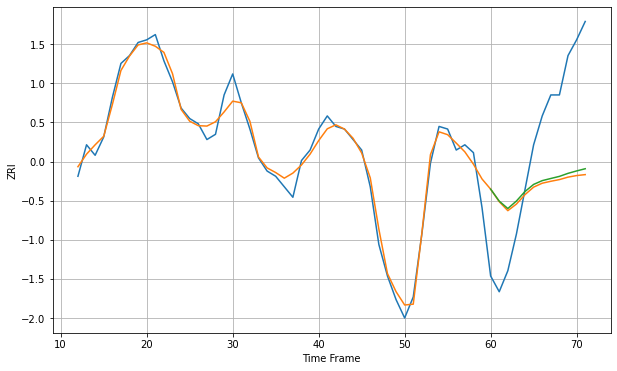

Wall time: 10.1 s
19146 3.8678133301342315 34.40072967034512 33.51909391779696 [1486.09506592 1481.52874202 1478.70844381 1481.57449397 1485.20559616
 1487.90009891 1489.34079041 1490.16001495 1490.96190681 1492.11620588
 1493.03790845 1493.87512038]

Got an mse at 0.0100 in round 307 and stopped training

60 60 12


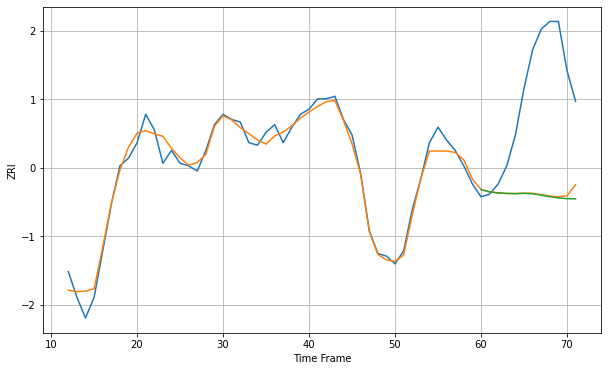

Wall time: 12.2 s
19147 3.608870483541686 42.944753118083746 43.55808558890484 [1423.81638166 1422.89493663 1422.52961166 1422.29543054 1422.23596579
 1422.33053546 1422.20401936 1421.62208466 1421.0282901  1420.59117517
 1420.26981415 1420.19270655]

Got an mse at 0.0098 in round 172 and stopped training

60 60 12


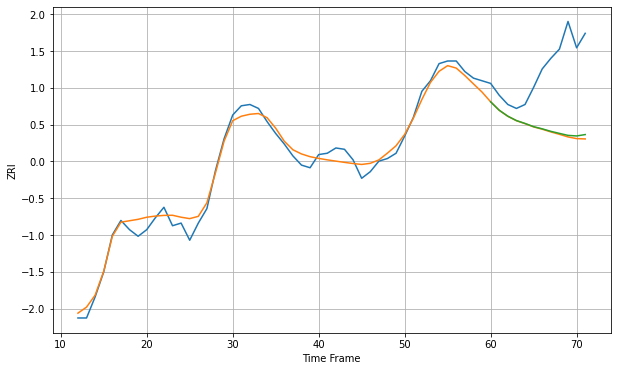

Wall time: 8.58 s
19148 6.180486975382835 49.864419144275956 48.863711875674106 [1243.02034623 1236.6345565  1232.12006061 1228.79970845 1226.60784703
 1224.17139284 1222.52229237 1220.62991927 1219.07442988 1217.56686975
 1217.1188642  1218.17131463]

Got an mse at 0.0096 in round 118 and stopped training

60 60 12


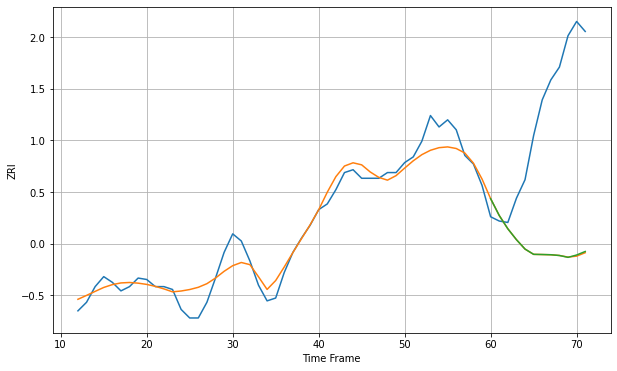

Wall time: 7.46 s
19401 9.586546451314073 104.06424891556661 103.87134706194217 [1203.6924936  1191.88913509 1182.57016594 1174.93348499 1168.34130587
 1164.63639751 1164.519034   1164.36767091 1163.83268921 1162.5305283
 1164.17334822 1166.63589461]

Got an mse at 0.0100 in round 176 and stopped training

60 60 12


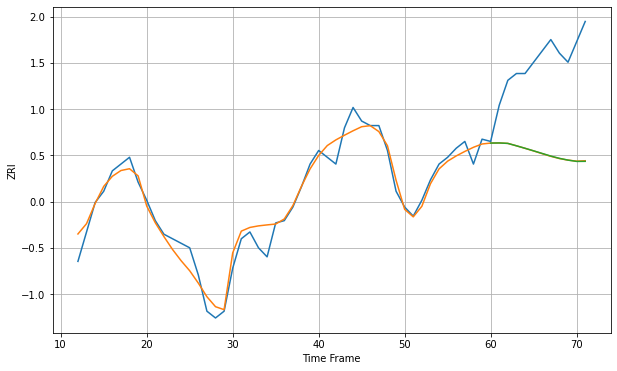

Wall time: 8.55 s
19464 5.1169758977122495 40.858889272838816 40.8670513678388 [1100.27363981 1100.32168648 1100.12818218 1099.07307272 1097.97725534
 1096.84408039 1095.68188906 1094.52929014 1093.5275061  1092.75067032
 1092.16907561 1092.20539378]

Got an mse at 0.0100 in round 130 and stopped training

60 60 12


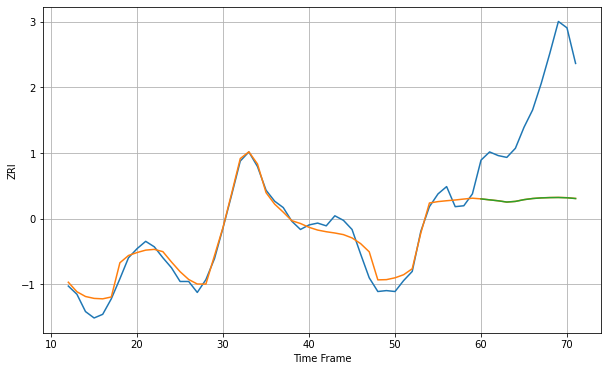

Wall time: 7.32 s
20001 9.889041748148717 116.51884632641212 116.57750272808303 [2305.52689383 2304.48057837 2303.44137139 2302.05314019 2302.76565797
 2304.6841882  2305.92042907 2306.61061722 2306.92937692 2307.05236499
 2306.73520734 2305.90948432]

Got an mse at 0.0098 in round 41 and stopped training

60 60 12


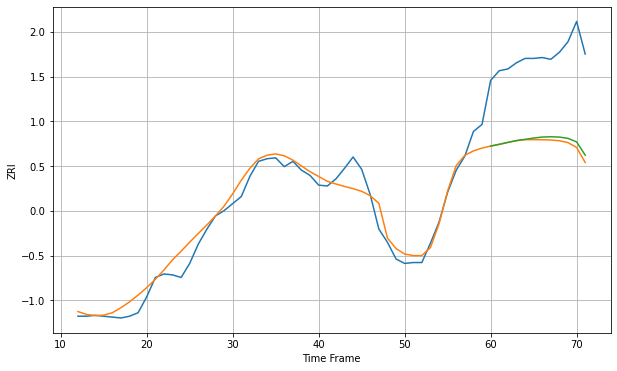

Wall time: 5.22 s
20002 13.534660112473562 100.2351698048395 97.13637464458023 [2126.38354158 2128.35271074 2130.57102085 2132.6147406  2134.0408104
 2135.48680153 2136.62910088 2136.96022266 2136.59011733 2135.14687662
 2131.10187669 2116.02971675]

Got an mse at 0.0100 in round 138 and stopped training

60 60 12


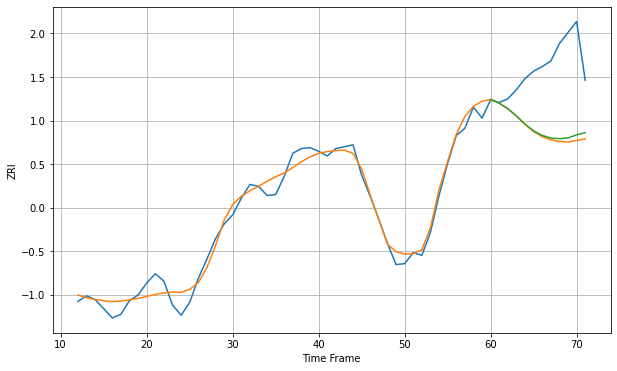

Wall time: 7.49 s
20003 10.399179496511582 74.72170710679568 72.06029143533284 [2321.26485449 2317.28199196 2311.18680445 2303.37084887 2294.52671322
 2287.23621168 2282.24856411 2279.42928795 2278.71090538 2279.54700358
 2282.86618163 2285.15609179]

Got an mse at 0.0099 in round 130 and stopped training

60 60 12


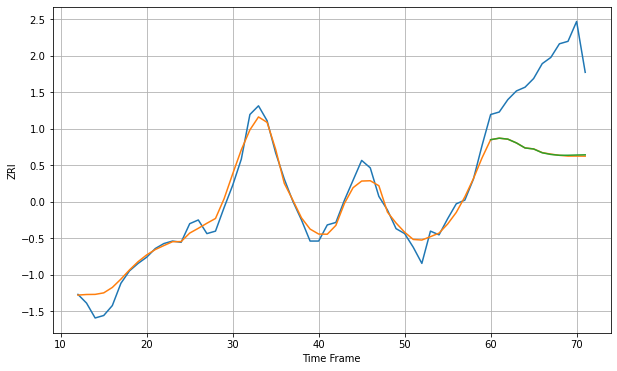

Wall time: 7.34 s
20005 7.913512101710106 66.72363404822582 66.48374023812634 [2274.69590982 2275.91541422 2275.14641089 2272.09898418 2268.05076391
 2267.21453402 2264.15599544 2262.81081417 2262.13394852 2262.16079202
 2262.35531761 2262.51361883]

Got an mse at 0.0097 in round 299 and stopped training

60 60 12


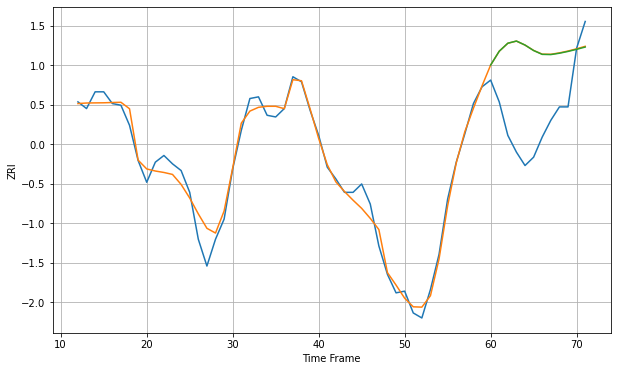

Wall time: 11.4 s
20007 6.50320342548871 44.732469378124804 44.69690316755145 [2177.97468281 2186.23217281 2191.01671812 2192.31292647 2189.9182744
 2186.64600753 2184.35665257 2184.23551015 2185.039142   2186.11018114
 2187.36303445 2188.72807079]

Got an mse at 0.0099 in round 185 and stopped training

60 60 12


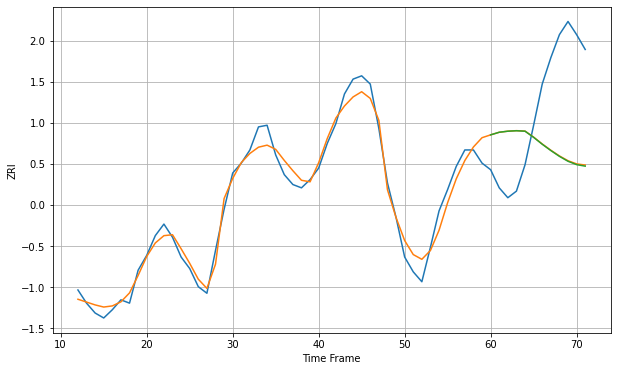

Wall time: 8.65 s
20008 6.848080930739923 52.5660073628407 52.79472047129773 [2066.16273195 2067.74229916 2068.37796115 2068.66338905 2068.37738829
 2064.66019458 2060.47354114 2056.64335689 2053.11497069 2050.12383858
 2048.08675787 2047.17078243]

Got an mse at 0.0100 in round 88 and stopped training

60 60 12


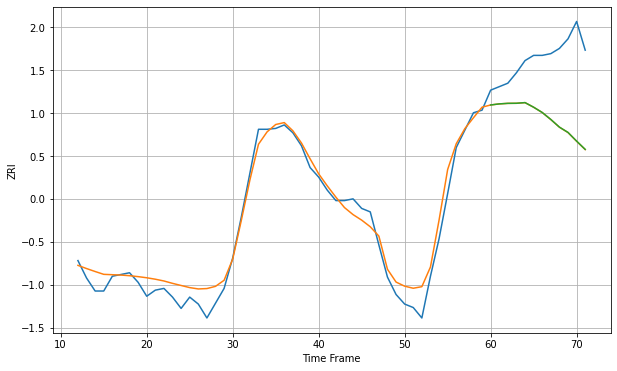

Wall time: 6.25 s
20009 14.568641588460482 76.535012056828 76.43566705439143 [2329.95504492 2331.20515217 2331.82743642 2331.92108748 2332.68863088
 2327.39644046 2321.33286319 2313.29211182 2304.49000271 2298.3838253
 2288.4116436  2278.8738255 ]

Got an mse at 0.0100 in round 280 and stopped training

60 60 12


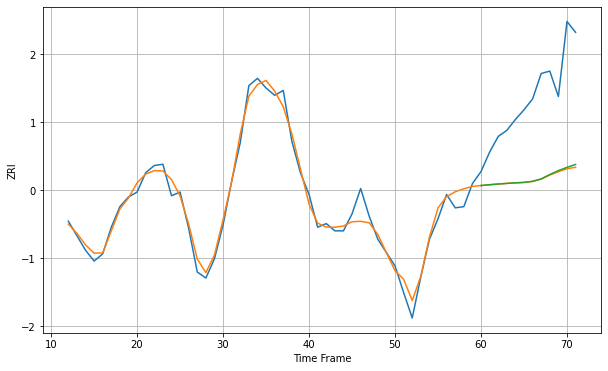

Wall time: 10.9 s
20010 7.574106539920536 71.52495882473563 70.9373120565521 [2126.42824553 2127.09744654 2127.67670243 2128.18849726 2128.66386333
 2128.9994377  2129.9238183  2131.91389892 2135.51112276 2138.78152505
 2141.45762398 2143.83134106]

Got an mse at 0.0100 in round 90 and stopped training

60 60 12


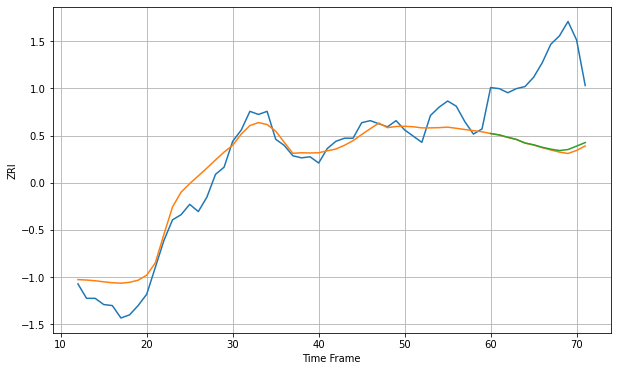

Wall time: 6.72 s
20011 15.229231785060202 79.90812521013025 78.41654356739306 [1892.53928045 1891.15714412 1888.86811242 1886.79787499 1883.38843392
 1881.62773567 1879.22976459 1877.39715005 1876.05898512 1877.03143093
 1880.38679201 1883.77361538]

Got an mse at 0.0100 in round 239 and stopped training

60 60 12


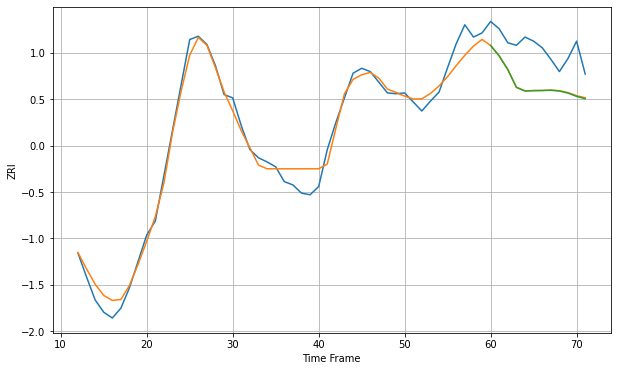

Wall time: 10 s
20019 13.572710381041077 45.791792184721594 46.080859398585616 [1681.73226448 1668.96352359 1652.35200958 1630.74698571 1626.36329519
 1626.7907979  1626.89703166 1627.25271596 1626.31272201 1623.81454694
 1619.7455252  1616.93657372]

Got an mse at 0.0099 in round 112 and stopped training

60 60 12


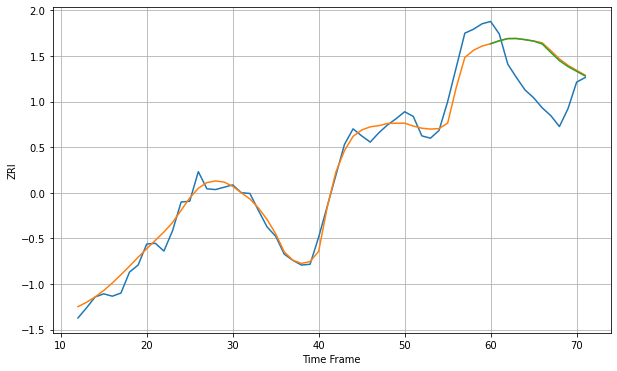

Wall time: 7.05 s
20020 13.453486337021467 56.89933092602379 55.96246539161909 [1649.41086177 1653.194262   1656.02001926 1656.10648303 1654.63321876
 1652.83036241 1649.05075425 1638.13215673 1627.70055326 1620.00195753
 1613.97060653 1607.91532254]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


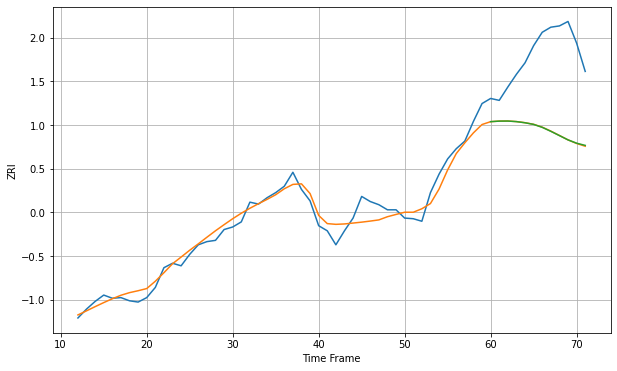

Wall time: 5.82 s
20024 15.014578993304553 124.76513140768797 124.73411853925326 [2311.5306991  2312.36696307 2312.47636265 2311.58820243 2309.77817132
 2307.21338555 2302.59505545 2296.36016021 2289.62359759 2282.89477694
 2277.7098699  2274.23862711]

Got an mse at 0.0099 in round 135 and stopped training

60 60 12


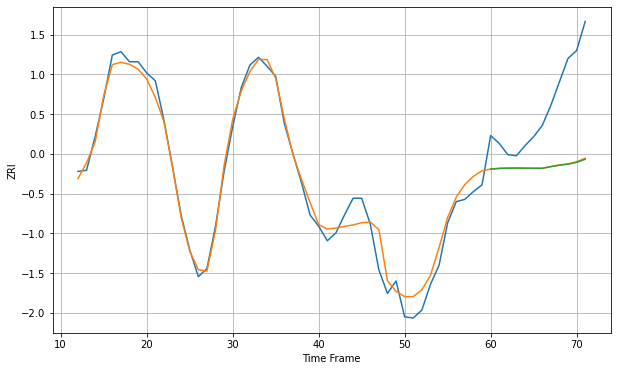

Wall time: 7.65 s
20037 10.83546203335131 62.29372296913705 62.53725078434733 [2390.05861934 2390.70468502 2390.90817944 2390.96741202 2390.87022172
 2390.77494075 2390.76457397 2392.27993341 2393.58188502 2394.52610789
 2396.06020967 2398.87418587]

Got an mse at 0.0099 in round 48 and stopped training

60 60 12


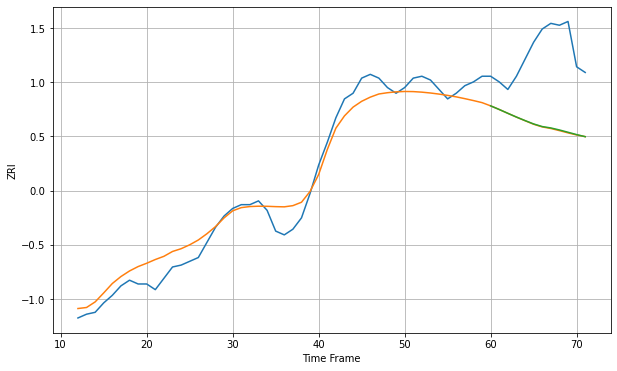

Wall time: 5.78 s
20109 7.6977758696327365 39.655301306039796 39.483887736625476 [1444.31421955 1442.39139607 1440.36936384 1438.3874996  1436.52407581
 1434.73687285 1433.35282518 1432.6182449  1431.55516357 1430.33523986
 1429.1029953  1427.99399575]

Got an mse at 0.0098 in round 106 and stopped training

60 60 12


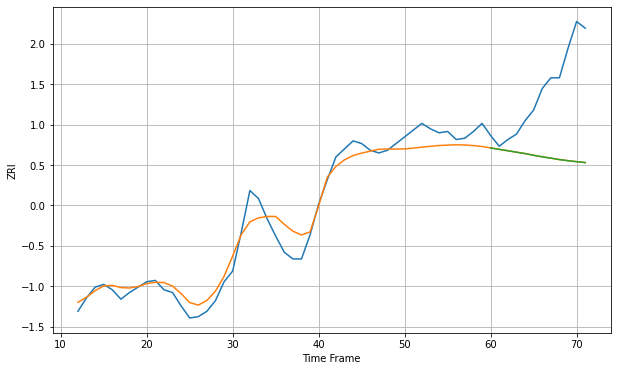

Wall time: 7.12 s
20110 9.804504228542864 57.67970487356114 57.69408358371274 [1394.72982789 1393.68320258 1392.65310595 1391.5796839  1390.53232203
 1389.26081398 1388.10660813 1387.14341117 1386.05387554 1385.22045279
 1384.48699524 1383.82091576]

Got an mse at 0.0099 in round 95 and stopped training

60 60 12


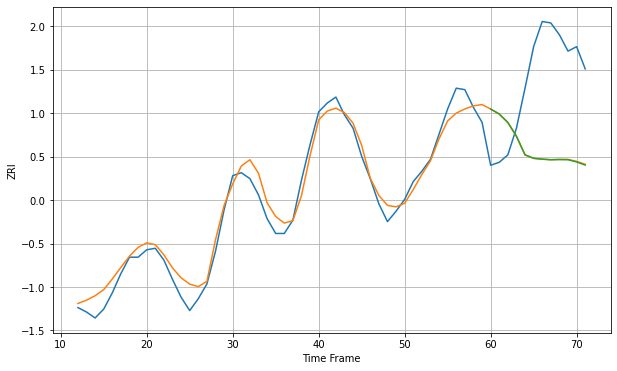

Wall time: 6.51 s
20147 8.277381655431894 64.77554431129181 64.90223025291202 [1630.93590342 1627.59462278 1621.91020192 1612.66507046 1600.06094554
 1597.70162814 1597.10209151 1596.71867613 1596.84003108 1596.73374577
 1595.25330721 1593.13927919]

Got an mse at 0.0098 in round 52 and stopped training

60 60 12


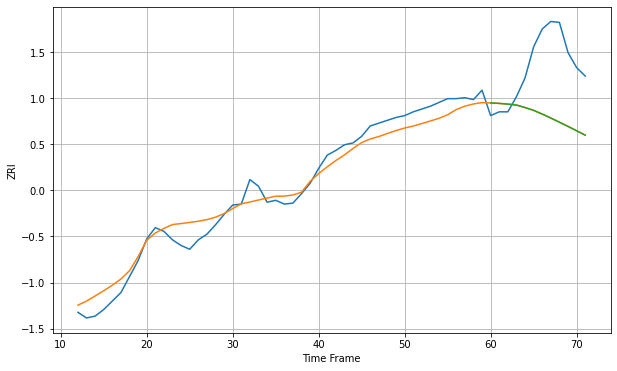

Wall time: 5.89 s
20175 13.136744943997588 64.84402180005856 64.87060897730544 [1634.4772533  1633.94877737 1633.18587032 1632.20404814 1629.57664982
 1626.54943183 1622.62776575 1618.39825137 1613.96712851 1609.50477354
 1604.85597564 1600.16529107]

Got an mse at 0.0100 in round 192 and stopped training

60 60 12


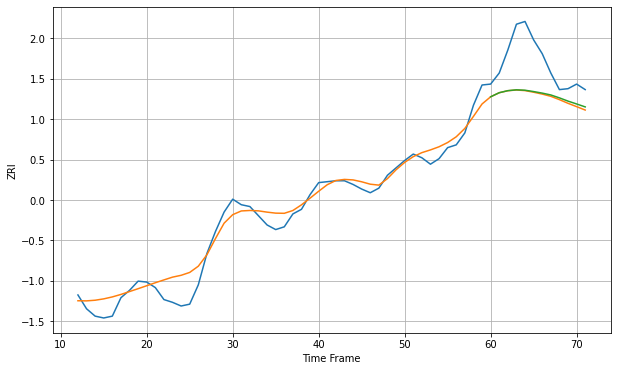

Wall time: 8.88 s
20176 13.015684598663178 41.43871015766334 40.69906277016829 [1610.18792694 1614.63101691 1616.85414365 1617.76290757 1617.33334402
 1615.87301707 1614.19555244 1612.18399373 1609.02680618 1605.51026524
 1602.41306778 1599.21914947]

Got an mse at 0.0098 in round 155 and stopped training

60 60 12


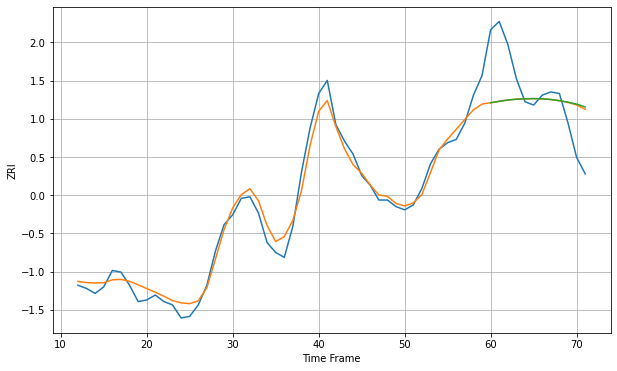

Wall time: 8.01 s
20740 6.43601591986595 26.56966384505775 26.814487942162295 [1626.39633979 1627.24196113 1628.04205351 1628.54332009 1628.78215856
 1628.89115659 1628.7890934  1628.3678056  1627.66188306 1626.75189606
 1625.55917439 1623.82725598]

Got an mse at 0.0100 in round 187 and stopped training

60 60 12


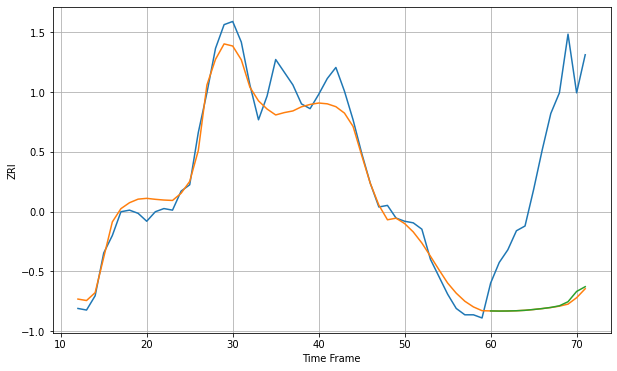

Wall time: 8.95 s
20814 10.473068585387518 101.81617400824192 101.00462406008955 [1953.43539427 1953.3555358  1953.40308874 1953.55515736 1953.83639625
 1954.34846689 1954.93232049 1955.64606681 1956.69289487 1959.24040171
 1965.72578364 1968.72687107]

Got an mse at 0.0098 in round 91 and stopped training

60 60 12


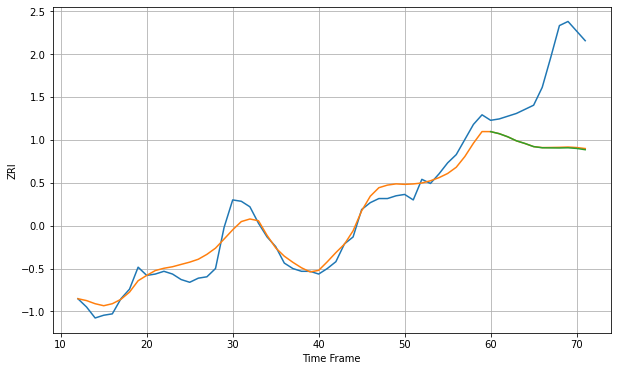

Wall time: 6.6 s
20850 8.521302144205249 56.41934439232574 56.77049986310097 [1843.74966145 1842.26079015 1839.96561609 1837.05776017 1835.09941326
 1832.82651502 1831.98668307 1831.91218795 1831.83923289 1831.97882404
 1831.51877483 1830.57882489]

Got an mse at 0.0100 in round 352 and stopped training

60 60 12


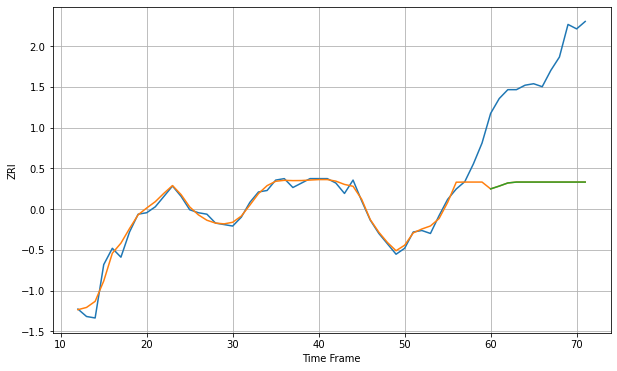

Wall time: 13.4 s
20852 5.520259607739821 78.11773564949867 78.11787452845238 [1740.05529128 1741.96963808 1744.06496473 1744.67522993 1744.67522993
 1744.67522993 1744.67522993 1744.67522993 1744.67522993 1744.67522993
 1744.67522993 1744.67522993]

Got an mse at 0.0100 in round 68 and stopped training

60 60 12


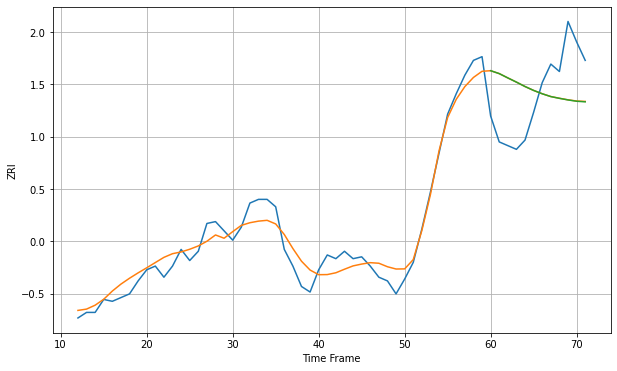

Wall time: 6.14 s
20878 7.041276864383869 28.02921817345416 28.068121161250684 [1695.432606   1693.8651819  1691.53357257 1689.27468576 1686.89443275
 1684.78753832 1682.98346917 1681.46656354 1680.5205342  1679.65805393
 1678.94863309 1678.63832087]

Got an mse at 0.0100 in round 221 and stopped training

60 60 12


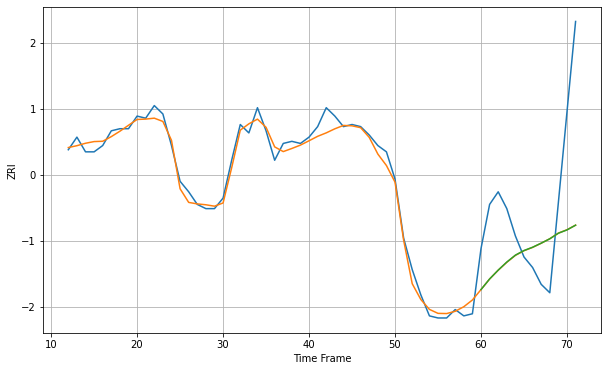

Wall time: 9.52 s
20902 3.865947406024872 38.34402033709966 38.34800535335158 [1730.50667743 1735.54349938 1739.75882648 1743.59047252 1746.87939296
 1749.07156487 1750.62824264 1752.57418895 1754.65349058 1757.30518755
 1758.87575217 1761.12539124]

Got an mse at 0.0098 in round 143 and stopped training

60 60 12


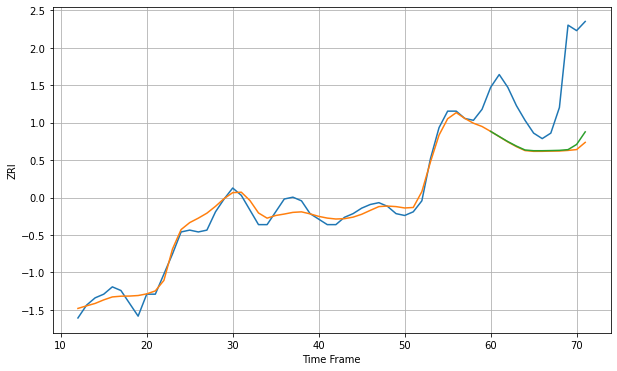

Wall time: 7.98 s
20906 4.409437260955578 38.16731234241817 36.816835663892235 [1562.93773137 1560.13696827 1557.36940906 1554.90482115 1552.77875714
 1552.38172767 1552.38446542 1552.46763353 1552.58219857 1552.97155227
 1555.80234703 1562.67750194]

Got an mse at 0.0100 in round 67 and stopped training

60 60 12


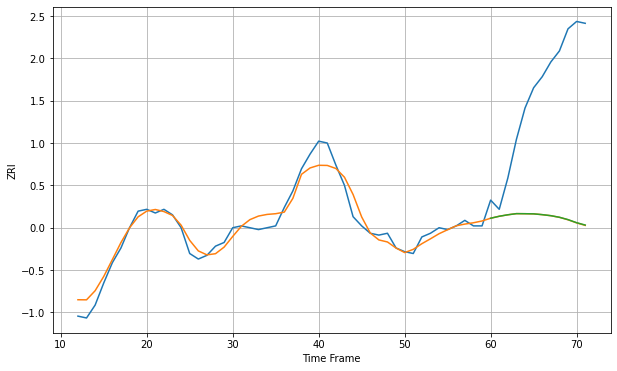

Wall time: 6.19 s
20910 5.094704508866012 73.94713079224931 73.88885652349843 [1714.15189105 1715.22859343 1716.02915663 1716.65378838 1716.61312115
 1716.53372959 1716.11036945 1715.55146355 1714.68364352 1713.40793354
 1711.74169714 1710.46388261]

Got an mse at 0.0099 in round 184 and stopped training

60 60 12


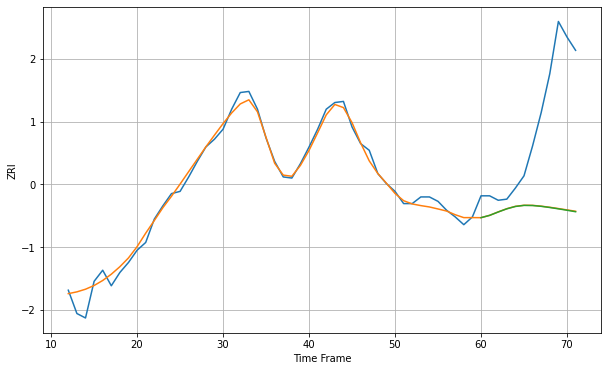

Wall time: 8.91 s
21043 6.664803133331682 91.2519572089803 91.4371924816773 [1546.3158177  1548.38533743 1551.44224823 1554.29495153 1556.41527384
 1557.37796428 1557.27136586 1556.53444642 1555.4876153  1554.28640703
 1553.00672141 1551.68056364]

Got an mse at 0.0099 in round 113 and stopped training

60 60 12


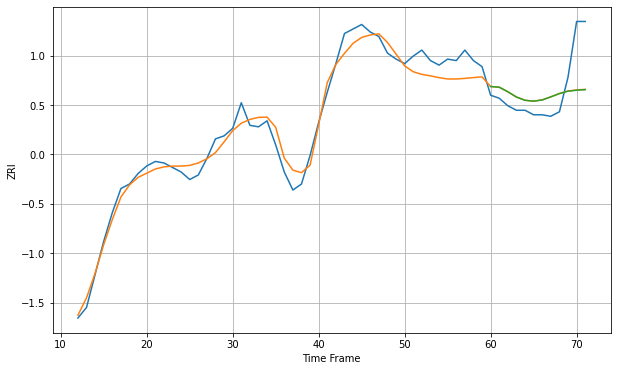

Wall time: 7.01 s
21044 7.931089361937969 20.37814859800605 20.433175164761856 [1636.77657456 1636.33302537 1633.28023242 1629.78488146 1627.62416589
 1627.04418034 1627.85138591 1629.90531501 1632.08121047 1633.69777163
 1634.32492995 1634.70359857]

Got an mse at 0.0100 in round 147 and stopped training

60 60 12


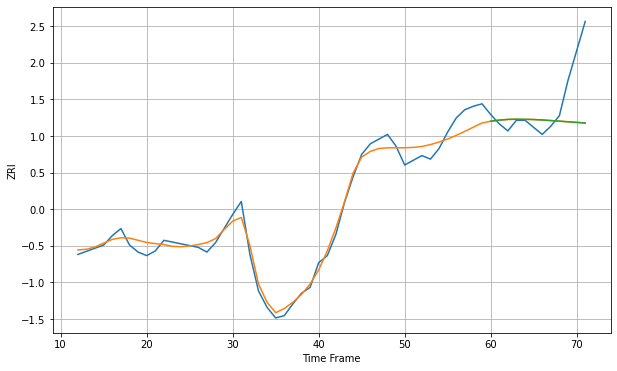

Wall time: 7.74 s
21046 7.889542071101997 32.61046960139021 32.62640468898218 [1639.19945944 1640.14230658 1640.75307611 1640.8782872  1640.80782741
 1640.65853347 1640.27623197 1639.77843255 1639.26104221 1638.75475831
 1638.23257317 1637.63750662]

Got an mse at 0.0096 in round 43 and stopped training

60 60 12


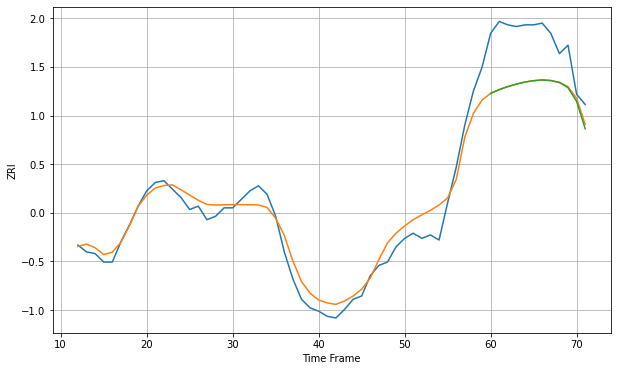

Wall time: 5.24 s
21061 7.972156478569315 29.60718043438824 29.752187923512576 [1427.53384173 1429.79082162 1431.56250357 1433.02516143 1434.26508259
 1435.05371955 1435.49080125 1435.12777962 1433.98979434 1430.9026527
 1422.80421006 1406.65959149]

Got an mse at 0.0100 in round 101 and stopped training

60 60 12


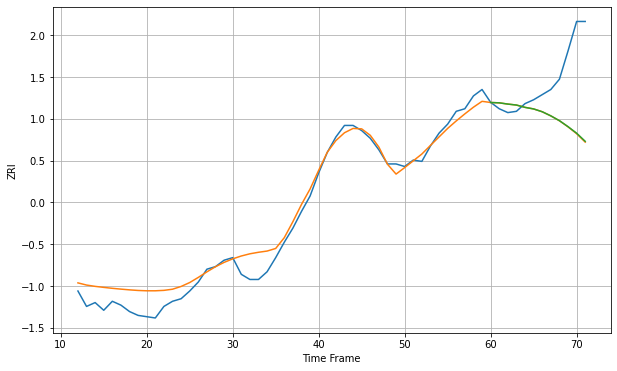

Wall time: 6.62 s
21117 10.04830575126358 42.59306444393588 42.38123852364722 [1345.8746205  1345.60525677 1344.63554977 1343.88610362 1342.0775081
 1340.84893853 1338.66093024 1335.46014947 1331.72027758 1327.06373624
 1321.97583531 1315.63651613]

Got an mse at 0.0098 in round 211 and stopped training

60 60 12


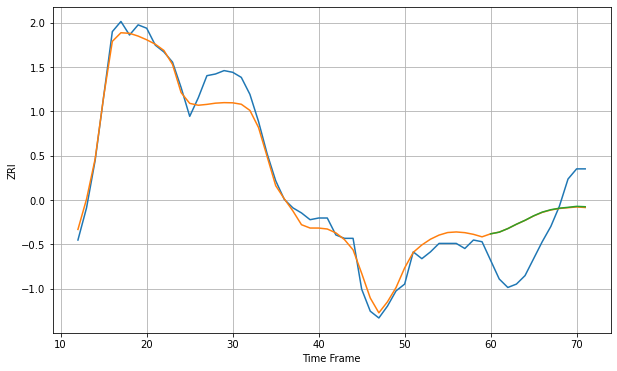

Wall time: 9.57 s
21202 7.578493503274651 23.9283249099722 23.882951678174944 [1247.66124384 1248.6622768  1250.75945089 1253.33325531 1255.65150669
 1258.29004292 1260.4680033  1261.89782546 1262.78932534 1263.30144696
 1263.88055581 1263.65659761]

Got an mse at 0.0099 in round 162 and stopped training

60 60 12


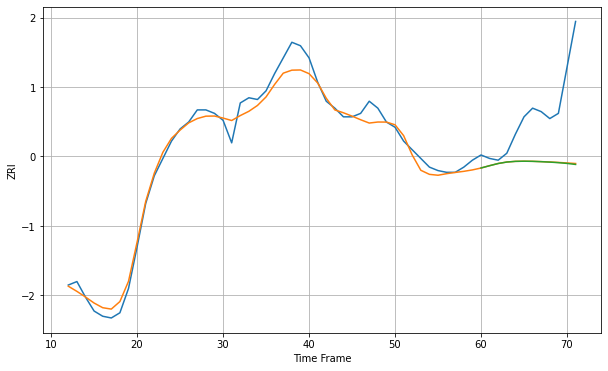

Wall time: 8.32 s
21204 5.7114123117344135 34.089492143017196 34.25509589087741 [1293.48602058 1294.82437733 1296.07871726 1296.927895   1297.31661221
 1297.40585908 1297.33128508 1297.13751782 1296.88615269 1296.57284215
 1296.13397067 1295.54529511]

Got an mse at 0.0098 in round 327 and stopped training

60 60 12


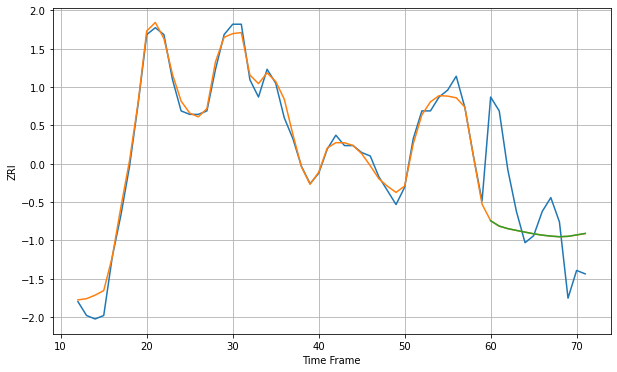

Wall time: 11.9 s
21217 2.4779525552206567 16.952135221411424 16.957686723888706 [1033.32455893 1031.77767619 1031.0473544  1030.54053509 1030.04731657
 1029.56183931 1029.18170794 1028.89639443 1028.72291546 1028.83482179
 1029.23936604 1029.68331808]

Got an mse at 0.0099 in round 185 and stopped training

60 60 12


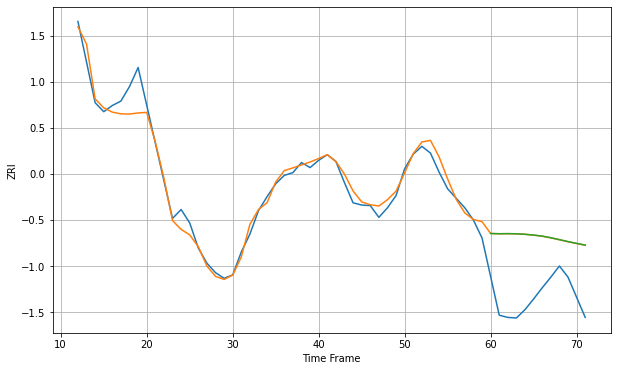

Wall time: 8.5 s
21231 19.223210025873133 111.41213630870882 111.54474931244545 [1780.07904963 1779.66687816 1779.81768288 1779.5729454  1778.68890296
 1777.26141433 1775.38044783 1772.52797345 1769.13842757 1765.6543435
 1762.4464024  1759.4151267 ]

Got an mse at 0.0099 in round 128 and stopped training

60 60 12


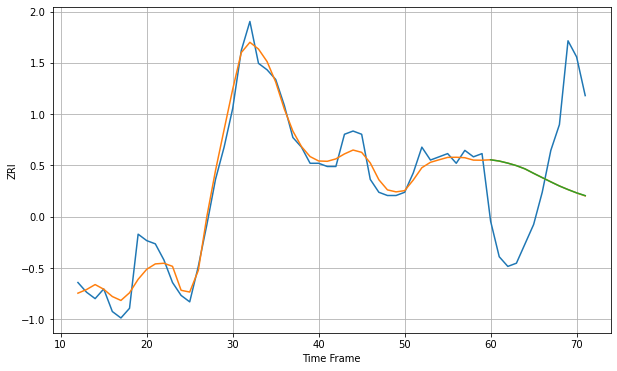

Wall time: 7.31 s
22030 4.174655199327995 27.897083969140525 27.888647289704846 [1729.08318041 1728.68807505 1728.0452113  1727.26747277 1726.25715004
 1724.87999722 1723.55558657 1722.23312009 1720.95413726 1719.84193946
 1718.82141252 1717.96461072]

Got an mse at 0.0100 in round 321 and stopped training

60 60 12


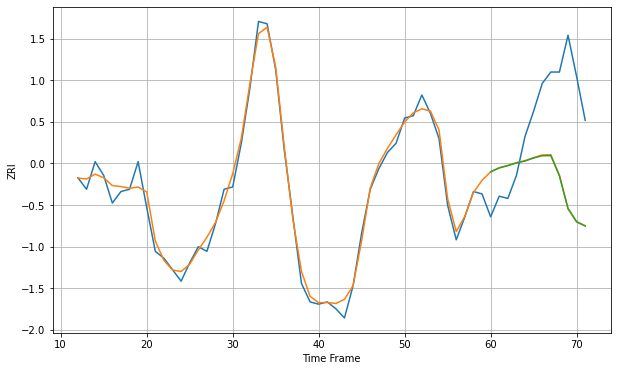

Wall time: 11.6 s
22031 3.847837556652525 38.02630843184659 38.114514053210364 [1808.58198388 1810.2839787  1811.27368401 1812.44114988 1813.29379639
 1814.59132303 1815.56749627 1815.64334191 1806.80616933 1792.64918128
 1786.86246232 1784.98503353]

Got an mse at 0.0099 in round 128 and stopped training

60 60 12


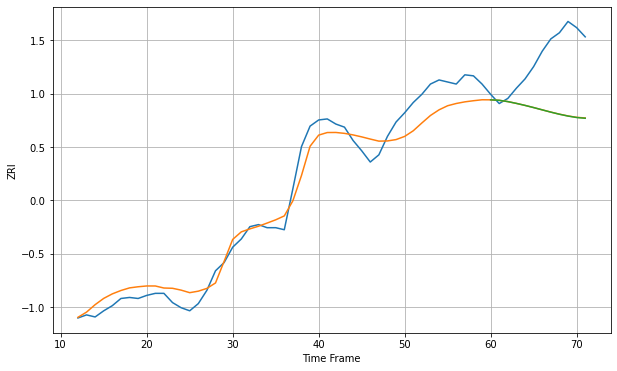

Wall time: 7.17 s
22033 15.560844704898699 57.41007224697446 57.4961773302727 [1801.60935241 1801.1554468  1799.88914701 1798.13618462 1796.19030322
 1794.07071278 1791.84147997 1789.62537686 1787.57492218 1785.79665247
 1784.39727851 1783.66438512]

Got an mse at 0.0099 in round 124 and stopped training

60 60 12


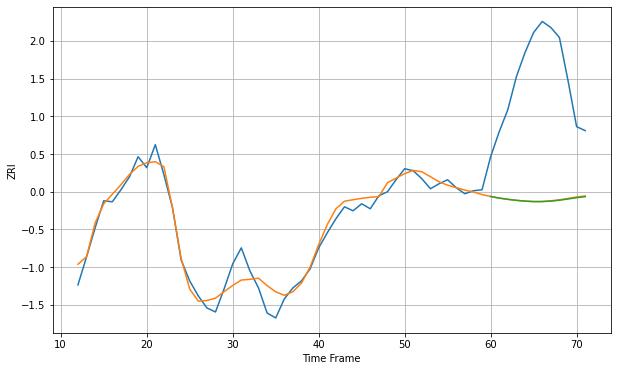

Wall time: 7.21 s
22102 10.563887608154028 126.24985340799044 126.4522232007404 [2034.2862982  2032.69247902 2031.4487357  2030.44059517 2029.65997027
 2029.16063598 2029.17284287 2029.680785   2030.54851983 2031.76742074
 2033.13182174 2034.1123742 ]

Got an mse at 0.0099 in round 202 and stopped training

60 60 12


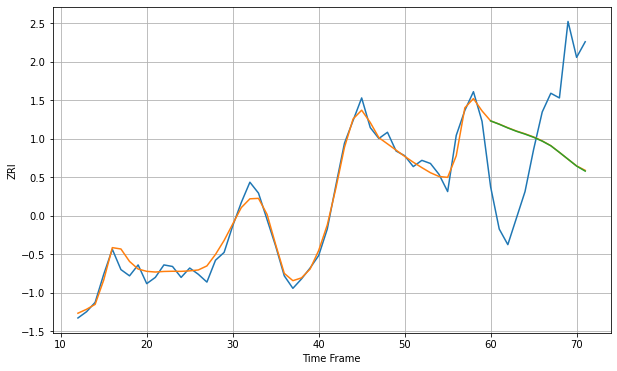

Wall time: 9.88 s
22180 5.247194439516983 56.699396650932904 56.72058043742927 [1871.28225249 1869.1385207  1866.76809618 1864.62536505 1862.81621394
 1860.7794224  1858.32378046 1855.33863622 1851.11453167 1846.75565838
 1842.34978361 1839.09151022]

Got an mse at 0.0099 in round 312 and stopped training

60 60 12


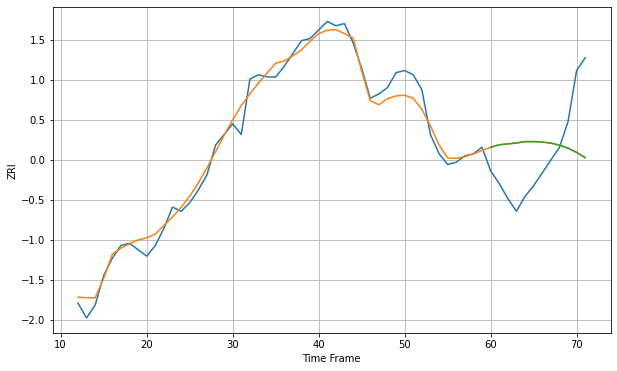

Wall time: 12.5 s
22191 5.08684136256291 24.711778279077475 24.681092221858478 [1478.01063907 1479.19522716 1479.61028172 1480.00029301 1480.64452185
 1480.64482133 1480.44763735 1479.93928375 1479.02109615 1477.58948892
 1475.58380644 1473.18989359]

Got an mse at 0.0097 in round 30 and stopped training

60 60 12


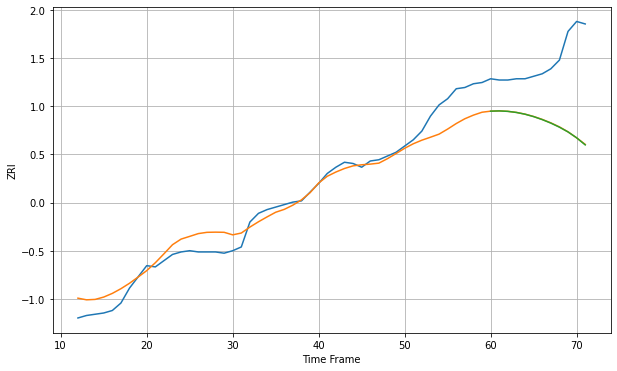

Wall time: 5.19 s
22192 12.084917619444177 54.12848928463455 54.24446755931688 [1431.00260414 1431.20196286 1430.83935288 1429.95622627 1428.55183396
 1426.6254331  1424.23743628 1421.42557101 1418.14977052 1414.32852841
 1409.63766086 1403.93080596]

Got an mse at 0.0099 in round 134 and stopped training

60 60 12


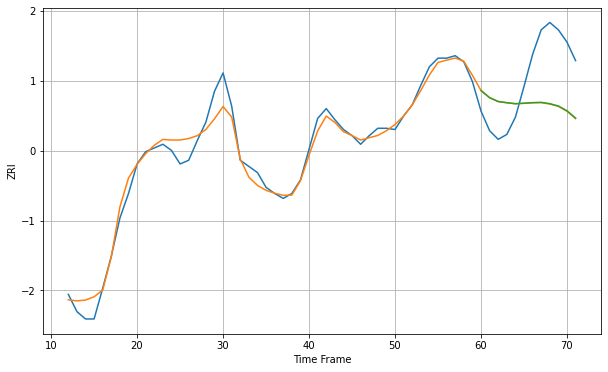

Wall time: 7.4 s
22201 8.668347218949364 42.42259914151184 42.236734589146 [2130.6755267  2124.86678857 2121.73622858 2120.78173874 2119.96332385
 2120.35807511 2120.82898554 2121.07610506 2119.98769851 2118.10753176
 2114.20641817 2108.26592287]
60 60 12


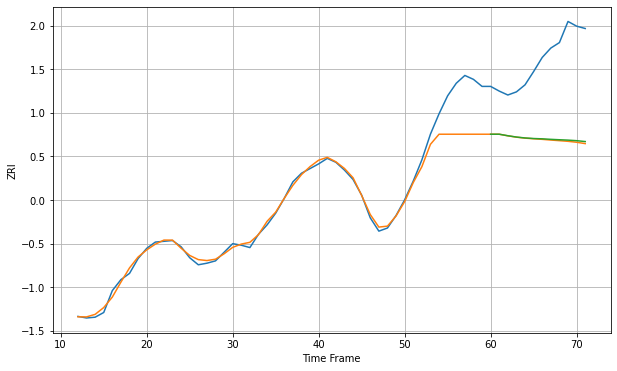

Wall time: 15.8 s
22202 21.58795683253588 105.08709027793289 104.05524431343682 [2097.87296526 2097.87296526 2095.93931563 2094.26732543 2093.10008281
 2092.3774695  2091.98250705 2091.32941494 2090.8082834  2090.31874673
 2089.62463086 2088.49660549]

Got an mse at 0.0098 in round 120 and stopped training

60 60 12


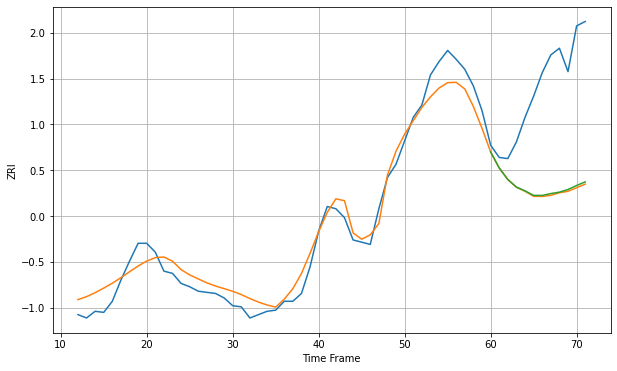

Wall time: 7.21 s
22203 13.306294936789762 97.25412683010146 96.19472072359594 [2062.96297905 2048.55076799 2038.22975529 2031.44606739 2028.03016033
 2023.97185672 2023.9302378  2025.59788359 2026.889397   2029.24842148
 2032.85037733 2036.10981061]

Got an mse at 0.0099 in round 139 and stopped training

60 60 12


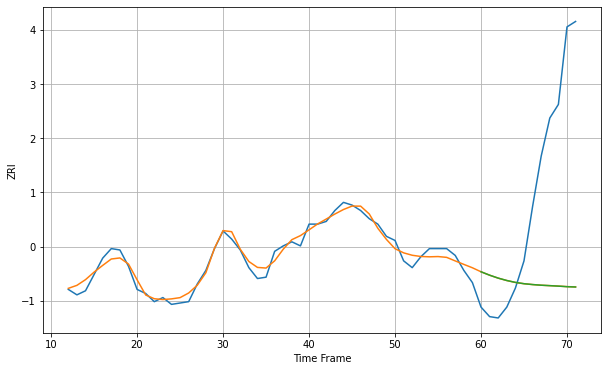

Wall time: 7.67 s
22204 4.931505482353997 101.25093156819162 101.27314194206157 [1782.96509564 1780.46744164 1778.30668153 1776.55411451 1775.15533255
 1774.1975568  1773.57307499 1773.09310675 1772.76242673 1772.41600534
 1772.00186694 1771.77175854]

Got an mse at 0.0098 in round 233 and stopped training

60 60 12


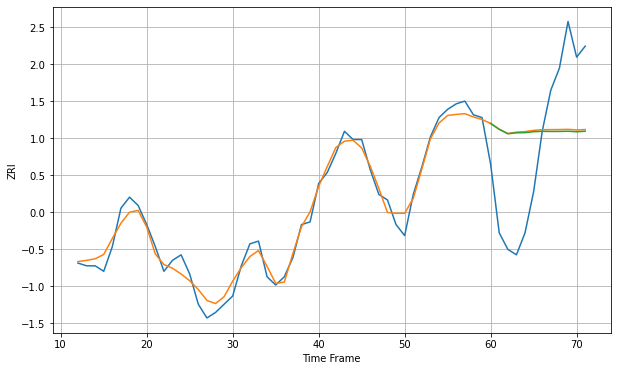

Wall time: 9.67 s
22206 3.4633885290946473 30.490661996918657 30.629467217484002 [1890.86822411 1888.71813958 1887.09455063 1887.45139565 1887.51196171
 1887.84146327 1887.98027324 1887.93203256 1887.94236881 1888.01145835
 1887.83631891 1888.00724363]

Got an mse at 0.0099 in round 274 and stopped training

60 60 12


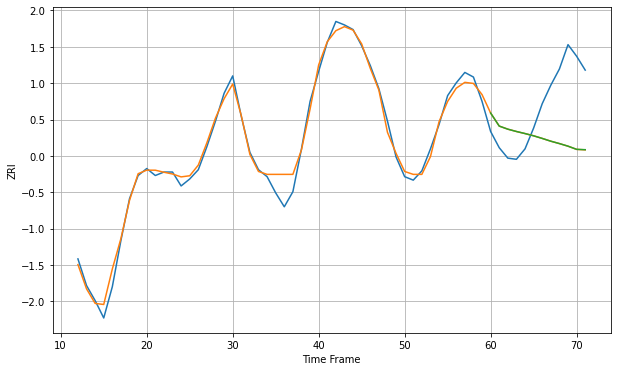

Wall time: 10.5 s
22209 7.117279362682444 48.576272598411144 48.550179119540665 [2244.94533467 2233.66988064 2231.00287692 2229.00284467 2227.21856683
 2225.28036326 2223.02608109 2220.62587668 2218.57044062 2216.32987981
 2213.59295958 2213.29443786]

Got an mse at 0.0099 in round 380 and stopped training

60 60 12


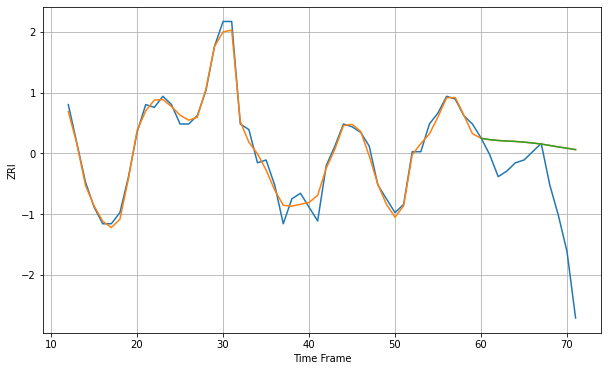

Wall time: 13.6 s
22303 2.631815068877021 22.953090816080252 22.953037973988934 [1722.84991975 1722.35328653 1722.04862713 1721.85270376 1721.7053516
 1721.44687734 1721.15332277 1720.76439531 1720.25473249 1719.72268735
 1719.26301463 1718.75772235]

Got an mse at 0.0097 in round 122 and stopped training

60 60 12


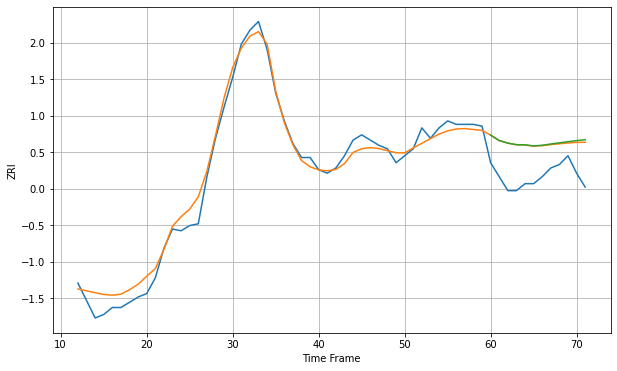

Wall time: 7.17 s
22304 5.835233488881495 19.864620754238054 20.219702272591345 [1593.84383086 1590.73885014 1589.26078606 1588.35510497 1588.26425942
 1587.63585158 1588.03176513 1588.74617435 1589.40799893 1590.06605472
 1590.66890621 1591.23436257]

Got an mse at 0.0100 in round 207 and stopped training

60 60 12


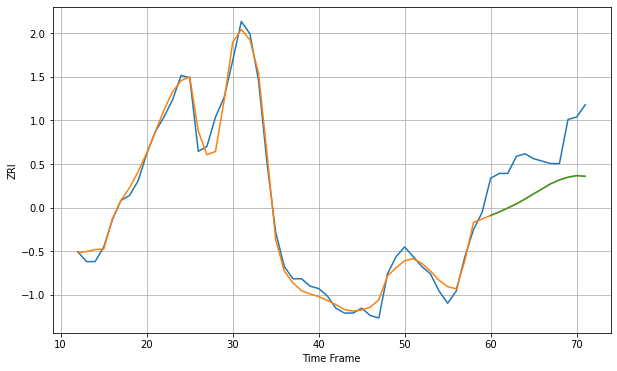

Wall time: 9 s
22305 3.9240671818721897 17.831431460581875 17.836408695561374 [1752.84243457 1754.26579732 1755.87639244 1757.58667335 1759.54735557
 1761.66379417 1763.72018956 1765.81427199 1767.3340843  1768.43300236
 1769.07412281 1768.82078349]

Got an mse at 0.0098 in round 497 and stopped training

60 60 12


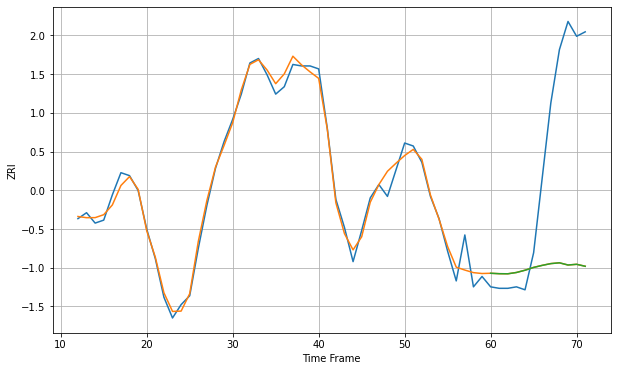

Wall time: 15.5 s
22312 6.028518047496637 96.68363650225707 96.68731440813647 [1700.1611492  1699.86695635 1699.80452626 1700.67738816 1702.20245478
 1704.09051314 1705.47154662 1706.67081745 1707.20901006 1705.73250362
 1706.20675826 1704.86687903]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


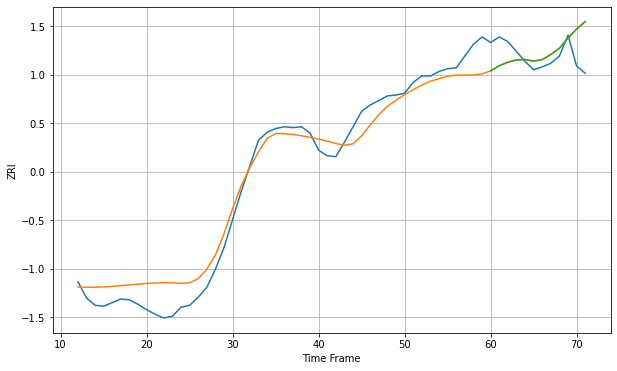

Wall time: 5.74 s
22901 18.68541336290196 25.548348611582178 25.61007100615188 [1247.64972388 1253.21144442 1257.14153745 1259.70882559 1260.11457226
 1258.36487076 1260.0400048  1265.65960164 1272.59166536 1283.89291136
 1293.87258588 1302.13283418]

Got an mse at 0.0098 in round 51 and stopped training

60 60 12


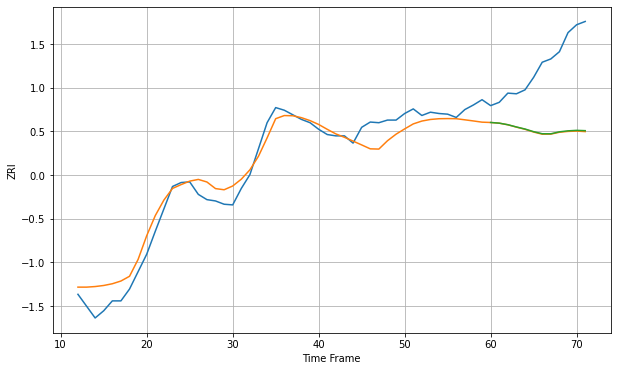

Wall time: 5.59 s
22903 21.279678280388875 105.64804123865984 104.96973584718262 [1402.35423058 1401.33944978 1398.9630858  1395.52362084 1392.38524085
 1388.38936471 1385.22003806 1385.14443381 1388.14831067 1389.64327816
 1390.39620709 1389.913306  ]

Got an mse at 0.0098 in round 56 and stopped training

60 60 12


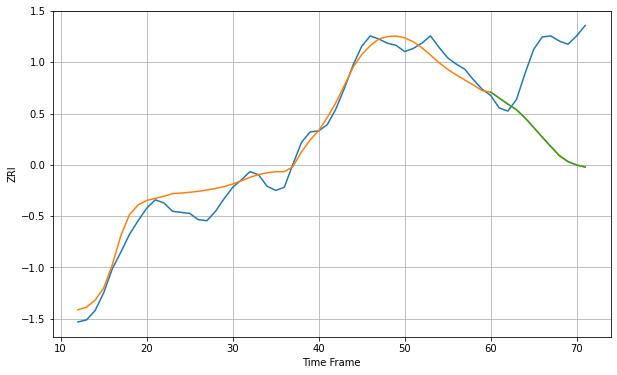

Wall time: 5.64 s
23220 12.090415318049496 84.76435322838118 84.8876277505995 [1158.16584964 1152.4653413  1146.69634482 1141.32393077 1133.55708631
 1124.38532901 1115.08194458 1106.00944214 1097.08759537 1091.53739005
 1088.24962619 1086.40104206]

Got an mse at 0.0097 in round 61 and stopped training

60 60 12


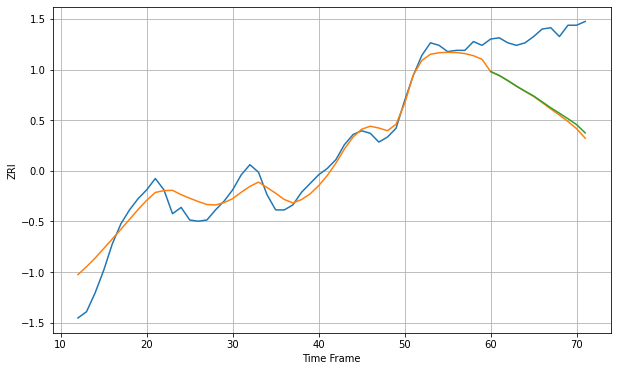

Wall time: 5.64 s
23223 11.870262342644512 57.81162968663184 56.31767817236617 [1117.11948376 1114.00924089 1109.93005659 1105.54706874 1101.52513487
 1097.69207437 1093.00866991 1088.2893077  1083.97425795 1079.56846055
 1074.86429373 1068.30686338]

Got an mse at 0.0100 in round 63 and stopped training

60 60 12


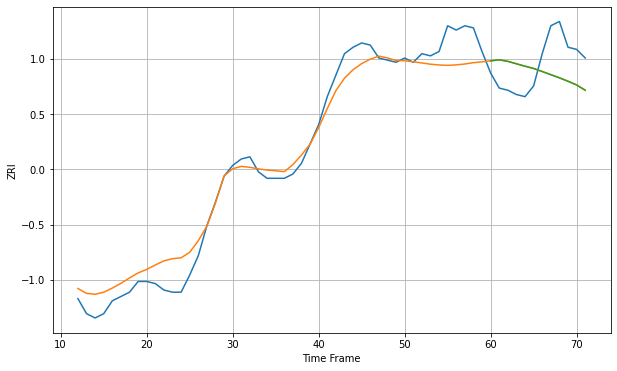

Wall time: 5.67 s
23294 8.249416591543689 15.479538941349393 15.510631363773873 [1078.66597812 1079.1627863  1078.43566413 1077.3047621  1076.17693651
 1075.10683575 1073.69174645 1072.2286369  1070.73553076 1069.15396212
 1067.41612232 1064.95878814]

Got an mse at 0.0099 in round 115 and stopped training

60 60 12


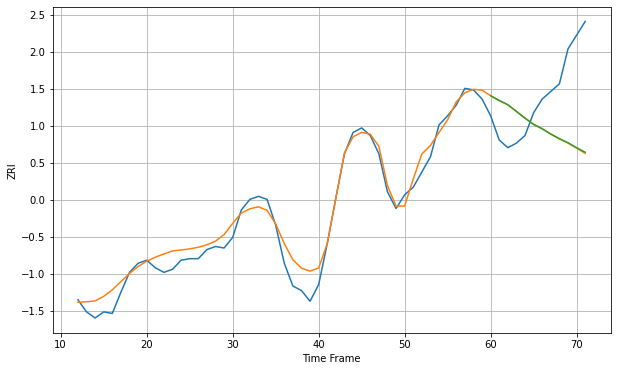

Wall time: 6.87 s
23451 7.903827495264964 42.46981115743315 42.26643570285335 [1200.148588   1197.00668255 1194.21164094 1189.82321949 1185.36936222
 1181.28849383 1178.42464708 1174.94612743 1171.90967038 1169.20505057
 1165.96614782 1162.99069749]

Got an mse at 0.0099 in round 182 and stopped training

60 60 12


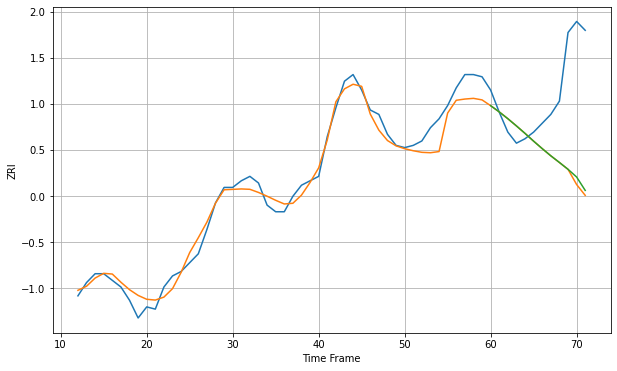

Wall time: 8.53 s
23452 5.330778563349032 36.78511924305886 35.84395770071297 [1189.94197025 1187.1318172  1184.06358961 1180.79713183 1177.41679108
 1173.90138567 1170.52889714 1167.2840327  1164.27749212 1161.18649221
 1157.70628392 1151.64732735]

Got an mse at 0.0098 in round 152 and stopped training

60 60 12


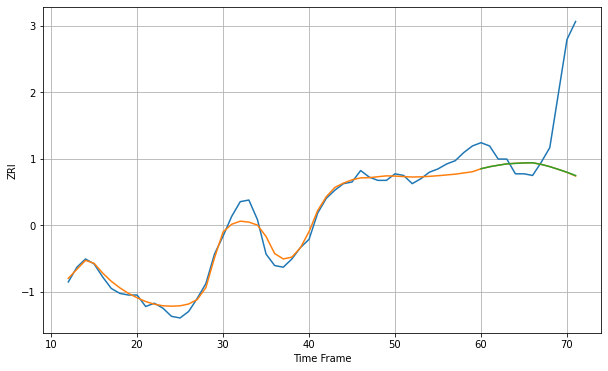

Wall time: 7.85 s
23454 5.336070903570596 39.09605864981091 39.02056332702005 [1146.09281701 1147.31609189 1148.23897826 1149.05486634 1149.37703611
 1149.64032985 1149.72358438 1148.76466635 1147.38166681 1145.71078992
 1143.95556063 1141.96439455]

Got an mse at 0.0099 in round 141 and stopped training

60 60 12


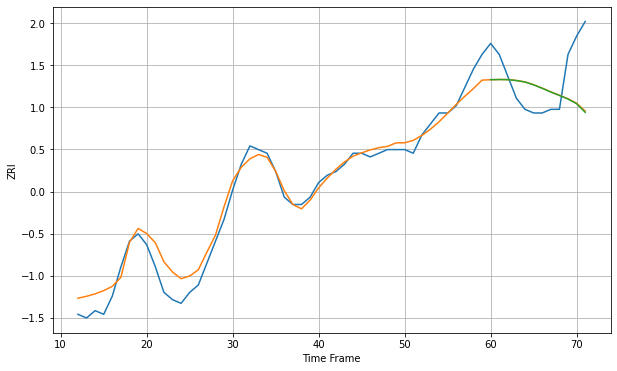

Wall time: 7.49 s
23503 3.444065336923973 10.996096406928881 11.076847711158894 [823.0914298  823.13692495 823.10110416 822.85338349 822.45109603
 821.68697608 820.74587644 819.71883388 818.78063816 817.80871211
 816.52953176 814.17557337]

Got an mse at 0.0098 in round 223 and stopped training

60 60 12


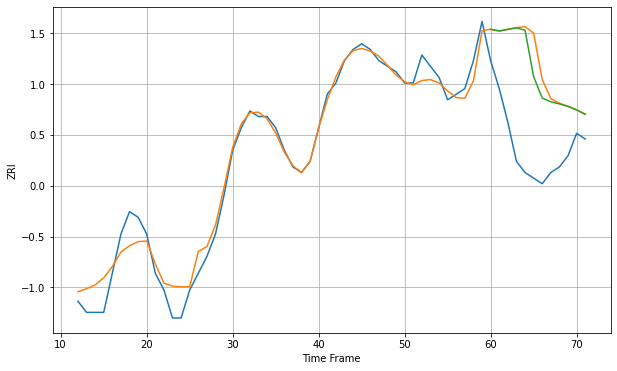

Wall time: 9.45 s
23518 2.494354300910362 16.08156672034948 14.700338901154812 [829.6057117  829.2983434  829.5775765  829.85618441 829.43870406
 821.14253492 817.31530807 816.6350505  816.26383028 815.81401572
 815.17720612 814.39248349]

Got an mse at 0.0100 in round 66 and stopped training

60 60 12


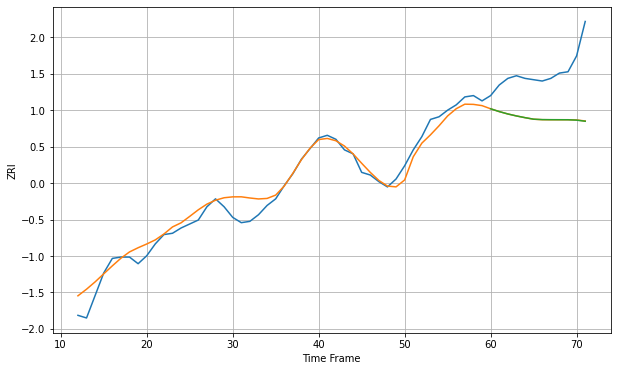

Wall time: 6.03 s
23602 7.824804046569867 36.85481077040169 36.89359949936668 [993.03077029 990.91876328 989.11896541 987.62910644 986.3372408
 985.17509671 984.86203368 984.79347464 984.76894086 984.7387513
 984.45726428 983.62590578]

Got an mse at 0.0099 in round 91 and stopped training

60 60 12


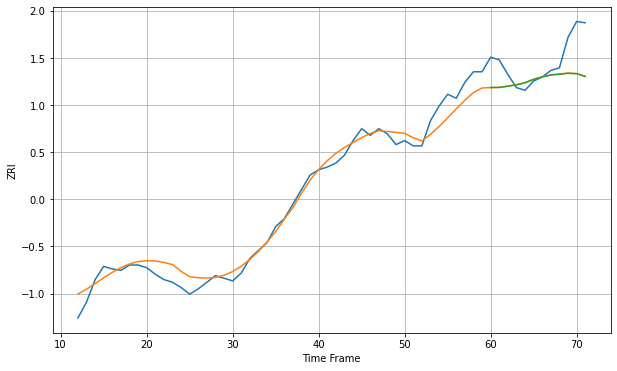

Wall time: 6.48 s
23666 8.125427498302116 20.474738383053435 20.510675474311725 [1049.07646639 1049.16960329 1050.10530289 1051.12052234 1052.7281559
 1055.22137423 1057.09497874 1058.5334333  1059.17723652 1059.83383962
 1059.52864312 1057.50715289]

Got an mse at 0.0099 in round 140 and stopped training

60 60 12


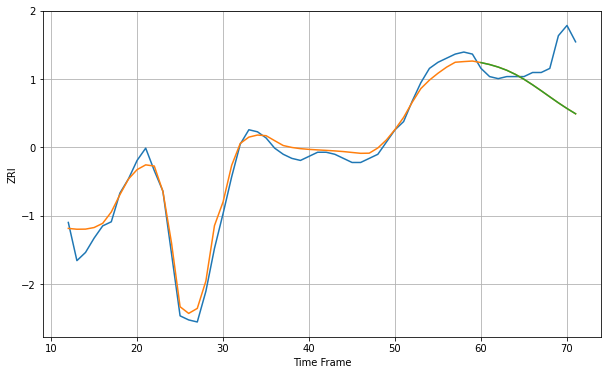

Wall time: 7.49 s
23803 4.945169775541313 19.06329985868938 19.064050600460487 [924.84097248 923.89922409 922.65989304 921.08273363 919.08179855
 916.68289219 913.97044364 911.07932709 908.1052788  905.16773745
 902.38928327 899.81823446]

Got an mse at 0.0100 in round 100 and stopped training

60 60 12


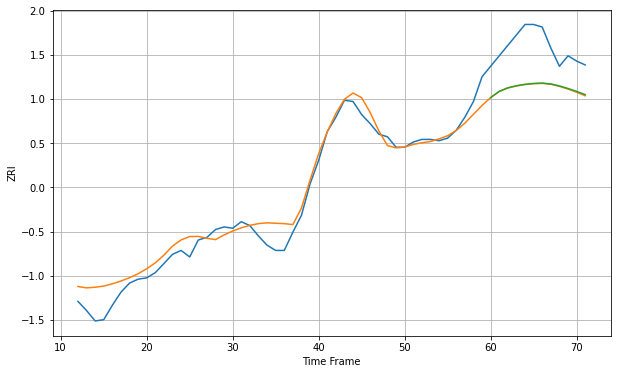

Wall time: 6.77 s
23831 10.271016020894878 32.55833761612771 32.316879471571255 [1080.00842621 1084.76106425 1087.49858105 1089.08457971 1090.17239316
 1090.84270826 1091.09749365 1090.4923129  1088.96046926 1086.9871783
 1084.75298298 1082.29845817]

Got an mse at 0.0100 in round 154 and stopped training

60 60 12


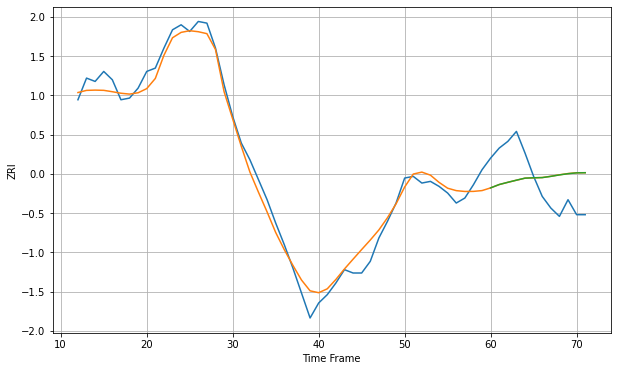

Wall time: 7.83 s
26003 6.480277215077051 20.6544308938537 20.62122367376597 [814.1055551  816.11368742 817.45294312 818.72349867 819.94621415
 820.16015946 820.27306134 821.00966693 821.87626704 822.61580512
 823.10807622 823.2003244 ]

Got an mse at 0.0095 in round 298 and stopped training

60 60 12


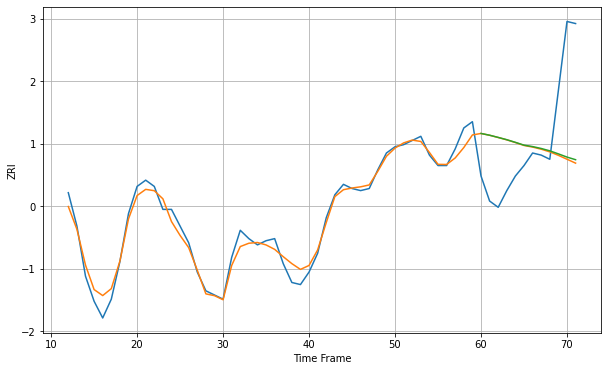

Wall time: 11.2 s
26505 4.165328159407915 33.268439945932656 32.797869192808456 [958.36500295 957.52228274 956.47269637 955.3738652  954.11371843
 952.7739525  952.07975829 951.17301874 950.04857003 948.58774185
 947.05284602 945.79766785]

Got an mse at 0.0098 in round 61 and stopped training

60 60 12


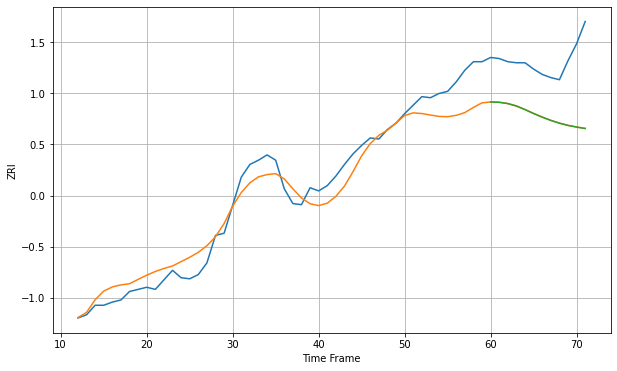

Wall time: 5.61 s
27513 16.975222840022635 54.36901389815373 54.40416328236989 [1158.98448261 1158.67313758 1157.46440488 1155.1486366  1151.76918374
 1148.05391726 1144.62843114 1141.57895332 1138.95325709 1136.85335072
 1135.29107135 1133.93448395]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


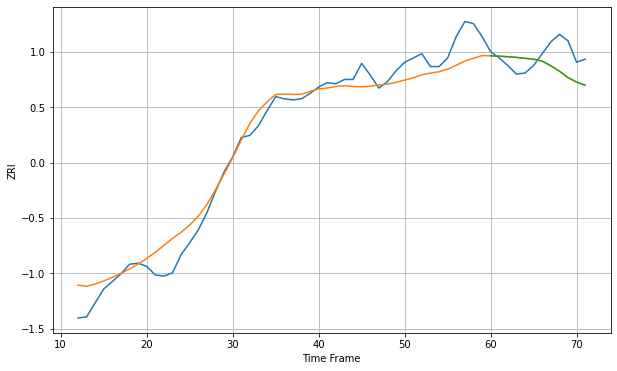

Wall time: 5.67 s
27560 15.357057856650735 19.08249476551379 19.087116523174434 [1304.05909197 1303.67474984 1303.17375161 1302.55641114 1301.70613385
 1300.90304592 1299.08372121 1294.76579642 1289.7727656  1283.75047571
 1279.58245942 1276.58626509]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


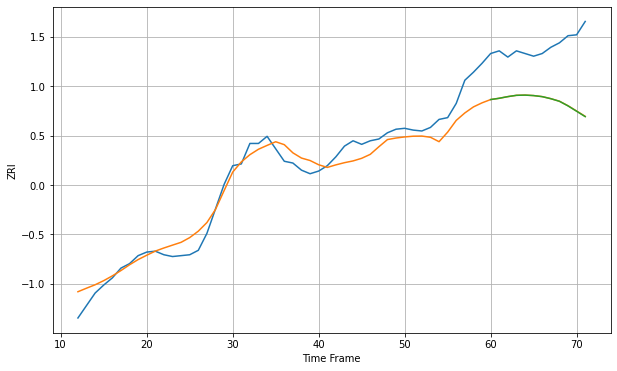

Wall time: 5.44 s
27606 15.995231604852442 63.86728010246802 63.96659777775912 [1145.29930091 1146.74301838 1148.59470996 1150.04627149 1150.29376625
 1149.75711886 1148.55963763 1146.2716785  1143.35730755 1138.19491808
 1132.18262989 1126.12401211]

Got an mse at 0.0099 in round 58 and stopped training

60 60 12


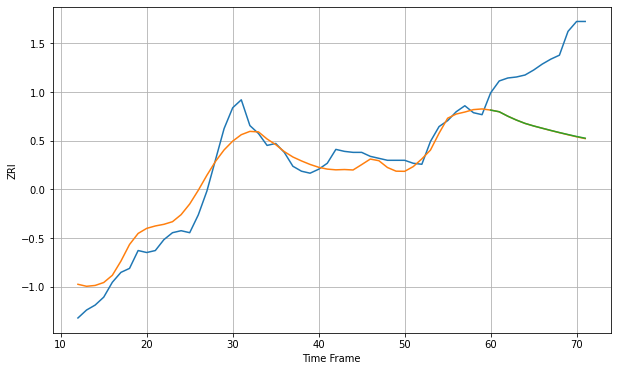

Wall time: 5.63 s
27609 15.781572348595077 73.04040303677277 72.89639134432142 [1116.64030578 1114.93971557 1110.45366462 1106.57866192 1103.21875611
 1100.64552988 1098.36108567 1096.12090077 1093.98150039 1091.96121979
 1089.99038753 1088.27209692]

Got an mse at 0.0096 in round 30 and stopped training

60 60 12


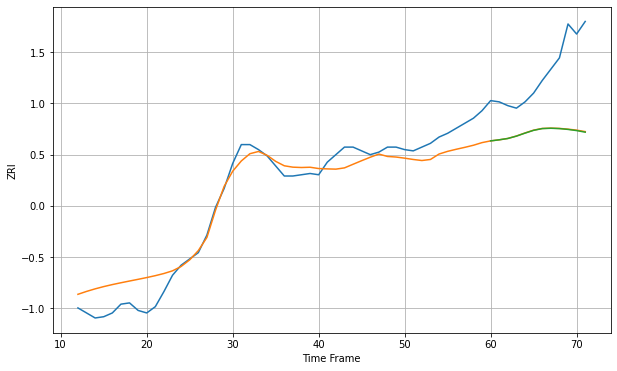

Wall time: 4.9 s
27612 13.445540867946418 51.59549747050802 51.77367376538145 [1067.94919052 1068.80565049 1069.86318724 1071.74792106 1074.13260084
 1076.35016315 1077.73634225 1077.99919474 1077.73042267 1077.0822119
 1076.14883007 1074.88829798]

Got an mse at 0.0098 in round 31 and stopped training

60 60 12


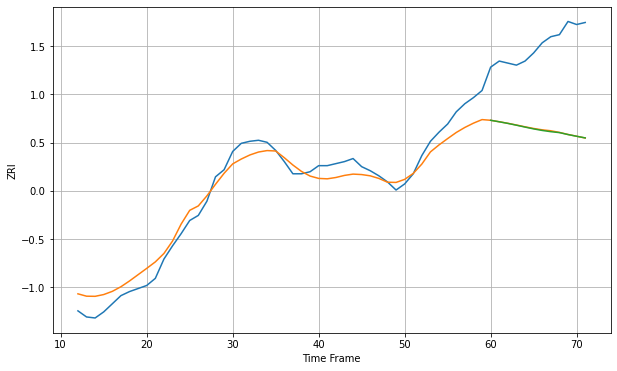

Wall time: 4.98 s
27613 12.81126346596214 84.4858333058979 84.70571816965663 [1095.68182175 1094.20704524 1092.62250413 1090.84468383 1088.98447001
 1087.19941522 1085.66605682 1084.45764632 1083.54266307 1081.63080981
 1079.93912367 1078.34747053]

Got an mse at 0.0100 in round 67 and stopped training

60 60 12


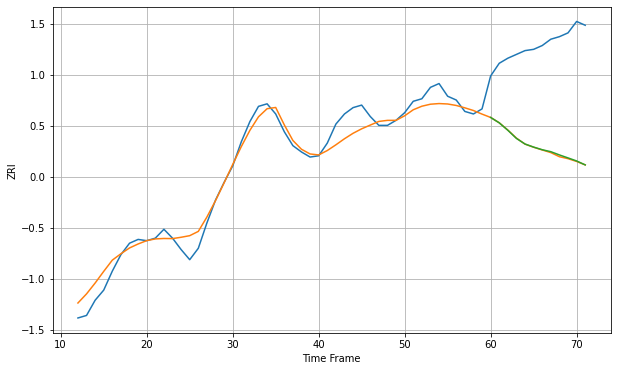

Wall time: 5.91 s
27615 9.112118079393653 81.77701320160473 81.46967226070734 [1097.25895046 1092.98831353 1087.14615196 1080.69375855 1076.28572839
 1073.85462461 1071.78019449 1070.22797467 1067.67737879 1065.32018965
 1062.91176149 1059.79687502]

Got an mse at 0.0100 in round 108 and stopped training

60 60 12


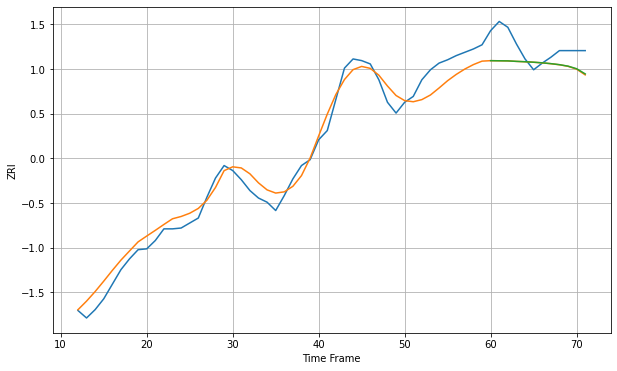

Wall time: 6.81 s
27703 15.419642199885882 25.39733920256073 25.213680323177577 [1083.93114799 1083.80160962 1083.67880985 1083.09178373 1082.67073567
 1082.08316974 1081.35892011 1080.37494088 1079.13715565 1077.36951075
 1074.27260931 1068.03992842]

Got an mse at 0.0099 in round 93 and stopped training

60 60 12


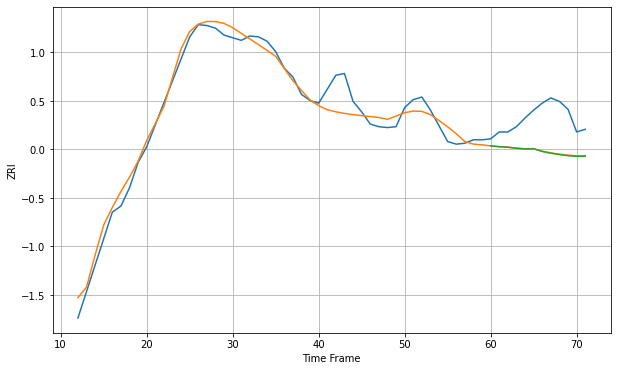

Wall time: 6.4 s
27705 13.312773024201112 40.41165957937461 40.670819798238504 [1205.06247549 1204.05856352 1203.47281491 1202.32259348 1201.57026027
 1201.7514623  1198.62353193 1196.60827044 1195.03382653 1193.73555015
 1193.03230252 1193.19802512]

Got an mse at 0.0099 in round 79 and stopped training

60 60 12


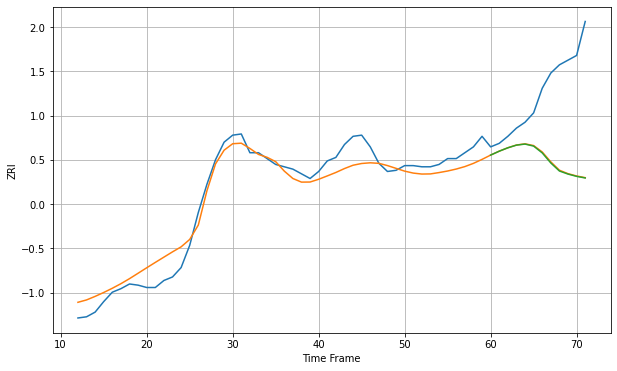

Wall time: 6.03 s
27707 11.635358010546355 68.32433993239017 68.6907156998827 [1032.99083539 1036.31369094 1039.19239539 1041.48187939 1042.37784981
 1040.65186286 1034.85055554 1026.24118805 1019.39690759 1016.78203477
 1014.83144571 1013.46202216]

Got an mse at 0.0099 in round 46 and stopped training

60 60 12


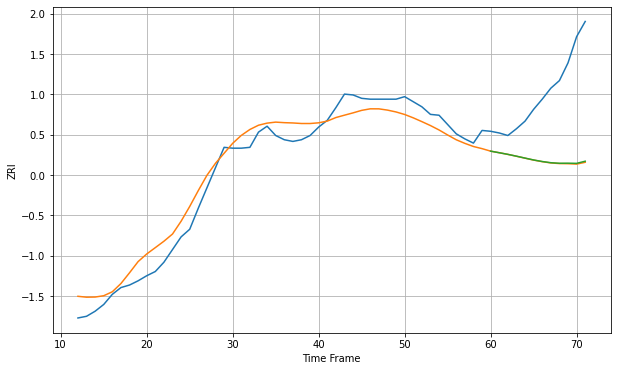

Wall time: 5.29 s
27713 16.731490001238104 89.41594441393246 88.94101865445587 [1036.47853431 1034.61497918 1032.69369809 1030.52709406 1028.25875685
 1026.03958706 1024.21161536 1022.79305564 1022.13417122 1022.24287998
 1022.03534954 1024.56188553]

Got an mse at 0.0099 in round 70 and stopped training

60 60 12


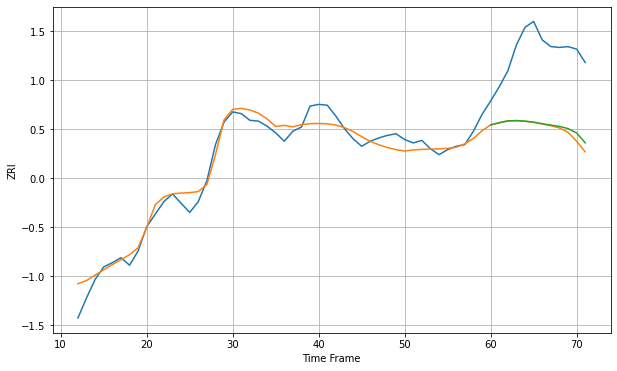

Wall time: 6.01 s
28202 12.5895221082906 92.93874811891007 90.30800566878952 [1505.46048096 1508.1476342  1510.29203818 1510.71158129 1509.95809122
 1508.76079354 1506.88441758 1505.27205808 1503.68272335 1501.15087597
 1495.95053293 1484.08569786]

Got an mse at 0.0097 in round 65 and stopped training

60 60 12


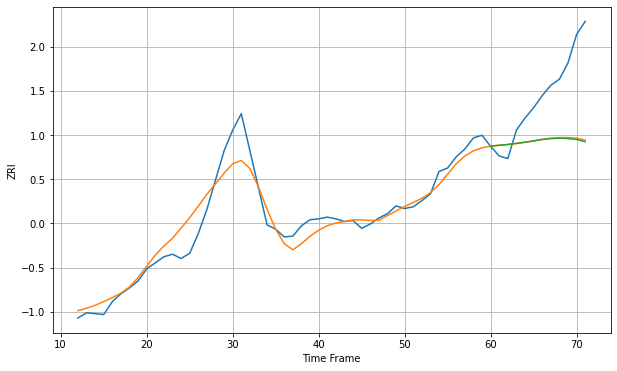

Wall time: 5.73 s
28210 16.894130800232343 67.59544483763082 68.38653032774695 [1269.3351254  1270.34391661 1271.28946879 1272.5089124  1273.91920487
 1275.39130288 1277.07976829 1278.1223794  1278.52364057 1278.13795633
 1277.06264766 1274.41323739]

Got an mse at 0.0100 in round 146 and stopped training

60 60 12


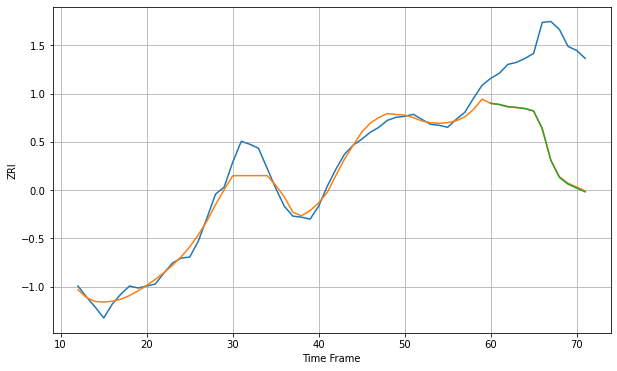

Wall time: 7.68 s
28216 10.05817815476638 99.51197066531195 99.89465038107089 [1252.99470038 1251.84823947 1249.62071635 1248.81423504 1247.7028695
 1245.27170145 1227.81079774 1196.12419704 1178.80895001 1172.02700382
 1168.1312109  1164.26926766]

Got an mse at 0.0097 in round 38 and stopped training

60 60 12


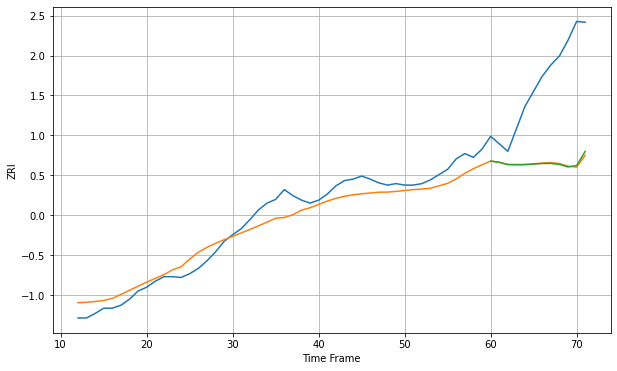

Wall time: 5.24 s
28262 16.475325783804532 118.18391249713403 117.70984130981483 [1050.05271347 1048.33937754 1045.35478963 1045.21376898 1045.27976231
 1045.98125719 1046.7241919  1046.94180974 1045.47896547 1042.20577062
 1044.06461668 1062.91764666]

Got an mse at 0.0097 in round 138 and stopped training

60 60 12


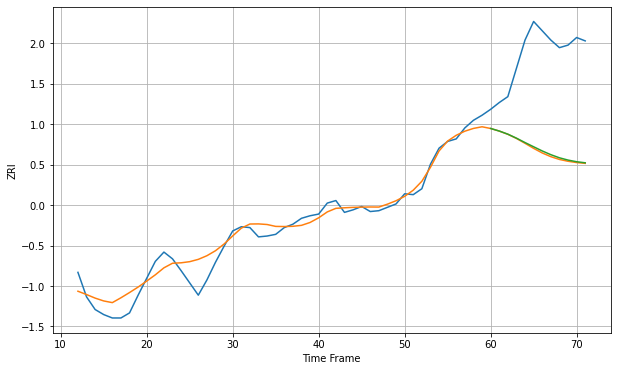

Wall time: 7.34 s
28269 13.055802565121462 118.09842903151068 116.82800788631255 [1133.31752185 1130.29611645 1126.58986749 1121.8822659  1116.66647387
 1111.67987052 1106.72973511 1102.31468523 1098.6193052  1095.91826795
 1093.95448676 1092.69047137]

Got an mse at 0.0099 in round 53 and stopped training

60 60 12


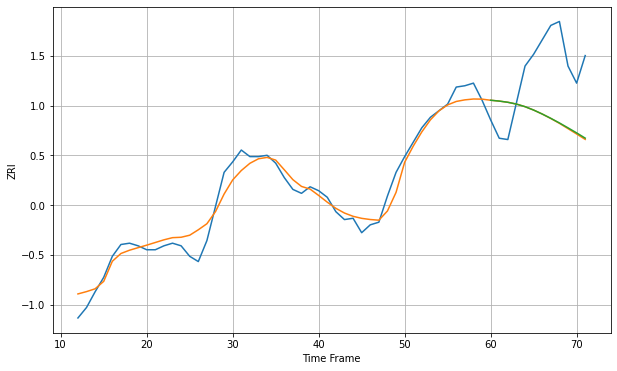

Wall time: 5.45 s
28273 8.648192372384072 47.19050868666629 46.91308293875224 [1208.95789075 1208.3144393  1207.40511719 1206.03921302 1204.05969293
 1201.47559986 1198.45687906 1195.16083377 1191.6559747  1187.91729782
 1184.08868843 1180.07351431]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


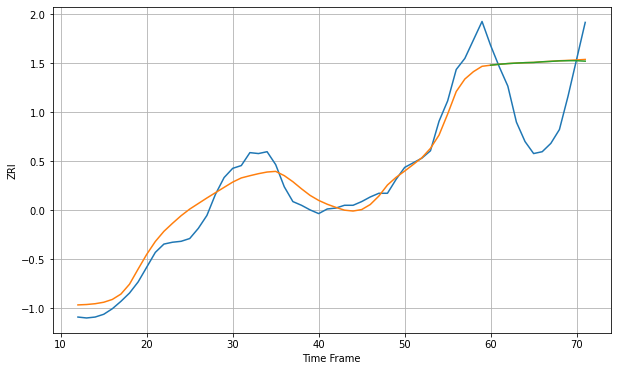

Wall time: 5.36 s
28277 17.040213385109386 63.386310743537024 63.44091122755089 [1388.66083039 1389.66983815 1390.41858209 1390.93837111 1391.38951571
 1391.62002304 1392.32413628 1392.78569437 1393.34124857 1393.53565205
 1393.5154749  1392.99841592]

Got an mse at 0.0100 in round 214 and stopped training

60 60 12


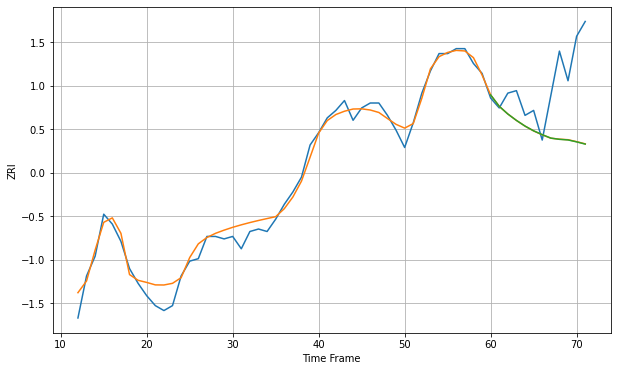

Wall time: 9.43 s
29205 4.172373254448289 23.663011311517334 23.70581946227965 [821.27410576 816.6636357  813.54834933 810.95590161 808.66461064
 806.74253331 805.19149889 803.79785495 803.29642754 803.0560772
 802.26641481 801.37014601]

Got an mse at 0.0100 in round 98 and stopped training

60 60 12


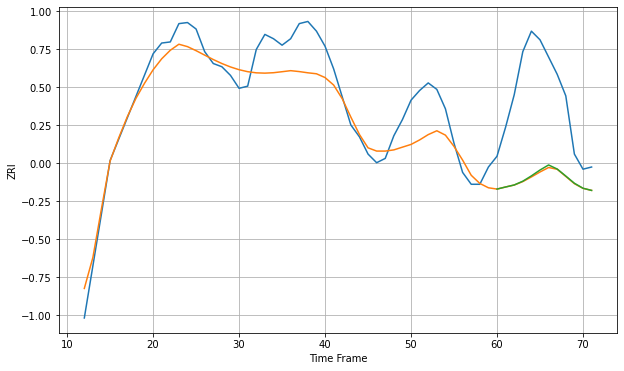

Wall time: 6.75 s
29403 22.432281459022352 83.78199488480728 83.075546471661 [1792.55112092 1794.48239175 1796.36018465 1799.84759901 1804.79791195
 1810.21500698 1814.90882405 1811.16104076 1804.63822594 1797.95821786
 1793.33135682 1791.30331344]

Got an mse at 0.0098 in round 50 and stopped training

60 60 12


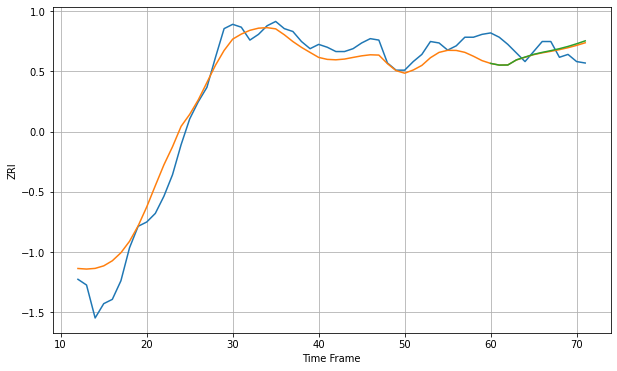

Wall time: 5.85 s
29414 11.894368588956818 11.403640171514862 11.670526714649954 [1310.71543802 1309.54483808 1309.60244604 1313.19782658 1315.15443458
 1317.03472237 1318.41384349 1319.63212367 1320.99716573 1322.5687915
 1324.42277054 1326.46974259]

Got an mse at 0.0098 in round 72 and stopped training

60 60 12


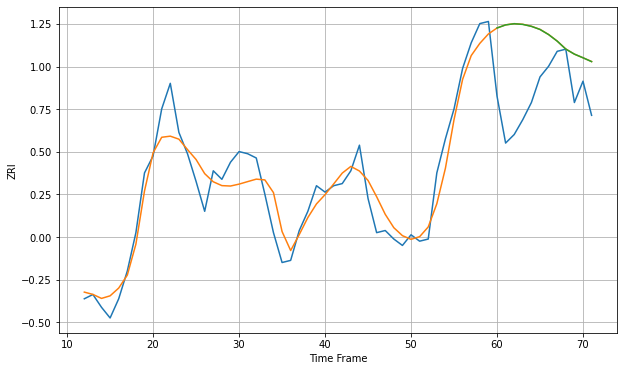

Wall time: 6.22 s
29464 9.299896351509194 31.72839455251738 31.69802375475711 [1570.93856865 1572.38296927 1572.93337392 1572.61668712 1571.70114652
 1570.24563851 1567.84748521 1564.77660947 1561.04674697 1558.69024591
 1556.97683642 1555.18059723]

Got an mse at 0.0088 in round 53 and stopped training

60 60 12


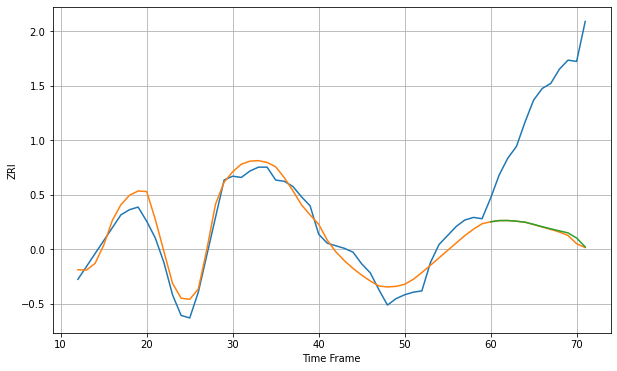

Wall time: 5.74 s
29607 9.267246052749572 104.97721389447766 104.0356286940137 [995.60614949 996.54933011 996.58507243 996.08068081 995.32550679
 993.60239028 991.80601391 990.14169983 988.56891528 987.00274109
 982.99326189 976.14358277]

Got an mse at 0.0098 in round 108 and stopped training

60 60 12


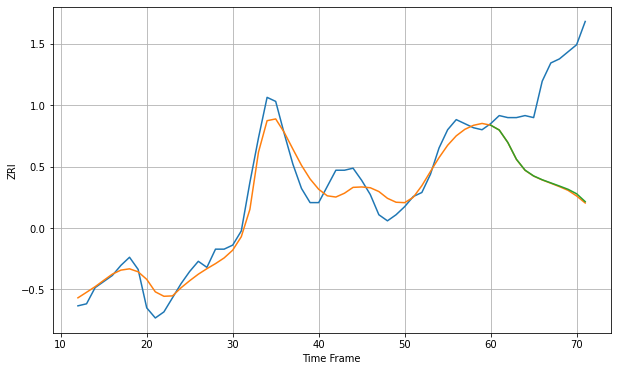

Wall time: 7.05 s
29615 7.040668920381896 50.335528998748686 49.973544532656945 [1003.2613016  1000.86143118  994.71427682  986.40561918  981.04394268
  978.18048099  976.29088726  974.73785292  973.19578514  971.58548937
  969.37486502  965.49154321]

Got an mse at 0.0100 in round 131 and stopped training

60 60 12


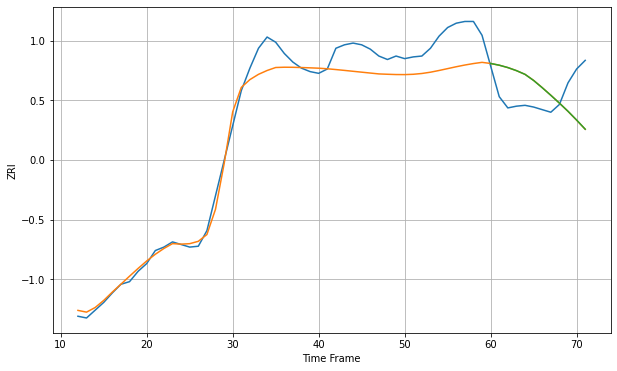

Wall time: 7.56 s
30024 22.478833334159383 40.21843129275762 40.1761906356231 [1447.40338362 1445.41147288 1442.66127292 1439.13340103 1434.81645093
 1427.73630214 1419.375197   1410.59582737 1401.53299215 1392.1009524
 1381.98892929 1371.35315386]

Got an mse at 0.0098 in round 43 and stopped training

60 60 12


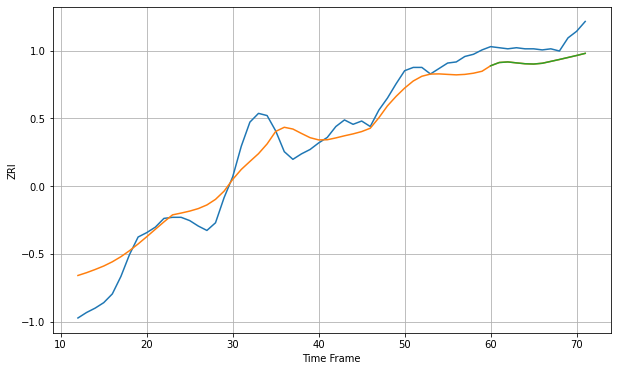

Wall time: 5.52 s
30043 18.13438425833615 16.34316647070916 16.34120060255144 [1283.50513486 1286.47680384 1287.01407591 1286.14411562 1285.34931304
 1285.08301814 1285.80064604 1287.51496196 1289.25792758 1291.08209911
 1292.9056325  1294.84666247]

Got an mse at 0.0099 in round 39 and stopped training

60 60 12


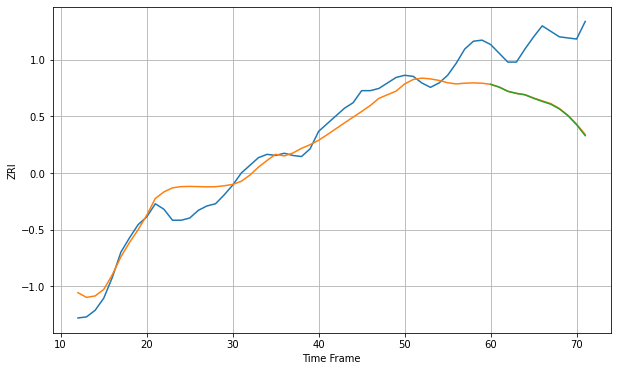

Wall time: 5.39 s
30044 15.489409168975515 60.16199036629775 60.57572773187436 [1107.73379514 1105.21920137 1101.40524411 1099.452443   1098.17995079
 1095.05128992 1092.20982451 1089.64646556 1085.33514418 1079.13816772
 1070.95544631 1061.0297789 ]

Got an mse at 0.0094 in round 92 and stopped training

60 60 12


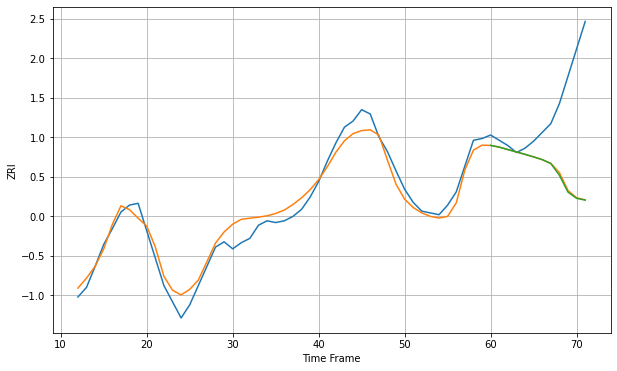

Wall time: 6.35 s
30046 12.69057318864139 90.11414819159646 90.71074174296886 [1043.15007196 1041.20779062 1038.41536782 1035.6877863  1032.90290626
 1030.05253963 1026.87479351 1022.43910607 1008.97409092  989.74211874
  982.68948048  980.69423007]

Got an mse at 0.0100 in round 40 and stopped training

60 60 12


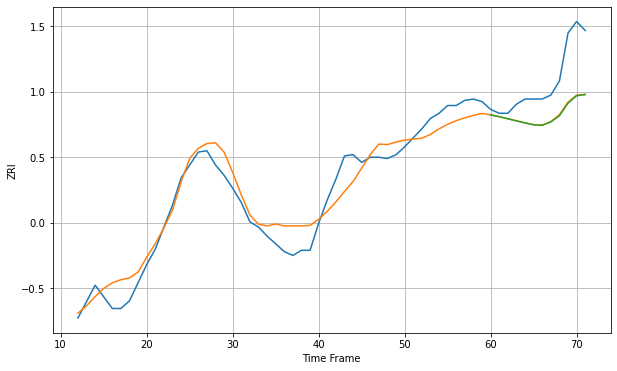

Wall time: 5.71 s
30080 12.422336930110474 30.232630204617866 30.566407485362603 [1246.77794009 1245.34903562 1243.75577874 1242.12971915 1240.56302677
 1239.07798712 1238.70703266 1241.26020481 1246.05629426 1255.80653739
 1261.52557814 1262.41980022]

Got an mse at 0.0097 in round 40 and stopped training

60 60 12


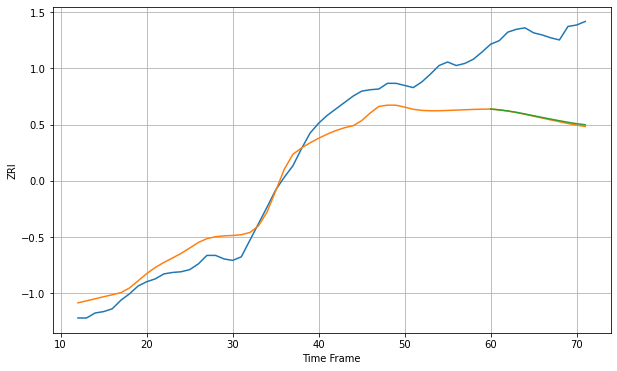

Wall time: 5.31 s
30093 34.18065432840579 119.9848041145088 118.99573282488683 [1073.85742393 1072.72364542 1071.16271064 1069.20163677 1066.85942469
 1064.42324127 1061.99163067 1059.64733634 1057.38992199 1055.20020571
 1053.24649904 1051.76580648]

Got an mse at 0.0099 in round 28 and stopped training

60 60 12


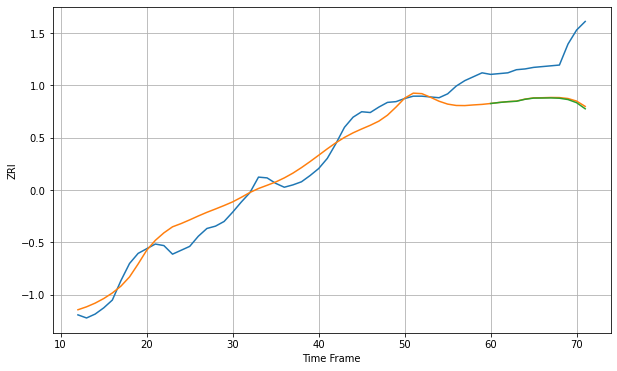

Wall time: 5.15 s
30096 18.193349910189955 56.98531550467436 58.03980790761939 [1239.58435763 1240.89949219 1241.89294897 1242.47799376 1244.99961866
 1246.54210006 1246.62812011 1246.7808753  1246.35441981 1244.67074587
 1240.59997579 1232.78968693]

Got an mse at 0.0097 in round 17 and stopped training

60 60 12


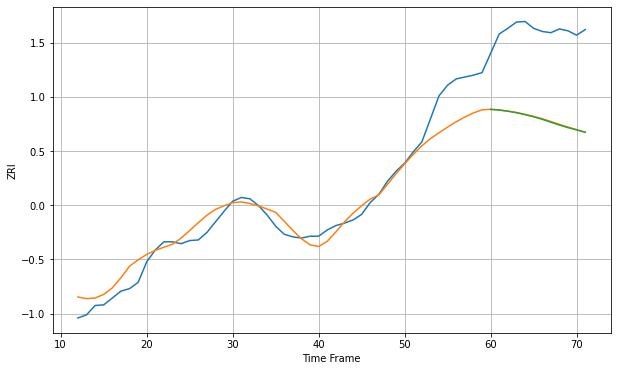

Wall time: 4.64 s
30097 27.289863144334674 141.51328603923315 142.05688382228917 [1418.23442372 1417.09879843 1415.30318894 1412.91180866 1409.74981465
 1406.28649792 1402.25670908 1397.57747537 1393.04180988 1388.91382957
 1385.25785711 1381.47778621]

Got an mse at 0.0100 in round 120 and stopped training

60 60 12


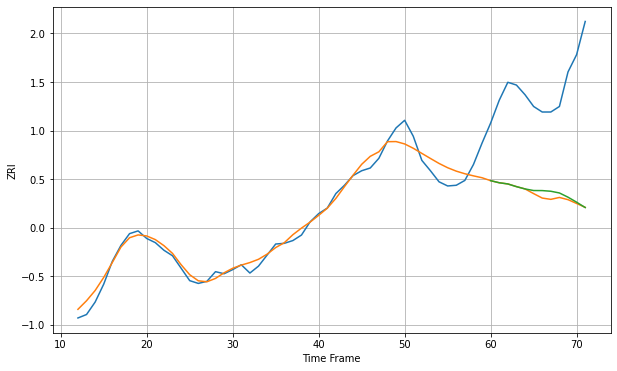

Wall time: 7.35 s
30305 13.94836687324611 158.25645020595056 155.56633265109193 [1646.66873363 1643.64294214 1641.91468452 1638.02705396 1634.70443297
 1632.40183184 1632.30319298 1631.35304954 1628.86623665 1622.7616041
 1615.52607849 1607.78846825]

Got an mse at 0.0098 in round 58 and stopped training

60 60 12


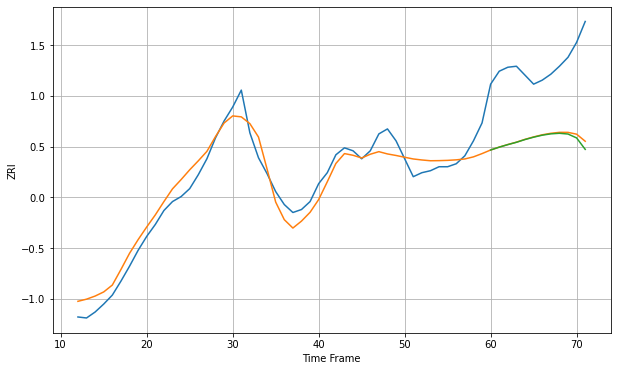

Wall time: 5.83 s
30306 13.375216064971012 75.65388570499697 77.46302172846198 [1425.81261878 1428.6912225  1431.2333387  1433.56375286 1436.34054903
 1438.69786672 1440.70660325 1442.043198   1442.61987066 1441.8678735
 1437.94385512 1426.46239926]

Got an mse at 0.0100 in round 59 and stopped training

60 60 12


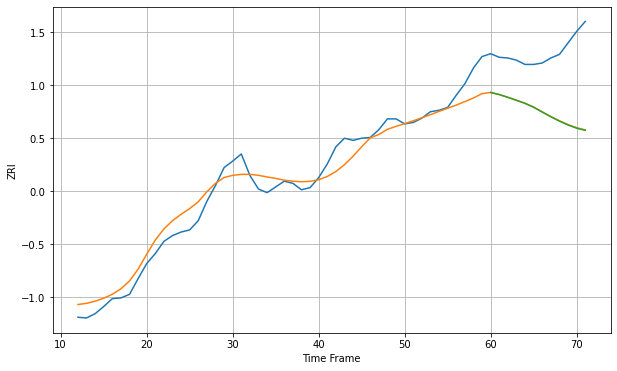

Wall time: 5.84 s
30308 18.96786239333264 87.65372118735444 87.97521646652869 [1596.90092301 1593.93907206 1590.09898547 1585.93946749 1581.69148313
 1576.24504989 1569.52431998 1562.91152048 1556.91937015 1551.41187303
 1546.99645467 1543.96775519]

Got an mse at 0.0099 in round 71 and stopped training

60 60 12


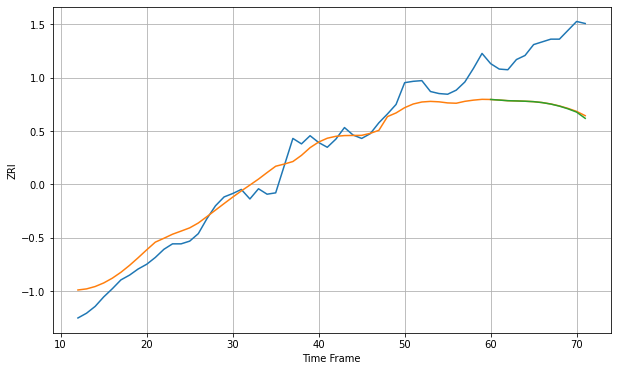

Wall time: 6.21 s
30309 22.876146392564156 90.34393904336123 91.07373602544276 [1603.28680413 1602.43159363 1601.51314473 1601.15294349 1600.71692379
 1600.07597434 1598.69207842 1596.53708901 1593.48566012 1589.54151791
 1584.70668618 1575.55698173]

Got an mse at 0.0099 in round 69 and stopped training

60 60 12


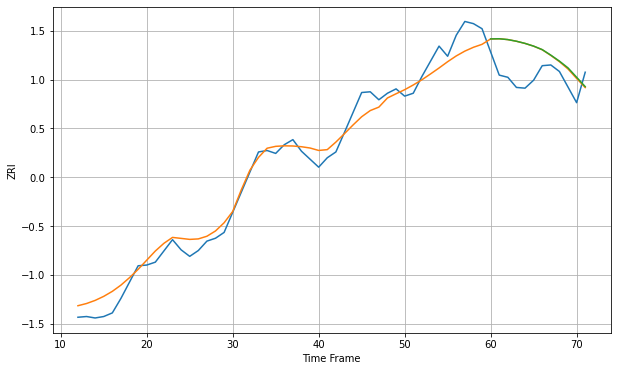

Wall time: 6.12 s
30310 17.182071726915474 39.4007951264648 39.607229175077 [1179.90036243 1180.13709364 1179.00272721 1176.72105267 1173.74319285
 1169.99037439 1165.17652691 1157.57100242 1149.30838484 1139.96595339
 1127.07466778 1114.14332795]

Got an mse at 0.0097 in round 28 and stopped training

60 60 12


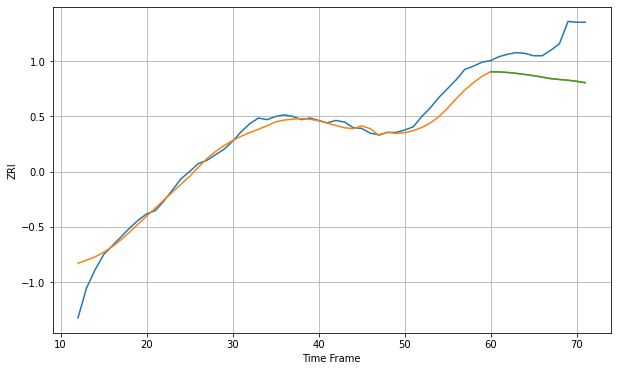

Wall time: 5.17 s
30318 15.00939547877445 44.53453968527763 44.379313100283 [1430.91306064 1430.78337678 1430.04712944 1428.99220234 1427.60441347
 1426.06909256 1424.35001566 1422.50376329 1421.3567778  1420.42289148
 1419.09497846 1417.46008416]

Got an mse at 0.0100 in round 23 and stopped training

60 60 12


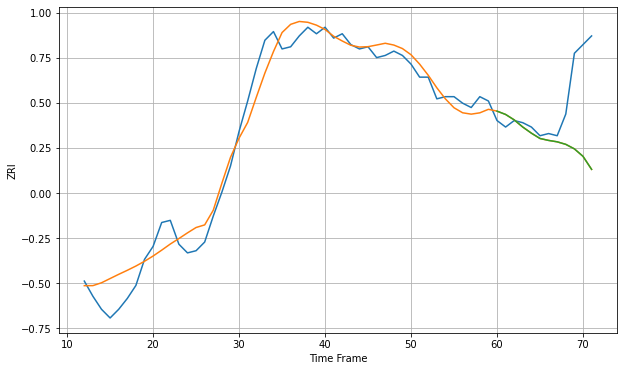

Wall time: 4.96 s
30319 7.5823802204950015 26.85682076992199 26.856409753531395 [1572.33810745 1570.80353177 1568.30218607 1564.99072798 1562.17602916
 1559.72806674 1558.83924036 1558.19148417 1557.0228396  1554.94355597
 1551.50154834 1545.49650656]

Got an mse at 0.0099 in round 28 and stopped training

60 60 12


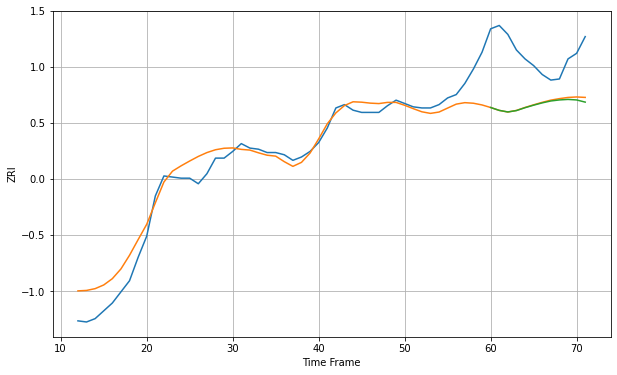

Wall time: 5.03 s
30324 14.676212134614202 48.881896690247935 49.69575006648765 [1459.40241519 1456.8288253  1455.40992175 1456.64033171 1459.22598303
 1461.49226012 1463.55243834 1465.25436525 1466.19639966 1466.6612696
 1466.17994342 1464.23560332]

Got an mse at 0.0099 in round 53 and stopped training

60 60 12


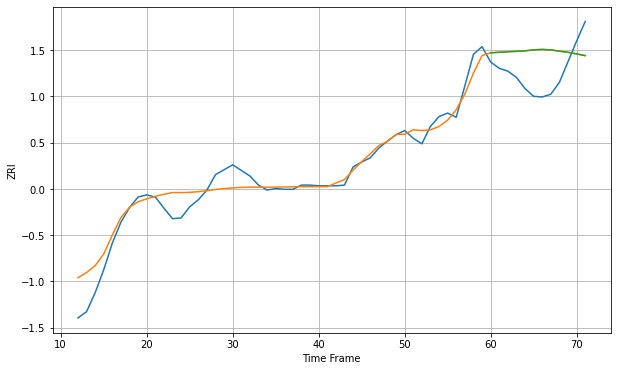

Wall time: 5.59 s
30326 19.212111542948815 44.466020295472674 44.4418158061604 [1670.14932681 1670.96752253 1671.68448066 1672.27593109 1672.93913145
 1674.47070094 1675.00610753 1674.36449685 1672.5170453  1670.89028124
 1668.67344994 1666.21517642]

Got an mse at 0.0098 in round 36 and stopped training

60 60 12


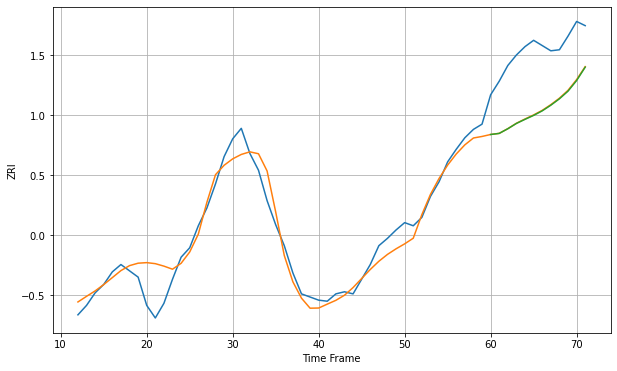

Wall time: 5.21 s
30328 14.97682341300561 55.91638831418687 56.3221192329256 [1500.12665084 1501.16390166 1505.61268665 1510.67342249 1514.59341393
 1518.33406559 1522.68105416 1528.0629941  1534.17614012 1541.47597295
 1551.61310375 1564.39137108]

Got an mse at 0.0098 in round 39 and stopped training

60 60 12


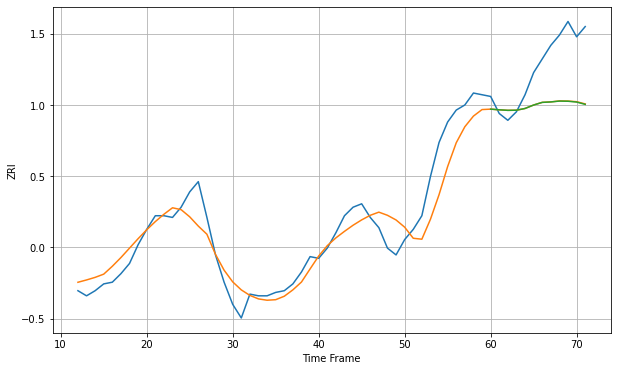

Wall time: 5.33 s
30329 11.754640146297353 28.070107232792452 28.16375036145102 [1475.55360147 1475.15555546 1474.84655315 1474.92005361 1475.94264696
 1477.96297603 1479.51228518 1479.76919662 1480.28245453 1480.17738807
 1479.7116139  1478.34265541]

Got an mse at 0.0100 in round 132 and stopped training

60 60 12


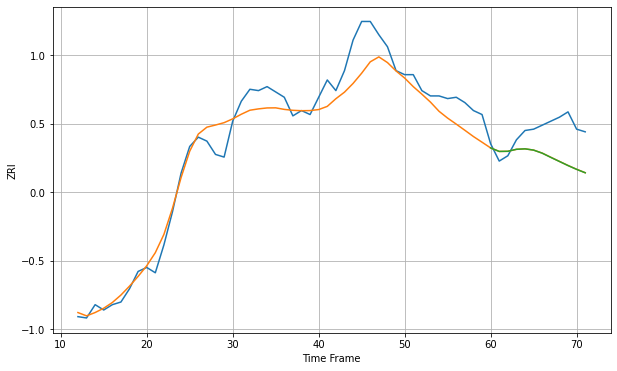

Wall time: 7.34 s
30338 14.110394505762747 22.95793173541754 22.999842523678097 [1423.89179548 1421.25555869 1421.35747567 1422.85698329 1423.20451335
 1422.24079735 1419.93818675 1416.78006897 1413.70377846 1410.63031659
 1407.77448632 1405.20731014]

Got an mse at 0.0099 in round 79 and stopped training

60 60 12


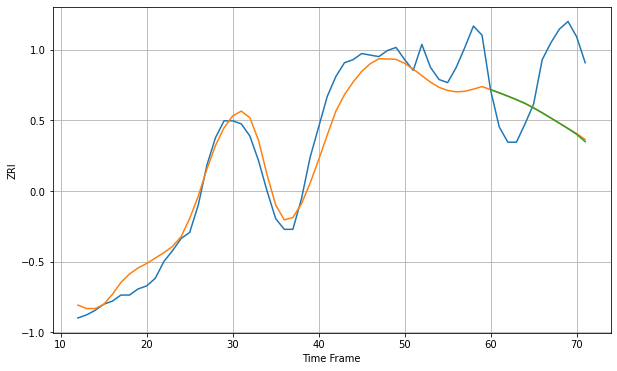

Wall time: 6.12 s
30339 13.81158083324337 42.04493414230082 42.27635478259198 [1377.38356544 1375.3215519  1373.14270592 1370.85724604 1368.40126261
 1365.4539431  1362.25436376 1358.84954869 1355.39860482 1351.88449516
 1348.16595978 1343.33113645]

Got an mse at 0.0098 in round 55 and stopped training

60 60 12


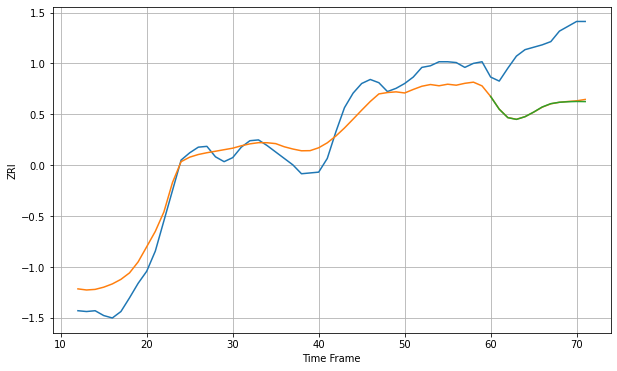

Wall time: 5.59 s
30341 22.31184908362753 77.79523244033403 78.16519531299373 [1334.90281118 1319.07871782 1308.61224179 1306.47061628 1309.80532473
 1315.50126642 1321.86012889 1325.98719117 1327.75309707 1328.38198271
 1328.70446577 1328.56310051]

Got an mse at 0.0099 in round 65 and stopped training

60 60 12


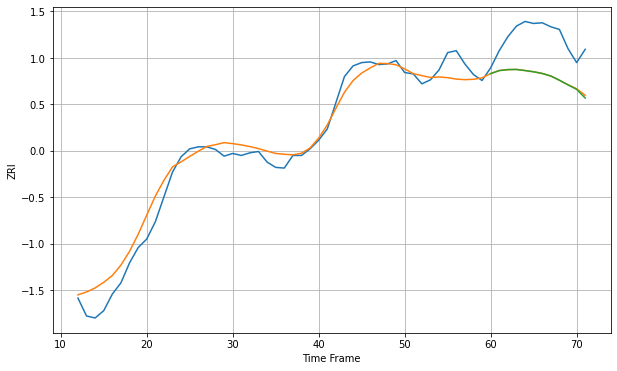

Wall time: 5.74 s
30345 19.940220927402873 61.202070750832966 61.73998946647727 [1481.39320815 1485.97321589 1487.4307896  1487.66168823 1485.99320704
 1484.11968136 1481.57971681 1477.73636522 1471.28589773 1464.31604161
 1457.68805967 1444.54324641]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


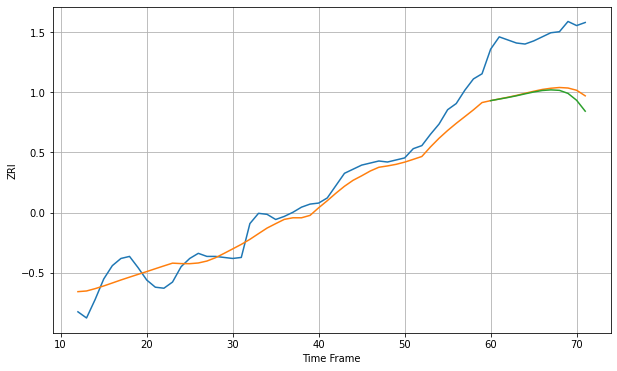

Wall time: 5.6 s
30350 14.0200679888803 56.5892126195426 60.28711499212395 [1301.82793813 1303.35420055 1304.8789169  1306.55912812 1308.45181083
 1310.23492763 1311.70982827 1312.32268444 1311.8617443  1308.89653257
 1302.17866708 1291.54996129]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


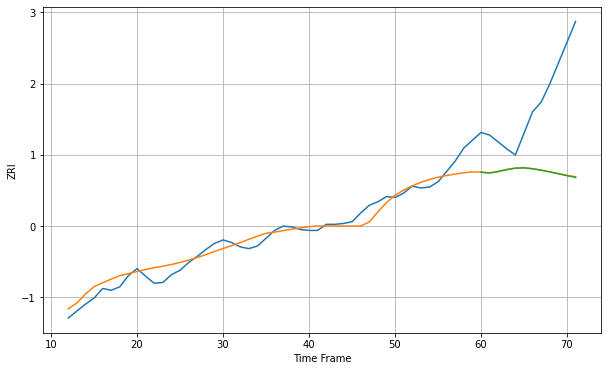

Wall time: 5.63 s
30605 11.051981692023828 91.40770022557736 91.5963077684573 [856.18019172 855.2372126  856.91167581 859.19504384 860.78992283
 861.19281704 860.12549722 858.47730997 856.50118417 854.39187318
 852.14127506 850.12308411]

Got an mse at 0.0098 in round 35 and stopped training

60 60 12


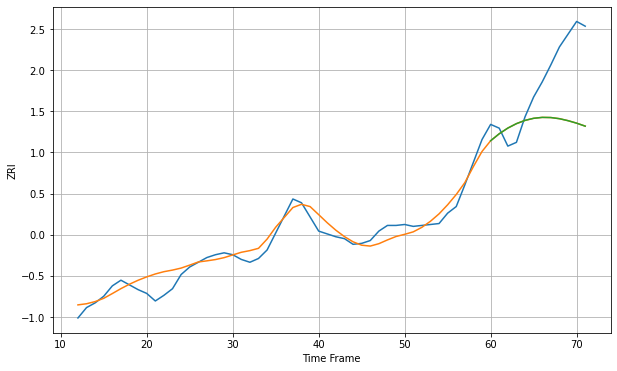

Wall time: 5.13 s
30606 10.409155295121833 59.91089826861055 59.92953262415187 [953.67974155 961.07256016 967.101209   971.79718824 975.24739251
 977.44674554 978.42162748 978.24903795 977.03491003 974.92754649
 972.29979173 969.13170151]

Got an mse at 0.0100 in round 117 and stopped training

60 60 12


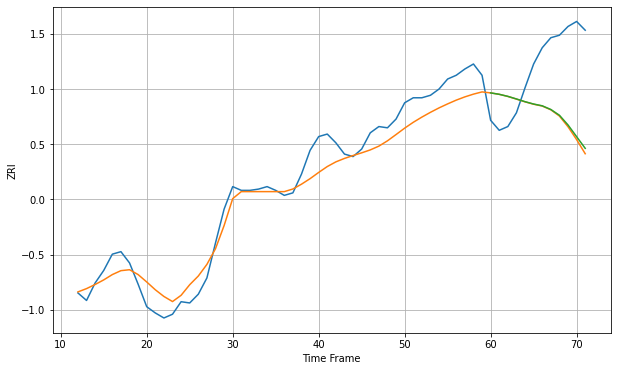

Wall time: 7.63 s
31401 13.899724617762088 56.212723704937915 54.986269793676584 [1371.90173957 1370.78008917 1369.13719465 1367.05439898 1364.88603095
 1363.00519767 1361.58906435 1358.65025452 1354.04706992 1346.28522416
 1336.91518544 1327.58955276]

Got an mse at 0.0100 in round 389 and stopped training

60 60 12


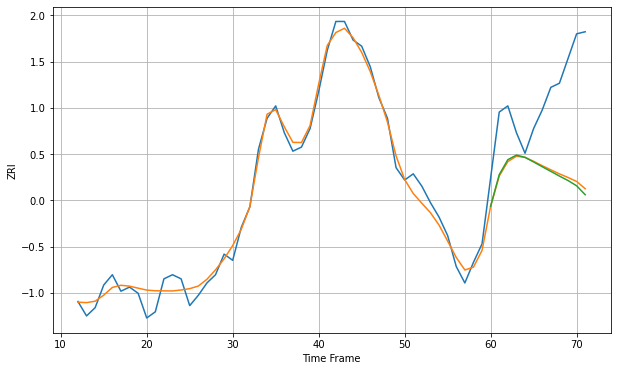

Wall time: 13.7 s
32204 4.887532112376658 41.668762476803984 42.67740701430877 [1011.28223226 1026.6081233  1033.8893263  1036.09277951 1035.0169401
 1032.7869426  1030.4521652  1028.19879645 1025.9148063  1023.75681034
 1021.20159955 1016.85012014]

Got an mse at 0.0098 in round 73 and stopped training

60 60 12


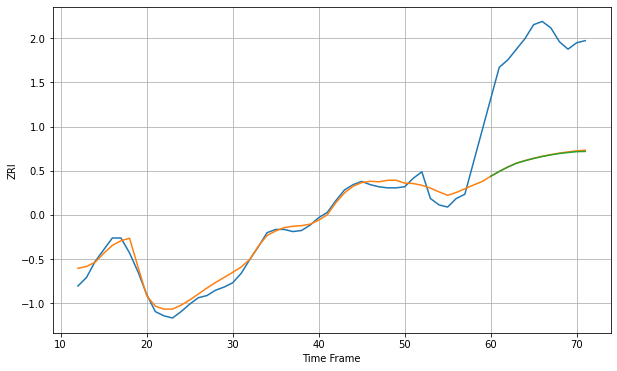

Wall time: 6.43 s
32205 9.910891251383367 106.51676701034049 106.83546998197376 [912.79998565 917.34438309 921.52439536 925.06398578 927.46439584
 929.5550787  931.36925151 932.89731415 934.18736126 935.14539721
 935.93737739 936.12210051]

Got an mse at 0.0100 in round 45 and stopped training

60 60 12


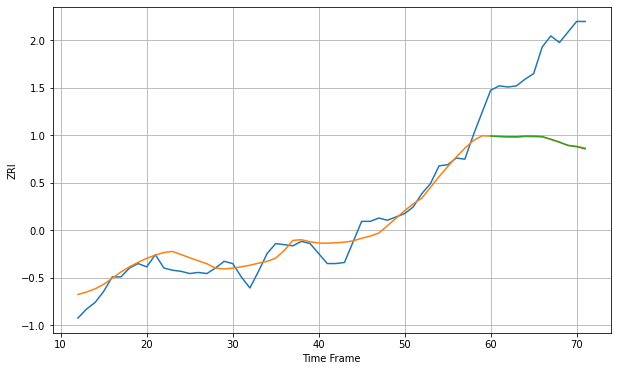

Wall time: 5.49 s
32207 10.586026252651548 78.06306962466029 78.08630411979709 [980.8075685  980.47994863 980.22904719 980.23018632 980.78401239
 980.77420788 980.40880282 977.89689309 975.32454799 972.35538897
 971.2079665  969.29757021]
60 60 12


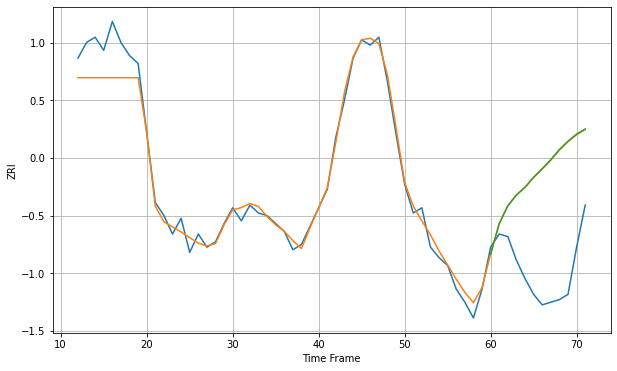

Wall time: 15.9 s
32209 5.811639329777289 39.67079360491929 39.80276086769576 [816.3917535  827.98017905 834.74558563 838.8854313  841.80448533
 845.63910782 848.8995096  852.35024536 856.20257056 859.38964885
 862.08127832 864.02131799]

Got an mse at 0.0100 in round 50 and stopped training

60 60 12


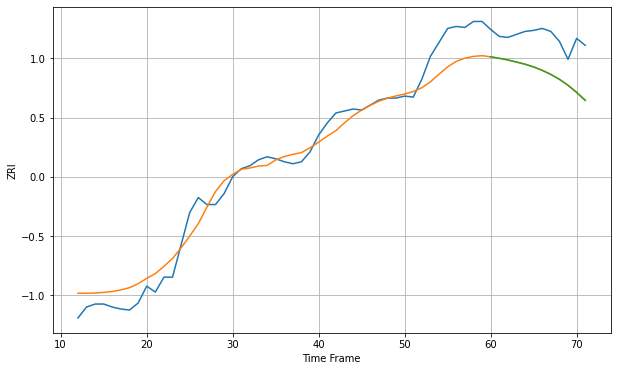

Wall time: 5.59 s
32224 17.08195793330907 37.29176658558312 37.3747234467959 [1299.44415519 1297.99715508 1296.33680844 1294.23658563 1292.02878192
 1289.29973885 1285.87328454 1281.78058747 1276.84201548 1270.84740557
 1263.65721068 1255.63895464]

Got an mse at 0.0099 in round 51 and stopped training

60 60 12


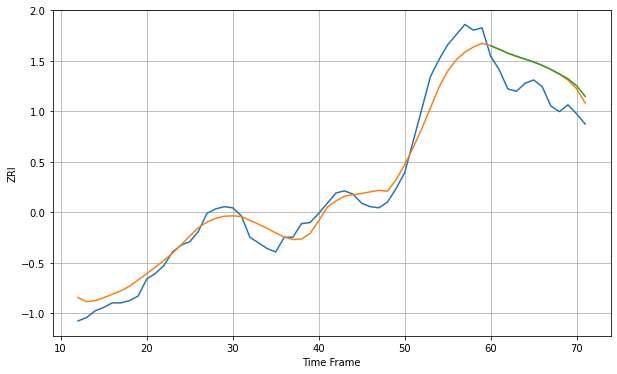

Wall time: 5.44 s
32225 12.598602336191629 23.896162485275223 24.724648488158994 [1161.25605149 1158.02937094 1154.61310757 1151.895918   1149.40195047
 1146.89229786 1143.85545573 1140.3194862  1136.37736639 1131.99752262
 1125.92098926 1116.4201461 ]

Got an mse at 0.0097 in round 41 and stopped training

60 60 12


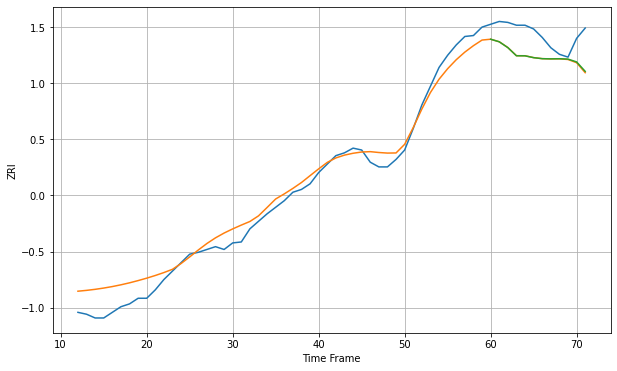

Wall time: 5.17 s
32246 14.007610999795135 25.98693517912651 25.736329150930626 [1318.08321495 1315.3410514  1309.14541985 1300.42362975 1300.38409451
 1298.42652549 1297.33838913 1297.14275465 1297.28463145 1296.88239584
 1293.88766096 1283.81087623]

Got an mse at 0.0100 in round 45 and stopped training

60 60 12


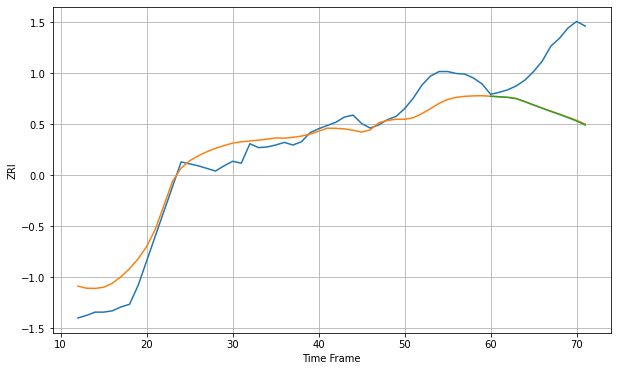

Wall time: 5.27 s
32250 27.641725472461104 90.28435852960575 90.7899697963335 [1367.00700711 1366.190802   1365.28342958 1363.36960387 1358.55174849
 1353.57743461 1348.60603407 1343.78845447 1339.07745625 1334.19399504
 1328.93188097 1322.6899921 ]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


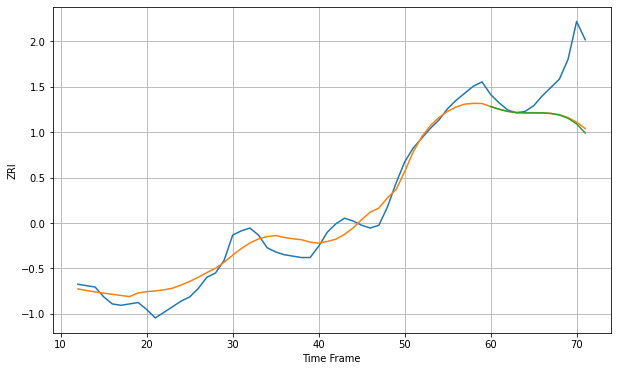

Wall time: 5.52 s
32256 9.130817196945676 31.758380572264976 32.5790765793161 [1213.47767083 1211.50456509 1210.00867517 1209.200126   1208.94930657
 1208.94115571 1208.94018067 1208.53225451 1207.43815159 1205.12304057
 1201.10008317 1194.60561366]

Got an mse at 0.0097 in round 41 and stopped training

60 60 12


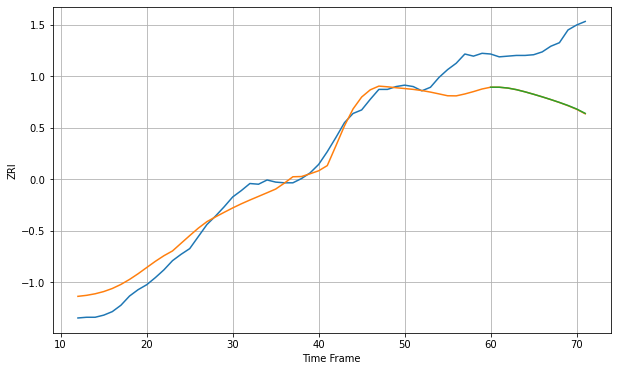

Wall time: 5.22 s
32701 22.881837098716836 78.36778560395057 78.1870337949655 [1131.08656193 1131.07628993 1129.92349935 1127.64426573 1124.56062936
 1121.11586634 1117.47898291 1113.64878269 1109.60746227 1105.25494072
 1100.33822032 1094.13057841]

Got an mse at 0.0097 in round 39 and stopped training

60 60 12


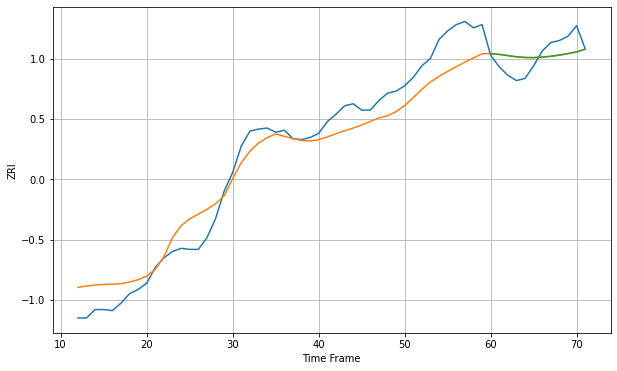

Wall time: 5.22 s
32703 20.788020992062535 15.101296269923608 15.086157029703582 [1294.59340893 1293.82321841 1292.62976153 1291.52440734 1290.86949271
 1290.73335162 1291.21695193 1292.02389547 1293.14062027 1294.55469432
 1296.19356191 1298.78328894]

Got an mse at 0.0096 in round 38 and stopped training

60 60 12


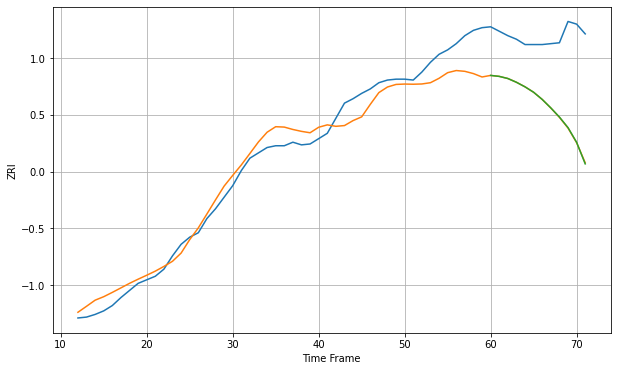

Wall time: 5.15 s
32714 18.680829771902744 84.1029388407468 84.13456004831487 [1192.22501748 1191.12691389 1188.73135326 1184.49937866 1179.36066564
 1173.253902   1165.17486944 1155.65314517 1145.34307295 1133.43754708
 1116.8814769  1092.56167845]

Got an mse at 0.0100 in round 78 and stopped training

60 60 12


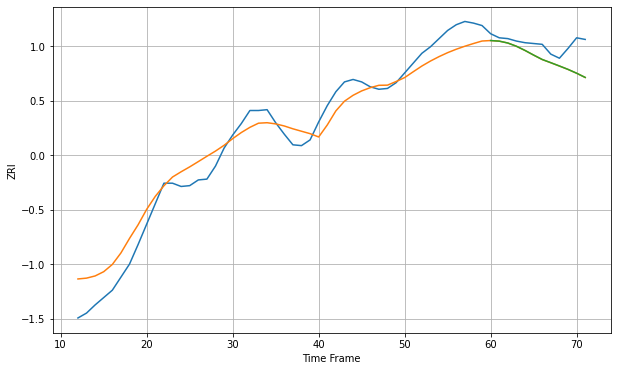

Wall time: 6.08 s
32771 21.388803607357733 21.81634111620055 21.775233694962058 [1202.6353521  1201.91019406 1199.61795887 1195.65477416 1190.53503827
 1184.85934121 1179.44721866 1175.52359155 1171.49012201 1167.33773225
 1162.65691788 1157.49311416]

Got an mse at 0.0099 in round 35 and stopped training

60 60 12


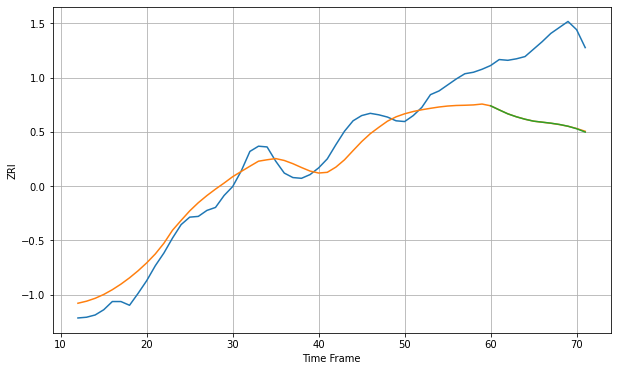

Wall time: 5.31 s
32792 22.94025351451756 103.16855435320333 103.26106905920166 [1241.07317654 1235.59024718 1230.32978259 1226.35379006 1223.09924907
 1220.52475291 1219.17312906 1217.82840786 1216.0963453  1213.73846843
 1210.4016411  1205.90175481]

Got an mse at 0.0097 in round 68 and stopped training

60 60 12


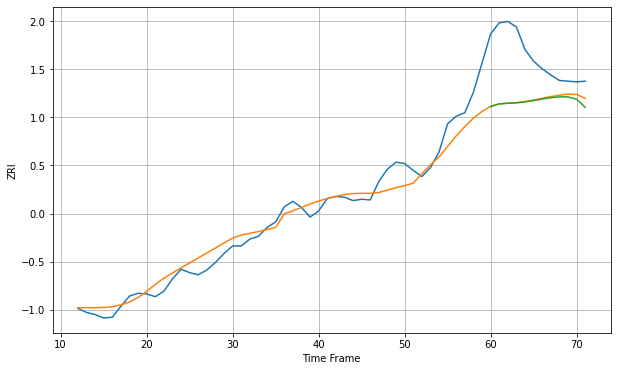

Wall time: 5.92 s
32801 19.434940457471455 73.54612932932217 74.68122460667423 [1554.15684562 1557.89352969 1558.72783852 1559.38767995 1560.75544808
 1562.68736894 1564.95577315 1566.90981777 1568.15742321 1568.10101451
 1564.68547898 1552.94612028]

Got an mse at 0.0098 in round 62 and stopped training

60 60 12


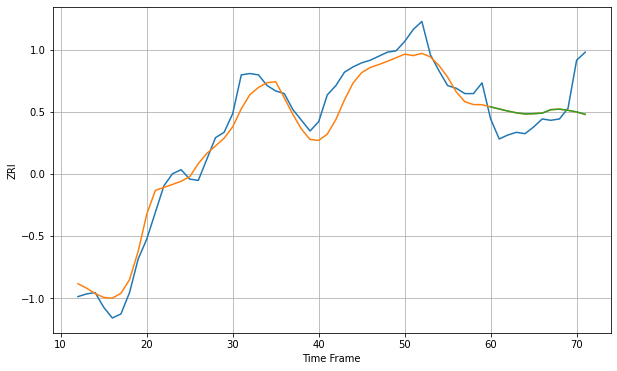

Wall time: 5.63 s
32803 12.027293072737118 20.925111802915932 20.88847178253891 [1480.04477314 1478.46627958 1476.91106751 1475.59347805 1474.7600684
 1474.97018896 1475.37810061 1477.96400266 1478.38600885 1477.48735445
 1476.29961148 1474.51126184]

Got an mse at 0.0096 in round 33 and stopped training

60 60 12


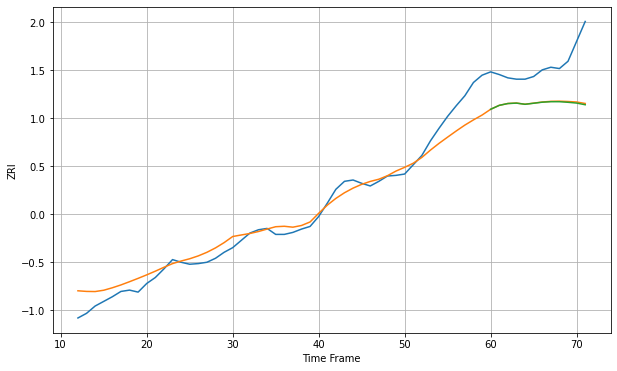

Wall time: 5 s
32810 19.97338930656913 61.83912685554391 62.59050335850984 [1359.5939987  1365.52074192 1368.26757689 1368.90333059 1367.12032289
 1368.70774666 1370.29452959 1371.06156005 1371.02353902 1370.14955763
 1368.96704528 1366.46390868]

Got an mse at 0.0099 in round 45 and stopped training

60 60 12


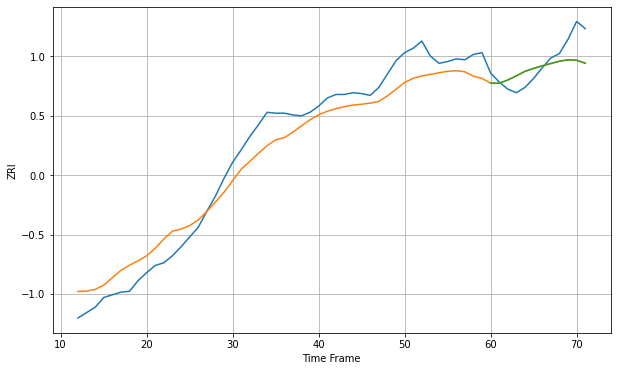

Wall time: 5.36 s
32811 21.965180835765622 20.583961029376816 20.645430426922548 [1313.78791667 1313.69530189 1317.24594989 1321.97626839 1326.99749946
 1330.3145767  1333.15588795 1335.77641533 1338.28736075 1339.9778823
 1339.36403545 1336.05159324]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


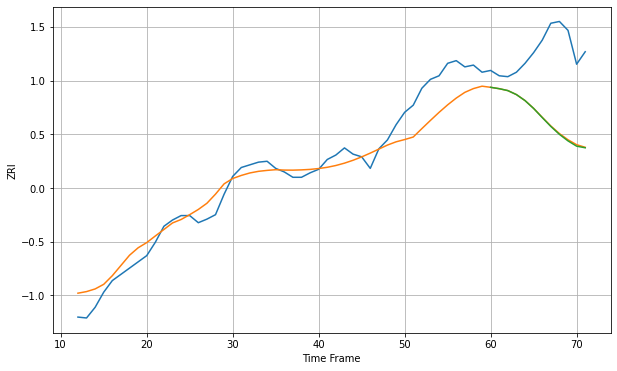

Wall time: 5.43 s
32812 20.301674868098125 80.91274694671625 81.49544634296157 [1381.04758044 1379.50096438 1377.35598522 1372.85891571 1366.12724554
 1357.30275578 1347.10908143 1337.11293833 1328.22088204 1320.85753307
 1314.95495331 1313.1521188 ]

Got an mse at 0.0095 in round 19 and stopped training

60 60 12


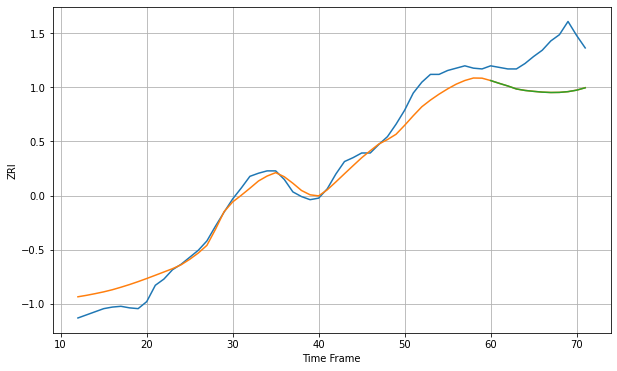

Wall time: 4.92 s
32822 16.947808018851532 52.88860806403912 52.92185946246862 [1305.07734991 1301.50018649 1298.11211739 1294.27350439 1292.36243408
 1291.19590223 1290.20480326 1289.71144648 1289.85757935 1290.81379676
 1292.70998246 1295.7863548 ]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


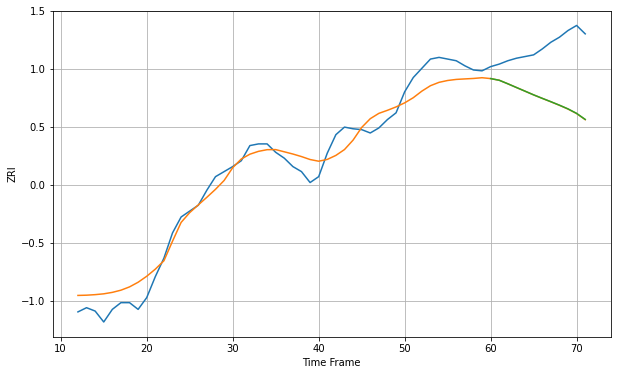

Wall time: 5.58 s
32825 17.457505559959138 65.65348069668555 65.53997746899174 [1275.75742551 1273.77413508 1269.56634575 1265.15547498 1260.78974814
 1256.38379042 1252.27376233 1248.25652325 1244.10699205 1239.66515907
 1234.33377807 1227.12976591]

Got an mse at 0.0097 in round 47 and stopped training

60 60 12


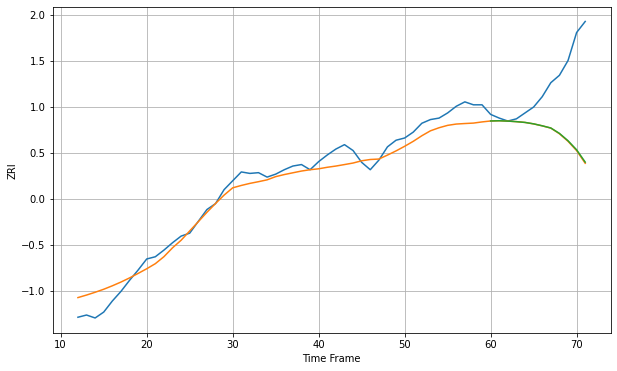

Wall time: 5.37 s
32835 15.830860192392613 85.14779579726383 84.54434845758966 [1273.08406191 1273.40231092 1272.91961758 1272.17809231 1271.11431586
 1269.17780284 1266.55077881 1263.56727501 1256.28177471 1246.30857052
 1234.00965397 1217.31575509]

Got an mse at 0.0097 in round 30 and stopped training

60 60 12


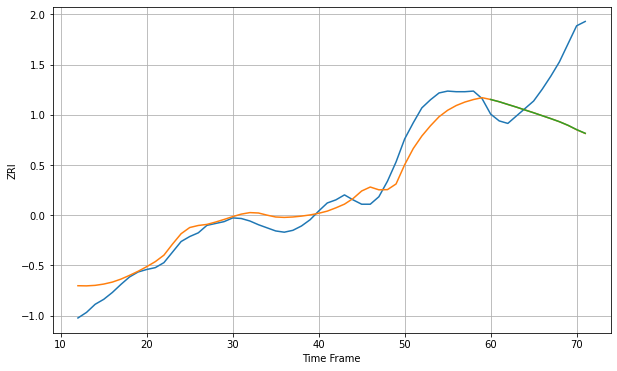

Wall time: 5.09 s
32837 22.441622240919557 89.59102624476273 89.51362949136985 [1574.49749874 1570.86378555 1566.4910534  1562.21461806 1557.59901709
 1553.14231341 1548.3878056  1543.68826624 1538.74078138 1532.94924841
 1526.06251087 1520.10035607]

Got an mse at 0.0093 in round 21 and stopped training

60 60 12


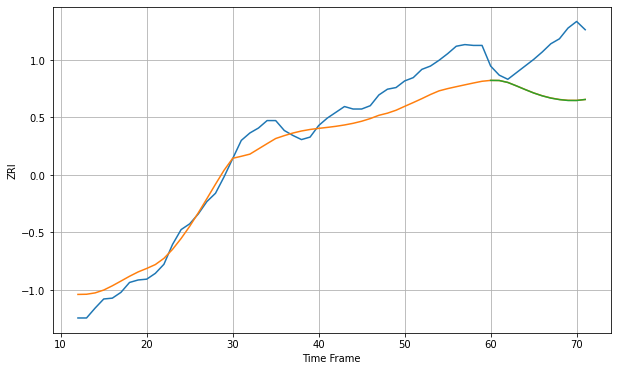

Wall time: 4.8 s
32839 23.53388289554258 57.35105380364967 57.441144372868976 [1309.64347575 1309.52577783 1307.1577116  1302.99718542 1298.62703776
 1294.44426576 1290.9532599  1288.22574593 1286.39948679 1285.35138044
 1285.31140851 1286.53593211]

Got an mse at 0.0099 in round 36 and stopped training

60 60 12


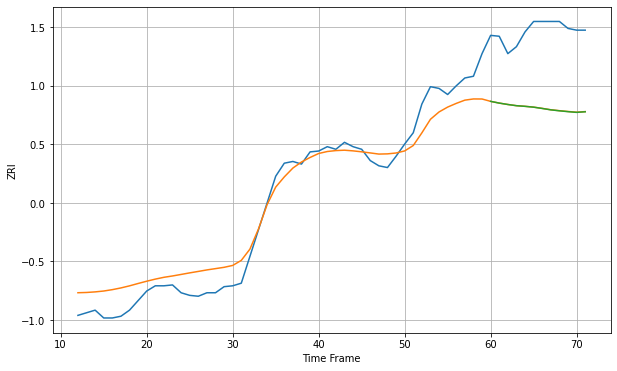

Wall time: 5.09 s
32935 20.85027708356956 88.6661429827556 88.76686483040828 [1144.11558361 1142.1212365  1140.51132587 1139.1274773  1138.3843298
 1137.42939277 1135.95424588 1134.34203852 1133.24646493 1132.27210071
 1131.45256461 1132.1530854 ]

Got an mse at 0.0100 in round 76 and stopped training

60 60 12


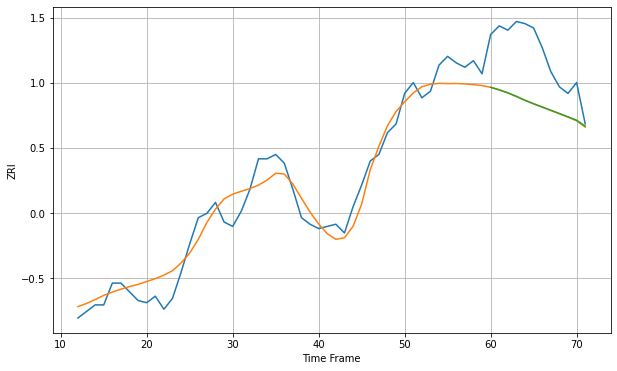

Wall time: 6.1 s
33009 7.416861627865499 25.058767185530446 25.044864345059946 [1629.80563581 1628.62454056 1627.24929111 1625.59653684 1623.82644203
 1622.23620515 1620.75053543 1619.26514588 1617.78011501 1616.25487646
 1614.68309963 1611.98065952]
60 60 12


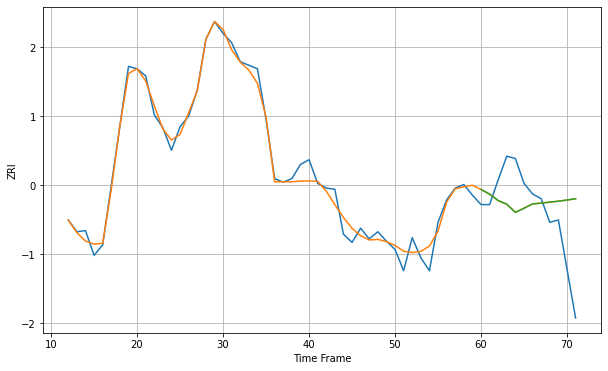

Wall time: 15.6 s
33010 7.679505556689691 39.73459709132809 39.75376950429662 [1777.78682381 1773.87864072 1768.46569554 1765.34381638 1758.38813474
 1761.88231992 1765.57936046 1766.2027752  1767.09588146 1767.88842402
 1768.87333701 1769.98392767]

Got an mse at 0.0098 in round 123 and stopped training

60 60 12


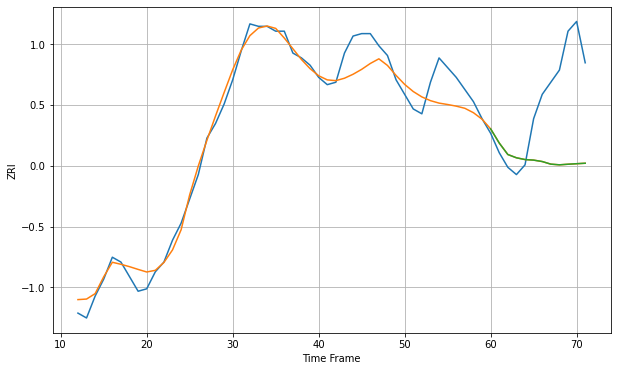

Wall time: 7.1 s
33020 6.6419065336581244 31.548047006342216 31.541428970696682 [1344.79643529 1338.98637457 1334.2542991  1332.90886155 1332.17795129
 1331.94771367 1331.36980963 1330.30124953 1330.01815862 1330.25908003
 1330.47759808 1330.66839512]

Got an mse at 0.0100 in round 35 and stopped training

60 60 12


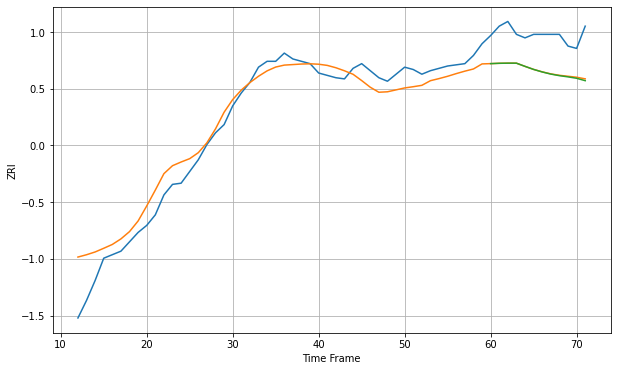

Wall time: 5.51 s
33024 14.390695798424717 31.096566239262067 31.442846332421492 [1512.02846884 1512.30393198 1512.41779251 1512.40584452 1509.68139288
 1507.06900763 1504.91292182 1503.09401602 1501.75083652 1500.72061505
 1499.52469955 1497.47007206]

Got an mse at 0.0098 in round 59 and stopped training

60 60 12


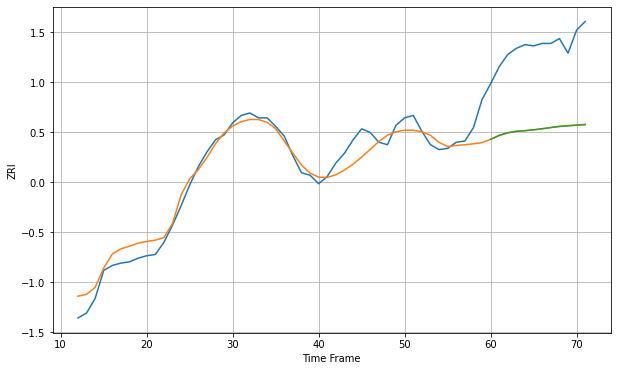

Wall time: 6.5 s
33025 10.279476162144986 67.83595652326954 67.90348450428884 [1539.42366109 1542.61521463 1544.79017015 1545.97471097 1546.50679247
 1547.17087108 1548.08049741 1549.0532872  1549.96721367 1550.47378626
 1550.98802661 1551.40258963]

Got an mse at 0.0100 in round 151 and stopped training

60 60 12


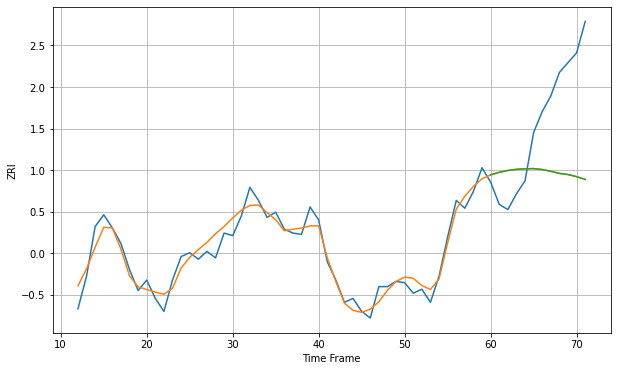

Wall time: 9.2 s
33062 7.994807898500298 61.205754949143184 61.213177357474876 [1613.55717523 1615.53468728 1616.89012957 1617.80814098 1618.16897555
 1618.35586413 1617.6259686  1616.25851222 1614.67690243 1613.81406502
 1612.16842419 1610.08983988]

Got an mse at 0.0098 in round 53 and stopped training

60 60 12


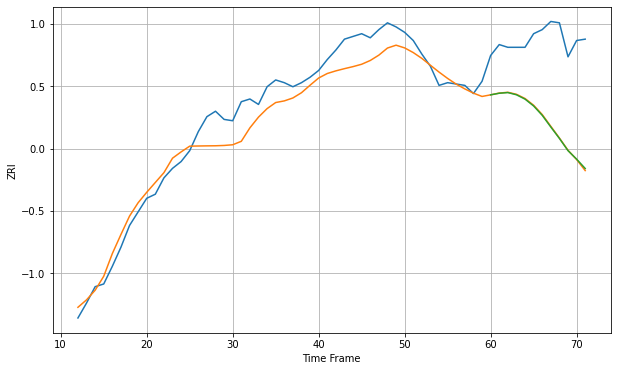

Wall time: 6.41 s
33065 13.069267891339372 62.788418767628656 62.81256589312895 [1505.04898131 1506.23038095 1506.71046763 1505.10599201 1501.90449109
 1496.86802953 1489.99607793 1481.39797986 1473.00751161 1464.00372459
 1457.78025286 1450.89861139]

Got an mse at 0.0100 in round 58 and stopped training

60 60 12


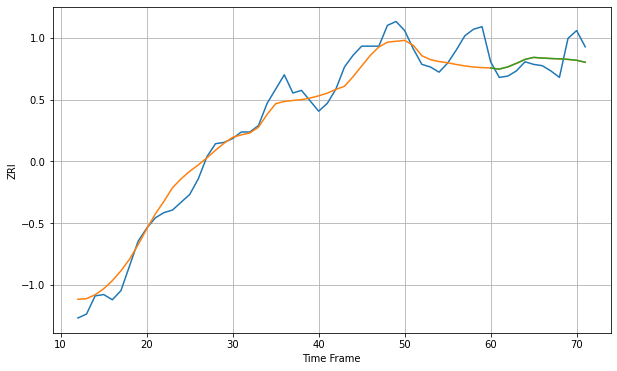

Wall time: 7.01 s
33066 11.901272110477572 10.93348126036103 10.914021781510309 [1439.22129516 1438.354806   1440.07900535 1442.80075242 1445.814579
 1447.38073241 1446.85993793 1446.52305405 1446.28079725 1445.86949611
 1445.16888939 1443.6786851 ]

Got an mse at 0.0097 in round 99 and stopped training

60 60 12


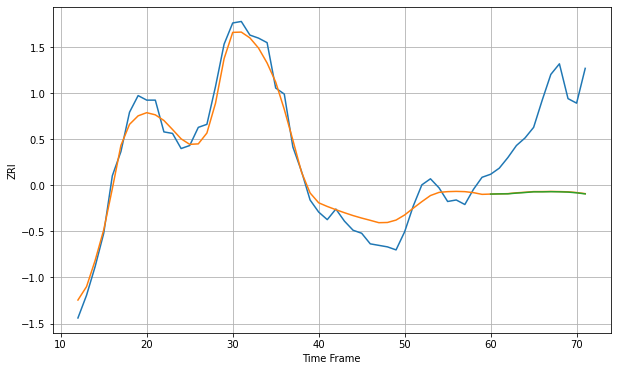

Wall time: 7.63 s
33125 8.839696193357605 54.78214677339129 54.91998452914573 [1679.90107104 1680.02467162 1680.06851202 1680.55043999 1680.93686035
 1681.38987756 1681.3779652  1681.49032831 1681.39980873 1681.21180492
 1680.72974421 1680.01788005]

Got an mse at 0.0098 in round 38 and stopped training

60 60 12


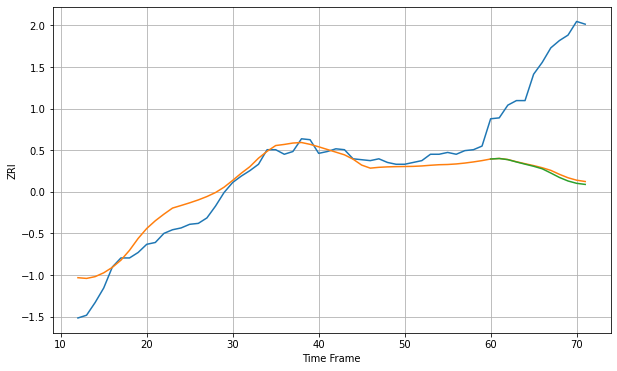

Wall time: 6 s
33126 15.44750656102034 117.29537640231126 119.34484805694233 [1632.78859756 1633.32317012 1632.08092561 1629.5251186  1627.12128087
 1624.78336149 1622.01710359 1617.36215522 1612.49553254 1608.61424788
 1606.05646362 1604.85123689]

Got an mse at 0.0099 in round 212 and stopped training

60 60 12


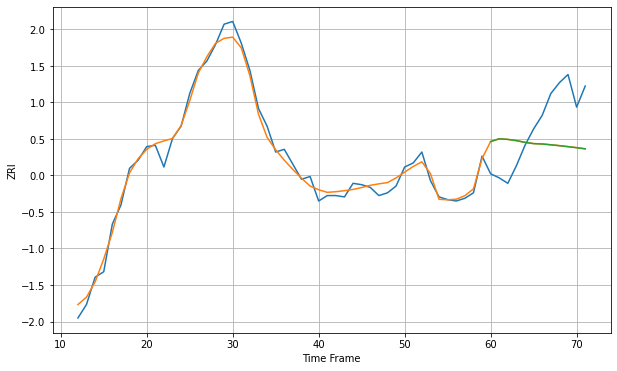

Wall time: 10.7 s
33127 5.787127085014157 32.55620370065166 32.576217508908606 [1759.70213092 1761.7295106  1761.28357941 1760.39094433 1759.09680952
 1758.18759252 1757.90671136 1757.32871712 1756.66892135 1755.94250734
 1755.17904721 1754.34185341]

Got an mse at 0.0098 in round 112 and stopped training

60 60 12


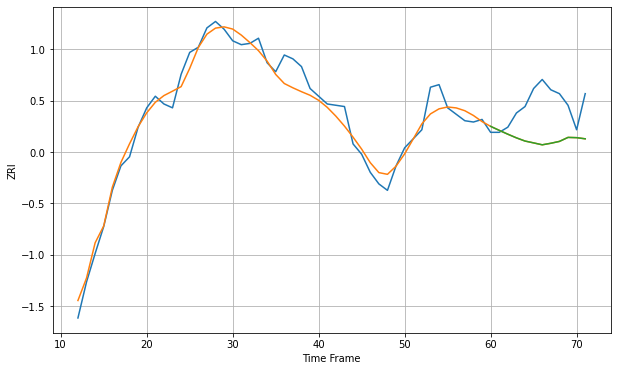

Wall time: 7.92 s
33130 9.294487650198914 29.53434179011196 29.534963849458023 [1754.63076113 1751.53801642 1748.54806357 1745.71970362 1743.24071824
 1741.80410796 1740.329511   1741.52409211 1742.95735874 1746.06774107
 1745.85950234 1744.97538269]

Got an mse at 0.0099 in round 120 and stopped training

60 60 12


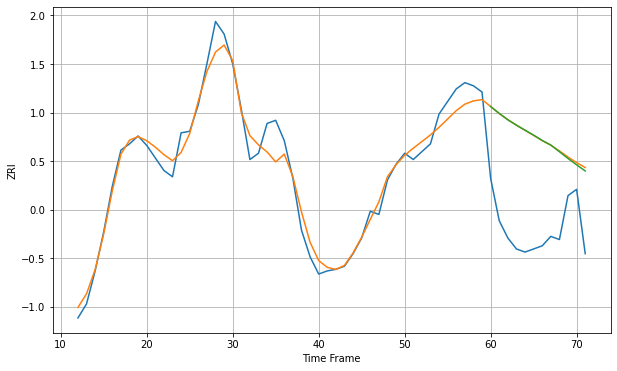

Wall time: 7.99 s
33131 8.637675422335565 61.18018896242311 60.95825682154466 [2280.77580249 2276.36451766 2272.36606334 2268.90808422 2265.70213077
 2262.52143562 2259.16946371 2256.21496851 2251.96446182 2247.68117505
 2243.61806085 2239.73335037]

Got an mse at 0.0100 in round 222 and stopped training

60 60 12


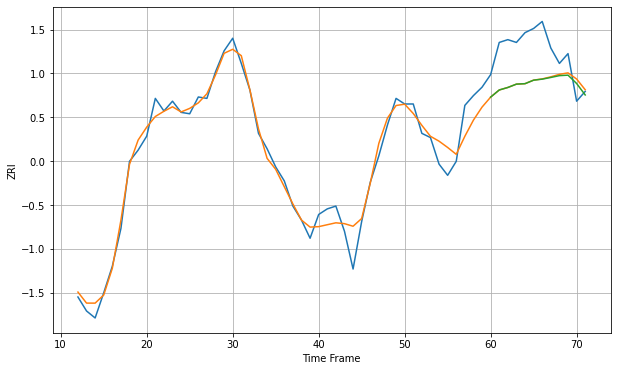

Wall time: 10.1 s
33132 9.1080594681054 27.051103998791316 27.068394965474322 [2030.90869298 2036.0084304  2037.81233927 2040.20116884 2040.52228202
 2043.02111672 2043.75411123 2044.96474681 2046.25875047 2046.61464992
 2040.64443043 2032.453311  ]

Got an mse at 0.0097 in round 207 and stopped training

60 60 12


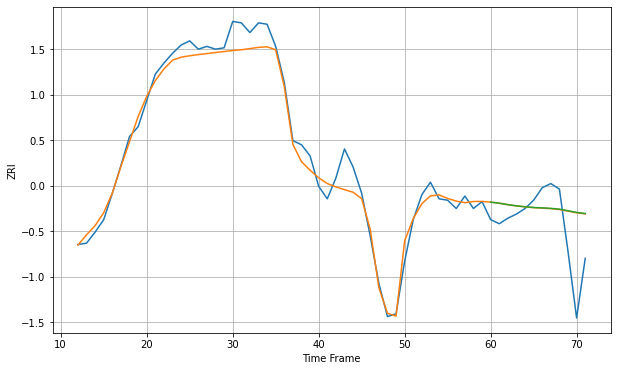

Wall time: 9.5 s
33133 9.332822344251593 27.296165924648076 27.383181627164486 [1988.60139274 1987.84011499 1986.78120532 1985.92040578 1985.2589709
 1984.74203964 1984.47329513 1984.10301385 1983.53849004 1982.39125958
 1981.18675005 1980.40919041]

Got an mse at 0.0097 in round 326 and stopped training

60 60 12


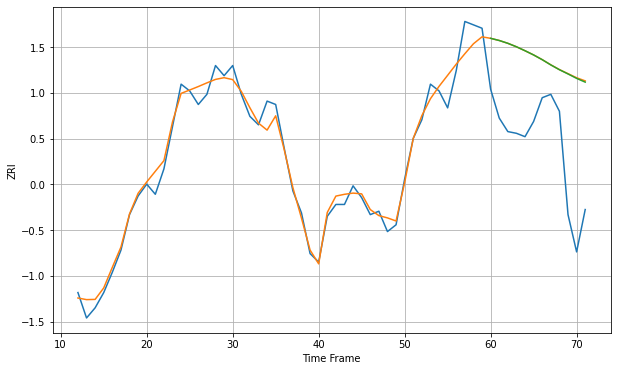

Wall time: 13.2 s
33134 6.873110774462944 55.598262860592705 55.43200149418391 [2100.04795249 2098.76940395 2097.10952426 2095.06971273 2092.72062376
 2090.23437646 2087.44622836 2084.35149871 2081.51827562 2079.02126079
 2076.40534192 2074.19235553]

Got an mse at 0.0100 in round 232 and stopped training

60 60 12


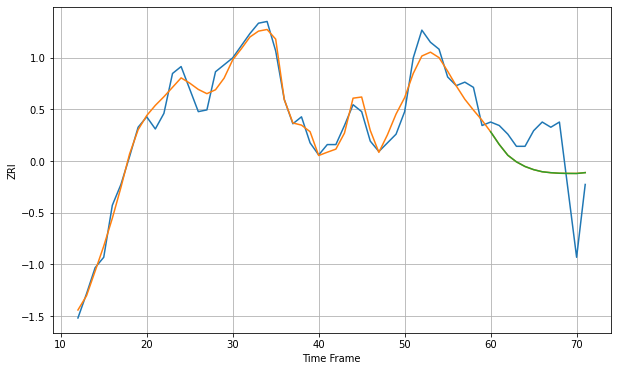

Wall time: 10.7 s
33135 6.688153090807965 22.13045623126831 22.116567680324124 [1721.36595611 1714.06596233 1707.83921238 1704.03874606 1701.35827197
 1699.54493067 1698.32920862 1697.78149395 1697.46769019 1697.37107631
 1697.3187536  1697.80923508]

Got an mse at 0.0098 in round 150 and stopped training

60 60 12


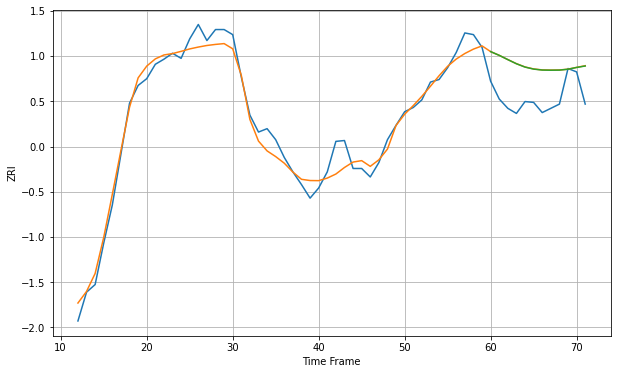

Wall time: 8.72 s
33137 13.601343516636746 42.960813734631834 42.840154533532015 [2258.93979127 2254.53919422 2249.4935282  2244.61634033 2240.69673644
 2238.31026771 2237.18049278 2237.00739843 2237.11662377 2238.16046984
 2240.27390721 2241.96393786]

Got an mse at 0.0099 in round 334 and stopped training

60 60 12


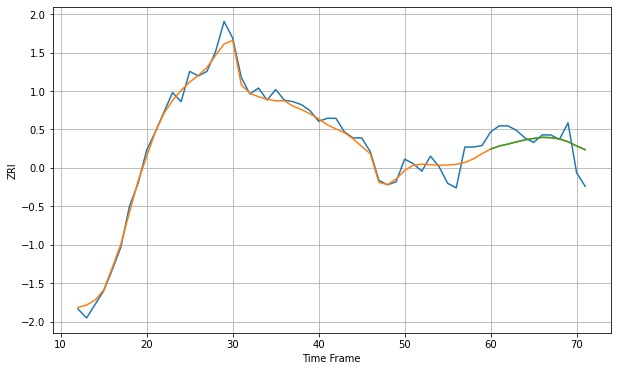

Wall time: 12.9 s
33138 5.46415800890555 11.502443461657416 11.476086042578318 [1692.63723959 1694.68230064 1695.91396313 1697.38876874 1698.72732922
 1699.63892991 1700.42196786 1700.17522472 1699.3998487  1697.5258293
 1694.70217562 1692.21558535]

Got an mse at 0.0100 in round 206 and stopped training

60 60 12


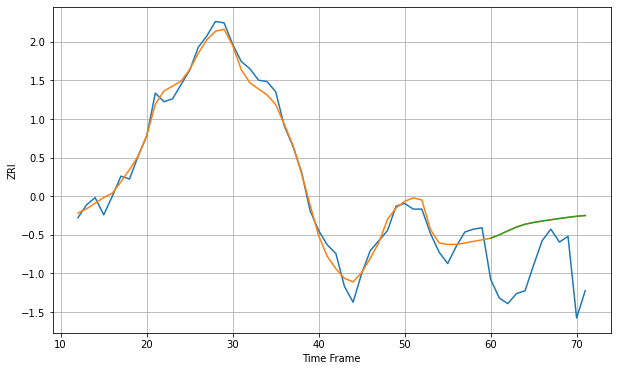

Wall time: 10.2 s
33139 6.3599273558734275 39.80405486699746 39.80500726932569 [1994.66501622 1997.01651976 1999.79445972 2002.39415794 2004.40354911
 2005.66856067 2006.67452741 2007.58187661 2008.47214538 2009.31903718
 2010.04923472 2010.54600183]
60 60 12


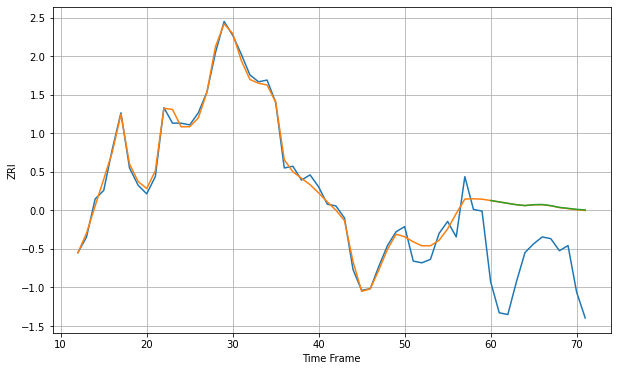

Wall time: 18.7 s
33140 4.863949620894948 42.566829689003995 42.655416204293225 [2312.14663628 2311.3233467  2310.50508363 2309.71148151 2309.2041908
 2309.72036199 2309.80536234 2309.18043354 2308.16037124 2307.59914807
 2307.01996755 2306.69127093]

Got an mse at 0.0100 in round 86 and stopped training

60 60 12


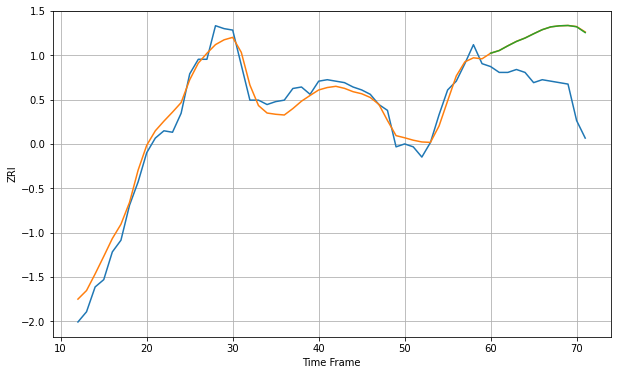

Wall time: 8.83 s
33141 7.8715277395184495 38.53115257426318 38.438472866814564 [1863.15886309 1864.99165778 1868.20924536 1871.21543954 1873.54661133
 1876.47205505 1879.26661226 1881.20937232 1881.93365039 1882.14860947
 1881.2864396  1877.29594924]

Got an mse at 0.0097 in round 142 and stopped training

60 60 12


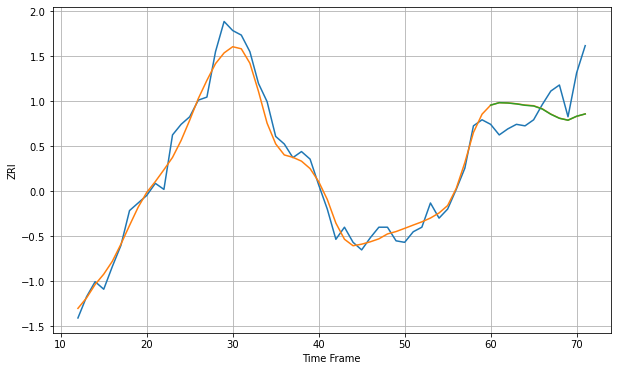

Wall time: 11 s
33142 7.471959181114332 20.3196469463945 20.306992259448037 [1687.68297356 1689.31058122 1689.1017398  1688.51107601 1687.5980472
 1687.13315537 1685.1482458  1681.65577897 1678.98418317 1677.72148742
 1680.36434865 1681.87038144]

Got an mse at 0.0099 in round 157 and stopped training

60 60 12


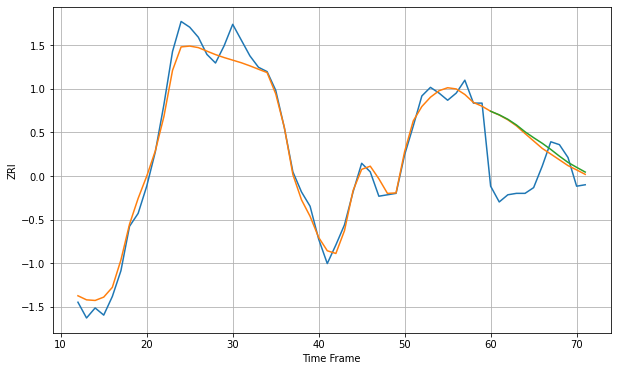

Wall time: 10.2 s
33145 8.114575689590048 35.04396224024922 35.55883762532468 [2070.31100657 2067.82510886 2064.72575141 2060.76834982 2055.98722402
 2051.86197032 2047.96201078 2043.65347399 2038.96433842 2034.6113315
 2031.18181336 2027.8753113 ]

Got an mse at 0.0099 in round 236 and stopped training

60 60 12


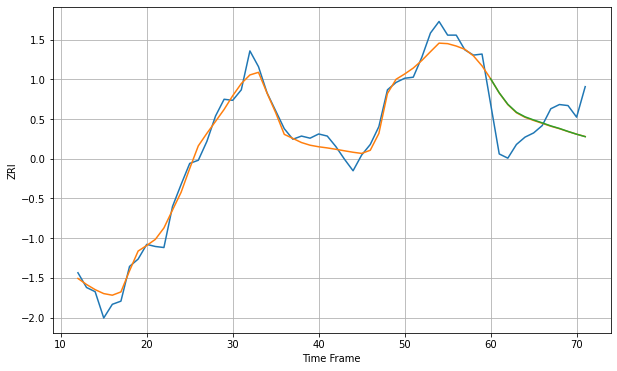

Wall time: 11.9 s
33147 9.42951882230261 31.452578207994154 31.569067286669227 [1956.48810179 1943.10504254 1932.2220037  1924.65073022 1920.31458926
 1917.32488757 1914.5620697  1911.67078708 1909.24833356 1906.41460188
 1903.77612247 1901.44972919]

Got an mse at 0.0100 in round 395 and stopped training

60 60 12


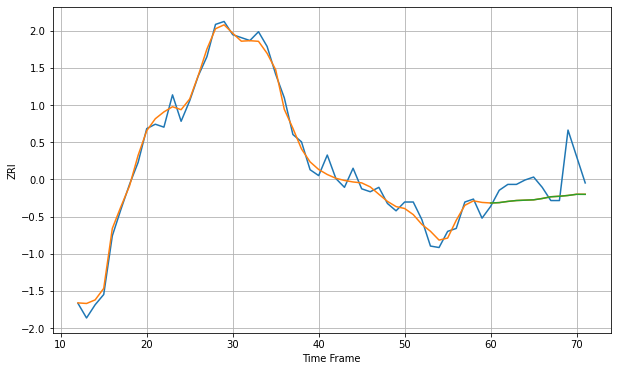

Wall time: 15.2 s
33150 5.500115884932919 17.160854838306282 17.18034742505676 [1610.33535775 1610.59224103 1611.40944455 1612.01639201 1612.2587817
 1612.48641728 1613.38978823 1614.56418415 1614.91001016 1615.45266643
 1616.24658453 1616.20943284]

Got an mse at 0.0100 in round 445 and stopped training

60 60 12


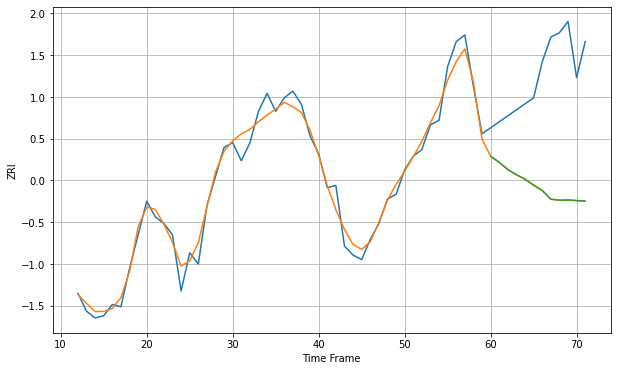

Wall time: 17.4 s
33157 4.893496469106095 52.38209206523386 52.36345243789291 [1763.00068525 1760.29441913 1757.05979993 1754.73741338 1752.81759308
 1750.12690885 1747.78335379 1743.87866993 1743.45740441 1743.53172521
 1743.28289361 1743.06418727]

Got an mse at 0.0097 in round 150 and stopped training

60 60 12


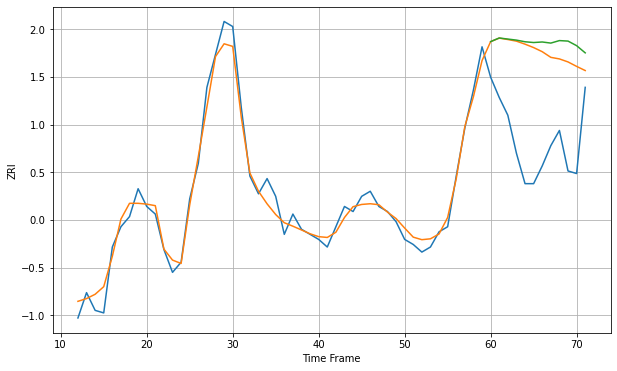

Wall time: 9.4 s
33160 4.40983920959857 37.89526109630204 41.35716663030799 [2072.04894915 2073.48617048 2073.05432539 2072.64199137 2071.98888124
 2071.68782191 2071.90193241 2071.46794273 2072.45358407 2072.25707788
 2070.45104133 2067.61417625]

Got an mse at 0.0099 in round 141 and stopped training

60 60 12


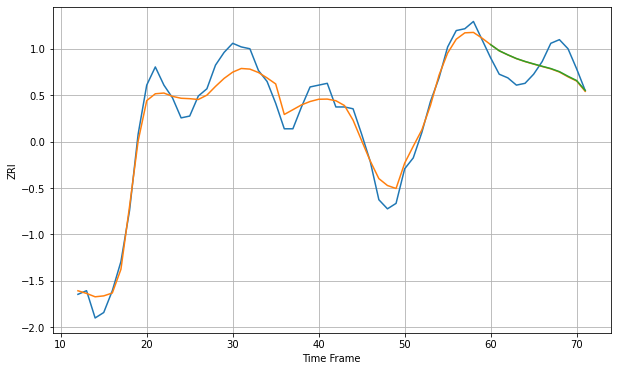

Wall time: 9.52 s
33161 7.517215971299124 11.43622318997365 11.3631391861969 [1529.25899134 1525.8929099  1523.66093447 1521.61711907 1520.02774808
 1518.65839113 1517.35147824 1516.10837026 1514.41532599 1511.87253224
 1509.53252501 1504.07900557]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


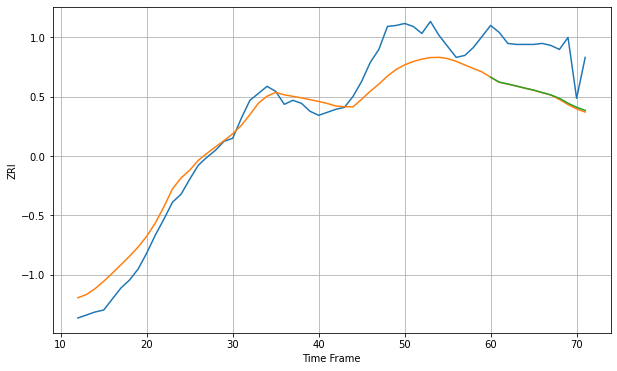

Wall time: 7.97 s
33178 20.874422494793734 47.995772204838126 47.48570973640048 [2010.14433525 2005.20052955 2003.35944623 2001.34621676 1999.22934305
 1997.26886492 1994.8461205  1992.46455158 1989.08229924 1984.14759128
 1980.07183728 1976.92686989]

Got an mse at 0.0098 in round 116 and stopped training

60 60 12


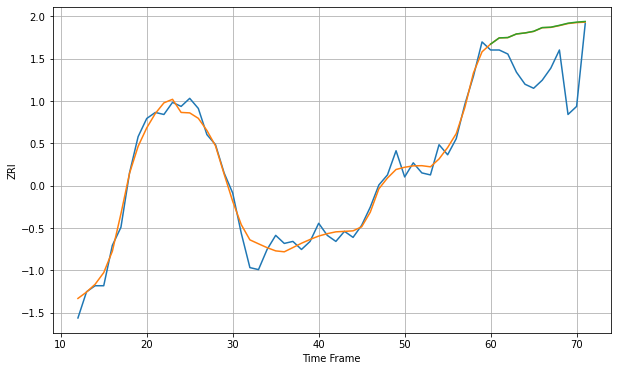

Wall time: 11 s
33180 4.9446049128095115 24.001206985849752 24.094519872202678 [2033.93804398 2037.00841302 2037.16699765 2038.95934993 2039.47672039
 2040.27196257 2042.12178126 2042.31959709 2043.23669864 2044.2898239
 2044.83079534 2045.15745918]

Got an mse at 0.0100 in round 44 and stopped training

60 60 12


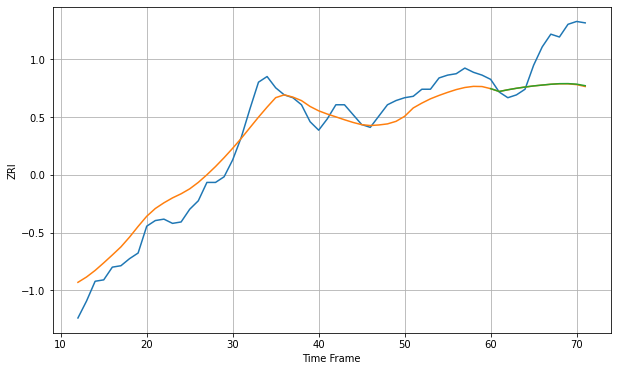

Wall time: 6.76 s
33186 12.242533788798891 27.707663704677117 27.554988398428584 [1577.41210451 1575.41731836 1576.62251673 1577.67475588 1578.55689437
 1579.34779131 1579.96229059 1580.54682385 1580.94085859 1580.98837025
 1580.5931344  1579.51002447]

Got an mse at 0.0099 in round 73 and stopped training

60 60 12


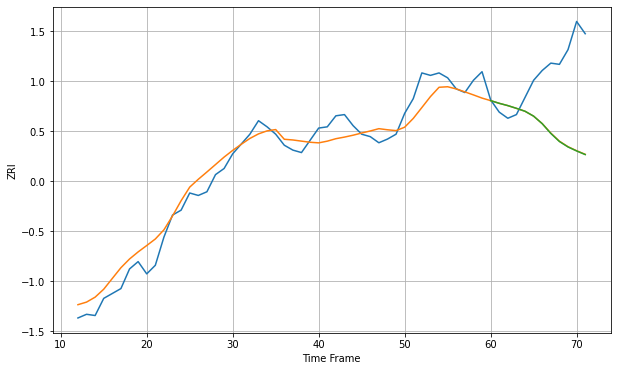

Wall time: 8.06 s
33196 11.768206254143703 55.78569749204071 55.91528389354402 [1588.39145315 1586.19700096 1584.32727299 1582.10262406 1579.7272416
 1575.72966296 1569.55605271 1561.62043485 1555.02130951 1550.58094347
 1547.32536167 1544.36470593]

Got an mse at 0.0100 in round 53 and stopped training

60 60 12


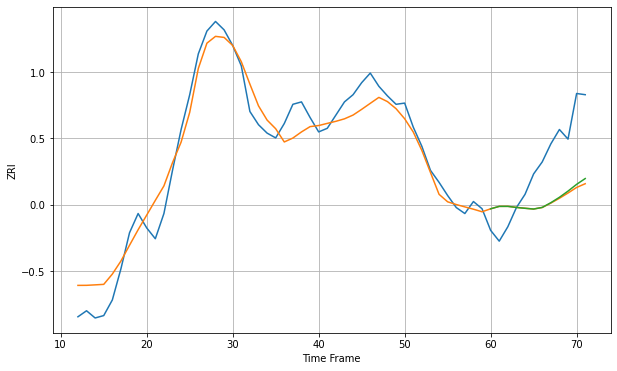

Wall time: 7.39 s
33301 14.952103588821542 44.00614652665254 42.76920236905205 [1749.93574161 1751.96087243 1751.96592624 1751.07069158 1750.35980488
 1749.74710519 1751.1002612  1755.0167335  1759.53065979 1764.67542236
 1770.31184916 1775.13794119]

Got an mse at 0.0097 in round 40 and stopped training

60 60 12


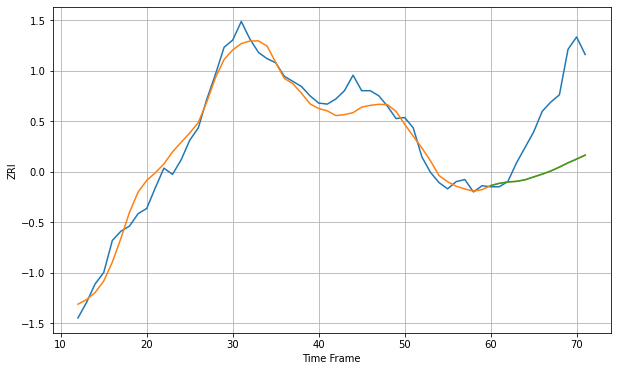

Wall time: 6.5 s
33304 12.581057864033781 65.60111153850181 65.71917279472756 [1557.11080818 1559.31556636 1560.62740091 1561.22767207 1562.71770135
 1565.50176593 1568.20630103 1571.2168206  1575.02522848 1579.09612583
 1582.70569694 1586.50909313]

Got an mse at 0.0099 in round 96 and stopped training

60 60 12


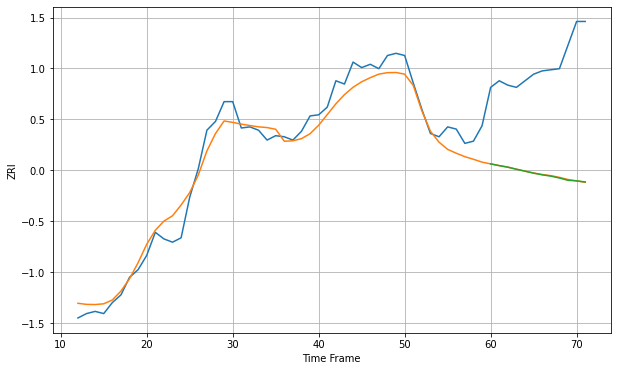

Wall time: 8.45 s
33305 13.539020923931368 100.96458302550982 101.12180021680987 [1477.30922272 1475.73472873 1474.33363563 1472.42072124 1470.6585437
 1468.85324692 1467.34713356 1466.1680668  1464.45557293 1462.35700623
 1461.86368865 1460.83714321]

Got an mse at 0.0098 in round 35 and stopped training

60 60 12


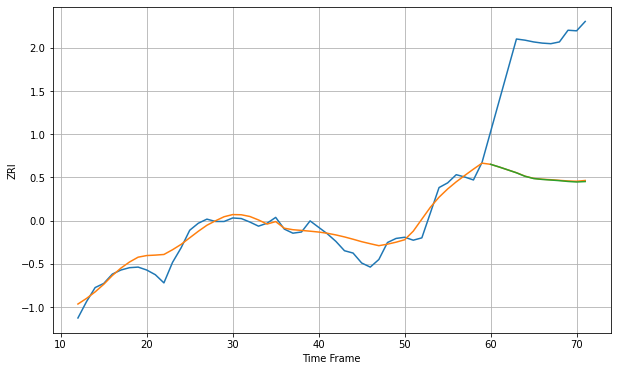

Wall time: 7.03 s
33308 17.051619014474273 219.24062800893225 219.81968980330205 [1612.70600364 1608.15261923 1603.23398577 1598.24577195 1592.26193034
 1588.42444968 1586.89528313 1585.88524715 1584.7984188  1583.43073928
 1582.50553868 1583.25205567]

Got an mse at 0.0099 in round 51 and stopped training

60 60 12


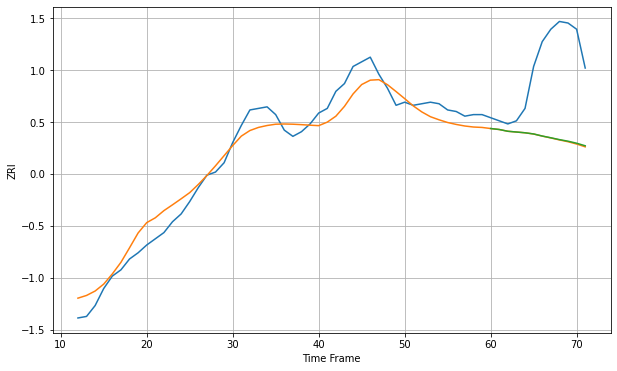

Wall time: 8.07 s
33311 9.36661804345091 50.51035220579277 50.29795166133257 [1380.03397822 1379.40718927 1378.27041863 1377.78657515 1377.29986442
 1376.53477139 1375.21040992 1374.0829535  1372.89620707 1371.87760328
 1370.57849886 1368.92217608]

Got an mse at 0.0100 in round 85 and stopped training

60 60 12


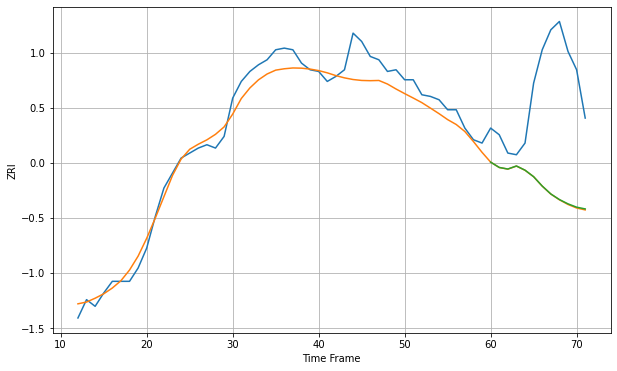

Wall time: 13.7 s
33312 8.765638745667504 64.94928333895085 64.77149087664976 [1409.55480832 1406.36532598 1405.4144046  1407.24068277 1404.72659655
 1400.80981403 1395.183538   1390.45948618 1387.09070732 1384.50635436
 1382.52541136 1381.46574227]

Got an mse at 0.0100 in round 73 and stopped training

60 60 12


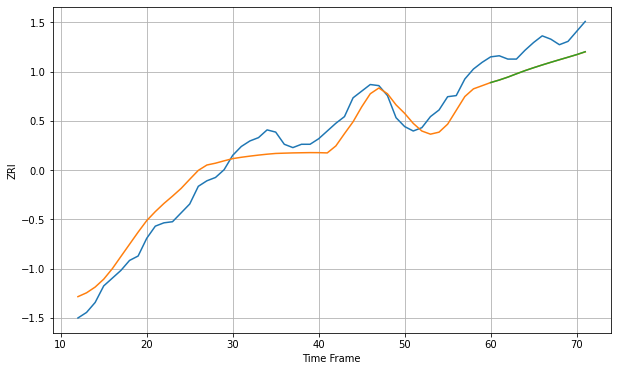

Wall time: 8.79 s
33313 15.193403703765076 20.485335930782657 20.47568366613666 [1421.77660653 1424.05672775 1426.68680838 1429.6629239  1432.55600989
 1435.18768289 1437.69968576 1440.09073808 1442.41581587 1444.69378391
 1447.03390278 1449.6513075 ]

Got an mse at 0.0098 in round 40 and stopped training

60 60 12


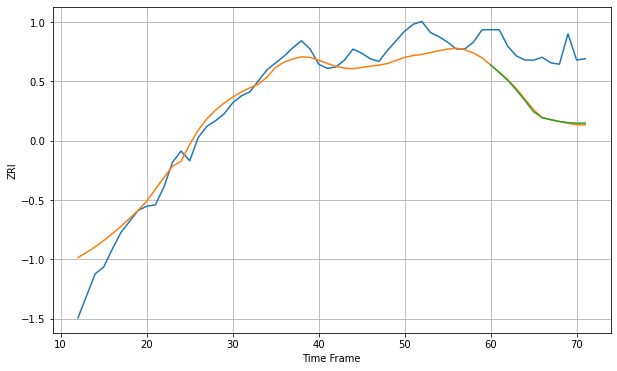

Wall time: 7.33 s
33324 12.64600737464624 39.70156292504572 39.630532780764334 [1547.44514329 1542.06994319 1536.2835168  1529.20109644 1521.57630661
 1513.54188214 1509.29367199 1507.79312316 1506.52554323 1505.64113077
 1505.2175952  1505.35235343]

Got an mse at 0.0098 in round 33 and stopped training

60 60 12


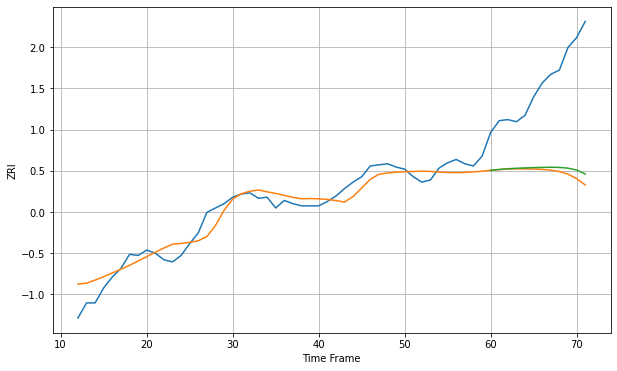

Wall time: 7.47 s
33334 10.616330542241208 87.25155423844505 83.29842562473846 [1313.98819932 1314.75137319 1315.3920173  1315.84568455 1316.17187504
 1316.45712649 1316.64582844 1316.81105324 1316.63157771 1315.94911615
 1314.21626278 1310.57078855]

Got an mse at 0.0100 in round 50 and stopped training

60 60 12


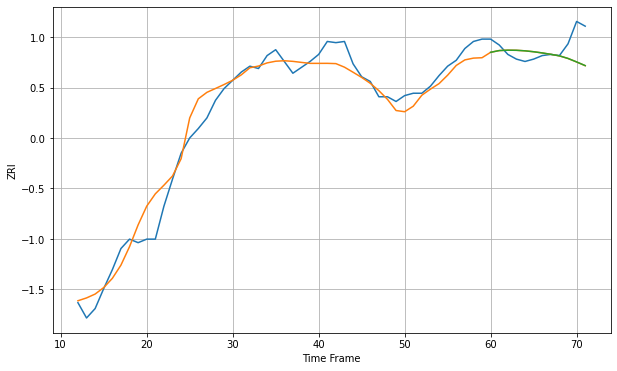

Wall time: 8.13 s
33401 12.6620683260916 15.308223335652949 15.28598782005889 [1506.79038521 1508.27393903 1508.59362768 1508.5005175  1508.04607437
 1507.27409044 1506.25579477 1505.0702264  1503.78180513 1501.57087174
 1498.61562973 1495.47882649]

Got an mse at 0.0100 in round 77 and stopped training

60 60 12


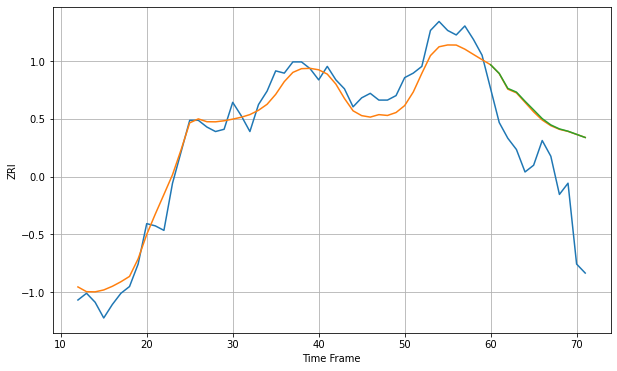

Wall time: 7.63 s
33404 6.585987770035731 31.414753090052958 31.60854447554944 [1488.71764725 1484.86813956 1478.19530493 1476.55686266 1472.48861238
 1468.64269342 1464.74161278 1461.9534738  1460.16666199 1459.14747218
 1457.74060485 1456.34452866]

Got an mse at 0.0098 in round 68 and stopped training

60 60 12


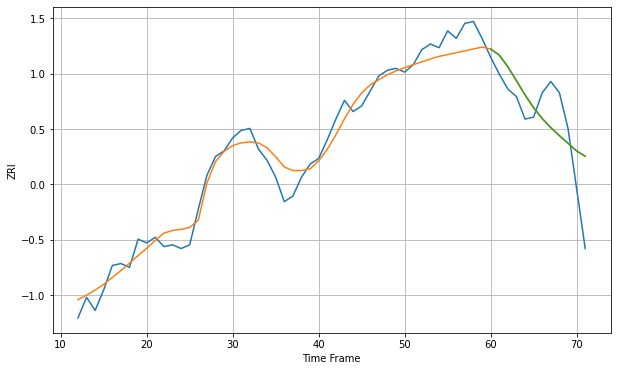

Wall time: 7.26 s
33407 7.4181994227663 19.842988851074555 19.83212905927568 [1504.35232161 1501.09929232 1494.8833979  1487.45946844 1479.87333381
 1473.04944326 1467.29698757 1462.45668428 1458.16822163 1454.11595357
 1450.01524078 1447.19978968]

Got an mse at 0.0100 in round 143 and stopped training

60 60 12


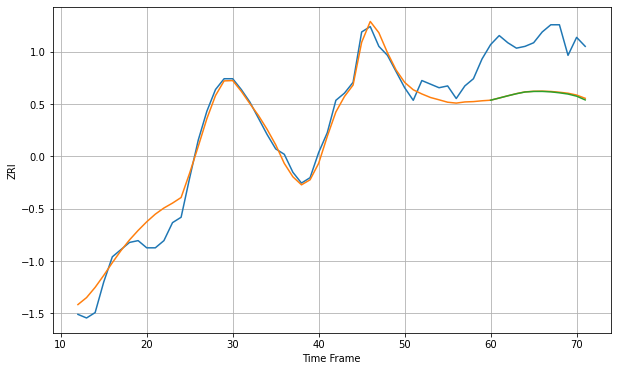

Wall time: 9.6 s
33413 7.773207958617408 30.55912981773835 30.798626046401782 [1437.06658987 1438.27551822 1439.50930752 1440.67203519 1441.62619718
 1441.93339657 1441.95189286 1441.70829851 1441.17420102 1440.48689391
 1439.30287713 1437.22070799]

Got an mse at 0.0098 in round 144 and stopped training

60 60 12


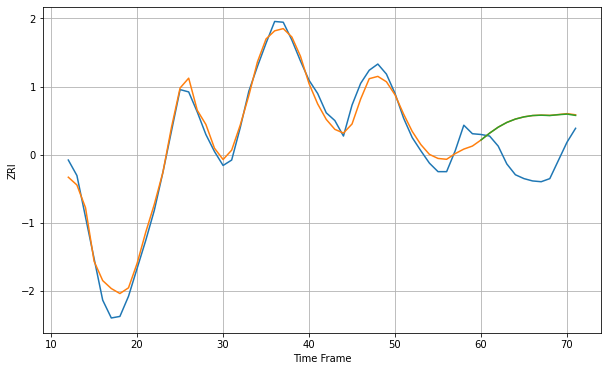

Wall time: 11.2 s
33414 13.820691513134234 58.79395527744107 58.67775943407902 [1728.88603377 1737.73638192 1745.47320035 1751.56015045 1755.92222142
 1758.75849005 1760.49791544 1760.9258016  1760.50540457 1761.55093352
 1762.33703382 1760.6393989 ]

Got an mse at 0.0098 in round 103 and stopped training

60 60 12


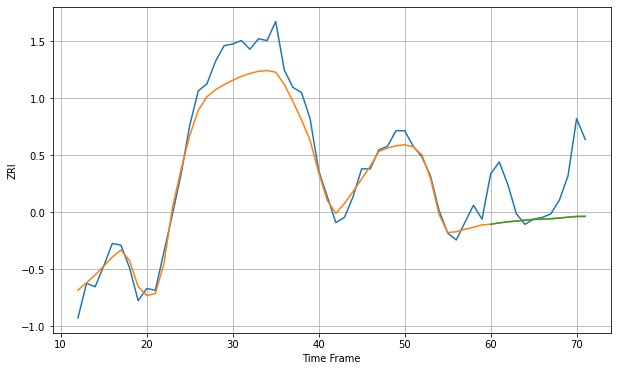

Wall time: 9.45 s
33418 10.348389858108215 26.4298518997311 26.48918405611575 [1675.05152309 1675.82341455 1676.46511424 1676.90780873 1677.43266252
 1677.80962658 1678.00688763 1678.21714424 1678.59145426 1679.10332286
 1679.48080594 1679.55086386]

Got an mse at 0.0099 in round 92 and stopped training

60 60 12


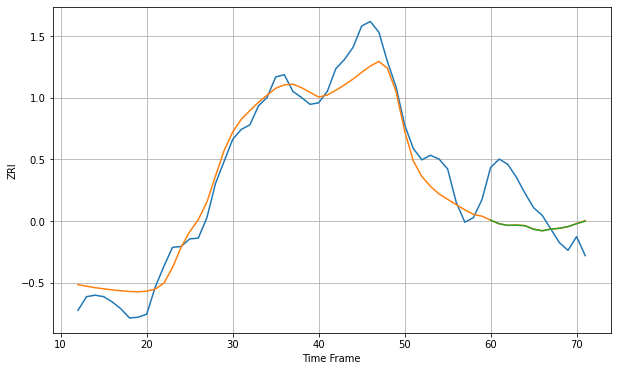

Wall time: 8.38 s
33432 24.68821852179149 49.3044966777777 49.30288876074088 [1917.64501721 1912.85069126 1910.82486641 1911.07242948 1910.2889586
 1905.63560312 1903.67281926 1905.9093728  1906.9968277  1909.18062604
 1912.97905393 1916.35939544]

Got an mse at 0.0100 in round 111 and stopped training

60 60 12


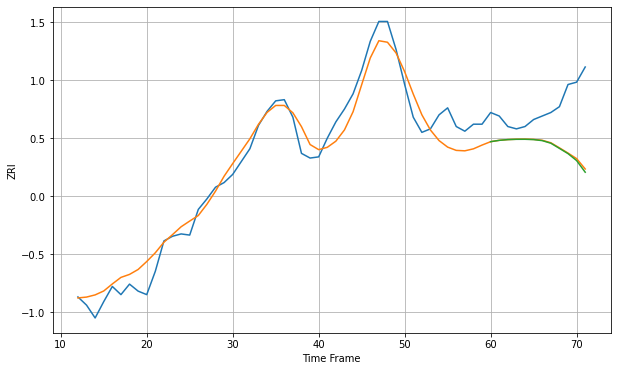

Wall time: 8.75 s
33433 13.800342944249701 40.19200769590659 41.059383723110415 [1743.01913475 1744.1697476  1744.78938327 1745.04708738 1745.07484072
 1744.80124736 1743.92662505 1741.70865467 1737.27918023 1732.79491374
 1726.83690687 1716.86608944]

Got an mse at 0.0100 in round 185 and stopped training

60 60 12


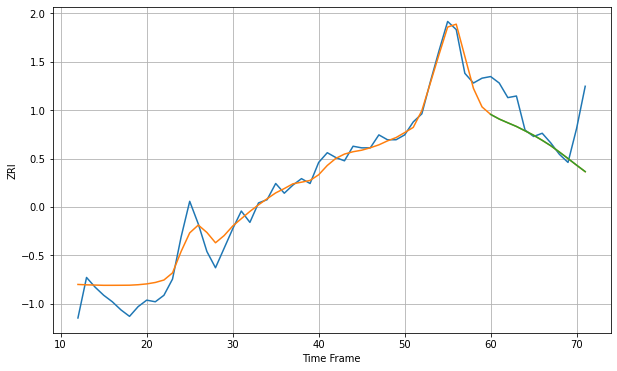

Wall time: 11 s
33435 8.433773502136612 20.332533834057422 20.319164090024138 [1702.63495066 1699.76898914 1697.45424436 1695.19755326 1692.51598003
 1689.78113422 1686.63965619 1683.28492342 1679.40411335 1675.40386064
 1671.31031261 1667.33402683]

Got an mse at 0.0100 in round 92 and stopped training

60 60 12


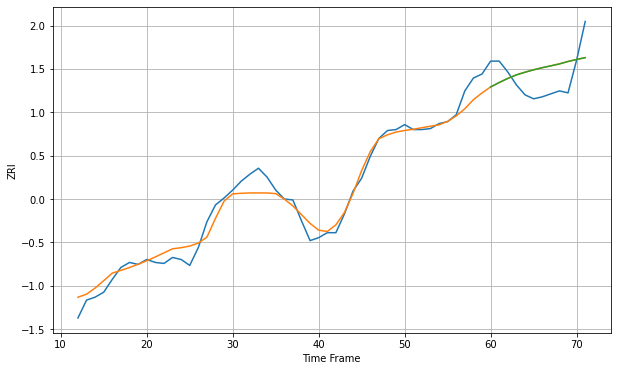

Wall time: 8.17 s
33436 10.406044080599054 24.831903891541295 24.830295503352662 [1540.99989474 1545.42559792 1549.59233976 1553.14357209 1555.82512054
 1558.262324   1560.38489827 1562.25629803 1564.20072453 1566.65828088
 1568.65927286 1570.5117653 ]

Got an mse at 0.0099 in round 107 and stopped training

60 60 12


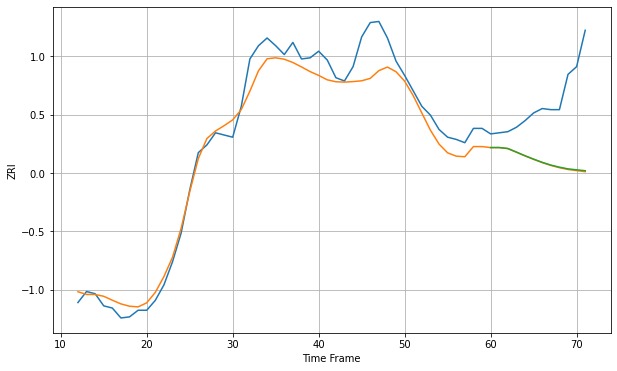

Wall time: 8.82 s
33444 16.45396962203912 60.830783346172055 60.426512479293926 [1662.58823393 1662.61256642 1661.73721983 1658.48024932 1655.1691151
 1652.09218807 1649.20030292 1646.73817087 1644.79754144 1643.26977334
 1642.41046152 1641.59477252]

Got an mse at 0.0100 in round 203 and stopped training

60 60 12


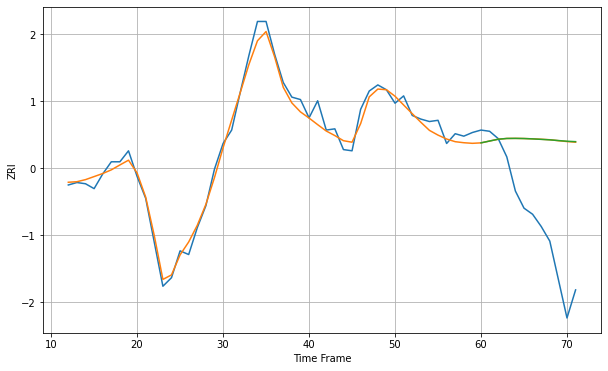

Wall time: 12.1 s
33460 6.793793173148869 76.30235533569221 76.39631121260325 [1494.51255023 1496.01241775 1497.4877696  1498.11627817 1498.18508473
 1498.06406736 1497.77117412 1497.37704184 1496.98487564 1496.40472826
 1495.84409495 1495.49895538]

Got an mse at 0.0100 in round 101 and stopped training

60 60 12


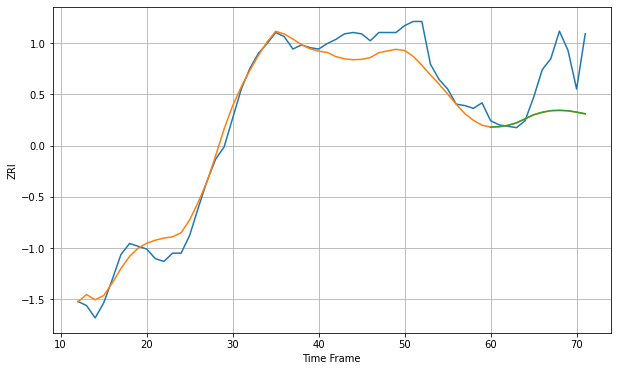

Wall time: 10 s
33461 11.324128309307904 30.8984359159082 30.825854695645077 [1419.41785593 1419.72234987 1420.64730894 1422.48796943 1425.3616484
 1428.34701717 1430.15227766 1431.33864701 1431.57520701 1431.27819643
 1430.30675178 1429.13975976]

Got an mse at 0.0098 in round 71 and stopped training

60 60 12


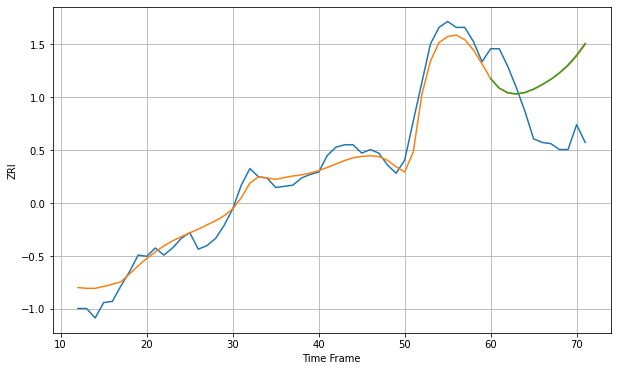

Wall time: 8.78 s
33510 10.649730633967701 49.0467960520982 49.40406715666241 [1251.761515   1243.82152892 1239.92235369 1238.85745139 1240.22482104
 1243.01172509 1246.81093823 1251.28084294 1256.74581879 1263.2826314
 1271.58122903 1281.51849754]

Got an mse at 0.0100 in round 35 and stopped training

60 60 12


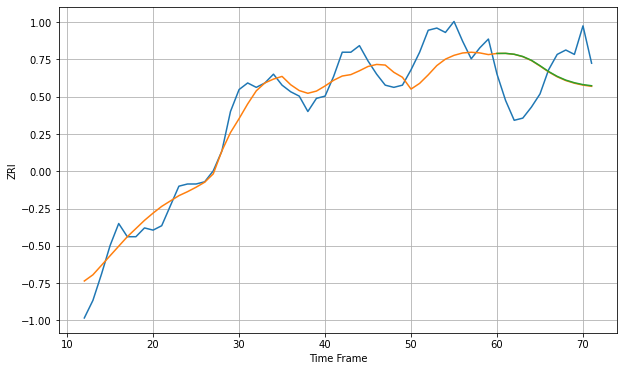

Wall time: 6.48 s
33511 8.231909560816161 18.604620899533902 18.569059226094506 [1279.44043102 1279.48034391 1279.07502124 1278.05035297 1276.33199217
 1273.85900269 1271.2152834  1269.00524828 1267.29768245 1266.10300011
 1265.25239634 1264.73236575]

Got an mse at 0.0097 in round 39 and stopped training

60 60 12


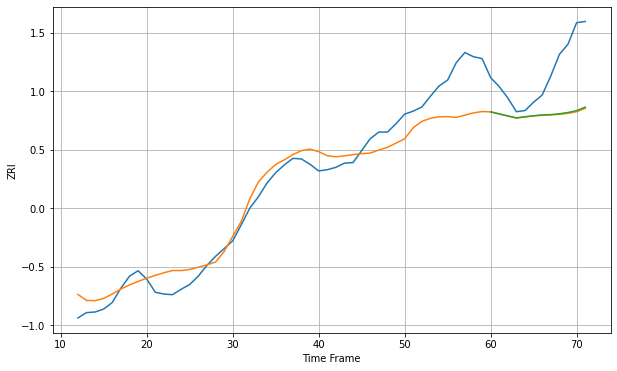

Wall time: 8.12 s
33602 36.43211813244757 81.23917567937383 80.33446604557659 [1784.75037999 1781.36976559 1777.98173932 1774.69398327 1776.62732732
 1778.26947194 1779.57103094 1780.22675083 1781.59447607 1783.68491895
 1786.81814325 1792.72635952]

Got an mse at 0.0098 in round 39 and stopped training

60 60 12


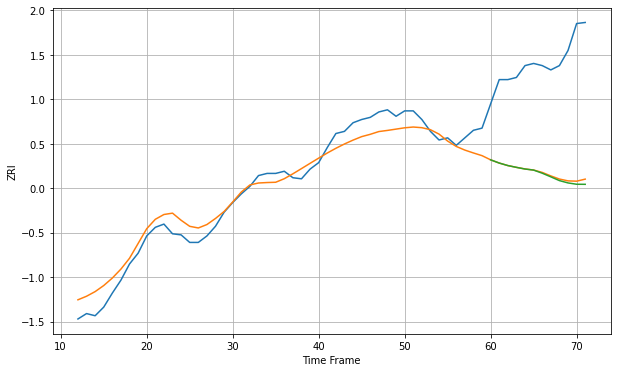

Wall time: 6.46 s
33604 12.343834939306184 103.52509440065695 104.87619892039692 [982.59008935 979.61070846 977.28432437 975.61444001 974.06806709
 973.07591918 970.19734091 966.81275519 963.33442343 961.17851128
 959.95546072 959.89271984]

Got an mse at 0.0097 in round 41 and stopped training

60 60 12


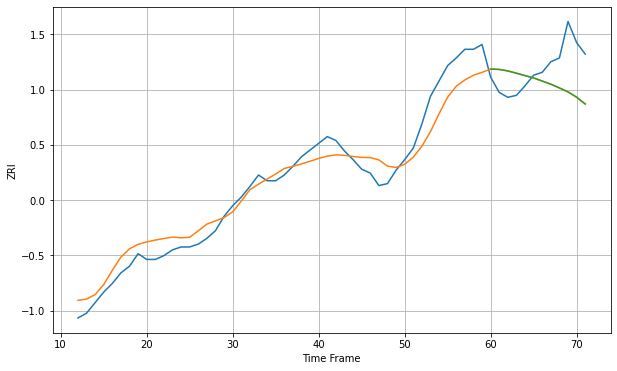

Wall time: 7.91 s
33606 17.120167988589632 35.37512762383491 35.321850930436355 [1533.37341506 1533.01026901 1531.44819605 1529.07975864 1526.57406879
 1524.11789865 1520.90292442 1517.61539598 1513.73449058 1509.6265151
 1504.12274245 1497.10611505]

Got an mse at 0.0099 in round 78 and stopped training

60 60 12


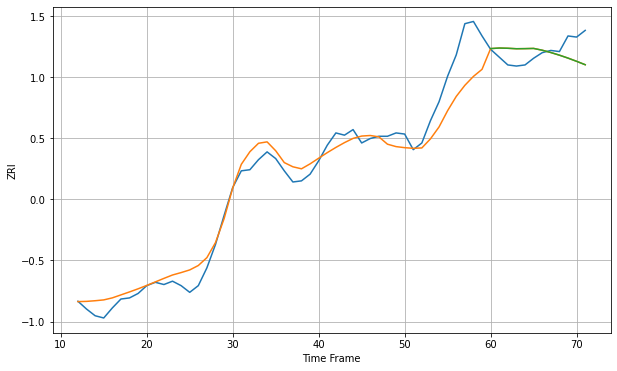

Wall time: 7.55 s
33607 16.45417363195437 14.882521113556246 14.889525154092723 [1453.6685246  1454.15612084 1453.94975301 1453.53781819 1453.62949438
 1453.80699651 1452.20146562 1450.13144868 1447.75778262 1445.12440215
 1442.23947104 1439.18616937]

Got an mse at 0.0100 in round 44 and stopped training

60 60 12


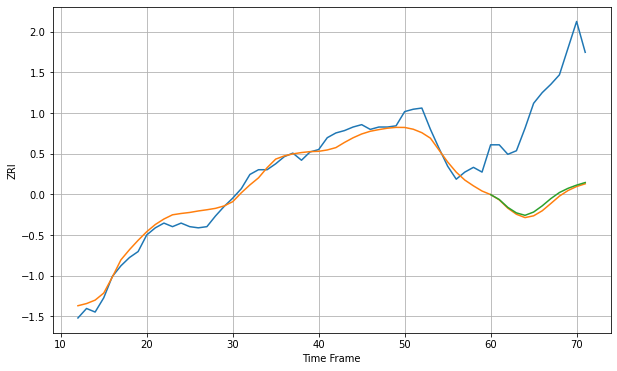

Wall time: 7.75 s
33612 8.476603044257915 91.32069027862556 89.32643456080946 [960.02642672 955.88985762 949.2375015  944.60255015 942.55692502
 945.32022571 950.54446295 956.62828387 961.76726288 965.30417014
 968.01236035 970.19503509]

Got an mse at 0.0097 in round 54 and stopped training

60 60 12


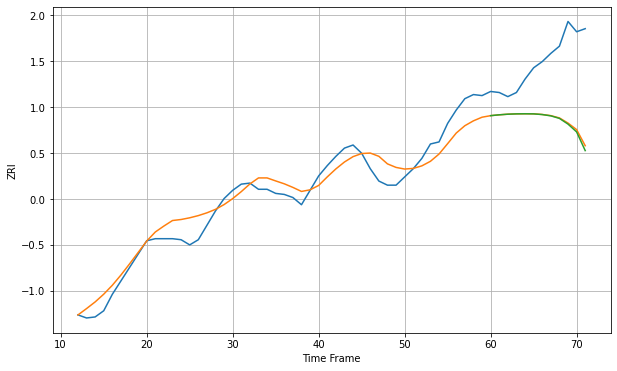

Wall time: 6.99 s
33613 13.898168821591671 63.05939712587415 64.26311311276915 [1175.51147282 1176.32791461 1176.92592973 1177.24310198 1177.33531353
 1177.23371049 1176.57861938 1175.32176111 1172.85150348 1167.30313639
 1159.72374294 1141.56468272]

Got an mse at 0.0100 in round 35 and stopped training

60 60 12


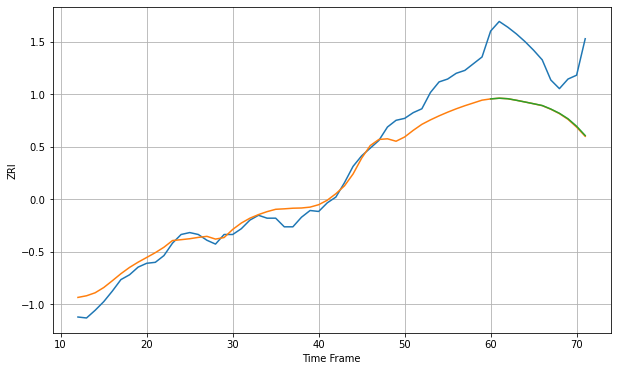

Wall time: 7.65 s
33615 17.425546909126847 63.05747116227884 62.81571412754241 [1248.29689882 1249.00947633 1248.47757573 1246.85962771 1245.0810972
 1243.2506131  1241.41240309 1237.74044092 1233.31921909 1227.60920334
 1219.80258289 1210.16000994]

Got an mse at 0.0100 in round 85 and stopped training

60 60 12


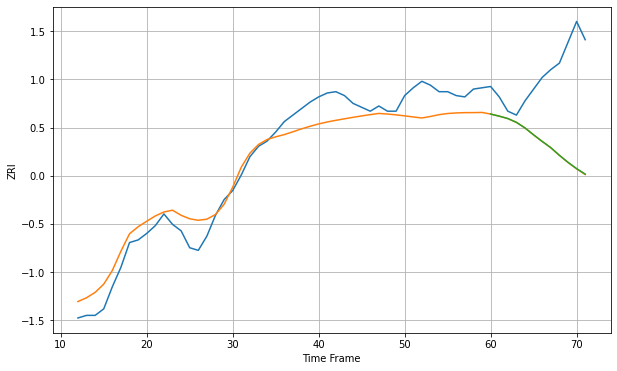

Wall time: 9.14 s
33617 14.201851699590353 61.6624287242058 61.56772095835567 [1055.80500219 1054.1855227  1052.32889733 1049.41788545 1045.11196965
 1039.8006513  1034.73596977 1029.93243062 1024.06821235 1018.68526295
 1013.86145949 1009.60283834]

Got an mse at 0.0096 in round 30 and stopped training

60 60 12


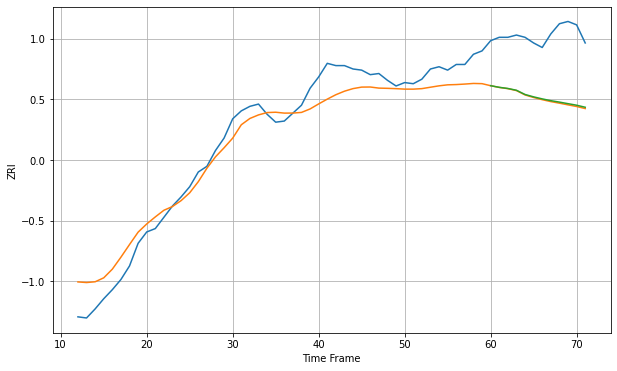

Wall time: 7.07 s
33626 15.912964396957063 55.93620318551965 55.269098546982384 [1416.2438044  1414.81522827 1413.79566033 1412.22079508 1408.49097364
 1406.37484831 1404.59131232 1403.01785099 1401.74753315 1400.36191219
 1399.00255229 1397.18984625]

Got an mse at 0.0098 in round 51 and stopped training

60 60 12


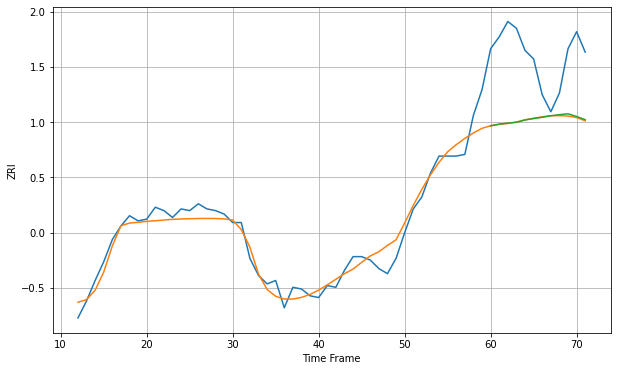

Wall time: 7.3 s
33634 6.736061438642648 41.060010201216386 40.834776164082136 [1206.76565461 1207.74683397 1208.31970015 1208.88555133 1210.18575978
 1211.03218301 1211.77333078 1212.64016284 1213.29996291 1213.83809261
 1212.22309167 1210.33960542]

Got an mse at 0.0099 in round 64 and stopped training

60 60 12


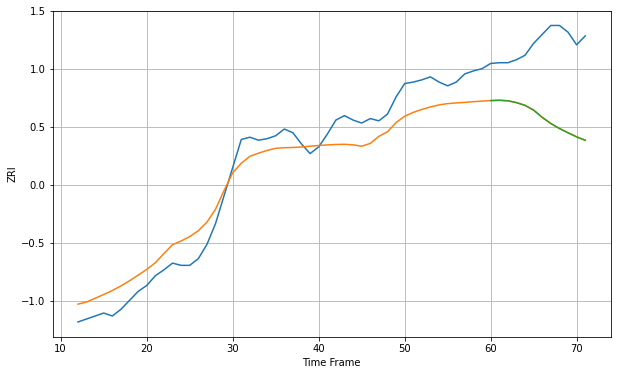

Wall time: 7.55 s
33701 28.395500039060146 102.24186111790632 102.24990788251472 [1314.15507674 1314.58598505 1313.9016607  1311.46683798 1307.71728727
 1301.44144113 1291.70635622 1283.45470841 1276.70580605 1270.92175286
 1265.45558293 1260.85524644]

Got an mse at 0.0100 in round 42 and stopped training

60 60 12


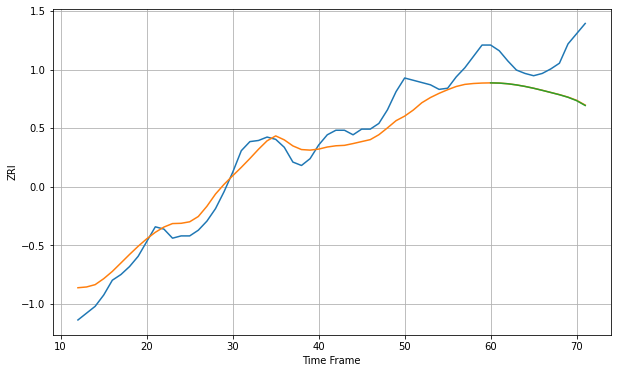

Wall time: 6.75 s
33702 14.64219436799007 35.301802522741525 35.42783818586262 [1148.70723429 1148.51404363 1147.92550964 1146.91382967 1145.57420586
 1143.96916967 1142.14294378 1140.22186756 1138.27903492 1136.02954306
 1133.06526689 1128.78628764]

Got an mse at 0.0097 in round 69 and stopped training

60 60 12


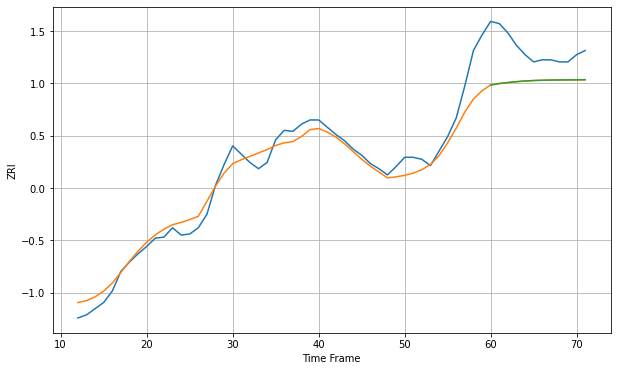

Wall time: 7.72 s
33705 14.093417903387259 34.61025142064734 34.5882404369857 [1287.72883711 1289.10537381 1290.08073876 1290.92735703 1291.57899316
 1292.02424533 1292.28855827 1292.47473956 1292.59141303 1292.66376515
 1292.72331242 1292.86152247]

Got an mse at 0.0098 in round 83 and stopped training

60 60 12


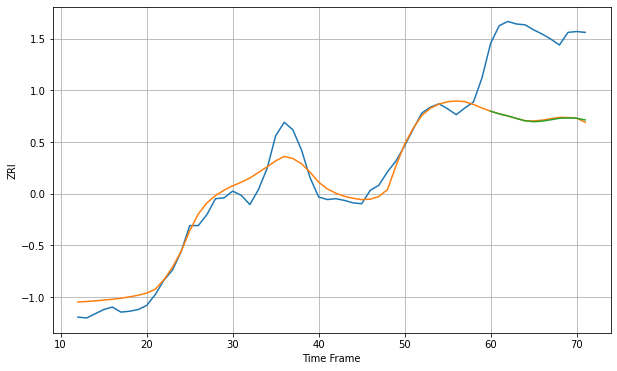

Wall time: 8.54 s
33706 15.55509734903155 102.8551619333098 103.0131316661572 [1465.17601077 1461.99448682 1459.56480056 1456.57930131 1453.77865081
 1452.62547157 1453.30670217 1454.95846886 1456.72733392 1457.08441119
 1456.79907961 1454.77723045]

Got an mse at 0.0099 in round 30 and stopped training

60 60 12


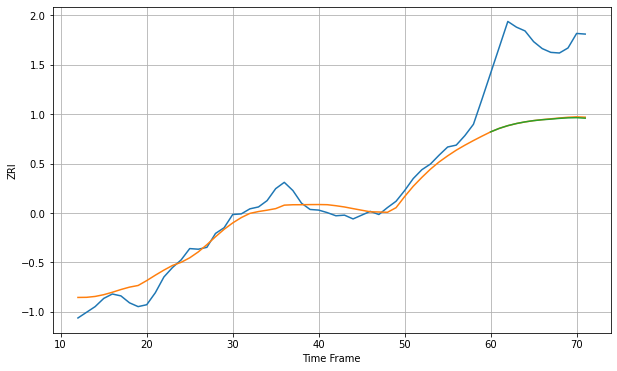

Wall time: 6.75 s
33708 18.371055082578533 126.99603397669853 127.39168022960459 [1527.99000453 1533.51002783 1537.85446912 1541.22871969 1543.83680896
 1545.81915772 1547.21335378 1548.20872557 1549.40651242 1550.19904802
 1550.4963444  1549.68285288]

Got an mse at 0.0100 in round 66 and stopped training

60 60 12


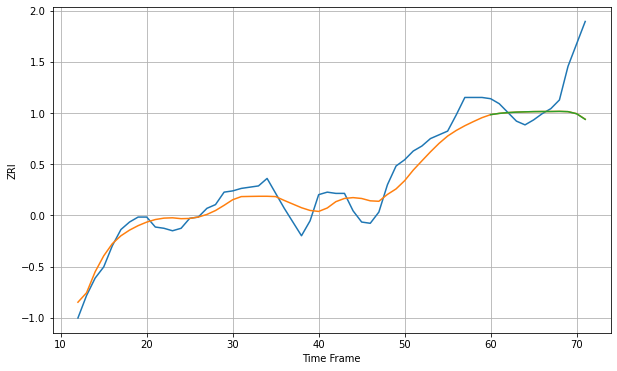

Wall time: 8.58 s
33712 11.087407270255657 30.462280726497845 30.504259498991285 [1134.20659182 1135.21521904 1135.84357476 1136.23758387 1136.4455791
 1136.64357236 1136.71347687 1136.71228504 1136.82165461 1136.59908064
 1134.93105599 1130.4186745 ]

Got an mse at 0.0099 in round 58 and stopped training

60 60 12


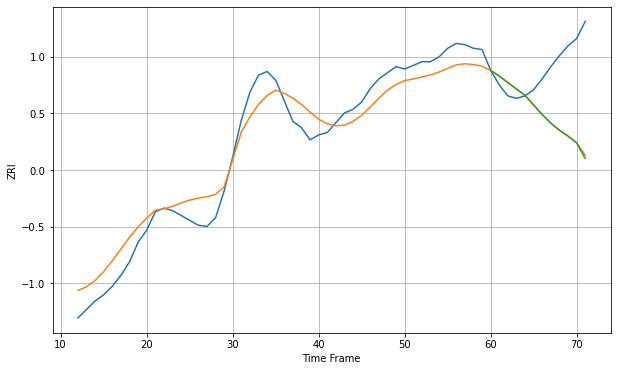

Wall time: 7.03 s
33716 15.144515764304698 51.5929308168502 52.04985352158001 [1177.92098396 1173.27762594 1167.935976   1162.61172161 1157.48420852
 1149.49129254 1141.69104574 1134.71515157 1128.89032972 1124.15666946
 1118.47536124 1105.66102304]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


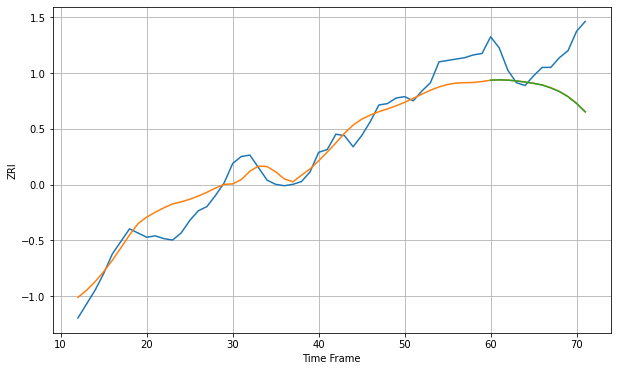

Wall time: 9.25 s
33755 11.733500137697108 29.58741396832652 29.67360983402046 [1069.82343393 1070.06875511 1069.84995345 1069.28527607 1068.47277954
 1067.51571122 1066.34674463 1064.26356925 1061.62050819 1057.96471952
 1053.04920064 1047.05657981]

Got an mse at 0.0100 in round 70 and stopped training

60 60 12


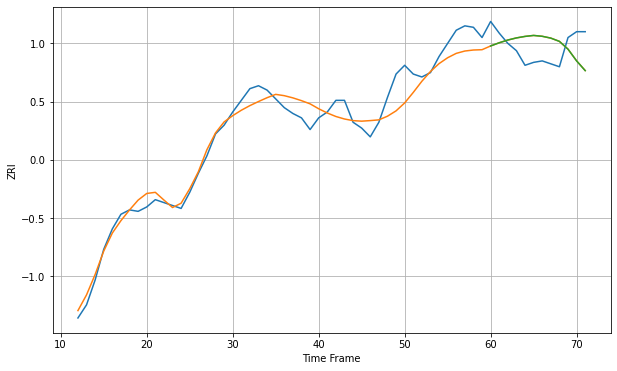

Wall time: 8.71 s
33756 9.564542704644866 16.33495741788663 16.348817874029198 [1126.2249203  1128.41827671 1130.28307476 1131.74160687 1132.77112528
 1133.43647597 1132.84872541 1131.60185974 1129.36816025 1124.03485707
 1115.9908577  1109.33377931]

Got an mse at 0.0096 in round 38 and stopped training

60 60 12


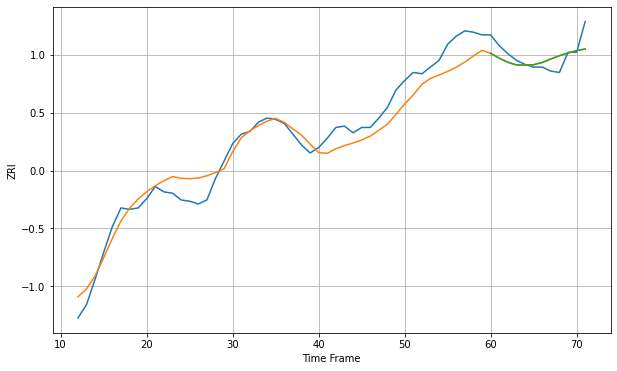

Wall time: 7.55 s
33771 11.605764534042162 9.148086693534749 9.154475540322691 [1159.20489087 1155.67062572 1152.57155643 1150.61602566 1150.44445478
 1150.76622348 1152.41480137 1155.05851096 1157.4808871  1159.52346408
 1161.19062011 1162.48240343]

Got an mse at 0.0099 in round 79 and stopped training

60 60 12


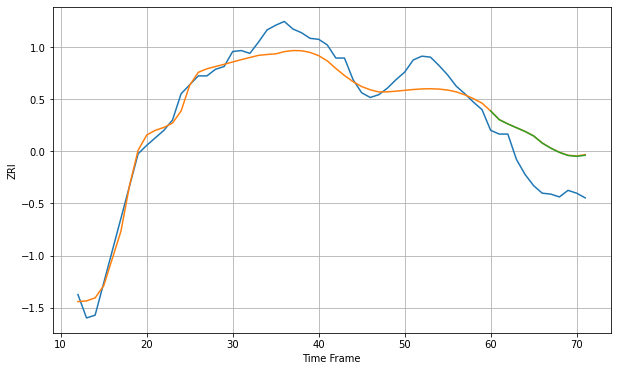

Wall time: 8.39 s
33907 15.753373942027588 40.26441471272595 40.121220697600656 [1240.65027832 1231.37488196 1226.79749894 1222.78301443 1218.8031244
 1214.00063749 1206.42554172 1200.9630444  1196.46181074 1193.16000325
 1192.27115406 1193.40346133]

Got an mse at 0.0099 in round 66 and stopped training

60 60 12


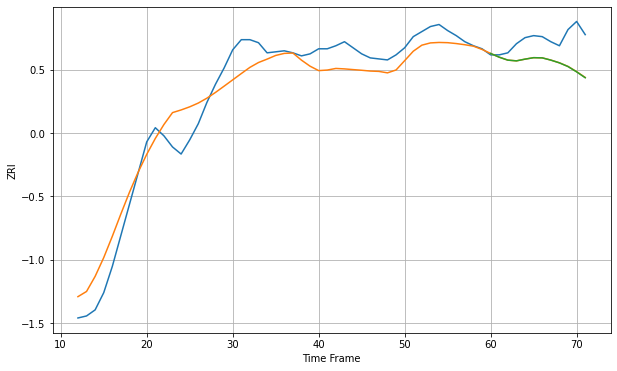

Wall time: 7.65 s
33916 19.57501138365039 25.655246706808278 25.75329232386777 [1145.36688952 1141.69917778 1138.79580476 1138.06809899 1139.76496332
 1141.21130891 1141.03068903 1138.81043414 1136.08840971 1132.44118321
 1127.20796887 1121.39728378]

Got an mse at 0.0100 in round 101 and stopped training

60 60 12


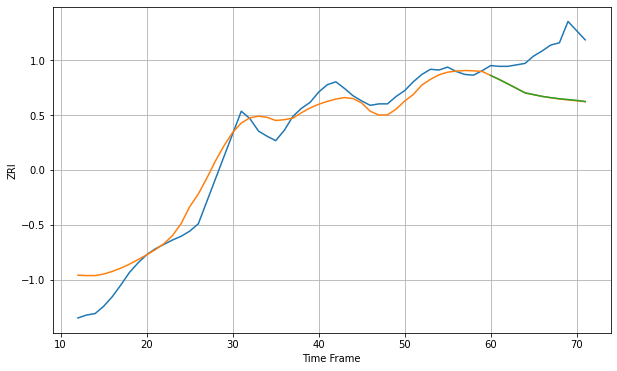

Wall time: 8.78 s
33973 22.04585427937664 63.74198965283117 63.501459140806524 [1096.65527986 1091.12876005 1085.17993526 1079.09316273 1072.98190373
 1070.5628725  1068.18253717 1066.46824231 1064.9843092  1063.89992991
 1062.77297632 1061.28495559]

Got an mse at 0.0099 in round 179 and stopped training

60 60 12


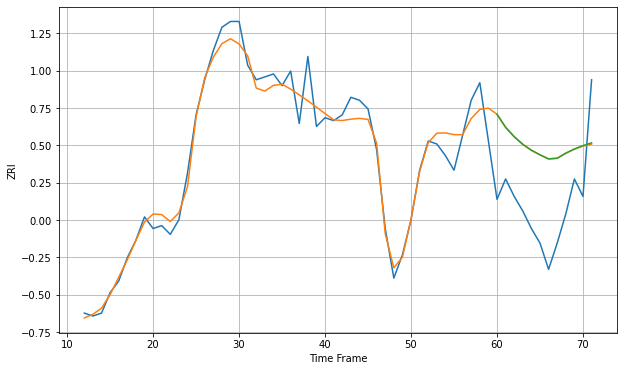

Wall time: 10.2 s
34203 5.218913370730289 24.768900663562633 24.70860339835096 [1505.17475977 1500.68641254 1497.45377443 1494.83658294 1492.80866544
 1491.25107776 1489.84871917 1490.06322075 1491.8306149  1493.28101296
 1494.44275746 1495.37948533]

Got an mse at 0.0100 in round 100 and stopped training

60 60 12


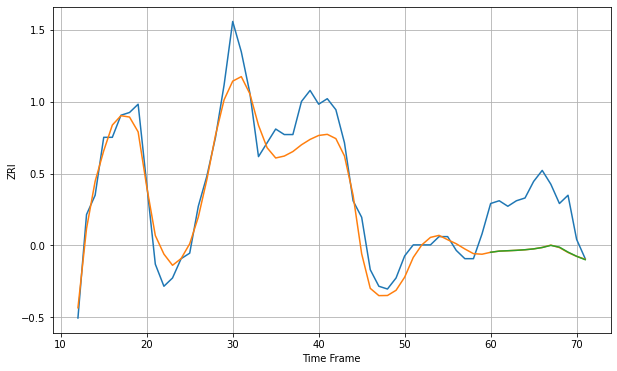

Wall time: 8.45 s
34207 7.695866842222577 18.643745611767763 18.630866083450282 [1174.31713084 1174.7455787  1174.88107843 1175.03094984 1175.24167975
 1175.5488032  1176.04151425 1176.81916495 1176.17451314 1174.3818088
 1172.86775321 1171.63444357]

Got an mse at 0.0099 in round 136 and stopped training

60 60 12


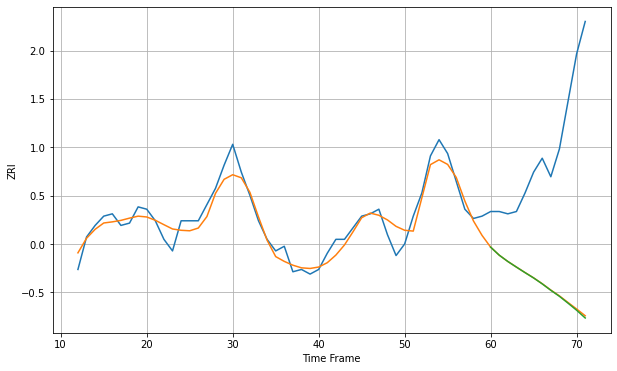

Wall time: 9.06 s
34208 4.913069691769403 64.5197681159019 64.81603722835337 [1184.62434971 1181.15940745 1178.43679524 1176.00817556 1173.63555258
 1171.32984654 1168.78297218 1166.00742565 1163.4126083  1160.45935639
 1157.40787032 1154.06600599]

Got an mse at 0.0100 in round 386 and stopped training

60 60 12


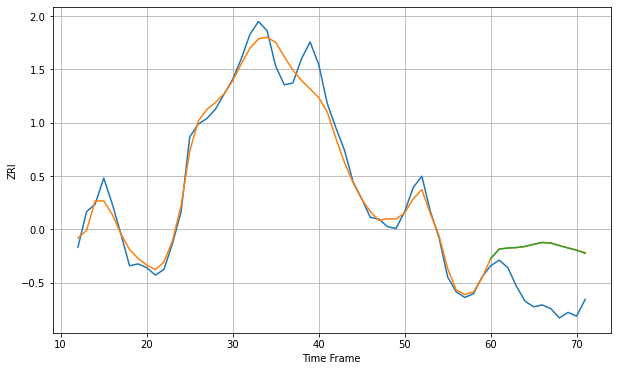

Wall time: 14.9 s
34210 7.185387541471311 28.171061775724734 28.111645505086887 [1289.82378871 1294.96900695 1295.49221565 1295.76426631 1296.32869595
 1297.49068988 1298.49111751 1298.15500565 1296.80041152 1295.5125914
 1294.31997759 1292.66300472]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


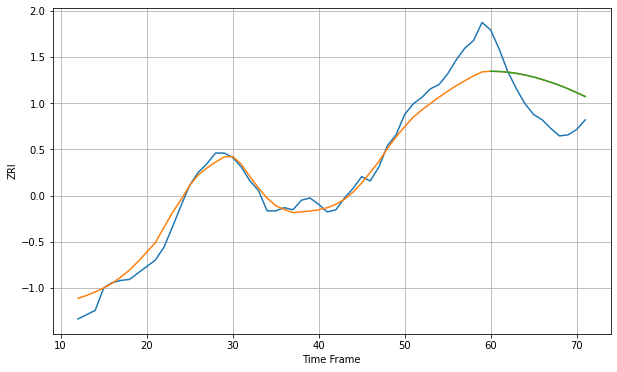

Wall time: 8.03 s
34232 13.483681286613487 33.07598194559186 33.068273034701775 [1475.44145683 1475.19098114 1474.55037063 1473.46171887 1471.93883249
 1470.04978228 1467.70918392 1465.13433955 1462.3006446  1459.08994722
 1455.45836536 1451.78974471]

Got an mse at 0.0098 in round 42 and stopped training

60 60 12


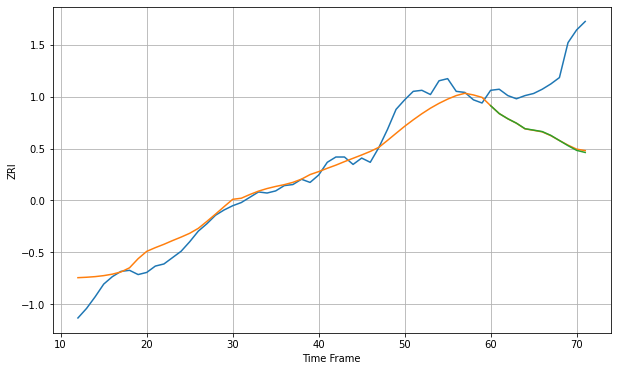

Wall time: 6.37 s
34683 13.296125121502158 63.51211120099581 63.96956731533433 [1116.46961922 1109.0191744  1104.12300324 1099.97155926 1094.727771
 1093.39603572 1092.02555156 1088.43292327 1083.58418858 1078.73145174
 1074.28009367 1072.30127816]

Got an mse at 0.0099 in round 50 and stopped training

60 60 12


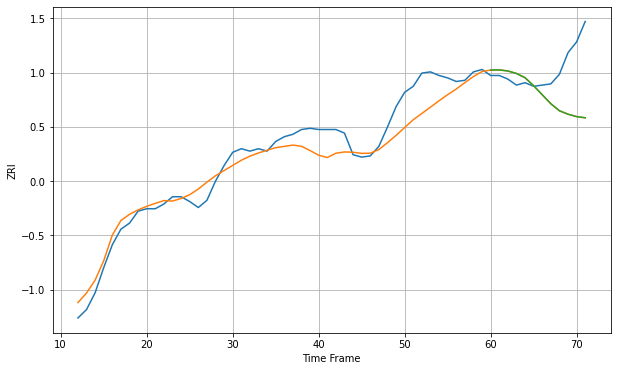

Wall time: 7.34 s
34698 13.654179834136452 34.650930765338714 34.63837733895144 [1252.55393333 1252.66977975 1251.74610837 1249.70285391 1246.1565678
 1239.4736897  1231.94717071 1224.48573857 1218.61248704 1215.74531548
 1213.73252738 1212.79492779]

Got an mse at 0.0099 in round 270 and stopped training

60 60 12


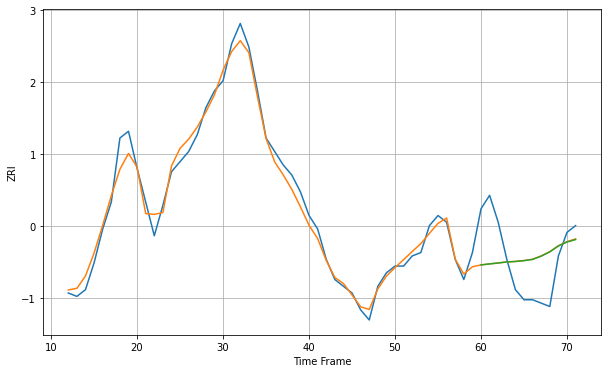

Wall time: 13.2 s
37040 3.030516380450294 11.839920579414558 11.82474523227057 [736.34379069 736.64096377 736.91133112 737.22217295 737.36137531
 737.61152894 737.97010231 738.94273945 740.20885157 741.96465166
 743.13409208 743.86700936]

Got an mse at 0.0099 in round 368 and stopped training

60 60 12


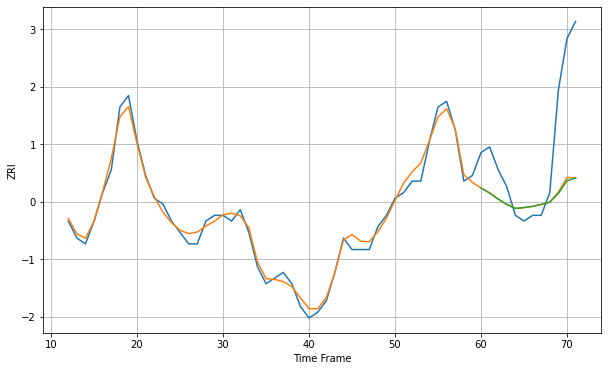

Wall time: 15.2 s
37042 1.2367260348765192 12.315529114114216 12.454813846490632 [715.80252484 714.92148067 713.85353385 712.92593303 712.21635537
 712.35879807 712.57160409 712.8973844  713.31292044 714.82930673
 717.077449   717.53012295]

Got an mse at 0.0099 in round 118 and stopped training

60 60 12


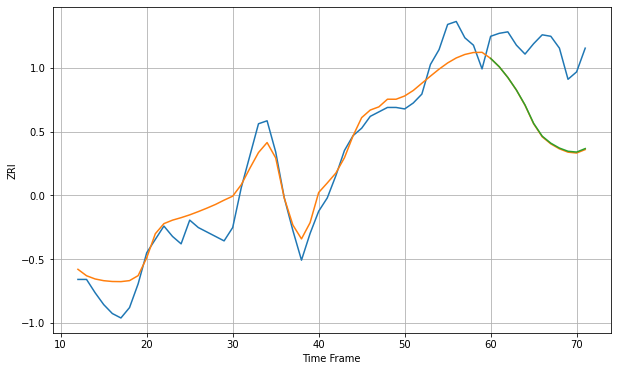

Wall time: 9.62 s
37075 12.687049280067251 51.17241255816059 50.78112456635517 [1128.08603423 1122.46509442 1115.2352102  1106.73605769 1096.67422942
 1084.27471426 1075.62332065 1070.90208316 1067.61451004 1065.4507723
 1064.90005034 1067.25589736]

Got an mse at 0.0099 in round 100 and stopped training

60 60 12


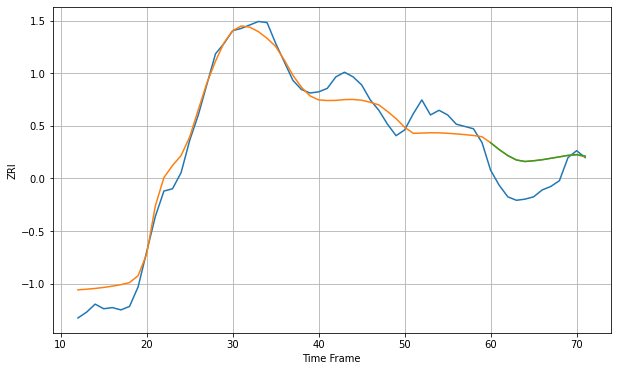

Wall time: 8.46 s
37076 13.178016850167683 25.47779913586629 25.481199886805104 [1113.89077196 1107.92294473 1102.74010151 1098.93971147 1097.6171457
 1098.26623962 1099.16331082 1100.42672432 1101.6575598  1102.97153519
 1103.65320129 1102.37853735]

Got an mse at 0.0098 in round 63 and stopped training

60 60 12


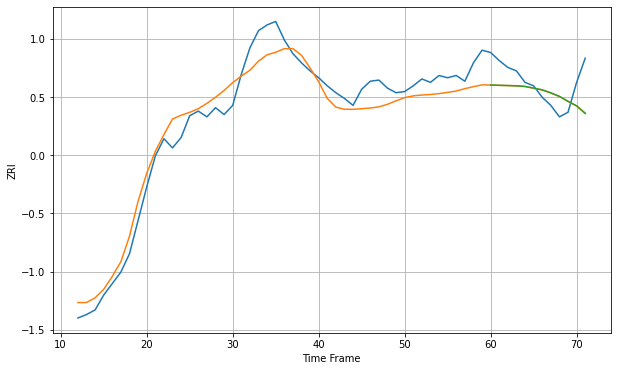

Wall time: 7.75 s
37115 14.650496724833879 20.29724076323438 20.427215600896684 [1131.67508416 1131.44203808 1131.25886248 1131.02722882 1130.48761668
 1129.03711554 1127.53491918 1124.92139912 1121.84696305 1117.53221069
 1113.50921244 1106.86779166]

Got an mse at 0.0098 in round 30 and stopped training

60 60 12


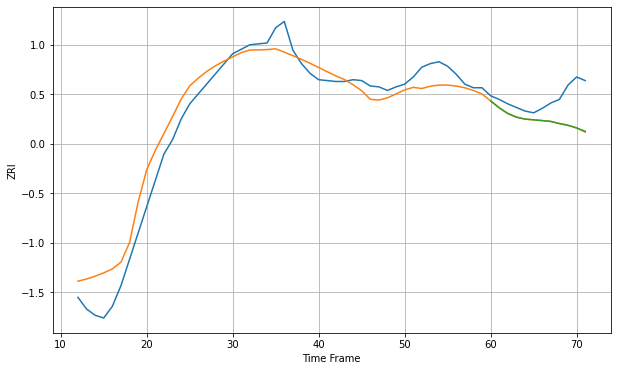

Wall time: 6.8 s
37211 21.040326955417555 29.454969128152648 29.26271203019215 [1189.32549012 1181.60625608 1175.24653109 1171.14055094 1169.01678726
 1168.22060025 1167.38048883 1166.46498099 1164.06648823 1162.17446097
 1159.1416696  1155.3814468 ]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


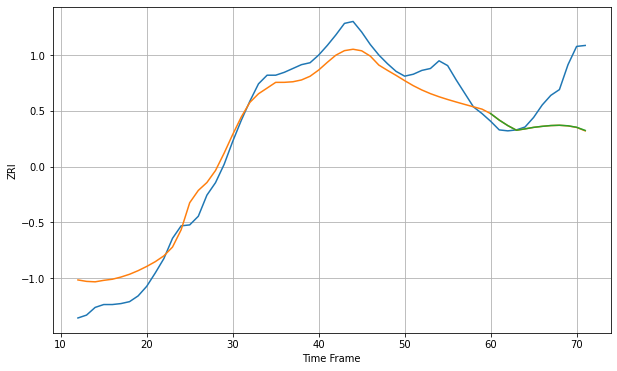

Wall time: 7.38 s
37214 19.70140307550715 43.10861991072265 42.99170304173889 [1152.98821786 1146.22414759 1140.47153091 1135.67033247 1137.06525568
 1138.65091067 1139.71291708 1140.53705273 1140.84327182 1140.28097455
 1138.73129527 1135.44708946]

Got an mse at 0.0097 in round 40 and stopped training

60 60 12


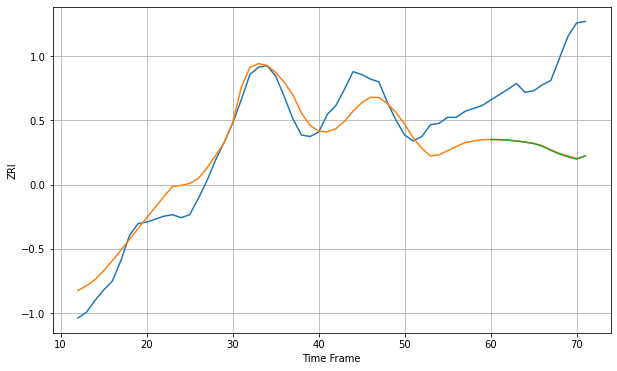

Wall time: 7.18 s
37221 14.058110120599514 56.40205282652714 56.596201443524635 [1320.98076446 1320.904637   1320.54435094 1319.97007227 1319.22313891
 1318.24800471 1316.44729233 1313.61535432 1311.14256204 1309.25337287
 1307.70259233 1309.94964676]

Got an mse at 0.0100 in round 318 and stopped training

60 60 12


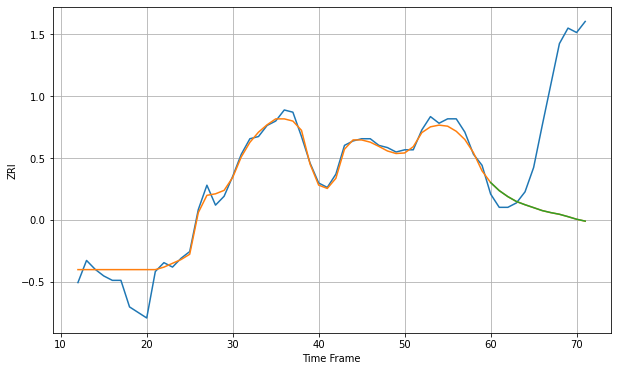

Wall time: 14.2 s
38104 5.514044457689517 53.0581845113484 53.04954689137266 [790.20790167 786.56283436 783.84660096 781.64561111 780.17737828
 778.86323257 777.53042651 776.61473946 775.87105205 774.78789637
 773.6235764  772.77797808]

Got an mse at 0.0097 in round 318 and stopped training

60 60 12


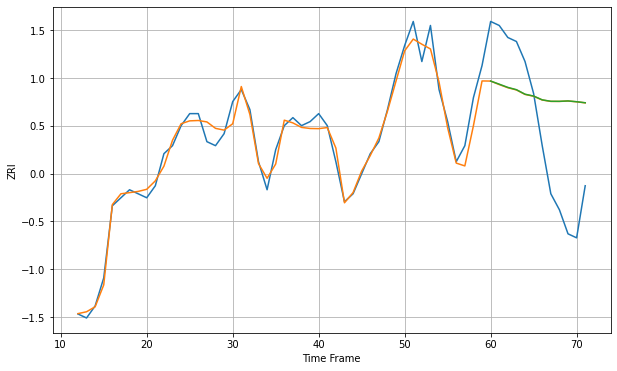

Wall time: 14.4 s
40391 2.646016796912248 20.16963272406798 20.16902597807372 [818.12583347 817.35154456 816.54635193 815.97292784 814.84824663
 814.38530606 813.43747212 813.07957023 813.06779893 813.16476704
 812.97029222 812.71361601]

Got an mse at 0.0099 in round 125 and stopped training

60 60 12


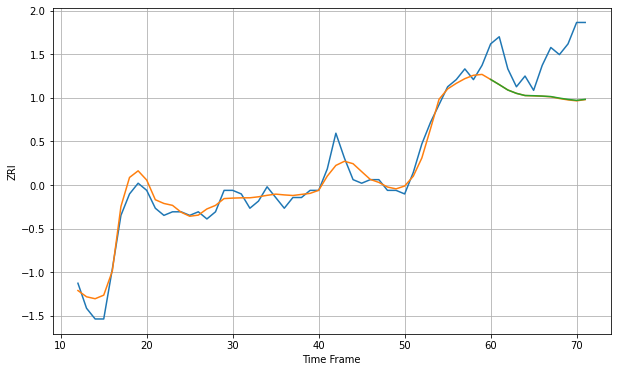

Wall time: 11.2 s
40502 2.8005661717139847 12.775536016761022 12.713908153302707 [810.04667218 808.60223634 807.09492965 806.15949241 805.55080248
 805.49458092 805.39564296 805.25726485 804.82713747 804.4640445
 804.1944266  804.48233052]

Got an mse at 0.0099 in round 153 and stopped training

60 60 12


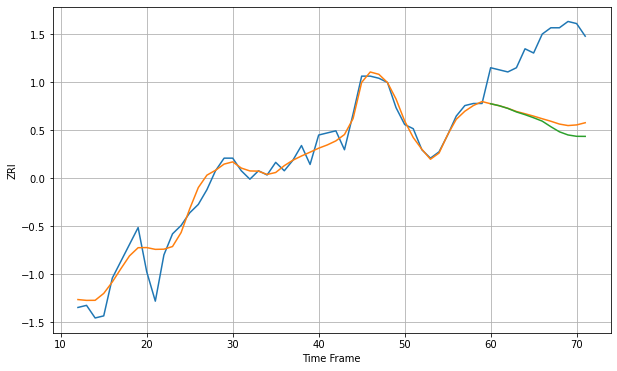

Wall time: 10.7 s
40515 5.745291987960396 35.740891690380366 38.39064388655735 [887.87087122 886.93364825 885.65378498 883.97904072 882.67708261
 881.2103051  879.6048596  876.96483855 874.53414529 873.03339409
 872.38684143 872.35518389]

Got an mse at 0.0100 in round 143 and stopped training

60 60 12


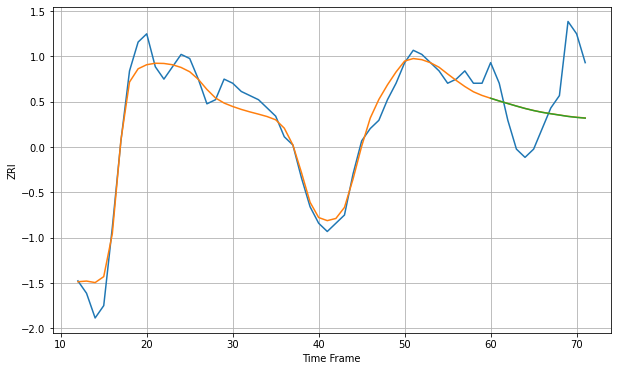

Wall time: 9.44 s
40517 3.298717243476338 11.58246039119918 11.592701113002862 [872.35322624 871.69004032 871.07378064 870.45683317 869.87537212
 869.36912795 868.93593053 868.59083707 868.26914061 867.94406707
 867.70989616 867.52864398]

Got an mse at 0.0099 in round 114 and stopped training

60 60 12


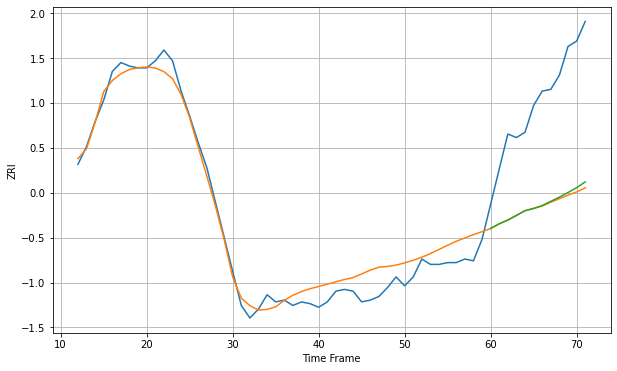

Wall time: 8.75 s
43055 7.892436840060674 62.080829484199654 61.10162903301608 [647.09603861 649.71471933 651.82195361 654.38878635 657.06326749
 658.3036453  659.93069169 662.30887094 664.65607606 667.21907657
 669.91690002 673.1936592 ]

Got an mse at 0.0099 in round 101 and stopped training

60 60 12


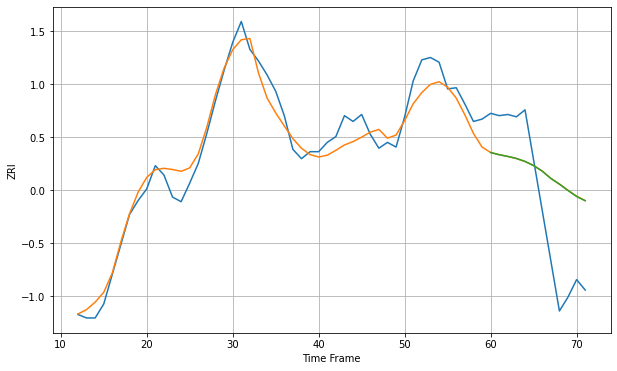

Wall time: 8.39 s
43201 13.217839207374674 60.86342276444357 60.74622919085625 [1077.28410972 1075.41406485 1073.93252028 1072.1701433  1069.5998368
 1066.07223071 1061.25469773 1054.99086634 1050.03849273 1044.59101016
 1039.47754399 1035.86080386]

Got an mse at 0.0100 in round 81 and stopped training

60 60 12


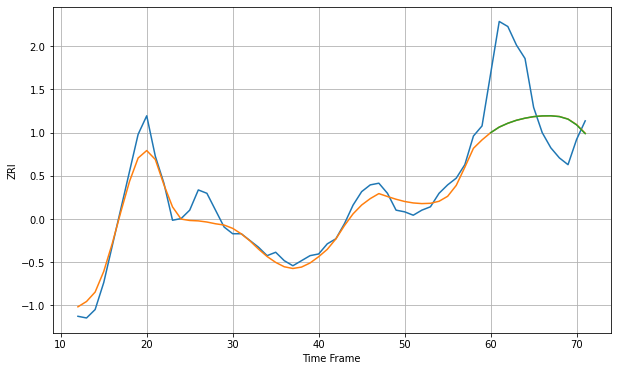

Wall time: 8.64 s
43202 7.092537267301818 33.738994517641444 33.733888044795144 [935.97086718 939.30460628 941.58005349 943.34796683 944.59913394
 945.51442881 945.93527164 946.00767056 945.53751394 944.01938197
 940.61992249 935.42755393]

Got an mse at 0.0095 in round 36 and stopped training

60 60 12


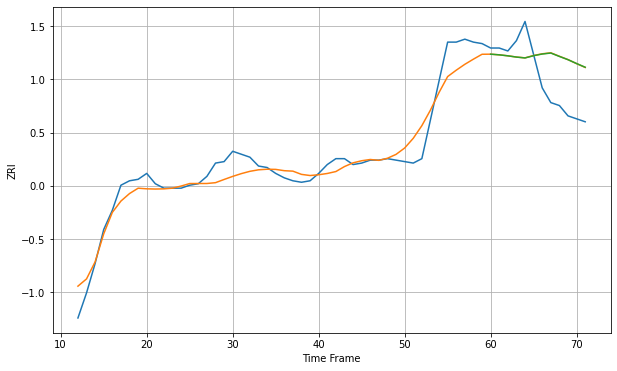

Wall time: 6.81 s
43204 9.639603550611442 25.458389210738492 25.4469932381366 [964.82427649 964.37869816 963.70521779 962.85305288 962.2681138
 963.7964581  964.9285768  965.59263579 963.29373704 961.0949208
 958.46598382 955.97226827]

Got an mse at 0.0098 in round 77 and stopped training

60 60 12


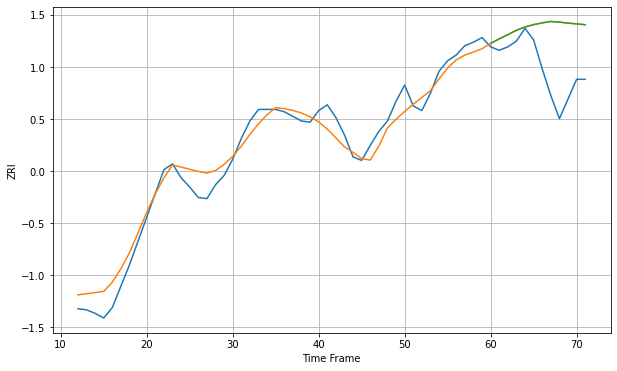

Wall time: 8.17 s
43205 11.803280883816752 42.70413317624735 42.69766821006558 [896.9642842  900.909287   904.54709948 908.28688779 911.15840518
 913.18774411 914.67855171 915.91305542 915.3495298  914.46820393
 913.83293104 913.08373556]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


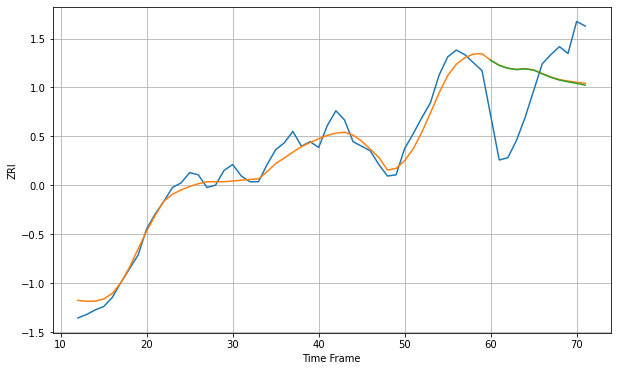

Wall time: 6.82 s
43206 9.247356372570783 48.70267039523738 48.953683214672544 [998.11113258 993.67098147 991.11200965 989.97654413 990.59940506
 989.531091   986.26078546 983.1748784  980.81392729 979.26493811
 977.9002776  976.36534195]

Got an mse at 0.0099 in round 141 and stopped training

60 60 12


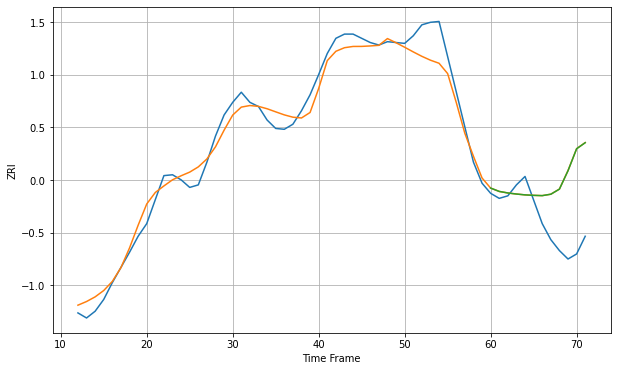

Wall time: 10.1 s
43212 16.671425361377107 63.96952168056923 63.89811360944844 [1086.20163739 1082.23225893 1080.39610684 1079.13668132 1078.14060148
 1077.57101262 1077.24635001 1078.91739754 1084.95254798 1106.80115757
 1132.88609984 1140.07061536]

Got an mse at 0.0099 in round 311 and stopped training

60 60 12


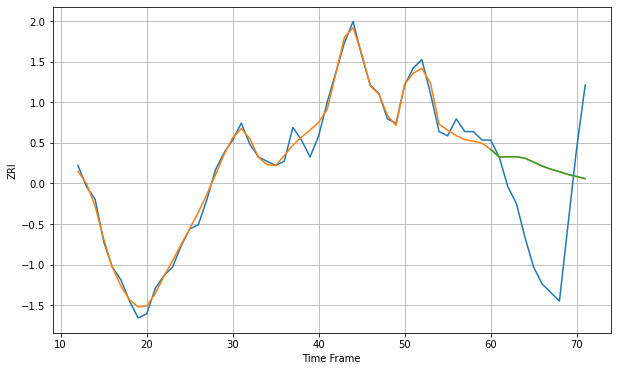

Wall time: 13.2 s
44035 1.8173493414262014 19.085037889685534 19.087935826692007 [669.81230737 668.01886885 668.04504715 668.06738845 667.70043031
 666.80500288 665.86539061 665.12759341 664.54900655 663.88605116
 663.4062892  662.92292118]
60 60 12


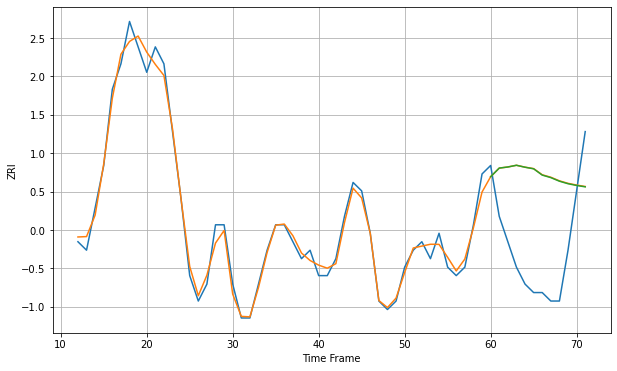

Wall time: 18.4 s
44052 1.063260595905832 10.701006784006651 10.682156309438167 [617.67345705 618.69219378 618.82212544 619.024992   618.79349916
 618.6082695  617.86543111 617.56871837 617.14394099 616.84672703
 616.64164073 616.47952004]

Got an mse at 0.0099 in round 42 and stopped training

60 60 12


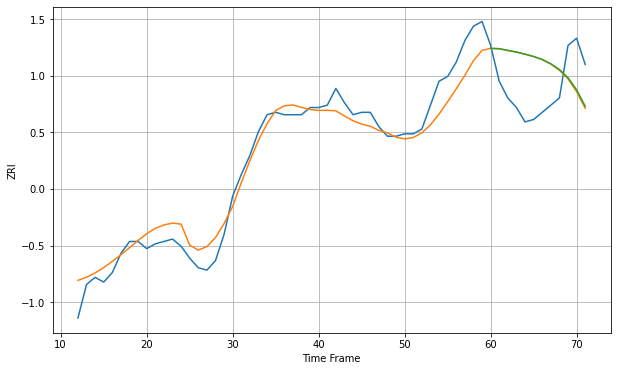

Wall time: 7.43 s
44102 6.839346769931623 19.499409208085442 19.36446632547552 [852.75431004 852.59909159 851.88427022 851.20478291 850.33067779
 849.34602078 848.11493416 846.31066494 843.90898743 840.4979199
 835.41399618 828.56720827]
60 60 12


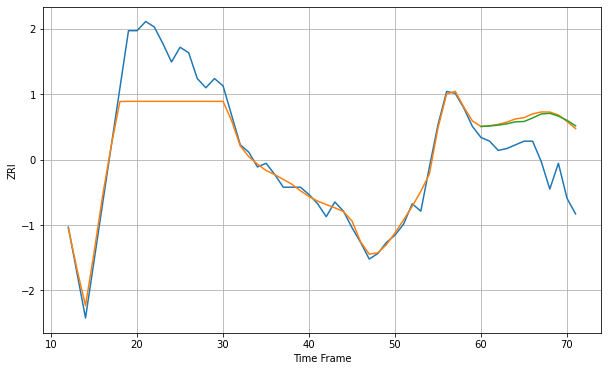

Wall time: 19.6 s
44103 14.663460821073203 26.040405096371224 25.806824049961243 [868.97861094 869.24687313 869.7069925  870.39780541 871.50905526
 871.66874516 873.59377854 875.76775228 876.12054771 874.6219847
 872.34100298 869.33036163]

Got an mse at 0.0098 in round 105 and stopped training

60 60 12


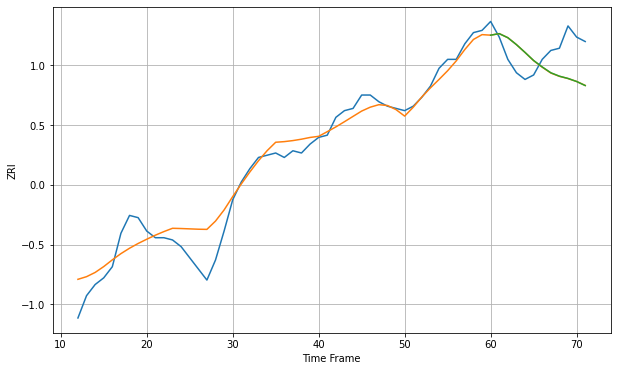

Wall time: 8.84 s
44107 7.579789490094605 13.216849786806858 13.21105133508738 [871.85111272 872.54159757 870.71569234 867.61786915 864.12300634
 860.49444307 857.59862359 854.99731205 853.45093792 852.43895479
 851.06899346 849.25216829]

Got an mse at 0.0098 in round 294 and stopped training

60 60 12


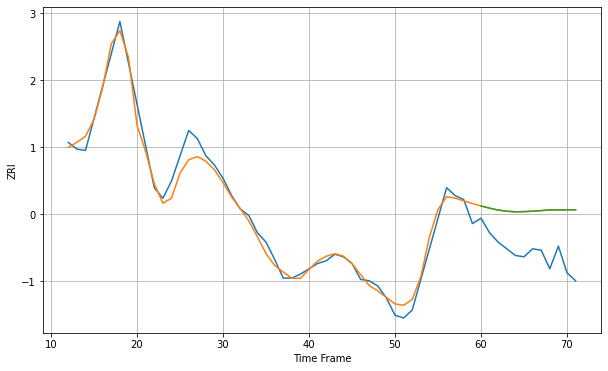

Wall time: 14.5 s
44108 7.142153459049136 33.58647924268127 33.569975680629994 [801.26208152 799.5757501  798.15131883 797.27347347 796.84001293
 796.9772803  797.30604786 797.75443681 798.29127341 798.24476832
 798.35887302 798.32411295]

Got an mse at 0.0098 in round 115 and stopped training

60 60 12


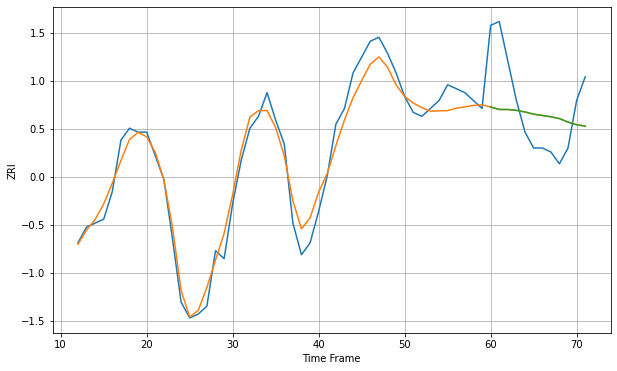

Wall time: 8.63 s
44109 3.626488471744635 11.860635002616027 11.873778631342716 [717.37206213 716.74278063 716.73229235 716.518109   716.11725955
 715.546305   715.2418921  714.90999003 714.43083415 713.53961821
 712.8562023  712.48728044]

Got an mse at 0.0099 in round 131 and stopped training

60 60 12


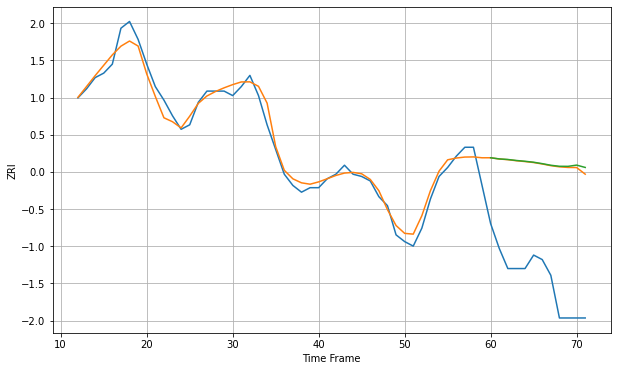

Wall time: 9.9 s
44110 4.161211135943454 52.3250841201466 52.891312457118055 [739.32232411 738.81293822 738.55864891 738.11048656 737.76266525
 737.3342157  736.70338534 735.98593011 735.53343823 735.50176629
 736.05385562 735.01410386]

Got an mse at 0.0099 in round 83 and stopped training

60 60 12


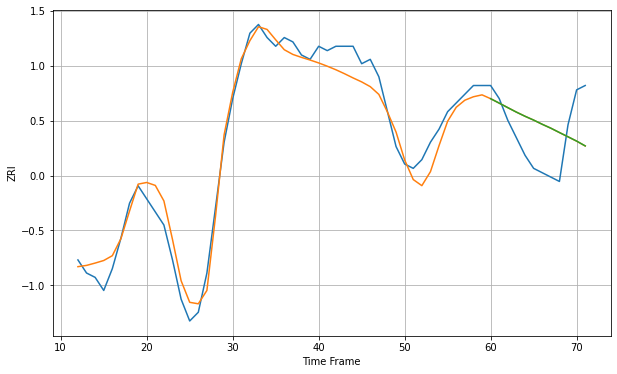

Wall time: 7.79 s
44111 3.608113939946905 8.986467441932296 8.984062868419498 [757.97785735 756.95647062 755.92003608 754.8948817  753.94751045
 753.07106972 752.10930656 751.21577659 750.21807041 749.24182056
 748.25603759 747.14893826]

Got an mse at 0.0097 in round 189 and stopped training

60 60 12


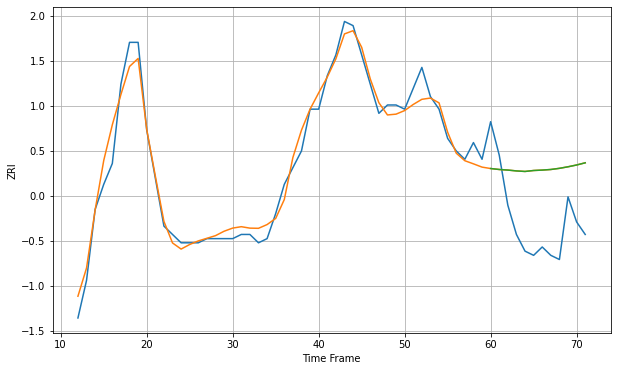

Wall time: 11.2 s
44112 3.0886730600085146 15.777761019731207 15.776582769288455 [680.78482982 680.55468549 680.41698703 680.21141434 680.0839707
 680.31258334 680.41293111 680.55633416 680.83234716 681.20193288
 681.6296021  682.15344212]

Got an mse at 0.0099 in round 197 and stopped training

60 60 12


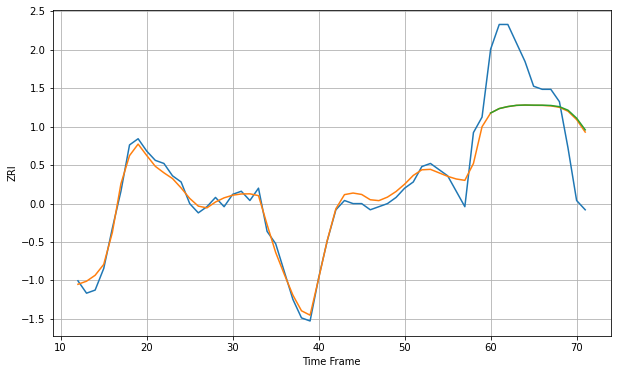

Wall time: 11.2 s
44118 2.8662412135902944 18.35170728220615 18.49684988354712 [962.33106248 963.76738238 964.42057622 964.81464221 964.9188539
 964.87523771 964.86163069 964.77206613 964.38316297 963.23424753
 960.66612249 956.88374019]

Got an mse at 0.0098 in round 78 and stopped training

60 60 12


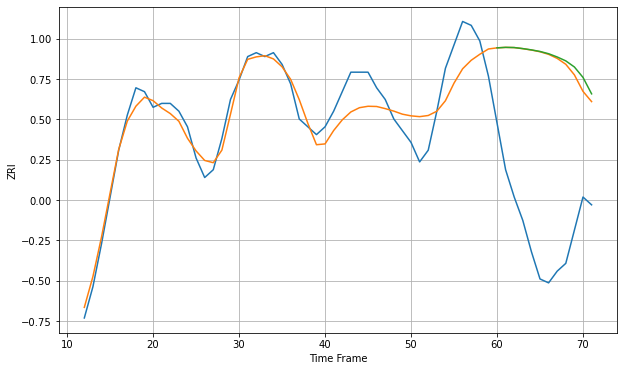

Wall time: 7.99 s
44120 5.164620845562028 43.63451660863341 44.24650683274693 [860.23624891 860.36144159 860.31577851 860.04546793 859.71590719
 859.31166205 858.73457319 857.89988884 856.8963534  855.33190556
 852.66507372 848.44899908]

Got an mse at 0.0099 in round 468 and stopped training

60 60 12


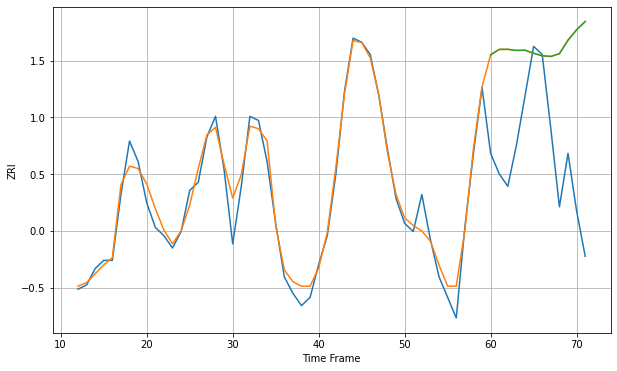

Wall time: 20.2 s
44133 3.2370043913481354 30.10860908135145 30.13835380952887 [1035.9451618  1037.28029115 1037.28382923 1037.01300155 1037.06996659
 1036.3284798  1035.71886109 1035.56367078 1036.23217591 1039.52186443
 1042.04833989 1044.04666692]

Got an mse at 0.0098 in round 261 and stopped training

60 60 12


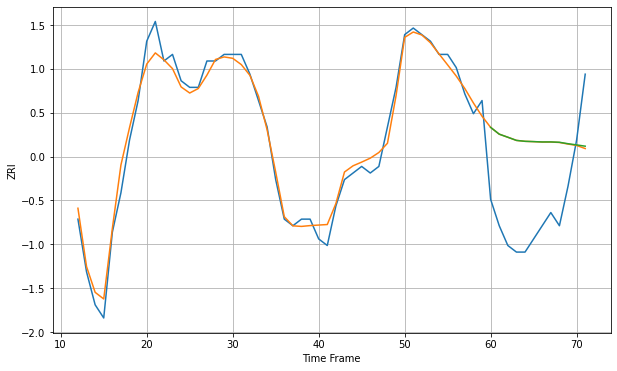

Wall time: 13.3 s
44646 1.7080712632562802 12.82694741269456 12.809423898506672 [644.9268773  643.89811561 643.42995982 642.95075779 642.81153316
 642.76788386 642.71308752 642.71891286 642.66511419 642.44671415
 642.26734447 642.0724065 ]

Got an mse at 0.0098 in round 157 and stopped training

60 60 12


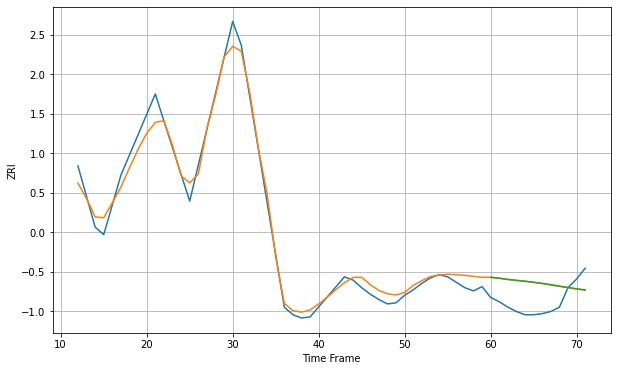

Wall time: 9.87 s
44720 9.175441801017726 23.081549331135257 23.118267378205918 [695.60200558 694.73100466 693.60431167 692.76173268 691.94934183
 691.02262305 689.95431506 688.72648471 687.43324099 686.17526029
 685.005917   683.95692915]

Got an mse at 0.0099 in round 101 and stopped training

60 60 12


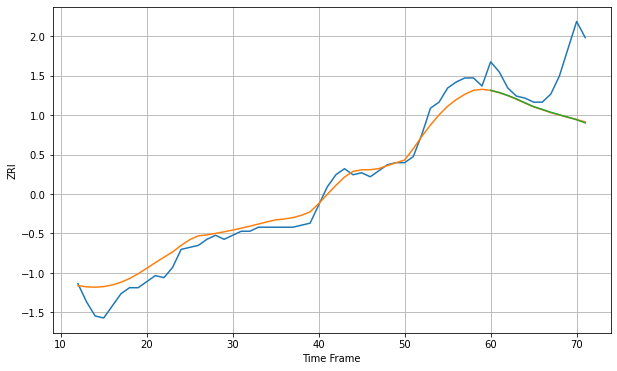

Wall time: 8.88 s
45205 5.805226108162512 22.49839192958466 22.567580127792016 [675.83597979 674.75037389 673.29991634 671.57982722 669.64530822
 667.78669202 666.40890381 664.97097605 663.74320022 662.53859158
 661.28651678 659.71408435]

Got an mse at 0.0099 in round 76 and stopped training

60 60 12


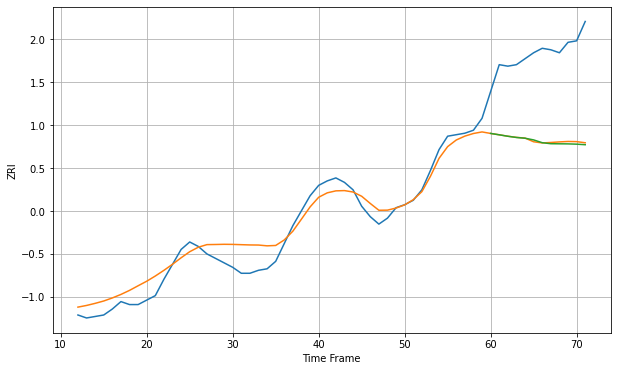

Wall time: 7.48 s
45211 8.789566422737236 58.53913946110691 59.08913238011317 [759.8517204  758.93197796 757.9549579  757.1490785  756.64017949
 755.51089962 753.63458184 752.95303886 752.8898647  752.83727994
 752.64953911 752.28058499]

Got an mse at 0.0099 in round 64 and stopped training

60 60 12


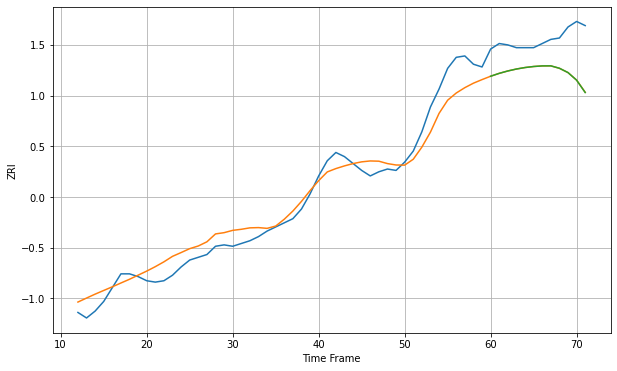

Wall time: 8.36 s
45212 10.55177740425117 26.142863745947757 26.17331768675685 [841.28334307 843.37608561 845.10578206 846.51596402 847.59534149
 848.34438331 848.77626981 848.81932049 847.0773902  843.94269022
 838.41628002 829.46562115]

Got an mse at 0.0099 in round 116 and stopped training

60 60 12


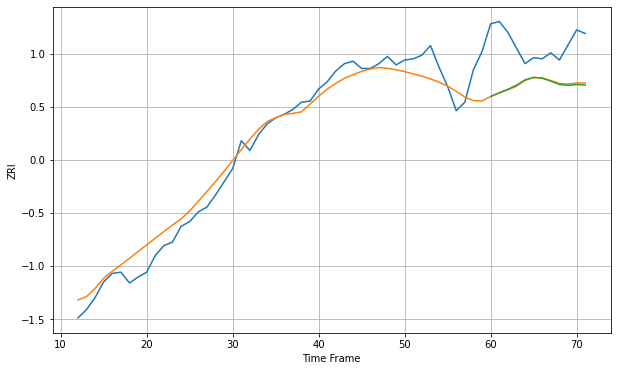

Wall time: 8.87 s
45219 12.820115259470882 37.34483631656058 37.642611345210234 [972.75655093 975.84656269 978.6641814  982.07279729 986.59636855
 988.59494483 987.91308982 985.49070353 982.72631343 982.03090544
 982.62607663 982.24762082]

Got an mse at 0.0100 in round 139 and stopped training

60 60 12


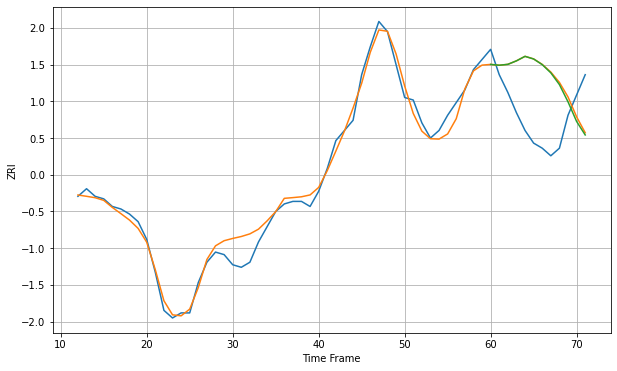

Wall time: 9.52 s
45405 4.06191136508977 22.46931489702227 22.43082269425329 [618.05372308 617.72461371 618.08178885 619.45793617 621.23418982
 620.1964091  617.96835148 614.72888003 610.09188972 603.28446279
 595.54432005 590.2185663 ]

Got an mse at 0.0099 in round 133 and stopped training

60 60 12


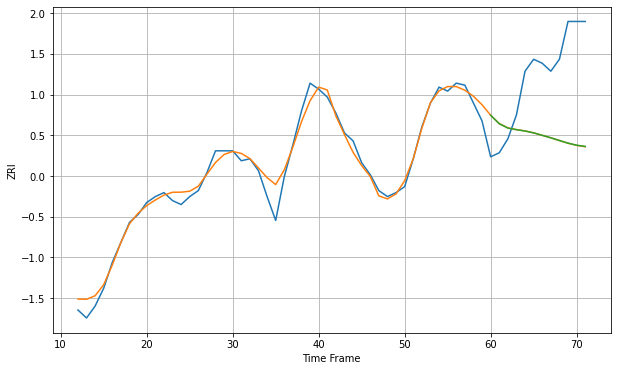

Wall time: 9.56 s
45840 4.524728850151562 39.45846202908613 39.41889077229839 [810.88203651 806.61331031 804.4438862  803.62110764 802.95956556
 802.0261906  800.77721565 799.54341807 798.18851298 796.85658837
 795.81978141 795.22183458]

Got an mse at 0.0099 in round 188 and stopped training

60 60 12


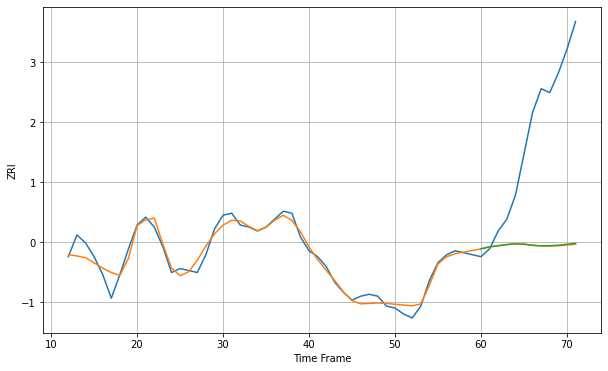

Wall time: 11.9 s
46143 3.79865415667643 64.53606888801734 64.35780794957118 [880.99255979 881.96904569 882.55632295 883.13927173 883.52295918
 883.3454744  882.78160225 882.50435723 882.56555186 882.82331535
 883.27788726 883.74053275]

Got an mse at 0.0100 in round 209 and stopped training

60 60 12


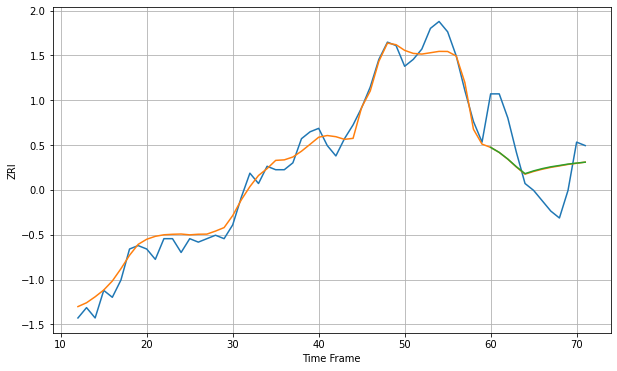

Wall time: 10.8 s
46201 3.301515897182009 10.478767687079563 10.529821824688161 [662.48204278 661.0197112  659.08897483 656.85468752 654.85733477
 655.66593832 656.31807181 656.84208399 657.22866303 657.63488151
 657.9204653  658.18800522]

Got an mse at 0.0099 in round 287 and stopped training

60 60 12


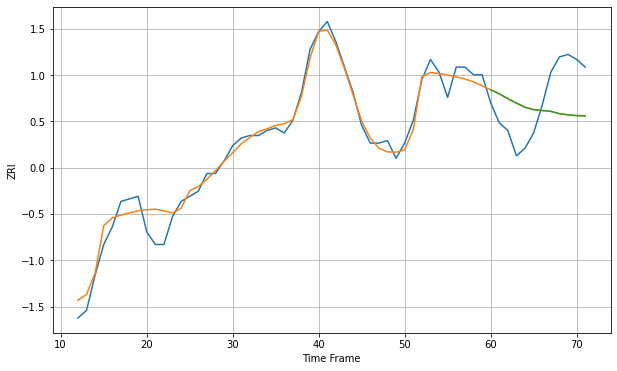

Wall time: 13.4 s
46203 4.572644243552845 16.47642173272738 16.503430653157327 [771.04514141 769.45537813 767.53388912 765.76037956 764.15800619
 763.19937937 762.8470782  762.53169035 761.59208477 761.13431901
 760.84288614 760.72952273]

Got an mse at 0.0100 in round 98 and stopped training

60 60 12


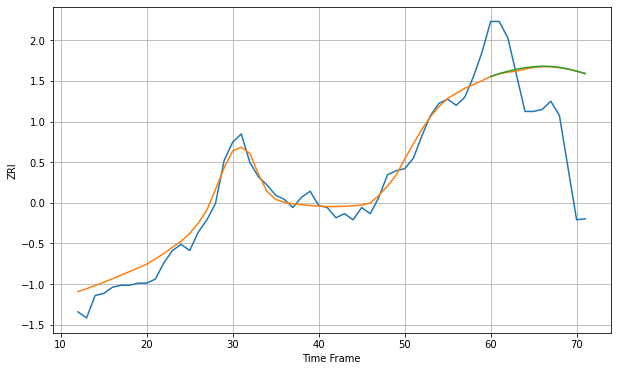

Wall time: 8.65 s
46208 5.68182721798753 37.07450734553439 37.118842775686396 [847.06912223 848.5146797  849.6324802  850.61850819 851.37773245
 851.88898243 852.10300806 852.01465873 851.55461916 850.79206071
 849.6993291  848.50049035]

Got an mse at 0.0099 in round 84 and stopped training

60 60 12


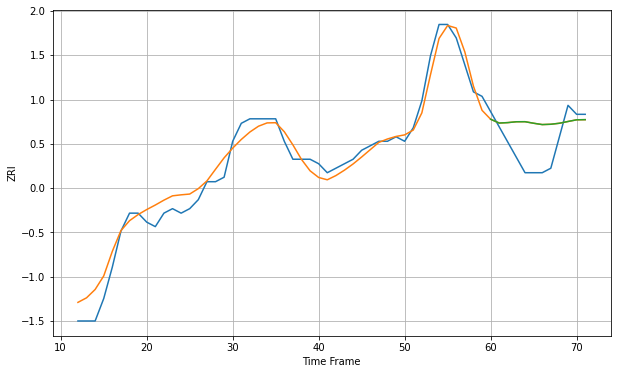

Wall time: 8.14 s
46219 2.785142617857564 6.901356112715363 6.9008697646202455 [657.90029007 657.05934084 657.15434642 657.34471583 657.35549353
 657.01236471 656.71613175 656.78828015 657.01192015 657.40503961
 657.77914492 657.81403581]

Got an mse at 0.0100 in round 109 and stopped training

60 60 12


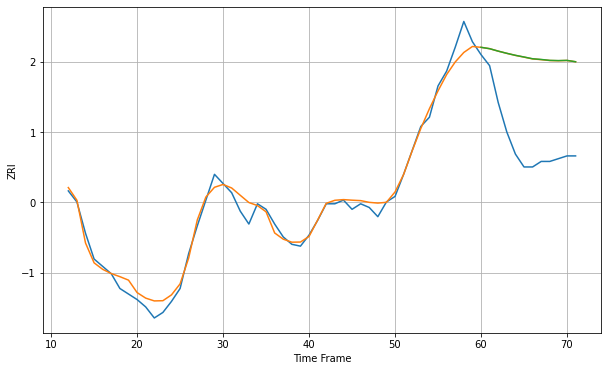

Wall time: 8.69 s
46312 4.844974068327549 47.21372780852652 47.26771349005724 [909.95842543 909.22102257 907.89397801 906.70617614 905.61937369
 904.70666463 903.74482693 903.36551103 902.87555611 902.75565436
 902.8684137  902.12936265]

Got an mse at 0.0100 in round 257 and stopped training

60 60 12


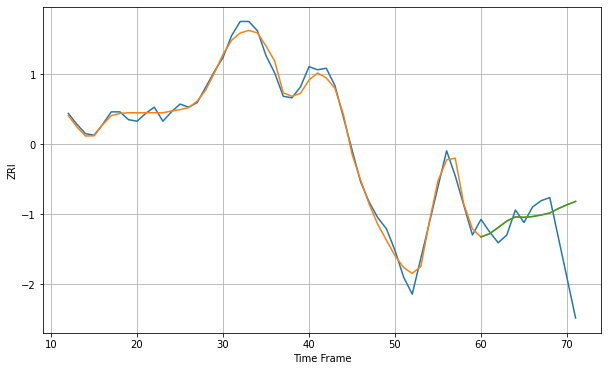

Wall time: 13.1 s
47374 4.557657027951767 26.913471192032745 26.922970067174898 [659.72333219 661.82228016 665.78497527 669.92982222 672.61003475
 672.32854908 672.82979056 673.82608235 675.09400312 677.95905017
 680.38027718 682.55385736]

Got an mse at 0.0099 in round 79 and stopped training

60 60 12


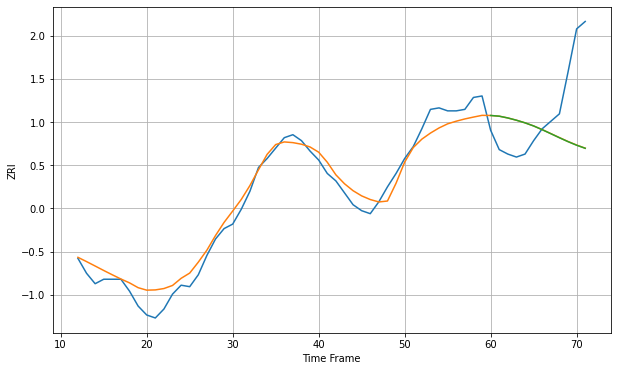

Wall time: 8.12 s
47401 8.219940158458158 38.87493435213656 38.92121004418435 [1323.90575891 1323.42495375 1322.23871415 1320.718729   1318.96220638
 1316.86872663 1314.36281252 1311.68183533 1308.96991381 1306.34101406
 1303.94295673 1301.87971282]

Got an mse at 0.0098 in round 246 and stopped training

60 60 12


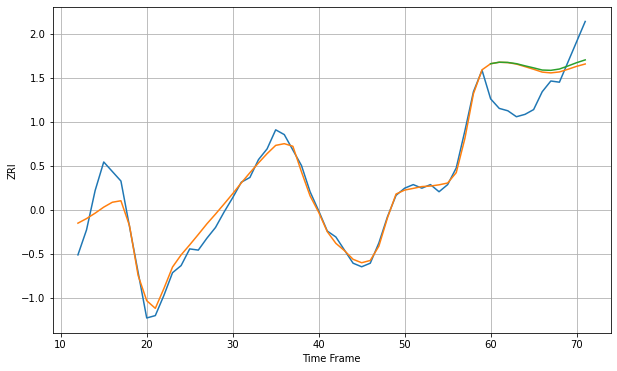

Wall time: 12.6 s
47408 10.14578513304638 30.06464730030922 29.988477758430378 [1423.51309749 1424.79883139 1424.59167696 1423.54354025 1421.73393054
 1420.03172181 1418.20953779 1417.96165777 1419.05876177 1421.63380102
 1424.37738741 1426.73601182]

Got an mse at 0.0096 in round 121 and stopped training

60 60 12


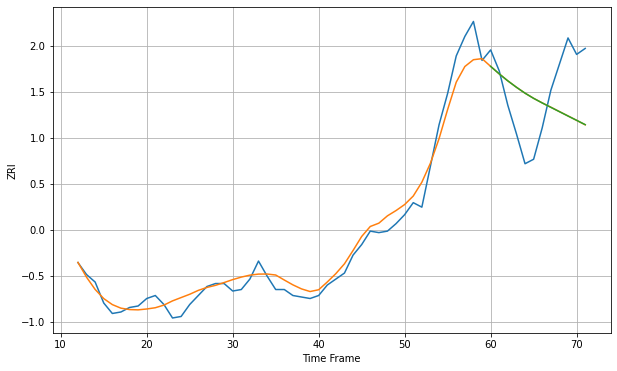

Wall time: 9.12 s
48186 8.230263457940554 34.023822329789965 34.01751761440284 [986.00659109 980.99986615 976.32687656 972.06456648 968.11799837
 964.65613135 961.58436954 958.6805337  955.76834573 952.86373444
 949.99035858 947.09093138]

Got an mse at 0.0099 in round 137 and stopped training

60 60 12


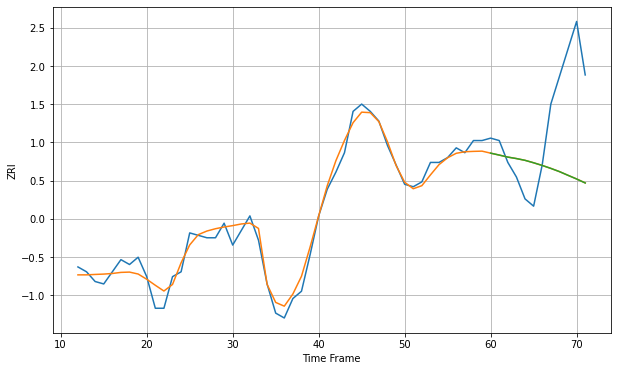

Wall time: 8.91 s
48195 3.8014270674277215 31.369311062245032 31.377202793440418 [853.81761709 853.02620926 852.19167908 851.58953715 850.86394181
 849.85721093 848.75829069 847.54691836 846.22481098 844.69483211
 843.1877053  841.5423408 ]

Got an mse at 0.0100 in round 74 and stopped training

60 60 12


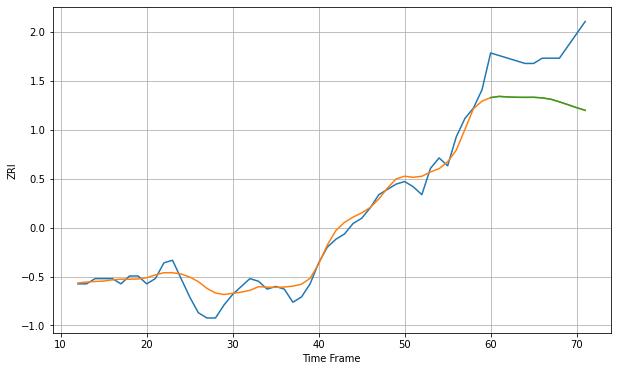

Wall time: 7.45 s
48235 4.0377292850975275 19.30408347596513 19.293934446887103 [740.98509837 741.44340045 741.22820343 741.10807192 741.0746507
 741.10205769 740.87137358 740.36463554 739.36876867 738.28153772
 737.16316473 736.14216799]

Got an mse at 0.0094 in round 107 and stopped training

60 60 12


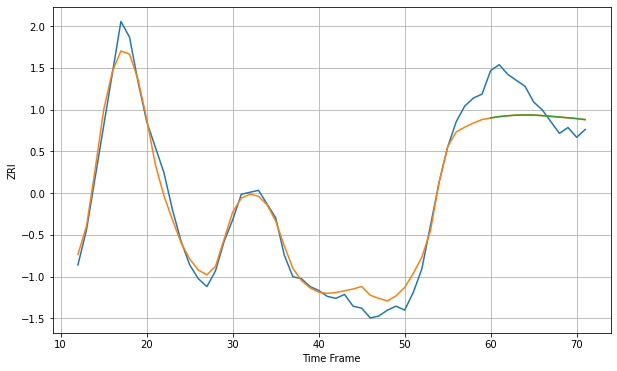

Wall time: 8.52 s
52001 6.495346405797442 14.47689905860378 14.499860785026138 [747.8699409  748.53728322 748.97304944 749.27968727 749.37062589
 749.30015244 749.02411902 748.66369685 748.30040158 747.93660015
 747.53328564 747.02656672]

Got an mse at 0.0100 in round 158 and stopped training

60 60 12


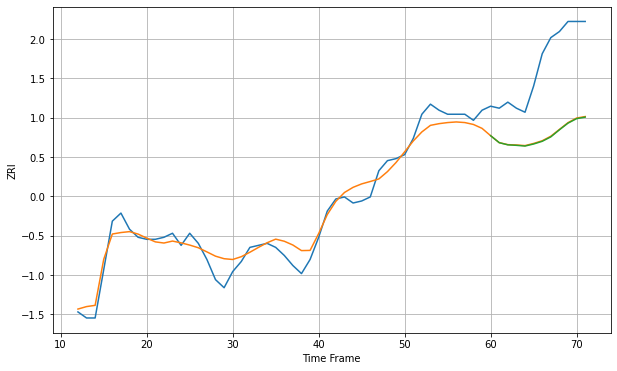

Wall time: 10.2 s
53140 5.862020652734763 36.51707219305717 36.73109123301875 [839.36114852 835.90146363 834.83341355 834.59146633 834.23544964
 835.25000176 836.58877449 838.78505457 842.28908182 845.59633951
 847.82279763 848.58756414]

Got an mse at 0.0100 in round 144 and stopped training

60 60 12


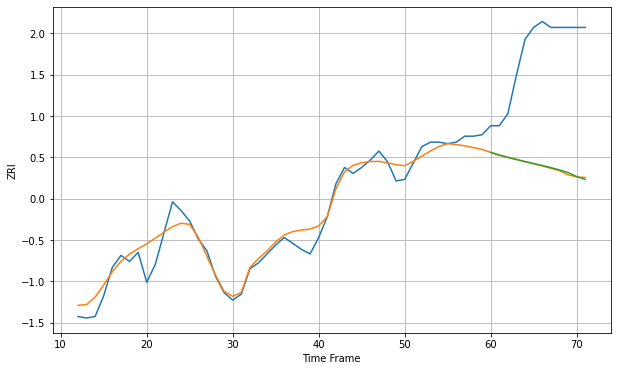

Wall time: 9.73 s
53143 7.839020137241893 80.34694981680714 80.15341870103994 [854.1177445  852.33500539 850.8229136  849.37149519 847.95282212
 846.65981859 845.3467291  843.91948348 842.34911009 840.60477251
 837.93956371 835.94369761]

Got an mse at 0.0098 in round 275 and stopped training

60 60 12


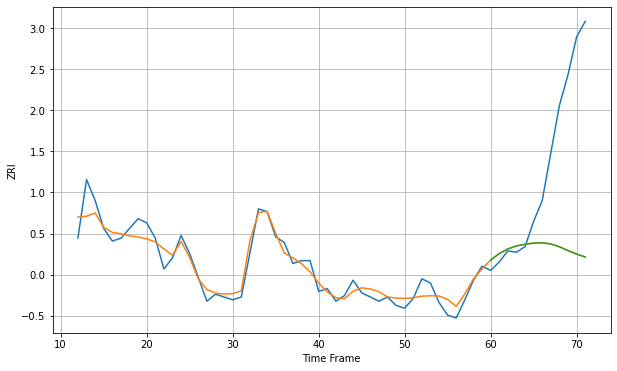

Wall time: 14 s
53202 7.528707854811191 83.72454928520558 83.66346346775005 [1128.4048194  1133.02124021 1136.37044085 1138.49828133 1139.69094407
 1140.51901561 1140.79185899 1139.89238545 1137.90162179 1135.23406898
 1132.72098883 1130.66068228]

Got an mse at 0.0098 in round 154 and stopped training

60 60 12


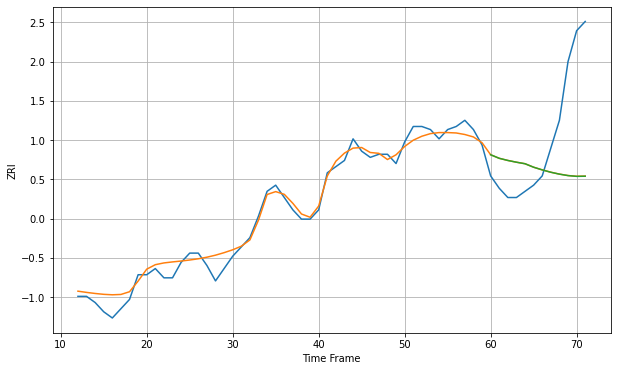

Wall time: 11.2 s
53204 2.9780160153436084 24.12260907179343 24.141179802023117 [704.84655319 703.69692703 702.99967871 702.43333207 701.93627934
 700.80837789 699.9462272  699.17962736 698.56627825 698.09627947
 697.84822837 697.89720058]

Got an mse at 0.0098 in round 82 and stopped training

60 60 12


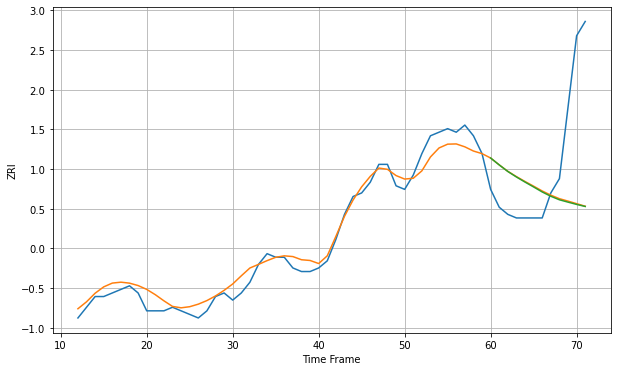

Wall time: 8.34 s
53206 2.9418331680500893 22.992323544689782 23.047660765548237 [710.77557367 708.84102168 707.00390202 705.46612156 704.03812572
 702.67057287 701.27178158 700.07010393 699.08231859 698.42529609
 697.78931441 697.21408574]

Got an mse at 0.0099 in round 39 and stopped training

60 60 12


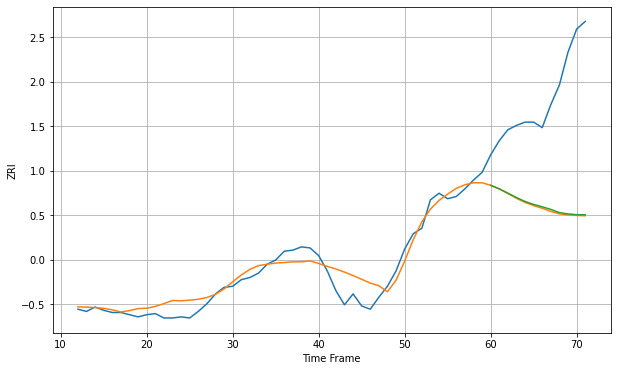

Wall time: 6.52 s
53207 10.641463574497543 105.37671084701324 104.55485074823311 [951.25883711 948.04412781 944.13243109 940.06220557 936.49857729
 933.7801405  931.61136748 929.23532685 926.30598186 925.10314947
 924.41733659 924.34287334]

Got an mse at 0.0097 in round 97 and stopped training

60 60 12


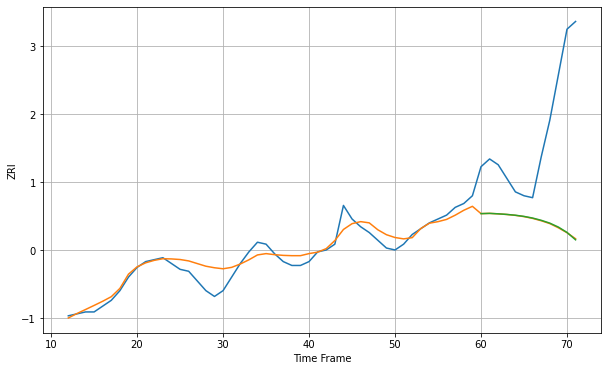

Wall time: 8.5 s
53208 5.1069310582002565 55.19766836905497 55.18481342491167 [736.76587055 736.89603977 736.66403904 736.35703162 735.93569834
 735.3357453  734.48398654 733.32775107 731.86290942 729.82057037
 727.06230316 723.2413753 ]

Got an mse at 0.0100 in round 155 and stopped training

60 60 12


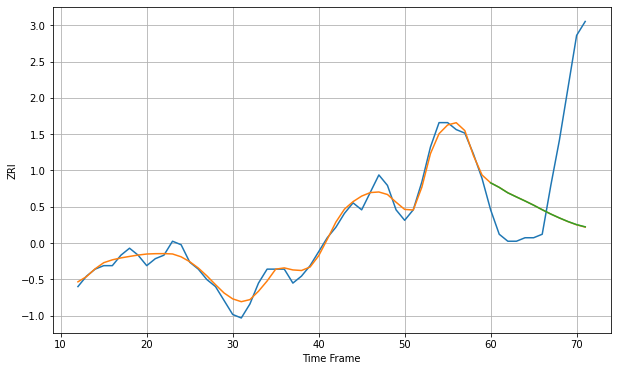

Wall time: 10.3 s
53209 2.1508444946742715 27.845705830319847 27.818776895619795 [706.74097471 705.43274387 703.87789095 702.69626108 701.54353934
 700.33217114 699.03457403 697.78966645 696.67468006 695.64160107
 694.75814912 694.13282357]

Got an mse at 0.0099 in round 130 and stopped training

60 60 12


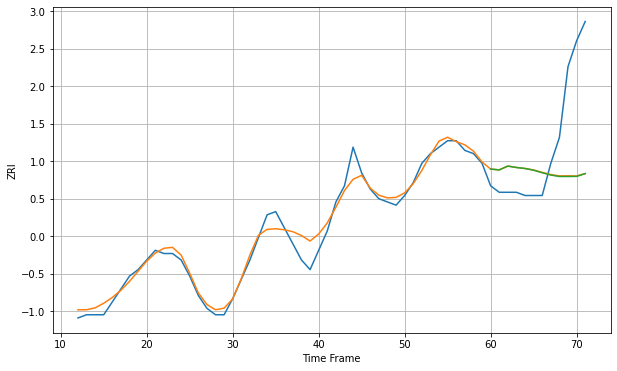

Wall time: 9.71 s
53210 2.9303168017164514 21.746350354576972 21.80125362593382 [751.19975314 750.94897355 752.13544241 751.6875884  751.39013302
 750.84295499 750.06481633 749.34488394 748.8994082  748.8986297
 748.93337394 749.78962797]

Got an mse at 0.0098 in round 217 and stopped training

60 60 12


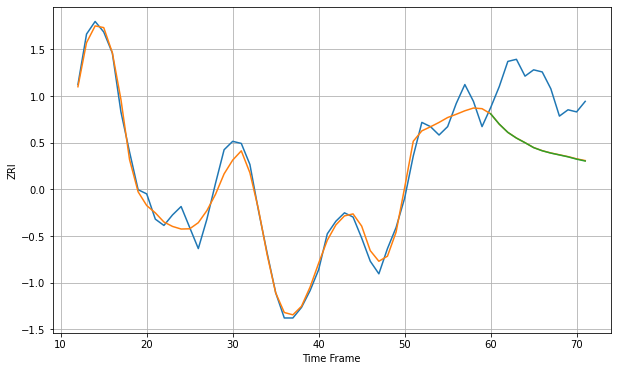

Wall time: 11.9 s
53211 5.119527588850878 28.41535778212878 28.47566696334896 [1179.10157311 1174.18825811 1170.2599619  1167.54519674 1165.34754847
 1163.0111933  1161.51176961 1160.40696705 1159.5229591  1158.6274561
 1157.52526757 1156.62649348]

Got an mse at 0.0099 in round 169 and stopped training

60 60 12


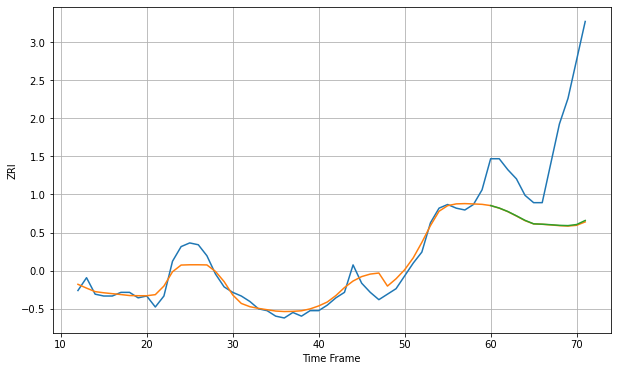

Wall time: 10.5 s
53212 5.048282635028093 51.668348063678046 51.40560403832434 [840.41451153 839.05535295 837.17144503 834.82173611 832.34557742
 830.43102073 830.24251085 829.95126908 829.60852614 829.46751168
 830.05347756 832.26133441]

Got an mse at 0.0097 in round 74 and stopped training

60 60 12


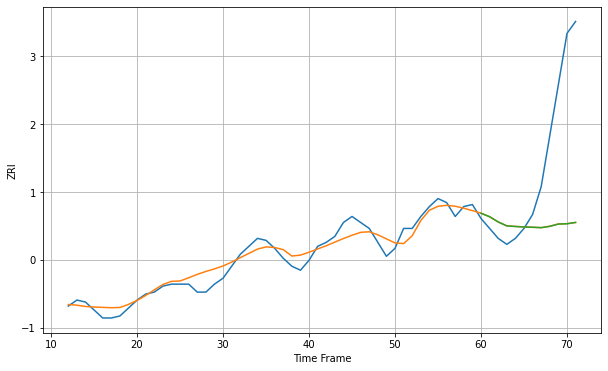

Wall time: 7.99 s
53215 4.555570604332454 47.458756147271245 47.47869796952329 [755.63897362 753.87736088 751.24428837 749.27066489 748.97317095
 748.7378999  748.57888891 748.3797895  749.04139785 750.19550794
 750.34042674 751.00039911]

Got an mse at 0.0100 in round 99 and stopped training

60 60 12


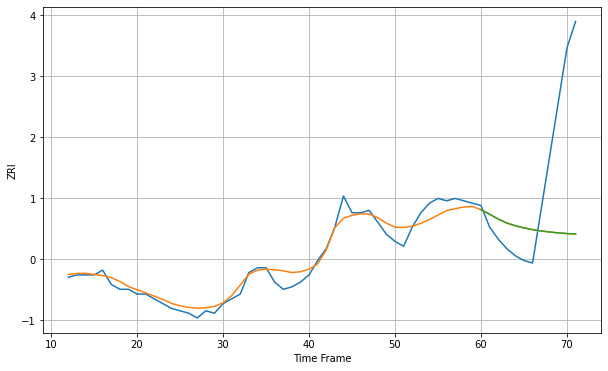

Wall time: 8.5 s
53216 3.5794084100327503 39.60976240356172 39.60054732496552 [722.29925676 720.36561136 718.39126113 716.71497719 715.58200352
 714.66540768 713.94917038 713.394623   712.93623551 712.59613317
 712.29435897 712.12756214]

Got an mse at 0.0100 in round 65 and stopped training

60 60 12


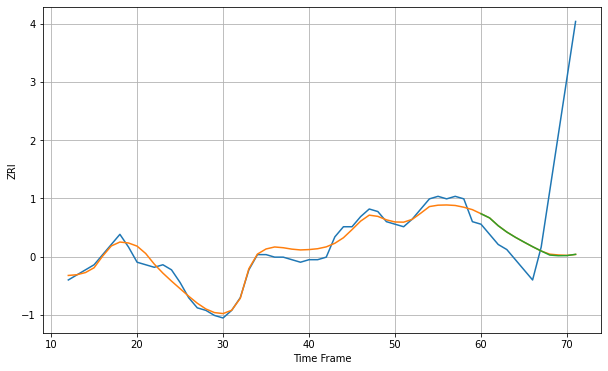

Wall time: 7.29 s
53218 2.7823339625705135 37.40656397570792 37.46244743331146 [729.13381939 727.47781617 724.39678092 721.91151678 719.83563997
 717.9560407  716.13829815 714.44025731 712.8190644  712.56675993
 712.61505892 713.11257633]

Got an mse at 0.0099 in round 386 and stopped training

60 60 12


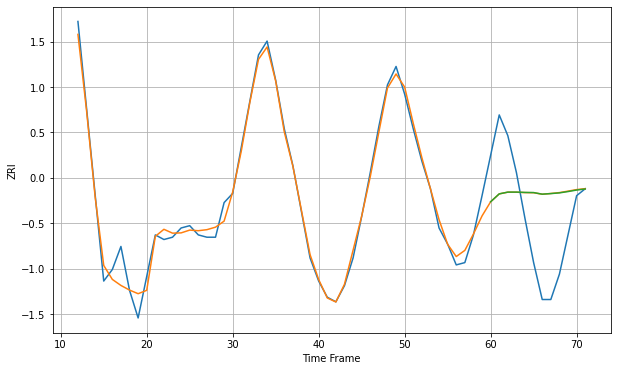

Wall time: 17.5 s
53403 4.228907618148978 27.54173600477063 27.51887396150968 [832.35684014 835.78165787 836.54728127 836.55208712 836.40745201
 836.34809671 835.65530159 835.9086239  836.20762965 836.7839071
 837.43897629 837.89815436]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


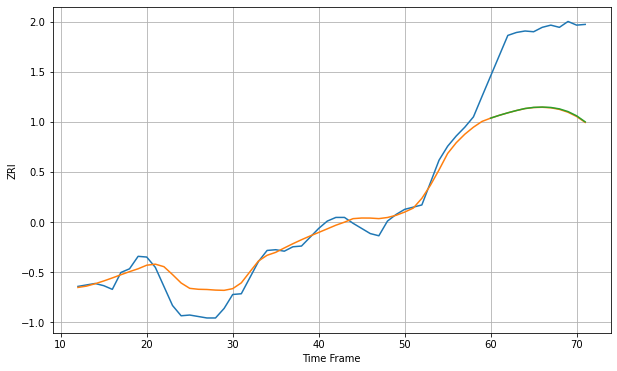

Wall time: 8.72 s
53590 17.961778965202665 107.95081370500027 107.53905931396706 [1087.26646586 1091.11859387 1094.55647483 1097.67250127 1100.4032574
 1101.92324726 1102.37543405 1101.82964801 1099.9046489  1096.23455091
 1090.46800732 1082.21957427]

Got an mse at 0.0100 in round 218 and stopped training

60 60 12


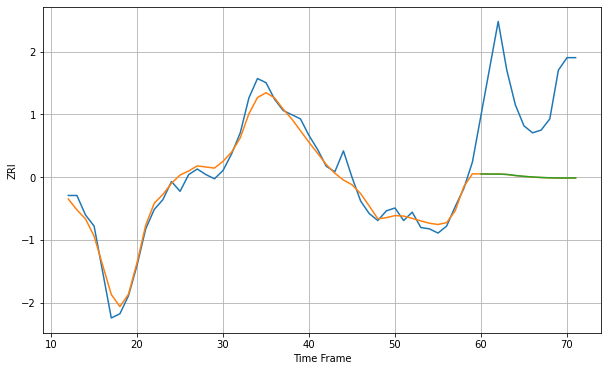

Wall time: 11.4 s
53703 6.630122815958618 67.08747683963017 67.03530415627056 [1287.47225343 1287.37671151 1287.37671151 1287.12752497 1286.34907379
 1285.74196675 1285.27650127 1284.93318783 1284.71351077 1284.60957174
 1284.5718147  1284.64313519]

Got an mse at 0.0099 in round 57 and stopped training

60 60 12


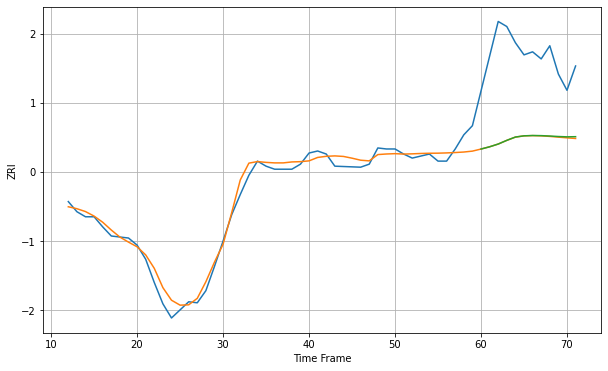

Wall time: 7.28 s
53704 8.151091848781538 84.47361465828286 84.19436661400229 [1074.93363829 1077.1596691  1079.87550877 1083.53024141 1086.79037891
 1087.98977005 1088.30733508 1088.17854772 1087.79132875 1087.30321079
 1086.99536826 1087.14491375]

Got an mse at 0.0098 in round 221 and stopped training

60 60 12


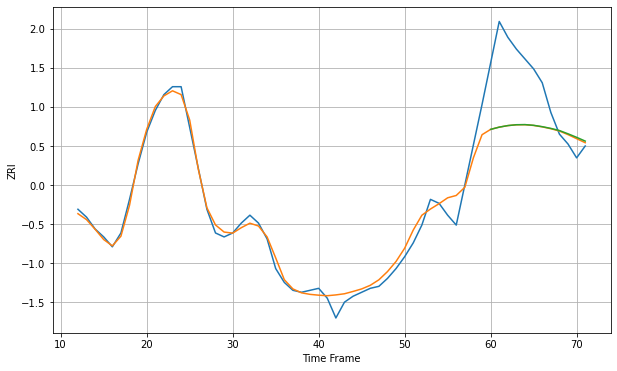

Wall time: 11.8 s
54220 4.6822482066767295 28.952112278814568 28.95723736843548 [655.40650676 656.54454526 657.3262666  657.76116451 657.82152795
 657.46731805 656.78197209 655.9066787  654.82002997 653.17097444
 651.39280497 649.48400617]
60 60 12


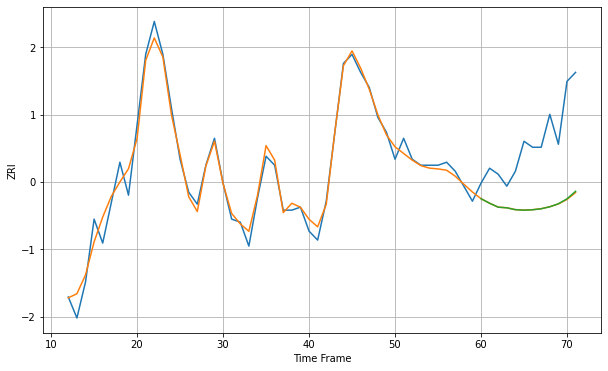

Wall time: 19.2 s
54601 3.4159665907732806 23.08672880294558 23.008772240658494 [827.8273807  826.30192799 824.99585877 824.78042861 824.15073243
 823.99316857 824.12151652 824.46100148 825.12790852 826.13305661
 827.77082448 830.28678054]

Got an mse at 0.0099 in round 117 and stopped training

60 60 12


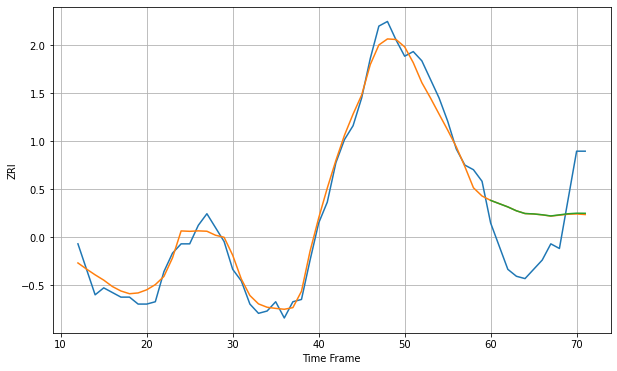

Wall time: 8.87 s
54901 4.827376261964751 21.54102140106033 21.462428582668995 [720.76180718 719.35409197 717.9467775  716.25915192 715.09210173
 714.91784256 714.55313823 714.0399597  714.51574499 714.9902443
 715.22780632 715.19204513]

Got an mse at 0.0098 in round 112 and stopped training

60 60 12


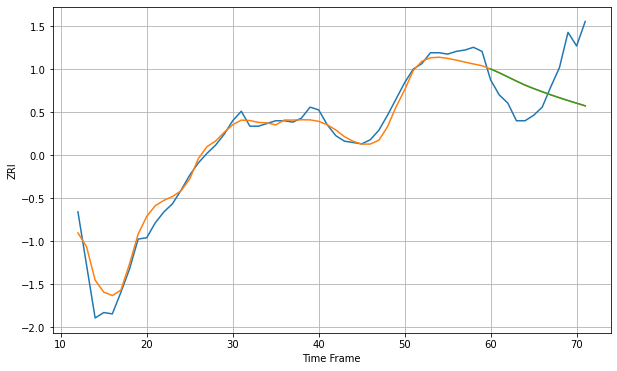

Wall time: 8.94 s
55101 8.01168861643793 30.842913056683784 30.827181546270634 [1324.07183144 1321.28399471 1318.23589462 1315.14253608 1312.22266041
 1309.6834084  1307.32318939 1305.05430489 1302.93083188 1300.86996379
 1298.92835474 1296.98847666]

Got an mse at 0.0099 in round 201 and stopped training

60 60 12


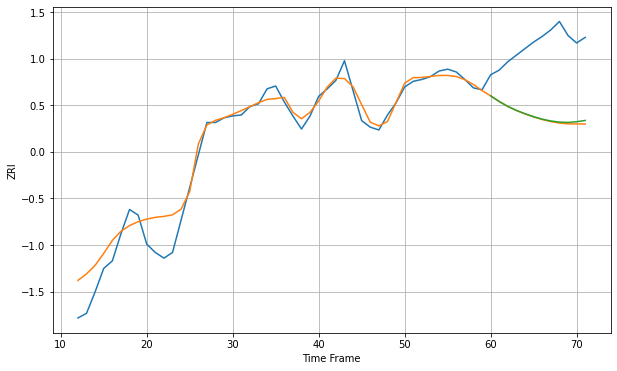

Wall time: 11.2 s
55104 16.31314547708449 77.99562659296292 76.9864916285151 [1295.45780988 1289.41838485 1284.17832519 1279.9194688  1276.33279376
 1273.21225678 1270.57380676 1268.60953986 1267.40815416 1267.06626948
 1267.81839742 1269.1922356 ]

Got an mse at 0.0097 in round 38 and stopped training

60 60 12


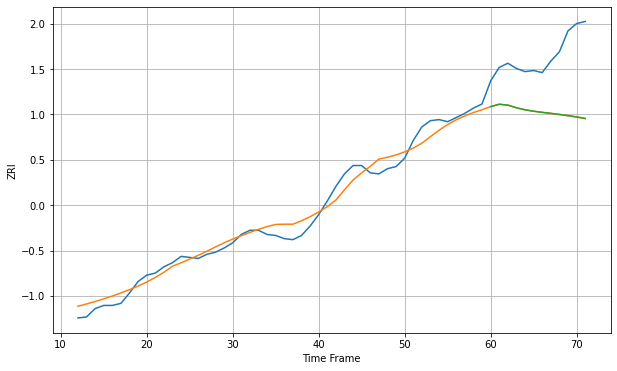

Wall time: 7.7 s
55106 8.608893928914139 56.62820151661543 56.69600882788492 [1088.42114424 1090.69816881 1089.86161602 1087.29135369 1085.38731968
 1084.01407411 1082.95175395 1081.95560509 1080.89024682 1079.73141288
 1078.46638973 1077.03041691]

Got an mse at 0.0100 in round 97 and stopped training

60 60 12


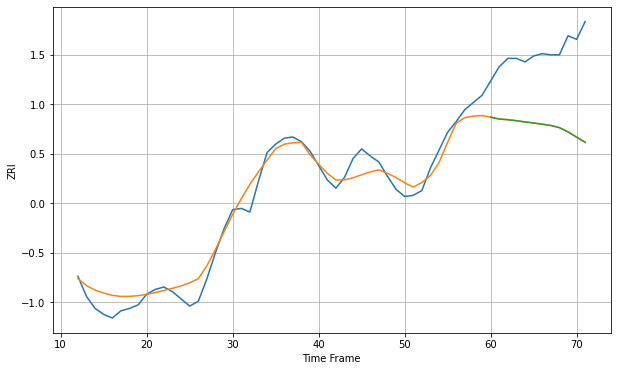

Wall time: 8.13 s
55306 10.39722122396106 63.37370887676585 63.469378296693925 [1281.61225394 1280.03889605 1279.44728325 1278.60490197 1277.5542782
 1276.67431061 1275.68061079 1274.61440302 1272.81314969 1269.20342672
 1264.81289453 1260.55055104]

Got an mse at 0.0099 in round 80 and stopped training

60 60 12


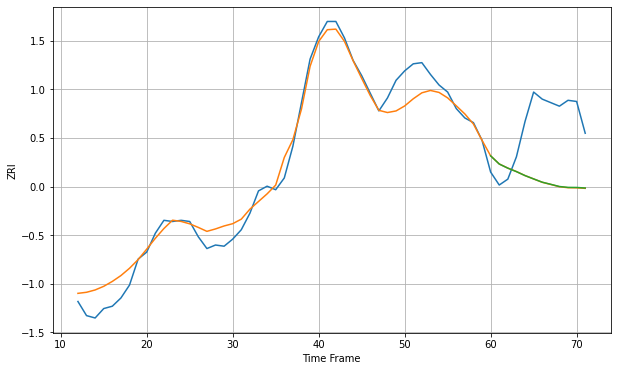

Wall time: 8.2 s
55401 12.646611189282043 54.72452446403134 54.5949966446854 [1642.79229431 1635.8378368  1632.32517063 1629.37762189 1626.0074381
 1623.17896005 1620.40243027 1618.58478755 1616.73398009 1615.98185779
 1615.92192589 1615.45996522]

Got an mse at 0.0098 in round 152 and stopped training

60 60 12


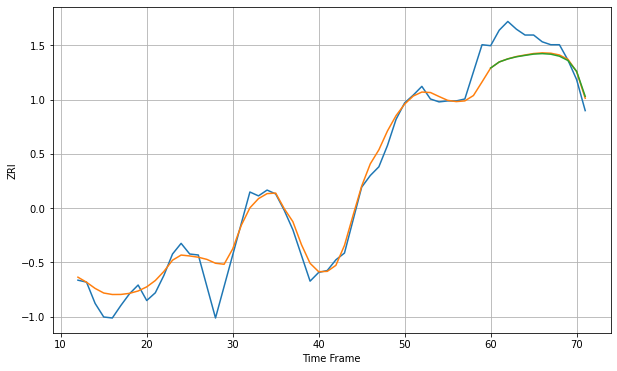

Wall time: 11.3 s
55403 14.827045371662566 20.871652338733472 21.241454131166098 [1316.93297255 1323.21851662 1326.33835763 1328.54885932 1329.991566
 1331.32456445 1331.80491229 1331.20675121 1329.16751307 1324.66320165
 1313.57087399 1287.72423404]

Got an mse at 0.0100 in round 193 and stopped training

60 60 12


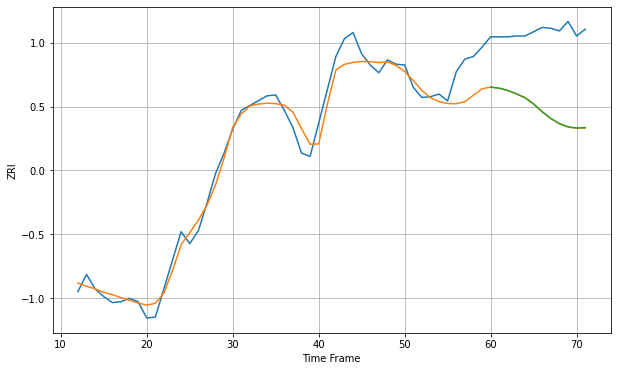

Wall time: 12.3 s
55404 18.009521984600383 91.70982067882018 91.61028980297267 [1302.2208767  1300.90006035 1298.26474828 1294.23614592 1289.8101327
 1282.38230039 1273.30714423 1265.44946671 1259.45064774 1255.69139196
 1254.31490428 1254.7701378 ]

Got an mse at 0.0097 in round 71 and stopped training

60 60 12


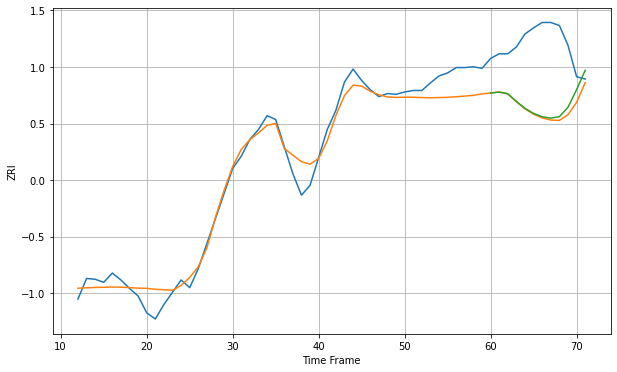

Wall time: 8.43 s
55407 18.662722822332437 87.35183921145382 84.89726725960057 [1337.72224234 1338.97260657 1336.71545677 1326.6593649  1317.62594691
 1310.94962191 1306.63688395 1304.79793583 1306.7172487  1319.12330856
 1342.14206424 1367.40017787]

Got an mse at 0.0099 in round 198 and stopped training

60 60 12


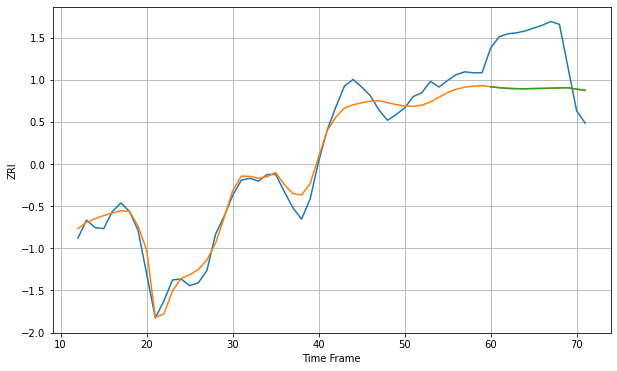

Wall time: 10.9 s
55408 12.3861460407739 54.0152005492714 54.01190606324759 [1505.2874549  1504.30403181 1503.60404085 1503.28533854 1503.2038917
 1503.41358679 1503.58567957 1503.84649029 1504.0699994  1504.26270565
 1502.9076903  1501.60882106]

Got an mse at 0.0100 in round 154 and stopped training

60 60 12


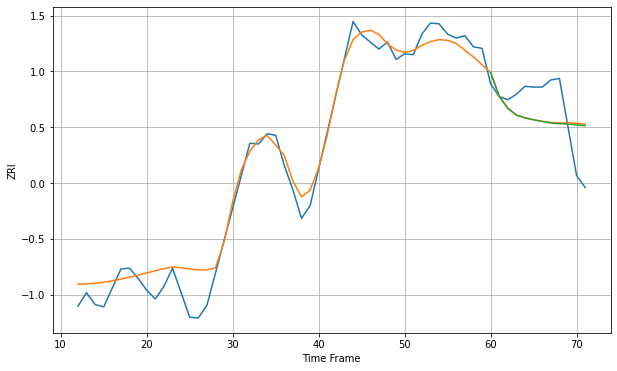

Wall time: 9.65 s
55411 20.909941742348458 43.88158861937146 43.486710662048495 [1556.4406941  1526.44923183 1511.18867105 1502.61326835 1499.036636
 1496.62011254 1494.52614698 1492.68931795 1491.72404888 1491.23433565
 1490.07448388 1489.24472634]

Got an mse at 0.0099 in round 74 and stopped training

60 60 12


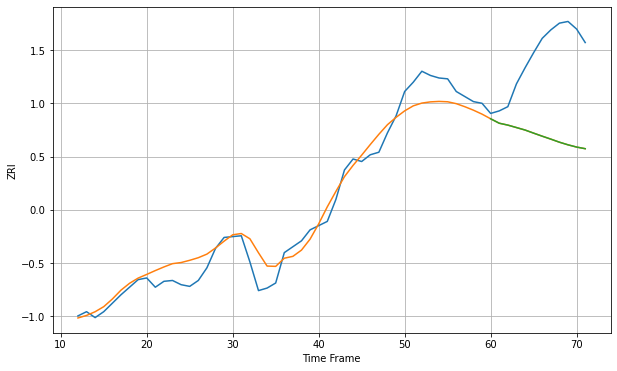

Wall time: 7.47 s
55413 17.859365321853844 101.99297072001173 101.98766019071368 [1502.65354698 1497.38742484 1495.15970392 1492.25367057 1489.33595105
 1485.63887795 1482.01486564 1478.54161028 1474.89638161 1471.78642507
 1469.1332265  1467.19939866]

Got an mse at 0.0100 in round 58 and stopped training

60 60 12


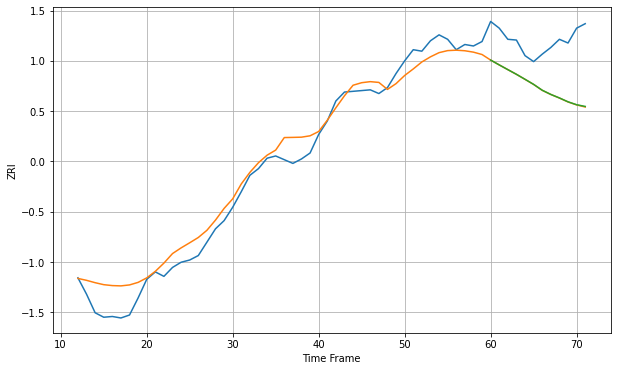

Wall time: 7.75 s
55414 20.483547979230597 66.49561664256447 66.2910672718346 [1547.04829089 1540.53269212 1534.19298218 1527.89348111 1521.17486054
 1514.35046074 1506.46782149 1500.81989305 1496.07868489 1490.87982978
 1486.97005323 1484.67178472]

Got an mse at 0.0099 in round 76 and stopped training

60 60 12


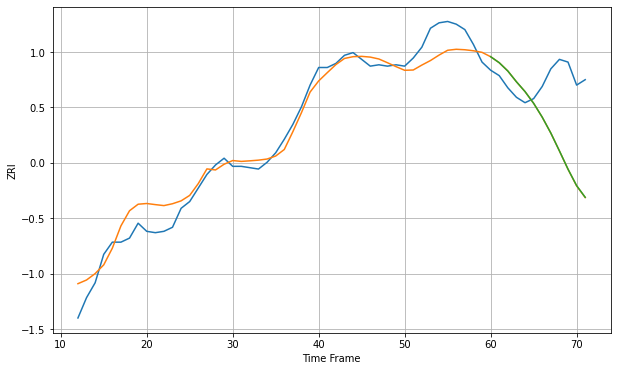

Wall time: 7.89 s
55416 11.413201512683198 47.679908929893394 47.604572758715776 [1534.97148383 1530.53318022 1524.41174945 1516.47125397 1509.21760606
 1500.5745531  1490.33110369 1478.60522183 1465.41645938 1451.924354
 1439.75764285 1431.1290381 ]

Got an mse at 0.0100 in round 27 and stopped training

60 60 12


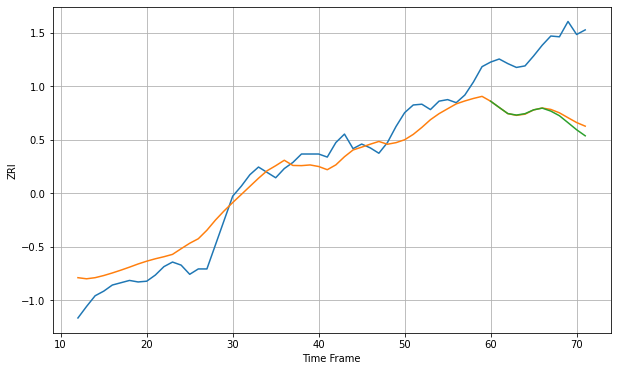

Wall time: 6.36 s
55418 23.232807122128076 88.61874803292403 92.438204154226 [1291.89605094 1283.7506509  1275.79653882 1273.82482374 1275.66588338
 1280.63358406 1282.92017321 1279.01069967 1272.97425923 1263.88866739
 1254.67162968 1246.77086154]

Got an mse at 0.0100 in round 334 and stopped training

60 60 12


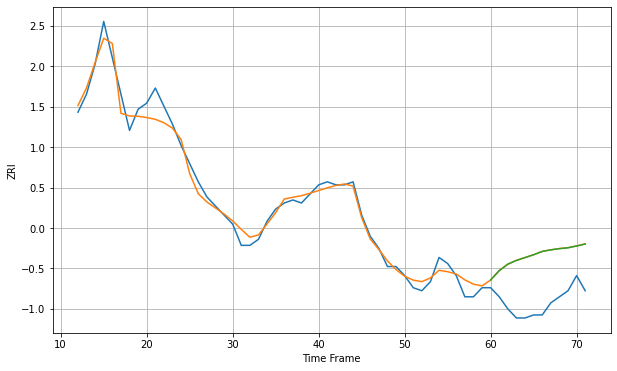

Wall time: 14.9 s
58103 3.1645144284108264 15.808782752866106 15.792304078160445 [717.55734817 720.64033834 722.79362838 724.02730247 724.96676552
 725.8993147  726.99126189 727.51525658 727.91799507 728.19828112
 728.7753253  729.42967216]

Got an mse at 0.0100 in round 252 and stopped training

60 60 12


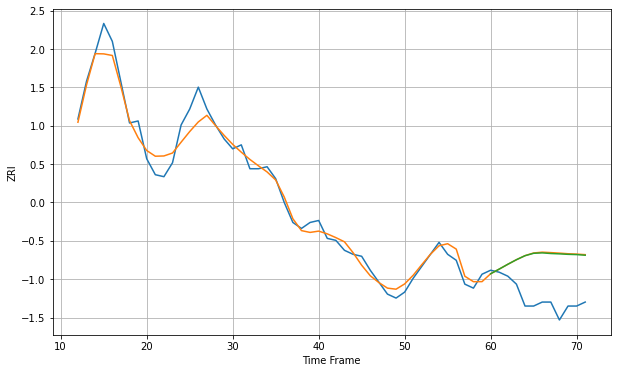

Wall time: 13.2 s
58104 5.490943368914544 22.10013373862858 21.875310517094256 [778.22773219 780.57173614 782.99006289 785.2828964  787.29487974
 788.51150176 788.71004322 788.40221611 788.22062171 787.98401775
 787.85540251 787.53641987]

Got an mse at 0.0098 in round 252 and stopped training

60 60 12


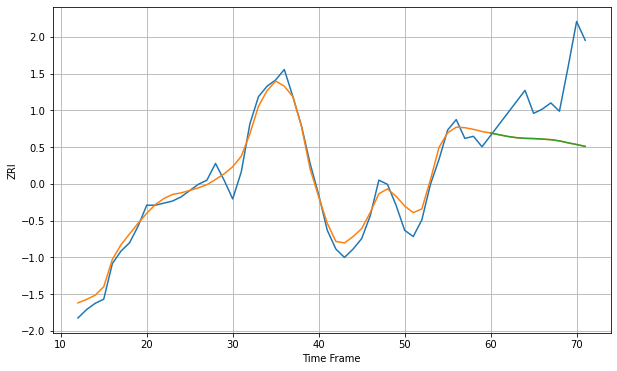

Wall time: 12.7 s
59601 5.240246485227747 27.689100532499975 27.695830072343544 [846.58318262 845.74314872 844.92258049 844.34923048 844.02770023
 843.91749505 843.67392177 843.38762107 842.81333813 841.88996155
 841.06362387 840.15584045]

Got an mse at 0.0100 in round 47 and stopped training

60 60 12


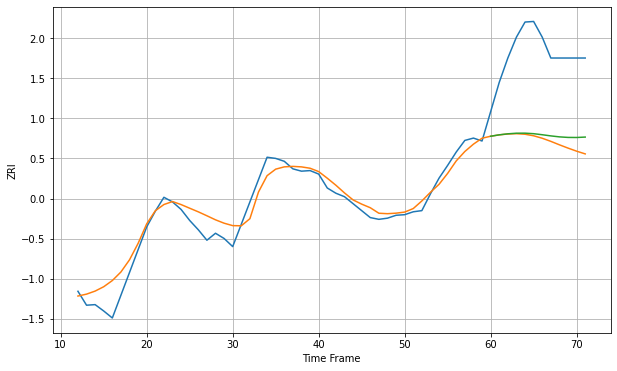

Wall time: 8.48 s
59718 20.633173325386103 153.1702397448525 144.14502598705877 [1472.18674815 1474.62379721 1476.37368135 1477.41546503 1477.48922366
 1476.59029295 1474.79398379 1472.79177475 1471.11507212 1470.16821135
 1470.04696557 1470.76076174]

Got an mse at 0.0100 in round 81 and stopped training

60 60 12


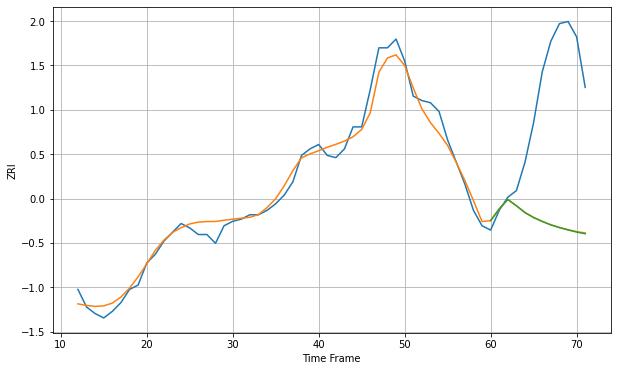

Wall time: 8.63 s
59801 4.585254316098501 60.50923806043983 60.59908973471853 [827.3318141  832.65104614 836.96125869 834.08055399 830.99265228
 828.73245414 826.97203108 825.38650935 824.13689521 823.07659842
 822.10559608 821.35026231]

Got an mse at 0.0099 in round 104 and stopped training

60 60 12


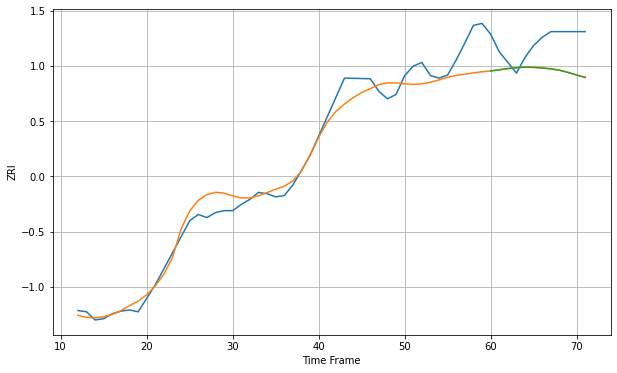

Wall time: 8.72 s
59901 24.1064521759565 49.83572266940935 49.87239122898625 [1125.46614151 1127.27917317 1129.1555687  1130.60929109 1131.45837128
 1131.1385891  1130.17554043 1128.75525562 1126.59090085 1123.05055961
 1118.92747509 1115.10428728]

Got an mse at 0.0100 in round 124 and stopped training

60 60 12


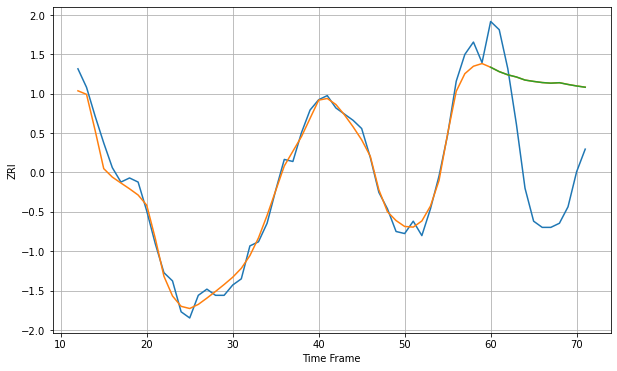

Wall time: 9.55 s
60085 4.843616330201862 49.58456195773806 49.58015382940428 [1184.75778289 1182.63588763 1181.08794561 1180.03735057 1178.54787084
 1177.89144341 1177.33303057 1177.03990611 1177.2545828  1176.40430807
 1175.66475663 1175.05536022]

Got an mse at 0.0099 in round 112 and stopped training

60 60 12


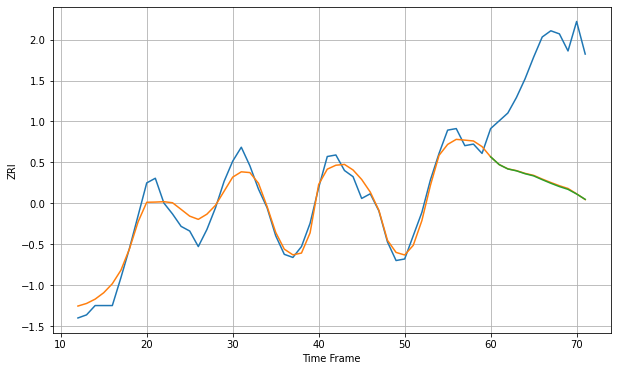

Wall time: 8.79 s
60201 7.3409222386984 76.69163021348884 76.95253350168491 [1534.80010735 1529.77758692 1527.00105476 1525.77919411 1523.93110496
 1522.52997689 1520.09052123 1517.77449987 1515.63892422 1513.85249399
 1510.86091601 1507.40465234]

Got an mse at 0.0097 in round 146 and stopped training

60 60 12


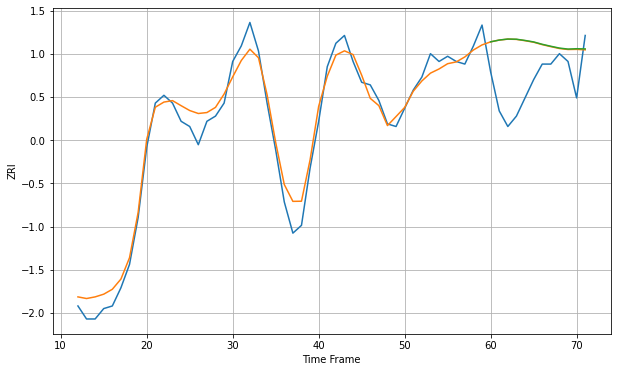

Wall time: 10.7 s
60202 5.214228932207352 18.412349609999914 18.47183734710279 [1593.55091734 1594.24079102 1594.62775902 1594.55490145 1594.08330056
 1593.51563583 1592.60779555 1591.85155867 1591.15437879 1590.76516556
 1590.90603522 1590.83105797]

Got an mse at 0.0100 in round 173 and stopped training

60 60 12


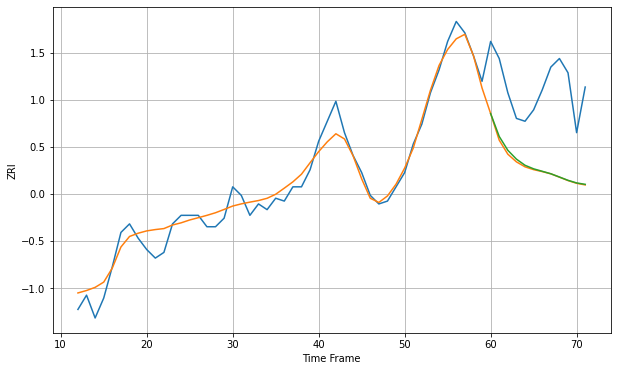

Wall time: 10.8 s
60402 4.377412528925502 28.477283367844635 28.145324622492204 [1281.69628295 1273.66468739 1268.8113762  1265.71381241 1263.55600558
 1262.30892441 1261.45513685 1260.58807595 1259.43783602 1258.28248887
 1257.36703069 1256.87238794]

Got an mse at 0.0097 in round 36 and stopped training

60 60 12


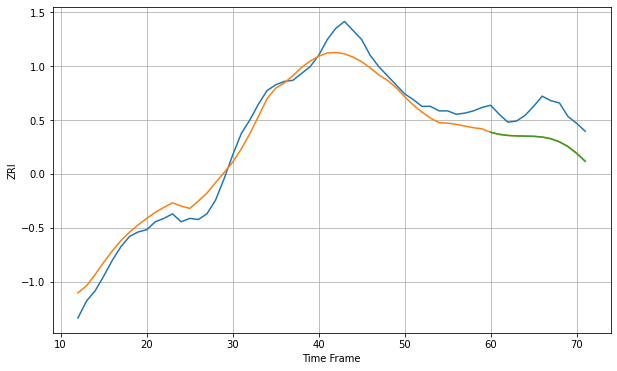

Wall time: 7.42 s
60540 12.096309646609459 25.66374096228121 25.793186057116518 [1620.12551291 1618.25391024 1617.27547757 1616.88375521 1616.67670666
 1616.49401341 1615.7992566  1614.33728796 1611.54719243 1607.35040455
 1601.46323627 1594.43560465]

Got an mse at 0.0099 in round 94 and stopped training

60 60 12


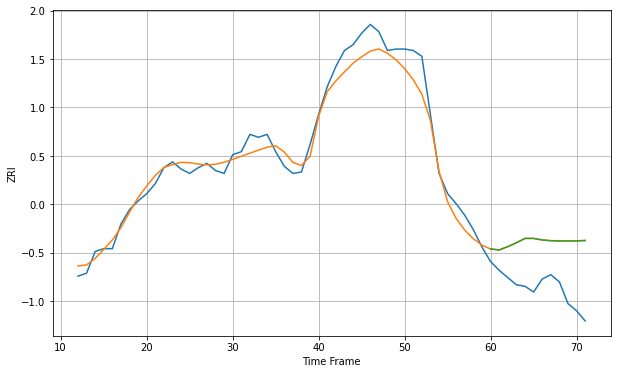

Wall time: 8.12 s
60563 8.97973322466771 33.4835503295528 33.46831298549048 [1371.76783315 1371.09754853 1373.42580288 1376.08472257 1379.07316017
 1379.08655237 1378.00194392 1377.53270088 1377.34119414 1377.30222619
 1377.35374004 1377.60939013]

Got an mse at 0.0099 in round 111 and stopped training

60 60 12


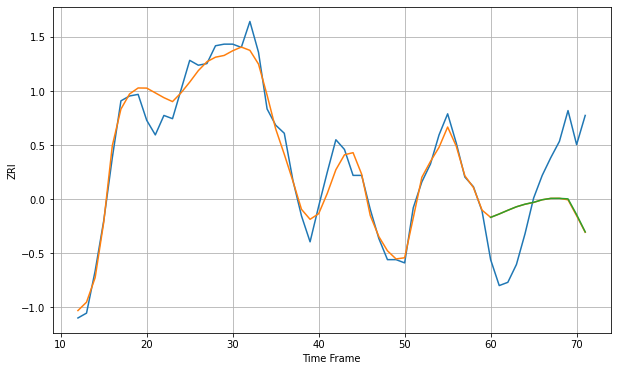

Wall time: 9.32 s
60601 8.661270585744536 39.231863699282755 39.07346492436183 [2084.09061979 2086.18625928 2088.46739477 2090.62859448 2092.23560033
 2093.37909001 2094.97428219 2095.80552445 2095.82354227 2095.50746901
 2085.79481942 2075.11474965]

Got an mse at 0.0098 in round 121 and stopped training

60 60 12


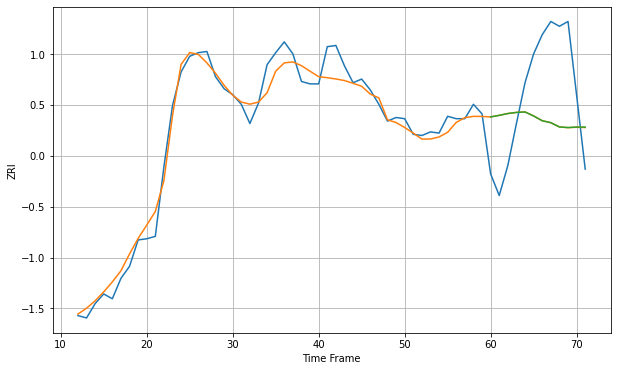

Wall time: 8.84 s
60605 10.35720460161426 58.420290655355096 58.43024784478943 [2035.49253516 2036.79584993 2038.30446045 2039.22741038 2039.60537287
 2036.262624   2032.2838308  2030.68436191 2027.13486435 2026.62452789
 2027.04960101 2026.9868573 ]

Got an mse at 0.0098 in round 215 and stopped training

60 60 12


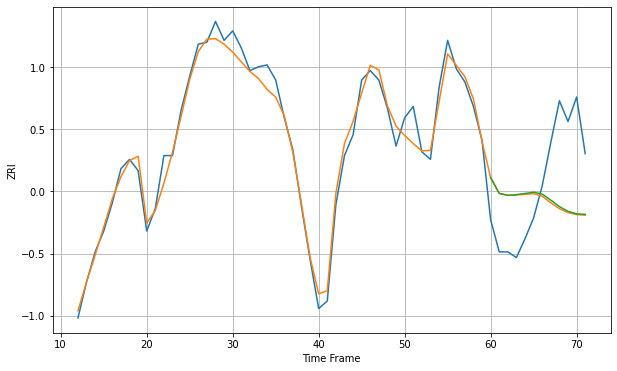

Wall time: 11.6 s
60606 6.425433840175094 36.214833747991314 35.863602073601015 [2187.31461004 2178.92414147 2177.96156775 2178.32152225 2178.91232702
 2179.60797981 2178.57716446 2175.40844245 2171.98918956 2169.43228017
 2168.13183454 2167.87272823]

Got an mse at 0.0099 in round 57 and stopped training

60 60 12


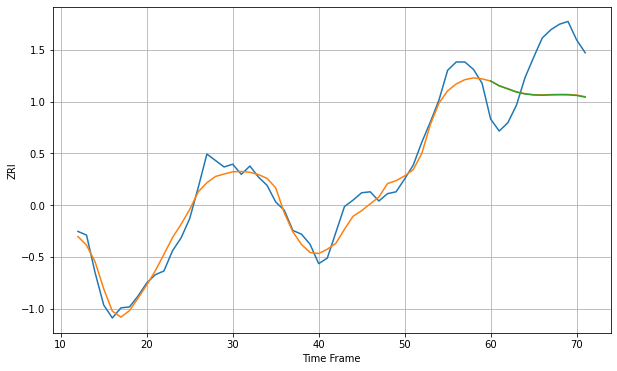

Wall time: 7.71 s
60607 12.501405635801358 53.50894305297965 53.773621067958636 [2015.36095894 2010.09385182 2006.78741601 2003.34739151 2001.26112346
 2000.18026359 1999.91133975 2000.23870282 2000.40474452 2000.32791966
 1999.64525276 1997.84524479]

Got an mse at 0.0097 in round 172 and stopped training

60 60 12


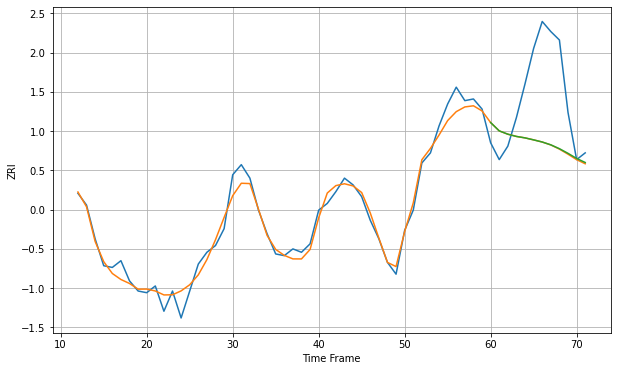

Wall time: 11 s
60608 5.654334734852428 39.884905526041045 39.80567653411841 [1519.99241459 1515.05203057 1513.08812411 1511.75579975 1510.89403775
 1509.71038062 1508.44611909 1506.76900409 1504.48367598 1501.72836464
 1498.70783567 1496.29476842]

Got an mse at 0.0099 in round 187 and stopped training

60 60 12


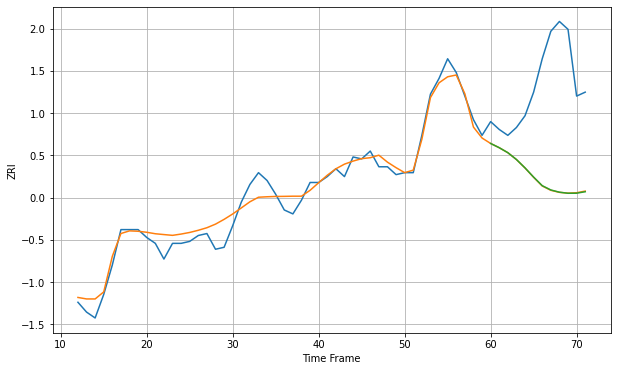

Wall time: 11.8 s
60609 5.633643668605139 52.75125318953055 52.745225504415444 [1281.86618469 1279.71339836 1277.18293481 1273.70377233 1269.42675493
 1264.7365126  1260.38350428 1258.19647586 1257.05158884 1256.50881126
 1256.54053376 1257.28724081]

Got an mse at 0.0099 in round 274 and stopped training

60 60 12


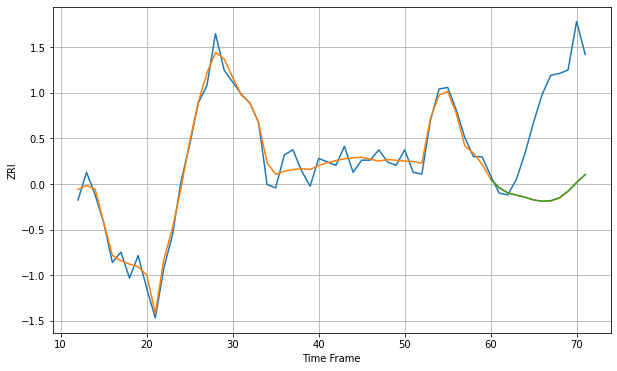

Wall time: 12.7 s
60610 5.632654299208492 54.249695291183286 54.19613477329925 [1917.17913849 1912.13687221 1909.14699118 1907.84688461 1906.64837077
 1905.08534261 1904.35039495 1904.63655057 1906.35704293 1910.1157797
 1915.12278839 1919.65640961]

Got an mse at 0.0095 in round 163 and stopped training

60 60 12


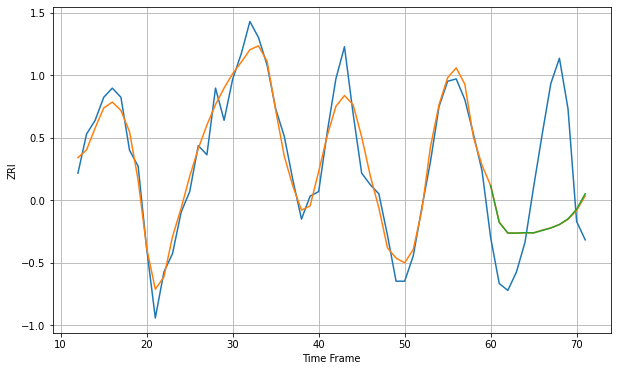

Wall time: 9.95 s
60611 7.3473430507006485 36.72507023077514 36.75048484136766 [2161.60154177 2145.58030648 2140.94102995 2140.92215799 2141.09333844
 2141.0249597  2142.07623678 2143.13347036 2144.66573665 2147.109984
 2151.319395   2158.04658246]

Got an mse at 0.0096 in round 115 and stopped training

60 60 12


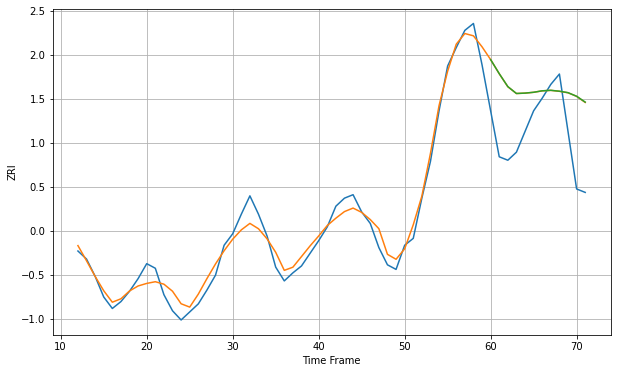

Wall time: 9.24 s
60612 9.390856277671892 49.42626931149457 49.51379324320789 [1699.54262491 1687.33028195 1676.06610777 1670.08046383 1670.4004206
 1671.12292073 1672.4043982  1672.84451032 1672.05020415 1670.78583003
 1667.65668361 1662.58996251]

Got an mse at 0.0099 in round 130 and stopped training

60 60 12


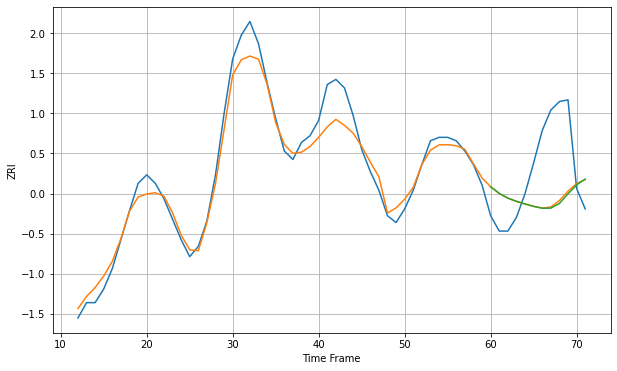

Wall time: 9.18 s
60613 8.706720665244687 33.89650481141204 34.45917777569019 [1705.01897611 1701.11078653 1698.34296566 1696.45371744 1694.90290324
 1693.50520775 1692.39022378 1692.44754153 1695.20200852 1700.84785388
 1706.1172338  1709.47643571]

Got an mse at 0.0098 in round 162 and stopped training

60 60 12


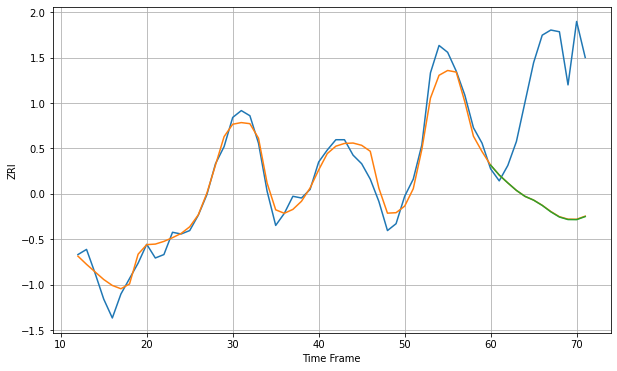

Wall time: 10.5 s
60614 7.2151924539162495 76.99517465522709 77.11949045751814 [1874.17137226 1868.4027981  1863.80010439 1859.42412829 1855.94336604
 1853.75130729 1850.6693689  1846.94057241 1843.89847734 1842.42854292
 1842.38016522 1844.16435949]

Got an mse at 0.0098 in round 34 and stopped training

60 60 12


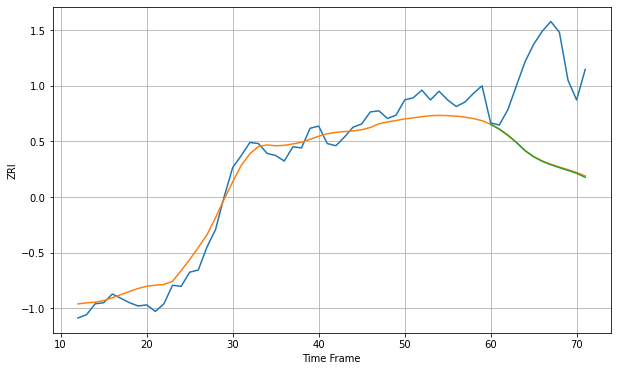

Wall time: 6.56 s
60615 13.288010374241798 85.52672703418287 85.91342207208403 [1502.69235781 1498.31232064 1492.6363543  1486.02535559 1478.52225593
 1472.90127558 1468.74651645 1465.55831904 1462.90458381 1460.38024237
 1457.68137056 1454.07029025]

Got an mse at 0.0099 in round 178 and stopped training

60 60 12


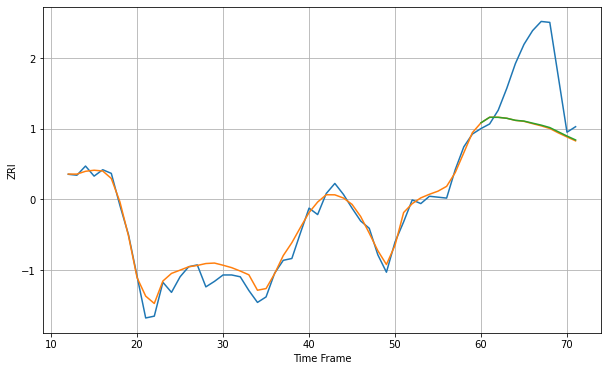

Wall time: 10.6 s
60616 9.721668152756042 66.4063219588285 65.92173522120704 [1669.27639967 1675.29584974 1675.23608037 1674.19033293 1671.98749396
 1671.14904347 1668.88852596 1666.7239375  1664.06382241 1659.41840169
 1654.81101365 1650.53082372]

Got an mse at 0.0099 in round 169 and stopped training

60 60 12


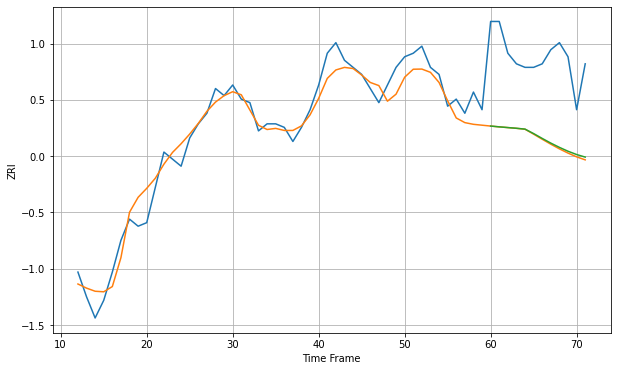

Wall time: 10.5 s
60617 4.264906622941791 24.076022392021713 23.81683982167871 [1135.36677249 1135.14387421 1134.94254323 1134.74446848 1134.50377675
 1133.2402205  1131.86420132 1130.54010946 1129.33066871 1128.23633334
 1127.30565472 1126.5784075 ]

Got an mse at 0.0098 in round 125 and stopped training

60 60 12


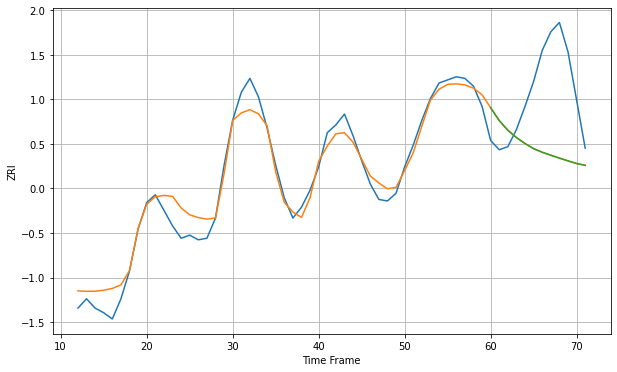

Wall time: 9.71 s
60618 8.908619537815847 48.60993799716474 48.614946316694486 [1636.06581104 1627.80788797 1621.56287245 1616.8452078  1613.02712941
 1609.72766655 1607.39422978 1605.46175621 1603.63298416 1601.83850133
 1600.13496017 1598.95104751]

Got an mse at 0.0098 in round 148 and stopped training

60 60 12


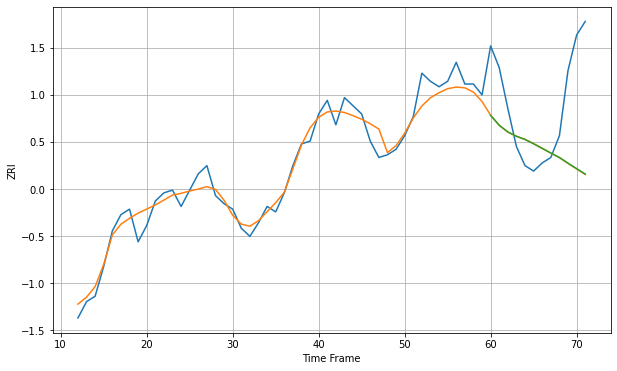

Wall time: 9.28 s
60619 4.454292960420553 26.196660737563125 26.127175486226758 [1115.49066304 1111.83966436 1109.37469322 1107.77743136 1106.61957841
 1105.03445472 1103.33836768 1101.60795393 1099.99007324 1097.90517657
 1095.91516379 1093.92725   ]

Got an mse at 0.0098 in round 119 and stopped training

60 60 12


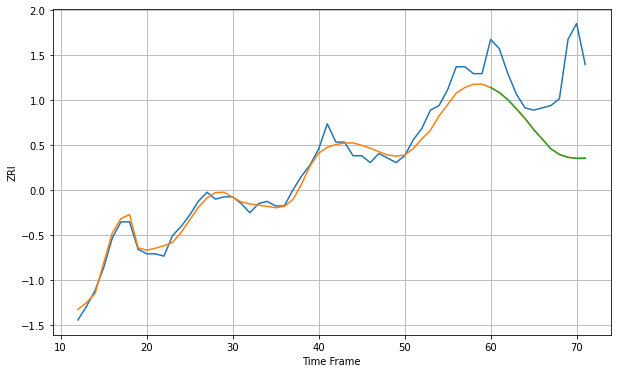

Wall time: 10.7 s
60620 4.143919173051401 28.94536484629476 29.000062672405676 [1154.93101202 1152.75743198 1149.57032153 1145.53830881 1141.33180278
 1136.48997127 1132.34843374 1128.05023726 1125.53302099 1124.29795575
 1123.83256257 1123.85048698]

Got an mse at 0.0100 in round 219 and stopped training

60 60 12


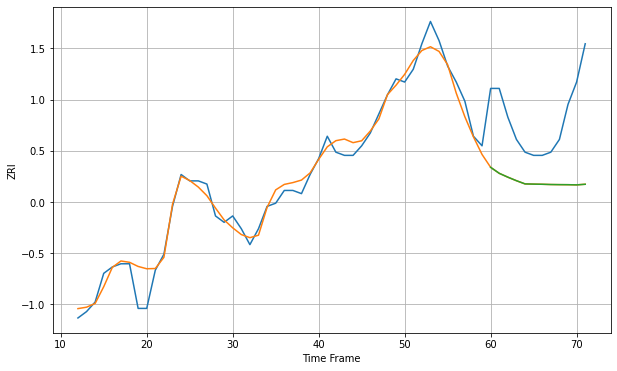

Wall time: 11.8 s
60621 3.724205307528111 22.410331026805007 22.410491919432314 [1158.25026386 1156.37440015 1155.16698578 1154.05819248 1153.05145675
 1152.98406718 1152.93521452 1152.85752131 1152.82480376 1152.8075616
 1152.75024249 1152.92989453]

Got an mse at 0.0097 in round 237 and stopped training

60 60 12


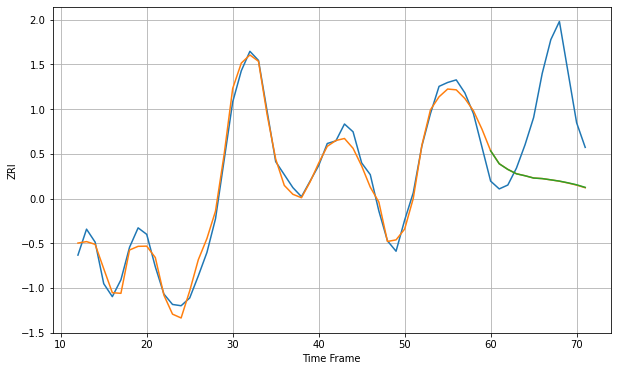

Wall time: 12.1 s
60622 7.19842070478996 63.104737272850535 63.046004460469085 [1798.37306154 1788.37029321 1784.01428031 1780.66390285 1779.14610492
 1777.38312912 1776.94896728 1776.00161539 1775.0158719  1773.69569845
 1772.17805908 1770.19396815]

Got an mse at 0.0098 in round 95 and stopped training

60 60 12


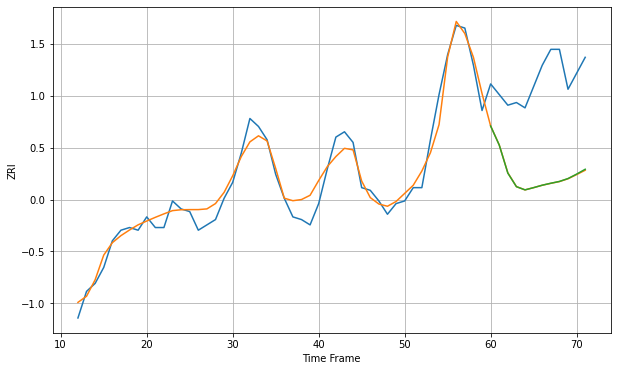

Wall time: 9.5 s
60623 4.658940845604128 36.60792270895254 36.545381650798454 [1288.17149021 1281.01415204 1270.4700987  1265.36408814 1264.1647387
 1265.00537433 1265.9199035  1266.65834246 1267.3352554  1268.42627013
 1270.08801706 1271.91478921]

Got an mse at 0.0100 in round 99 and stopped training

60 60 12


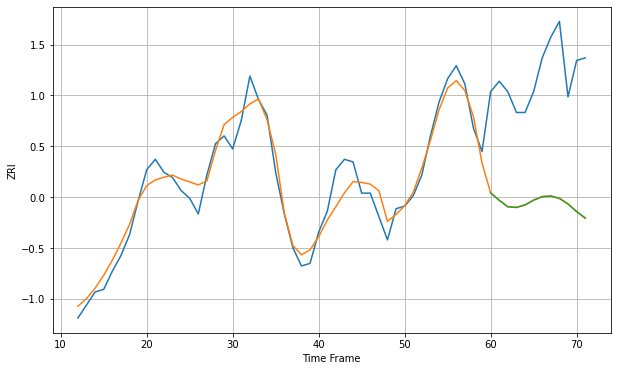

Wall time: 8.58 s
60624 5.662722651117046 49.93554842080002 49.99050844447532 [1327.08693653 1324.23699358 1321.72282299 1321.48660081 1322.43200432
 1324.29001016 1325.62472938 1325.84552116 1324.94725565 1322.79148194
 1319.90867395 1317.44579849]

Got an mse at 0.0099 in round 160 and stopped training

60 60 12


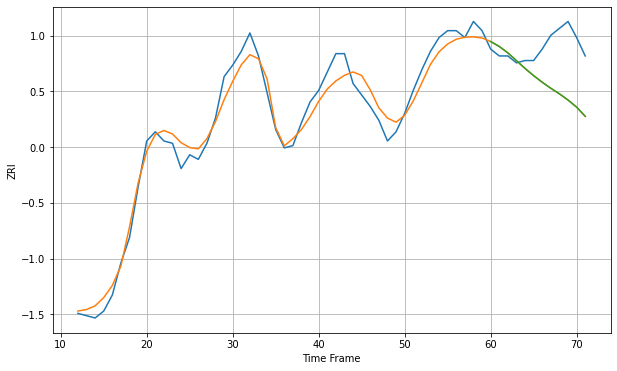

Wall time: 11.1 s
60625 5.661088507105893 19.17992059204741 19.169982675168082 [1549.2789015  1547.12903181 1544.34679513 1540.95217447 1537.58479229
 1534.4300825  1531.55412384 1528.93476905 1526.51235769 1523.8195271
 1520.74348855 1516.76041953]

Got an mse at 0.0098 in round 58 and stopped training

60 60 12


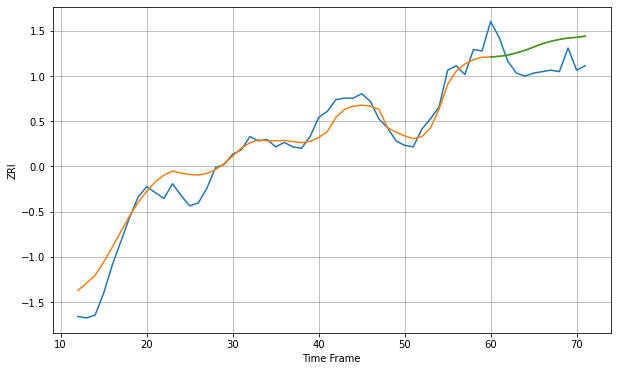

Wall time: 7.78 s
60626 10.175631499733058 17.6129842315322 17.59176556923372 [1366.94187904 1367.36491537 1368.18898991 1369.65216187 1371.46233168
 1373.65231096 1375.91641749 1377.54854381 1378.82155027 1379.82018426
 1380.23796931 1380.93838279]

Got an mse at 0.0099 in round 174 and stopped training

60 60 12


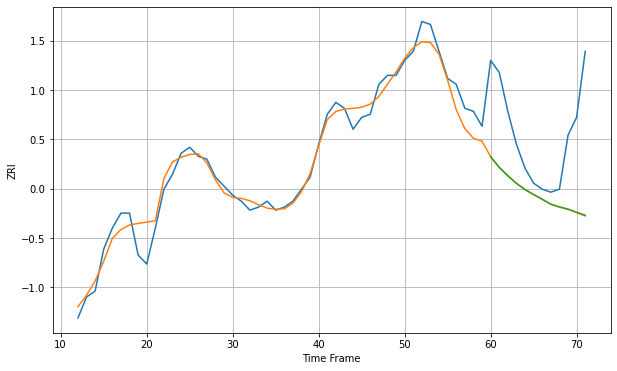

Wall time: 10.4 s
60628 4.328499872867423 24.89736615670305 24.844874763553012 [1169.83533237 1166.28700601 1163.45759065 1160.93738405 1158.87948712
 1157.19859286 1155.64270509 1154.00881879 1153.07073156 1152.33633885
 1151.29940041 1150.30546023]

Got an mse at 0.0100 in round 258 and stopped training

60 60 12


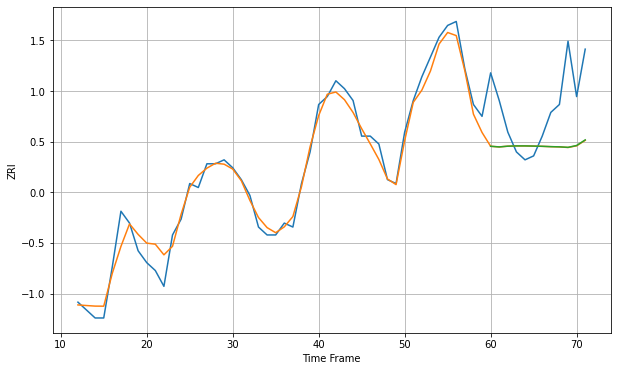

Wall time: 13.2 s
60629 2.9627893282210986 13.300065968296236 13.269302789988556 [1211.42864902 1211.26797059 1211.45439963 1211.52255299 1211.52396185
 1211.47933711 1211.42211569 1211.33739573 1211.28818146 1211.15841448
 1211.62902381 1213.04436288]

Got an mse at 0.0098 in round 138 and stopped training

60 60 12


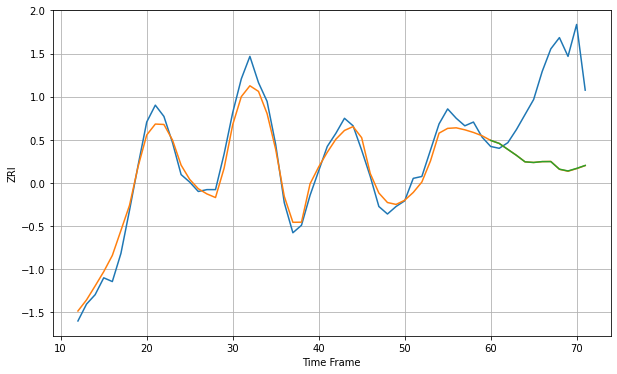

Wall time: 10.2 s
60630 5.987985367447331 44.79191477260556 44.75397893019546 [1514.23510283 1512.60594367 1509.42129577 1506.27170847 1502.79617244
 1502.46342569 1502.93136858 1502.9294221  1498.87883373 1497.94136461
 1499.29866924 1500.88439001]

Got an mse at 0.0095 in round 240 and stopped training

60 60 12


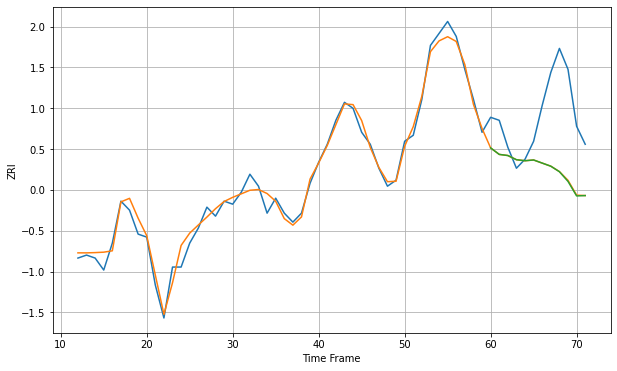

Wall time: 13.2 s
60632 2.827120490489813 21.460800968099075 21.545815210851842 [1313.78001593 1311.61464023 1311.24199194 1309.84221013 1309.50276791
 1309.7522468  1308.70882905 1307.67288375 1305.83013531 1302.59672392
 1297.74583648 1297.87199693]

Got an mse at 0.0099 in round 197 and stopped training

60 60 12


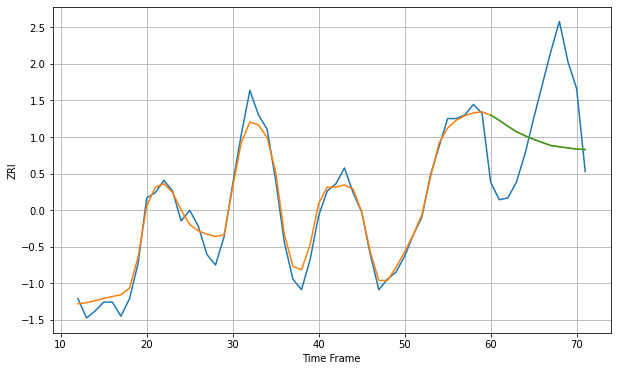

Wall time: 13.5 s
60634 6.1606414293492975 39.605050709602395 39.59690939064189 [1584.96389048 1581.99479828 1578.64405081 1575.56083579 1573.25010189
 1571.2395909  1569.44829632 1567.7228278  1567.00048218 1566.35584448
 1565.66992022 1565.42383449]

Got an mse at 0.0100 in round 183 and stopped training

60 60 12


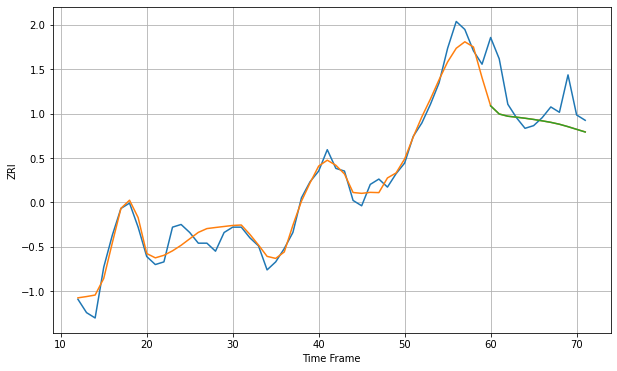

Wall time: 11.5 s
60636 3.995342233809639 11.541866578688635 11.545657913244456 [1184.41146395 1181.3486071  1180.52681147 1180.1709685  1179.77278291
 1179.32214121 1178.79621569 1178.23247152 1177.52277477 1176.6148049
 1175.61915028 1174.61706066]

Got an mse at 0.0099 in round 128 and stopped training

60 60 12


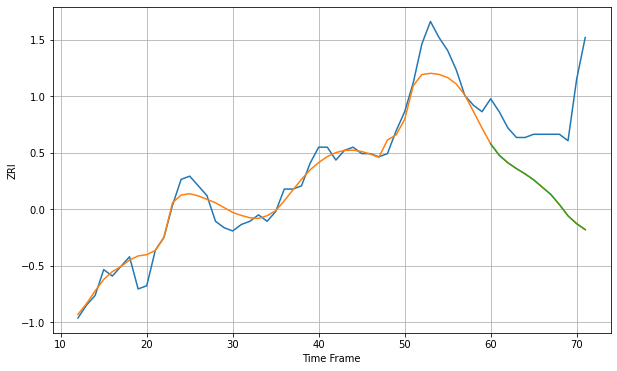

Wall time: 9.06 s
60637 4.74437936373913 25.972207961649502 25.995620271890683 [1200.03757213 1196.49379829 1194.1621094  1192.34645136 1190.71688438
 1188.88393454 1186.59704054 1184.33240884 1181.17722793 1177.69119121
 1175.2520944  1173.37422969]

Got an mse at 0.0097 in round 142 and stopped training

60 60 12


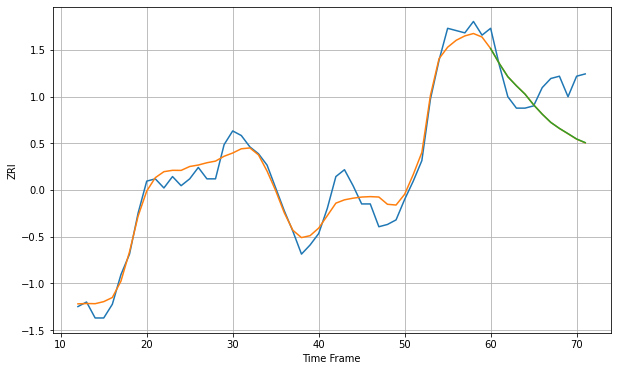

Wall time: 10.2 s
60639 5.43885304567261 16.476390813369267 16.449213796117235 [1377.11600576 1370.61390767 1364.77626928 1360.79542184 1357.13498824
 1352.44567899 1348.35632912 1344.74008918 1342.11232191 1339.81800975
 1337.46834426 1335.89030796]

Got an mse at 0.0099 in round 101 and stopped training

60 60 12


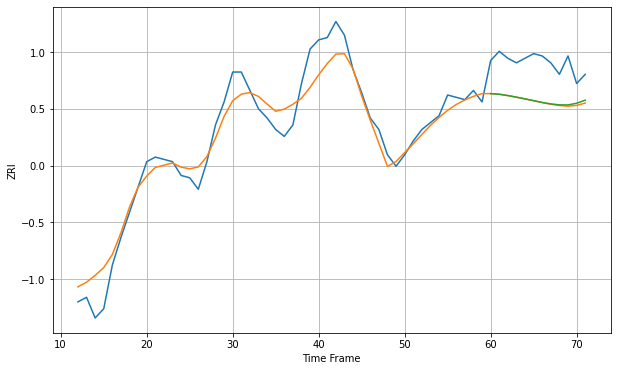

Wall time: 8.83 s
60640 7.5553203370113255 16.885248548995648 16.660950739731643 [1489.60851149 1489.33645742 1488.76475667 1488.0686901  1487.32414708
 1486.55241979 1485.77253758 1485.13111817 1484.72622408 1484.69482118
 1485.41993918 1486.75857002]

Got an mse at 0.0100 in round 183 and stopped training

60 60 12


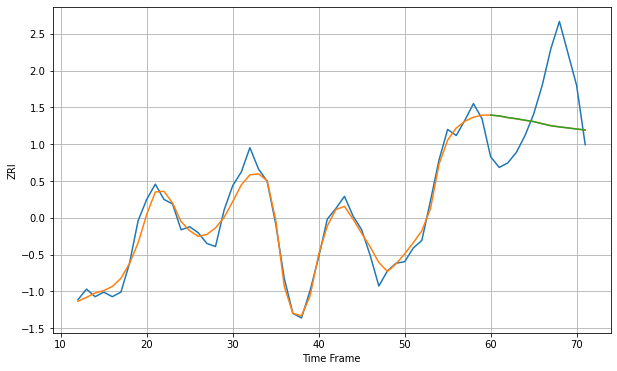

Wall time: 10.6 s
60641 6.3903883438129965 34.99403845577321 35.03173539266192 [1560.45085916 1559.87666481 1558.81960082 1558.03345762 1557.04511587
 1556.15527686 1554.7521955  1553.43871898 1552.63532523 1551.97305658
 1551.26418205 1550.57564064]

Got an mse at 0.0100 in round 323 and stopped training

60 60 12


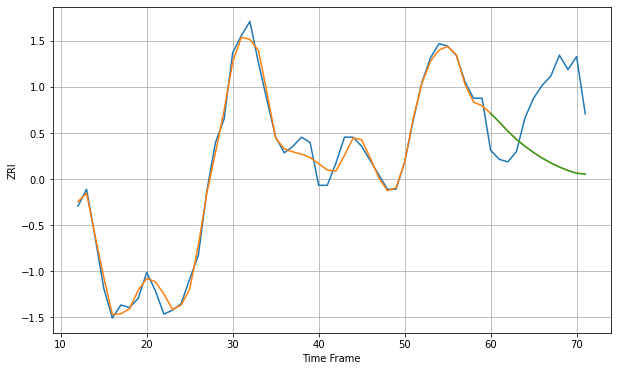

Wall time: 14.5 s
60642 6.7546631151103655 54.51146205019119 54.55916231093546 [1972.35033171 1965.67963677 1958.62099975 1952.33543472 1946.98890987
 1942.17585558 1937.934066   1934.23119565 1931.05544794 1928.34697807
 1926.31391018 1925.59095376]

Got an mse at 0.0099 in round 183 and stopped training

60 60 12


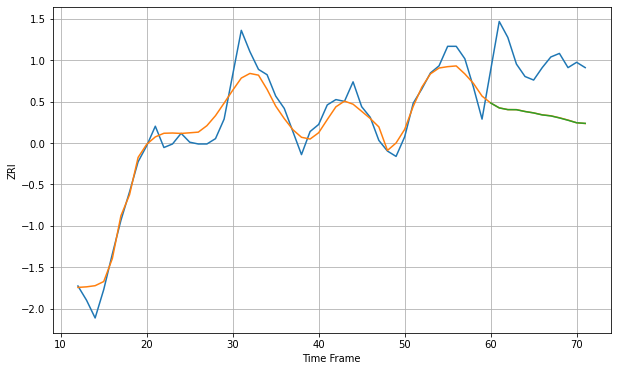

Wall time: 10.7 s
60644 8.055216252870046 31.4711850493175 31.500047488830624 [1244.10660238 1241.32021787 1240.34283971 1240.30628321 1239.27647381
 1238.48649289 1237.36862261 1236.80754173 1235.67372937 1234.35923325
 1232.94729008 1232.61005178]

Got an mse at 0.0099 in round 70 and stopped training

60 60 12


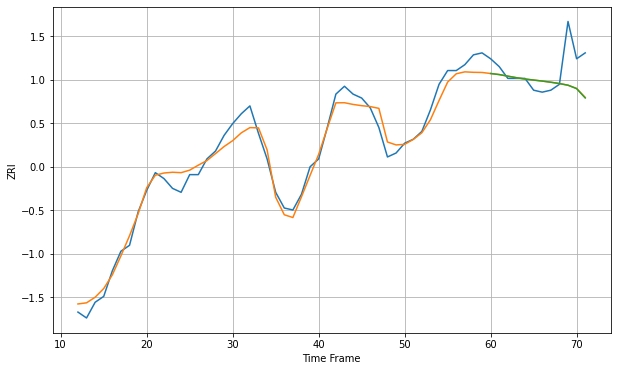

Wall time: 7.37 s
60645 5.368108510003816 12.730964964017446 12.785000858066388 [1491.49065762 1490.95922401 1490.14191858 1489.35530775 1488.68501181
 1488.15988468 1487.64956293 1487.05482567 1486.37504504 1485.53910733
 1483.8015502  1479.03479241]

Got an mse at 0.0099 in round 129 and stopped training

60 60 12


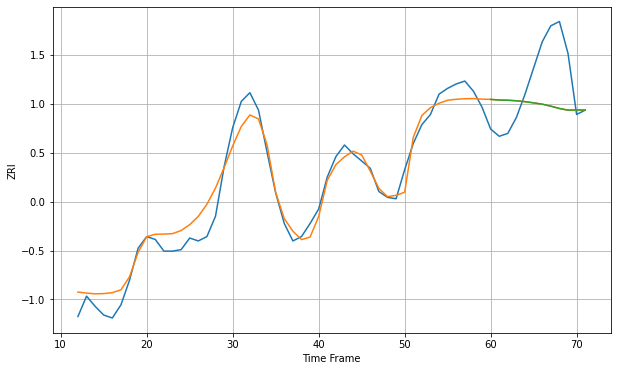

Wall time: 8.98 s
60647 9.702334423432859 32.02312438955104 32.01619067522756 [1631.39178844 1630.9310962  1630.80356284 1630.42894777 1629.8234631
 1628.99073612 1628.10380125 1626.72353202 1625.15220685 1623.98642065
 1624.13026338 1624.0182269 ]

Got an mse at 0.0100 in round 152 and stopped training

60 60 12


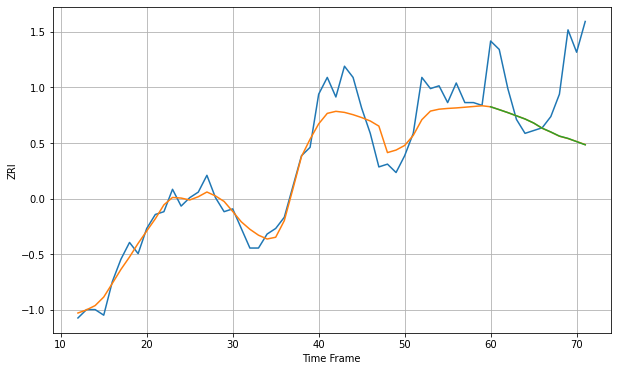

Wall time: 9.92 s
60649 6.15968031965109 22.074425404949963 22.080927127336327 [1097.49597441 1096.46930832 1095.41664084 1094.27467963 1093.13846572
 1091.70878995 1089.83947065 1088.48890675 1087.01551551 1086.19553155
 1085.04412447 1083.9107663 ]

Got an mse at 0.0099 in round 105 and stopped training

60 60 12


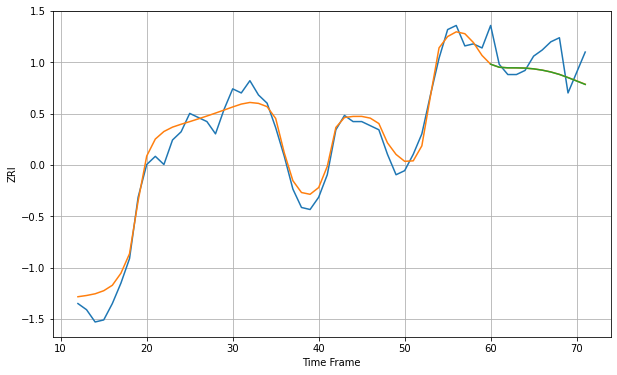

Wall time: 8.4 s
60651 6.2169710742185575 10.720389722452882 10.738177787681717 [1356.05030461 1354.564234   1354.28601869 1354.26853614 1354.15335415
 1353.78154107 1353.1504984  1352.25076244 1351.04906371 1349.49760419
 1347.8513432  1346.16162141]

Got an mse at 0.0099 in round 118 and stopped training

60 60 12


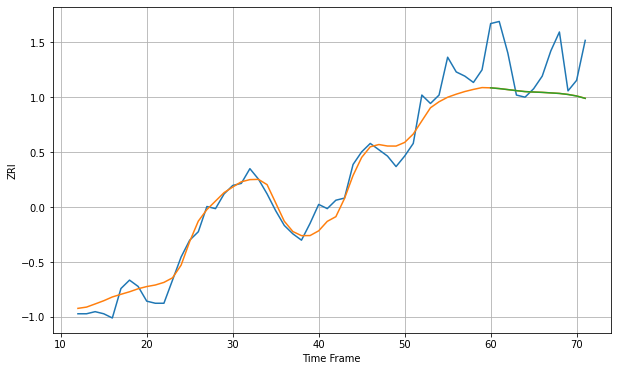

Wall time: 10.5 s
60653 6.200380496715685 19.139623961915145 19.151591153085892 [1420.43867289 1420.08585608 1419.59854916 1419.10528283 1418.65162333
 1418.4443429  1418.27895446 1418.02557312 1417.76602974 1417.276537
 1416.5439516  1415.42428836]
60 60 12


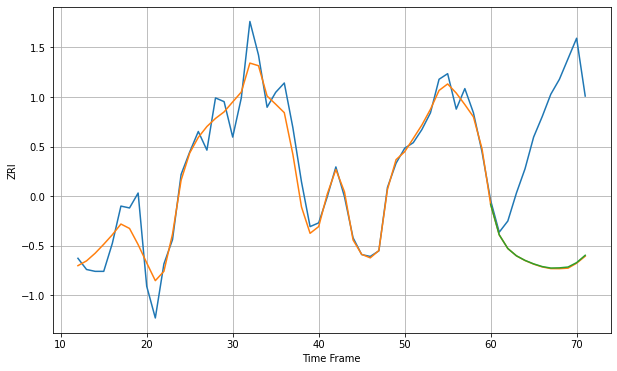

Wall time: 18.9 s
60654 9.288465924345523 75.56131426029717 75.28978523003406 [2126.96958326 2110.58006013 2103.24652559 2099.34402958 2096.87767587
 2095.00515776 2093.56219649 2092.76673802 2092.8736937  2093.31127346
 2095.68005068 2099.62249354]

Got an mse at 0.0099 in round 129 and stopped training

60 60 12


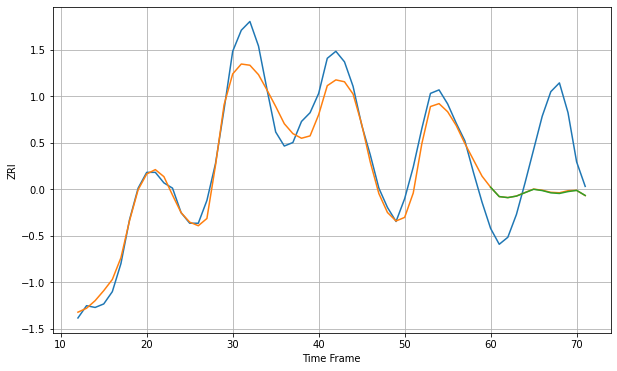

Wall time: 9.51 s
60657 9.177246344998652 33.80668541690459 33.99145728920218 [1746.49665086 1741.19211612 1740.6030506  1741.46259746 1743.43496143
 1745.34700503 1744.61960314 1743.32831542 1742.96406559 1744.03487317
 1744.72856358 1741.82679753]

Got an mse at 0.0099 in round 82 and stopped training

60 60 12


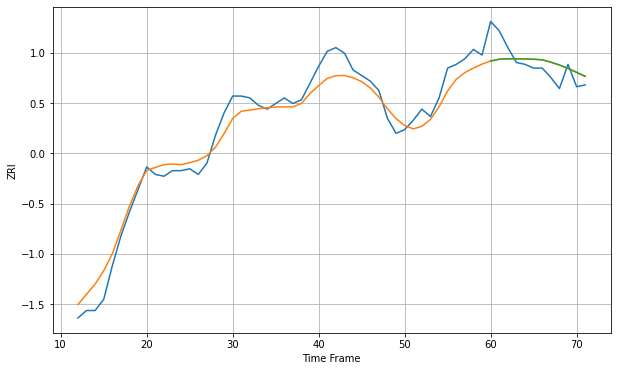

Wall time: 8.24 s
60660 7.420029014463134 9.488819994588503 9.517763864066334 [1390.80173877 1391.74519362 1391.97051724 1392.0043053  1391.89924393
 1391.72561898 1391.44173896 1390.18021876 1388.68080777 1386.8545528
 1384.75175068 1382.66144467]

Got an mse at 0.0096 in round 163 and stopped training

60 60 12


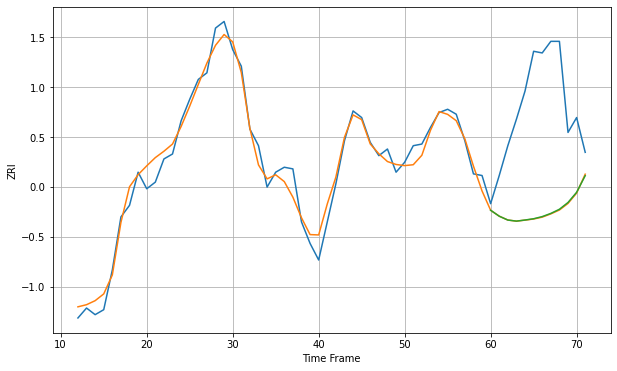

Wall time: 10.6 s
60661 7.138036783957831 69.45113470300917 69.25281842466804 [2047.0203696  2043.44194473 2041.11741238 2040.47014279 2041.13477453
 2041.90525763 2043.20398252 2045.12290978 2047.63390119 2051.72505523
 2057.87220662 2067.8893343 ]

Got an mse at 0.0099 in round 206 and stopped training

60 60 12


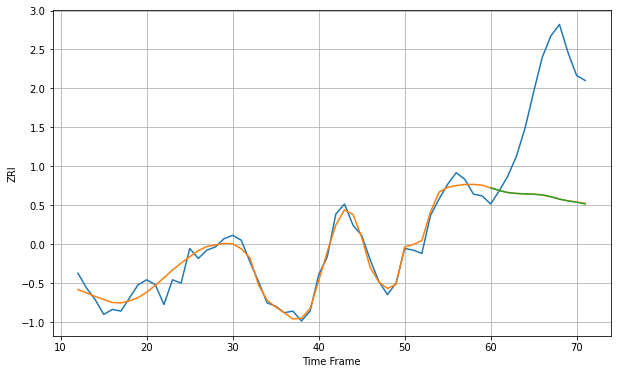

Wall time: 11.1 s
60804 5.327389277296117 66.72244432107674 66.79006897414432 [1370.82773005 1369.20340238 1367.93837875 1367.39537916 1367.17476721
 1366.97015305 1366.52952381 1365.43169811 1363.96117876 1362.8888747
 1362.08761447 1361.02185362]

Got an mse at 0.0099 in round 58 and stopped training

60 60 12


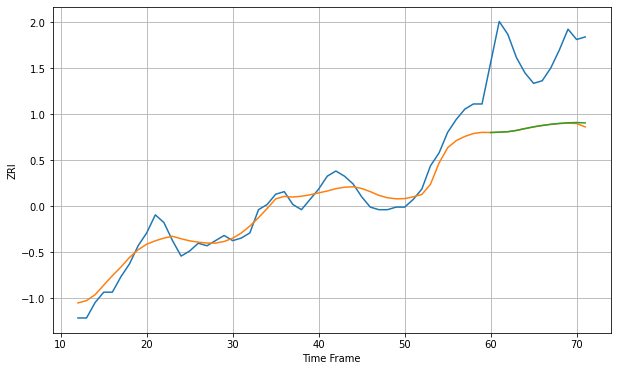

Wall time: 7.86 s
61104 5.036845085095541 29.937018731959284 29.736918929612113 [622.92517498 623.06479208 623.24055785 623.74012851 624.45183082
 625.12563385 625.66466255 626.11406342 626.4567077  626.69875226
 626.80745629 626.63681422]

Got an mse at 0.0100 in round 56 and stopped training

60 60 12


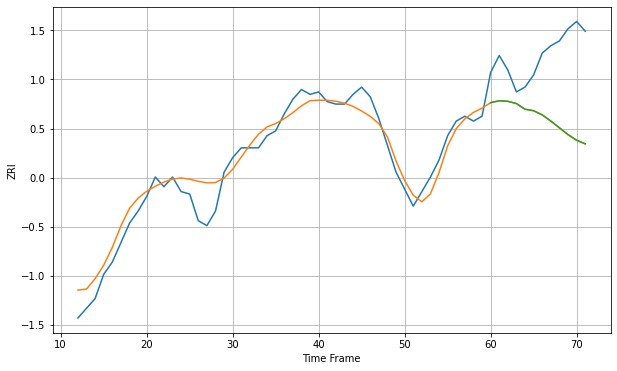

Wall time: 7.18 s
63104 6.163824564325107 29.33765259672992 29.294415666986282 [835.59166742 836.37229059 836.14198588 835.22668053 832.90974539
 832.23229817 830.57299086 828.0383934  825.27863096 822.46699856
 820.1349227  818.69582884]

Got an mse at 0.0099 in round 101 and stopped training

60 60 12


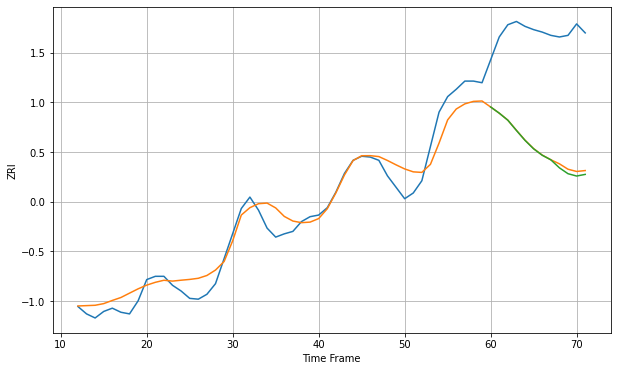

Wall time: 8.83 s
63105 18.12564729879144 141.987182303311 144.1207567329643 [1172.29722294 1164.73466395 1156.11824364 1143.57940959 1131.43035424
 1121.09310361 1113.21676828 1107.63539069 1097.81678413 1090.60915591
 1087.76854757 1089.77777915]

Got an mse at 0.0099 in round 411 and stopped training

60 60 12


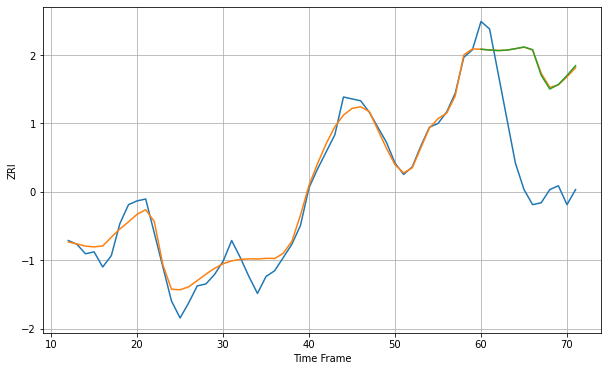

Wall time: 16.8 s
63107 6.0271084096632475 55.594187145510304 55.638061429701345 [779.31466191 778.88840815 778.59949764 778.81656027 779.58464956
 780.47271518 779.07065535 765.50315208 758.22832292 760.60024005
 765.40386506 770.62392075]

Got an mse at 0.0098 in round 95 and stopped training

60 60 12


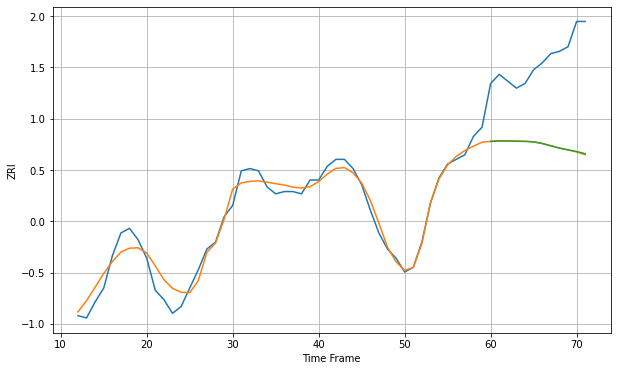

Wall time: 8.07 s
63108 4.588861157211646 38.17802617370853 38.12046668735311 [931.82525725 932.04601233 931.9762397  931.89343598 931.81638644
 931.60568055 930.89212251 929.90606147 928.90397775 928.14451259
 927.40814476 926.48342225]
60 60 12


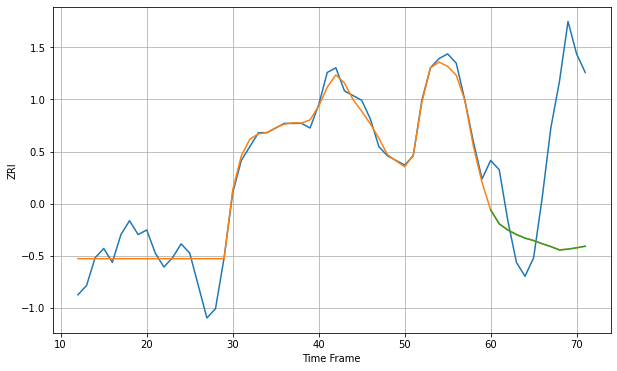

Wall time: 24.3 s
63109 3.652196688867943 25.847451862872038 25.852940954353862 [735.3194279  732.31177321 730.97668037 730.00961052 729.23231996
 728.70050161 728.01571164 727.40086887 726.66150799 726.85904622
 727.15706662 727.49027568]

Got an mse at 0.0100 in round 110 and stopped training

60 60 12


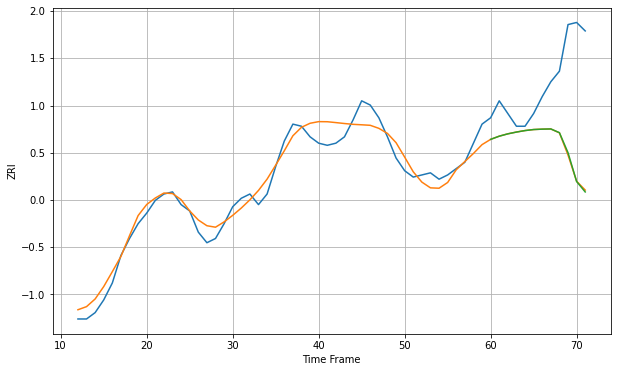

Wall time: 9.46 s
63110 5.56302615589349 37.84414912932212 37.853684865979204 [876.80396022 878.30515472 879.40873082 880.24935045 880.95795514
 881.44099474 881.63053268 881.72480605 879.96810684 870.51120753
 856.91059606 851.98220489]

Got an mse at 0.0100 in round 152 and stopped training

60 60 12


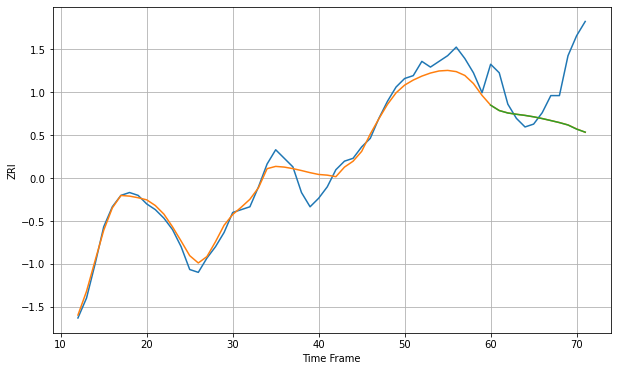

Wall time: 10.1 s
63111 3.6317080725460964 17.690054805889208 17.69740132177334 [676.63885008 674.7498952  673.89461787 673.44224747 673.0502741
 672.55189209 671.93985014 671.24675149 670.53145506 669.68558132
 668.24282071 667.17749058]

Got an mse at 0.0099 in round 184 and stopped training

60 60 12


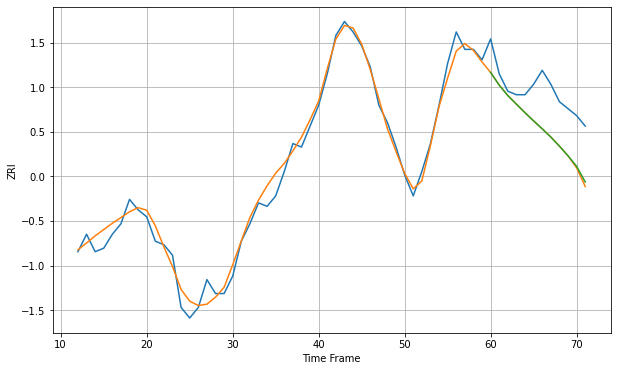

Wall time: 10.8 s
63112 2.9318535740025418 11.64059316536722 11.445747683038196 [771.38461406 767.73571222 764.75373943 762.27914693 759.83517733
 757.49562857 755.21122361 752.85651144 750.24188141 747.50483356
 744.47839026 739.99929612]

Got an mse at 0.0098 in round 184 and stopped training

60 60 12


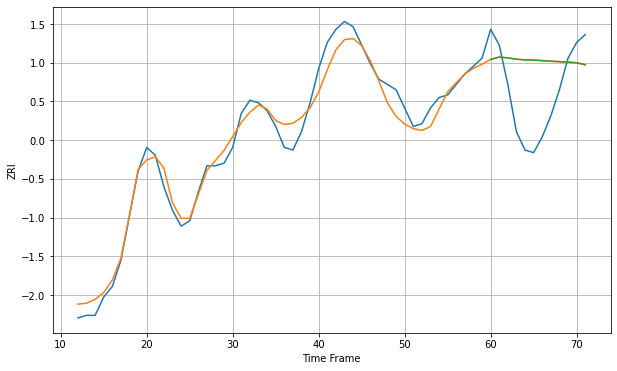

Wall time: 10.9 s
63113 4.749699653772708 20.475587440091317 20.474846346706787 [749.54555022 750.41909688 750.13899358 749.63238629 749.35442351
 749.25820191 749.09239416 748.84060534 748.7001696  748.52566641
 748.26023783 747.53447402]

Got an mse at 0.0100 in round 211 and stopped training

60 60 12


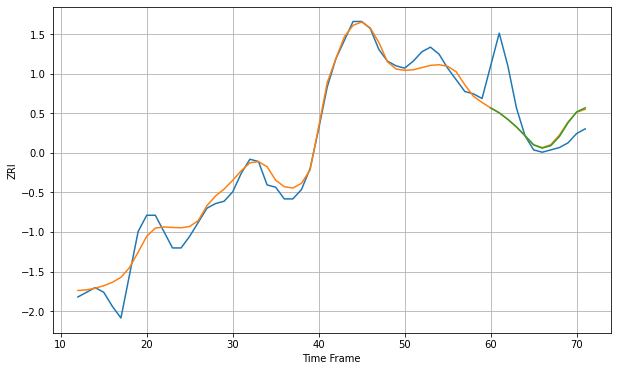

Wall time: 11.6 s
63115 4.953987101622612 14.01528787434865 14.011273956871404 [662.97486711 660.87654617 658.07059081 654.84012123 651.06768285
 647.13714548 645.7568677  646.79492687 650.72919979 656.58642187
 661.26722815 663.01547684]

Got an mse at 0.0098 in round 146 and stopped training

60 60 12


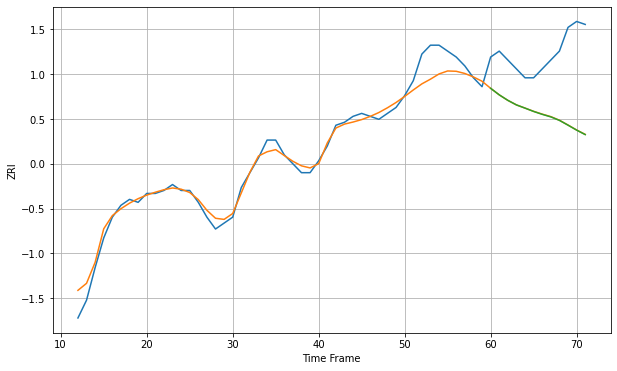

Wall time: 9.53 s
63116 3.642594106297803 22.04672159017066 22.08546146118197 [691.45683941 689.24978837 687.39376382 685.85669346 684.77282862
 683.65432155 682.67704327 681.81479144 680.64292297 679.02973785
 677.35852801 675.84463198]

Got an mse at 0.0100 in round 78 and stopped training

60 60 12


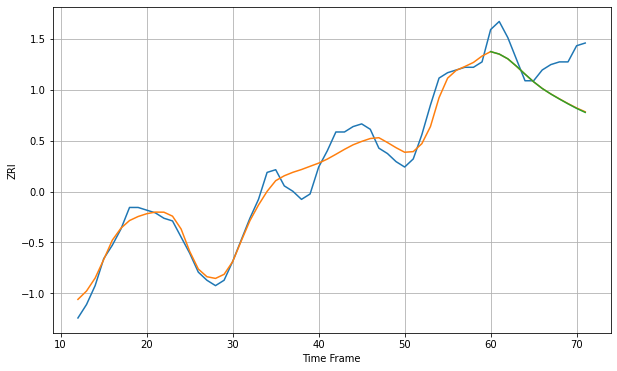

Wall time: 7.73 s
63118 4.504024192065574 13.118168447699338 13.191918187917748 [736.81123093 735.90630424 734.14212303 731.40826796 728.45387785
 725.62123811 723.14001185 721.08557769 719.22703205 717.44637724
 715.75221476 714.26820314]

Got an mse at 0.0100 in round 88 and stopped training

60 60 12


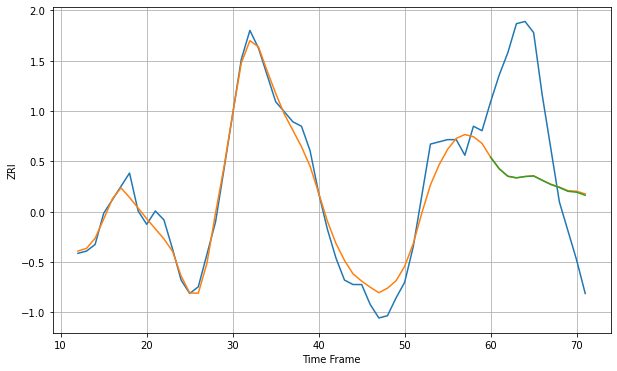

Wall time: 7.99 s
63130 6.114338659343646 44.95410637637914 44.86463348238013 [1020.10577858 1014.93425665 1011.6139631  1010.88301083 1011.44978361
 1011.70308632 1009.73562667 1007.85820323 1006.51071666 1004.80777782
 1004.41229582 1003.04025492]

Got an mse at 0.0098 in round 86 and stopped training

60 60 12


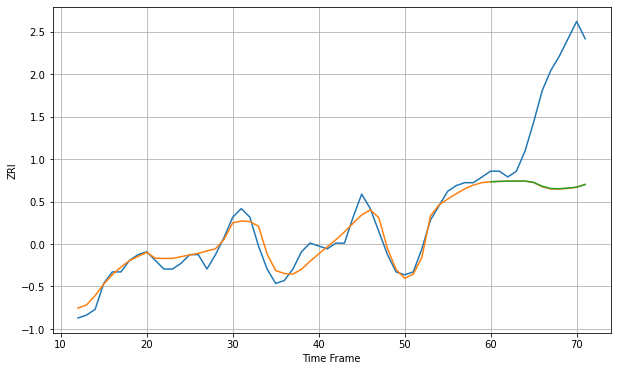

Wall time: 8.34 s
63139 3.165889773530489 34.300718124655766 34.23327693572484 [802.30970234 802.44939138 802.51757022 802.54038206 802.54824879
 802.11878533 800.77459502 799.97306457 799.90550485 800.12960563
 800.44887274 801.37548436]

Got an mse at 0.0099 in round 111 and stopped training

60 60 12


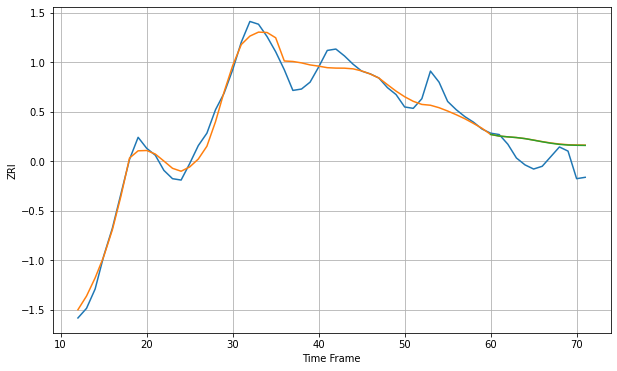

Wall time: 8.81 s
64111 8.574615044491091 14.833040884877079 14.733423818636577 [1010.07350305 1008.91237422 1008.32982408 1007.82039631 1007.04339354
 1005.93254565 1004.75780733 1003.71349593 1002.88631114 1002.39454424
 1002.22381043 1002.12175645]

Got an mse at 0.0100 in round 123 and stopped training

60 60 12


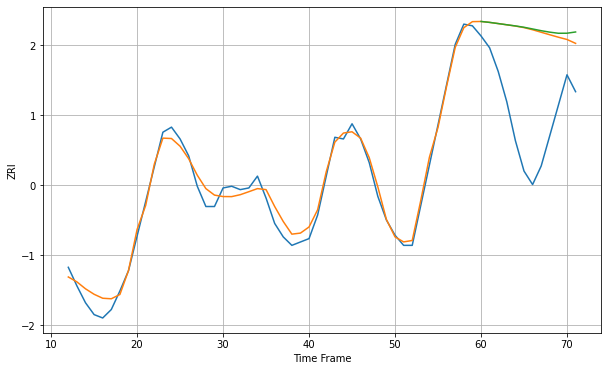

Wall time: 10.1 s
64801 5.315258700434453 54.85905318411279 55.81001294430841 [829.57842895 829.0276986  828.33365312 827.62588101 826.93879461
 826.1425034  825.1359519  824.11477447 823.24340939 822.59349839
 822.61920392 823.35179674]

Got an mse at 0.0100 in round 189 and stopped training

60 60 12


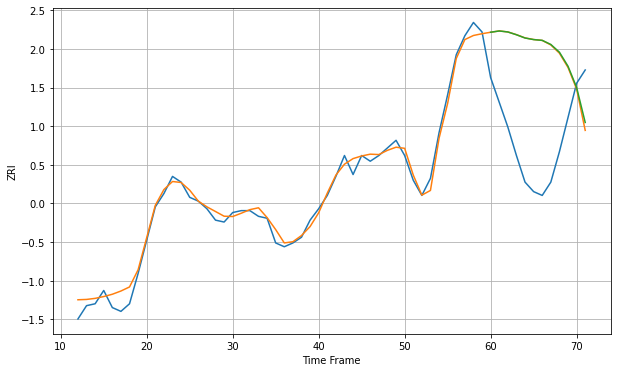

Wall time: 11.1 s
64804 4.088797685407422 55.48437269962672 55.37922802960574 [863.85252995 864.52790315 863.99783275 862.54228519 860.82378685
 859.98814832 859.58929697 857.43460304 853.36560541 845.96995439
 834.82633165 816.38805961]

Got an mse at 0.0100 in round 170 and stopped training

60 60 12


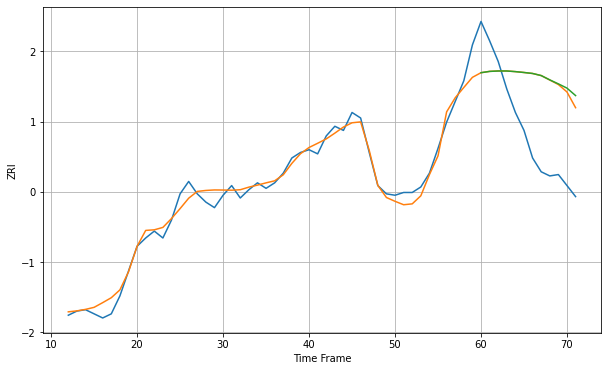

Wall time: 10.3 s
64834 6.5365060620506314 50.9985667836898 52.35448384862419 [882.8494854  883.78626737 884.0879886  884.08437005 883.62897015
 883.00126273 882.2879719  880.77253718 877.64219714 874.74625948
 871.6561052  866.26677696]

Got an mse at 0.0100 in round 109 and stopped training

60 60 12


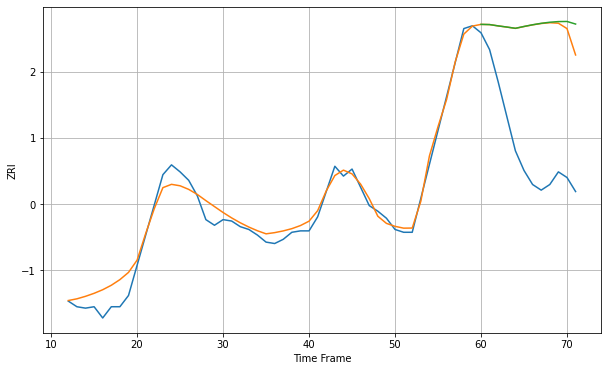

Wall time: 9.23 s
64836 7.588233229381097 89.54410035962658 92.41041724651333 [870.99255079 870.85367673 869.91513155 869.10301984 868.19794452
 869.50338207 870.71498708 871.74624645 872.51643034 872.98233276
 873.06811113 871.22840091]

Got an mse at 0.0099 in round 80 and stopped training

60 60 12


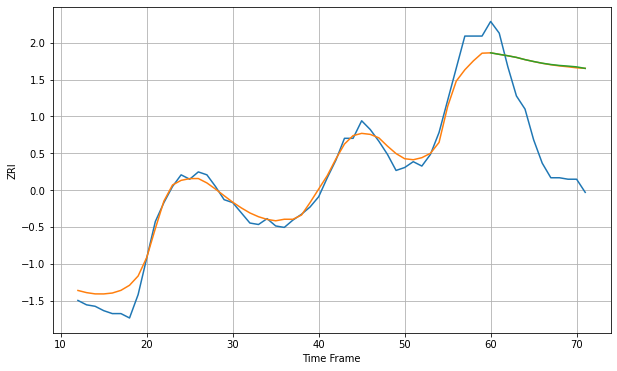

Wall time: 7.63 s
64870 8.107669152546164 58.386369531607514 58.57302900124007 [871.52982954 870.49440379 869.52309379 868.39262585 866.87383961
 865.59089018 864.43625488 863.54200356 862.88439958 862.44788861
 861.91691479 860.87488784]

Got an mse at 0.0100 in round 280 and stopped training

60 60 12


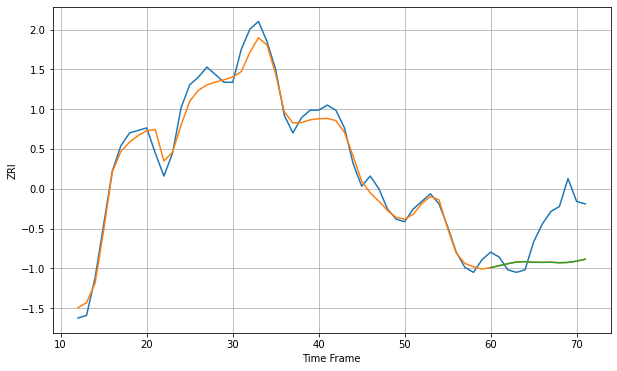

Wall time: 12.8 s
65201 4.064413890831479 16.813558656228786 16.807189894681255 [779.86888767 780.64551932 781.41585722 782.09291369 782.21683886
 781.99842717 781.95316784 782.00715304 781.79038832 781.92659647
 782.41787756 783.21421291]

Got an mse at 0.0100 in round 221 and stopped training

60 60 12


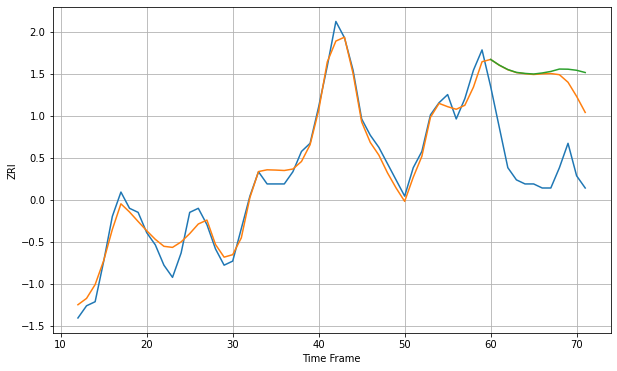

Wall time: 11.8 s
65202 2.637182592895465 22.509334473148517 24.26416908468667 [796.65331639 795.25705007 794.16152301 793.46445873 793.20916512
 793.0579769  793.31986736 793.6941148  794.28238546 794.24747983
 793.98168117 793.43088881]

Got an mse at 0.0100 in round 232 and stopped training

60 60 12


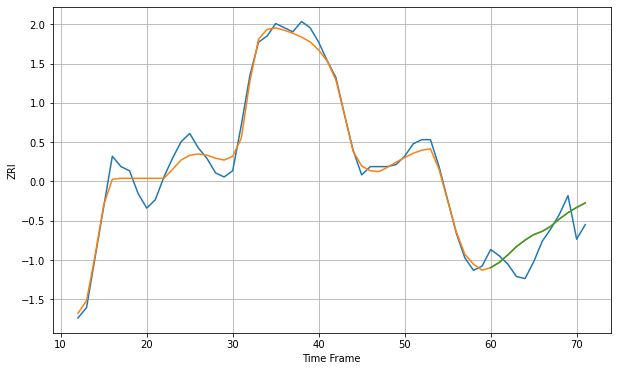

Wall time: 12.1 s
65203 5.0973196811808785 10.293296889350001 10.291436831801994 [804.27588812 806.78253991 810.43542867 814.40287482 817.54871452
 820.16320636 821.76988995 824.23668444 827.76158137 830.78705805
 833.30276276 835.44712997]

Got an mse at 0.0098 in round 217 and stopped training

60 60 12


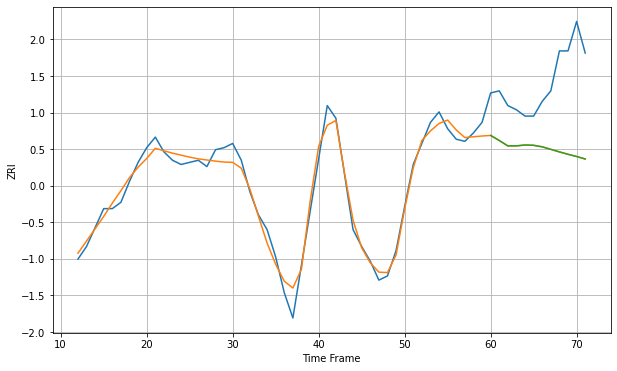

Wall time: 11.8 s
66061 4.486118840577126 34.92309205524623 34.926660672720125 [1005.79908151 1003.4140599  1000.85612816 1000.85981533 1001.24964502
 1001.10788672 1000.37993158  999.1725392   997.96634153  996.82149788
  995.77239129  994.61140083]

Got an mse at 0.0100 in round 109 and stopped training

60 60 12


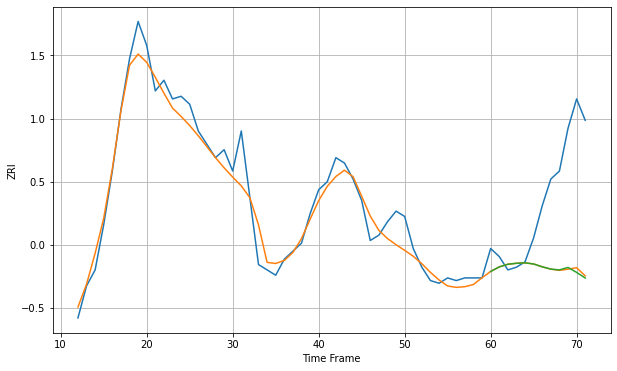

Wall time: 8.55 s
66213 6.037160841891638 33.411468142442324 33.705719253880886 [1023.40981897 1025.11881376 1026.1023643  1026.47053792 1026.64352772
 1026.20969881 1025.15726432 1024.30616082 1023.98719561 1024.92325058
 1023.05912607 1020.96463921]

Got an mse at 0.0098 in round 38 and stopped training

60 60 12


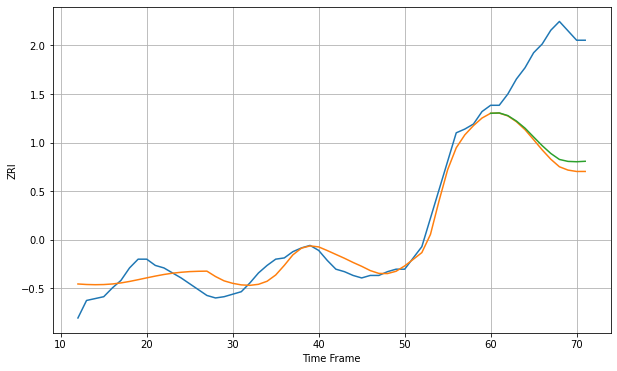

Wall time: 7.41 s
66214 9.805992381746437 78.80198932198357 74.4609365346841 [841.61801459 841.88364007 839.7486698  835.39510009 829.70937875
 822.6567626  815.70603964 809.49086737 804.70477667 803.14880269
 802.8791784  803.24453523]

Got an mse at 0.0100 in round 115 and stopped training

60 60 12


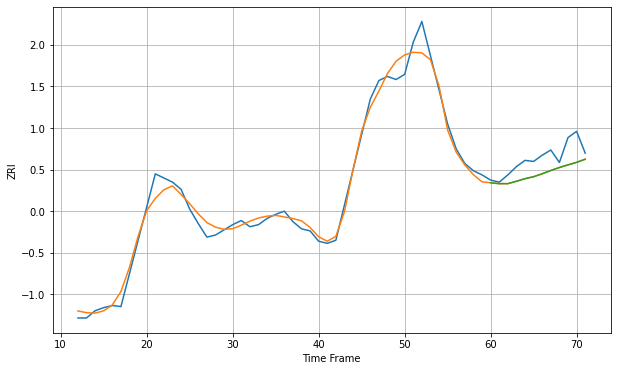

Wall time: 8.6 s
66215 8.832405637666799 16.21904961184218 16.243358115348848 [1029.4016116  1028.5738956  1028.56296261 1030.84743147 1033.36267198
 1035.25476657 1038.09668882 1041.25628791 1044.13922344 1046.64694011
 1049.10052945 1052.08672828]

Got an mse at 0.0100 in round 96 and stopped training

60 60 12


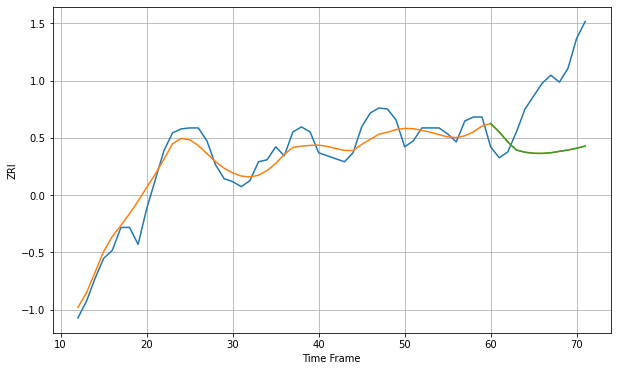

Wall time: 10.9 s
66223 14.065886633368711 69.1870891412065 69.1309755285477 [1429.44007445 1420.95313286 1410.86254928 1402.74550828 1400.54858271
 1399.49627776 1399.39278272 1400.06415626 1401.46608508 1402.82864562
 1404.63629364 1406.8030364 ]

Got an mse at 0.0100 in round 218 and stopped training

60 60 12


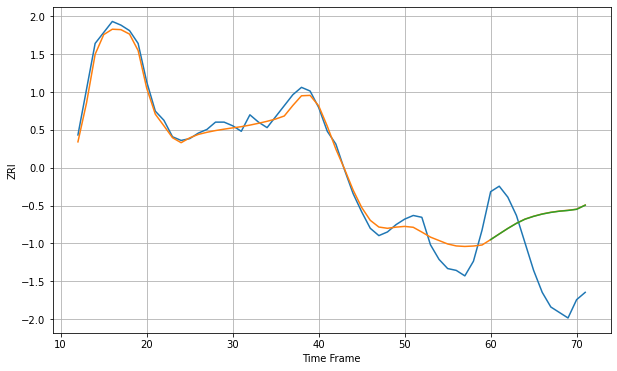

Wall time: 11.8 s
66502 5.464433075889349 39.24637695570487 39.19817276630693 [814.81572552 817.89023853 820.91825735 823.69599183 825.98381144
 827.53158374 828.77425896 829.67870078 830.33510421 830.74731681
 831.36462322 833.63621025]

Got an mse at 0.0099 in round 178 and stopped training

60 60 12


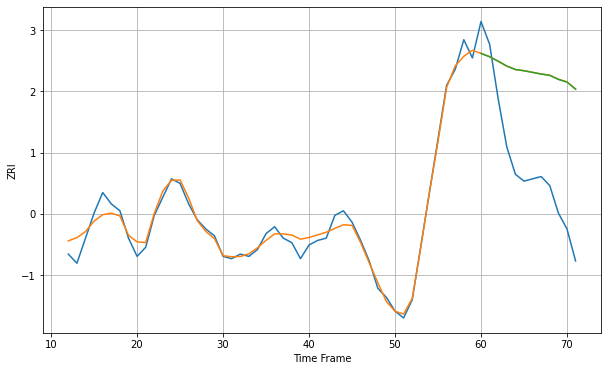

Wall time: 10.3 s
66614 3.6868953930608765 46.590460528396854 46.545344838657854 [930.98560719 929.54460018 927.56144619 925.44997805 923.92853525
 923.38676151 922.65493016 921.92044555 921.36510009 919.59757298
 918.43145768 915.30586495]

Got an mse at 0.0100 in round 462 and stopped training

60 60 12


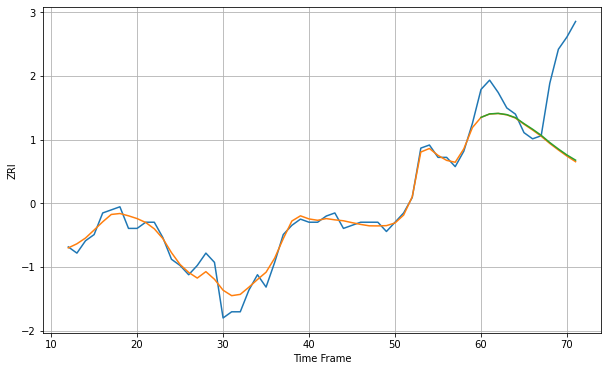

Wall time: 17.5 s
67218 2.6993417124413828 20.947138352885226 20.73934409493103 [652.94296253 654.07214873 654.24247751 653.83844349 652.86443714
 650.92142113 649.11343647 647.13867078 644.79721175 642.70971294
 640.76344833 639.09254066]

Got an mse at 0.0098 in round 156 and stopped training

60 60 12


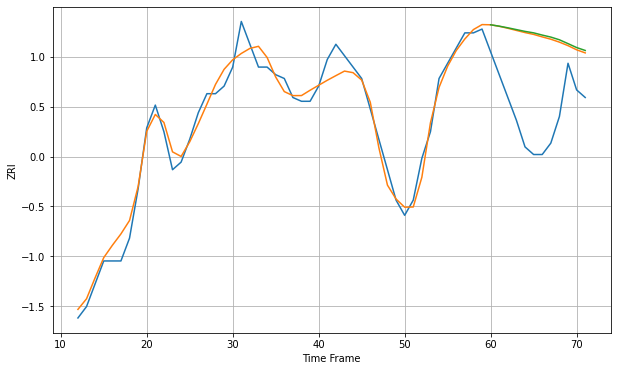

Wall time: 10.1 s
72205 3.2490843273075596 21.141627430167187 21.492596981460746 [745.12459895 744.76625757 744.33097395 743.85929611 743.38799032
 743.00437438 742.42157043 741.89093026 741.18196339 740.17139503
 739.14058762 738.37158684]

Got an mse at 0.0099 in round 110 and stopped training

60 60 12


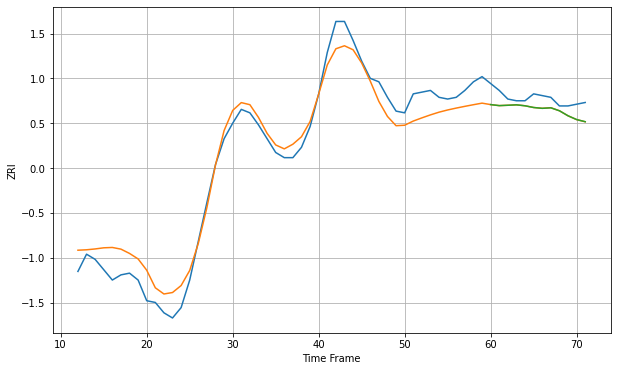

Wall time: 9.75 s
72712 9.87066016044526 7.375803069761164 7.372323274273625 [914.77592717 914.18750894 914.39141499 914.63997012 914.08550572
 913.08977496 912.60794757 912.9184123  911.19751982 908.29199618
 906.09936191 904.85623147]

Got an mse at 0.0100 in round 159 and stopped training

60 60 12


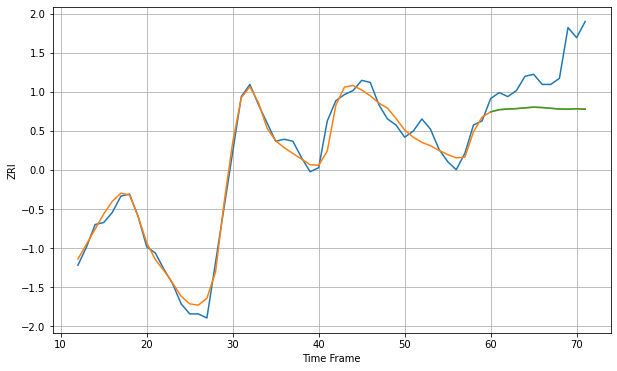

Wall time: 12.2 s
72764 4.551128676823039 22.241733088600224 22.23426523666124 [917.47152016 918.5617235  918.88043997 919.08763279 919.48506991
 919.78213542 919.61353984 919.24508011 918.8893184  918.84401461
 919.0168567  918.80940191]

Got an mse at 0.0100 in round 163 and stopped training

60 60 12


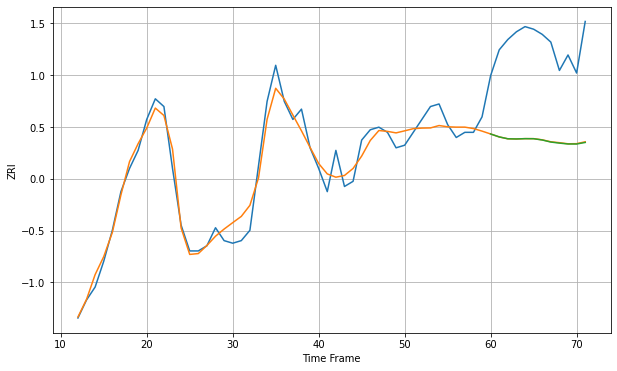

Wall time: 12 s
73071 4.938695241260952 37.21760999212918 37.2858003896843 [848.36048242 847.22139476 846.49967163 846.43009963 846.54901183
 846.52526991 846.03299991 845.23008633 844.81776578 844.48445801
 844.47001243 845.07512869]

Got an mse at 0.0100 in round 196 and stopped training

60 60 12


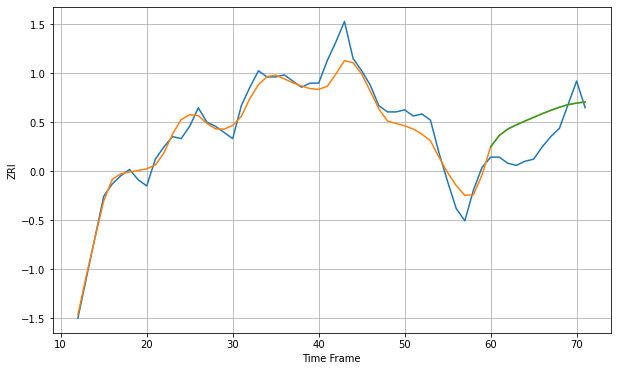

Wall time: 11.2 s
73159 6.253243902316347 13.696722126010757 13.69488958316432 [708.99673461 714.51918512 717.64934733 719.73258269 721.56764022
 723.33423987 725.13935562 726.78602544 728.27593437 729.52644165
 730.30657494 730.85023552]

Got an mse at 0.0100 in round 65 and stopped training

60 60 12


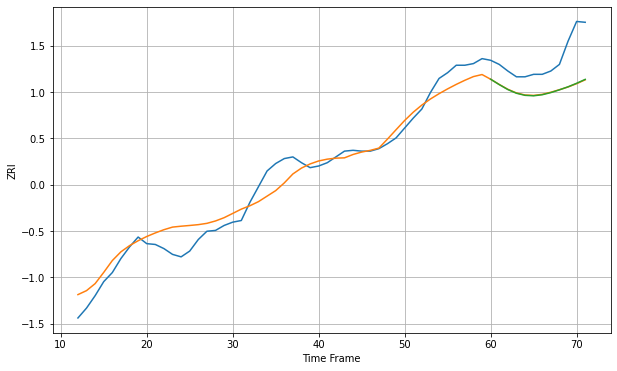

Wall time: 7.8 s
75001 16.747850638583735 39.677894276451035 39.6459860874303 [1273.06671425 1266.56479294 1260.57789265 1256.08726963 1253.55878941
 1253.01286738 1254.26527323 1256.88623618 1260.22005771 1263.8677444
 1268.1505776  1272.88207878]

Got an mse at 0.0099 in round 98 and stopped training

60 60 12


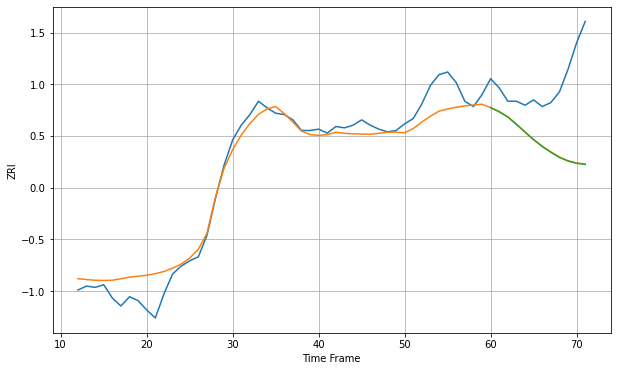

Wall time: 9.12 s
75010 11.87390828095602 51.32854560070944 51.470077257489685 [1247.23591969 1244.11036743 1240.18235801 1234.69848802 1228.80564718
 1223.1486654  1218.05359986 1213.64966834 1209.7838382  1207.00544435
 1205.32880453 1204.46944661]

Got an mse at 0.0098 in round 73 and stopped training

60 60 12


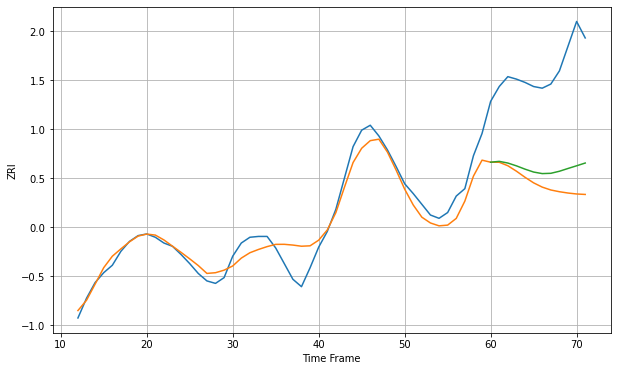

Wall time: 11.3 s
75013 16.049274828062764 138.23634750104708 119.31753433877938 [1388.12304409 1389.15475797 1387.10565063 1383.69052747 1379.68447209
 1376.17048799 1374.29643118 1374.65138287 1377.13775572 1380.51326129
 1383.77582294 1387.11680647]

Got an mse at 0.0097 in round 49 and stopped training

60 60 12


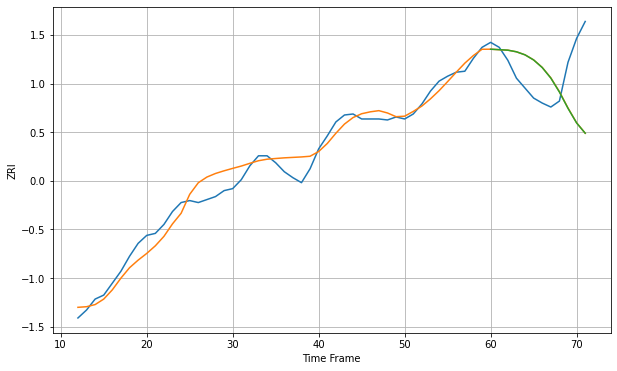

Wall time: 7.4 s
75024 11.485016906095773 47.97367835020148 47.985122660279444 [1369.1113457  1368.65447472 1368.15131412 1366.52598154 1363.44518389
 1358.31779542 1350.68805216 1340.09463568 1326.07171713 1309.67552344
 1295.01464513 1284.69016226]

Got an mse at 0.0100 in round 85 and stopped training

60 60 12


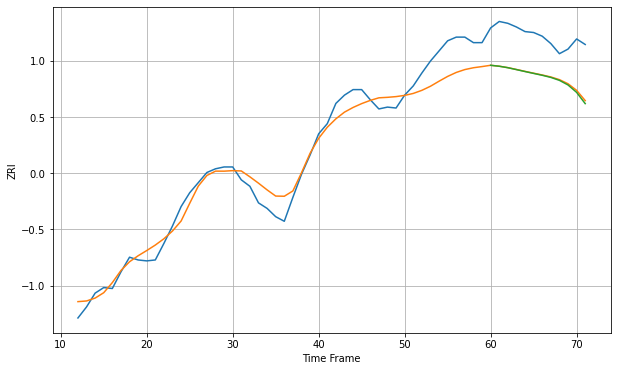

Wall time: 8.65 s
75039 16.650972196219197 45.08944010965053 45.94500108340932 [1497.41073813 1496.37501285 1494.78364481 1492.72461813 1490.61517176
 1488.57520704 1486.55416071 1484.24700385 1481.04569436 1476.04366062
 1467.9964801  1455.77681104]

Got an mse at 0.0098 in round 93 and stopped training

60 60 12


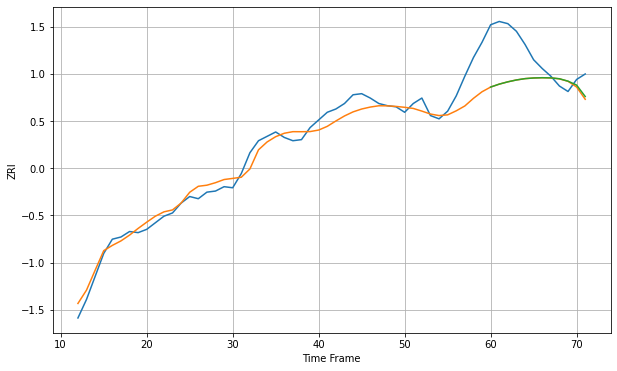

Wall time: 12.1 s
75050 11.98426556359735 33.37456605160842 33.216452427181096 [1148.04538098 1150.72573221 1152.83135202 1154.52892702 1155.74314286
 1156.34585419 1156.58259793 1156.43629252 1155.64184583 1153.4524076
 1149.85502802 1139.4170383 ]

Got an mse at 0.0098 in round 69 and stopped training

60 60 12


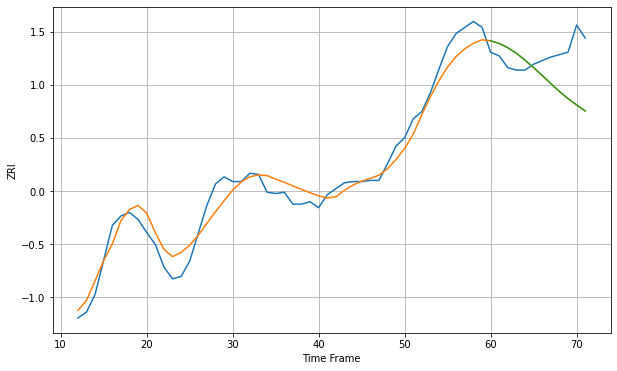

Wall time: 8.94 s
75052 11.642875981618646 31.94548156049962 31.915565175584447 [1129.72597171 1127.47444282 1123.84187339 1119.20986577 1113.41403758
 1107.10479479 1100.52415772 1093.68363916 1086.97385821 1080.98897311
 1075.64360198 1070.52519823]

Got an mse at 0.0099 in round 97 and stopped training

60 60 12


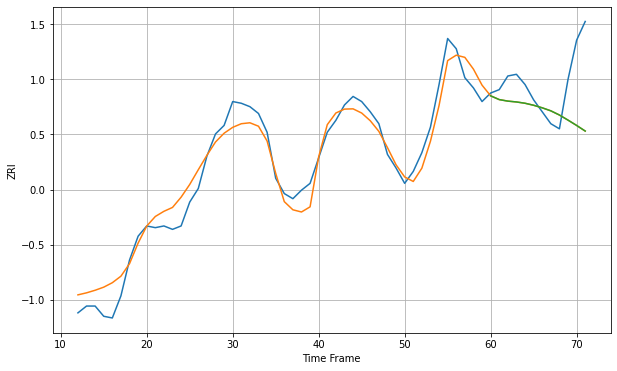

Wall time: 8.63 s
75056 9.17995530374738 25.803320009408374 25.793692575308985 [1361.36345177 1359.15193542 1358.25712268 1357.76737536 1357.00733696
 1355.82396549 1354.32346915 1352.55889301 1350.09909173 1347.10832237
 1343.98774955 1340.69640534]

Got an mse at 0.0099 in round 30 and stopped training

60 60 12


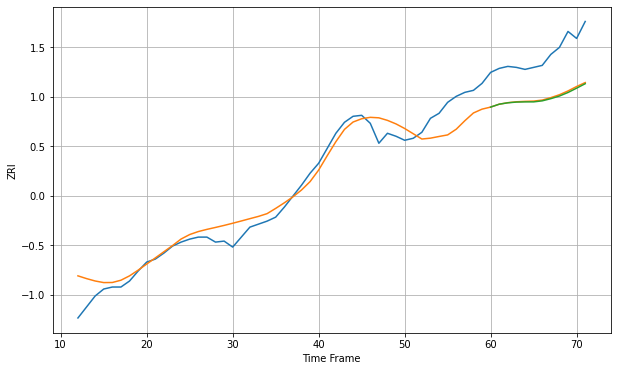

Wall time: 6.58 s
75063 15.343462365583047 42.926022683433914 43.76963928411483 [1206.23341174 1209.13093372 1210.52979738 1211.25848658 1211.443376
 1211.4556299  1212.48525407 1214.67237916 1217.30849053 1220.86173398
 1225.18602642 1229.65132866]

Got an mse at 0.0098 in round 51 and stopped training

60 60 12


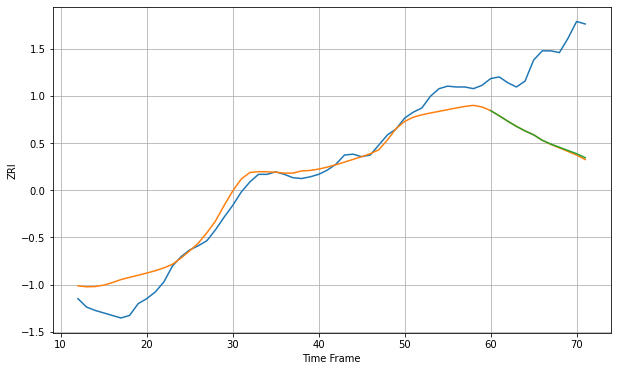

Wall time: 7.51 s
75067 18.888041056283175 102.24001070197212 101.5049788876211 [1174.89321134 1168.69876149 1162.26391714 1156.11370071 1150.69399205
 1146.06266942 1139.60181189 1135.06552819 1131.23593077 1127.36222047
 1123.55632173 1118.82809159]

Got an mse at 0.0097 in round 108 and stopped training

60 60 12


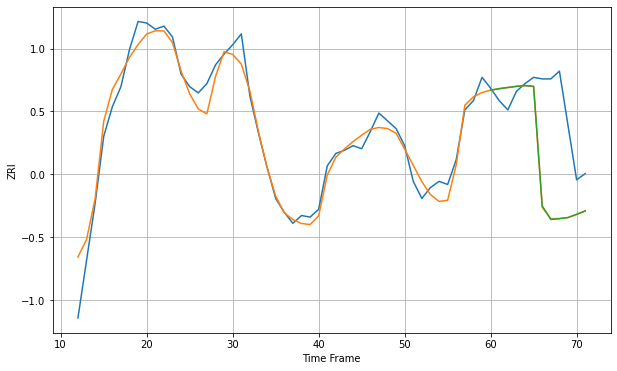

Wall time: 8.8 s
75070 9.469180966932285 49.05393451831523 49.00625518157011 [1559.75930553 1560.70471711 1561.46841484 1562.20449389 1562.72128496
 1562.23816557 1485.25725079 1476.46347979 1476.94467388 1477.69079822
 1479.76902906 1481.95907927]

Got an mse at 0.0098 in round 41 and stopped training

60 60 12


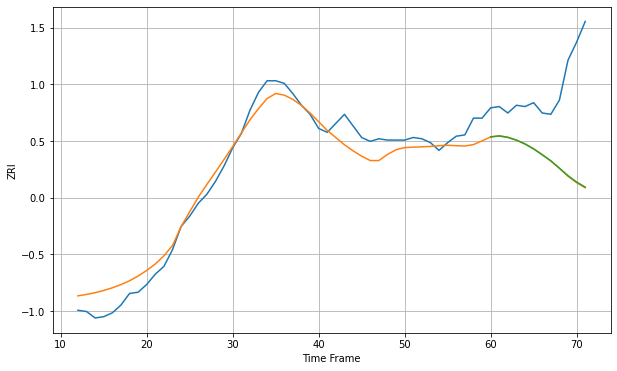

Wall time: 6.92 s
75074 11.194550083070684 61.935220196218225 61.71423679720488 [1235.46396884 1236.23769816 1235.10725789 1232.97394896 1229.98400791
 1226.18289142 1221.6829227  1216.91643704 1211.19970504 1205.34514966
 1200.45232893 1196.5058143 ]

Got an mse at 0.0098 in round 45 and stopped training

60 60 12


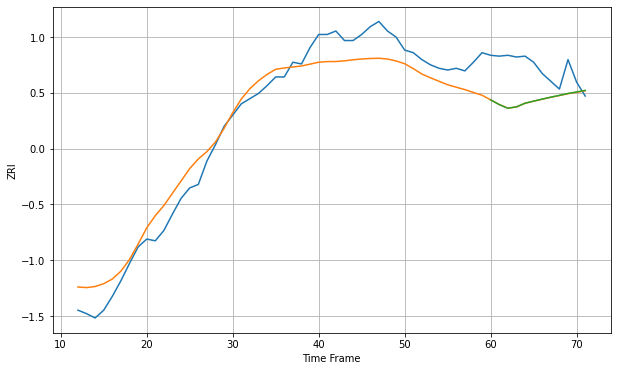

Wall time: 6.72 s
75081 23.30203497914511 41.6165068479305 41.55205733908897 [1245.55184876 1240.15256826 1235.92185437 1237.49524998 1241.70788993
 1244.12323446 1246.44715024 1248.70127907 1250.78466673 1252.96219929
 1254.70856738 1256.51297146]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


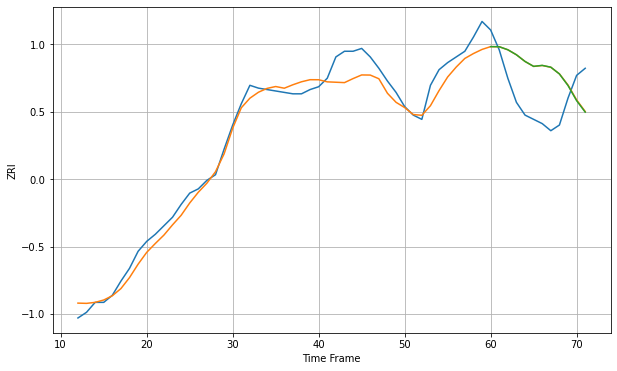

Wall time: 7.87 s
75093 9.046867839111652 29.969203441127593 30.04310247531366 [1398.26060415 1398.19088204 1396.06025652 1392.52290483 1387.81259251
 1384.36281189 1385.04694228 1383.78051463 1378.9916613  1370.8303878
 1360.1780678  1352.09160094]

Got an mse at 0.0099 in round 111 and stopped training

60 60 12


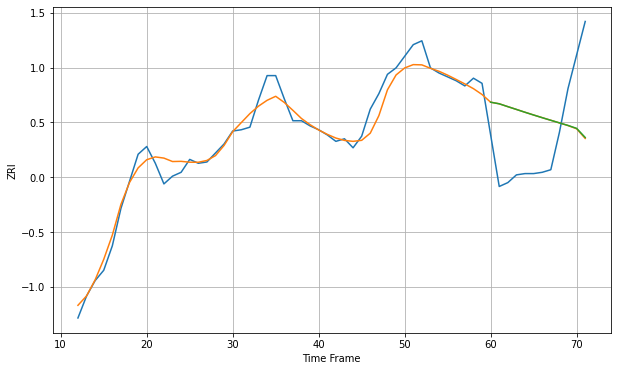

Wall time: 11.6 s
75201 8.711630641622538 50.653860088469905 50.50358704096045 [1663.3745334  1662.13531371 1659.92549284 1657.76184836 1655.56713142
 1653.43884878 1651.36691226 1649.33722704 1647.33760743 1645.33502075
 1643.09112519 1636.027768  ]

Got an mse at 0.0100 in round 133 and stopped training

60 60 12


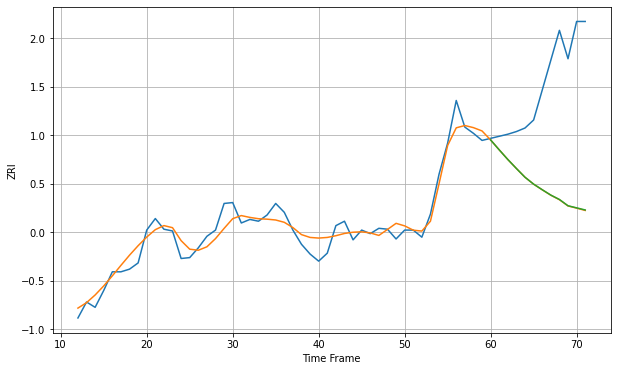

Wall time: 10.9 s
75202 12.35199634580799 129.1849469432893 128.97948367637755 [1605.50167802 1594.36787097 1583.50062925 1573.35332491 1563.5116317
 1555.76405887 1549.47688609 1543.42609651 1538.48939926 1531.39626238
 1529.04871774 1526.66383911]

Got an mse at 0.0098 in round 63 and stopped training

60 60 12


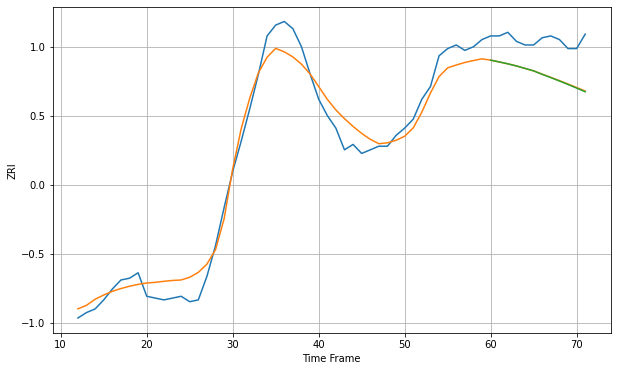

Wall time: 7.81 s
75204 8.630576890674885 19.440537318183583 19.584752932610048 [1496.60901306 1495.6195871  1494.57300263 1493.39293521 1492.02758828
 1490.66811947 1488.74764567 1486.95278532 1485.07312568 1483.1548418
 1481.14848977 1479.1283085 ]

Got an mse at 0.0098 in round 95 and stopped training

60 60 12


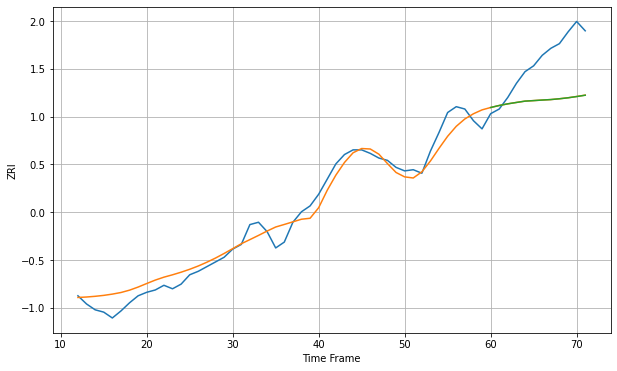

Wall time: 8.59 s
75206 9.73086809454841 38.544918323241276 38.56744613318343 [1387.29779514 1389.02871368 1390.45330739 1391.62411097 1392.76192104
 1393.20691984 1393.68282033 1394.09703294 1394.77834393 1395.61335139
 1396.67407807 1397.81149278]

Got an mse at 0.0099 in round 175 and stopped training

60 60 12


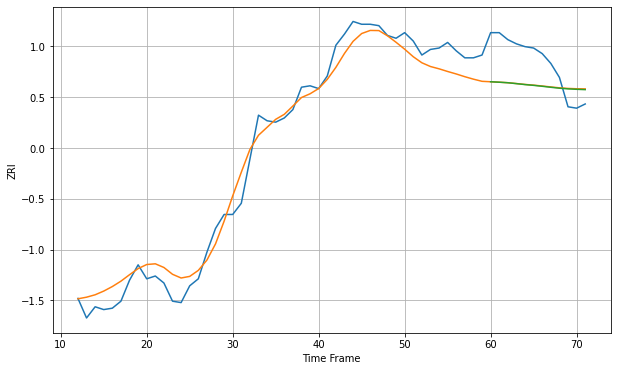

Wall time: 10.2 s
75214 11.273168589346609 24.205003225948005 24.225064478813287 [1199.88810619 1199.56780596 1199.18517249 1198.54644648 1197.87045504
 1197.31879074 1196.65712225 1195.94787645 1195.2806712  1194.80849031
 1194.49906292 1194.26484618]

Got an mse at 0.0100 in round 30 and stopped training

60 60 12


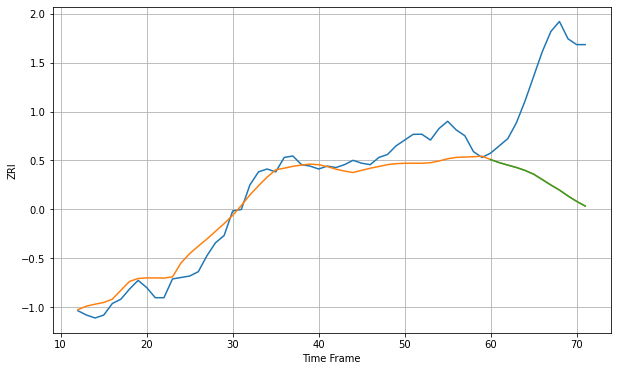

Wall time: 6.77 s
75219 10.571851995970173 80.07410064318718 80.08145495660956 [1440.4972368  1438.42132978 1436.68574763 1435.02244795 1432.99612534
 1430.40134608 1426.69792016 1422.95726563 1419.43479585 1415.34495855
 1411.64133502 1408.39409448]

Got an mse at 0.0098 in round 51 and stopped training

60 60 12


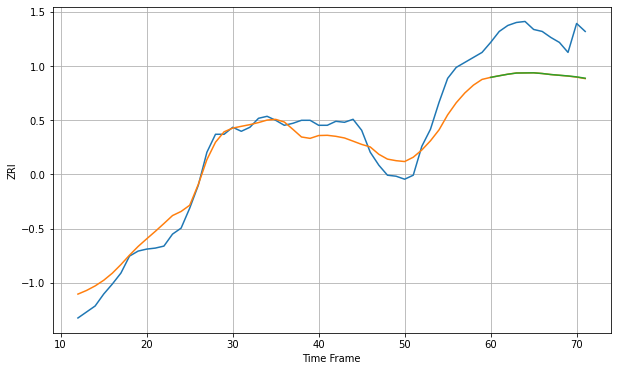

Wall time: 7.71 s
75235 16.327283853935334 43.39533215772107 43.34292535635609 [1423.99984242 1425.60797344 1427.16093305 1428.34367356 1428.44117358
 1428.55797615 1427.86463109 1426.85954475 1426.13265912 1425.43039204
 1424.48523443 1423.13438552]

Got an mse at 0.0098 in round 50 and stopped training

60 60 12


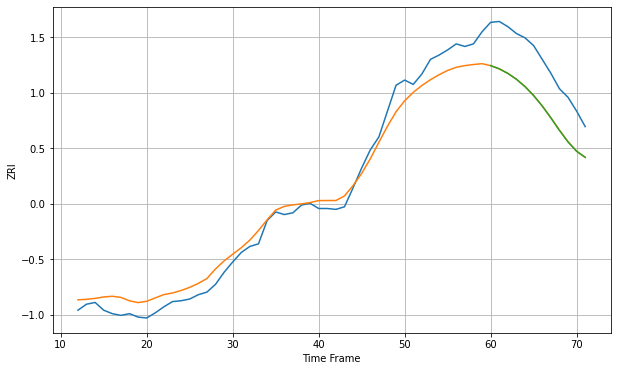

Wall time: 6.83 s
75243 15.890445840068454 51.46886156607632 51.57131406929349 [1119.76425649 1116.05724951 1110.74621707 1103.93150762 1095.43030075
 1085.03985121 1072.92989405 1059.20578158 1044.69688046 1031.26210137
 1020.35035735 1013.48642789]

Got an mse at 0.0097 in round 26 and stopped training

60 60 12


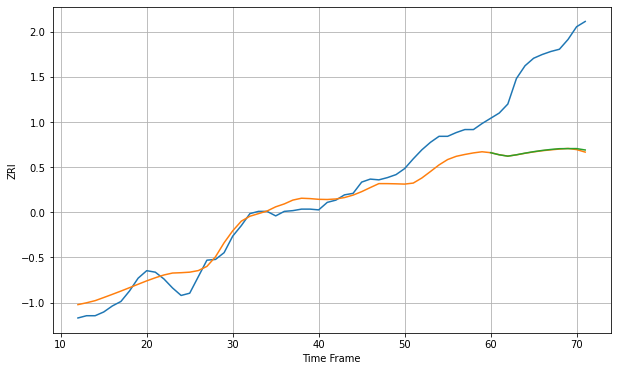

Wall time: 7.04 s
75244 19.140812189623663 122.109333297235 121.48531974473616 [1338.20038451 1335.39378738 1333.56344912 1335.39623452 1337.58746282
 1339.52509331 1341.1730439  1342.49920363 1343.49847231 1343.62793248
 1343.66451214 1341.79484149]

Got an mse at 0.0100 in round 98 and stopped training

60 60 12


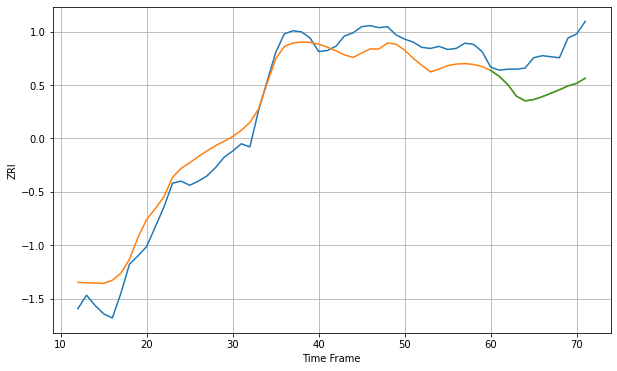

Wall time: 10.5 s
75248 17.717343450512914 35.09668934010389 35.0051842141231 [1259.83314545 1254.05927484 1246.13583027 1235.0210684  1230.42605761
 1231.67406519 1234.44882053 1237.79858743 1241.18226289 1244.87700462
 1247.35350261 1252.32456664]

Got an mse at 0.0099 in round 82 and stopped training

60 60 12


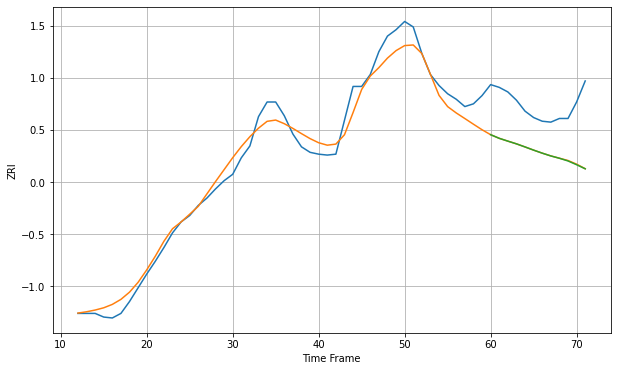

Wall time: 8.64 s
75287 14.247794358365985 53.57296197641154 53.70272716231545 [1113.26778981 1109.30801769 1106.24343996 1103.27229115 1099.89113271
 1096.40278153 1093.09951112 1090.0620642  1087.51426733 1084.56024103
 1080.45244299 1075.99305874]

Got an mse at 0.0100 in round 90 and stopped training

60 60 12


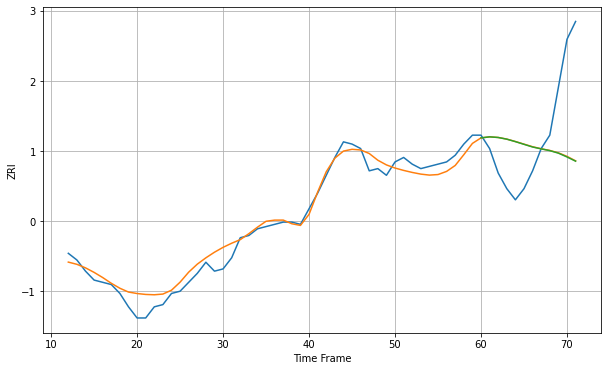

Wall time: 8.84 s
75703 4.460065295550796 28.220880592307083 28.2877535231056 [907.77942056 908.24343388 907.96041189 907.20086172 906.09670992
 904.88886642 903.68841369 902.84941274 902.06326117 900.92972811
 899.22393765 897.33369846]

Got an mse at 0.0095 in round 37 and stopped training

60 60 12


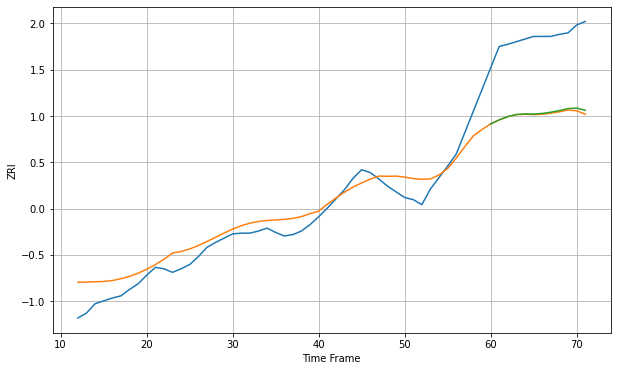

Wall time: 6.9 s
76006 21.55771213161026 107.71394820892 106.14372942563902 [975.2645912  981.00929211 985.53544826 988.55678767 989.30065298
 989.07425882 989.97142391 991.68850513 993.9927222  996.78786288
 997.50363239 994.38238851]

Got an mse at 0.0099 in round 83 and stopped training

60 60 12


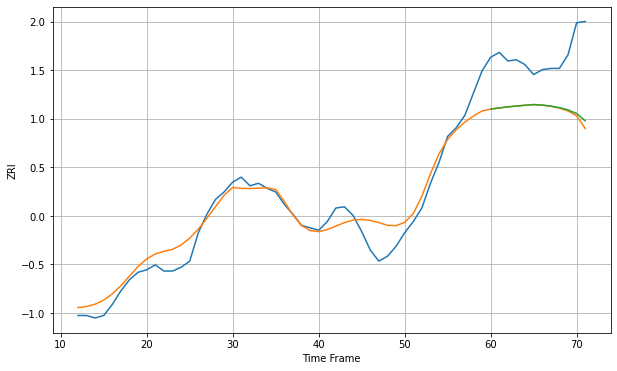

Wall time: 8.49 s
76010 11.912716230110616 46.803443566919825 45.50190589337982 [1050.03745631 1051.0040301  1051.86573822 1052.55610864 1053.15957348
 1053.75800237 1053.33515626 1052.49822988 1051.25517865 1049.42289225
 1046.50328759 1040.60241149]

Got an mse at 0.0099 in round 112 and stopped training

60 60 12


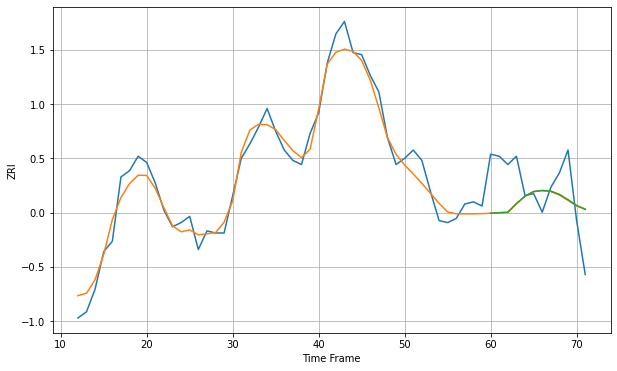

Wall time: 8.61 s
76012 6.064383567762597 19.292620200542448 19.233768655150634 [1199.51763418 1199.74796628 1199.98011855 1204.13958219 1207.75676445
 1209.99850326 1210.51459023 1210.19264021 1208.61626565 1206.07702562
 1203.27160399 1201.38368899]

Got an mse at 0.0099 in round 44 and stopped training

60 60 12


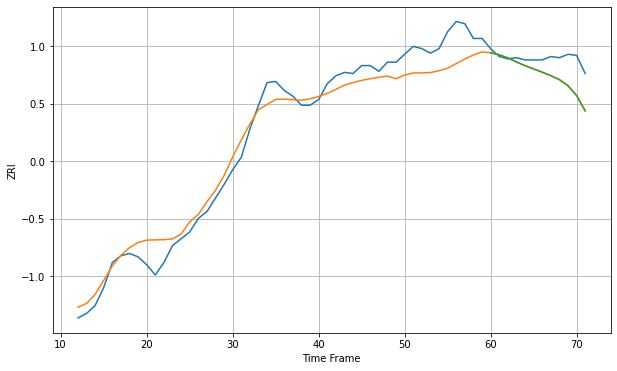

Wall time: 7.51 s
76015 14.936405428600807 18.31353442746572 18.30016785415161 [1276.30751289 1274.55416731 1271.82162117 1268.19366363 1264.97419779
 1262.03945167 1259.1979411  1256.09795395 1252.5574488  1247.21144272
 1238.54742965 1224.99323622]

Got an mse at 0.0099 in round 37 and stopped training

60 60 12


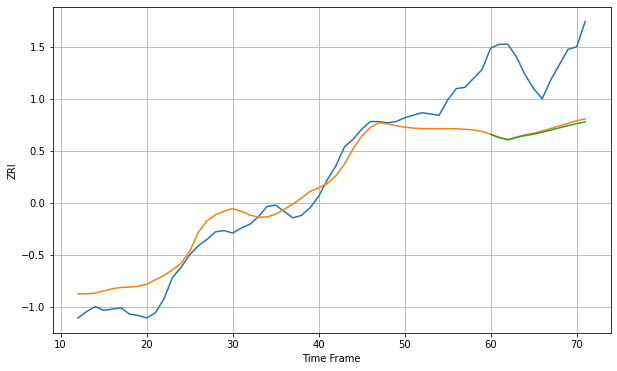

Wall time: 8.38 s
76017 16.935034847233275 58.04175965728465 58.98569546654 [1005.88215792 1003.35490205 1001.6128646  1003.44916279 1004.93324567
 1006.06763595 1007.60151034 1009.27983445 1011.07850021 1012.73928068
 1014.36589009 1015.69015133]

Got an mse at 0.0098 in round 66 and stopped training

60 60 12


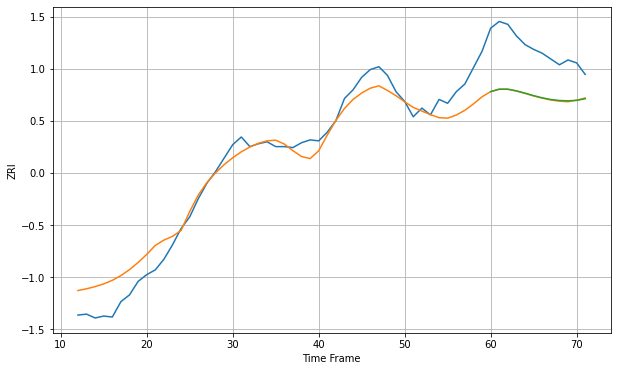

Wall time: 9.98 s
76039 18.711155260592946 51.179427651798534 50.97891671964438 [1234.11365602 1236.65690541 1236.64742658 1234.9217686  1232.51118866
 1229.92244415 1227.70222312 1225.9320751  1224.9088648  1224.57421645
 1225.05387529 1226.77147391]

Got an mse at 0.0099 in round 50 and stopped training

60 60 12


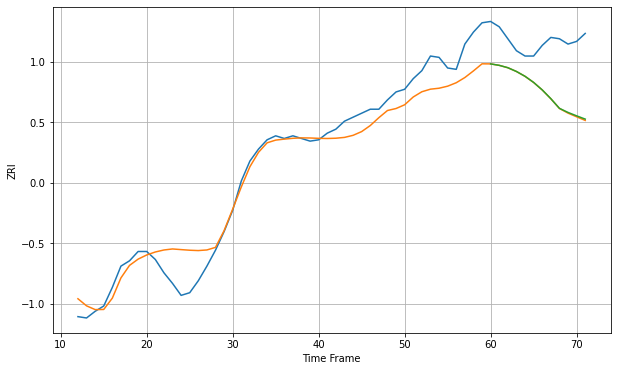

Wall time: 10.1 s
76051 14.340341255757636 40.2116798011479 39.907281074329994 [1375.08243809 1374.00092224 1372.22591925 1369.38944403 1365.76956256
 1361.15954681 1355.53207653 1348.9446313  1341.66706601 1338.59018027
 1336.02105323 1333.5681837 ]

Got an mse at 0.0100 in round 92 and stopped training

60 60 12


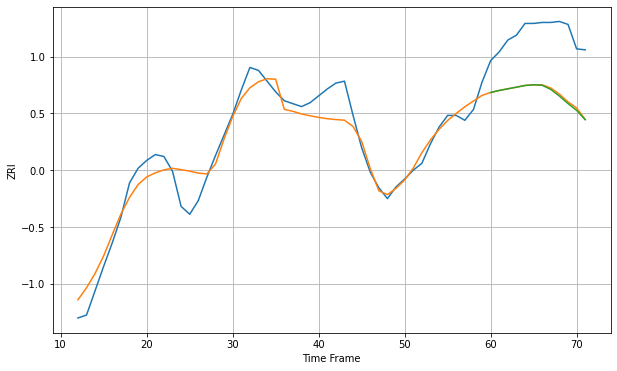

Wall time: 8.95 s
76107 16.831935747815372 61.18065853940981 61.980254678602805 [1300.40836073 1302.49794841 1304.168461   1305.84481244 1307.56571297
 1308.29534025 1307.76360365 1303.56332962 1296.73859491 1289.12029995
 1282.15748999 1272.6196391 ]

Got an mse at 0.0099 in round 85 and stopped training

60 60 12


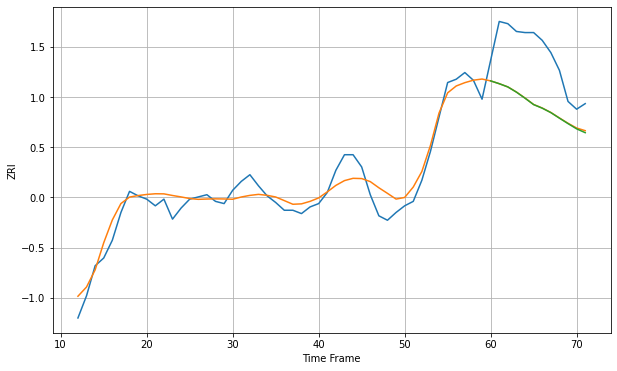

Wall time: 8.19 s
76108 11.55948237296145 47.51131735430474 47.708588226852214 [1136.49051565 1133.96801698 1131.05060331 1126.36117912 1120.89736846
 1115.14071733 1111.93232612 1107.93530808 1102.93441193 1098.0172188
 1093.30464251 1089.85975099]

Got an mse at 0.0097 in round 75 and stopped training

60 60 12


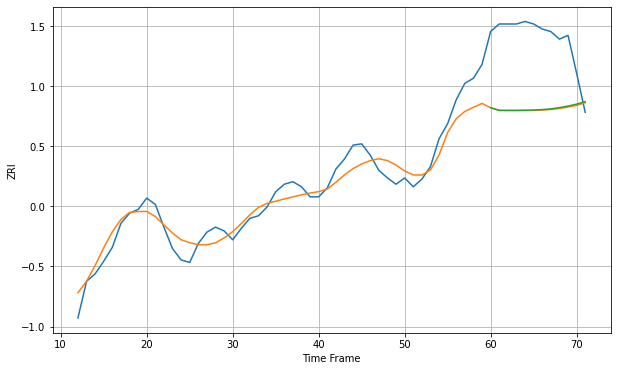

Wall time: 8.39 s
76116 11.488451163587918 59.37148667786069 59.102638765705365 [1144.62763915 1142.53802709 1142.4956855  1142.51330329 1142.61779183
 1142.76168961 1143.1636023  1143.73551958 1144.6939238  1145.95388689
 1147.458792   1149.43791596]

Got an mse at 0.0100 in round 74 and stopped training

60 60 12


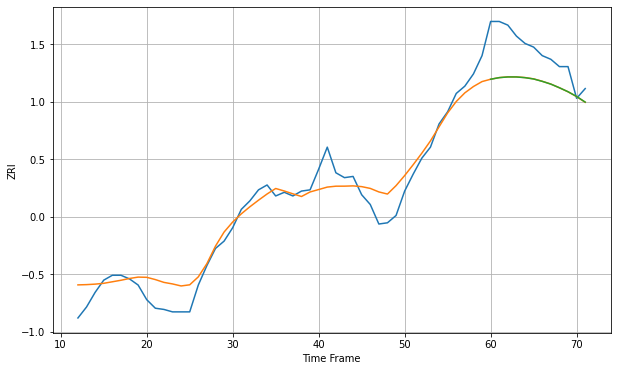

Wall time: 7.91 s
76132 13.662144127323954 29.49812137934894 29.53053841145953 [1277.65220382 1278.96483732 1279.5277148  1279.51027127 1278.93160582
 1277.86060926 1275.92610355 1273.65934918 1270.66572702 1267.42260591
 1263.51832307 1258.91125441]

Got an mse at 0.0098 in round 89 and stopped training

60 60 12


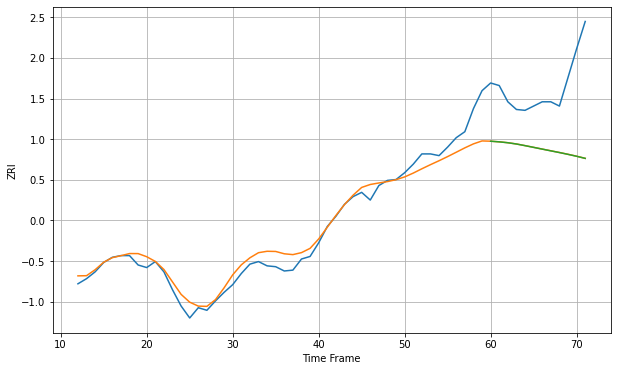

Wall time: 8.07 s
76133 14.415242136680348 79.47307388618836 79.51889449777399 [998.8562714  998.12486873 997.0600307  995.59503237 993.67916015
 991.65766904 989.61464756 987.58641907 985.58716844 983.4732766
 981.23186269 978.7698174 ]

Got an mse at 0.0099 in round 67 and stopped training

60 60 12


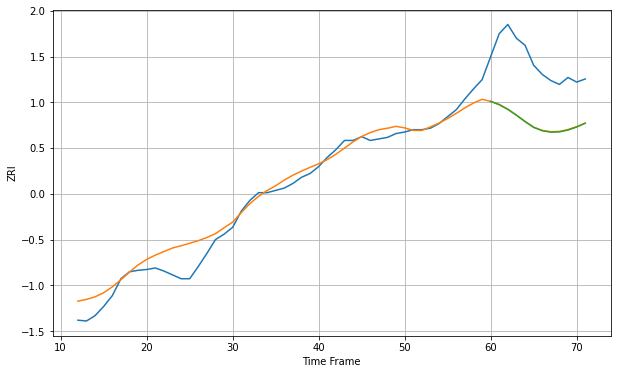

Wall time: 7.64 s
76137 16.329012081965097 79.18115266606272 79.41899391442962 [1247.89506463 1243.66556387 1237.52577642 1229.8868325  1221.61598661
 1214.071989   1209.68129705 1207.78389303 1208.14641465 1210.5803995
 1214.49507612 1219.47269391]

Got an mse at 0.0099 in round 276 and stopped training

60 60 12


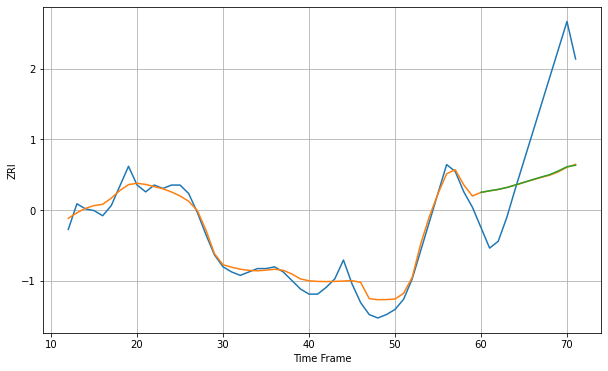

Wall time: 12.7 s
76522 5.253724522413385 45.77979784425268 45.67095047952662 [615.71226139 616.63187267 617.44494965 618.58062582 620.04169642
 621.61165903 623.17665975 624.69837012 626.1461872  628.29987167
 630.7473114  631.62046248]

Got an mse at 0.0099 in round 273 and stopped training

60 60 12


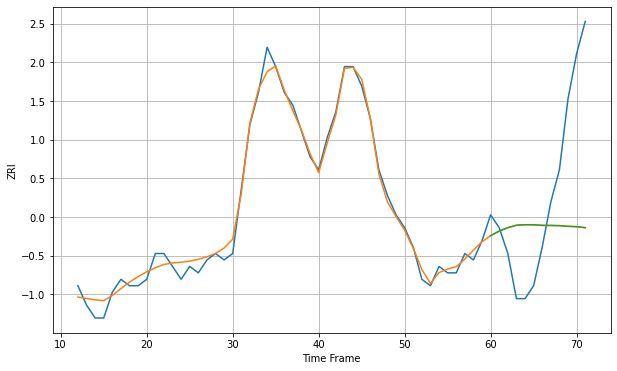

Wall time: 13.9 s
76543 1.3057498504336056 14.753691401868645 14.754832930891816 [590.77116743 591.4811592  592.00727163 592.38838925 592.4659204
 592.46201585 592.36455093 592.35633824 592.32595059 592.21841634
 592.15884277 592.00904047]

Got an mse at 0.0099 in round 107 and stopped training

60 60 12


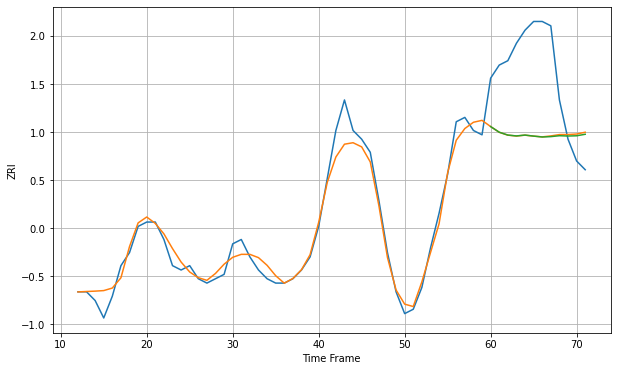

Wall time: 10.2 s
76549 2.678975656015214 18.00629100554722 17.998184599335808 [677.89345172 676.60030658 675.94808371 675.75243985 675.94781962
 675.70966198 675.50752434 675.59122407 675.79727652 675.72771865
 675.78247377 676.12929812]
60 60 12


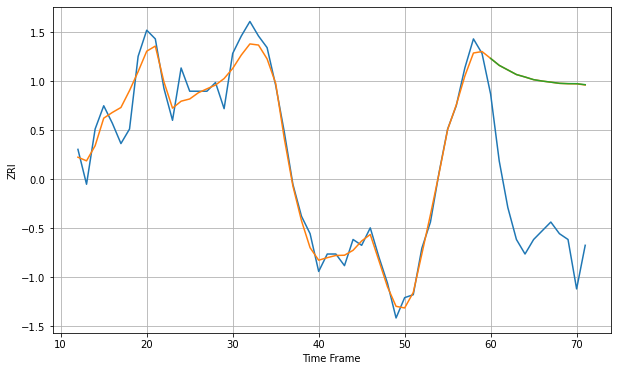

Wall time: 19.9 s
77004 4.856206941192297 51.60031092047638 51.62243871390771 [1410.28485325 1407.89741762 1406.32398313 1404.74570555 1403.89482669
 1402.979306   1402.50044781 1402.12498714 1401.72562402 1401.615601
 1401.59607348 1401.24969685]

Got an mse at 0.0100 in round 212 and stopped training

60 60 12


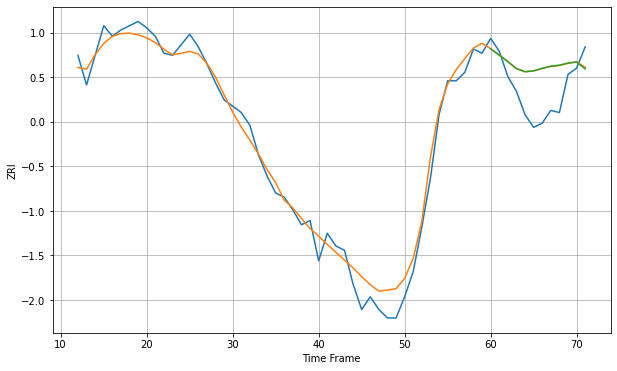

Wall time: 11.3 s
77006 6.1277550715060904 15.895633731041867 15.989619437576035 [1424.10412822 1421.13229262 1418.0453278  1414.75504923 1413.28009272
 1413.66779522 1414.89590036 1415.88207197 1416.37505189 1417.36166732
 1417.83544569 1414.57372002]

Got an mse at 0.0100 in round 322 and stopped training

60 60 12


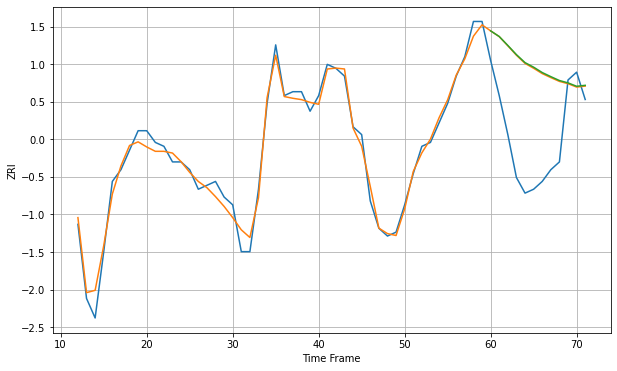

Wall time: 13.3 s
77007 2.3791474007137197 21.655864733631983 21.812963591327577 [1492.58664811 1491.14546932 1488.85236632 1486.50116108 1484.45538142
 1483.28453511 1481.90791589 1480.85901506 1479.86375302 1479.26096612
 1478.38778792 1478.63164057]

Got an mse at 0.0100 in round 226 and stopped training

60 60 12


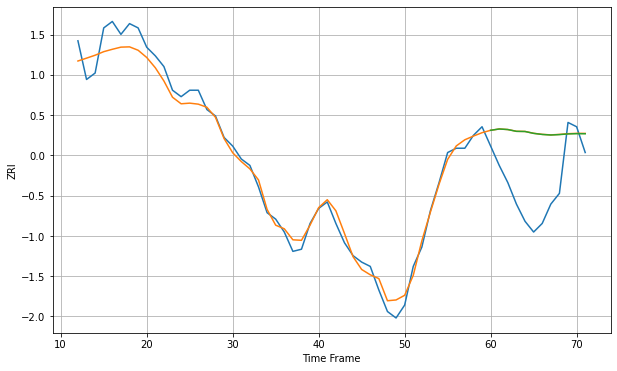

Wall time: 11.8 s
77019 5.357465563500188 28.26432517987534 28.233059071461096 [1412.34929221 1412.95981912 1412.69552735 1411.86399401 1411.78454978
 1410.91873006 1410.41390972 1410.15716062 1410.34978287 1410.66008743
 1410.77499741 1410.73965521]

Got an mse at 0.0099 in round 499 and stopped training

60 60 12


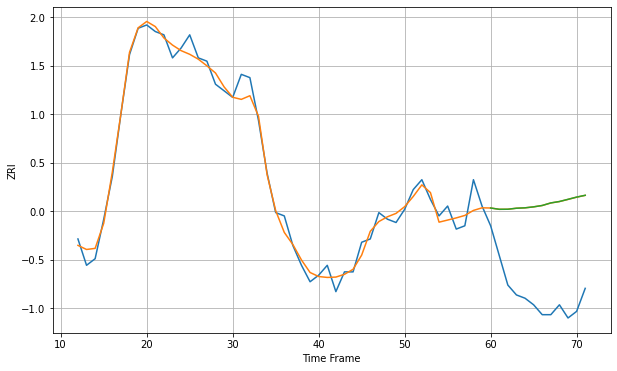

Wall time: 21.3 s
77027 3.060093576208529 28.31327162633185 28.326150491864546 [1437.40222684 1437.00874863 1437.02749256 1437.3342522  1437.45527285
 1437.75398898 1438.16966076 1438.94699258 1439.37628146 1440.0384271
 1440.7159764  1441.26848817]

Got an mse at 0.0099 in round 75 and stopped training

60 60 12


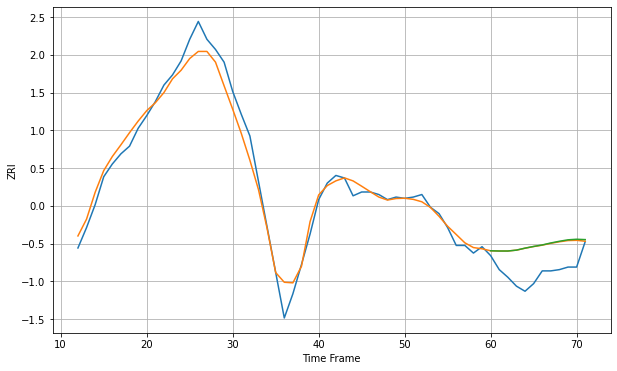

Wall time: 8.85 s
77042 9.170059709017492 21.749891713059206 21.96328601358619 [1167.80223829 1167.61900895 1167.61795424 1168.32026687 1169.87713949
 1171.20641201 1172.3876011  1173.9400684  1175.2766117  1176.41564255
 1176.86856926 1176.58547778]

Got an mse at 0.0099 in round 80 and stopped training

60 60 12


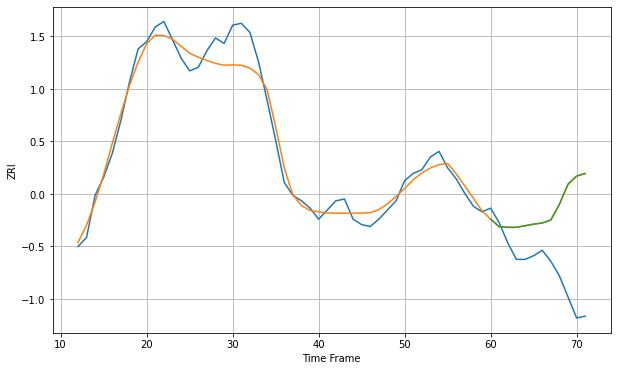

Wall time: 8.62 s
77054 7.645600013607073 39.92737258383785 40.03217857711638 [1247.98067517 1243.8645042  1243.50826257 1243.52621246 1244.37704176
 1245.27051176 1245.9152418  1247.5590823  1256.22210894 1267.20516945
 1271.57442757 1272.97112375]

Got an mse at 0.0100 in round 366 and stopped training

60 60 12


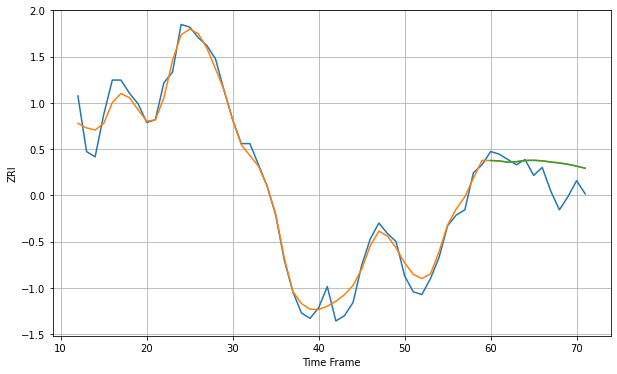

Wall time: 15.5 s
77056 4.396575128014955 7.995123788216248 7.992732406472388 [1452.61691753 1452.44839876 1451.96732145 1452.17518603 1452.61772601
 1452.69858546 1452.494697   1452.02979664 1451.69410374 1451.17904178
 1450.46967977 1449.71463605]

Got an mse at 0.0098 in round 192 and stopped training

60 60 12


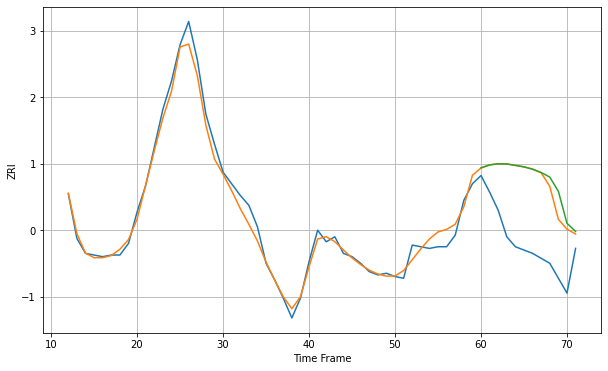

Wall time: 10.5 s
77057 5.241622872102301 38.94234692339041 41.38225819821555 [1444.58564651 1446.3907855  1447.09360246 1446.9619895  1446.11256948
 1445.18092574 1443.8069658  1441.79389104 1439.05982102 1430.440997
 1411.17959766 1406.23602448]

Got an mse at 0.0099 in round 99 and stopped training

60 60 12


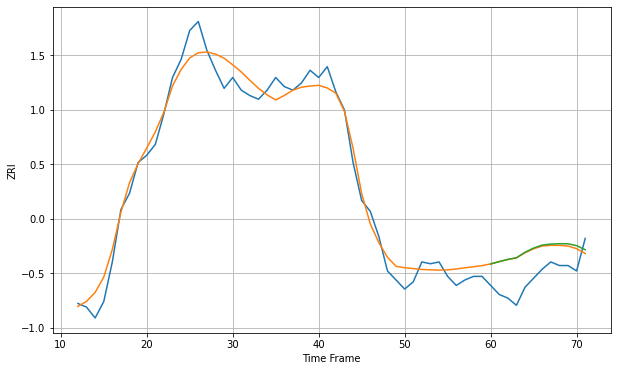

Wall time: 8.8 s
77063 7.731932484764069 15.695266919760526 15.999572483784126 [1273.87143709 1275.17316395 1276.37227439 1277.28799693 1280.36344747
 1282.67009975 1284.32056586 1284.87870852 1285.06155251 1285.02688883
 1283.9942636  1281.75661663]

Got an mse at 0.0099 in round 76 and stopped training

60 60 12


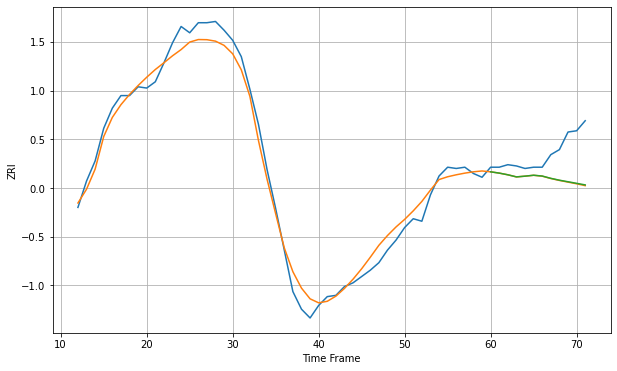

Wall time: 7.72 s
77077 9.162760286504101 24.6831995705244 24.456907085963184 [1186.32058749 1185.30178107 1183.966624   1182.28636848 1182.88078928
 1183.61030875 1182.97085032 1181.14124129 1179.66666456 1178.41778563
 1177.17879211 1175.90793748]

Got an mse at 0.0100 in round 316 and stopped training

60 60 12


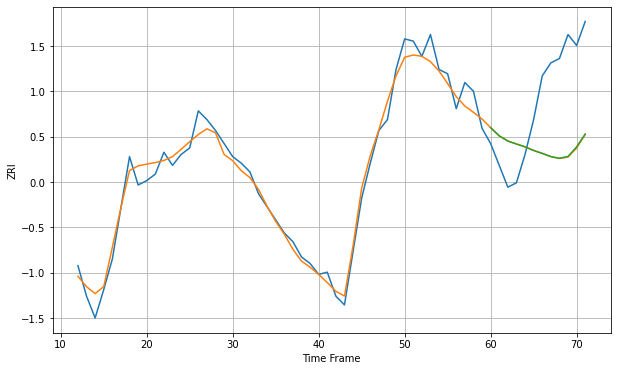

Wall time: 17.2 s
77090 5.324063552945672 34.740222800092326 34.607755153980776 [964.28178038 960.51911884 958.16021077 956.78659156 955.48833414
 953.82428137 952.48236411 951.01591604 950.2518922  951.07480444
 955.48922881 961.36251136]

Got an mse at 0.0099 in round 188 and stopped training

60 60 12


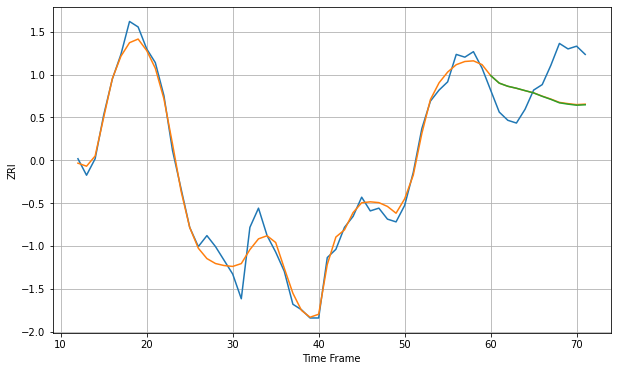

Wall time: 13.1 s
77098 3.958159764116768 13.867500192187592 13.975835841731957 [1497.30756959 1494.53768656 1493.39565154 1492.67380456 1491.8123568
 1490.97542533 1489.73530553 1488.62986707 1487.36709743 1486.88501073
 1486.49524612 1486.65111052]

Got an mse at 0.0099 in round 67 and stopped training

60 60 12


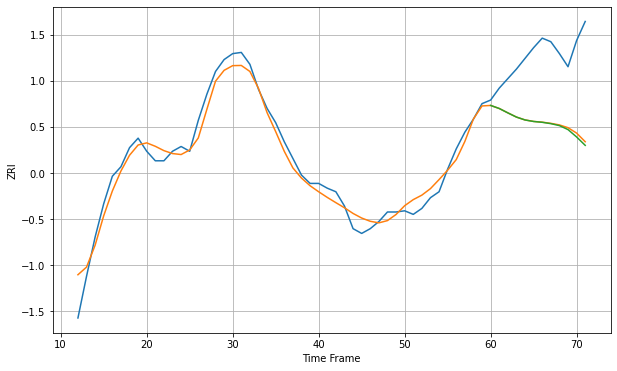

Wall time: 7.84 s
77380 9.475410748012354 58.73813801691947 59.74783915818918 [1412.48034733 1409.91870108 1406.24175596 1402.70833192 1400.28432568
 1399.00724502 1398.32434665 1397.18825196 1395.54669651 1392.19419088
 1385.99659974 1378.96791484]

Got an mse at 0.0099 in round 40 and stopped training

60 60 12


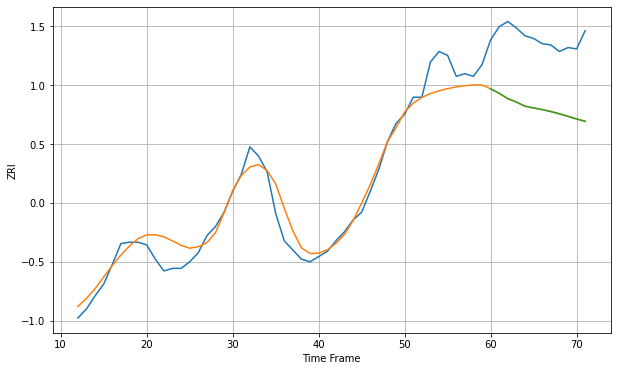

Wall time: 6.3 s
77429 11.883427985488105 53.45226617561009 53.533028895132354 [1193.44849564 1189.94770166 1185.92507253 1183.27357577 1180.10662899
 1178.75976649 1177.51479396 1175.99586514 1174.26814639 1172.26546023
 1170.29570587 1168.48290254]

Got an mse at 0.0099 in round 136 and stopped training

60 60 12


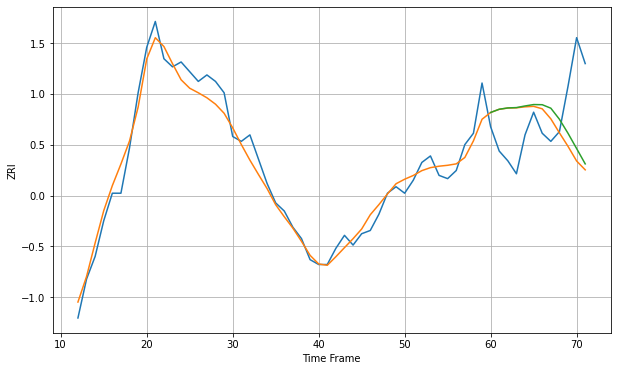

Wall time: 10.1 s
77494 8.160549981439539 36.1287624410236 34.113645054438116 [1263.83888616 1265.82636376 1266.63979235 1266.84483948 1267.84981099
 1268.71868535 1268.622063   1266.47384602 1259.65506178 1250.97745351
 1241.56137175 1232.10691327]

Got an mse at 0.0097 in round 55 and stopped training

60 60 12


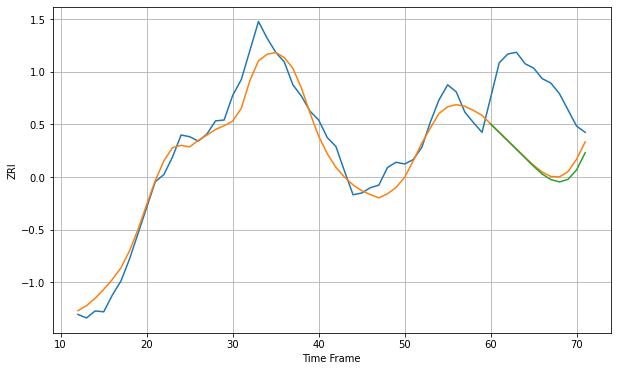

Wall time: 7.62 s
77550 16.934461190486733 86.80057152811945 89.45687563875119 [1149.54251765 1139.90436438 1130.36084392 1120.76271217 1111.00545426
 1101.39781014 1092.60945583 1086.30733703 1083.61905559 1086.51584185
 1097.3776488  1116.89594897]

Got an mse at 0.0098 in round 47 and stopped training

60 60 12


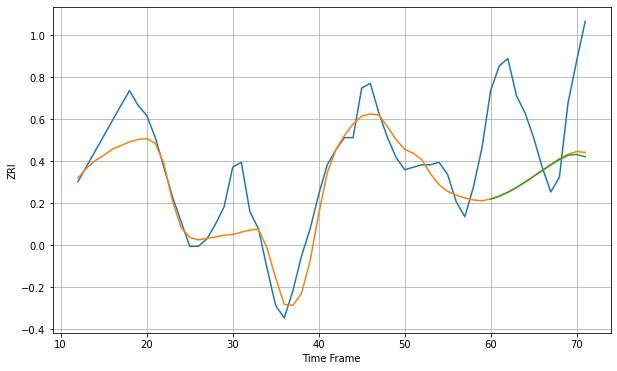

Wall time: 7.4 s
77584 10.090288608892067 35.131953223580346 35.47197514044389 [1397.1148316  1398.28292127 1399.8784693  1401.79428286 1403.96497468
 1406.30107802 1408.64657004 1410.93548245 1413.15438885 1414.84114004
 1415.20787391 1414.22988405]

Got an mse at 0.0099 in round 75 and stopped training

60 60 12


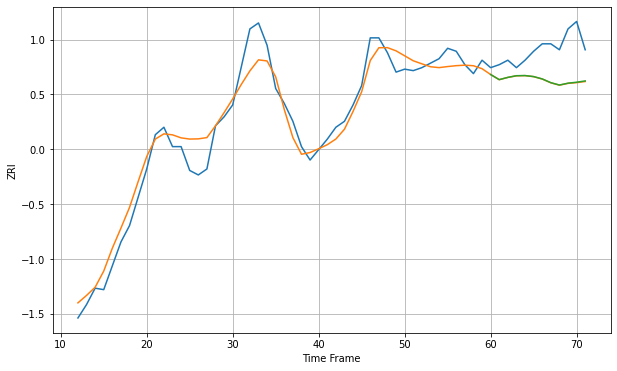

Wall time: 8.12 s
77598 10.692038969114998 22.301243147442307 22.17161349874829 [1116.38894697 1112.950378   1114.48676411 1115.59268032 1115.70151223
 1115.01183632 1113.43991073 1110.9319564  1109.33548423 1110.58755661
 1111.22580002 1112.09002776]

Got an mse at 0.0098 in round 358 and stopped training

60 60 12


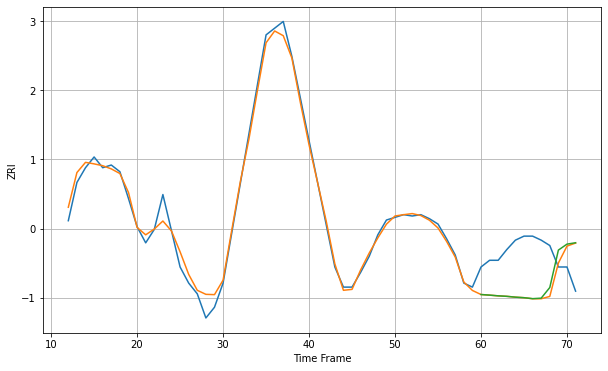

Wall time: 19.4 s
77840 5.632381562978002 34.13941364999625 33.78058177941618 [848.47844631 848.03319615 847.50185151 847.12864902 846.51302956
 846.12021594 845.39251323 845.77615803 853.70421439 881.59101082
 886.04084512 887.06874923]

Got an mse at 0.0099 in round 103 and stopped training

60 60 12


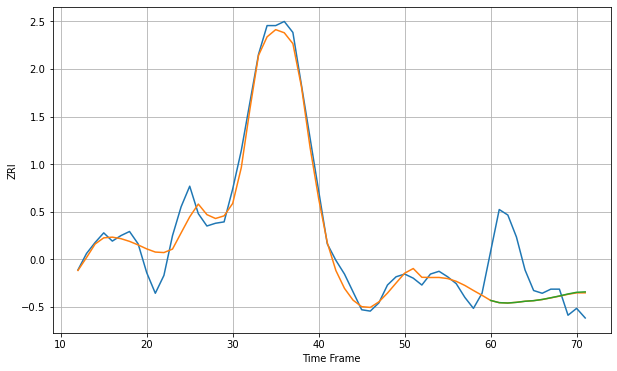

Wall time: 9.67 s
77845 8.993598193023015 33.67680091327754 33.73430165641551 [957.76670834 956.1572024  955.88634707 956.38639625 957.16704885
 957.61422715 958.48674349 959.71735862 961.03157357 962.48802907
 963.70399618 964.0164673 ]

Got an mse at 0.0100 in round 87 and stopped training

60 60 12


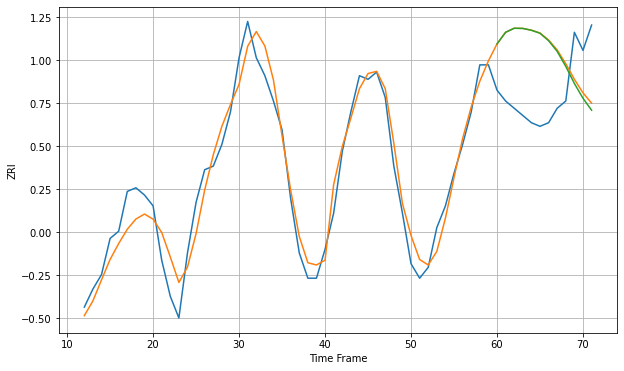

Wall time: 9.08 s
78130 5.310261124026162 19.53384627507866 19.773772667156674 [1158.79732523 1162.00701826 1163.1239493  1163.07136477 1162.56224572
 1161.73213297 1159.6770123  1156.7155531  1152.56630381 1147.84964509
 1143.75328949 1140.46134255]
60 60 12


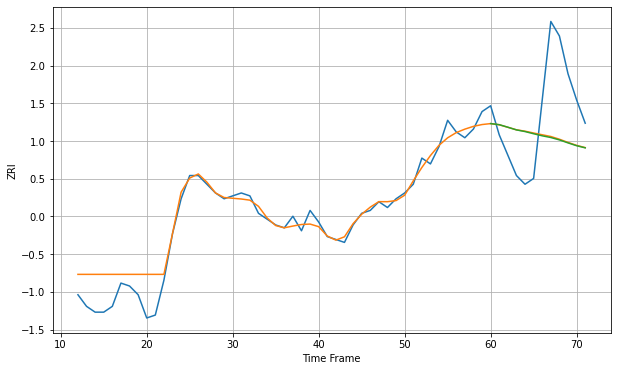

Wall time: 18.6 s
78201 5.175390972493602 20.016441553261682 20.128511093266383 [885.8660973  885.49906657 884.622542   883.70096622 883.12672162
 882.37260537 881.66537067 881.07947957 880.25601762 879.23003004
 878.25882932 877.52725818]

Got an mse at 0.0098 in round 145 and stopped training

60 60 12


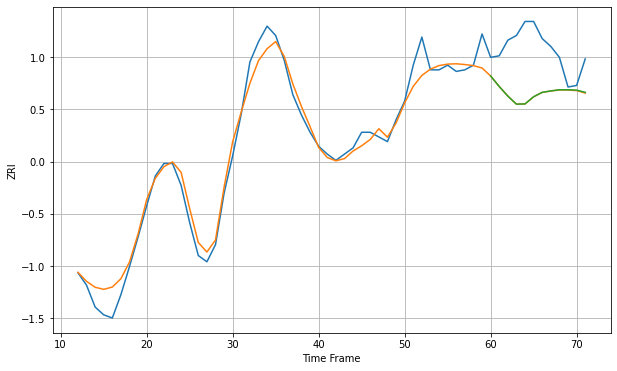

Wall time: 10.1 s
78209 8.473162798082539 31.366807867027124 31.30553614071886 [1240.04851149 1233.33071199 1227.1873012  1222.0317208  1222.15940506
 1226.76699234 1229.59890331 1230.49767337 1231.24535662 1231.24553395
 1231.00276375 1229.60432752]

Got an mse at 0.0099 in round 126 and stopped training

60 60 12


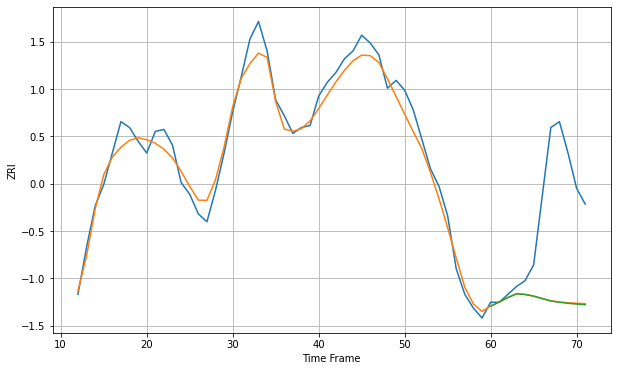

Wall time: 9.16 s
78210 6.591903946081604 50.888105253899305 51.032240635262816 [936.02450372 938.1530603  940.38393304 942.30065068 941.98426404
 941.13655421 939.89467817 938.68731407 937.99758249 937.47017173
 937.08386259 936.77581698]

Got an mse at 0.0099 in round 167 and stopped training

60 60 12


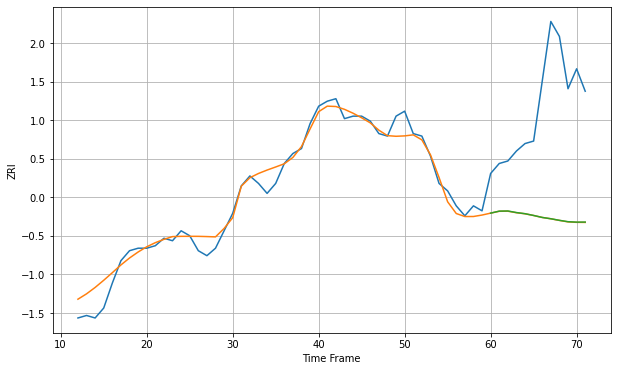

Wall time: 11.6 s
78212 4.51459262743019 47.841731323514665 47.79199329435985 [893.07840145 893.87900466 893.94283421 893.30809888 892.85123935
 892.14105662 891.3470695  890.82512294 890.1944258  889.63773365
 889.46515266 889.49322951]

Got an mse at 0.0098 in round 464 and stopped training

60 60 12


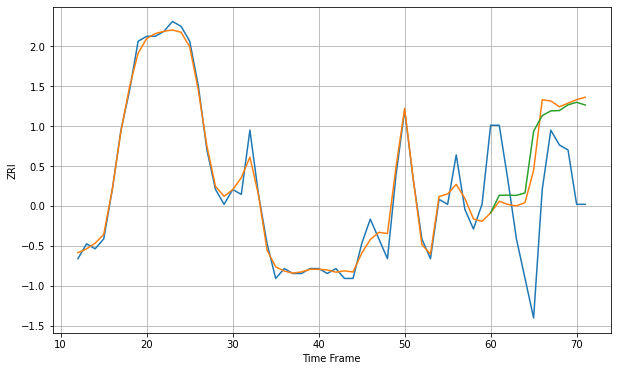

Wall time: 18.7 s
78213 1.990436118599254 16.280569780925333 17.153783621364926 [921.2764632  924.82712286 924.8527686  924.80118418 925.31665009
 937.78807431 940.95402457 941.90338725 941.97313055 943.13515424
 943.64383552 943.09377136]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


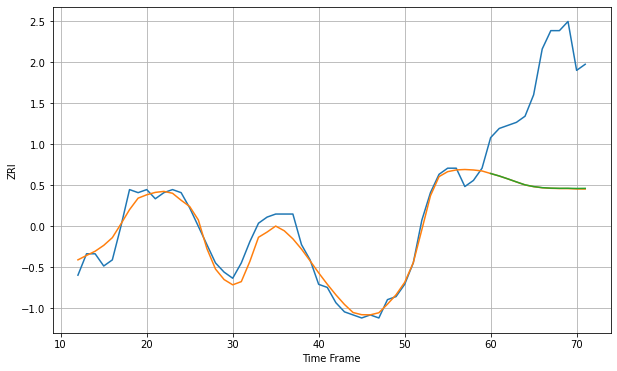

Wall time: 7.89 s
78216 3.3451669403380966 36.53967169422192 36.4734251258933 [973.25731681 972.4499922  971.50606732 970.51162525 969.5477744
 968.98678602 968.63204674 968.46959041 968.41514436 968.43224416
 968.36465794 968.40019219]

Got an mse at 0.0100 in round 110 and stopped training

60 60 12


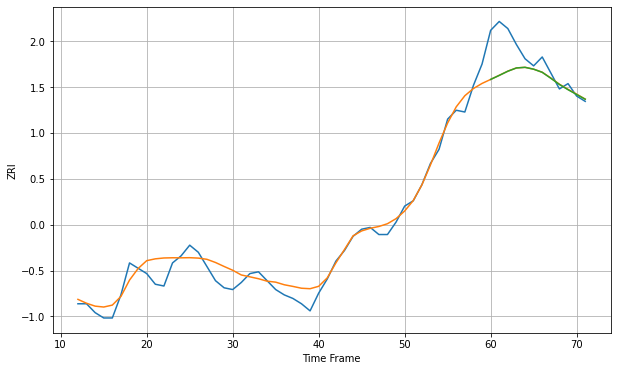

Wall time: 8.48 s
78229 6.199439661768598 14.613863344571504 14.629988963307863 [1035.35217737 1037.62176394 1039.97735111 1041.82049392 1042.16725296
 1041.12137627 1039.37088356 1036.01568092 1032.5020488  1029.57900436
 1026.87802105 1024.19402677]

Got an mse at 0.0100 in round 240 and stopped training

60 60 12


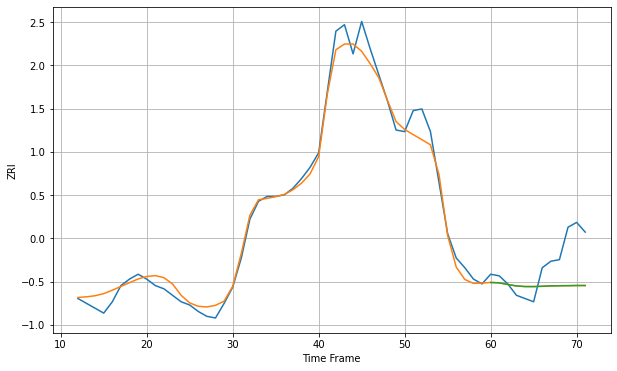

Wall time: 12.4 s
78233 6.656376747578772 19.890163253453323 19.89040370216093 [951.91118093 951.69209261 950.6803983  949.74619534 949.40242969
 949.37530245 949.56575263 949.790387   949.89062756 949.93919103
 950.03711563 950.0273435 ]

Got an mse at 0.0099 in round 96 and stopped training

60 60 12


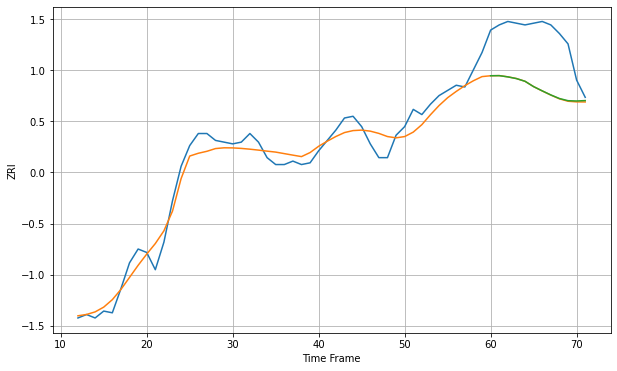

Wall time: 8.86 s
78240 7.00342444894457 31.6815093193735 31.601543931792207 [1086.51066093 1086.57334493 1085.85480558 1084.86239663 1083.30069514
 1080.20267889 1077.74629658 1075.38513497 1073.30810906 1072.05053299
 1071.87499565 1072.11274513]

Got an mse at 0.0100 in round 92 and stopped training

60 60 12


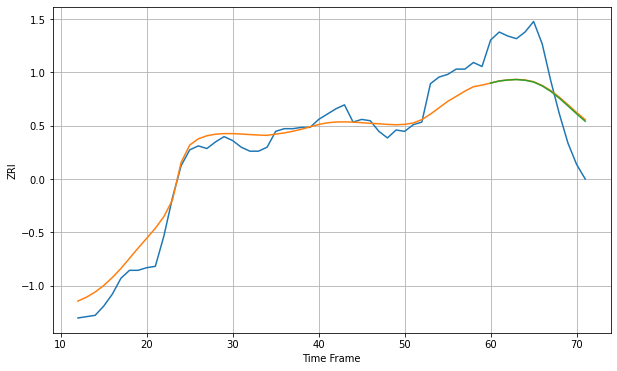

Wall time: 7.86 s
78249 12.071415650450684 33.460291270555736 33.25347617646654 [1120.45743125 1122.03181963 1122.769202   1123.11303859 1122.59687795
 1121.26569158 1118.2891117  1114.16192009 1108.9801378  1103.16994694
 1097.2672629  1091.59226371]

Got an mse at 0.0100 in round 164 and stopped training

60 60 12


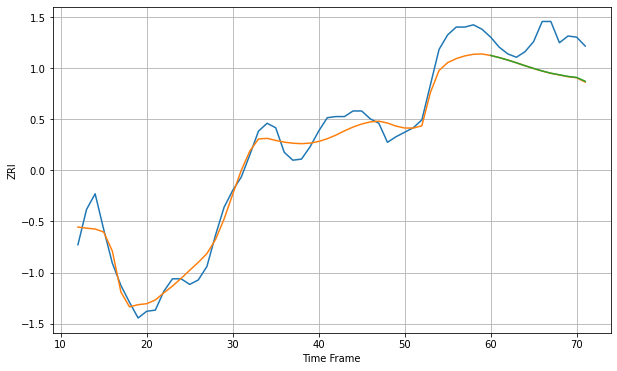

Wall time: 10.5 s
78256 13.628079697960638 28.53181102160834 28.348776545935067 [1217.61610918 1215.72787749 1213.51118975 1211.0633741  1208.47013082
 1206.0295831  1203.75882547 1201.78540414 1200.33944477 1198.87262234
 1197.98392052 1194.59117312]

Got an mse at 0.0098 in round 99 and stopped training

60 60 12


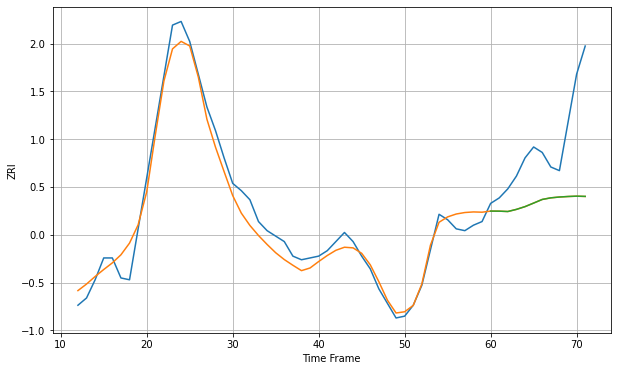

Wall time: 7.98 s
78521 7.263889699149413 36.959525250401306 36.94516665740341 [757.75438343 757.71776903 757.52476506 758.69524471 760.2119237
 762.16452181 764.15332326 765.04188497 765.49753716 765.78327501
 765.96847987 765.84324923]

Got an mse at 0.0099 in round 95 and stopped training

60 60 12


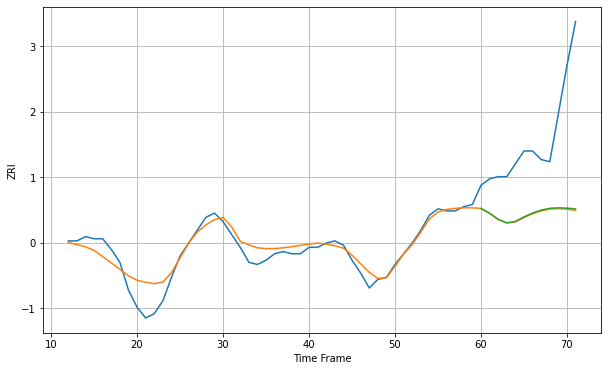

Wall time: 8.54 s
78550 5.160394932574915 39.93553985551699 39.6282160088573 [766.16811967 763.86560978 761.00180243 759.39552305 760.12155684
 762.20195025 764.01248945 765.36372567 766.24024278 766.44717752
 766.29388408 765.94057659]

Got an mse at 0.0099 in round 127 and stopped training

60 60 12


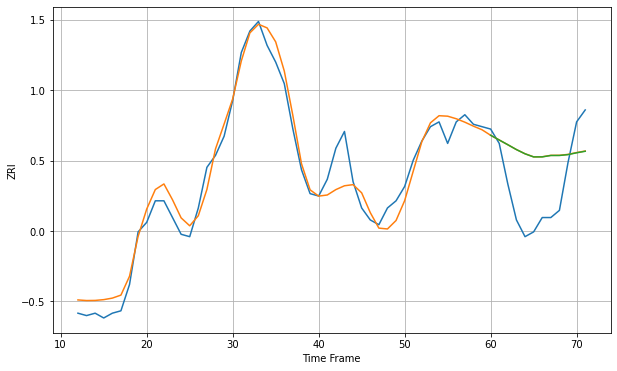

Wall time: 8.7 s
78613 6.590363994260425 21.710329871818214 21.698789921793004 [1295.40275032 1293.42817971 1291.44985223 1289.42024597 1287.65804376
 1286.35320427 1286.3673855  1286.95435942 1286.95571937 1287.31886341
 1288.07378776 1288.71669619]

Got an mse at 0.0099 in round 83 and stopped training

60 60 12


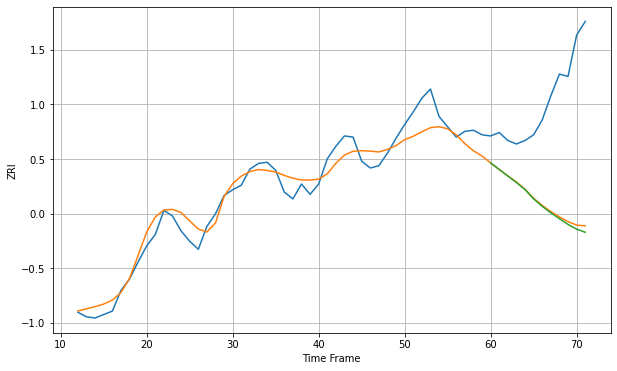

Wall time: 8.34 s
78660 12.47752287760648 98.04688442877358 100.02212567046853 [1263.4133575  1257.66258076 1251.96691075 1246.36807562 1240.08920612
 1232.04668146 1225.55459969 1219.83618917 1214.71636061 1209.72576048
 1205.58313681 1202.89707428]

Got an mse at 0.0100 in round 59 and stopped training

60 60 12


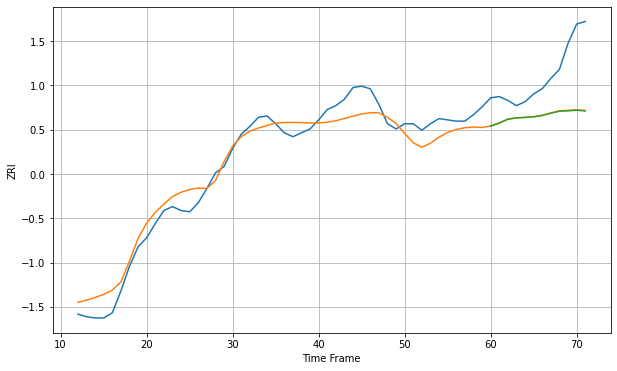

Wall time: 7.78 s
78664 11.024467017788371 36.00860652757632 36.22857382036794 [1152.25124987 1154.51440686 1157.5327172  1158.50466911 1158.92241984
 1159.38512192 1160.39410836 1162.13927449 1163.67136058 1163.97527578
 1164.45464799 1163.89331765]

Got an mse at 0.0099 in round 78 and stopped training

60 60 12


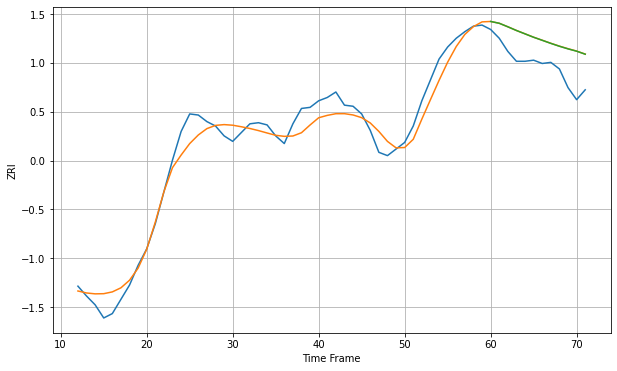

Wall time: 10 s
78666 12.22026524358462 25.924477643906123 25.849917511947037 [1153.29516767 1151.65263526 1148.4372874  1145.06818576 1141.98900649
 1138.88998259 1136.12596647 1133.3184042  1130.688163   1128.30373076
 1126.19888311 1123.44656874]

Got an mse at 0.0099 in round 233 and stopped training

60 60 12


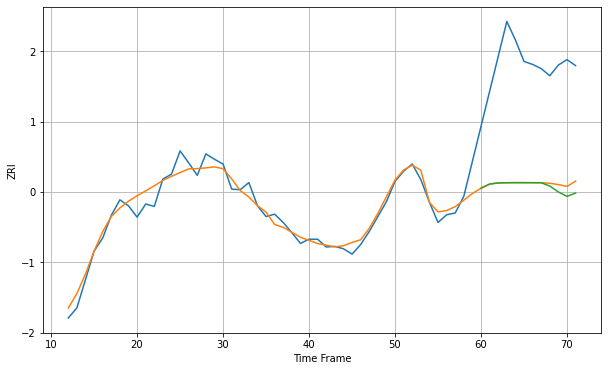

Wall time: 16.7 s
78701 16.04146553665 200.508086193706 205.15378444455527 [2120.48068833 2127.43530134 2129.34739976 2129.62542854 2129.79610391
 2129.74487442 2129.7216433  2129.63416303 2124.15904145 2114.21048463
 2106.86306786 2112.27898526]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


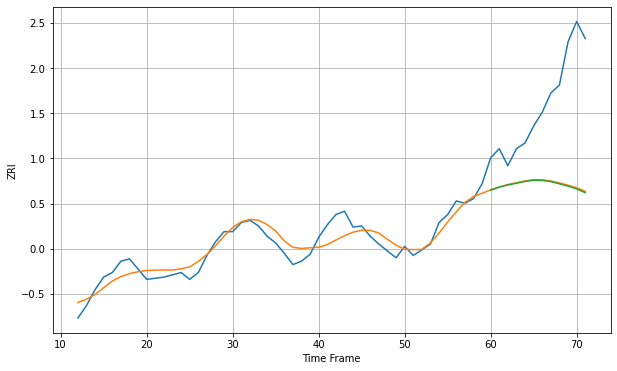

Wall time: 8.26 s
78702 9.105197716594189 81.03785875084351 81.67003606450942 [1601.65317267 1604.12279152 1606.11469309 1607.61114812 1609.20556643
 1610.22470014 1610.09028806 1609.03491524 1607.1145009  1605.0769511
 1602.59524007 1599.3491647 ]

Got an mse at 0.0100 in round 55 and stopped training

60 60 12


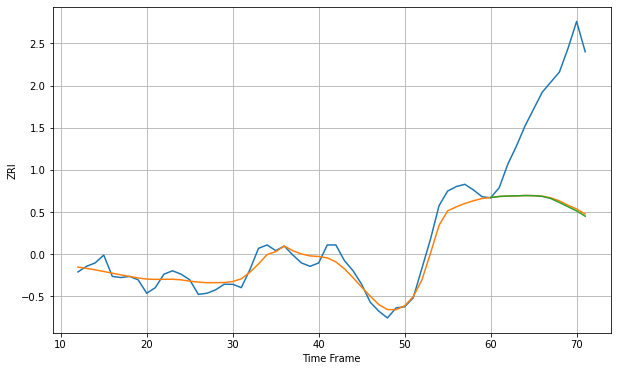

Wall time: 7.19 s
78703 8.623988382754165 97.1260671705393 97.98788222147606 [1813.21714871 1814.19997708 1814.55518172 1814.72594288 1814.99259378
 1814.88443005 1814.26890556 1812.33768689 1808.79681848 1805.06905823
 1801.2994628  1796.61669552]

Got an mse at 0.0100 in round 196 and stopped training

60 60 12


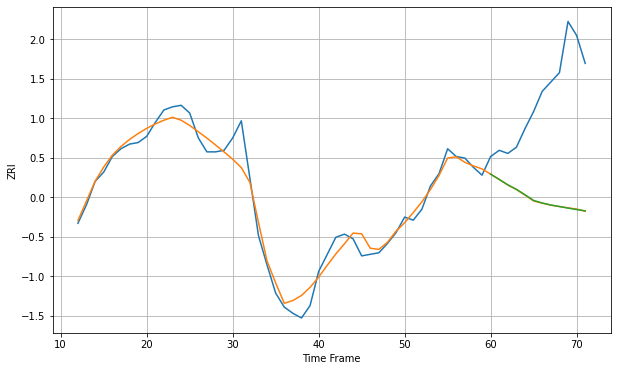

Wall time: 11.6 s
78704 7.470897928072092 71.71459006809278 71.68946718857674 [1520.62063468 1517.24017303 1513.73756238 1510.85060293 1507.36954066
 1503.69853501 1502.06398152 1500.77232495 1499.79527034 1498.77566446
 1497.82987074 1497.00754822]

Got an mse at 0.0099 in round 153 and stopped training

60 60 12


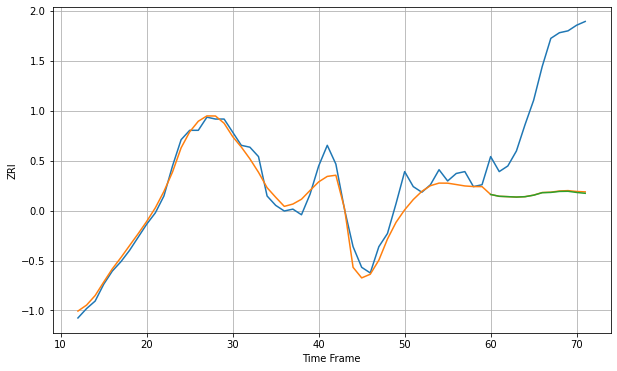

Wall time: 9.97 s
78705 5.888668810637477 62.68790730044834 62.93440859502432 [1520.81080441 1519.83960199 1519.64688683 1519.42974247 1519.63028869
 1520.42512082 1521.76046792 1521.90253114 1522.43039987 1522.50814694
 1521.88883717 1521.43537748]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


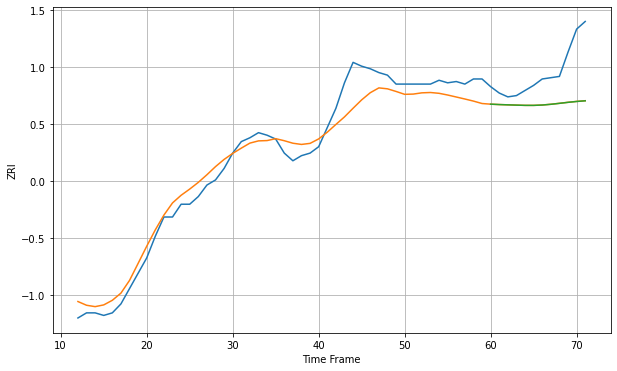

Wall time: 8.18 s
78728 11.865295145280712 29.74429406092277 29.77453692830864 [1210.28733447 1209.98769469 1209.76626104 1209.55104065 1209.35016801
 1209.33486896 1209.6130194  1210.18626631 1210.92850415 1211.71479522
 1212.39471699 1212.9256693 ]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


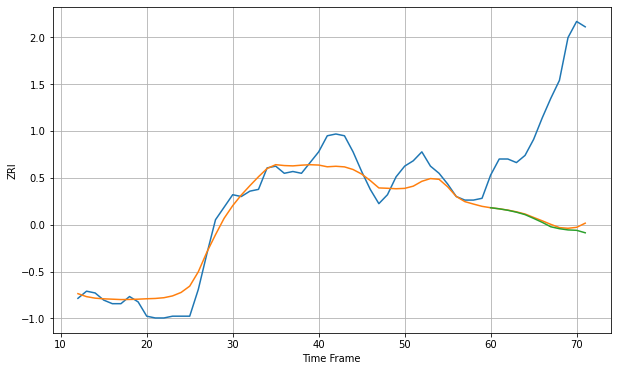

Wall time: 7.35 s
78729 8.278916280069154 69.24532646376389 70.60159833871158 [1201.71805919 1201.10144204 1200.29914258 1199.23104239 1197.87007446
 1195.75735353 1193.53612799 1191.05245309 1189.98345931 1189.29675217
 1189.07649989 1187.69476567]

Got an mse at 0.0098 in round 69 and stopped training

60 60 12


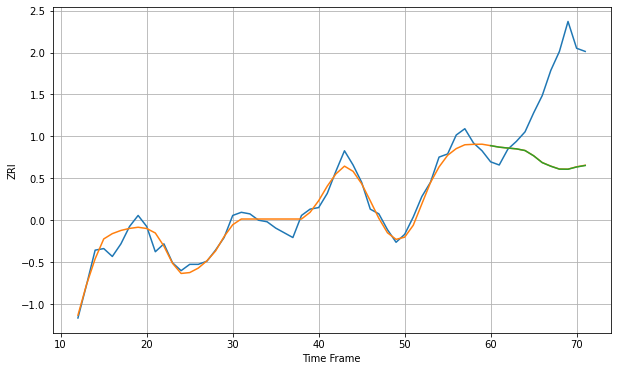

Wall time: 8.49 s
78735 5.40193618534799 51.481196955457264 51.54201961350911 [1538.25872132 1537.3126738  1536.74146646 1536.23084646 1535.15956043
 1531.84435234 1527.51129403 1525.21970797 1523.37432031 1523.30161288
 1524.74069135 1525.66092148]

Got an mse at 0.0099 in round 191 and stopped training

60 60 12


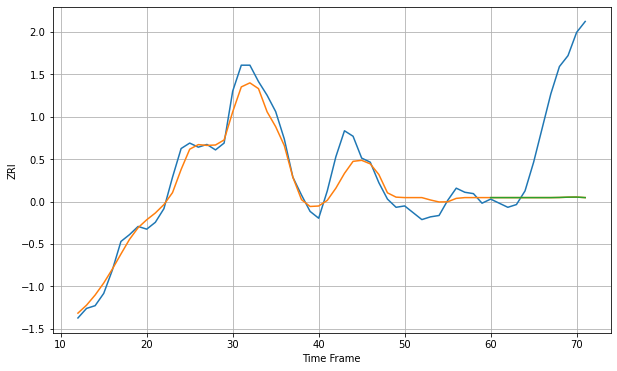

Wall time: 10.8 s
78741 9.771404098105961 70.8292107902557 70.82451182596759 [1280.09526841 1280.09526841 1280.09526841 1280.09526841 1280.09526841
 1280.09526841 1280.09526841 1280.09526841 1280.20306616 1280.41388187
 1280.46965295 1280.09526841]

Got an mse at 0.0099 in round 348 and stopped training

60 60 12


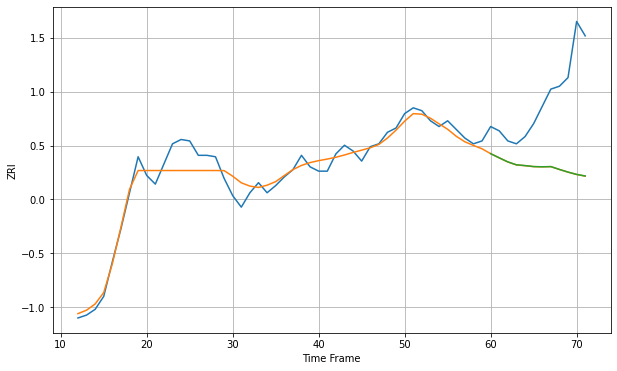

Wall time: 15.6 s
78744 7.686878636083484 54.438813421403594 54.38978419937179 [1264.15713801 1261.25741525 1258.43955786 1256.40906995 1255.87199586
 1255.19703127 1255.0368355  1255.16847309 1253.20854422 1251.35630798
 1249.75084817 1248.64589906]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


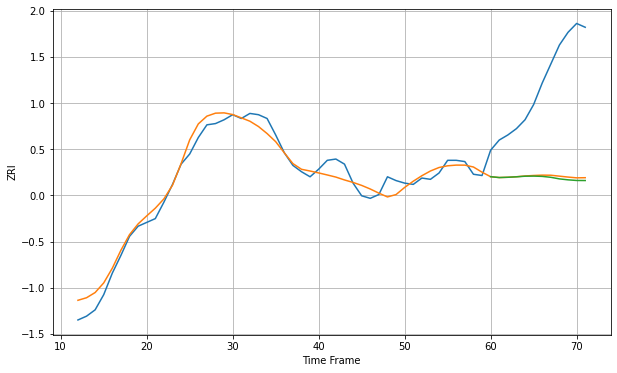

Wall time: 7.21 s
78745 7.541506295600212 78.87315016801836 80.18942977212797 [1263.06743306 1262.40270039 1262.61681757 1262.976867   1263.45307523
 1263.54996969 1263.31920948 1262.59513166 1261.34452309 1260.5961898
 1260.0917063  1260.04359516]

Got an mse at 0.0095 in round 103 and stopped training

60 60 12


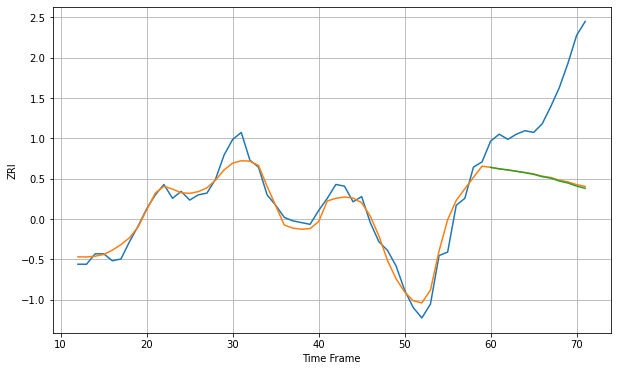

Wall time: 9.81 s
78746 5.934189742616077 49.314508361162446 49.776734683130925 [1539.86744824 1538.99663125 1538.36905252 1537.58443338 1536.8005634
 1535.86062372 1534.48357716 1533.6503764  1531.96007578 1530.81539576
 1529.07488641 1527.76118142]

Got an mse at 0.0099 in round 72 and stopped training

60 60 12


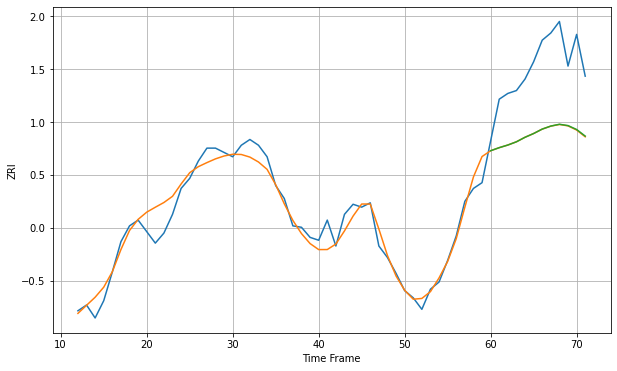

Wall time: 9.54 s
78748 8.806891069392547 49.06822592585506 48.95381038634298 [1335.19332707 1337.32227975 1339.1489415  1341.40033402 1344.53970329
 1347.15309002 1350.23089218 1352.33544059 1353.57377583 1352.66864039
 1349.94929012 1345.3683854 ]

Got an mse at 0.0099 in round 31 and stopped training

60 60 12


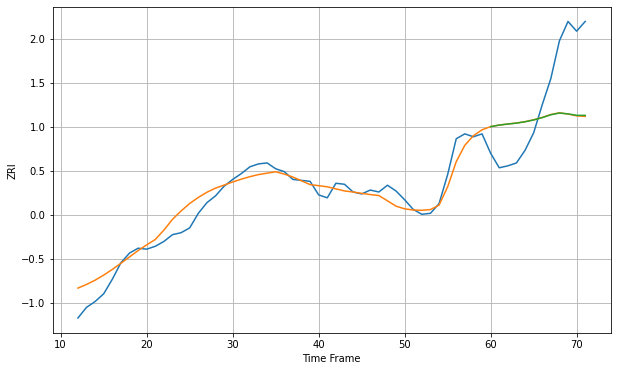

Wall time: 7.45 s
78749 11.887106599293718 58.259051575924985 58.05716165653945 [1300.45940943 1302.07430838 1303.13492023 1304.09733864 1305.46761808
 1307.36166425 1309.74770712 1312.73546862 1314.48037597 1313.6112022
 1312.12863885 1312.09046398]

Got an mse at 0.0097 in round 49 and stopped training

60 60 12


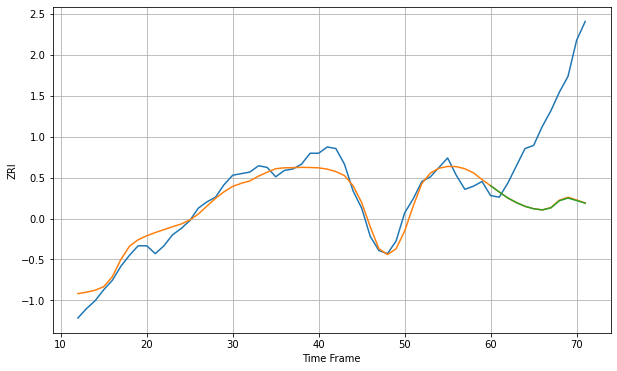

Wall time: 6.75 s
78750 6.887018906133857 61.06194060731264 61.22927555493454 [1282.29245005 1278.29366002 1274.4593853  1271.56403532 1269.15533952
 1267.63152724 1266.85094218 1268.15619224 1272.73562175 1274.43461373
 1272.84896635 1271.18902942]

Got an mse at 0.0100 in round 178 and stopped training

60 60 12


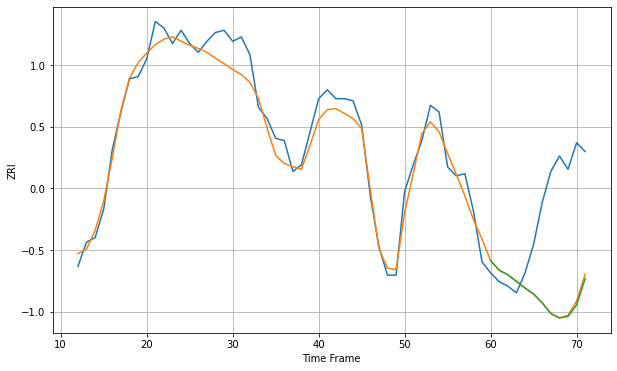

Wall time: 9.95 s
78751 7.0600234046644195 45.556113088704386 46.052338064455256 [1369.5212821  1365.18347595 1363.17570199 1360.1319202  1357.14959675
 1354.44423435 1350.44741998 1345.59724702 1343.57556247 1344.28263636
 1349.50019337 1361.41252149]

Got an mse at 0.0098 in round 71 and stopped training

60 60 12


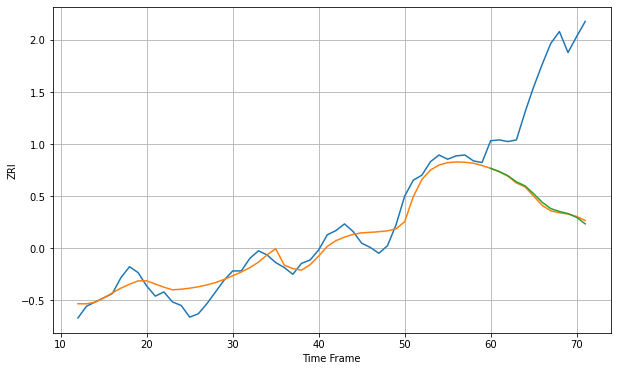

Wall time: 7.19 s
78752 13.920506652686145 154.15932092825486 153.6257110105324 [1314.13772608 1310.30834336 1305.38899434 1298.07900244 1293.25286393
 1283.99665721 1273.76250168 1266.20046365 1262.80298666 1260.28599216
 1255.75582812 1248.02227901]

Got an mse at 0.0100 in round 108 and stopped training

60 60 12


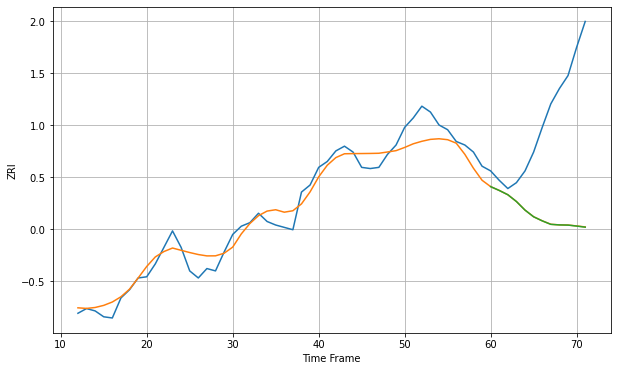

Wall time: 8.34 s
78753 11.159650568263924 93.33693472279988 93.40696117032931 [1132.63175068 1129.3856047  1125.74202864 1119.97367795 1112.66529983
 1106.996441   1103.53392914 1100.56735643 1100.09065232 1099.93467314
 1099.1057201  1098.17272946]

Got an mse at 0.0100 in round 67 and stopped training

60 60 12


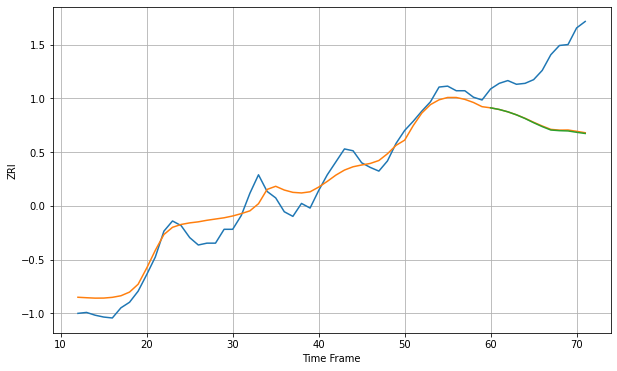

Wall time: 7.95 s
78754 14.48824824908439 71.38504431845062 71.96433285148304 [1216.49181608 1214.71629479 1212.18548088 1208.91123119 1204.95033374
 1200.39131868 1196.1605264  1192.48537431 1191.78061596 1191.47764302
 1190.0135885  1188.73770881]

Got an mse at 0.0099 in round 97 and stopped training

60 60 12


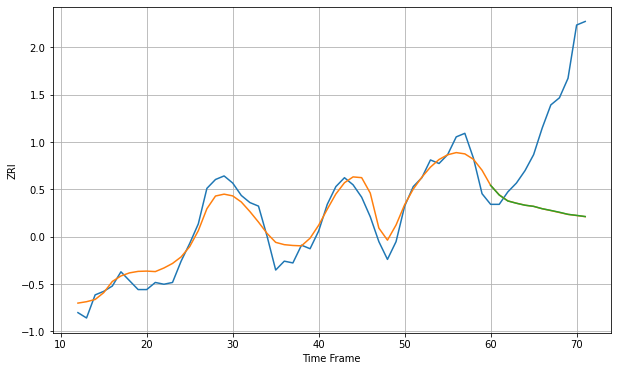

Wall time: 7.89 s
78757 7.389961318388042 58.29740290986979 58.25038841643922 [1270.68295663 1265.24989124 1261.90310266 1260.61964974 1259.5102921
 1258.8642762  1257.53961433 1256.5726575  1255.5519412  1254.37272503
 1253.77162542 1253.13688213]

Got an mse at 0.0100 in round 35 and stopped training

60 60 12


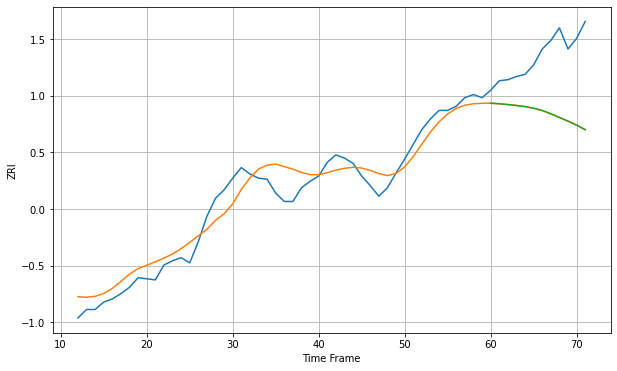

Wall time: 6.81 s
78758 14.220275587935172 58.89522011531819 58.906321390114265 [1320.78388114 1320.31531552 1319.53473972 1318.6673625  1317.64169257
 1316.09298495 1313.99573924 1310.82649871 1307.3639128  1303.88094263
 1300.0618616  1295.7234349 ]

Got an mse at 0.0099 in round 92 and stopped training

60 60 12


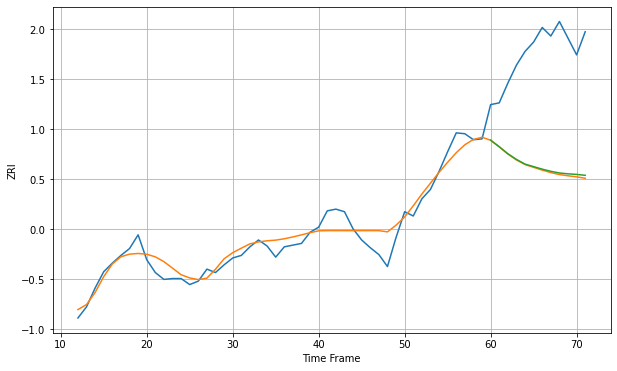

Wall time: 8.86 s
78759 13.434338848480076 136.17504982197957 134.6969651444238 [1486.43442365 1478.83522535 1470.66790256 1464.04171536 1458.55823528
 1455.58731352 1452.67266859 1450.14911706 1448.19248587 1447.20149078
 1446.51475247 1445.49753707]

Got an mse at 0.0100 in round 150 and stopped training

60 60 12


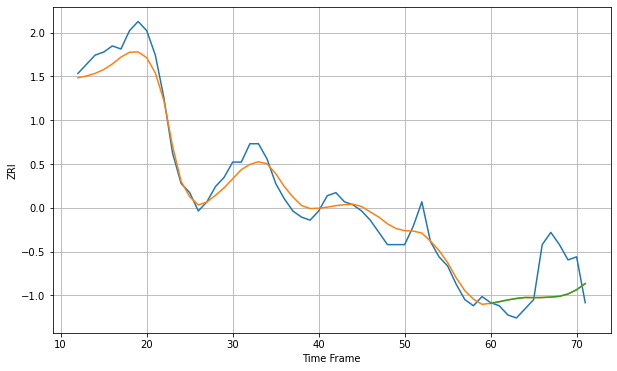

Wall time: 9.54 s
79912 4.36889437013674 10.772437609439796 10.775782162498595 [967.78543355 968.31922217 968.90148039 969.38823923 969.70582253
 969.66058518 969.6917932  969.83486363 970.08715717 970.845491
 972.26422248 974.27363705]

Got an mse at 0.0100 in round 261 and stopped training

60 60 12


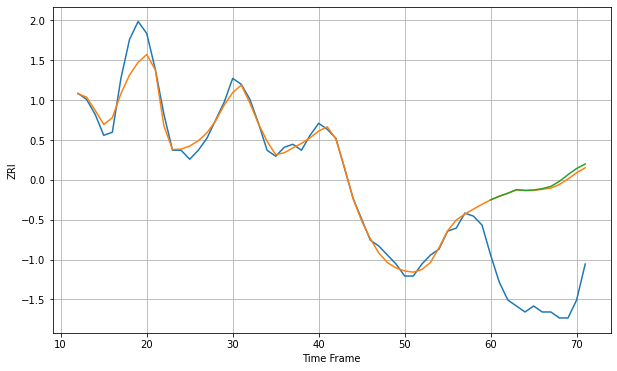

Wall time: 13.2 s
79936 3.6293111749415856 38.11758204326545 38.682914398689526 [916.4398009  917.63250452 918.65652585 919.86269023 919.57813018
 919.72356186 920.1804236  920.93103373 922.62256986 924.84669392
 926.91166719 928.40320362]

Got an mse at 0.0100 in round 40 and stopped training

60 60 12


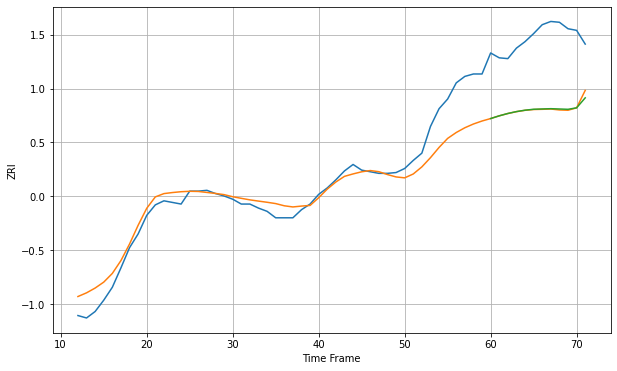

Wall time: 6.79 s
80021 23.803246403210377 89.3299738507405 89.49512829019423 [1535.83294731 1539.21522807 1542.10409097 1544.44672462 1546.17804924
 1547.32509079 1547.70028265 1548.04189585 1547.6679036  1547.28139188
 1549.1017789  1561.46176568]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


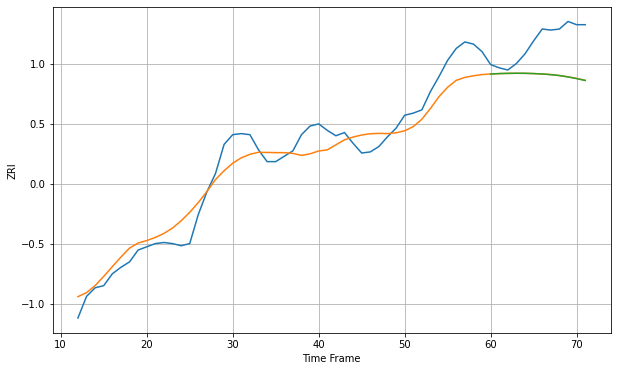

Wall time: 7.27 s
80027 16.336478447538973 34.78832012042373 34.848670791319236 [1605.27806289 1605.66496027 1605.86093257 1605.95577586 1605.90871113
 1605.67772433 1605.29146764 1604.69921223 1603.81755127 1602.55607595
 1601.02019293 1599.27285521]

Got an mse at 0.0098 in round 55 and stopped training

60 60 12


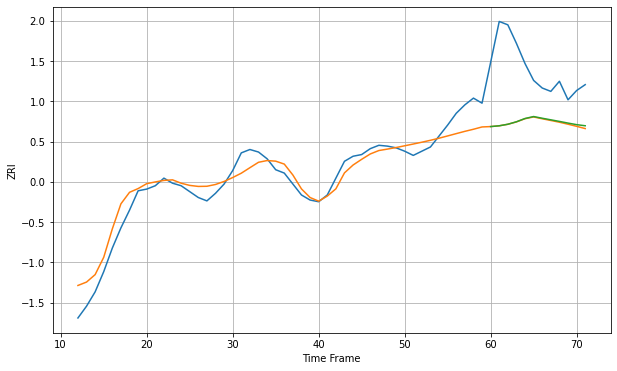

Wall time: 8.51 s
80033 15.880063610871028 70.83607422538111 70.30816789325924 [1254.21370719 1255.15003765 1256.98993273 1259.91945961 1263.81792822
 1266.13455442 1264.11261732 1262.23839361 1260.3539328  1258.36937234
 1256.50534196 1255.1863625 ]

Got an mse at 0.0099 in round 42 and stopped training

60 60 12


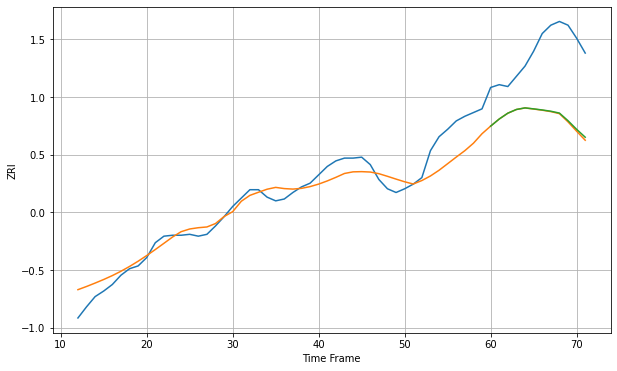

Wall time: 6.75 s
80111 16.333918756251556 74.1667515461185 73.29651968909066 [1577.40550524 1585.05513806 1591.31984387 1595.32752517 1597.0274279
 1595.95888175 1594.79431374 1593.4297463  1591.44072426 1583.23474678
 1573.96701044 1565.47540951]

Got an mse at 0.0097 in round 56 and stopped training

60 60 12


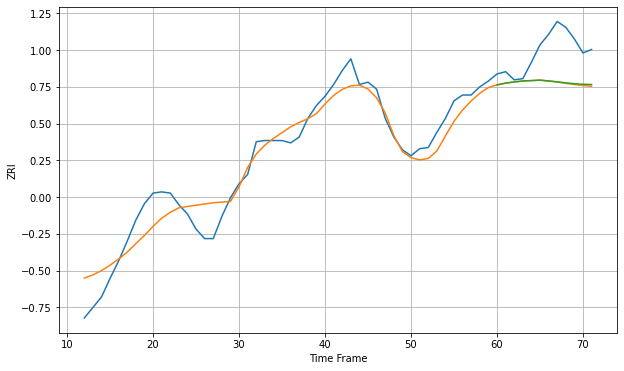

Wall time: 6.75 s
80112 14.961081015157768 30.601697009488177 30.22993282398964 [1775.68983749 1777.19563973 1778.18333741 1779.00487643 1779.36599221
 1779.75781145 1779.04625738 1778.32208151 1777.40784746 1776.69618876
 1776.19990349 1776.00434054]

Got an mse at 0.0095 in round 58 and stopped training

60 60 12


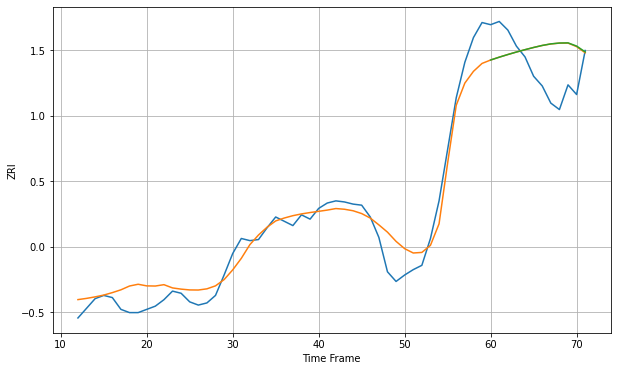

Wall time: 7.24 s
80120 15.862459580838145 35.67232357456488 35.770557443266895 [1636.12169881 1638.76388801 1641.22153538 1643.55947352 1645.74004417
 1647.80053975 1649.6795857  1651.12817272 1651.92717083 1652.07476643
 1649.10203247 1643.67908193]

Got an mse at 0.0099 in round 50 and stopped training

60 60 12


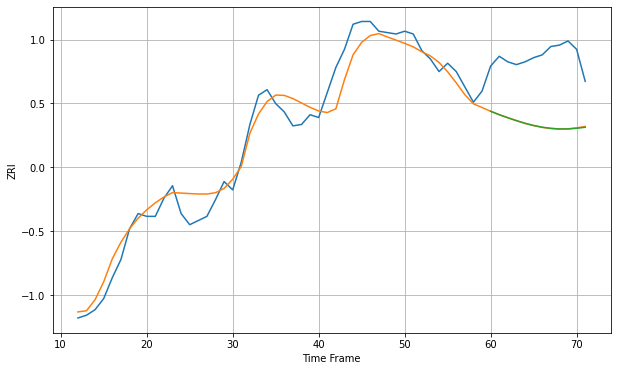

Wall time: 6.6 s
80124 11.376840627807164 48.674978851798976 48.69682525432466 [1588.47645494 1586.03447368 1583.84225442 1581.77988632 1579.85494341
 1578.29126022 1577.03436338 1576.2338056  1575.77211129 1575.78611698
 1576.26505753 1576.9861636 ]

Got an mse at 0.0099 in round 87 and stopped training

60 60 12


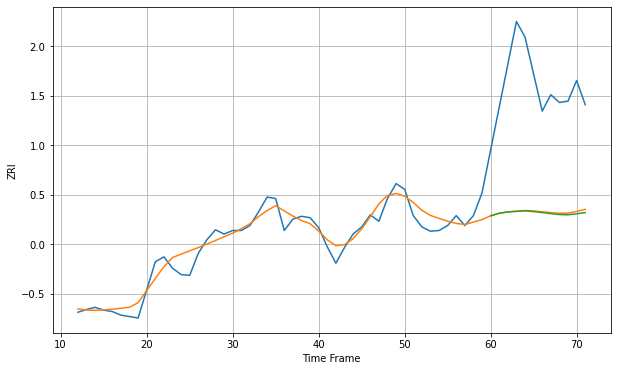

Wall time: 7.68 s
80129 14.828207132978518 181.1612481390873 182.41731400151514 [1849.63406745 1853.29284954 1855.1256363  1855.8971252  1856.6055729
 1855.64297197 1854.24742888 1852.75953612 1851.41702571 1851.14020307
 1852.52869872 1854.26230641]

Got an mse at 0.0096 in round 229 and stopped training

60 60 12


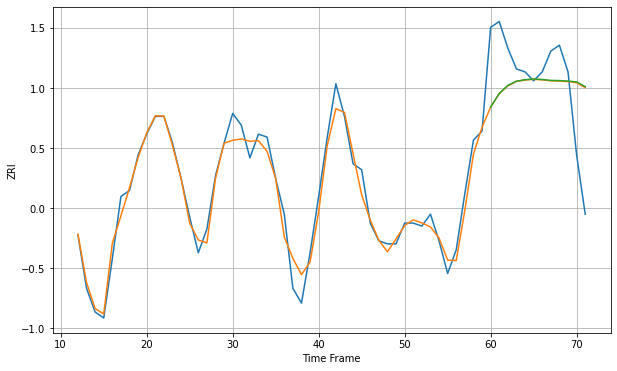

Wall time: 11.1 s
80202 4.239317457088915 18.672274707517058 18.725851309705273 [2008.11869198 2012.72057458 2015.43045327 2016.86353007 2017.35362368
 2017.59284288 2017.43689315 2017.11867042 2017.06401826 2016.88935285
 2016.61388328 2015.02486469]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


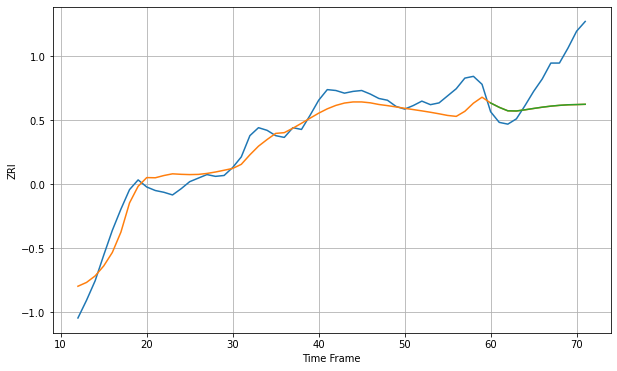

Wall time: 7.23 s
80203 15.969793190935947 47.01008704097247 46.976336861951424 [1575.89776572 1570.99941697 1567.05069365 1566.8752972  1568.20079722
 1569.721823   1571.1539282  1572.34998811 1573.23794333 1573.87227979
 1574.12249273 1574.45248102]

Got an mse at 0.0099 in round 65 and stopped training

60 60 12


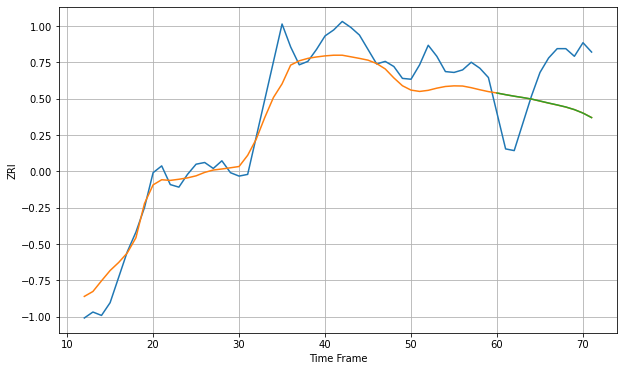

Wall time: 7.26 s
80204 24.02131497575777 57.362006713251986 57.36368344860046 [1827.77305509 1825.84002025 1824.05638327 1822.46167484 1820.7248237
 1818.36437168 1815.98529902 1813.74484525 1811.33830911 1808.24134595
 1804.15163148 1798.82519195]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


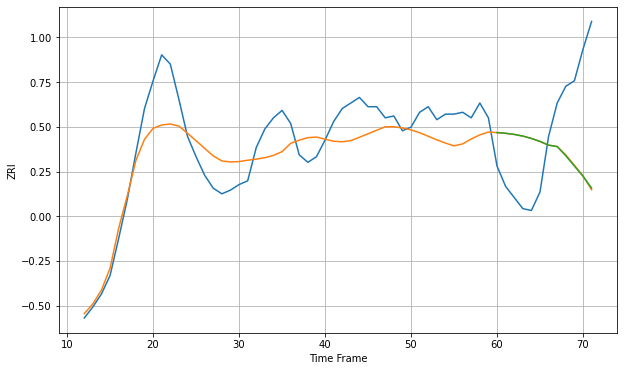

Wall time: 7.11 s
80205 14.664644140150902 43.79935539427687 43.747785273017506 [1663.03591745 1662.65987351 1662.05835305 1661.15519545 1659.89062824
 1658.27536016 1656.27211509 1655.47502698 1650.52605651 1644.9819662
 1639.51516855 1633.09833326]

Got an mse at 0.0098 in round 39 and stopped training

60 60 12


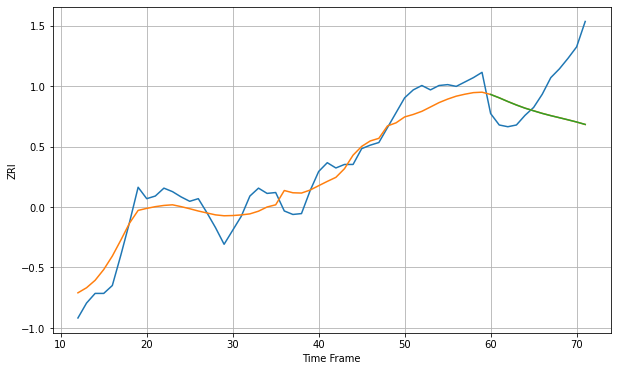

Wall time: 6.41 s
80210 18.091451086729023 53.50454867408839 53.49278970279687 [1621.78796165 1617.96276065 1613.73151063 1609.76928715 1606.16860352
 1603.1470861  1600.203602   1597.63137112 1595.28071472 1592.88474744
 1590.40942461 1587.6272234 ]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


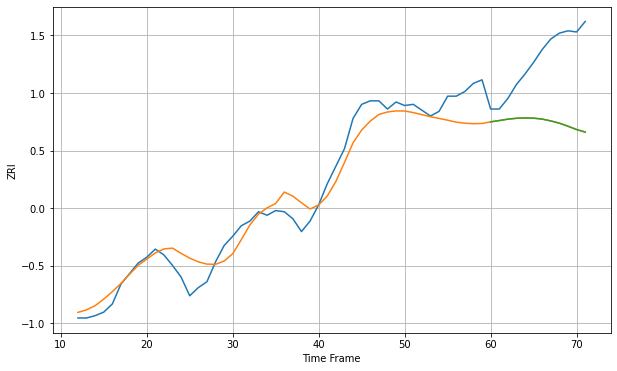

Wall time: 6.69 s
80211 15.166395559675427 59.31816016866101 59.24433847767081 [1683.01813116 1684.11692634 1685.31353744 1686.07907322 1686.33761799
 1686.20453592 1685.38419896 1683.81109674 1681.87086146 1679.25262062
 1676.44393425 1674.37098386]

Got an mse at 0.0099 in round 49 and stopped training

60 60 12


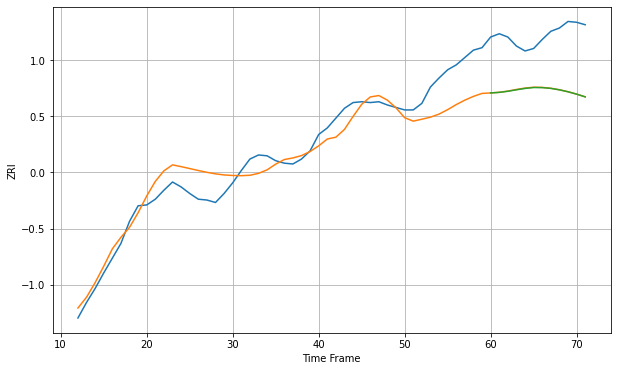

Wall time: 6.55 s
80214 24.570105748695227 69.49277395582439 69.65519657188474 [1253.75303012 1254.42507578 1255.74880186 1257.56182634 1259.24877773
 1260.35213552 1260.24202239 1259.27796883 1257.50481938 1255.14632246
 1252.25626357 1248.96486973]

Got an mse at 0.0099 in round 75 and stopped training

60 60 12


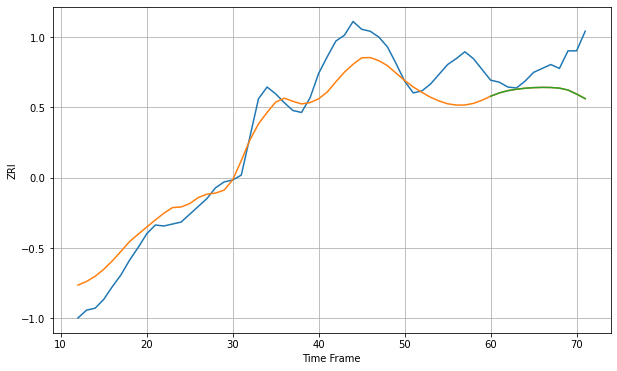

Wall time: 7.54 s
80218 24.690614975101486 29.343708606876262 29.35412948247676 [1410.60913478 1413.95391064 1416.2808876  1417.75510222 1418.76781477
 1419.38382669 1419.64857515 1419.53290229 1418.86875074 1416.9206017
 1412.79096267 1408.10511735]

Got an mse at 0.0099 in round 50 and stopped training

60 60 12


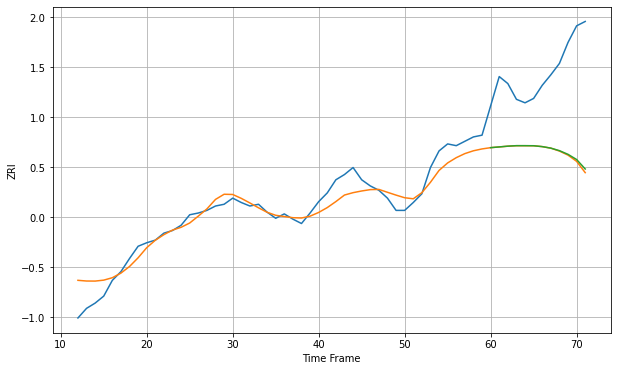

Wall time: 7.35 s
80226 14.343268672952364 97.6801759005932 96.63269009978782 [1438.72212578 1439.56812619 1440.43855819 1441.00292416 1440.99445263
 1440.91712277 1439.91471023 1438.18620592 1435.29900655 1431.08516024
 1425.15382875 1414.34315203]

Got an mse at 0.0099 in round 54 and stopped training

60 60 12


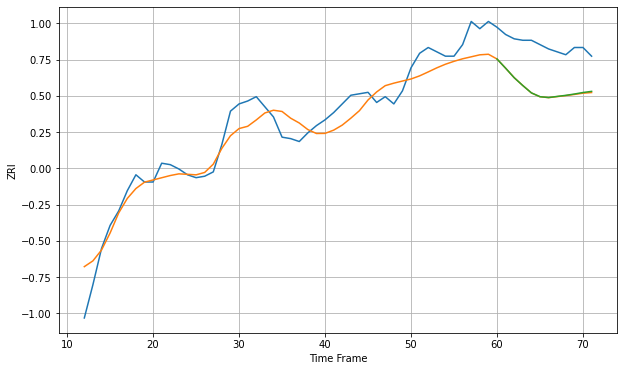

Wall time: 6.94 s
80229 12.341249160726134 30.171574549579294 30.013100115299068 [1387.05142002 1380.69585399 1374.11487231 1368.69124969 1363.62496006
 1360.99039307 1360.4052102  1361.176666   1361.92457148 1362.83380044
 1363.88155067 1364.67331283]

Got an mse at 0.0099 in round 57 and stopped training

60 60 12


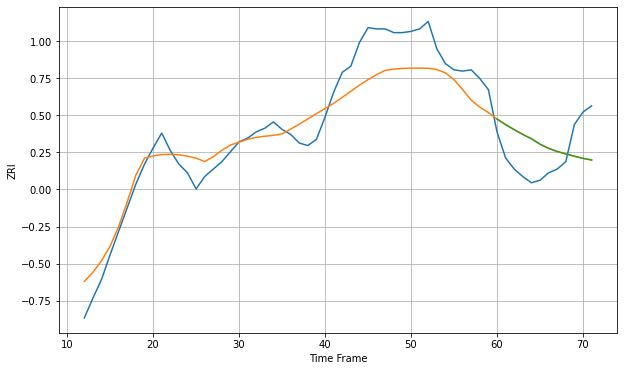

Wall time: 10 s
80231 19.374459180650888 28.4080758499894 28.406892219310162 [1334.37200386 1329.88192917 1325.76333746 1321.94159068 1318.49436275
 1314.09764784 1310.75412305 1308.23509912 1306.28993147 1304.35761197
 1302.68041487 1301.37629675]

Got an mse at 0.0097 in round 35 and stopped training

60 60 12


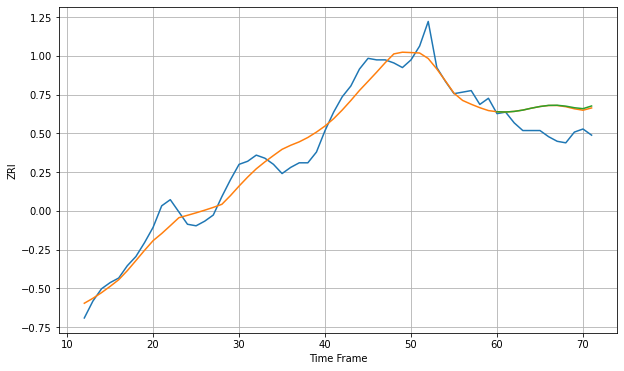

Wall time: 6.78 s
80233 9.449350906791464 15.52124610654745 15.849566758034431 [1422.23600281 1422.05717608 1422.45607025 1423.30676372 1424.56161178
 1425.64531682 1426.37240428 1426.46342447 1425.88258157 1424.8596127
 1424.24699376 1425.9878856 ]

Got an mse at 0.0098 in round 50 and stopped training

60 60 12


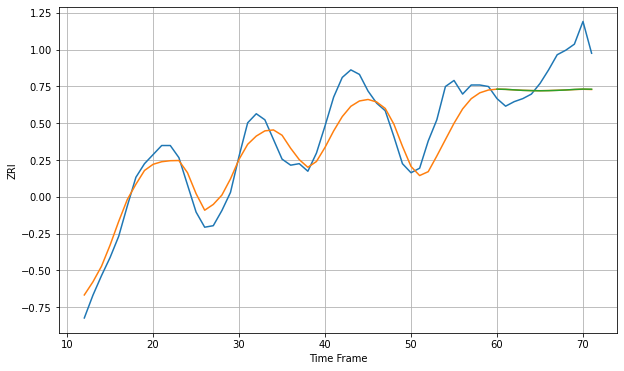

Wall time: 7.21 s
80237 13.11053840382554 20.80339943178254 20.765913910844684 [1454.26631614 1454.12421491 1453.78740751 1453.4533235  1453.28863776
 1453.19153381 1453.27796577 1453.46118738 1453.71439147 1454.06524016
 1454.30154937 1454.21813393]

Got an mse at 0.0099 in round 53 and stopped training

60 60 12


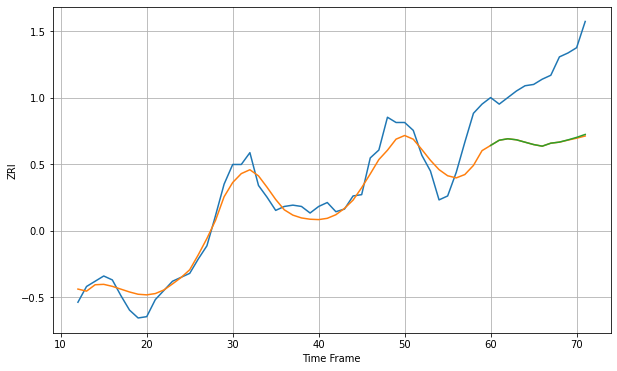

Wall time: 7.36 s
80301 12.647895693031801 53.7781753127437 53.53145383714386 [1726.51433102 1730.47372202 1731.57841547 1730.80684552 1728.98718807
 1727.19076498 1725.94903814 1728.2288492  1729.05960257 1730.74498764
 1732.64965514 1734.89506649]

Got an mse at 0.0098 in round 58 and stopped training

60 60 12


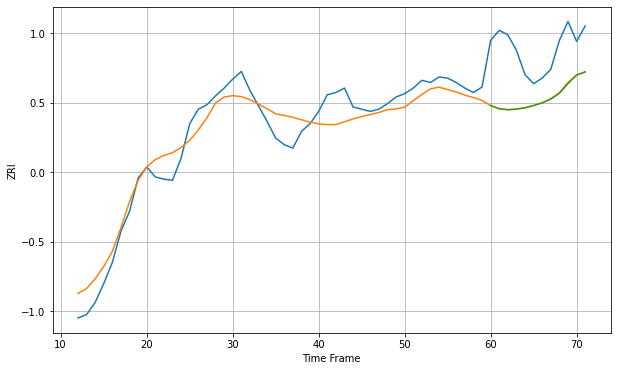

Wall time: 7.62 s
80401 15.130703331652697 46.59324247196241 46.85961520368351 [1538.28750281 1535.36705188 1534.49308116 1534.97236344 1536.206299
 1538.24409639 1540.61279021 1544.07206315 1549.32030438 1558.02111508
 1565.70805985 1568.57844083]

Got an mse at 0.0098 in round 31 and stopped training

60 60 12


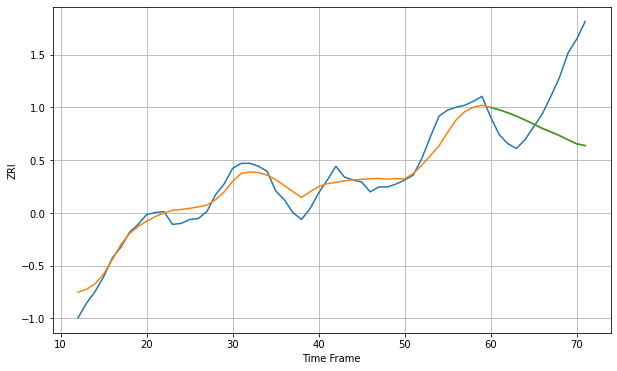

Wall time: 6.97 s
80503 11.80195809447349 59.856149444647315 59.96589564878316 [1404.73801882 1402.28850664 1399.29991351 1395.82367109 1391.94280424
 1387.76953558 1383.36783407 1379.76064125 1376.04044706 1371.81160929
 1367.74857464 1365.96855772]

Got an mse at 0.0098 in round 70 and stopped training

60 60 12


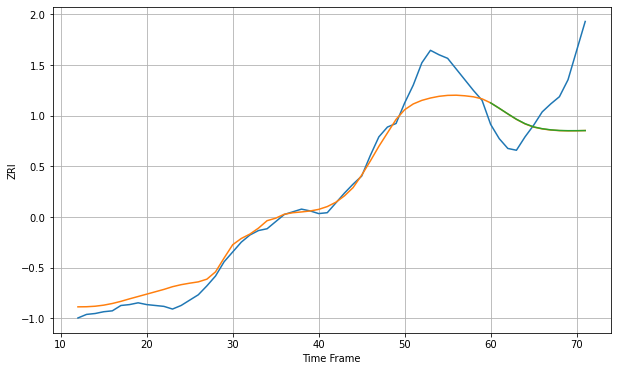

Wall time: 7.42 s
80904 17.000744380630877 52.931273439605505 52.89433438798514 [999.09549282 993.04119481 986.78230681 980.77077817 975.76347299
 972.17297328 970.12830012 968.84761779 968.15257934 967.9082913
 967.93374542 968.06285834]

Got an mse at 0.0099 in round 92 and stopped training

60 60 12


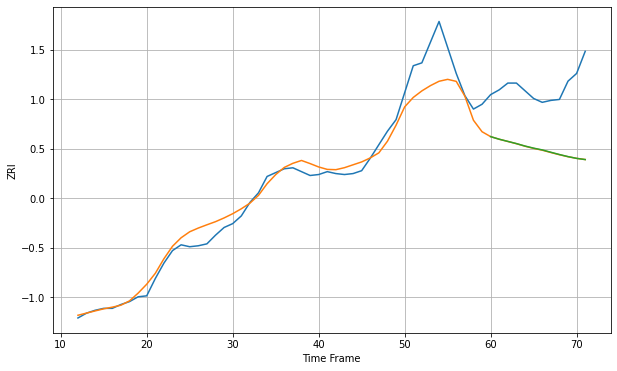

Wall time: 8.55 s
80915 16.316333655359028 66.74684000979019 66.65095142263955 [904.3693569  901.66815235 899.40855836 897.14279489 894.58878208
 892.40791017 890.58168607 888.15844739 885.7934657  883.61660904
 881.77990702 880.53201921]

Got an mse at 0.0099 in round 104 and stopped training

60 60 12


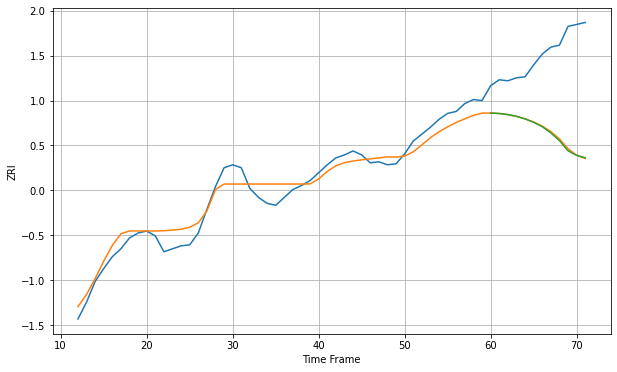

Wall time: 8.38 s
84047 11.550817302596224 83.2157409231232 83.72609632561593 [1091.33607452 1090.89367049 1089.82987281 1088.03878426 1085.44132027
 1082.04166932 1077.57089808 1071.29873675 1063.48906389 1053.13549141
 1048.56474295 1046.13540243]

Got an mse at 0.0099 in round 71 and stopped training

60 60 12


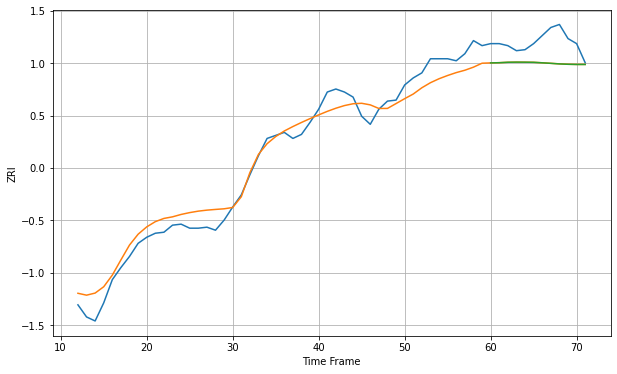

Wall time: 7.8 s
84095 13.741818545129744 22.74677617310906 22.774676285008614 [1317.90123887 1318.09464655 1318.50855979 1318.63503495 1318.58703587
 1318.46243514 1317.98767767 1317.4458852  1316.89239445 1316.50643891
 1316.32847608 1316.32564491]

Got an mse at 0.0097 in round 47 and stopped training

60 60 12


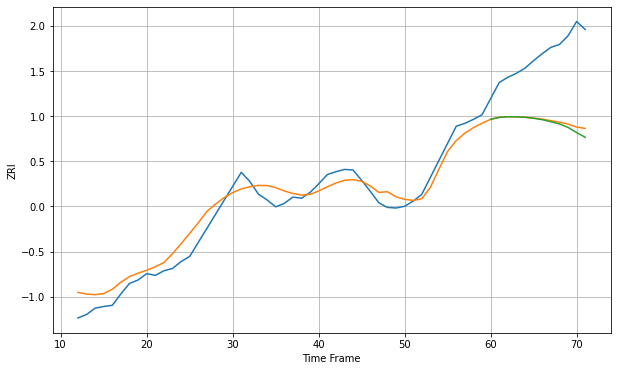

Wall time: 7.11 s
84102 20.81305499818493 117.79678744235355 122.17805749751537 [1083.0889515  1086.39787831 1087.50117922 1087.34200611 1086.56146334
 1084.8081935  1082.46613824 1078.87005178 1074.98975608 1068.99582224
 1060.02079601 1051.78228727]

Got an mse at 0.0099 in round 56 and stopped training

60 60 12


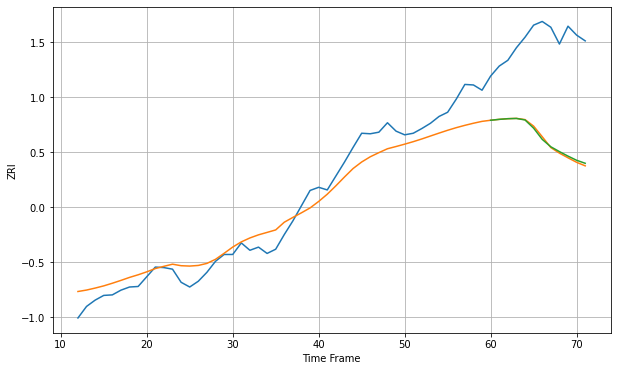

Wall time: 7.12 s
84103 32.63596905430858 189.7233585714071 188.93263848209256 [1310.74916736 1312.46795727 1313.71187067 1314.18943775 1311.30619195
 1295.67899    1274.32775419 1260.20604596 1251.03697972 1242.39478113
 1234.49450066 1228.76069849]

Got an mse at 0.0099 in round 123 and stopped training

60 60 12


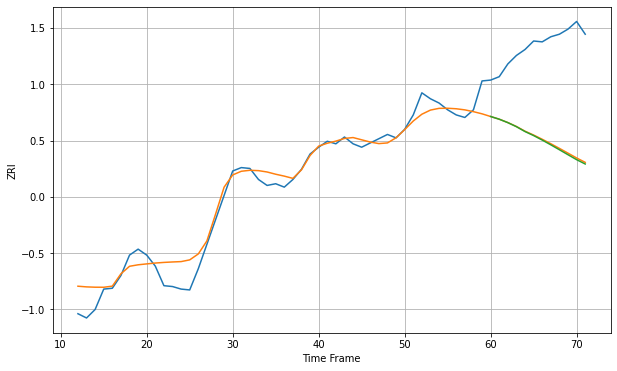

Wall time: 9.35 s
84106 15.539002019300655 113.47875602846172 114.58527383027149 [1220.12681489 1216.94652421 1212.92073924 1208.15367724 1202.41787777
 1197.6922652  1192.39884001 1186.79303836 1181.01120992 1175.14723644
 1169.33806752 1164.23627146]

Got an mse at 0.0099 in round 28 and stopped training

60 60 12


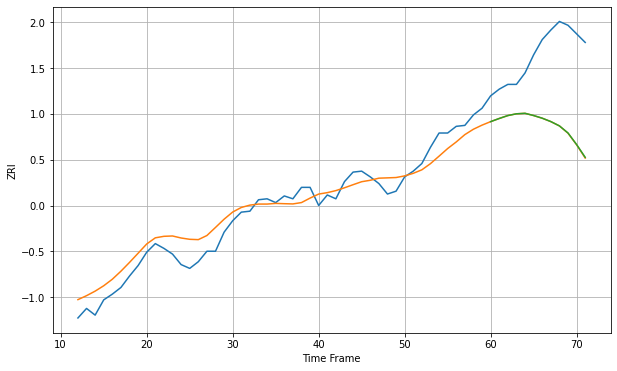

Wall time: 6.69 s
84119 14.536106722948595 80.95260424835861 80.78074088316176 [1007.9383784  1011.23537509 1014.28734958 1016.16708972 1016.66714558
 1014.34673208 1011.55017753 1007.99612418 1003.47338566  996.04437221
  983.89652264  970.52941946]

Got an mse at 0.0099 in round 76 and stopped training

60 60 12


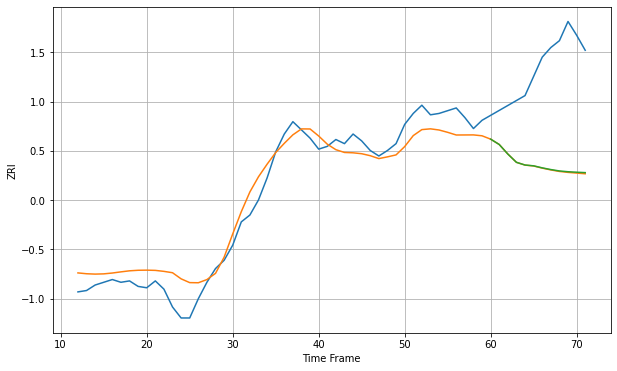

Wall time: 8.2 s
84403 12.02412829242304 73.5100014769626 73.19667727641375 [871.27536242 867.37160295 860.42219528 854.3860522  852.42609798
 851.84153158 850.35728314 849.11767124 848.10412035 847.53697716
 847.18255953 846.88747923]

Got an mse at 0.0099 in round 62 and stopped training

60 60 12


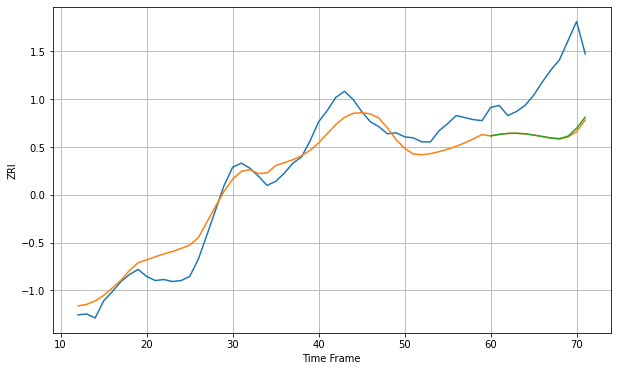

Wall time: 8.78 s
85008 16.415592150500007 60.123739952163255 59.22363011933947 [1025.91153303 1027.43762367 1028.37741292 1028.53181765 1027.98324469
 1026.77702425 1025.32053263 1023.86959578 1023.22418044 1025.67057474
 1033.45119468 1044.43783131]

Got an mse at 0.0099 in round 34 and stopped training

60 60 12


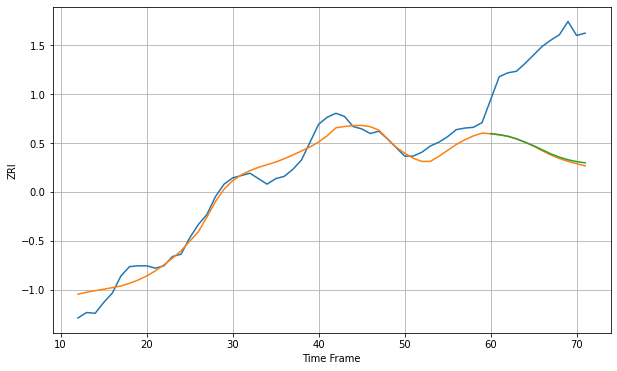

Wall time: 12.2 s
85014 14.635754802156699 128.84892748427833 127.42417070419347 [1150.77681781 1149.47157504 1147.51326053 1144.2550102  1139.95302503
 1135.31758521 1130.11445371 1124.8947497  1120.64174958 1117.30734843
 1114.94970232 1113.31208627]

Got an mse at 0.0099 in round 54 and stopped training

60 60 12


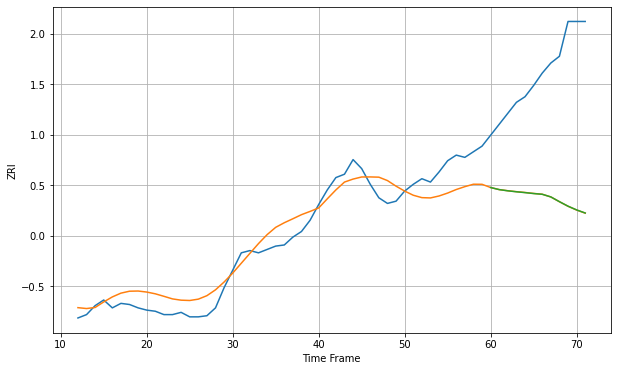

Wall time: 9.4 s
85015 15.417186626845446 115.52403598568385 115.5067047963675 [900.14909928 898.28451931 897.21764133 896.35350805 895.60965384
 894.77908974 894.1362469  891.78594743 887.55216375 883.5360122
 880.22613025 877.46525705]

Got an mse at 0.0098 in round 39 and stopped training

60 60 12


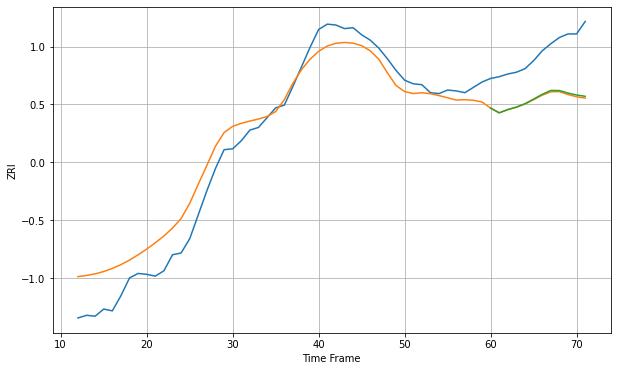

Wall time: 6.5 s
85016 24.650956644438704 54.39561240175316 53.36922984026449 [1284.65602735 1279.39417221 1283.04399502 1285.85679996 1289.64800972
 1294.76454589 1300.17212422 1304.52419589 1304.42263649 1301.56570501
 1299.38351576 1297.95825254]

Got an mse at 0.0100 in round 56 and stopped training

60 60 12


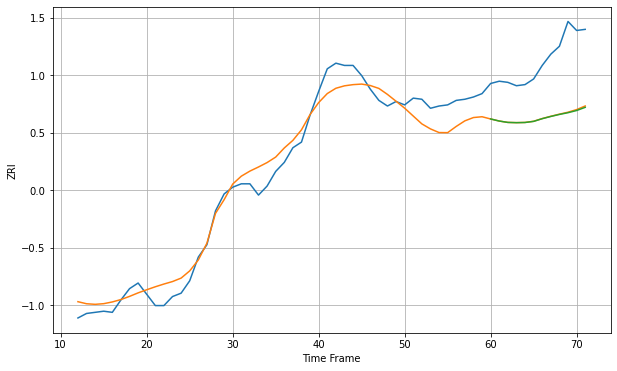

Wall time: 7.49 s
85018 13.923801766989786 51.64378622763504 51.98740407877271 [1183.51697701 1181.67886315 1180.45638051 1180.23483701 1180.38590071
 1181.3765747  1183.76804067 1185.74587649 1187.53592269 1189.07692768
 1191.01700576 1193.83155157]

Got an mse at 0.0098 in round 83 and stopped training

60 60 12


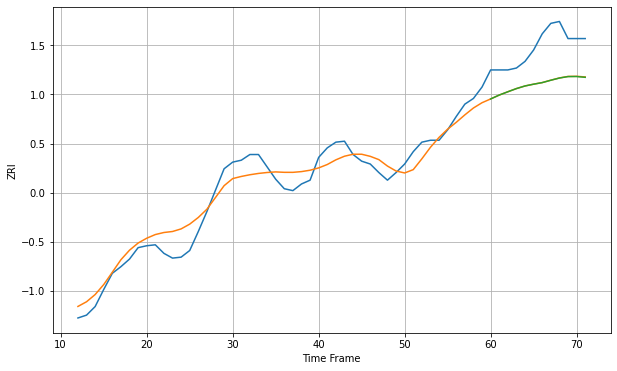

Wall time: 8.2 s
85020 14.278203964474805 39.92333509642834 40.00655890336091 [1087.45332111 1091.5733932  1095.02869381 1098.37469584 1101.13290198
 1103.00703063 1104.66143766 1107.15750659 1109.47670799 1111.01559882
 1111.07168611 1110.23138765]

Got an mse at 0.0099 in round 64 and stopped training

60 60 12


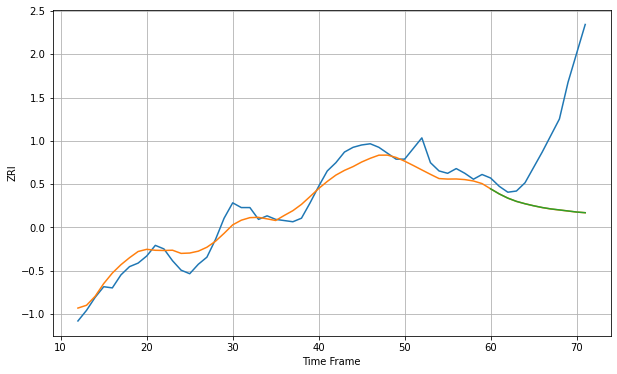

Wall time: 7.28 s
85027 9.926589577365638 75.78464037490694 75.75069214734395 [1014.85422829 1010.56949625 1006.99197308 1004.24264159 1002.23499153
 1000.53239853  999.04879224  997.87777343  997.01666857  996.13117886
  995.22475104  994.66005987]

Got an mse at 0.0099 in round 116 and stopped training

60 60 12


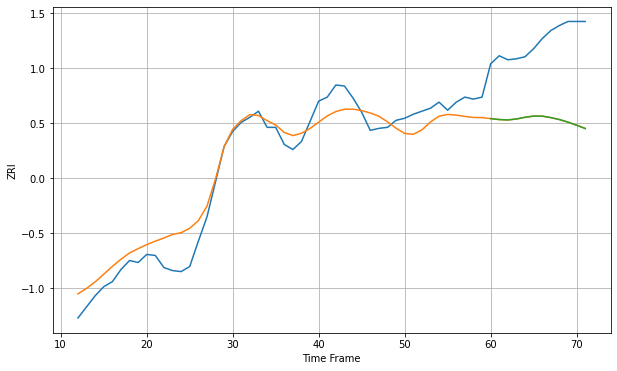

Wall time: 9.68 s
85032 16.81011092663313 79.59863381142009 79.57663019057311 [1138.67307189 1137.74203291 1137.36974828 1138.32119438 1140.03259216
 1141.2068757  1141.1820214  1139.70936417 1137.76509077 1135.18132782
 1132.12629387 1128.81635513]

Got an mse at 0.0096 in round 28 and stopped training

60 60 12


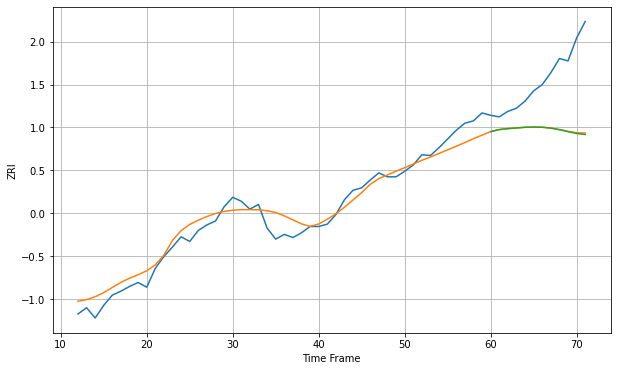

Wall time: 6.47 s
85044 14.125755269512856 72.67418077213752 73.17581252293874 [1329.32014244 1331.91033844 1333.14421478 1333.9378009  1334.77910956
 1335.03600013 1334.84082006 1333.76485614 1331.78968084 1329.2728884
 1326.96518481 1325.67072946]

Got an mse at 0.0098 in round 27 and stopped training

60 60 12


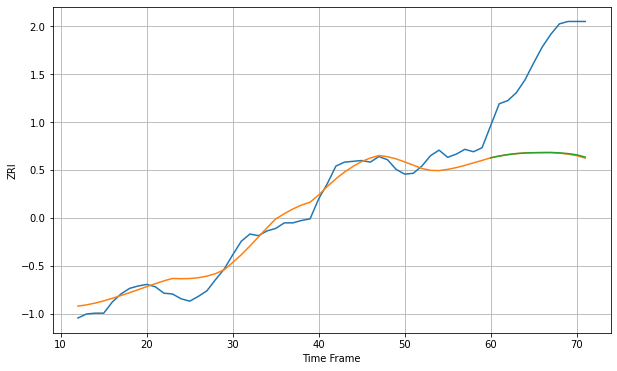

Wall time: 6.8 s
85201 13.869833683639797 125.08685635377289 124.67168711472748 [1034.37073191 1036.63275787 1038.40921511 1039.69000358 1040.47366734
 1040.83798764 1041.00528124 1041.11127911 1040.6340827  1039.65359015
 1038.17249827 1035.3517917 ]

Got an mse at 0.0099 in round 64 and stopped training

60 60 12


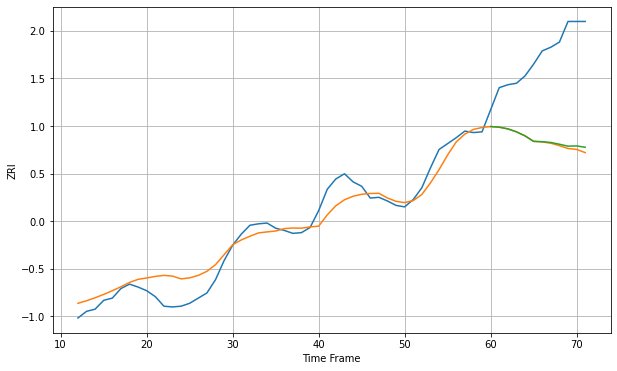

Wall time: 7.54 s
85204 19.23183210934436 120.04442026706963 117.9315841556434 [1124.2039044  1123.30513578 1121.0142788  1117.00454324 1111.39258785
 1103.93805476 1103.64481935 1102.49746595 1100.13401492 1097.52127607
 1097.83769697 1096.03233756]

Got an mse at 0.0096 in round 27 and stopped training

60 60 12


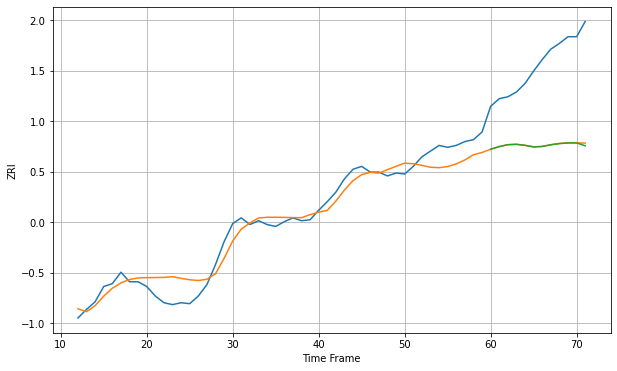

Wall time: 6.47 s
85224 13.403481084848542 87.11378822446348 87.49552370485846 [1135.94435484 1138.76815871 1140.78249667 1141.17063561 1140.0809429
 1138.34722201 1138.93241842 1140.65895341 1141.90854883 1142.57407832
 1142.61824549 1139.62450112]

Got an mse at 0.0100 in round 54 and stopped training

60 60 12


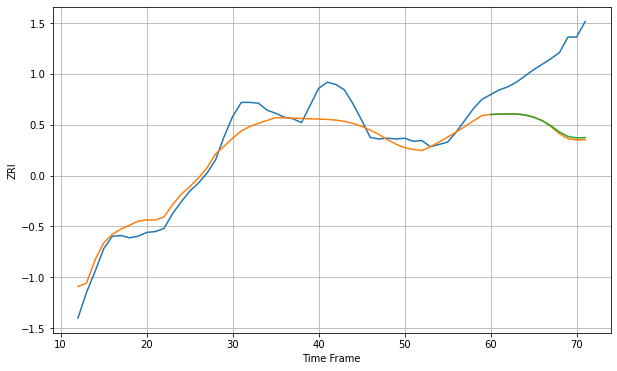

Wall time: 8.27 s
85251 19.332541124609758 87.56137246304827 86.21488319597212 [1368.52717553 1368.8723733  1369.16927534 1369.0148517  1367.78801819
 1364.93385084 1360.53749934 1354.05117577 1346.03490297 1340.22115896
 1338.31528572 1338.82042064]

Got an mse at 0.0099 in round 48 and stopped training

60 60 12


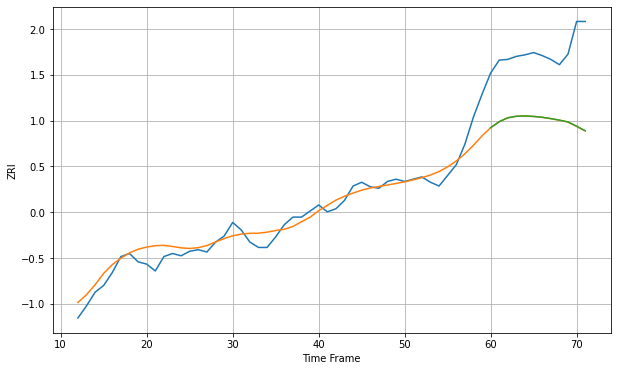

Wall time: 7.38 s
85260 15.012779574282936 92.9581179038044 92.84650951323725 [1460.92167426 1468.8307966  1473.97998705 1476.00449563 1476.38974538
 1475.79438252 1474.6480969  1472.94508759 1470.93501333 1468.54217843
 1462.90173853 1456.85434232]

Got an mse at 0.0100 in round 74 and stopped training

60 60 12


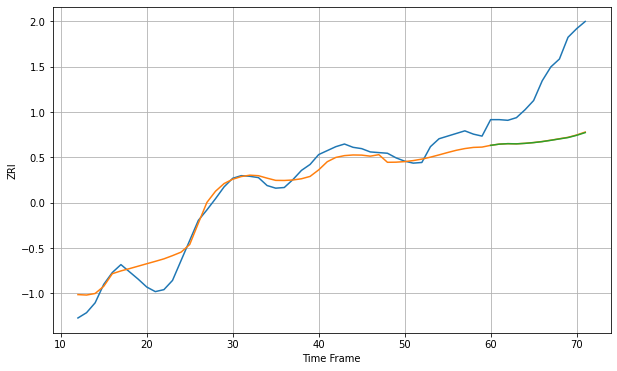

Wall time: 7.98 s
85281 18.549428579102738 102.11506908552009 102.40279394486403 [1187.98392675 1189.82516951 1190.51768093 1190.25416677 1191.00301558
 1192.15030216 1193.66253914 1195.62982153 1197.74255451 1199.82354075
 1203.19239011 1207.34860466]

Got an mse at 0.0097 in round 50 and stopped training

60 60 12


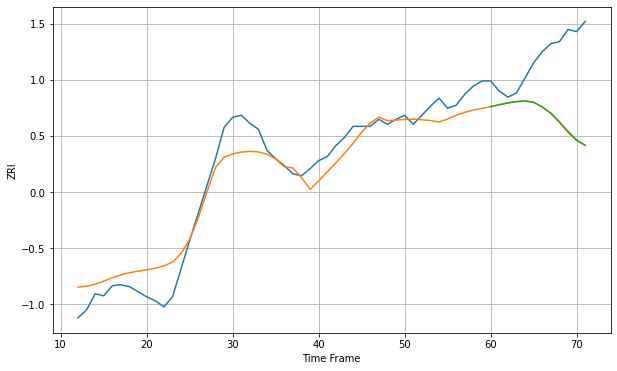

Wall time: 9.62 s
85282 18.81390791035086 67.31238809733138 67.01076933454996 [1181.53661245 1183.43052023 1185.21247738 1186.53372095 1187.09714277
 1185.8653156  1181.24234811 1175.1541762  1166.51497889 1156.96574315
 1148.49349583 1143.24015343]

Got an mse at 0.0097 in round 65 and stopped training

60 60 12


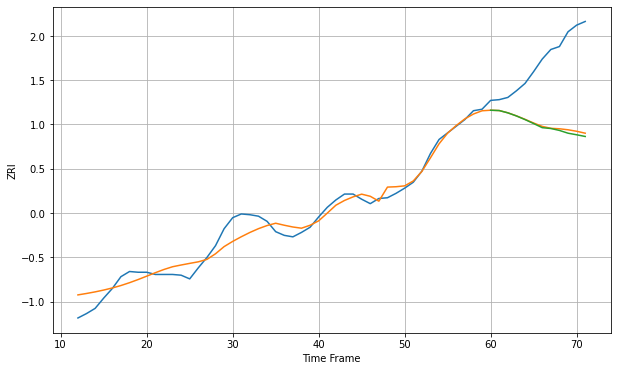

Wall time: 10.1 s
85283 13.402691816353363 92.49895003018996 94.73952115294266 [1193.65924233 1193.21106992 1190.11652068 1185.89474605 1180.98104389
 1175.58062975 1170.01347061 1168.88539325 1166.28296379 1162.52070244
 1160.3846867  1158.08164388]

Got an mse at 0.0096 in round 66 and stopped training

60 60 12


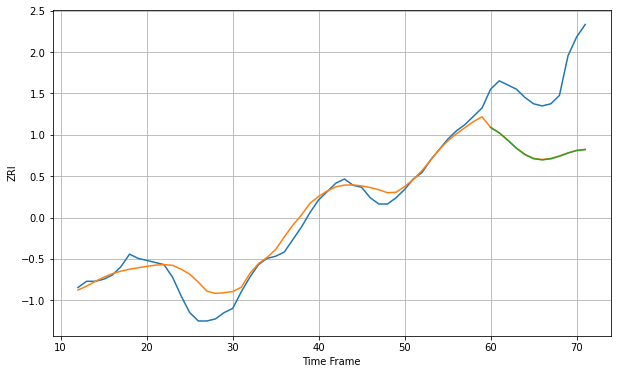

Wall time: 7.45 s
85705 6.143193823145853 35.0396695593088 35.14457342570479 [700.68254532 698.10828784 694.55686455 690.71555538 687.64853423
 685.70482569 685.14428049 685.65851324 686.88980609 688.40784893
 689.62806044 690.07633168]

Got an mse at 0.0100 in round 77 and stopped training

60 60 12


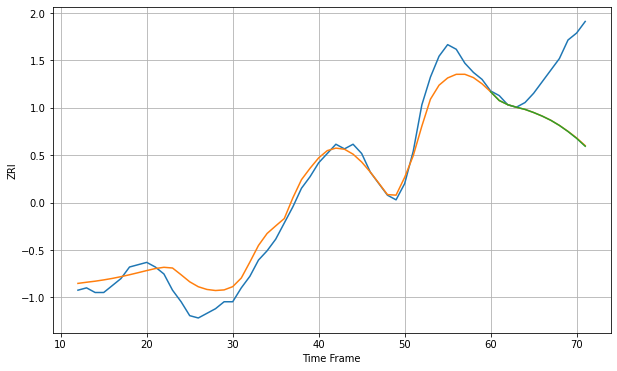

Wall time: 9.12 s
85716 6.383289354287155 25.95590599182192 26.041428420572235 [747.64687787 743.87640311 742.07123477 740.95509263 740.03489946
 738.69389059 737.14490764 735.33463716 733.10545597 730.48975616
 727.53386288 724.12735553]

Got an mse at 0.0100 in round 62 and stopped training

60 60 12


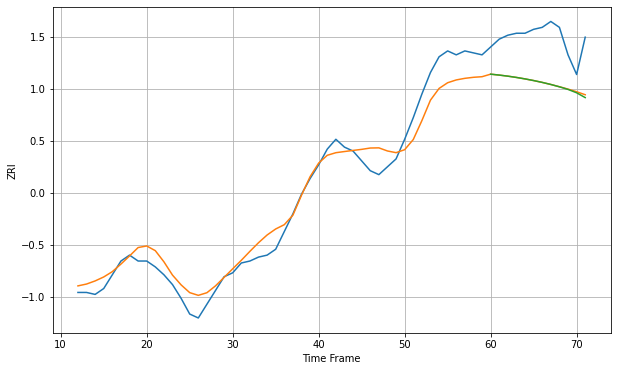

Wall time: 7.18 s
85719 8.151177541159878 23.558904868228918 23.743504367923954 [793.15934588 792.69404491 792.14649847 791.49496407 790.74872574
 789.90879875 788.97059738 787.91521884 786.72146121 785.39578068
 783.67548337 781.2277245 ]

Got an mse at 0.0097 in round 29 and stopped training

60 60 12


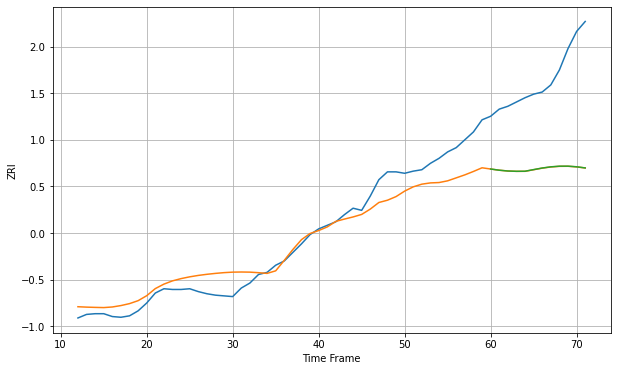

Wall time: 7 s
86314 24.52490753258104 129.43978074328982 129.3171076257928 [995.97842609 994.31871687 993.20156068 992.77862909 992.87369362
 995.17545555 997.38080636 999.05028712 999.956039   999.99173748
 999.11993249 997.5148465 ]

Got an mse at 0.0099 in round 142 and stopped training

60 60 12


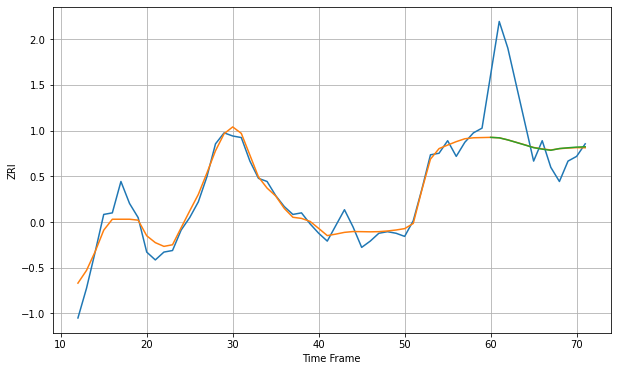

Wall time: 9.53 s
87111 7.130410679659892 32.61770444468195 32.63246635958497 [912.12681793 911.83378874 910.50094517 908.88307779 907.2502446
 905.5627826  904.61911332 903.88255877 905.00448327 905.4828817
 905.91969608 906.1254724 ]

Got an mse at 0.0097 in round 89 and stopped training

60 60 12


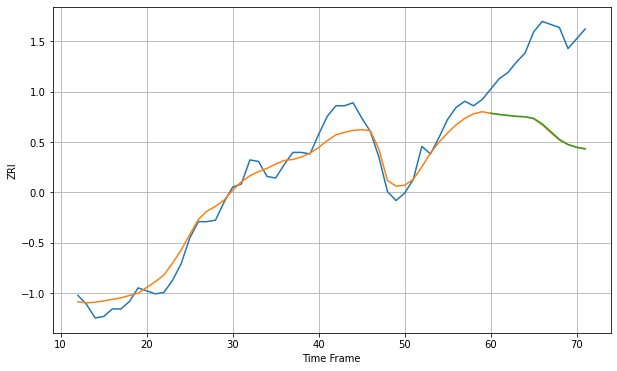

Wall time: 8.61 s
89030 8.530107799545071 57.07446693493456 56.906116363464996 [856.99895322 856.20113518 855.56993932 854.9642878  854.688228
 853.64497608 849.90089171 844.87838844 839.63911398 836.24737534
 834.35709769 833.27410262]

Got an mse at 0.0100 in round 92 and stopped training

60 60 12


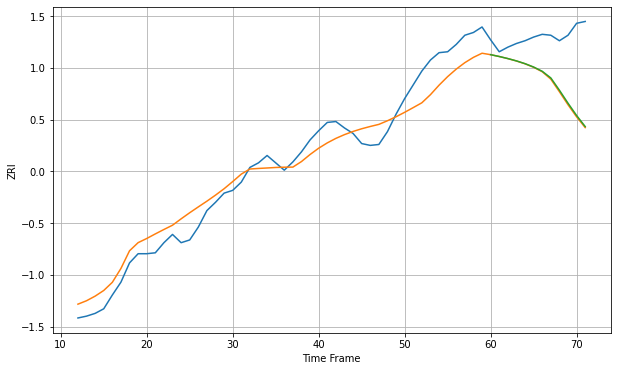

Wall time: 8.71 s
89052 18.950242160326315 57.04073914686051 56.165489500969365 [1447.81672868 1445.83868101 1443.58619741 1441.03790995 1438.03646545
 1434.36777126 1429.74819122 1422.49244869 1409.10758326 1394.94558672
 1381.54992996 1369.53306345]

Got an mse at 0.0100 in round 71 and stopped training

60 60 12


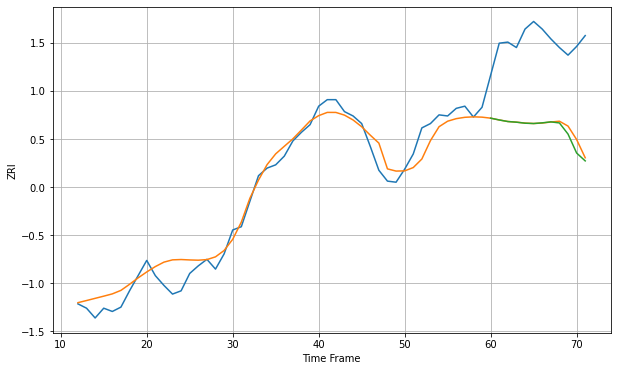

Wall time: 7.87 s
89101 12.201916595505086 79.13907128902552 81.29741933282146 [861.97170243 860.30880284 858.86496061 858.2669014  857.33046055
 857.03678065 857.65544851 858.559337   857.56499596 847.33489983
 829.88951415 822.62156182]

Got an mse at 0.0099 in round 50 and stopped training

60 60 12


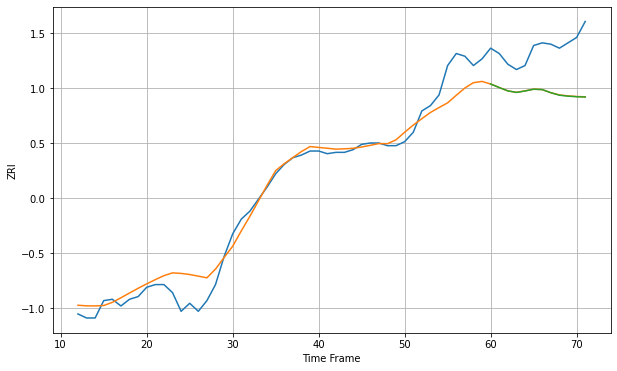

Wall time: 7.53 s
89108 11.428749658645236 34.11501726908806 34.20681415663112 [1060.16313909 1057.52397235 1055.03404179 1053.85903154 1054.95465903
 1056.26857018 1055.98501924 1053.66332772 1051.78281377 1051.07735197
 1050.65235823 1050.44630217]

Got an mse at 0.0100 in round 26 and stopped training

60 60 12


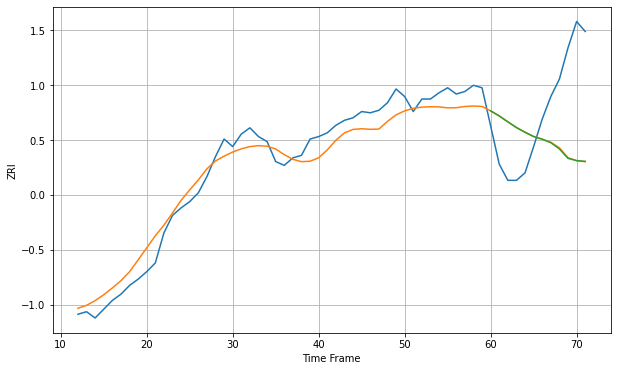

Wall time: 6.94 s
89117 11.779317927955821 59.35172151605102 59.46389613725741 [1268.55018271 1264.48477017 1259.77647535 1255.21419347 1251.44150957
 1248.00684527 1245.83973518 1243.11791536 1238.09528357 1230.57725459
 1228.76454417 1228.17394926]

Got an mse at 0.0100 in round 180 and stopped training

60 60 12


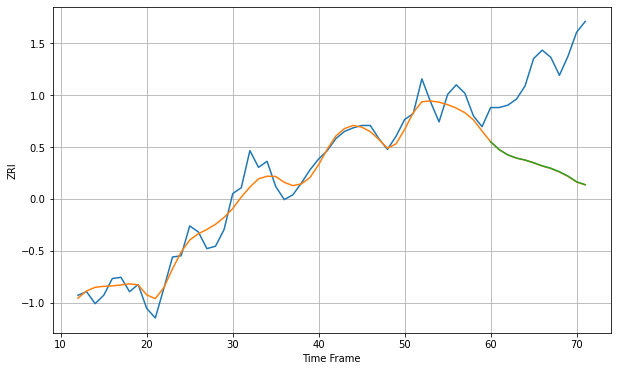

Wall time: 11.1 s
89119 10.247829684274866 85.02325636493129 84.88662877712773 [1103.37331787 1096.74721385 1092.38130009 1089.70945791 1088.09992361
 1085.82874219 1083.24027768 1081.24042389 1078.33438327 1074.66490513
 1069.93675448 1067.49784425]

Got an mse at 0.0098 in round 28 and stopped training

60 60 12


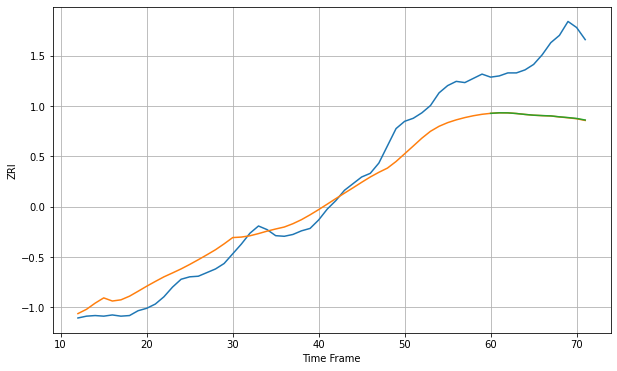

Wall time: 6.94 s
89502 32.976142771729506 107.0519417937242 106.83318355463342 [1004.16507032 1005.06249724 1004.96033856 1003.87976674 1002.37213976
 1001.11665122 1000.45404761  999.93928655  998.40404777  997.17785968
  995.72633417  993.12935422]

Got an mse at 0.0100 in round 147 and stopped training

60 60 12


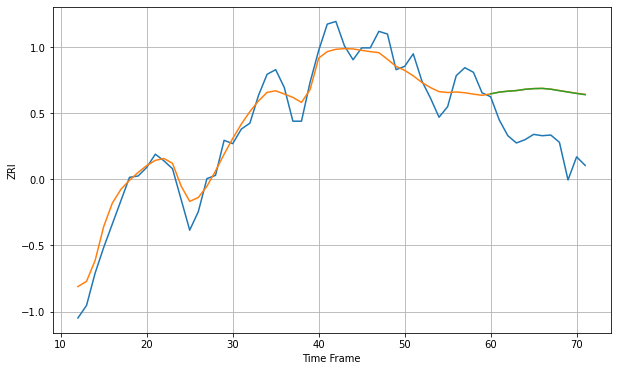

Wall time: 11.5 s
90001 23.931794151110605 80.62932509136596 80.4576868032336 [2339.36464897 2341.99913085 2343.39597358 2344.35215859 2346.25742868
 2347.30526388 2347.61228812 2346.39189712 2344.20190334 2342.07130564
 2339.93771183 2338.09709641]

Got an mse at 0.0099 in round 299 and stopped training

60 60 12


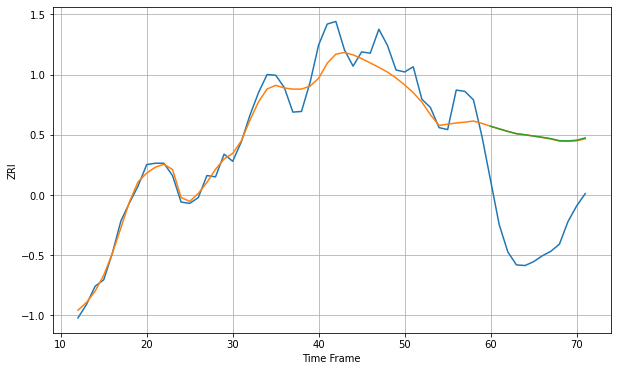

Wall time: 15.1 s
90002 24.21025174678429 159.31462457057037 159.64347965401927 [2327.12623914 2323.10904622 2319.17019241 2315.68077261 2313.9771997
 2312.06713831 2310.17213611 2307.9735151  2304.87625886 2304.5619325
 2305.56628769 2309.09689074]

Got an mse at 0.0096 in round 33 and stopped training

60 60 12


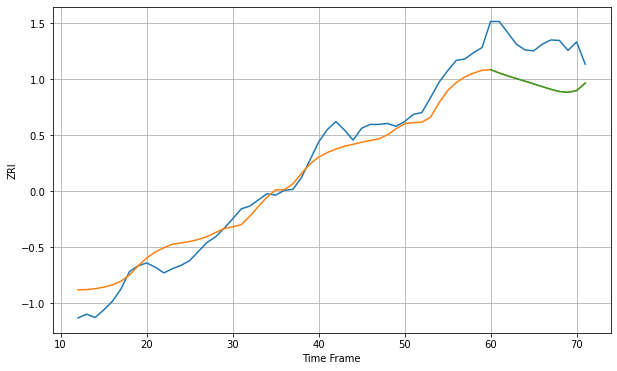

Wall time: 7.11 s
90003 33.187122872219305 89.00089850684563 89.01663150407126 [2038.35333486 2031.44592524 2025.25821343 2019.62343443 2014.1759264
 2008.56770471 2002.67926368 1997.04984272 1992.49139417 1990.7321622
 1994.13008079 2009.62619372]

Got an mse at 0.0099 in round 46 and stopped training

60 60 12


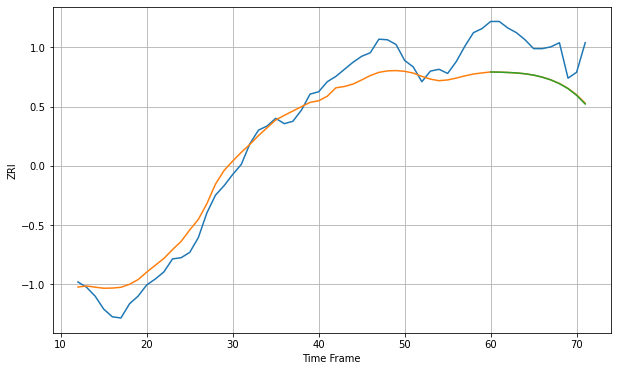

Wall time: 7.03 s
90004 30.91819078456687 66.29312481483538 66.57443773371642 [2198.48206789 2198.20317267 2197.63747138 2196.87631821 2195.42198186
 2193.17809597 2189.72419672 2185.0639868  2178.72583155 2170.2698967
 2158.95599322 2144.2224175 ]

Got an mse at 0.0100 in round 79 and stopped training

60 60 12


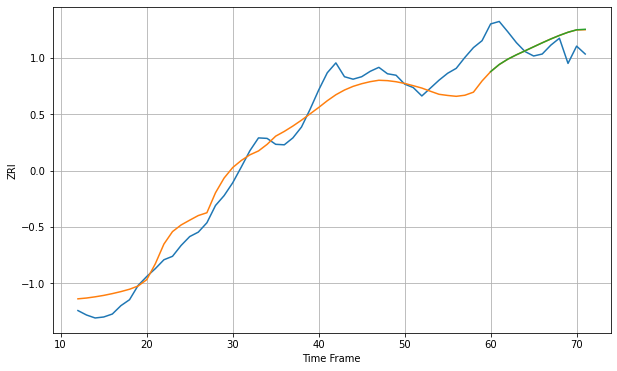

Wall time: 7.78 s
90006 35.55487827791616 49.33333367498803 49.39044962908231 [2107.30121516 2121.79200567 2132.62083568 2141.43861357 2149.4515936
 2157.60307636 2165.69965559 2173.49637478 2180.70098666 2187.14846727
 2192.09733206 2193.11702791]

Got an mse at 0.0100 in round 75 and stopped training

60 60 12


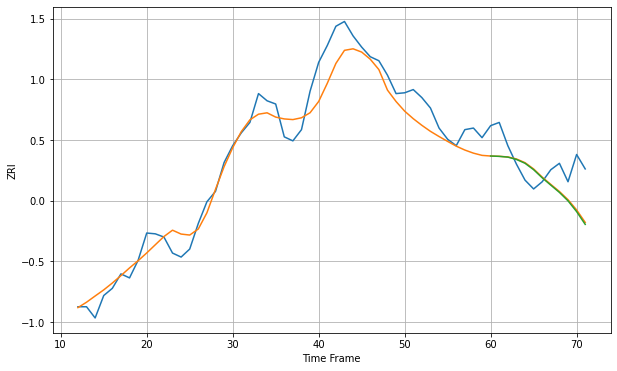

Wall time: 7.88 s
90007 21.620112183363446 36.41252059581646 37.23278302895421 [2213.08725287 2212.66581438 2211.72686672 2208.8330302  2204.02856143
 2196.04181328 2185.87957661 2176.73770113 2167.68949356 2157.17784391
 2143.74243864 2127.79442446]

Got an mse at 0.0099 in round 92 and stopped training

60 60 12


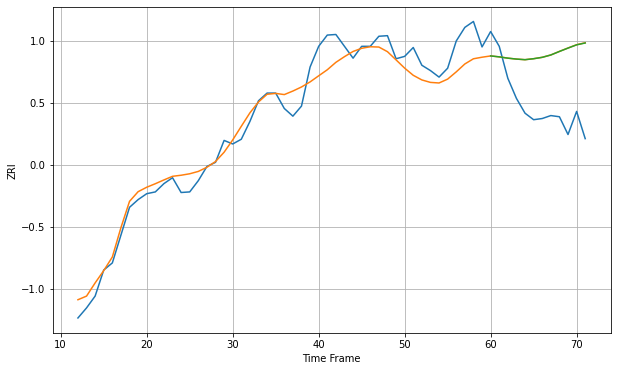

Wall time: 8.2 s
90011 26.79591458277997 100.04021893173234 99.93088077653904 [2364.7615632  2363.19154207 2361.02139571 2359.44882478 2358.41973614
 2360.06941384 2362.40274627 2366.38107418 2372.32786175 2378.025693
 2383.48213791 2386.62457483]

Got an mse at 0.0099 in round 43 and stopped training

60 60 12


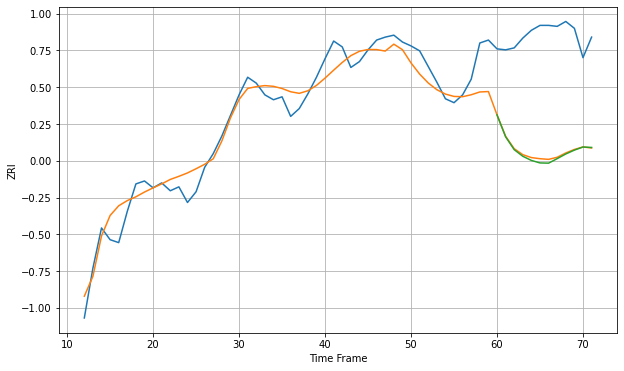

Wall time: 7.16 s
90012 17.898833104282275 116.84314936816001 118.41380829176649 [2346.52852255 2324.13682654 2310.99812682 2304.24658701 2299.98888824
 2297.43715814 2297.21702159 2301.82687171 2306.59054763 2310.53708621
 2313.69858201 2313.25717726]

Got an mse at 0.0100 in round 128 and stopped training

60 60 12


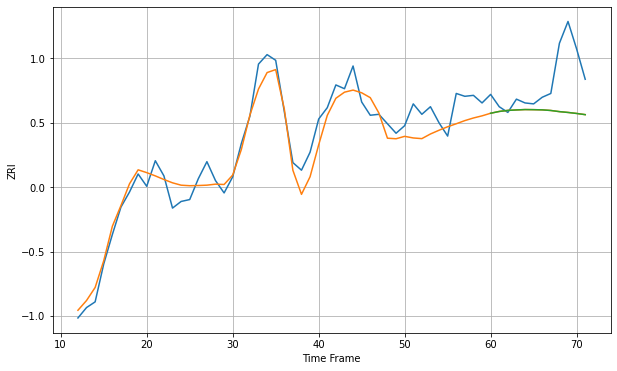

Wall time: 9.2 s
90015 16.745429931902393 42.42568734948289 42.440173244327745 [2503.11325734 2505.00680963 2506.1147745  2506.6077022  2507.01109382
 2506.8963879  2506.68979645 2506.02896365 2504.81729842 2503.94794742
 2502.88112997 2501.62875125]

Got an mse at 0.0100 in round 86 and stopped training

60 60 12


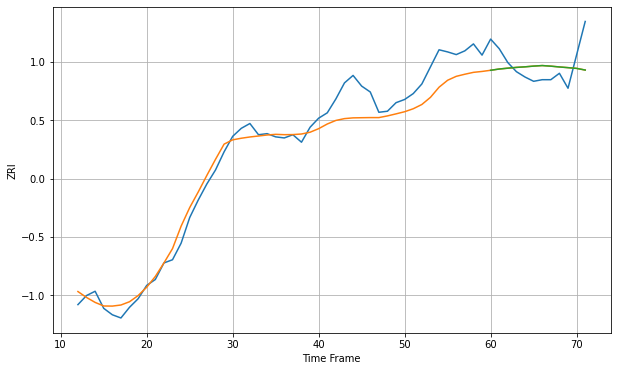

Wall time: 8.04 s
90016 31.346793656523708 38.820654386415406 38.81157698527056 [2300.62494152 2302.99548973 2304.5553888  2306.01674648 2307.07574172
 2308.44884398 2309.44639922 2308.3316003  2306.82057236 2305.5286797
 2304.15764359 2301.06061938]

Got an mse at 0.0098 in round 55 and stopped training

60 60 12


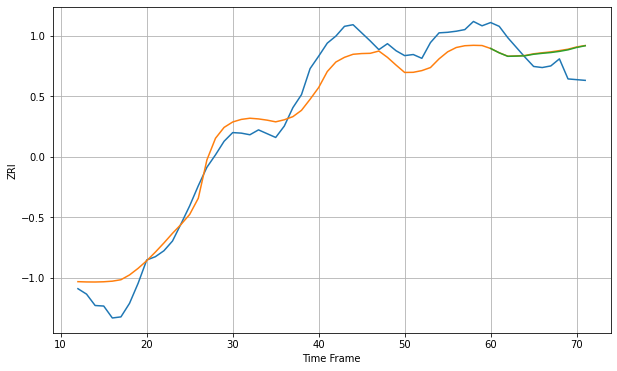

Wall time: 8.06 s
90018 35.33861369970085 39.8404855611182 39.36336878631957 [2206.17974609 2198.13175468 2191.68968282 2192.11051956 2192.65543255
 2195.53860508 2197.24430084 2198.68202376 2200.81548476 2203.69698864
 2208.04233038 2211.18028138]

Got an mse at 0.0098 in round 34 and stopped training

60 60 12


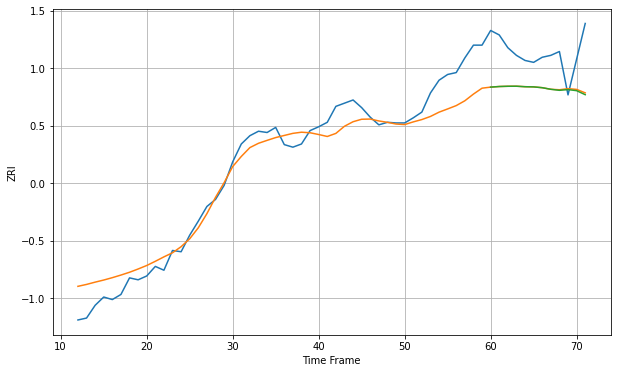

Wall time: 6.21 s
90019 30.174160155701898 62.238031114793216 62.85412894286066 [2240.18164166 2241.11578705 2241.49338457 2241.58003798 2240.81507193
 2240.54225085 2239.26520682 2236.76206728 2235.16104697 2236.29958452
 2234.61472414 2228.313175  ]

Got an mse at 0.0100 in round 219 and stopped training

60 60 12


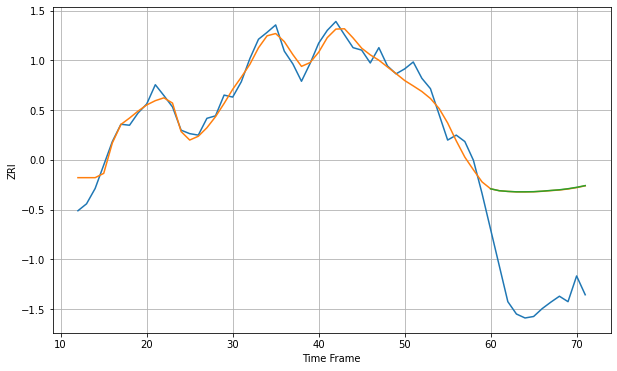

Wall time: 13.2 s
90022 21.721425405877415 215.1405651427385 215.39811953894852 [2243.37184792 2239.54385951 2238.10589078 2237.27959775 2237.28042529
 2237.56654277 2238.59173451 2240.0465164  2241.39042545 2243.53033854
 2246.38641685 2249.85888403]

Got an mse at 0.0100 in round 210 and stopped training

60 60 12


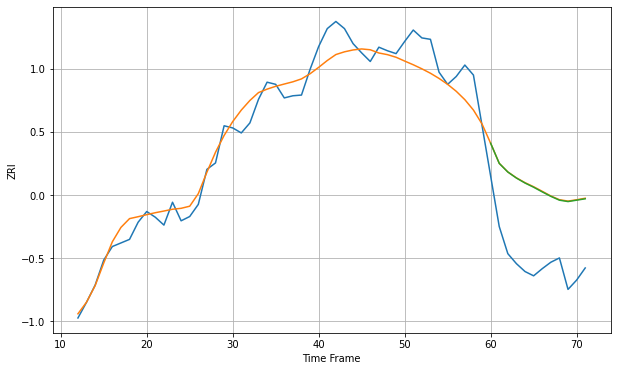

Wall time: 12.1 s
90023 23.18721801604266 105.23671851083925 104.7483358485499 [2211.59071204 2183.41633212 2171.28092914 2162.82483117 2155.86837931
 2150.00228207 2143.4785517  2137.24894681 2131.8777151  2129.92764968
 2131.8779812  2133.80618032]

Got an mse at 0.0099 in round 33 and stopped training

60 60 12


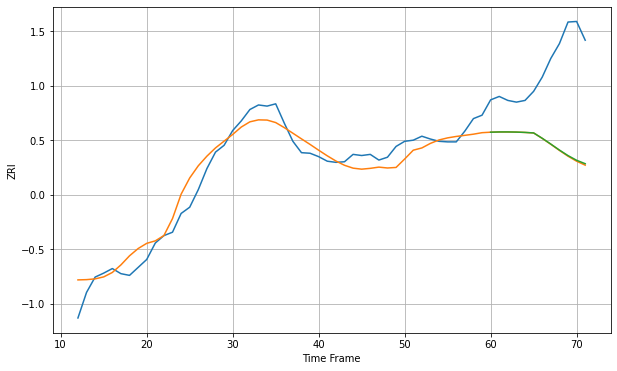

Wall time: 7.66 s
90024 23.663213684609616 146.11176922601447 145.28002782592984 [2902.06321138 2902.48273776 2902.5107734  2902.25044582 2901.67373481
 2900.7744085  2891.35652057 2881.16013929 2870.63529778 2860.860531
 2852.62129105 2846.57831396]

Got an mse at 0.0099 in round 26 and stopped training

60 60 12


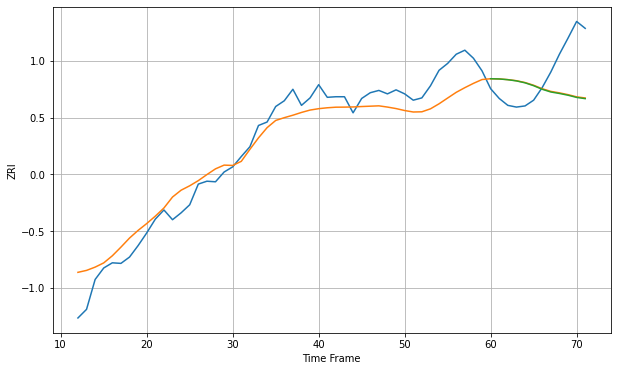

Wall time: 7.09 s
90025 32.7325687262027 67.77082081957442 68.28354711684274 [3019.34891893 3018.93206209 3017.64446239 3015.56801183 3012.20686398
 3007.23357401 3000.96166605 2996.25845671 2993.69429915 2990.65943767
 2986.84307026 2984.68658908]

Got an mse at 0.0099 in round 58 and stopped training

60 60 12


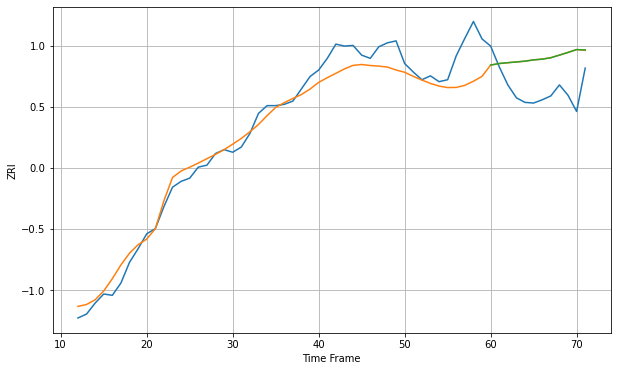

Wall time: 7.65 s
90026 26.96581717167359 55.90181959547881 55.86960523604563 [2443.67533251 2446.02478332 2447.33934455 2448.46943437 2449.66440797
 2451.63185223 2452.77866207 2454.94646691 2458.9886875  2463.14812338
 2467.5531877  2467.03511971]

Got an mse at 0.0100 in round 61 and stopped training

60 60 12


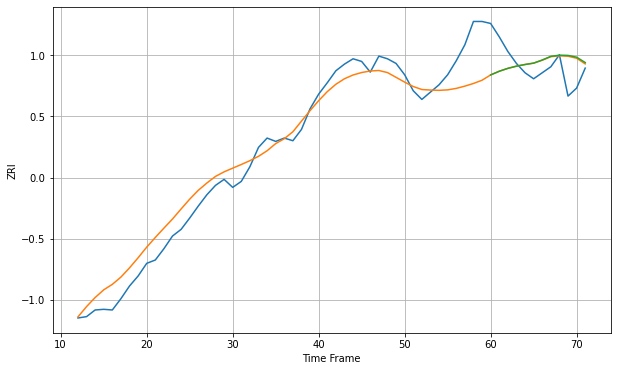

Wall time: 7.83 s
90027 29.05257982200662 36.76272943104062 37.15914524833748 [2282.76122282 2288.25490076 2292.58716786 2295.87125879 2298.35505131
 2300.41998578 2305.16137637 2310.63344484 2312.42903807 2312.05361882
 2309.40117363 2301.35087533]

Got an mse at 0.0097 in round 32 and stopped training

60 60 12


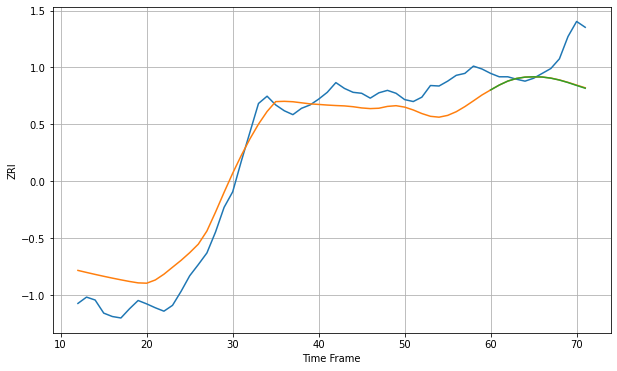

Wall time: 7.46 s
90028 48.054604507423015 61.65894985559451 61.9984787000121 [2387.91882903 2397.95723967 2406.18237958 2411.54830743 2414.29303672
 2414.91602312 2414.47821588 2412.18427035 2408.26751763 2403.12064532
 2397.1645283  2391.41387351]

Got an mse at 0.0099 in round 77 and stopped training

60 60 12


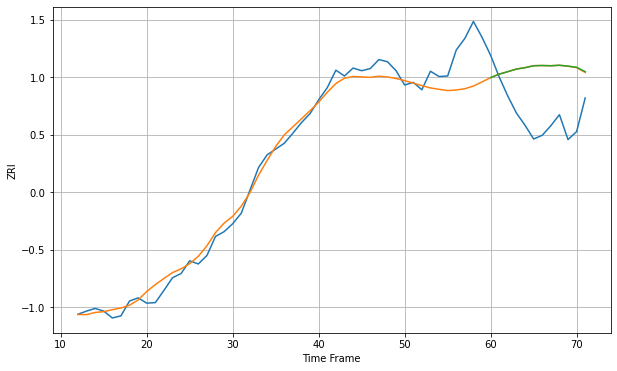

Wall time: 7.97 s
90029 31.504652800848426 98.67561949612195 98.81990837064124 [2389.05076604 2395.49905368 2400.19351735 2405.12152468 2407.69890894
 2411.40895775 2411.77468243 2411.36640446 2412.25587037 2410.69877499
 2408.45146478 2400.27969401]

Got an mse at 0.0099 in round 337 and stopped training

60 60 12


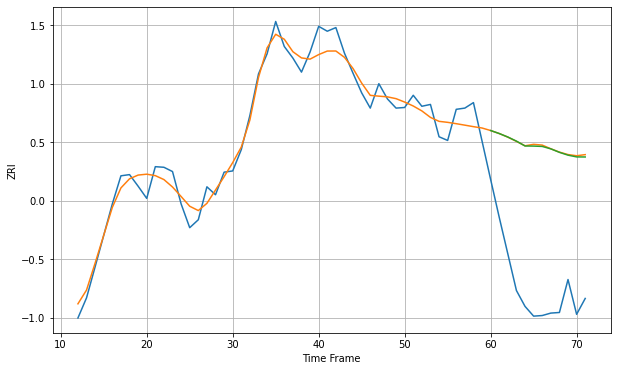

Wall time: 15.7 s
90031 20.667535697020288 233.6387534829428 232.53405379201266 [2442.22662369 2437.32997461 2431.58055499 2424.87043339 2416.92046424
 2416.74593949 2416.16905526 2412.189997   2406.47747289 2401.86878749
 2399.00365046 2398.88221985]

Got an mse at 0.0100 in round 132 and stopped training

60 60 12


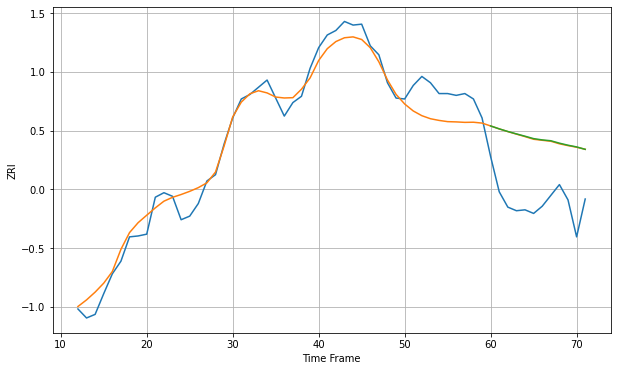

Wall time: 9.8 s
90032 17.788251849539428 71.42873296864826 71.75327893330136 [2050.06472016 2046.82045299 2043.90046827 2041.2342934  2038.67569666
 2035.99584244 2034.57709125 2033.64818824 2030.96560057 2028.6868707
 2026.80044663 2024.10027266]

Got an mse at 0.0099 in round 88 and stopped training

60 60 12


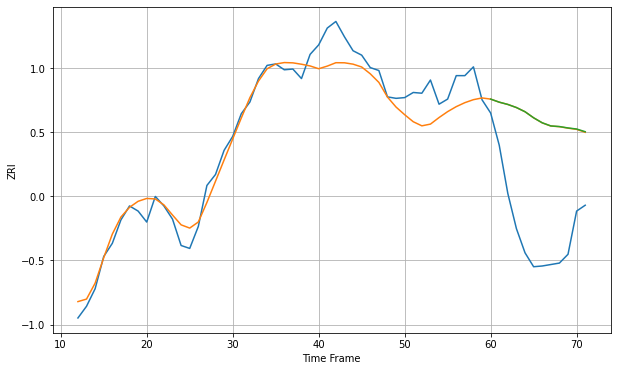

Wall time: 8.21 s
90033 24.251138796043836 154.1704549865982 154.32408152786022 [2280.9614055  2276.76501143 2273.65333937 2269.4246455  2263.70523044
 2255.42258131 2248.59444989 2244.32250495 2243.46509635 2241.54857447
 2240.10710343 2236.43335304]

Got an mse at 0.0099 in round 30 and stopped training

60 60 12


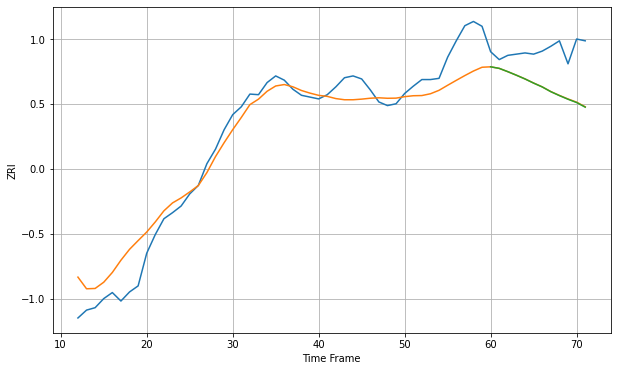

Wall time: 7.09 s
90034 35.38607764383417 64.72617695189794 65.00553288661351 [2593.06803904 2590.47108199 2585.01590124 2579.14350081 2572.97922398
 2566.114896   2559.82273858 2551.96157161 2545.49244002 2539.46454953
 2533.99985141 2526.39484741]

Got an mse at 0.0098 in round 49 and stopped training

60 60 12


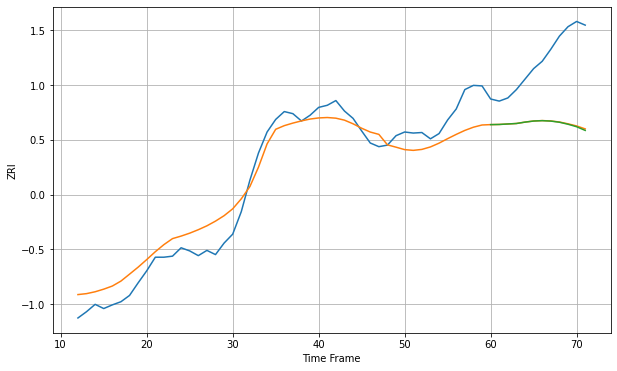

Wall time: 7.8 s
90035 35.69692210177285 128.96727672837906 129.71598269614043 [2882.09287949 2882.3901796  2883.32120168 2884.22686213 2886.87656488
 2888.94010662 2889.66513484 2888.83715534 2886.63578657 2882.80086516
 2878.06136632 2871.02083778]

Got an mse at 0.0094 in round 45 and stopped training

60 60 12


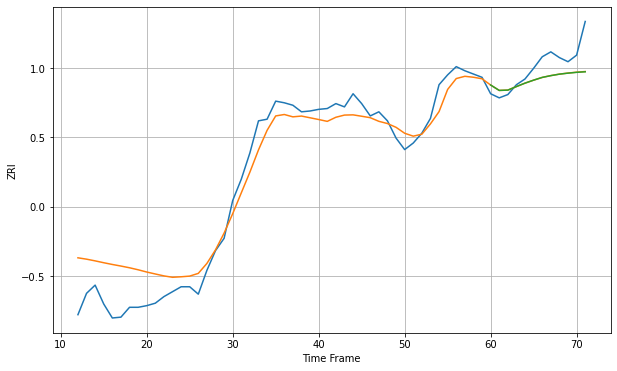

Wall time: 7.44 s
90036 26.964231802358395 23.58030923791655 23.668194987355722 [2571.63351809 2565.05687862 2565.41420059 2569.7287696  2573.92660018
 2577.55847306 2580.88867261 2583.06618309 2584.84738918 2586.07886305
 2587.06484352 2587.74330672]

Got an mse at 0.0100 in round 145 and stopped training

60 60 12


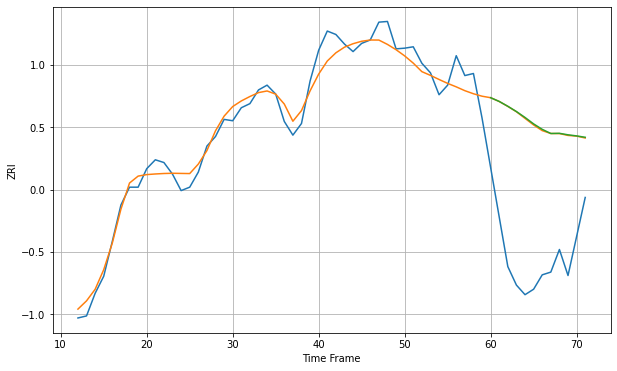

Wall time: 10.8 s
90037 18.90347128221478 197.13438005390503 197.83166857612002 [2332.66495806 2327.19610876 2320.14204299 2312.44434256 2303.82585508
 2294.40641217 2286.47413488 2280.39597235 2280.66167578 2278.47539821
 2276.86532255 2274.87318405]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


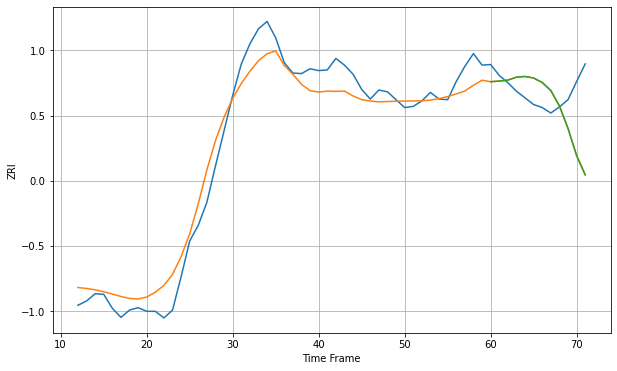

Wall time: 8.76 s
90038 30.70984446832274 69.80079909206981 69.66572060466977 [2408.67719024 2409.63678604 2411.24386046 2416.08848079 2417.29147053
 2414.71323882 2407.37405005 2394.1616504  2368.77733868 2331.81056946
 2287.12495408 2255.06244678]

Got an mse at 0.0099 in round 211 and stopped training

60 60 12


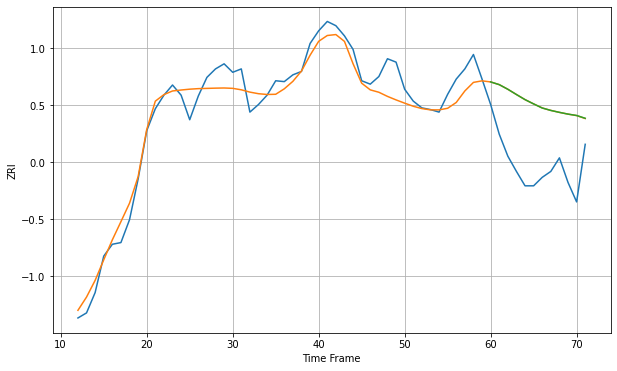

Wall time: 13.6 s
90039 17.872913336742183 76.85955545775536 76.8737515610647 [2475.63091768 2472.43105496 2466.96966656 2460.7632834  2454.74110465
 2449.67609365 2444.8583219  2441.97780945 2439.69189687 2437.64449572
 2436.01843889 2432.72592735]

Got an mse at 0.0100 in round 90 and stopped training

60 60 12


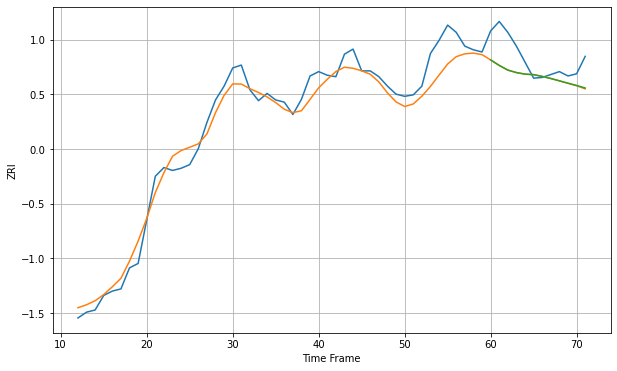

Wall time: 9.01 s
90041 19.47678978280972 31.772081909718036 31.642049211442988 [2162.11460867 2154.49790739 2148.05552344 2144.63197639 2142.50209849
 2141.77984394 2139.37422052 2136.49767612 2133.30983992 2130.04270975
 2126.97317508 2123.43185476]

Got an mse at 0.0099 in round 59 and stopped training

60 60 12


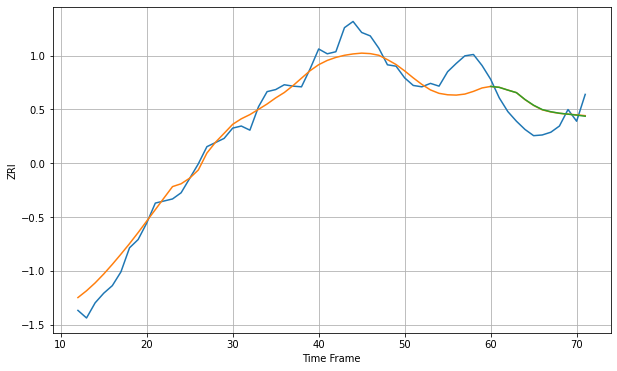

Wall time: 7.08 s
90042 22.597705155564697 29.557516362594672 29.763980411683217 [2158.55373804 2157.23860358 2153.26729947 2149.53901828 2139.55910547
 2131.22937868 2124.95590469 2121.78720189 2119.6365235  2118.22051566
 2116.87777334 2115.25862787]

Got an mse at 0.0099 in round 32 and stopped training

60 60 12


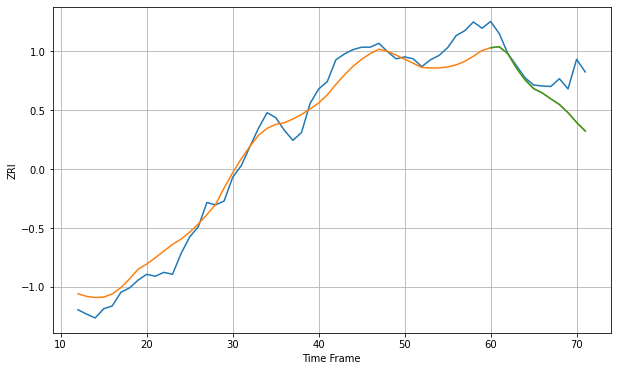

Wall time: 7.88 s
90043 31.380727488488322 58.849144041473046 58.824954743768295 [2233.90708828 2235.82210044 2221.75854388 2192.19032028 2167.86714054
 2149.64725343 2140.69078562 2128.44729142 2116.84051797 2099.95266876
 2079.85829035 2062.5942456 ]

Got an mse at 0.0099 in round 85 and stopped training

60 60 12


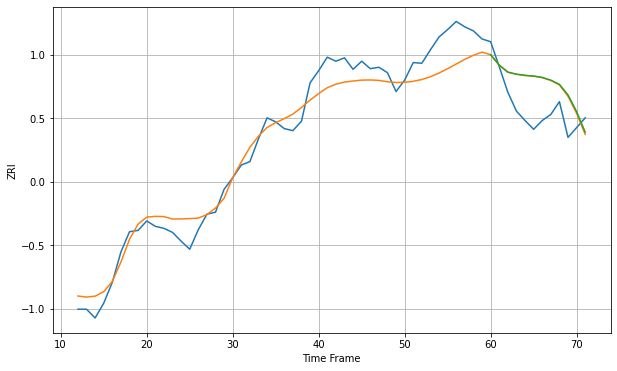

Wall time: 8.06 s
90044 26.872861050618557 47.39801024717924 47.6995105853658 [2193.64989594 2178.26253006 2167.79350491 2164.70495801 2162.9777659
 2161.96965523 2159.91133241 2155.91944068 2149.6726981  2133.95344516
 2109.32187544 2078.69957914]

Got an mse at 0.0099 in round 50 and stopped training

60 60 12


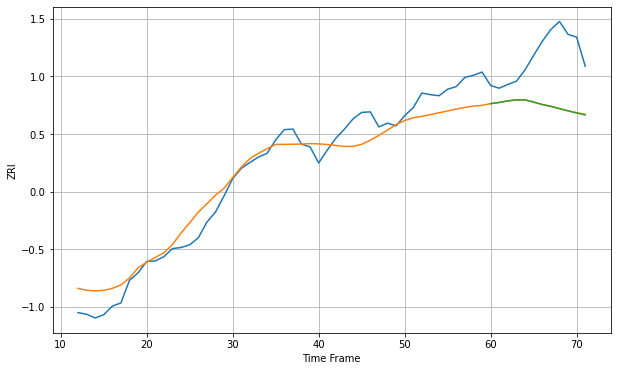

Wall time: 7.33 s
90045 32.31677946774688 101.20868694965864 101.3529869177585 [2560.23395243 2562.51820768 2565.42980697 2567.19378868 2567.28248461
 2563.08784573 2558.62109461 2555.28561642 2551.03014894 2546.90701342
 2543.11494342 2539.41810504]

Got an mse at 0.0097 in round 29 and stopped training

60 60 12


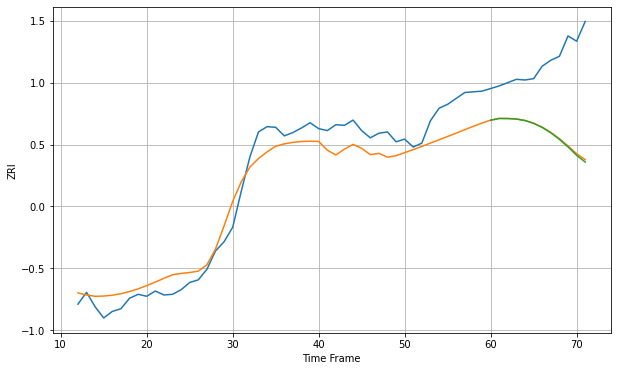

Wall time: 7.48 s
90046 29.520875959584664 114.56334211968898 115.83505718844405 [2451.87054267 2454.4860562  2454.3331031  2453.59606248 2451.27689602
 2447.01751141 2440.79326844 2432.59489625 2422.6453924  2411.15274271
 2398.44819422 2388.21344616]

Got an mse at 0.0097 in round 45 and stopped training

60 60 12


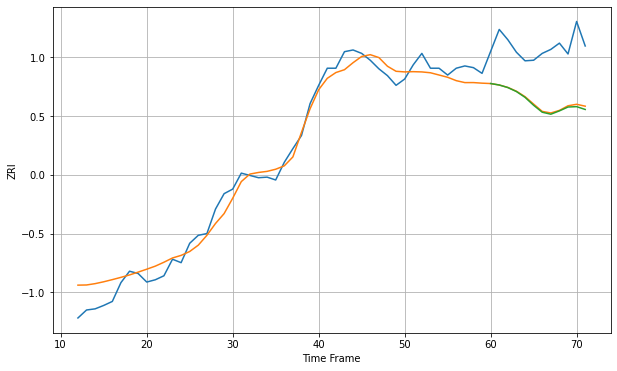

Wall time: 7.38 s
90047 22.02853796731842 96.34117484756874 98.25576076125519 [2065.13252974 2062.56217616 2058.08200224 2051.069859   2040.93813677
 2027.00705508 2014.83919296 2011.36322397 2017.17948682 2023.96759634
 2024.60913442 2019.66685794]

Got an mse at 0.0100 in round 80 and stopped training

60 60 12


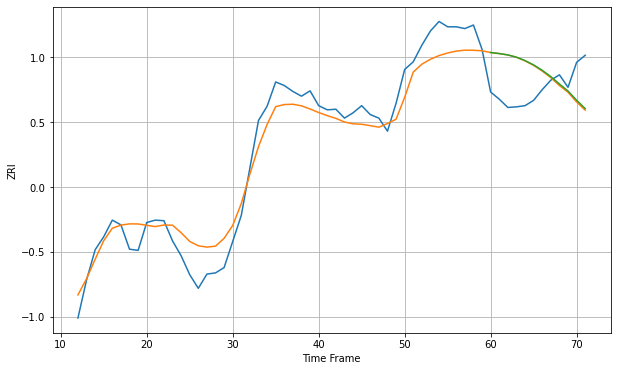

Wall time: 8.37 s
90048 32.52948695497362 63.757257246622636 63.3154112906464 [2894.63763387 2892.85392669 2890.59830196 2886.8125681  2881.02884172
 2873.75665008 2864.67675208 2854.00435592 2841.5655876  2829.69329033
 2814.16669731 2800.12765119]

Got an mse at 0.0099 in round 116 and stopped training

60 60 12


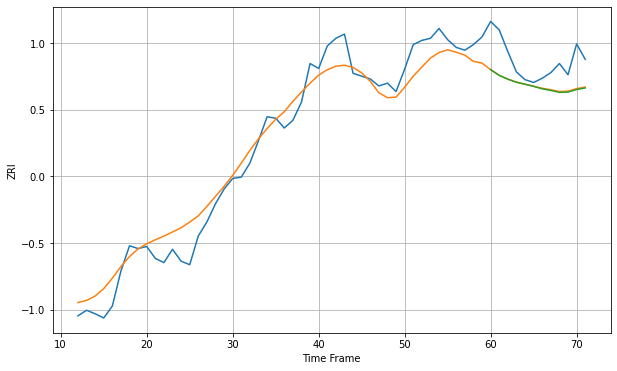

Wall time: 8.77 s
90061 25.87780763832011 40.150463913466176 40.693279082223654 [2177.21259202 2169.13060407 2163.67624994 2159.29566771 2156.39765065
 2153.34092357 2149.90241163 2147.59853815 2144.80900908 2145.2533801
 2148.88140042 2151.12601959]

Got an mse at 0.0098 in round 71 and stopped training

60 60 12


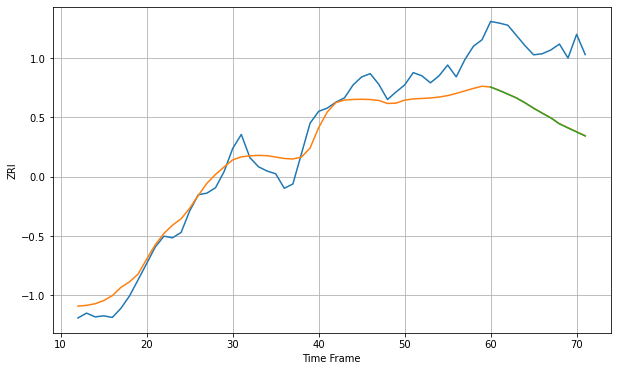

Wall time: 8.88 s
90062 34.081438112587534 130.24961919397845 130.4901013028166 [2005.14886296 1998.8528911  1991.98871471 1984.86230097 1975.79090879
 1965.78123209 1956.58755626 1947.68870246 1936.72348087 1929.06907664
 1921.59645492 1914.16513299]

Got an mse at 0.0100 in round 84 and stopped training

60 60 12


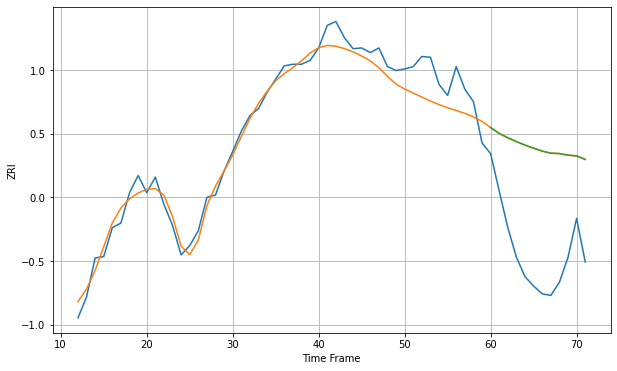

Wall time: 8.29 s
90063 20.708031242689337 140.70220863939304 140.63430975321148 [2304.67778872 2297.12906948 2291.5164525  2286.63190868 2282.09264417
 2278.1707245  2274.41050293 2271.72583414 2271.24474934 2269.16297433
 2268.16415795 2263.62646113]

Got an mse at 0.0098 in round 436 and stopped training

60 60 12


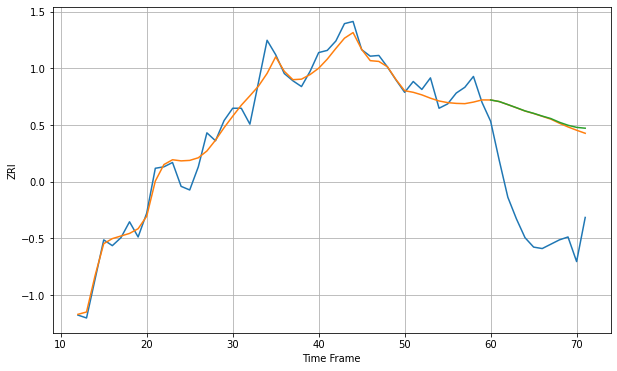

Wall time: 19.4 s
90065 16.676127765558494 150.3562709005548 151.7066290878729 [2413.44069441 2411.26171275 2407.07788912 2402.75375189 2398.31251045
 2394.96330089 2391.1735773  2387.75580678 2382.61295288 2378.48950318
 2375.56925399 2374.40570284]

Got an mse at 0.0098 in round 46 and stopped training

60 60 12


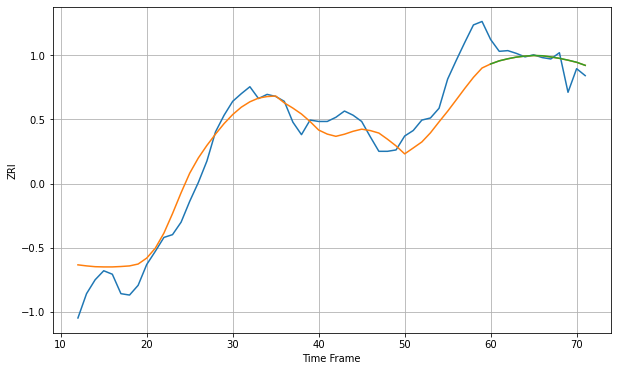

Wall time: 10 s
90066 31.73043237013845 18.520463877033443 18.5461998539038 [2671.80575114 2676.28283026 2679.27445261 2681.70197493 2683.13107583
 2683.97541072 2683.6507391  2681.94873048 2679.91815316 2677.33378518
 2674.29916888 2669.78255506]

Got an mse at 0.0100 in round 100 and stopped training

60 60 12


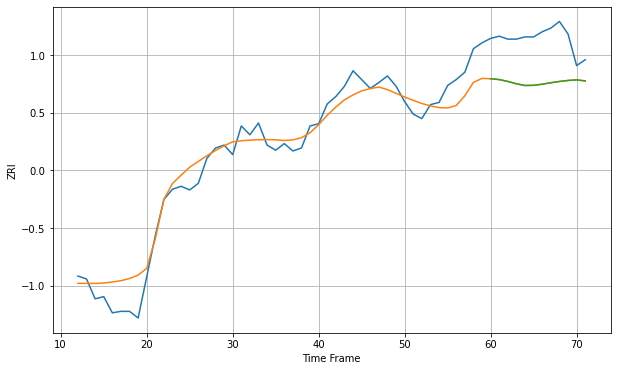

Wall time: 10 s
90068 22.927194999019484 60.9788096315924 60.97438970612248 [2371.14622931 2370.02964785 2367.48151107 2364.29551044 2361.98767104
 2362.22736959 2363.68825482 2365.72291044 2367.42505207 2368.80889083
 2369.62641244 2368.26635478]

Got an mse at 0.0098 in round 30 and stopped training

60 60 12


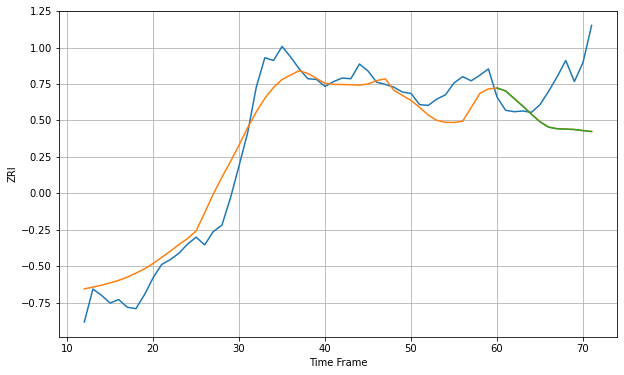

Wall time: 6.31 s
90069 31.448470476168904 68.65960983088355 68.69052460153877 [2722.80122216 2718.62088291 2707.71055729 2696.92248957 2685.38825779
 2674.58189086 2666.85058527 2664.63774998 2664.12612475 2663.55072402
 2662.02821438 2660.7430345 ]

Got an mse at 0.0098 in round 106 and stopped training

60 60 12


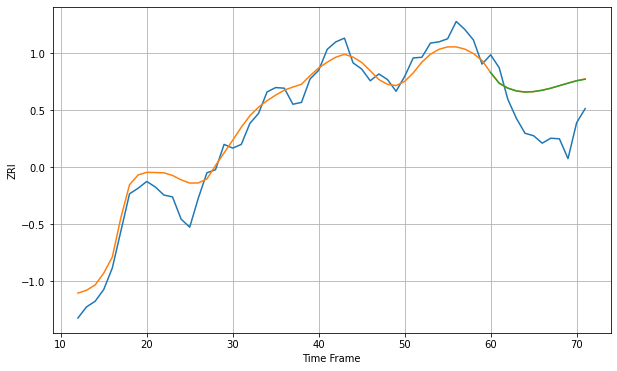

Wall time: 8.86 s
90220 24.502511052834098 68.64898867453608 68.54946845193602 [2158.28648653 2140.97965982 2133.08899525 2128.50721051 2126.74865241
 2127.47500036 2129.68153202 2132.94374947 2137.0472986  2141.052517
 2144.93973492 2147.49455568]

Got an mse at 0.0099 in round 90 and stopped training

60 60 12


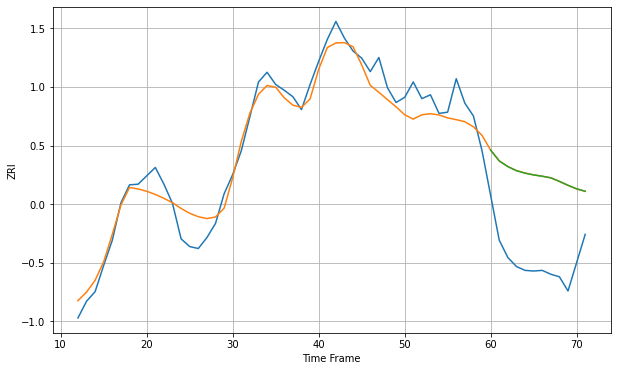

Wall time: 8.06 s
90221 25.733709240412725 134.82195135125502 134.79562624382572 [2220.00825957 2203.16439108 2194.3842263  2188.01360891 2184.08266591
 2181.40663735 2179.32374148 2176.83232281 2171.4057711  2165.29815181
 2159.83242578 2156.00428471]

Got an mse at 0.0098 in round 40 and stopped training

60 60 12


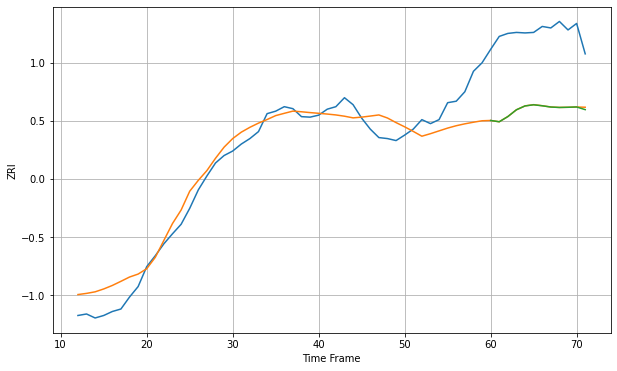

Wall time: 6.61 s
90232 37.28865230405498 154.90182060933134 155.23691937869285 [2655.34190634 2652.73526086 2663.13375492 2676.77594767 2684.47646958
 2686.81356389 2684.80892009 2682.2655959  2681.41640527 2681.81090679
 2682.44955729 2677.05509798]

Got an mse at 0.0099 in round 93 and stopped training

60 60 12


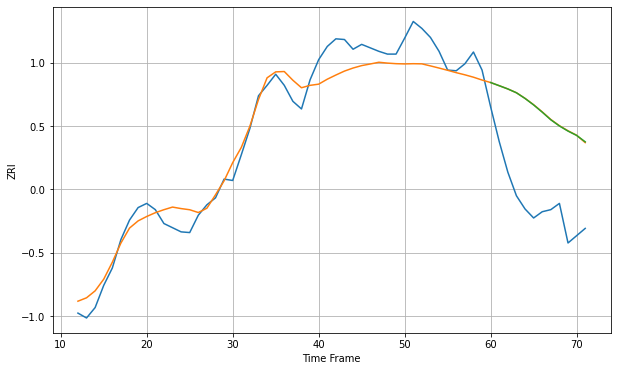

Wall time: 9.98 s
90247 25.963133410312256 131.78209283159023 131.65420398507797 [2336.03494325 2331.48562648 2326.81022371 2321.29777132 2313.14576213
 2303.8263793  2293.40826166 2282.383085   2273.51301509 2266.12278677
 2259.90501629 2250.69010323]

Got an mse at 0.0099 in round 145 and stopped training

60 60 12


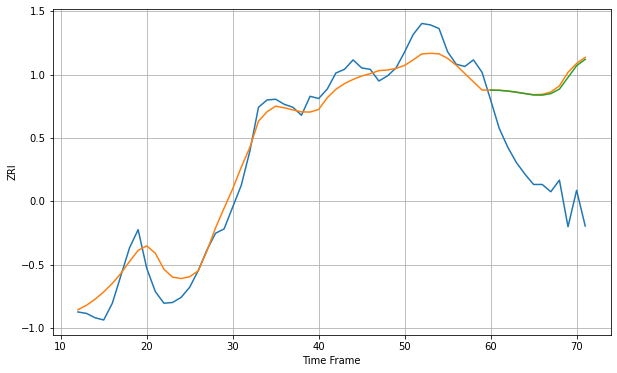

Wall time: 9.73 s
90250 23.117849210154137 137.0075374956725 134.75968189241485 [2288.52523019 2288.26690279 2287.20580278 2285.65748306 2283.71905559
 2281.84971679 2281.63525458 2283.66792637 2289.88954716 2305.99134136
 2322.05430305 2330.69161443]

Got an mse at 0.0100 in round 109 and stopped training

60 60 12


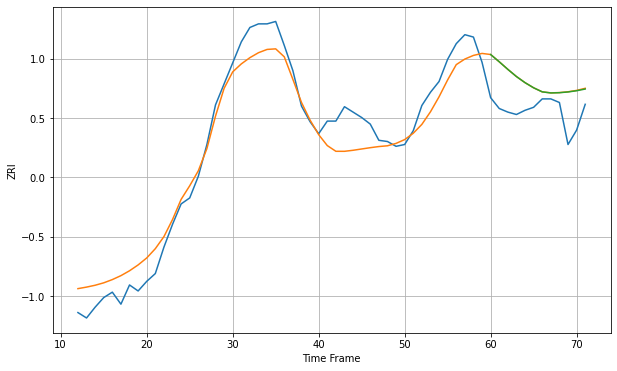

Wall time: 8.95 s
90254 33.251989107380794 55.378796937596285 55.221066930574786 [2760.93002121 2748.8499561  2736.19230355 2724.24725145 2714.05347717
 2705.47989638 2698.73885365 2696.91775091 2697.31960986 2698.54060424
 2700.57434562 2703.44762308]

Got an mse at 0.0099 in round 146 and stopped training

60 60 12


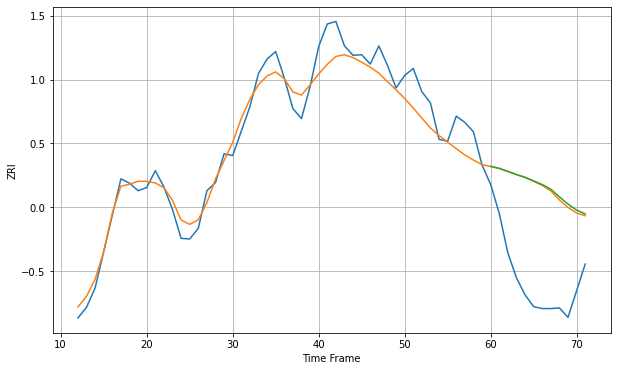

Wall time: 9.54 s
90255 27.956356276985407 152.8826788165583 154.86999951197774 [2287.75268934 2284.68100806 2279.76826005 2274.80592925 2270.5256963
 2264.68070044 2258.88249538 2251.41868925 2239.22993258 2227.72808144
 2218.05956605 2211.96800208]

Got an mse at 0.0099 in round 125 and stopped training

60 60 12


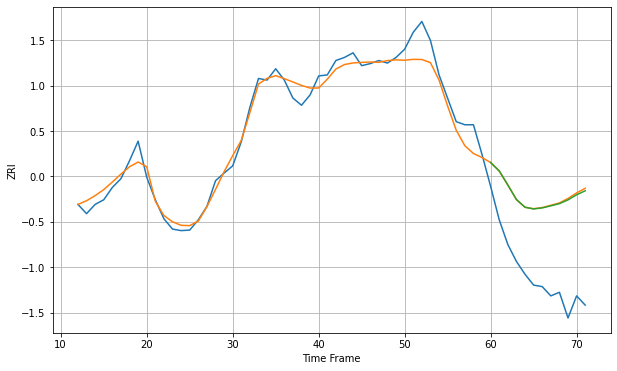

Wall time: 9.02 s
90260 23.040503672435335 160.48932185077913 158.91882846072198 [2447.47320255 2431.09586559 2403.83413991 2375.49393307 2360.46294984
 2357.21082835 2359.17136982 2363.23201752 2367.46848452 2374.81931969
 2384.72287428 2392.49958168]

Got an mse at 0.0098 in round 145 and stopped training

60 60 12


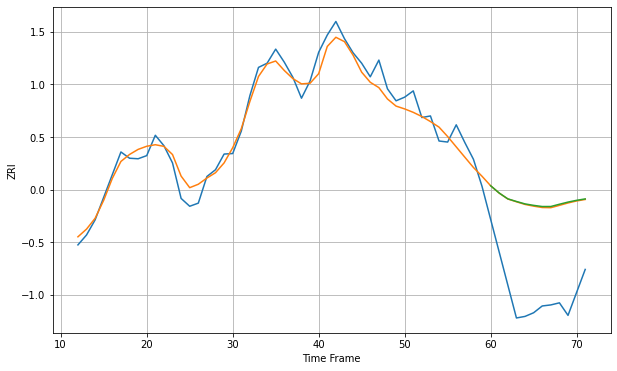

Wall time: 10.4 s
90262 21.43116812880752 178.3042735557118 179.52964077930628 [2233.31190984 2219.29468629 2208.17520247 2203.15448521 2198.49730342
 2195.73016136 2193.50202766 2193.53422244 2197.87168566 2201.98902837
 2205.39507181 2208.07807913]

Got an mse at 0.0099 in round 74 and stopped training

60 60 12


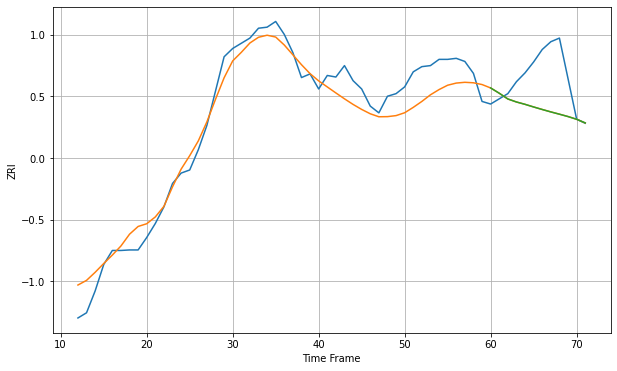

Wall time: 7.66 s
90266 34.96811949189446 77.60150446172618 77.6476992399996 [2901.98210897 2891.80540607 2880.74567824 2874.95025062 2870.42348151
 2865.32966544 2860.4743875  2855.80189336 2851.40877172 2846.87140791
 2841.63115293 2834.65463167]

Got an mse at 0.0098 in round 203 and stopped training

60 60 12


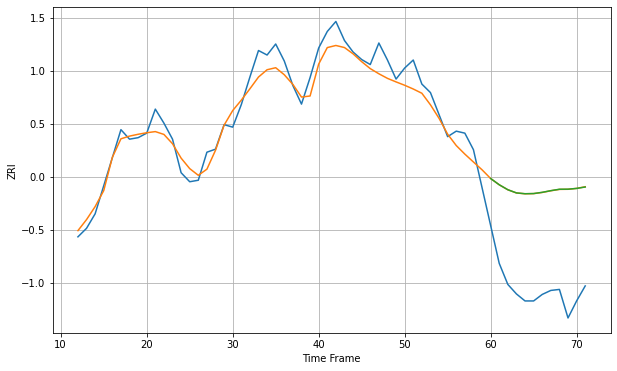

Wall time: 15.9 s
90270 27.498141863310174 199.59347634998744 199.6977040222001 [2241.46174718 2228.97311205 2219.07005448 2212.71161612 2211.08548174
 2211.4289215  2213.87639732 2217.22292826 2220.01159714 2220.14795418
 2221.67902725 2224.48126056]

Got an mse at 0.0100 in round 76 and stopped training

60 60 12


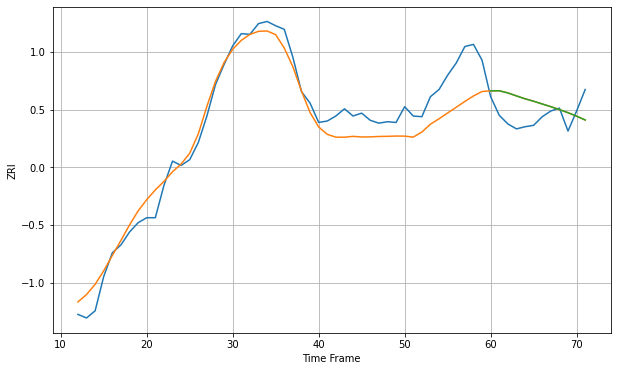

Wall time: 8.89 s
90277 28.79766910626139 29.95739880162367 29.94256107639005 [2650.15647405 2650.22215989 2647.24341324 2643.05544392 2639.03579566
 2635.61434149 2631.78702651 2628.00107893 2623.95287844 2619.63709165
 2614.78988421 2609.45170903]

Got an mse at 0.0100 in round 127 and stopped training

60 60 12


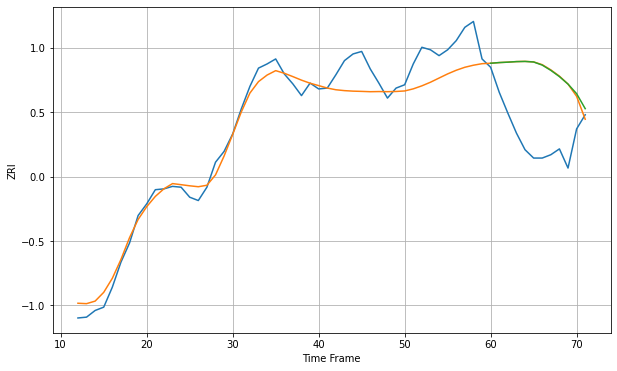

Wall time: 9.89 s
90278 21.680180701920264 81.28280636948047 81.2414461233076 [2502.8395995  2503.64848579 2504.13696201 2504.80147079 2505.0175867
 2504.35377914 2500.62285066 2494.29278181 2486.81082015 2477.81617745
 2466.29118183 2448.31699142]

Got an mse at 0.0100 in round 98 and stopped training

60 60 12


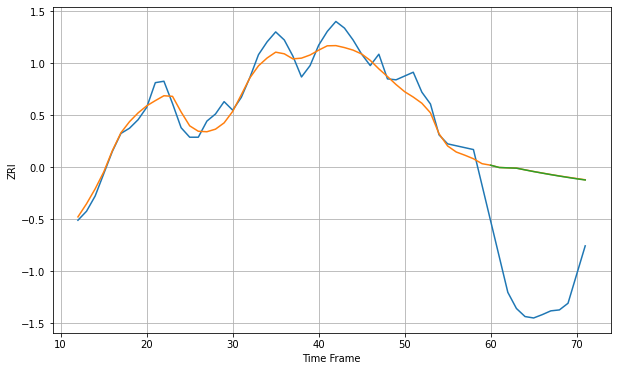

Wall time: 9.22 s
90280 25.00870159587369 254.77833998472008 254.58058484983158 [2326.00848076 2321.12234602 2320.4546139  2319.79314046 2316.14902618
 2312.61908754 2309.3572613  2306.15587755 2303.09464876 2300.2203632
 2297.38747134 2294.86261008]

Got an mse at 0.0100 in round 74 and stopped training

60 60 12


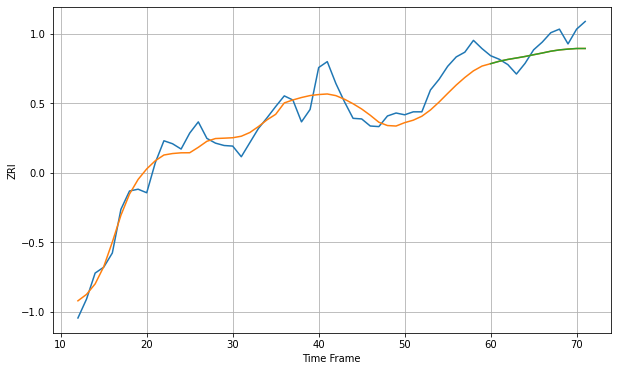

Wall time: 8.65 s
90291 25.97034453934282 24.168200226630873 24.185949290235637 [3171.54171775 3175.60625444 3178.71040472 3181.14933052 3183.71082704
 3186.68369002 3189.55135167 3192.64236607 3194.84904604 3196.21049966
 3197.20902296 3197.21932525]

Got an mse at 0.0100 in round 67 and stopped training

60 60 12


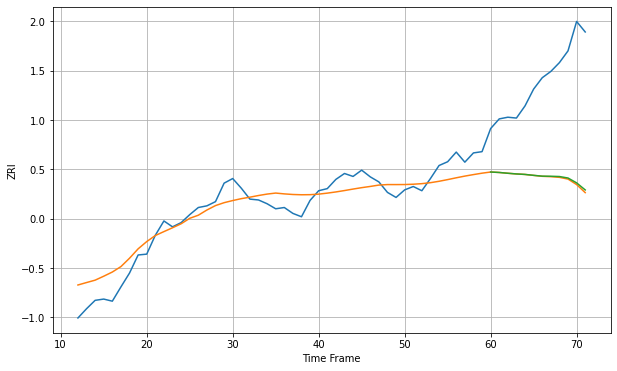

Wall time: 8.17 s
90292 35.60342381953239 243.96081186892414 242.01486910219595 [3088.53746809 3087.43860553 3085.56820925 3083.95326385 3082.77613032
 3080.60949599 3078.67214732 3078.46182476 3077.79200856 3074.2536627
 3062.70898533 3045.86486045]

Got an mse at 0.0099 in round 59 and stopped training

60 60 12


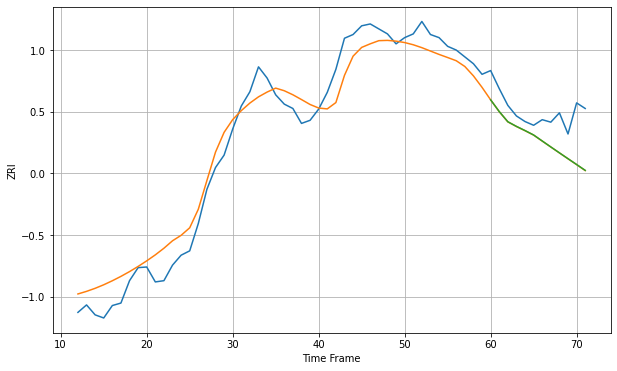

Wall time: 8.46 s
90301 30.269102346047482 52.75791041463334 52.624182323422296 [2129.91567743 2111.07947005 2094.67630787 2087.21172695 2080.47983697
 2073.37304351 2063.72576158 2054.13096869 2044.63394574 2035.21457207
 2025.87582578 2016.4708996 ]

Got an mse at 0.0100 in round 109 and stopped training

60 60 12


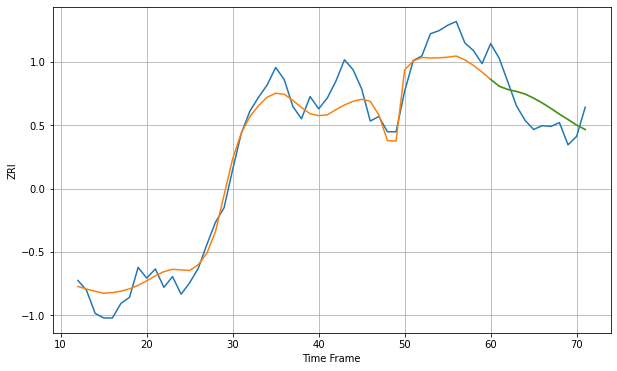

Wall time: 9.9 s
90302 22.98388523219159 29.58284923477749 29.602829147298422 [2278.43938293 2269.44625048 2265.1947194  2262.67056702 2259.31278822
 2253.93795938 2247.66226522 2240.59411154 2233.00870777 2226.02988127
 2218.69751926 2212.86015015]

Got an mse at 0.0099 in round 173 and stopped training

60 60 12


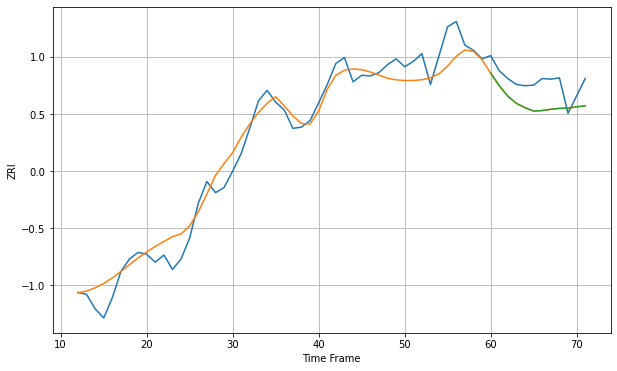

Wall time: 11.2 s
90303 24.372594591596194 34.38726960267946 34.40484225398004 [2025.219503   2006.11832065 1989.99981942 1979.17540488 1972.56988977
 1967.45302838 1968.18433312 1970.08465991 1971.47064527 1972.02248505
 1973.79750315 1975.49521475]
60 60 12


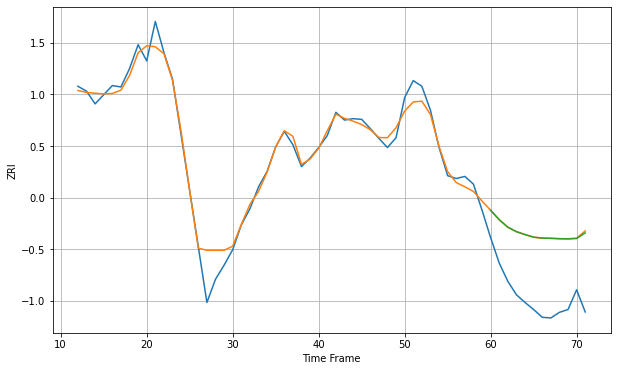

Wall time: 19.9 s
90304 16.566337956086276 93.1681730948113 92.82592852531684 [2493.93878448 2480.52324123 2469.84446082 2463.55280835 2459.41440928
 2455.7005414  2454.42106461 2454.09978471 2453.55671129 2453.29139648
 2453.82895894 2461.77643276]

Got an mse at 0.0100 in round 95 and stopped training

60 60 12


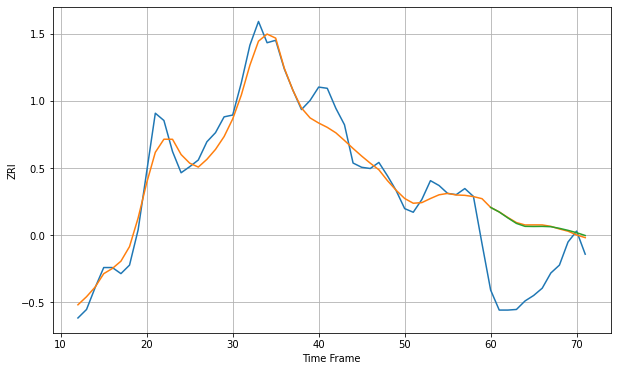

Wall time: 8.65 s
90404 26.746078647844726 107.55669780124803 106.73978342288764 [3169.95781195 3162.37877816 3152.70800469 3143.62827912 3138.78316664
 3138.57791727 3138.73729224 3138.20689595 3135.53611682 3132.23097313
 3128.3559775  3123.72445333]

Got an mse at 0.0100 in round 147 and stopped training

60 60 12


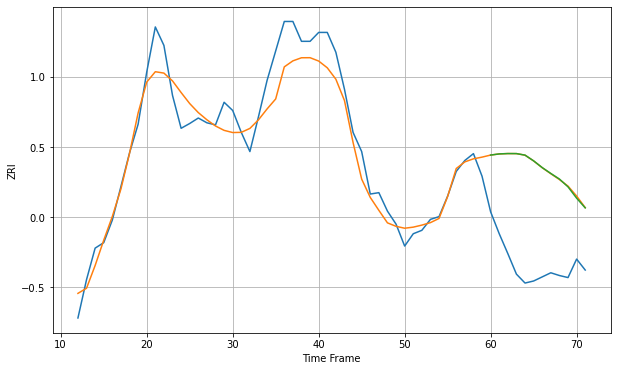

Wall time: 12.6 s
90405 29.86995552989555 141.1223830683135 140.99795230891655 [3068.90666124 3070.57244072 3071.10831028 3071.05770795 3068.81529364
 3060.45215819 3050.60591147 3042.05024716 3033.88785067 3022.4741921
 3005.9831315  2991.799982  ]

Got an mse at 0.0098 in round 42 and stopped training

60 60 12


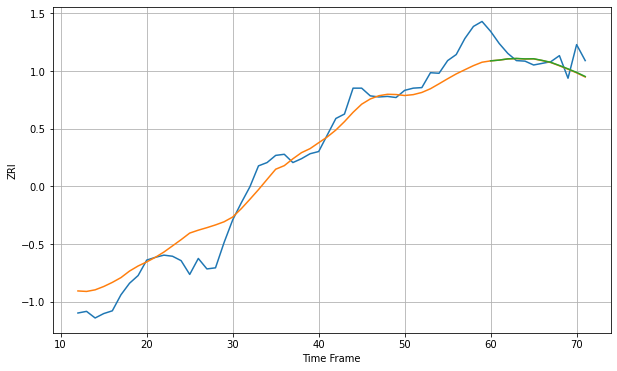

Wall time: 7.8 s
90501 35.82439693625236 26.075015688354608 25.88739819704781 [2097.51015638 2098.93687058 2101.12622844 2101.8974729  2101.07892474
 2101.3659652  2098.3456116  2094.83103654 2089.10136604 2083.01508498
 2076.52648562 2069.17228513]

Got an mse at 0.0099 in round 277 and stopped training

60 60 12


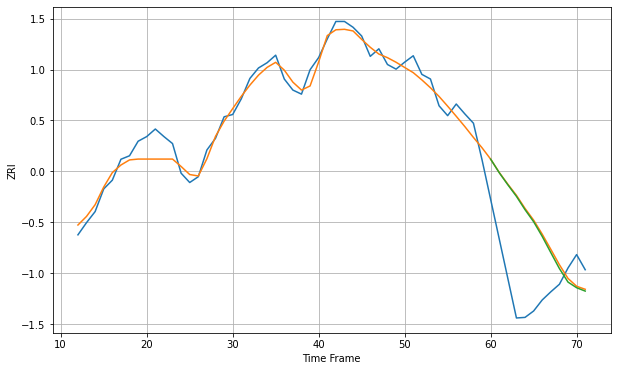

Wall time: 13.8 s
90640 17.99364347027159 119.67917352656664 118.24006873107689 [2214.20387029 2190.87085959 2170.10257486 2150.19646749 2127.24303986
 2106.57073389 2081.25946559 2053.41739189 2025.98660739 2002.71800244
 1993.0348719  1987.24393385]

Got an mse at 0.0099 in round 205 and stopped training

60 60 12


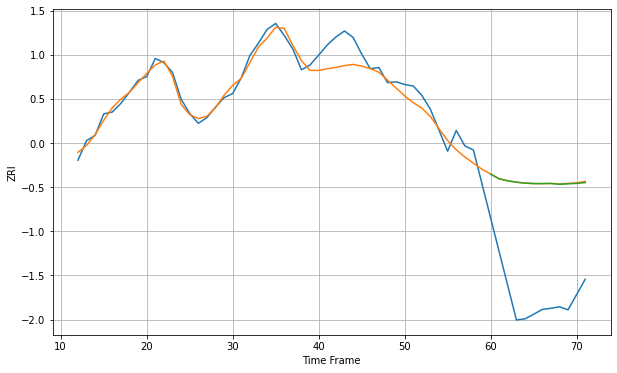

Wall time: 12.9 s
90723 30.094317456536277 303.9744996303287 303.438179932729 [2357.23497742 2344.52431956 2339.31530376 2335.71699841 2333.34220084
 2332.05870925 2331.93232039 2332.22791282 2330.21994855 2331.38454861
 2332.42123827 2334.66310819]

Got an mse at 0.0096 in round 26 and stopped training

60 60 12


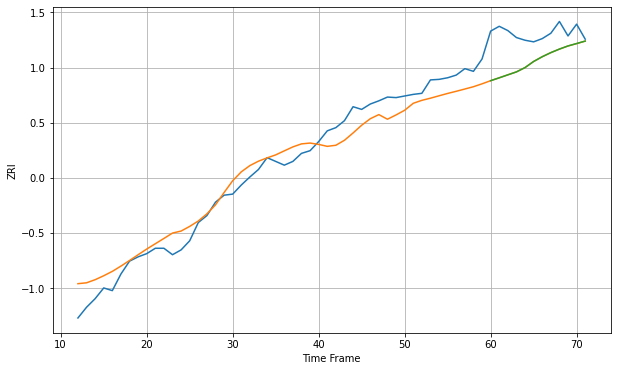

Wall time: 6.1 s
90731 28.0495225265134 57.31559704265227 57.31095904459572 [2019.54224841 2024.90312001 2030.43686067 2035.93086903 2043.97789208
 2055.35817919 2064.22417829 2071.88427977 2078.49486984 2084.36989639
 2088.8522643  2093.47399255]

Got an mse at 0.0100 in round 71 and stopped training

60 60 12


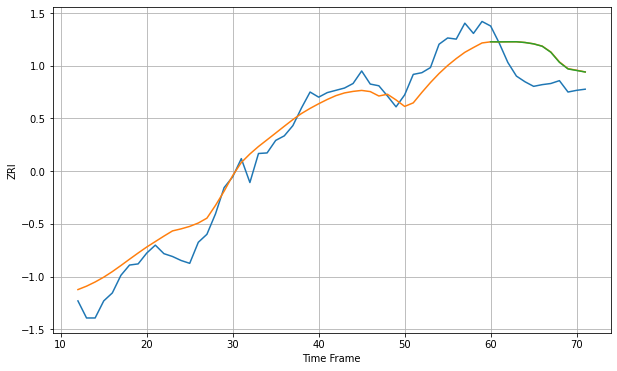

Wall time: 7.85 s
90744 31.257619012789302 48.87843723846499 48.68885498642932 [2195.24135071 2195.13555442 2195.28965474 2195.33152722 2194.01939696
 2191.63196571 2187.46708662 2176.92231342 2159.22033827 2147.56580385
 2144.89150659 2142.20417446]

Got an mse at 0.0099 in round 22 and stopped training

60 60 12


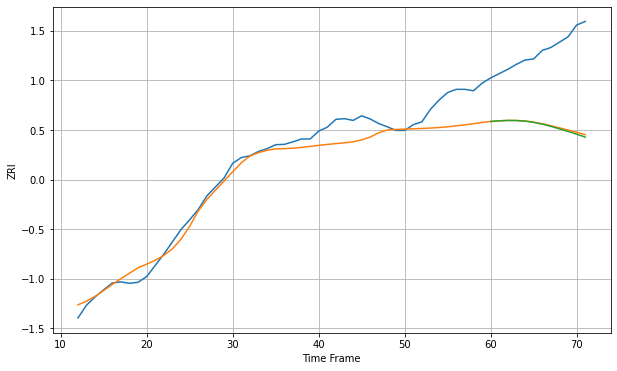

Wall time: 6.14 s
90802 44.075646584644055 212.9147017118521 215.35326469092996 [1896.08441176 1897.93353305 1898.8900364  1898.6210886  1897.03445796
 1893.55119106 1888.59160638 1882.43560072 1875.53707736 1868.17929391
 1860.50522582 1852.34109042]

Got an mse at 0.0100 in round 68 and stopped training

60 60 12


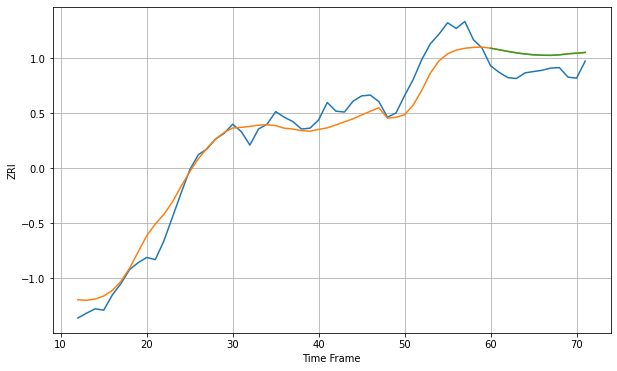

Wall time: 7.42 s
90803 36.66002901354299 44.91745303612765 44.97041198719204 [2141.59876822 2137.95933622 2134.24528919 2130.90009211 2128.24696357
 2126.43254542 2125.44351066 2125.22839706 2126.37376453 2128.83435447
 2130.1725141  2132.09079314]

Got an mse at 0.0099 in round 41 and stopped training

60 60 12


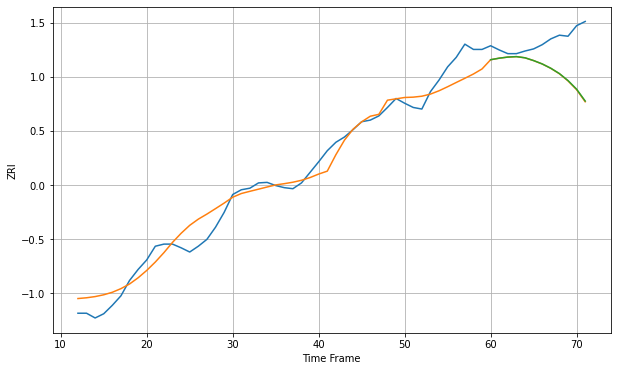

Wall time: 7.11 s
90804 26.423347499661496 68.64392611761207 68.12371744719914 [1930.48062539 1933.42628038 1935.50603585 1936.35917627 1934.12311742
 1928.85808883 1922.50001018 1914.32521574 1904.23727576 1890.97229017
 1874.65237619 1852.1900126 ]

Got an mse at 0.0099 in round 56 and stopped training

60 60 12


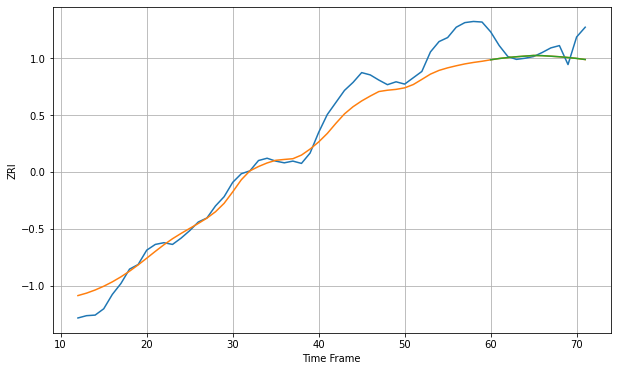

Wall time: 7.82 s
90805 30.93902813806745 26.207204728802058 26.198310628613747 [1919.29778595 1921.54954961 1923.16808166 1924.61893774 1925.6863432
 1926.82275935 1926.49136561 1925.54650477 1924.5769809  1923.27768911
 1921.69933835 1919.78519736]

Got an mse at 0.0100 in round 41 and stopped training

60 60 12


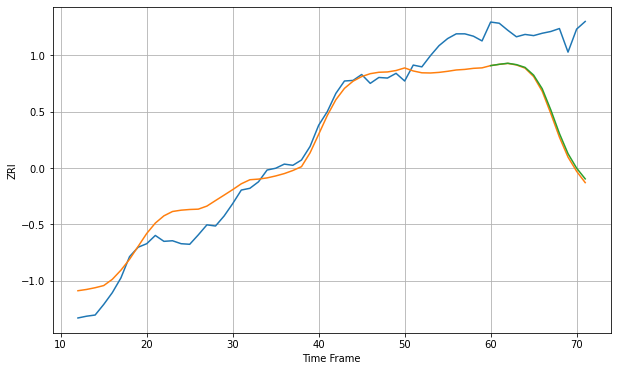

Wall time: 6.95 s
90806 31.60073741508895 144.77785362296007 140.8628799493366 [1868.09217526 1870.32692758 1872.0934595  1869.77493542 1865.11262336
 1851.9999647  1828.869277   1792.90129735 1752.97341591 1718.78443471
 1694.21150784 1675.98011323]

Got an mse at 0.0098 in round 29 and stopped training

60 60 12


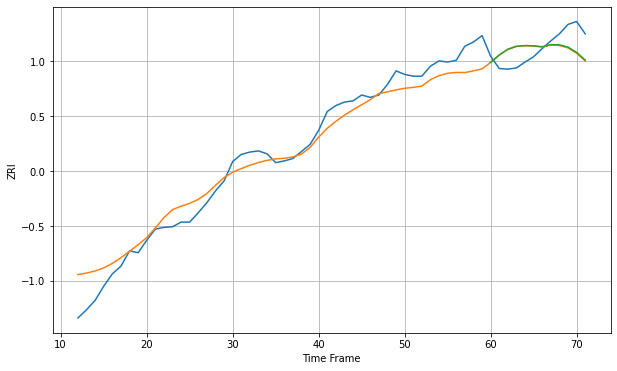

Wall time: 7.04 s
90807 26.592922983666135 30.689722452317266 30.150604361639346 [1893.35914818 1905.89647255 1915.73611477 1920.82672069 1922.05063851
 1921.65128263 1920.04333648 1923.65983132 1923.22868332 1919.40543758
 1910.48416    1897.35793451]

Got an mse at 0.0098 in round 85 and stopped training

60 60 12


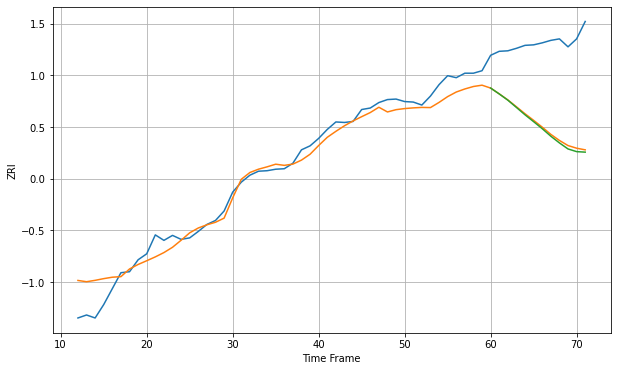

Wall time: 8.11 s
90813 26.524484945920648 167.68980960734518 171.2798685240198 [1789.13087952 1777.33319569 1764.81498318 1750.18338663 1735.37661568
 1721.57976297 1707.51665925 1692.3649266  1678.89514467 1666.74567103
 1661.37267073 1660.32963067]

Got an mse at 0.0098 in round 55 and stopped training

60 60 12


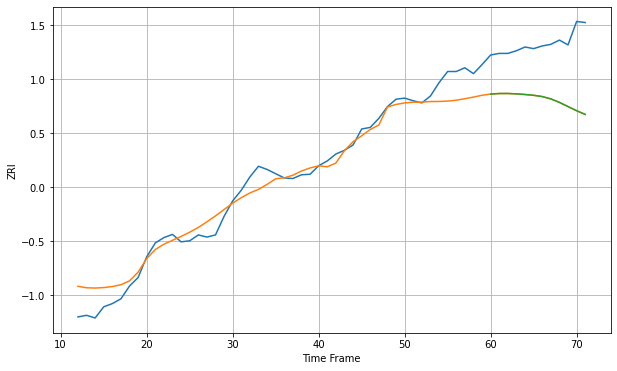

Wall time: 13.6 s
90814 27.65194520164193 109.38428131311267 109.34619844082548 [1897.57581974 1898.65231346 1898.71704969 1898.0149567  1896.80988084
 1895.33245872 1892.93838623 1888.59343278 1882.02493972 1874.11734357
 1866.40321594 1859.31623697]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


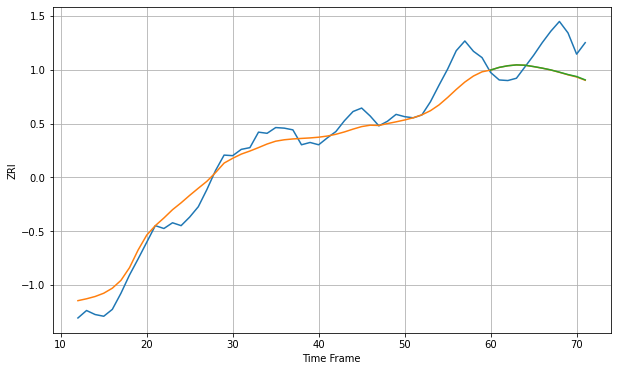

Wall time: 10.5 s
90815 26.37818940458541 48.05040722081189 47.81135884984508 [1911.27648324 1915.93960376 1918.75552178 1920.27438871 1919.70758575
 1917.37078943 1914.65701065 1911.52957304 1907.57580996 1903.4163406
 1900.01176864 1894.13143674]

Got an mse at 0.0100 in round 97 and stopped training

60 60 12


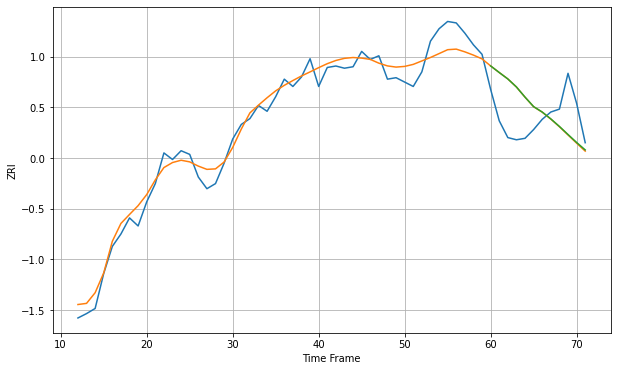

Wall time: 8.45 s
91016 17.112484654183024 51.826650684507484 51.63419428479333 [2272.12648499 2263.08585361 2254.30315955 2243.30240521 2229.40274651
 2216.38778093 2208.97156035 2199.57725889 2189.2537714  2178.2054906
 2167.33353173 2157.14006856]

Got an mse at 0.0099 in round 84 and stopped training

60 60 12


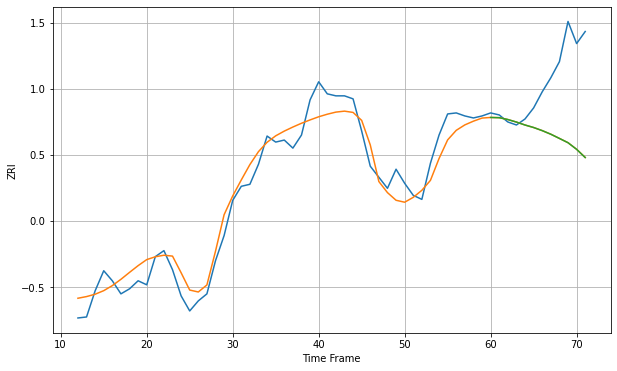

Wall time: 8.22 s
91101 16.02205849842898 65.97542534907514 66.00847110133735 [2147.49568334 2147.27126154 2145.4352215  2142.90578729 2139.97926078
 2137.49064693 2134.39627178 2130.81387312 2126.63141333 2122.37358397
 2115.77158331 2107.60699978]

Got an mse at 0.0100 in round 107 and stopped training

60 60 12


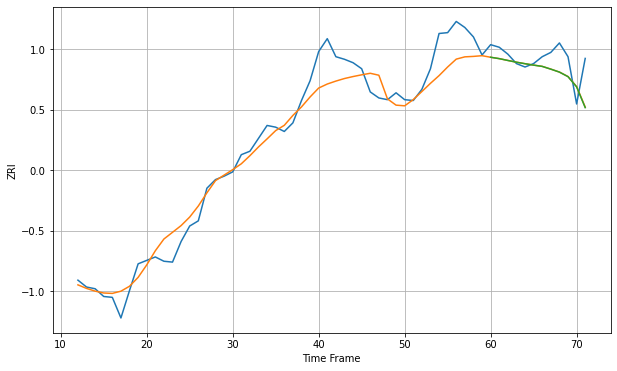

Wall time: 10.6 s
91104 20.730669250648926 22.836845817955005 22.98126919202829 [2049.35082308 2047.75450048 2045.62787665 2043.59871418 2041.83752133
 2040.19692641 2038.71883939 2035.52226686 2032.07457152 2026.7810662
 2014.87203396 1990.71873397]

Got an mse at 0.0100 in round 378 and stopped training

60 60 12


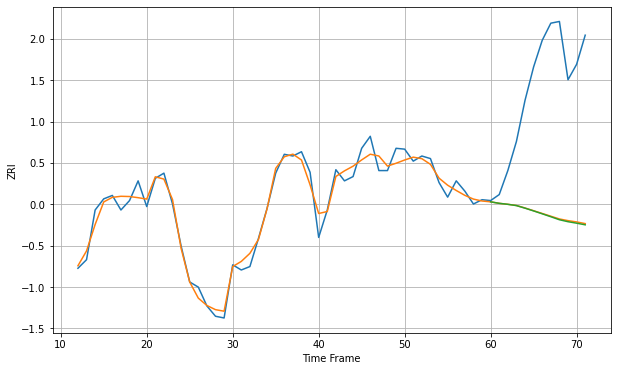

Wall time: 16 s
91105 10.446462100366695 159.44607955069392 160.1213964903071 [2642.52755291 2640.77405022 2639.62190985 2638.14941769 2635.12517624
 2631.91101959 2628.55870167 2625.13938262 2621.62467882 2619.34389935
 2617.6149089  2615.7120241 ]

Got an mse at 0.0097 in round 70 and stopped training

60 60 12


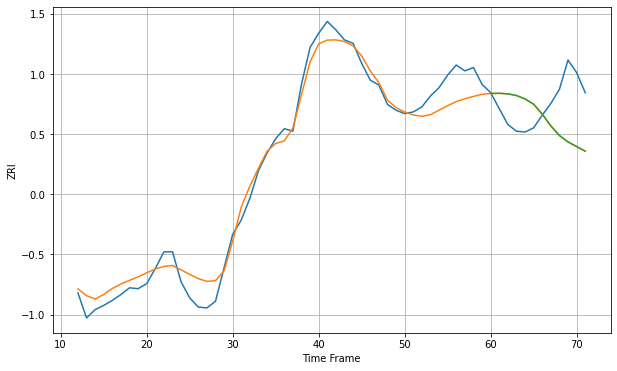

Wall time: 7.74 s
91106 18.001417777415035 51.549774141760736 51.491428600612004 [2196.05399832 2196.22226741 2195.60309162 2193.60297036 2189.50135617
 2183.22981985 2171.4560517  2157.37684719 2145.88770476 2138.20692037
 2132.70634295 2127.25870894]

Got an mse at 0.0098 in round 52 and stopped training

60 60 12


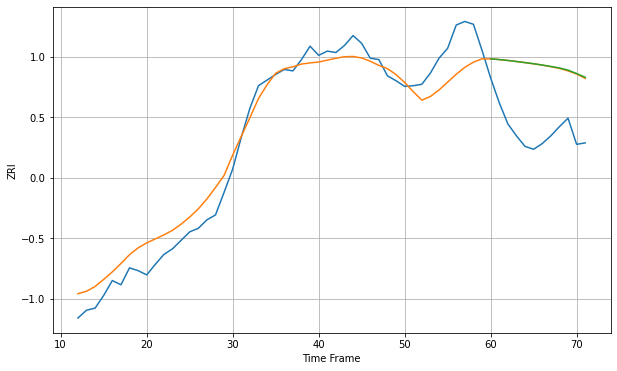

Wall time: 7.47 s
91107 27.82406474094512 93.01801087472082 93.39648847400355 [2198.00507161 2197.0369699  2195.7792544  2194.32470675 2192.73586541
 2191.12688671 2189.34189191 2187.26940285 2185.17310396 2182.10421413
 2177.21136129 2171.97509219]
60 60 12


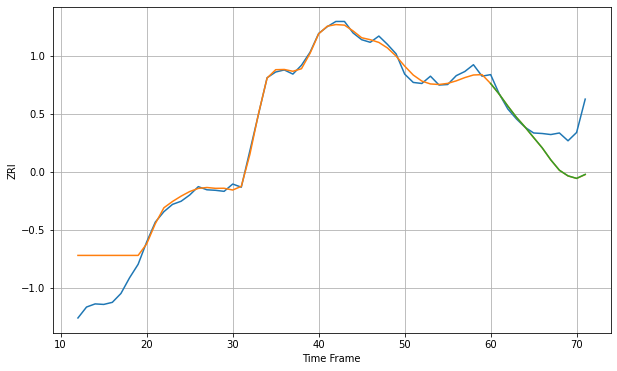

Wall time: 18.7 s
91205 35.24543940617019 59.13978302203564 59.02102769757605 [2337.89321789 2317.44410757 2294.63070151 2273.05242792 2254.42852157
 2234.28094629 2214.46798021 2191.35899776 2171.51508771 2160.68570371
 2155.873122   2163.57012476]

Got an mse at 0.0098 in round 30 and stopped training

60 60 12


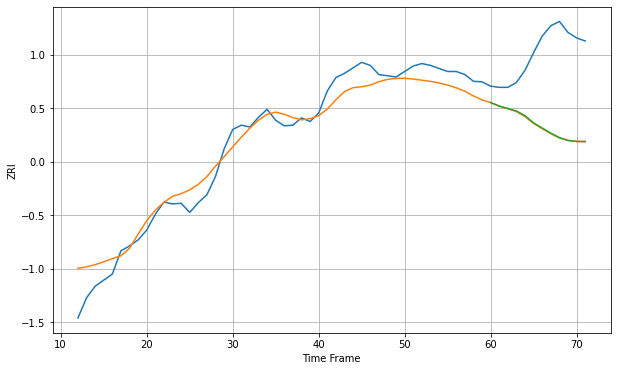

Wall time: 7.41 s
91355 25.610660214513604 129.88609781094735 129.4524103210933 [2197.04499726 2191.31491295 2187.42677765 2183.26555425 2175.50464732
 2163.79111977 2155.25211928 2146.9309581  2139.68960103 2135.0745644
 2133.34843437 2133.08375022]

Got an mse at 0.0099 in round 65 and stopped training

60 60 12


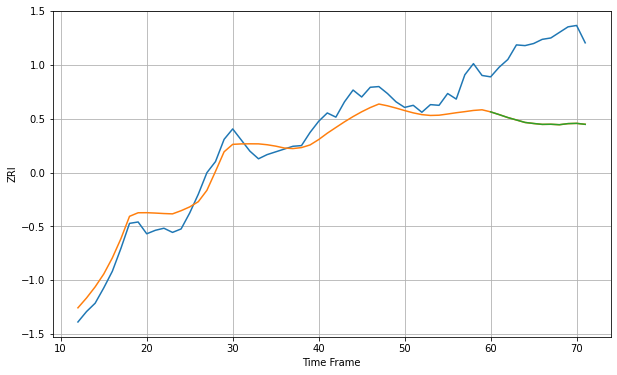

Wall time: 7.59 s
91367 23.763852749400765 112.77823397713095 112.74984120094038 [2223.5745665  2219.59511117 2215.40496117 2211.9023035  2208.36195311
 2206.85922291 2205.56539829 2205.74944766 2205.09513805 2206.66294754
 2207.03581861 2205.6155877 ]

Got an mse at 0.0100 in round 73 and stopped training

60 60 12


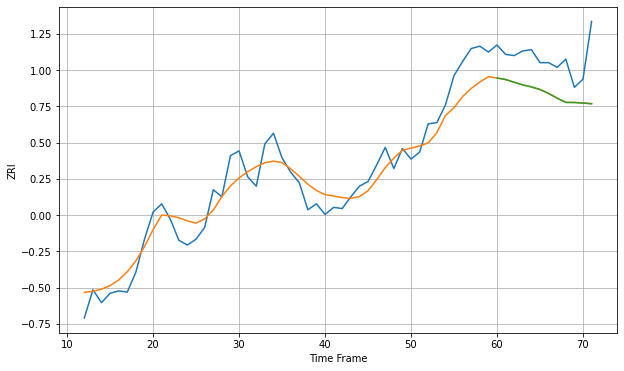

Wall time: 7.48 s
91505 15.529667585383274 31.97417994278153 32.04036429729035 [2306.95670209 2305.67259066 2303.33002016 2301.08970681 2299.3660453
 2297.16518514 2293.86416228 2289.78933823 2286.18242594 2286.08579122
 2285.60963554 2285.01637926]

Got an mse at 0.0099 in round 41 and stopped training

60 60 12


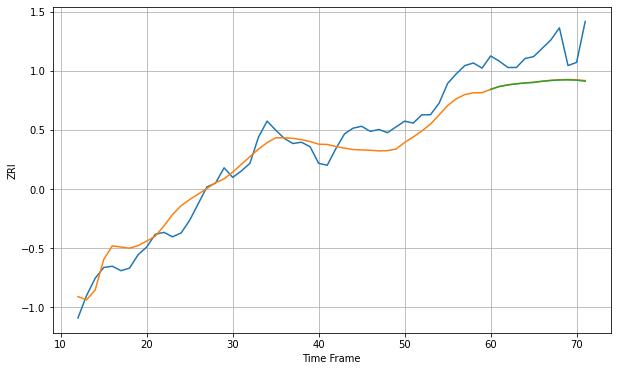

Wall time: 7.09 s
91601 25.920452326729524 51.46171410333016 51.77825438936264 [2298.71426189 2303.2092179  2305.69158926 2307.36672548 2308.73875972
 2309.63601617 2311.36307171 2312.62239241 2313.41851464 2313.62200283
 2313.07115769 2311.51560681]

Got an mse at 0.0099 in round 80 and stopped training

60 60 12


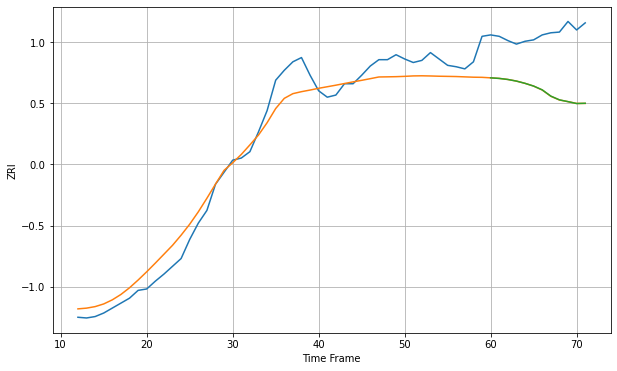

Wall time: 8.22 s
91730 22.961216600290786 81.99030606924325 81.91564323848847 [1644.33162982 1643.51613631 1642.02487958 1639.73614827 1636.5631426
 1632.70477719 1627.34764512 1618.54069453 1613.23460808 1610.705382
 1608.02429988 1608.4102673 ]

Got an mse at 0.0098 in round 30 and stopped training

60 60 12


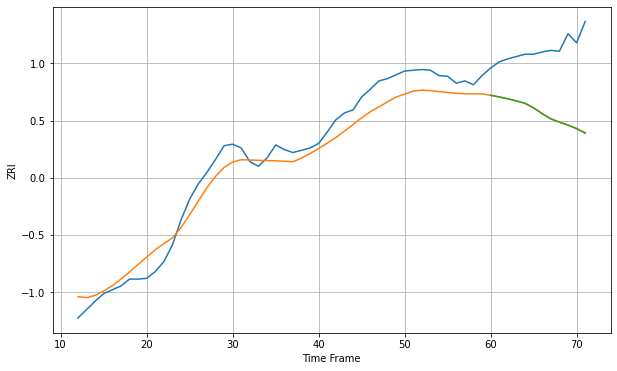

Wall time: 6.45 s
91764 20.397430541553273 86.63072539161746 86.90187780543009 [1625.11194819 1622.96626239 1620.52901597 1617.73174806 1614.58304594
 1608.5679642  1600.93408074 1594.21596795 1589.86827846 1585.93566059
 1581.23809108 1575.3013183 ]

Got an mse at 0.0098 in round 101 and stopped training

60 60 12


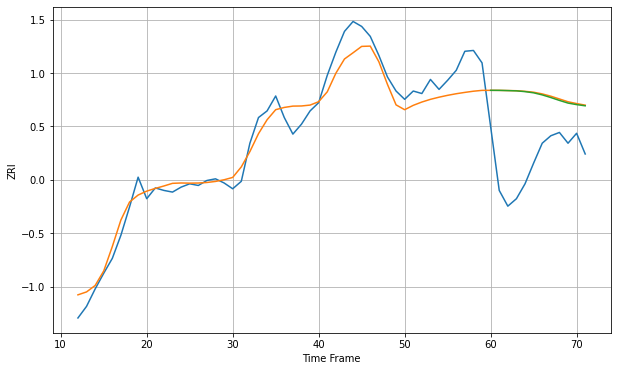

Wall time: 8.53 s
91766 19.733333466695253 85.40224620492603 84.89719458494002 [2030.86512738 2030.79756072 2030.53839671 2030.2256102  2029.28652975
 2027.84383199 2025.33848954 2022.16123479 2018.6789085  2015.45586362
 2013.6174152  2012.17842719]

Got an mse at 0.0098 in round 99 and stopped training

60 60 12


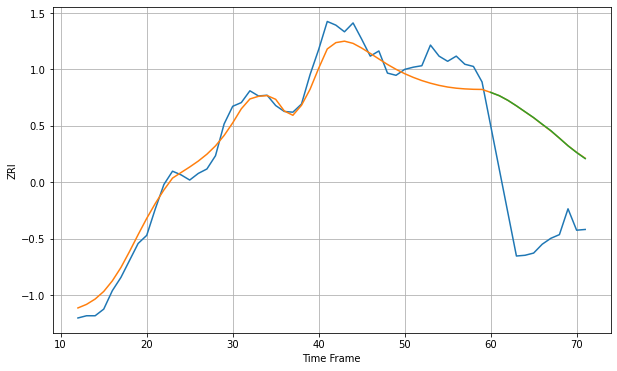

Wall time: 8.53 s
91776 20.241870305685325 141.5520791290725 141.59923779595132 [2190.85581719 2186.39280963 2180.11134172 2172.61829359 2164.61548477
 2156.63482328 2147.68190554 2139.0004803  2128.78863635 2118.46709936
 2109.34410943 2101.06629632]

Got an mse at 0.0100 in round 105 and stopped training

60 60 12


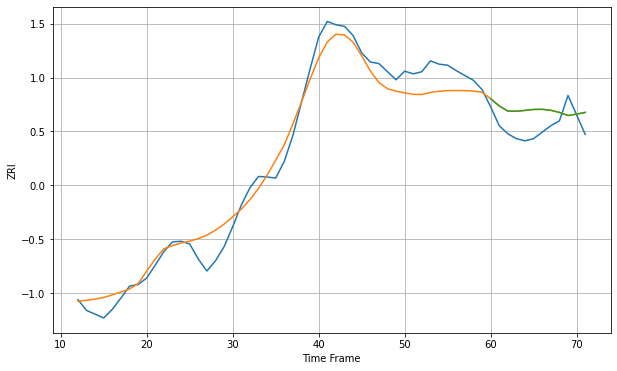

Wall time: 8.64 s
91801 29.2330830474361 38.622235213324856 38.59853115552635 [2176.0637762  2162.51937678 2153.09379737 2152.78505165 2154.3493698
 2156.10926199 2156.3492068  2154.49348837 2150.55854441 2144.81783882
 2147.37629153 2150.39423608]

Got an mse at 0.0100 in round 67 and stopped training

60 60 12


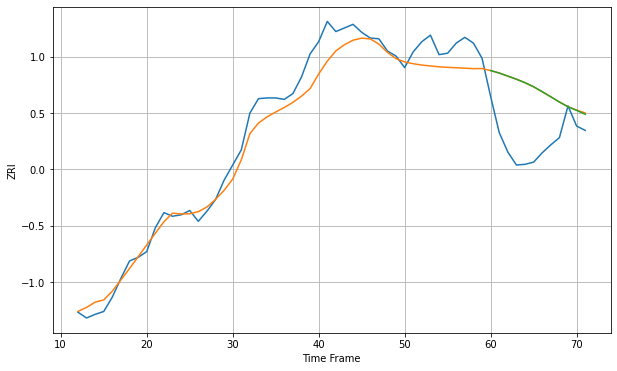

Wall time: 7.74 s
91803 22.270997495597985 77.51653622421674 77.49158964086648 [2080.94322176 2077.52875047 2073.23961535 2068.98852922 2064.13003191
 2058.51014779 2051.64061807 2044.57913762 2037.32399352 2030.67800201
 2025.75485515 2020.30094992]

Got an mse at 0.0099 in round 57 and stopped training

60 60 12


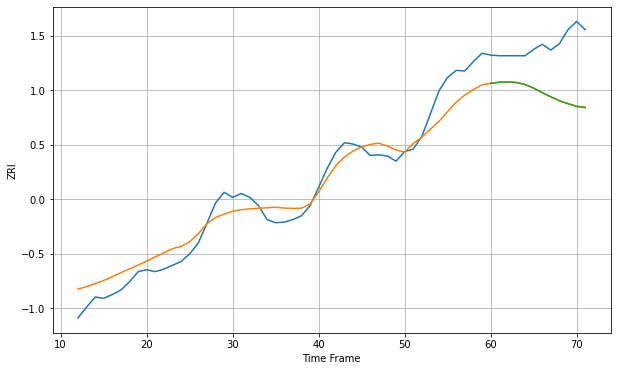

Wall time: 6.78 s
91913 25.627639648296096 80.78825034349221 81.05275205463202 [2198.51860365 2200.2757771  2200.77893835 2199.87525353 2196.69944099
 2191.04949486 2184.02622595 2177.25417173 2171.2164974  2166.40249371
 2162.09852095 2160.2067606 ]

Got an mse at 0.0080 in round 471 and stopped training

60 60 12


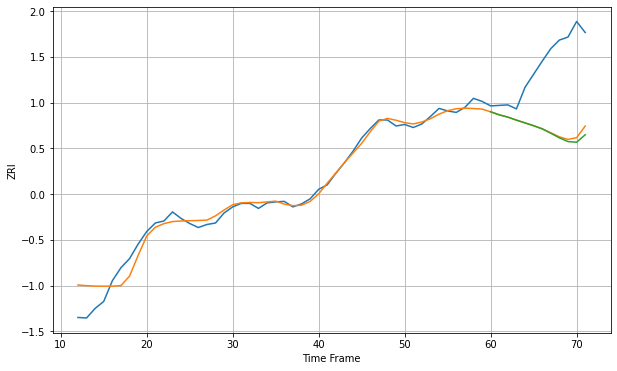

Wall time: 18.3 s
92008 18.811414148367202 138.4077331736027 142.57776098056405 [2033.2677538  2027.18254236 2022.63039255 2016.66149884 2011.11603534
 2005.47929004 1999.17801194 1990.54252386 1981.41099946 1973.96997715
 1972.74639908 1987.52198654]

Got an mse at 0.0098 in round 34 and stopped training

60 60 12


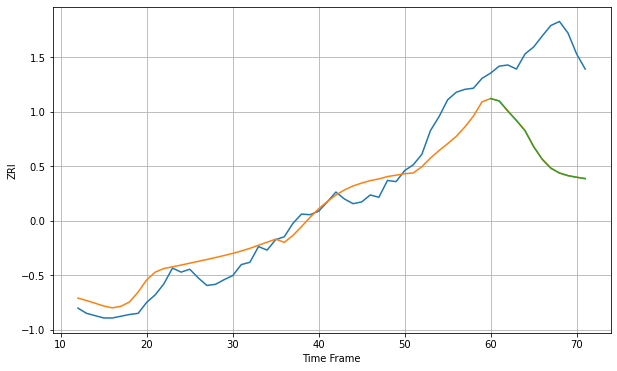

Wall time: 6.77 s
92101 31.81861039170028 178.26238589413035 178.34088971178005 [2296.16608216 2291.97313991 2274.66299997 2258.35642727 2240.76944105
 2213.28273762 2191.4079102  2176.1828631  2167.82189418 2163.24813708
 2160.5349688  2158.19739001]

Got an mse at 0.0099 in round 56 and stopped training

60 60 12


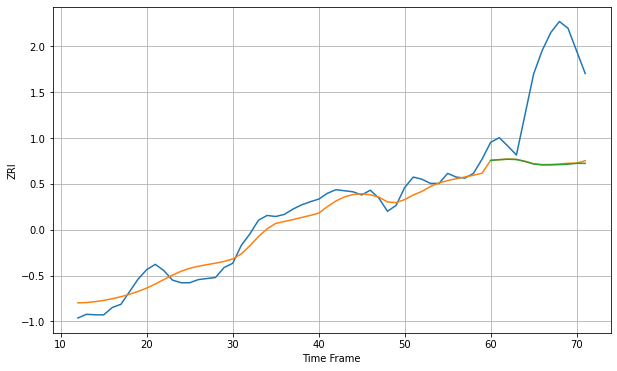

Wall time: 7.15 s
92103 20.5469430979266 174.02646353961381 175.03753549148976 [2012.7888222  2014.04176578 2014.93187785 2014.40412399 2010.68682486
 2005.92183951 2004.11595363 2004.24287768 2004.70558218 2005.45935809
 2007.19645746 2007.04587402]

Got an mse at 0.0097 in round 24 and stopped training

60 60 12


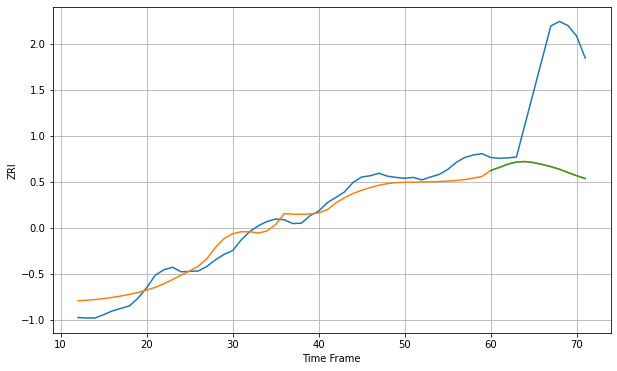

Wall time: 5.96 s
92104 27.61652156883369 235.71474489766734 235.44147449988915 [1780.66209758 1787.89043625 1795.86391838 1800.98704825 1802.20561793
 1799.64509357 1795.32648429 1789.89564045 1783.75223135 1775.95376697
 1768.36311146 1761.42807432]
60 60 12


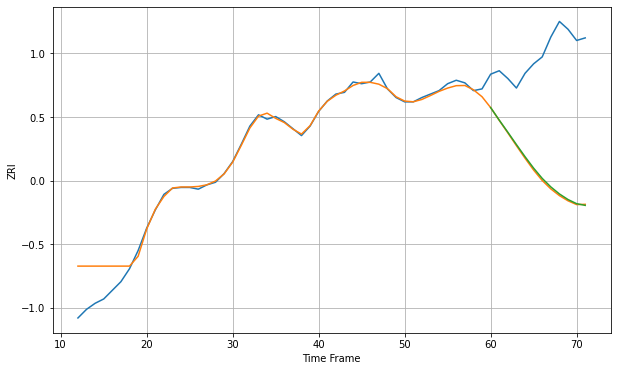

Wall time: 18.3 s
92108 15.1283570004714 142.10438436897655 140.93868208495573 [1962.38247186 1947.87856112 1933.87176417 1919.58744387 1905.59770847
 1892.31273098 1880.4455172  1870.5928959  1862.47634966 1856.01323165
 1851.2292967  1849.24914098]

Got an mse at 0.0100 in round 28 and stopped training

60 60 12


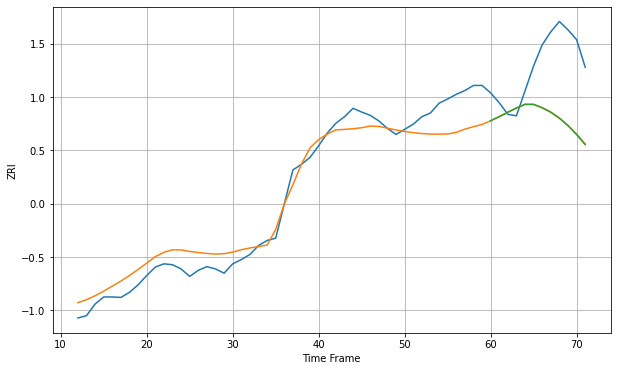

Wall time: 6.88 s
92117 37.986286009351154 133.14812234484944 133.60087065798444 [2112.38165926 2121.18023942 2130.56299475 2139.65219693 2147.50158994
 2147.40093745 2140.14608143 2130.58344947 2117.81425938 2101.76480765
 2082.67083842 2061.22331885]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


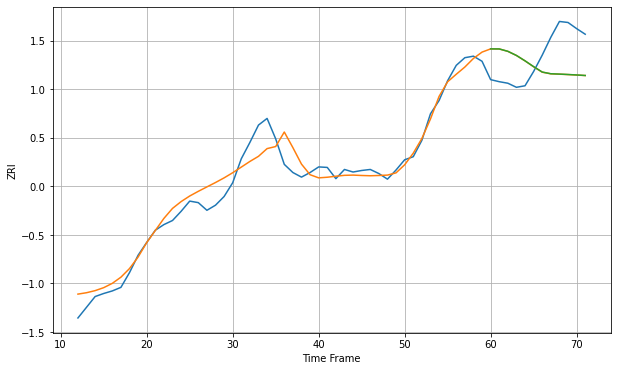

Wall time: 8.02 s
92122 25.12290070459947 70.80272191001147 70.72770718312242 [2472.25502715 2472.16343739 2467.52196072 2459.40192042 2448.86926584
 2437.49179859 2426.92142707 2423.55463699 2422.88035068 2422.09171589
 2421.19363595 2420.1507263 ]

Got an mse at 0.0096 in round 24 and stopped training

60 60 12


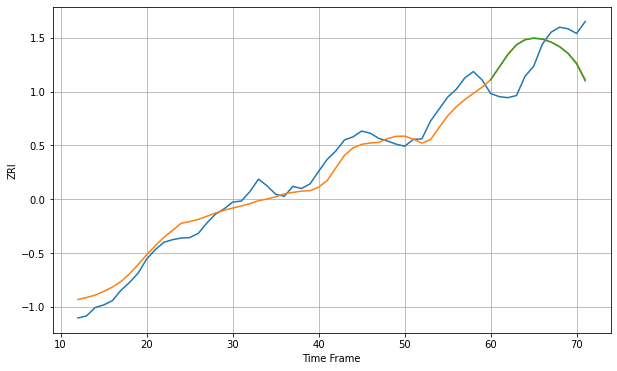

Wall time: 6.35 s
92123 23.768832602612708 63.01123867912052 63.44666483638428 [2286.26303344 2310.45484367 2334.60816508 2353.0199307  2362.86693413
 2366.01116403 2364.23182492 2358.72126159 2349.83500149 2336.71678753
 2316.6932853  2284.25524171]

Got an mse at 0.0096 in round 22 and stopped training

60 60 12


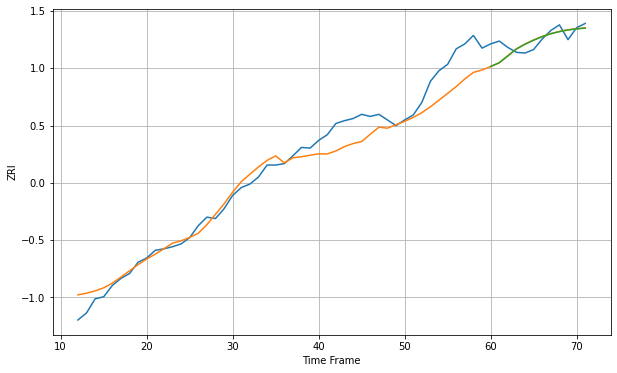

Wall time: 6.06 s
92126 23.126373501427498 15.406128107583642 15.387736215733442 [2053.90796127 2059.1816803  2068.90007915 2078.73910452 2085.49118259
 2091.26627879 2096.26339884 2100.39658138 2103.36664472 2105.76578456
 2107.3070691  2108.37997505]

Got an mse at 0.0098 in round 32 and stopped training

60 60 12


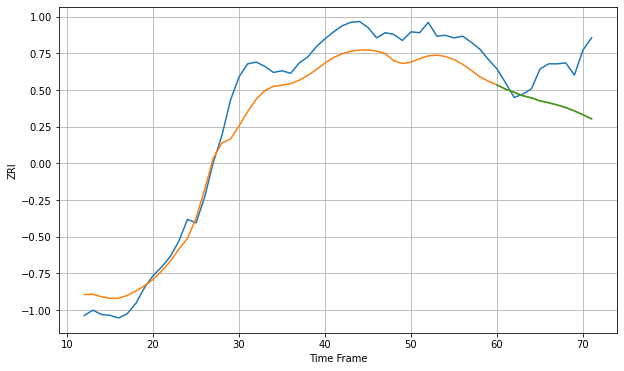

Wall time: 7.52 s
92128 26.6485715023534 45.60147390384424 45.5726606195353 [2141.66989583 2136.66321431 2133.05447727 2129.09546696 2126.61430846
 2123.17093219 2121.0294484  2118.44211413 2115.46964782 2111.54269921
 2107.13310786 2102.37937567]

Got an mse at 0.0099 in round 43 and stopped training

60 60 12


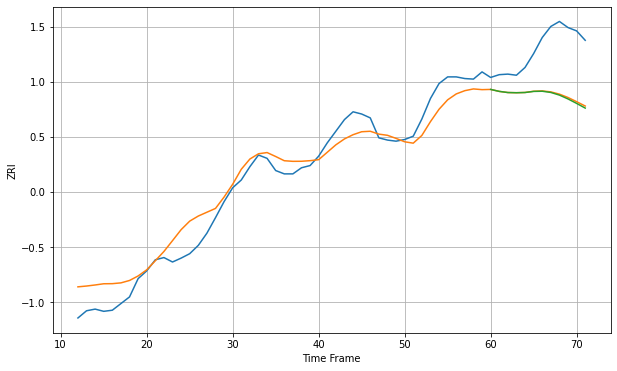

Wall time: 6.91 s
92130 30.300322774512278 89.82609288480091 91.30999518122321 [2555.38738666 2551.84501311 2549.77354842 2549.41452735 2549.80917379
 2551.78411585 2552.11727531 2549.9208802  2545.14420964 2538.20011928
 2530.17536775 2521.70836606]

Got an mse at 0.0100 in round 108 and stopped training

60 60 12


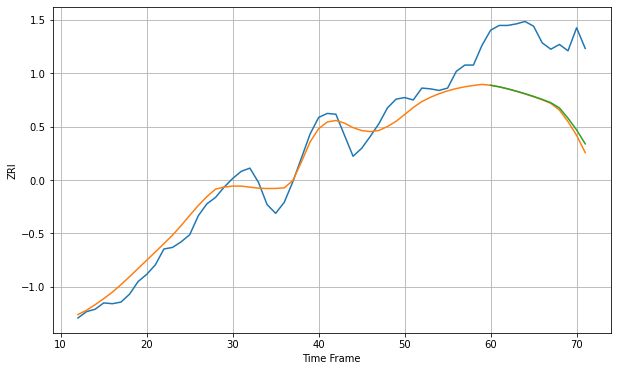

Wall time: 8.42 s
92410 18.178749138437148 91.75450374920362 88.94994485089346 [1257.52586169 1255.5550358  1253.01273344 1250.0656529  1246.86794161
 1243.43329041 1239.72812492 1235.52549566 1228.94229258 1215.96940405
 1201.173294   1183.61908045]

Got an mse at 0.0099 in round 27 and stopped training

60 60 12


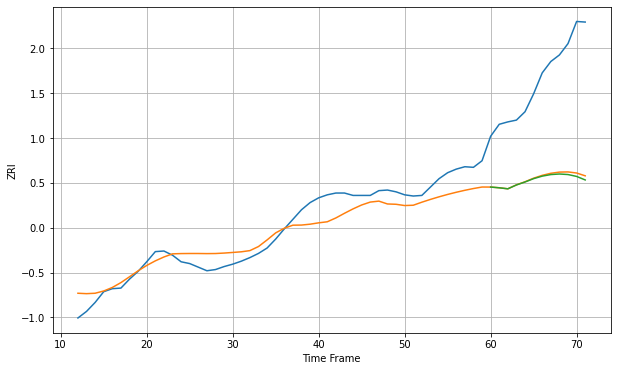

Wall time: 6.04 s
92507 24.170611417703505 172.15488632896324 174.87650364518436 [1432.9885188  1431.76784456 1430.05653617 1436.48723117 1441.47234701
 1447.08447    1451.26631273 1453.88927947 1454.83904479 1453.93185621
 1450.77948454 1444.88043636]

Got an mse at 0.0100 in round 48 and stopped training

60 60 12


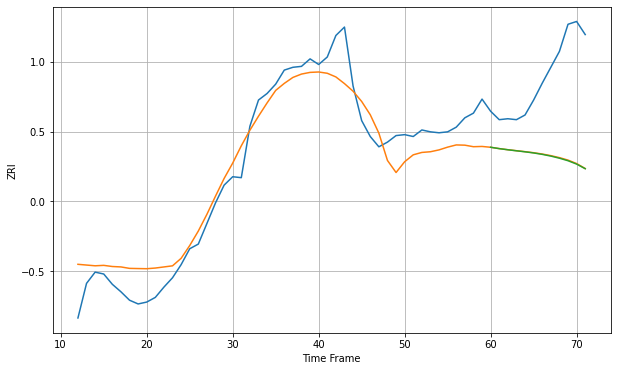

Wall time: 6.88 s
92602 25.117658387057972 91.99952197292711 92.34616514649085 [2434.50878489 2433.05322174 2431.83745663 2430.73158088 2429.64412554
 2428.42552772 2426.92829621 2425.07212977 2422.81831022 2420.10554409
 2416.52550215 2411.58079481]

Got an mse at 0.0099 in round 124 and stopped training

60 60 12


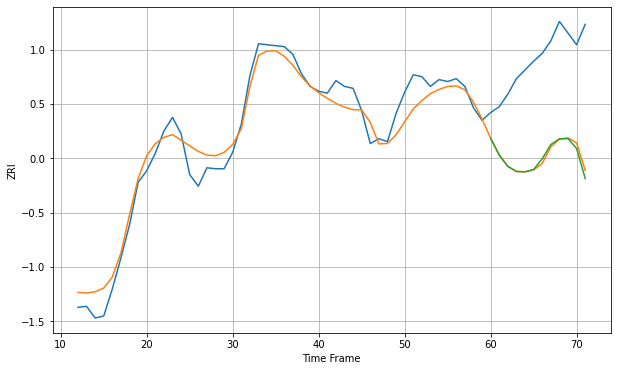

Wall time: 9.41 s
92603 15.885340983724044 102.43982280669715 103.29723345307205 [2867.43136172 2850.20273478 2838.39396779 2833.20296215 2832.86349861
 2835.24989106 2846.2572105  2860.99702774 2866.91652068 2867.11432933
 2856.91010741 2825.89913842]

Got an mse at 0.0097 in round 30 and stopped training

60 60 12


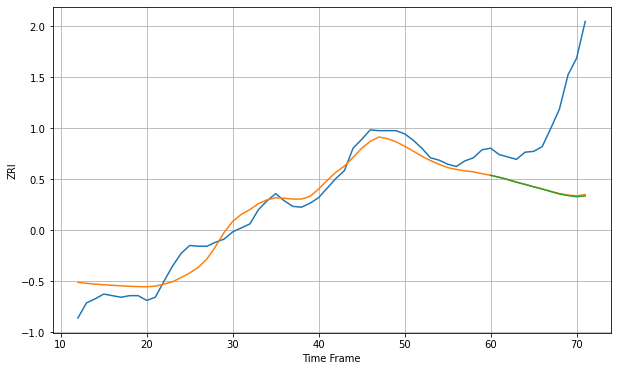

Wall time: 6.38 s
92612 15.819694989967802 102.99000764558944 103.57414825000991 [2377.95269655 2375.50499689 2372.64202163 2369.40143113 2366.56384676
 2363.56606043 2360.77034071 2357.62593232 2354.61980715 2352.55566655
 2351.13853282 2352.10510508]

Got an mse at 0.0098 in round 43 and stopped training

60 60 12


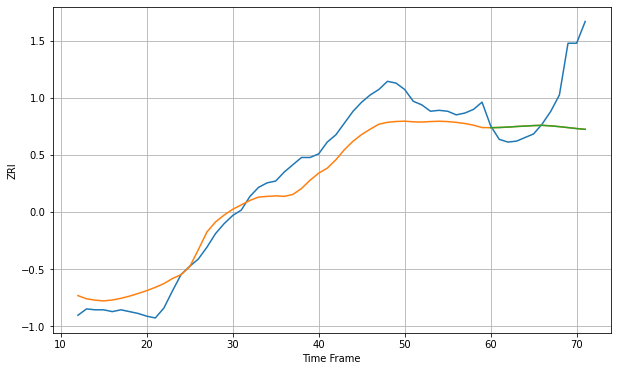

Wall time: 6.8 s
92618 23.033580488023542 53.303171389952 53.31611389526392 [2098.85002594 2099.05988383 2099.48537099 2100.15489303 2100.61327002
 2101.17107714 2101.45755516 2100.85433531 2099.9770664  2098.93956209
 2097.89015136 2097.03115712]

Got an mse at 0.0099 in round 91 and stopped training

60 60 12


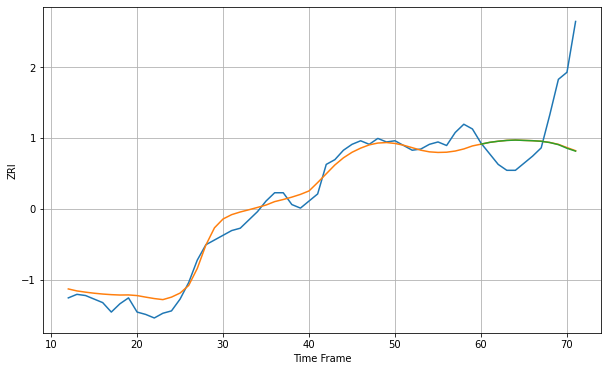

Wall time: 8.14 s
92620 9.05070238044064 42.785271502321876 42.95709571969029 [1916.13956403 1917.65050305 1918.60644247 1919.29806246 1919.60052862
 1919.31366647 1919.056382   1918.59185849 1917.51149157 1915.73428653
 1912.66130549 1910.22819913]

Got an mse at 0.0099 in round 29 and stopped training

60 60 12


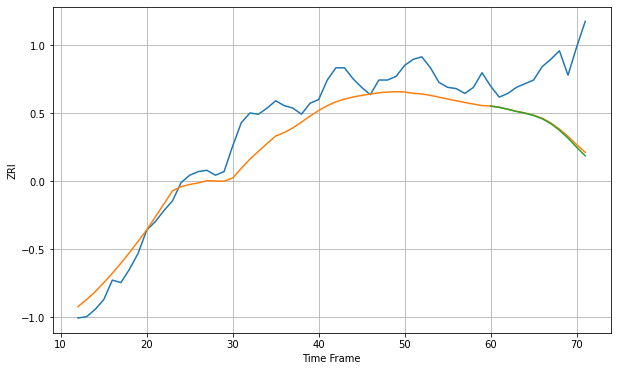

Wall time: 7.81 s
92626 17.83273420348907 51.099419969004735 52.194795287256326 [2192.70356594 2191.62456931 2190.04163977 2188.26716356 2186.82603986
 2184.95438884 2182.27878187 2178.25430277 2172.87036789 2166.39830151
 2158.94976692 2151.87983663]

Got an mse at 0.0100 in round 31 and stopped training

60 60 12


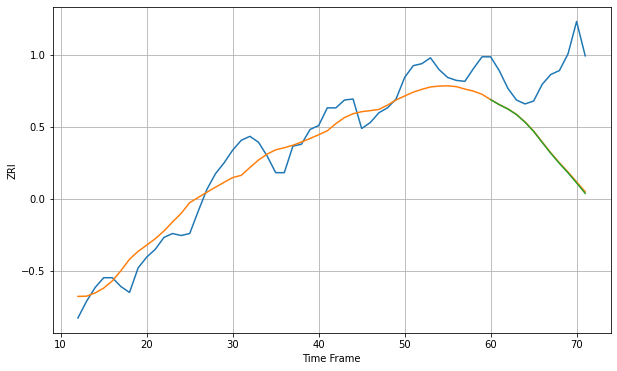

Wall time: 6.54 s
92627 18.67744473362451 83.67703520107895 84.33903637306616 [2270.39211551 2265.28033742 2260.89063868 2255.20198459 2247.4254158
 2238.04290734 2226.74181156 2215.65141277 2205.43643566 2195.79849279
 2185.51946152 2174.89831549]

Got an mse at 0.0098 in round 27 and stopped training

60 60 12


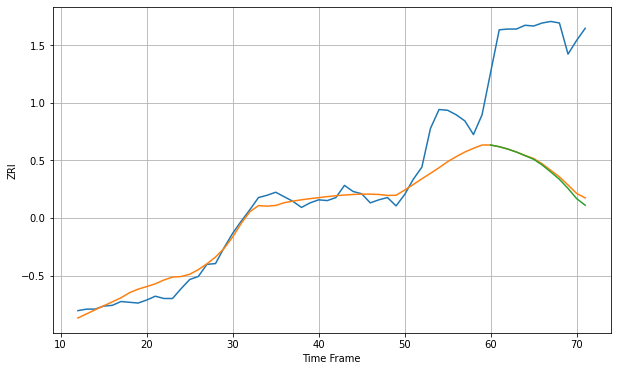

Wall time: 6.92 s
92647 23.030001314411933 177.56222141648897 180.3594189452855 [2079.19129647 2076.99567163 2073.85817285 2069.93122425 2065.22009016
 2060.45142654 2052.88032834 2043.66297874 2034.03665226 2022.0085182
 2008.61739072 1999.90068222]

Got an mse at 0.0100 in round 56 and stopped training

60 60 12


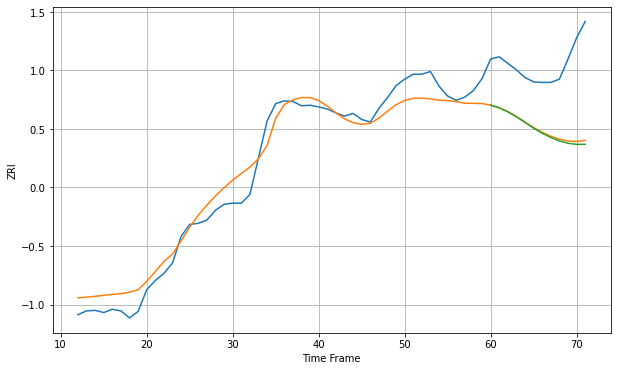

Wall time: 6.97 s
92648 27.952138195364178 123.20703979137915 126.0497493610827 [2285.2463032  2280.18682121 2272.97151405 2263.78023978 2253.45202461
 2242.81601553 2233.59950119 2225.68697235 2219.45234331 2215.12278885
 2213.16167736 2213.1077246 ]

Got an mse at 0.0099 in round 236 and stopped training

60 60 12


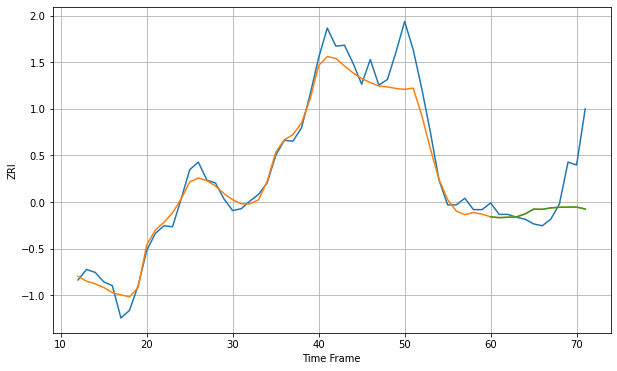

Wall time: 13 s
92651 17.290527336016165 36.85306366037296 36.8078927591356 [2552.40754138 2551.55911371 2551.99695887 2552.35078238 2555.51887246
 2560.55881058 2560.30861075 2561.85229907 2562.47274861 2562.59077234
 2562.71941116 2560.68863155]

Got an mse at 0.0097 in round 64 and stopped training

60 60 12


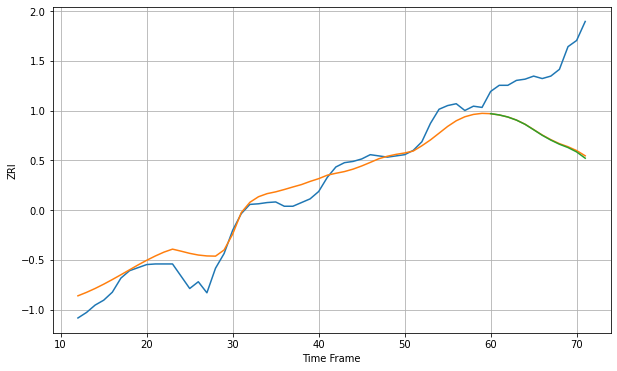

Wall time: 8.18 s
92656 23.365374063663083 116.86614634154714 118.10688549685725 [2228.79733503 2226.73183231 2223.36480072 2218.33182579 2211.4770365
 2202.62742263 2193.59496941 2185.77690318 2179.02360819 2173.59497129
 2166.51306874 2156.25188121]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


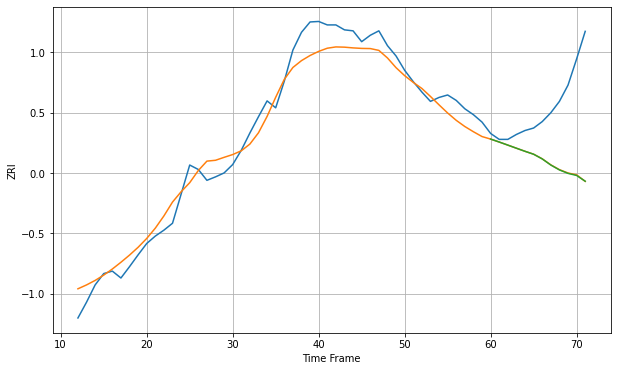

Wall time: 7.41 s
92660 31.63093545097655 135.71834905548792 136.0096281706258 [2861.60447413 2855.60452731 2849.38060331 2843.05088183 2836.79753198
 2830.88654938 2821.41529903 2809.00181029 2799.11226861 2792.08190199
 2787.87835394 2776.18652911]

Got an mse at 0.0099 in round 88 and stopped training

60 60 12


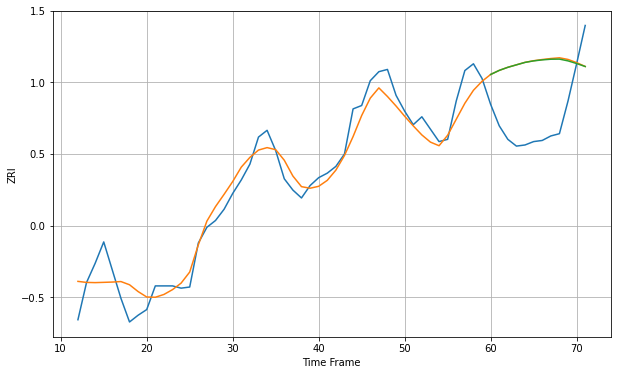

Wall time: 7.64 s
92663 14.885218877900936 57.73860395418505 57.44081281777897 [2341.54150126 2345.14585014 2347.88933567 2350.07775523 2352.24011586
 2353.57985249 2354.46565737 2355.06128741 2355.15998841 2353.58737223
 2351.23582626 2348.59370638]

Got an mse at 0.0100 in round 63 and stopped training

60 60 12


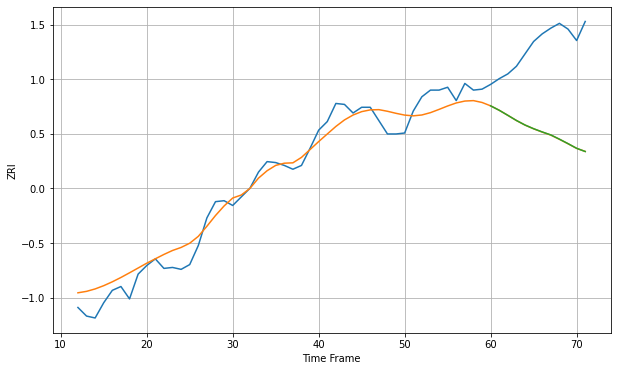

Wall time: 7.22 s
92672 14.821705412440238 93.32556025688189 93.25688302593545 [2209.49722806 2204.84377763 2199.55262312 2194.14475781 2189.37805853
 2185.5124545  2182.12660281 2178.99310345 2174.53614912 2169.86669638
 2164.96858303 2161.58963732]

Got an mse at 0.0100 in round 47 and stopped training

60 60 12


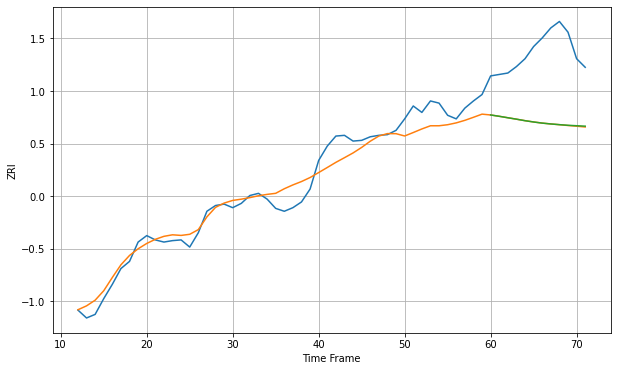

Wall time: 7.02 s
92673 18.183167501425647 99.97335383401902 99.81822305178582 [2183.44447281 2181.59600104 2179.56060414 2177.57241901 2175.44894425
 2173.63388294 2172.07285435 2170.89078461 2169.92313955 2169.0256531
 2168.42549241 2167.80025032]

Got an mse at 0.0099 in round 101 and stopped training

60 60 12


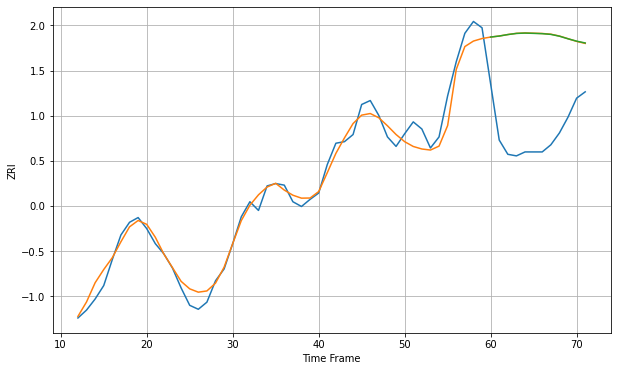

Wall time: 8.79 s
92677 13.554823985758459 125.42438700736464 125.33283968606689 [2455.29327669 2456.56777565 2458.4241169  2459.86883668 2460.30754261
 2459.94560838 2459.56248896 2458.65617174 2456.37427015 2453.0753456
 2450.11765165 2447.80038364]

Got an mse at 0.0099 in round 77 and stopped training

60 60 12


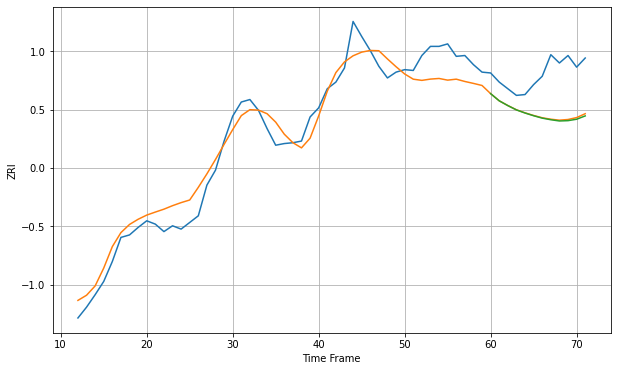

Wall time: 8.1 s
92691 20.84992942725355 50.902593226111826 51.83487286865063 [2091.07781329 2082.43646014 2076.70425388 2071.51052592 2067.77806842
 2064.50366521 2061.61384111 2059.67665588 2058.18598145 2058.56994649
 2060.27580963 2064.27535827]

Got an mse at 0.0098 in round 44 and stopped training

60 60 12


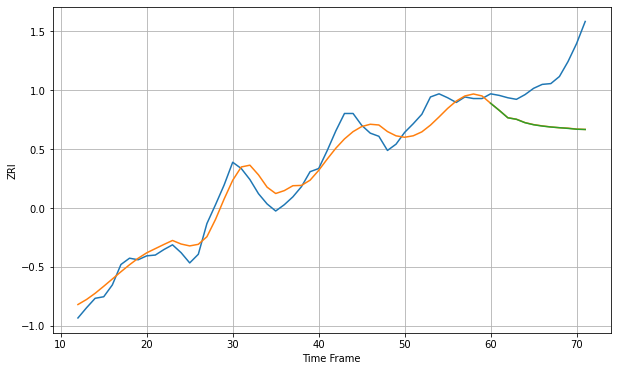

Wall time: 7.66 s
92692 15.868614704252733 66.52178066146642 66.63276679920267 [2169.95837603 2160.99426951 2151.52124152 2149.61106831 2145.27457641
 2142.67358142 2141.02405004 2139.78429884 2138.93371153 2138.05682203
 2136.99444383 2136.63086475]

Got an mse at 0.0098 in round 83 and stopped training

60 60 12


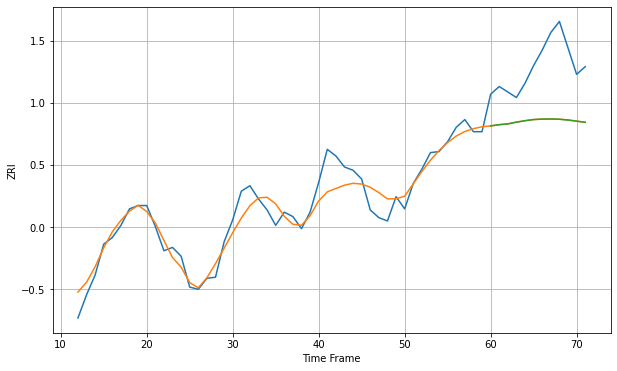

Wall time: 7.68 s
92707 12.733321492917664 52.80816610946355 52.839325387051254 [2162.24211156 2163.36590055 2164.08641052 2165.67838401 2166.96365263
 2168.0209362  2168.39639542 2168.52497488 2168.27213538 2167.58581409
 2166.52405149 2165.47944862]

Got an mse at 0.0100 in round 58 and stopped training

60 60 12


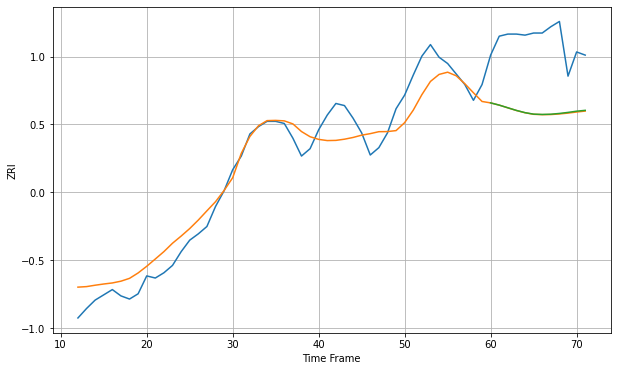

Wall time: 8.06 s
92780 17.63936603541714 68.35233235835527 68.08289018240428 [2093.5531369  2091.4453769  2088.90583865 2086.39184908 2084.27958672
 2082.85536388 2082.57813186 2082.79583086 2083.5237915  2084.50987108
 2085.67348547 2086.48340942]

Got an mse at 0.0099 in round 31 and stopped training

60 60 12


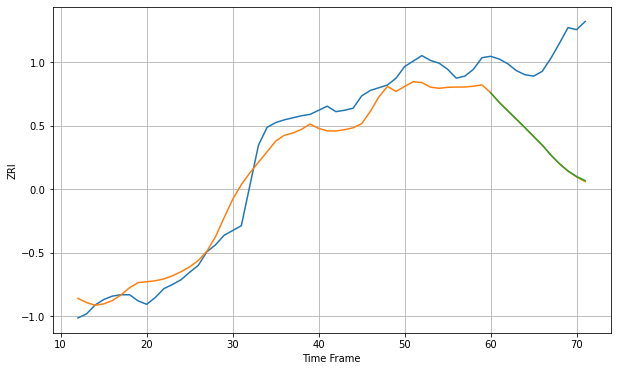

Wall time: 6.69 s
92782 26.02377839717448 141.1184241397459 140.6839803673261 [2345.71519109 2331.59058882 2319.15768004 2306.91635528 2294.45121565
 2281.64952212 2269.12465427 2254.64163326 2241.93173642 2231.23182018
 2223.14305154 2217.09125357]

Got an mse at 0.0093 in round 18 and stopped training

60 60 12


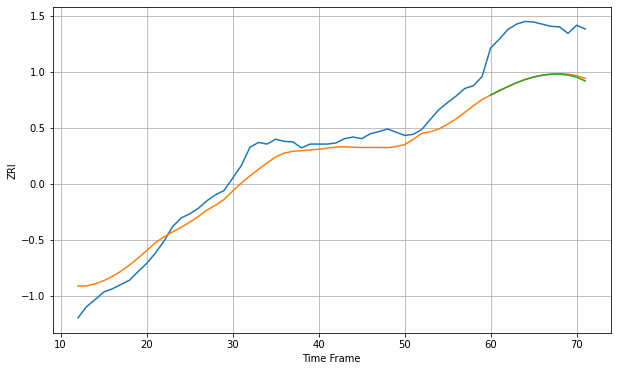

Wall time: 6.73 s
92805 27.74648385301942 95.15103243681844 95.97388598305602 [1935.77279893 1943.77585206 1951.40134048 1958.41867506 1964.49538833
 1969.15000343 1972.3591737  1974.15896038 1974.41436176 1972.750665
 1968.90529376 1961.76351261]

Got an mse at 0.0094 in round 20 and stopped training

60 60 12


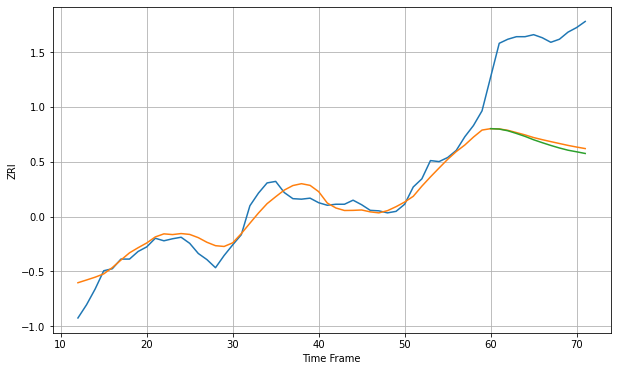

Wall time: 5.68 s
92806 23.243652388843575 198.68381720344885 204.23279006135303 [2166.87017144 2166.06980618 2162.74112237 2157.41300929 2151.66936127
 2145.00533443 2139.27856335 2133.80822538 2128.81394661 2124.44455079
 2121.28713207 2118.0106869 ]

Got an mse at 0.0100 in round 52 and stopped training

60 60 12


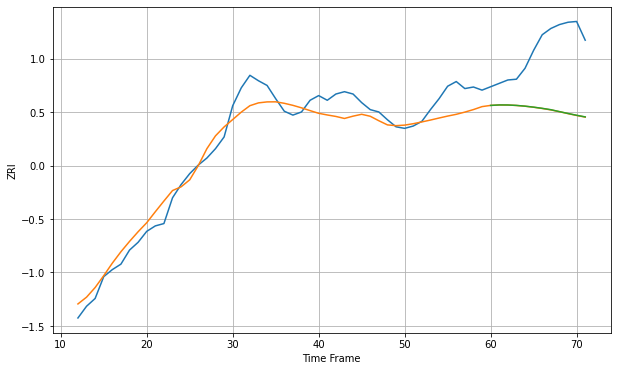

Wall time: 8.07 s
92832 19.47995628742101 82.36089218924445 82.20471752226973 [1931.42050205 1932.01655295 1931.96482673 1931.41064221 1930.47825669
 1929.19012012 1927.67853036 1925.93241019 1923.47765729 1921.08999991
 1918.78824133 1916.70326358]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


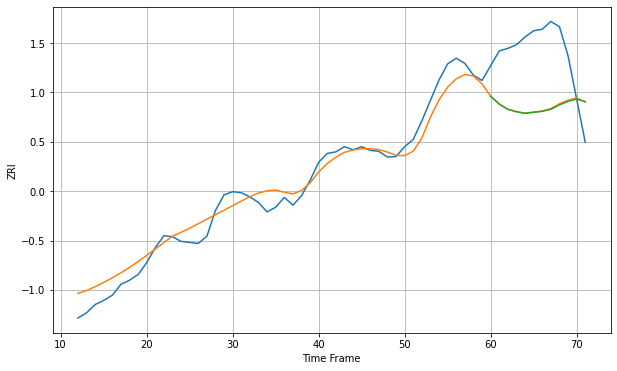

Wall time: 7.24 s
93001 24.471835617380155 122.46890854554572 123.17189088456473 [2144.46555003 2129.319986   2119.28574827 2114.54944271 2111.46437302
 2113.39559557 2115.27676115 2119.31060768 2127.73704101 2134.45421297
 2138.93718308 2134.09488576]

Got an mse at 0.0099 in round 30 and stopped training

60 60 12


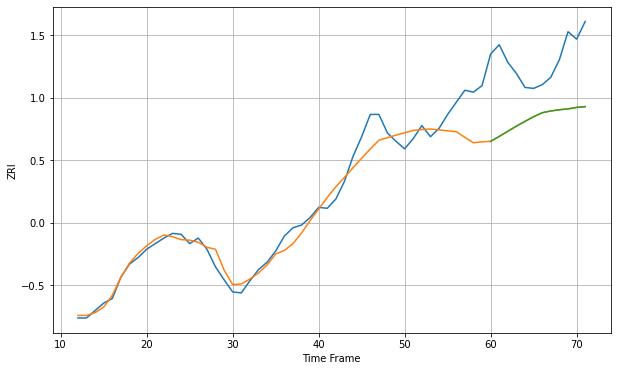

Wall time: 7.14 s
93010 18.079863120078365 67.88503558650108 67.94189446005933 [1989.02776884 1994.32035312 1999.85684221 2005.38913737 2010.53373152
 2015.52963262 2019.78333197 2021.69741332 2022.95822242 2023.87471938
 2025.47255604 2026.36488744]

Got an mse at 0.0098 in round 24 and stopped training

60 60 12


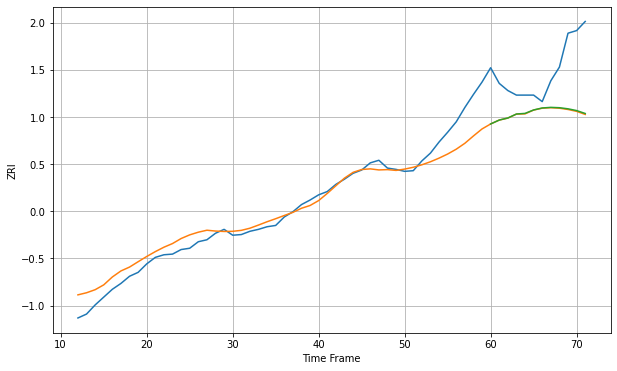

Wall time: 6.74 s
93030 21.888552018716577 76.29100334291115 75.6376356568733 [1826.70962914 1832.72315375 1835.86257956 1841.9933641  1842.9434902
 1848.195119   1851.25529097 1852.19112386 1851.65907756 1849.96143166
 1847.27245917 1842.78519489]

Got an mse at 0.0100 in round 147 and stopped training

60 60 12


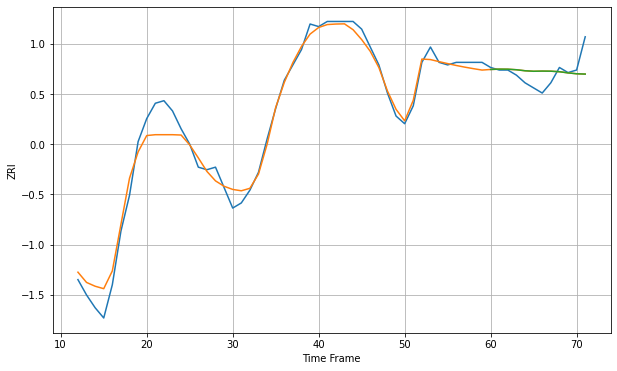

Wall time: 9.75 s
93304 4.639078574155192 5.642421973147732 5.6422298806526126 [880.22305417 880.34976166 880.32294261 880.11364677 879.71713779
 879.51804697 879.58490318 879.54640913 879.34289267 878.88889957
 878.53895647 878.41508987]

Got an mse at 0.0100 in round 97 and stopped training

60 60 12


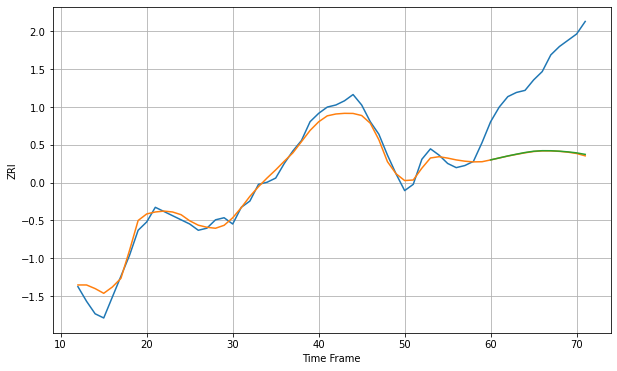

Wall time: 8.65 s
93305 4.348507676961742 41.88934626936007 41.69891737539154 [784.6983198  785.64914738 786.59796258 787.44644426 788.24270744
 788.84890024 789.11410476 789.09024331 788.87861775 788.54594742
 788.06876208 787.34391486]

Got an mse at 0.0100 in round 155 and stopped training

60 60 12


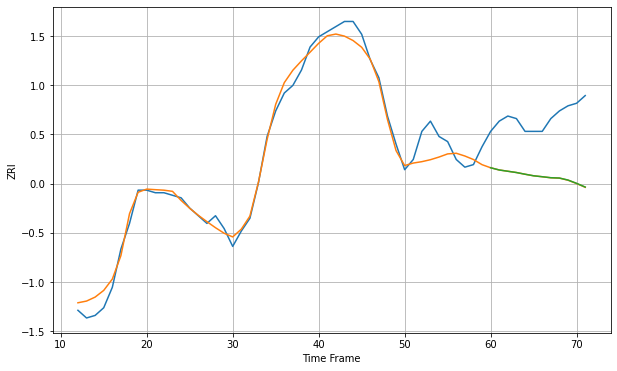

Wall time: 9.78 s
93307 4.534547232799363 23.67330931445858 23.639783480937613 [854.76880966 853.89583251 853.39711852 852.89804585 852.23614551
 851.62517681 851.26114287 850.87229105 850.7461448  849.96094471
 848.66658877 847.22548633]

Got an mse at 0.0099 in round 122 and stopped training

60 60 12


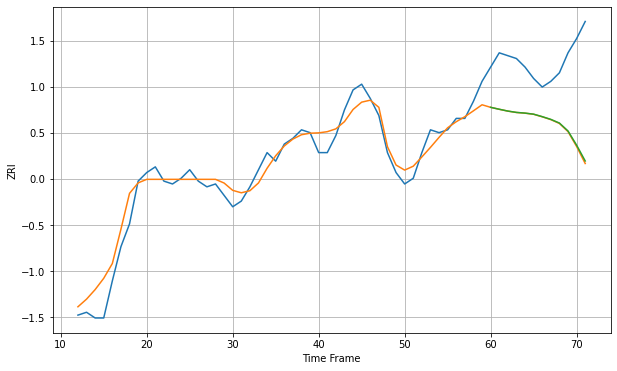

Wall time: 9.42 s
93308 4.742426368124671 24.206242127845933 23.947927637206416 [840.88474668 840.20744803 839.57358009 839.10262104 838.86408308
 838.48587129 837.61883931 836.65868129 835.37159546 832.58990538
 827.62120441 822.06557615]

Got an mse at 0.0098 in round 57 and stopped training

60 60 12


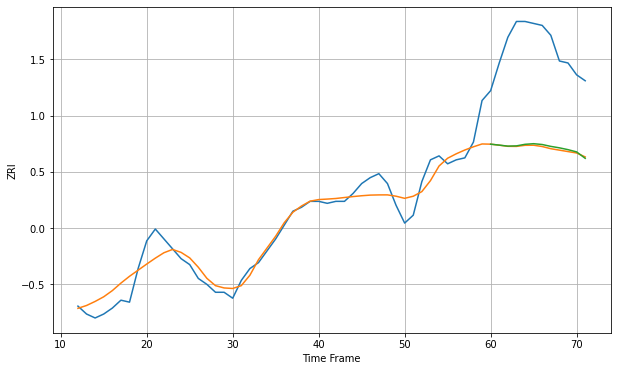

Wall time: 6.85 s
93309 6.857542866970648 51.11767393455631 50.59349776495927 [1011.92425152 1011.44735427 1010.9417779  1011.05893389 1011.85381182
 1012.1651721  1011.74863505 1010.80368358 1010.0720637  1009.15179063
 1008.0076332  1004.76088207]

Got an mse at 0.0100 in round 31 and stopped training

60 60 12


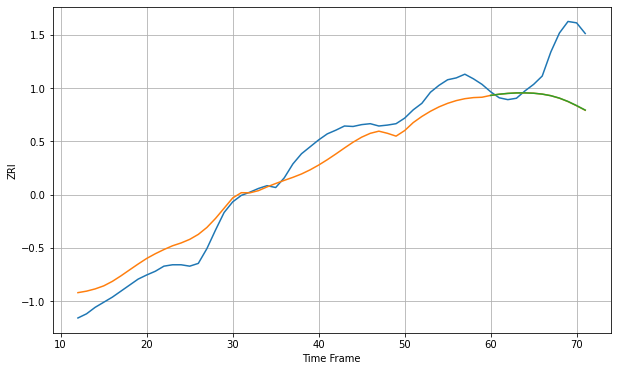

Wall time: 7.5 s
93906 37.35544898824858 100.30060037674995 100.17146767108234 [1761.16069067 1763.72137988 1765.48095054 1766.50506057 1766.5931603
 1765.87786502 1763.94623444 1760.55975027 1755.26776639 1748.02726999
 1739.10475808 1729.41367762]

Got an mse at 0.0099 in round 41 and stopped training

60 60 12


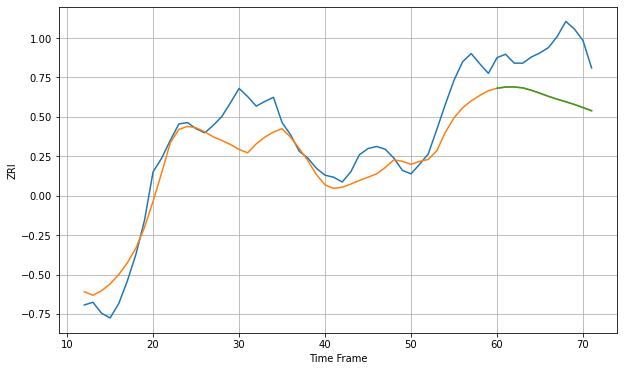

Wall time: 6.53 s
94010 36.035477640119005 74.0749956304789 74.03455173193592 [2676.31492993 2677.97248405 2678.19961918 2676.81330477 2673.31495866
 2669.00708652 2664.43408557 2660.28399294 2656.47912369 2652.53826775
 2647.92429378 2643.28047314]

Got an mse at 0.0098 in round 45 and stopped training

60 60 12


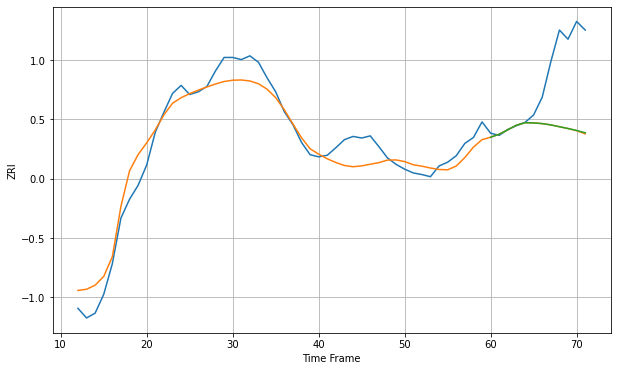

Wall time: 7.88 s
94025 30.25189971230181 113.74008653558303 113.38151691065782 [3329.46592923 3335.15291417 3343.33250229 3351.89604831 3356.59386061
 3356.1337752  3354.85127861 3352.45998091 3349.04940897 3345.71647801
 3342.08978769 3337.83417366]

Got an mse at 0.0097 in round 70 and stopped training

60 60 12


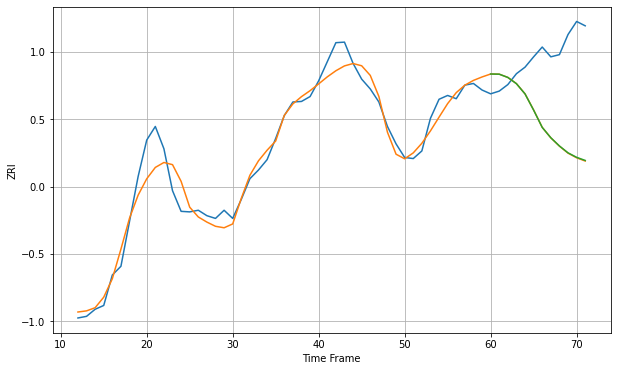

Wall time: 8.07 s
94040 25.83595748330003 146.928195996259 146.5730031502721 [3422.42998909 3422.11924761 3416.12498692 3404.6338317  3385.83567516
 3356.06392402 3324.28986566 3305.22976856 3290.16787425 3277.54981455
 3269.28259966 3263.55676823]

Got an mse at 0.0100 in round 21 and stopped training

60 60 12


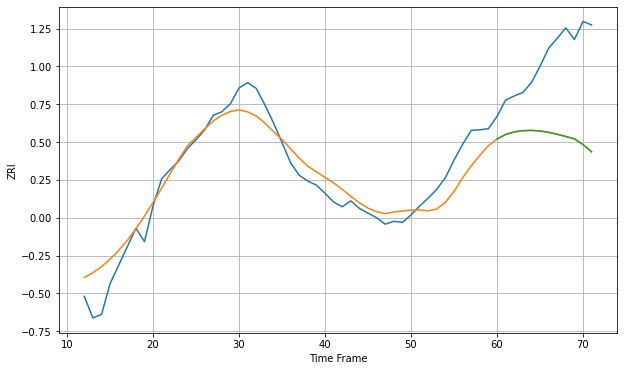

Wall time: 6.93 s
94061 32.01959108566424 140.23879916322028 140.2022338479431 [3013.24651239 3020.96176953 3025.3868379  3027.56060546 3028.02209758
 3027.02597234 3024.73628434 3021.36875847 3017.55760493 3013.57500325
 3003.67721511 2991.28387128]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


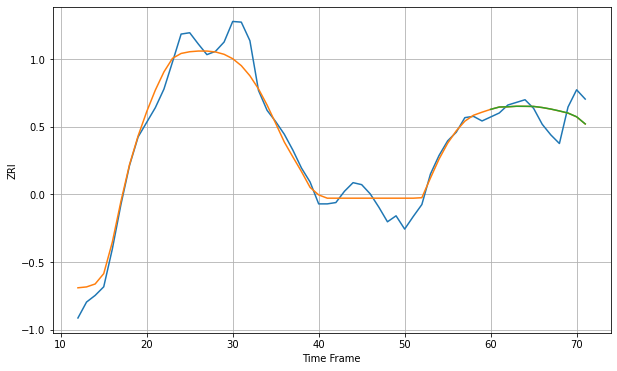

Wall time: 7.76 s
94066 22.728278140441226 25.93569984945526 25.926315914399684 [2848.48375406 2852.00953068 2852.37674138 2853.16132132 2853.08169401
 2852.9115516  2851.26499061 2848.95753296 2846.10738897 2842.95141137
 2837.33774622 2826.55169113]

Got an mse at 0.0099 in round 55 and stopped training

60 60 12


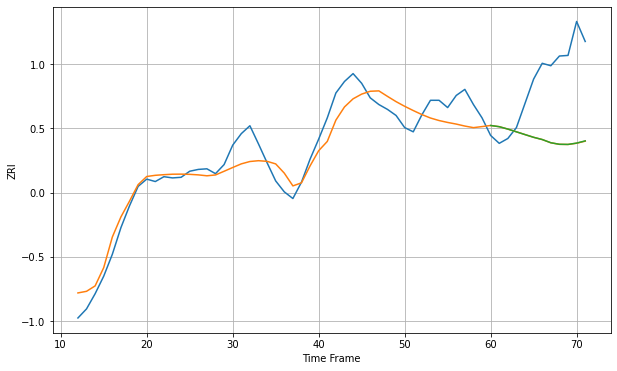

Wall time: 7.67 s
94085 27.738398218209156 113.74964168673546 113.64604245782523 [2977.44947154 2975.46769361 2971.52039978 2966.99031777 2962.43255328
 2957.95015089 2954.28664356 2948.98260124 2946.43955883 2946.22551679
 2948.38883295 2952.07158916]

Got an mse at 0.0099 in round 29 and stopped training

60 60 12


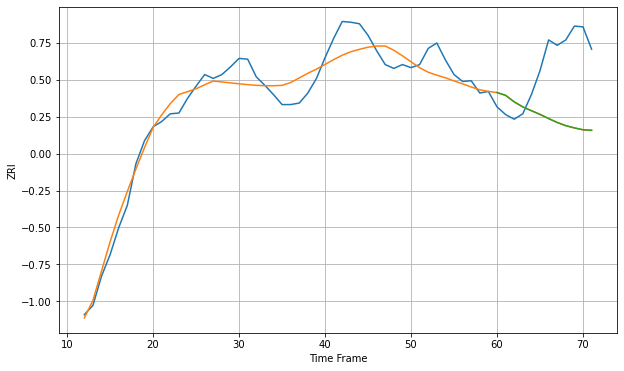

Wall time: 6.57 s
94086 19.817004537884234 84.0001425489645 83.968035149218 [2918.63738216 2914.98866195 2906.5298022  2899.9208506  2895.02482895
 2890.24379806 2884.81092088 2879.74583431 2875.58804614 2872.68006086
 2870.28795524 2869.67297707]

Got an mse at 0.0097 in round 60 and stopped training

60 60 12


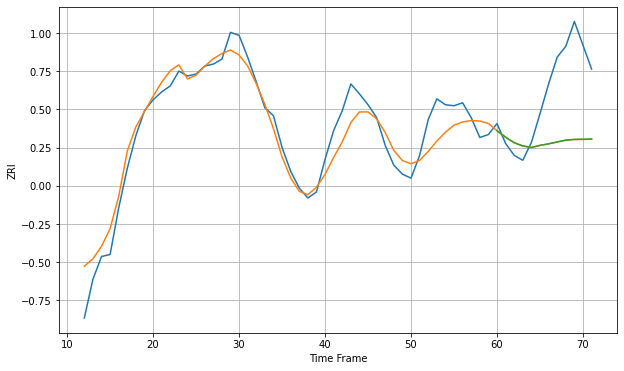

Wall time: 8.26 s
94087 17.987822847083102 64.32482845897835 64.25117550574902 [2709.80664449 2703.29697813 2697.73693415 2694.47847312 2692.8824262
 2695.0358819  2696.59286471 2698.49540547 2700.32386118 2701.08577607
 2701.21657353 2701.43586791]

Got an mse at 0.0097 in round 78 and stopped training

60 60 12


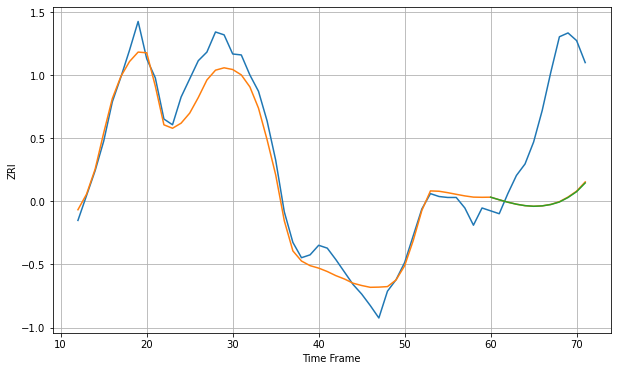

Wall time: 8.46 s
94103 17.70579411155617 106.61391293645059 106.91062283973599 [3501.29843748 3498.57427673 3496.06442601 3493.93165798 3492.43593168
 3491.77619686 3492.18041014 3493.61323619 3496.26008765 3500.93840026
 3507.05390847 3516.16353132]

Got an mse at 0.0100 in round 56 and stopped training

60 60 12


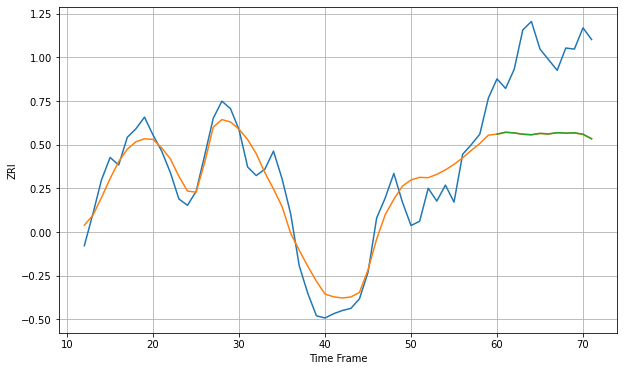

Wall time: 7.13 s
94105 19.394306987820176 79.0867509806866 79.01122272482847 [3954.96709099 3956.72832323 3956.1114761  3954.89628896 3954.42548222
 3955.68531464 3955.18172898 3956.42338343 3955.94439125 3956.26813386
 3954.89564394 3950.68181319]

Got an mse at 0.0098 in round 48 and stopped training

60 60 12


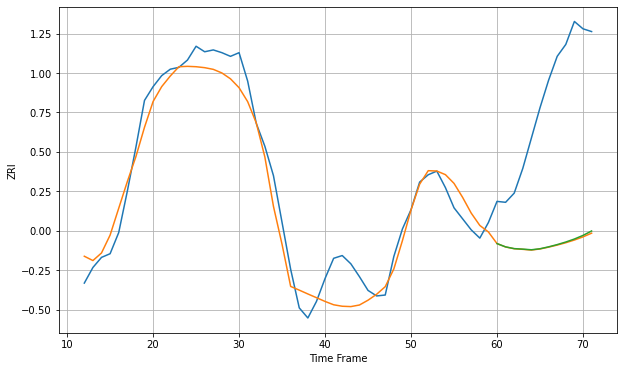

Wall time: 7.86 s
94107 21.974437042413047 166.5313947202393 165.73347799700693 [3804.02606061 3800.44480307 3798.55553689 3797.9835176  3797.30005799
 3798.39773692 3800.48466896 3802.93189921 3805.74810757 3809.01752704
 3812.93877563 3817.77318919]

Got an mse at 0.0099 in round 142 and stopped training

60 60 12


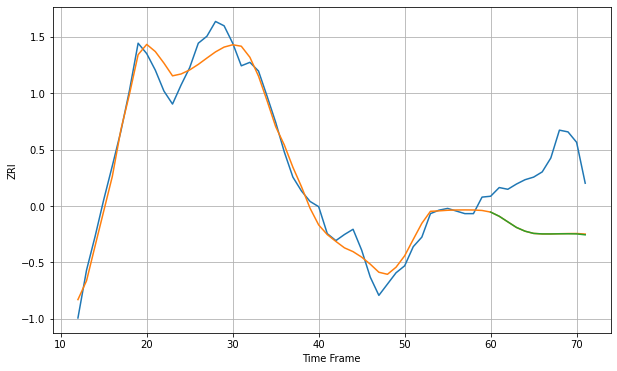

Wall time: 9.71 s
94109 15.306449720886905 75.28164328378989 75.4297329647895 [3364.76540182 3359.96710746 3353.53870422 3347.13113605 3342.81613773
 3340.26243795 3339.67531981 3339.64114085 3339.79659981 3339.84855698
 3339.68976563 3338.62667185]

Got an mse at 0.0098 in round 44 and stopped training

60 60 12


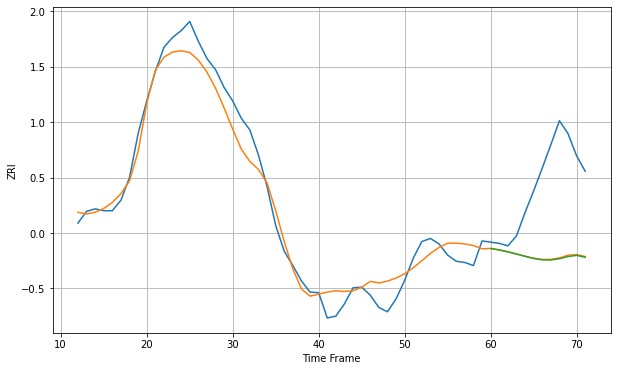

Wall time: 8.01 s
94110 26.255405275600573 131.57220724020755 132.49656048381456 [3857.73211219 3855.39154698 3852.34352327 3848.69135487 3845.08757537
 3841.5655142  3839.2685453  3839.05354285 3841.0567726  3844.67564027
 3846.55022668 3843.45592607]

Got an mse at 0.0100 in round 87 and stopped training

60 60 12


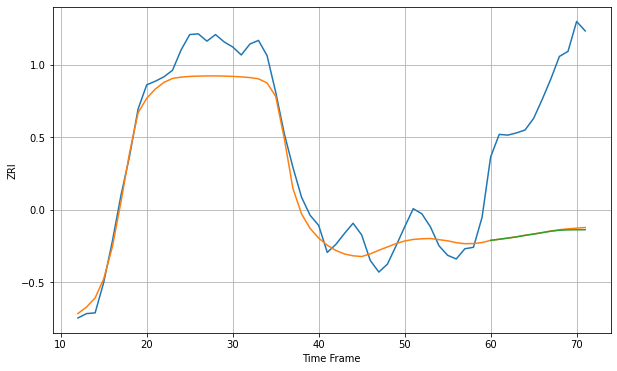

Wall time: 8.13 s
94115 28.59854856515229 197.1302958868325 198.04425942707203 [3441.51118958 3443.05186292 3444.62696818 3446.31243048 3448.36958491
 3450.14171983 3452.08019828 3454.08049789 3455.36585828 3455.94413982
 3456.01928775 3456.16489329]

Got an mse at 0.0098 in round 72 and stopped training

60 60 12


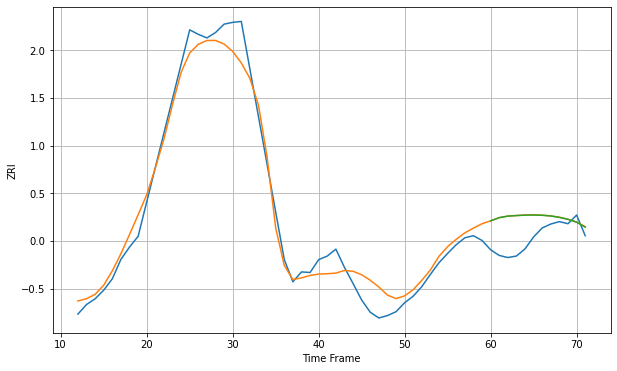

Wall time: 8.13 s
94158 49.474065738570246 84.4267620337231 84.19020094882656 [3999.58818946 4010.29109307 4015.39588015 4017.21027997 4018.69803297
 4019.12080164 4018.14190316 4015.80950207 4011.20425126 4004.52184745
 3995.08169515 3978.5482654 ]

Got an mse at 0.0099 in round 25 and stopped training

60 60 12


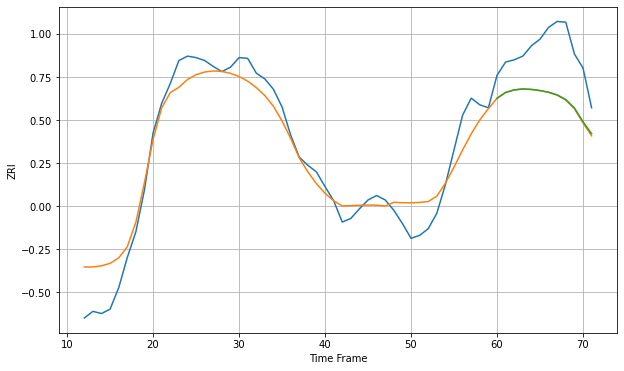

Wall time: 6.9 s
94401 28.723030745607467 68.40360159135452 67.80936920417952 [2829.88920794 2837.72453334 2841.24510497 2842.51762447 2841.91529735
 2840.36494143 2838.12353917 2834.46691706 2828.10206155 2816.78855549
 2798.20957874 2781.8567371 ]

Got an mse at 0.0097 in round 42 and stopped training

60 60 12


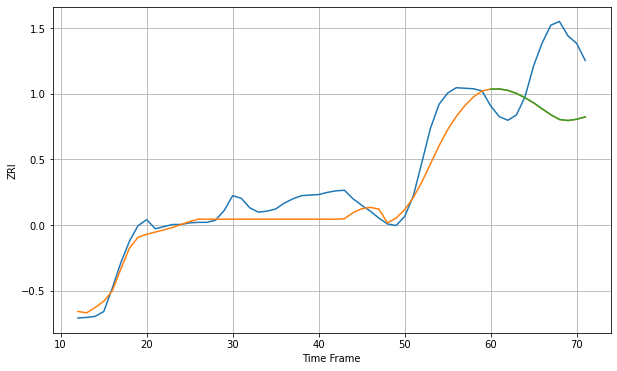

Wall time: 7.34 s
94403 31.05633695771888 110.6567335933274 110.50777620829066 [3110.33136549 3110.71090536 3108.03144044 3102.40186059 3094.32156478
 3084.76336285 3073.4970495  3062.54621889 3053.62343954 3051.6528162
 3053.97556024 3058.38699566]

Got an mse at 0.0100 in round 91 and stopped training

60 60 12


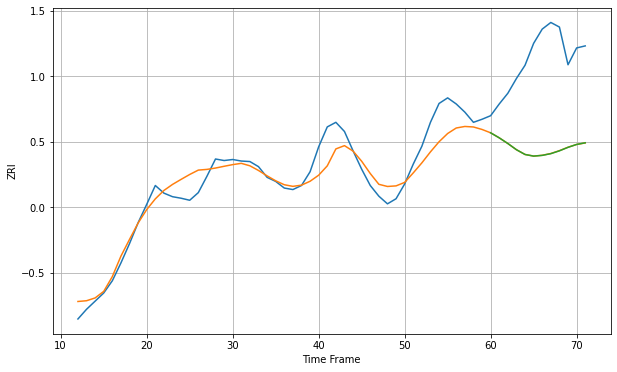

Wall time: 8.21 s
94404 30.5489390817444 182.39141742433384 182.47116927992542 [3115.40147768 3105.53546661 3094.4117715  3082.24017749 3072.89235271
 3069.66346699 3071.10514192 3074.4985223  3080.0581558  3086.91390989
 3092.57740063 3095.82926714]

Got an mse at 0.0099 in round 62 and stopped training

60 60 12


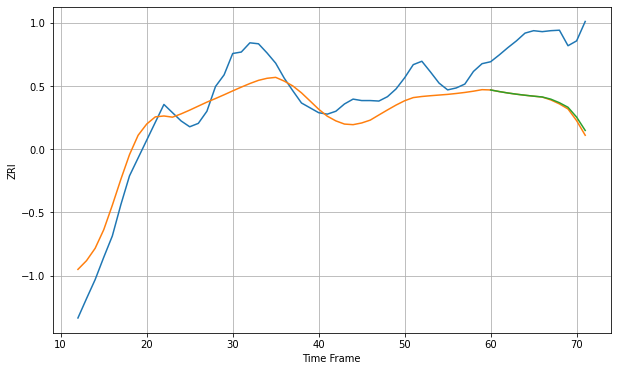

Wall time: 7.52 s
94501 45.93588789303576 136.95198416594147 134.17146109584107 [2560.86267817 2557.55515631 2554.62789866 2552.14039636 2549.99832551
 2548.09533839 2546.40386157 2541.93014913 2534.56578319 2525.15790303
 2504.85996969 2477.38609643]

Got an mse at 0.0100 in round 32 and stopped training

60 60 12


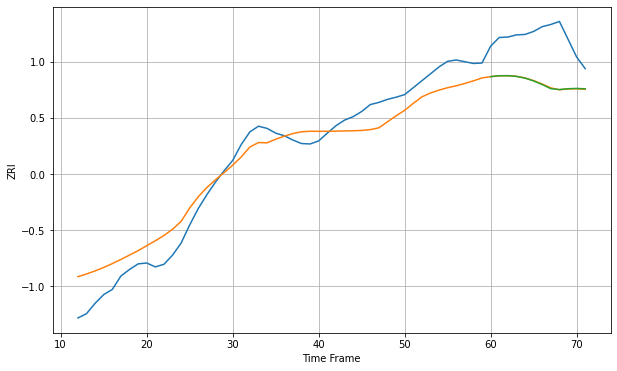

Wall time: 6.57 s
94509 44.7609363619957 107.12033306840421 107.38770389668447 [1876.49407099 1878.59367192 1878.71817997 1877.12981096 1873.12303803
 1866.61698729 1858.1941078  1848.76412056 1846.65571358 1848.59943385
 1849.29033855 1848.44477141]

Got an mse at 0.0098 in round 65 and stopped training

60 60 12


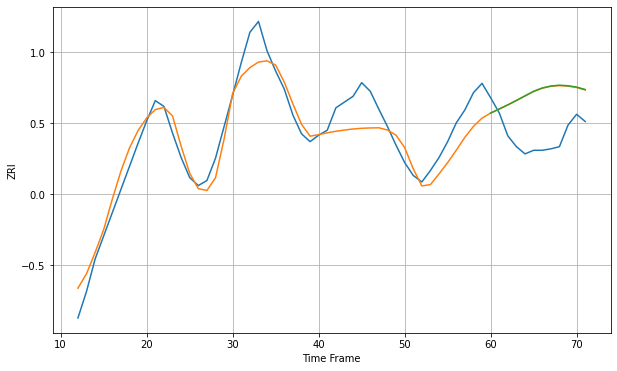

Wall time: 8.2 s
94530 27.134200350345832 63.28011961406393 63.57053973095794 [2429.67576195 2435.37724098 2441.09346093 2447.25617979 2453.62666135
 2459.94026401 2464.54741559 2467.32349265 2468.42470829 2467.6795507
 2465.81012245 2462.46874274]

Got an mse at 0.0100 in round 31 and stopped training

60 60 12


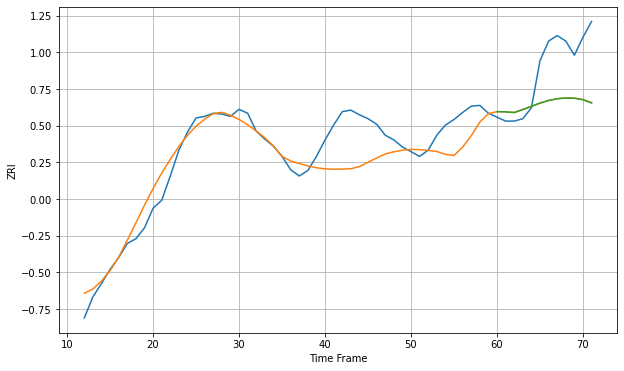

Wall time: 6.98 s
94538 28.59033453275058 58.32587487170065 58.4826132290786 [2465.04099926 2464.76944871 2463.89235831 2467.69165373 2471.82330152
 2475.95087903 2479.2902814  2481.46306435 2482.44497463 2482.10251701
 2480.18076384 2476.04187591]

Got an mse at 0.0100 in round 111 and stopped training

60 60 12


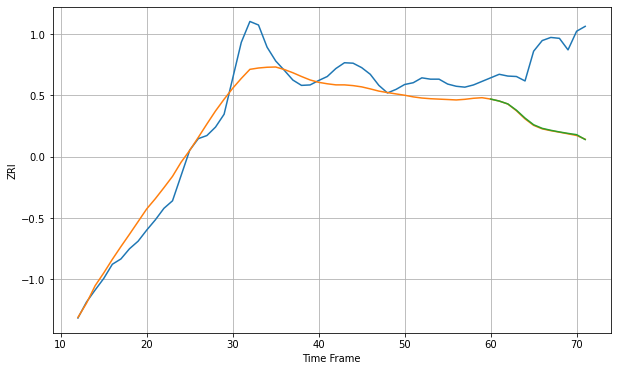

Wall time: 9.21 s
94541 38.68705617422234 167.11358290130866 166.37298685242513 [2336.16195605 2331.73323481 2325.23361241 2311.09563165 2293.33903121
 2278.34552006 2270.20606463 2265.81951746 2262.09199245 2258.84680025
 2255.97148017 2244.98547056]

Got an mse at 0.0098 in round 115 and stopped training

60 60 12


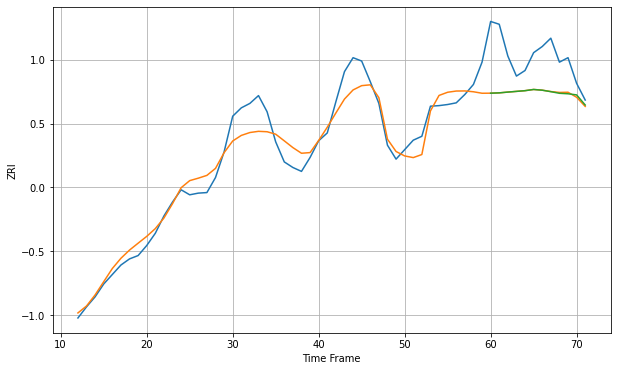

Wall time: 9.58 s
94549 27.454204850233033 73.68588199672399 73.86956138476195 [2689.33284889 2689.90084981 2691.29369236 2692.54850226 2693.82357071
 2695.98559906 2694.67726349 2692.04601262 2689.13256737 2688.24945902
 2686.24821682 2668.12730851]

Got an mse at 0.0094 in round 28 and stopped training

60 60 12


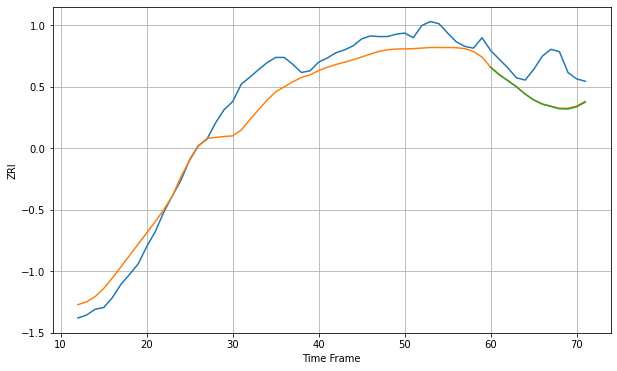

Wall time: 6.31 s
94565 34.018603377554044 56.74028928417173 57.205408112323745 [1975.0700582  1962.35320401 1952.05512538 1941.51514311 1929.05835871
 1918.84205168 1911.59224411 1907.63479358 1903.63833834 1903.19005525
 1906.86132745 1914.89861832]

Got an mse at 0.0099 in round 137 and stopped training

60 60 12


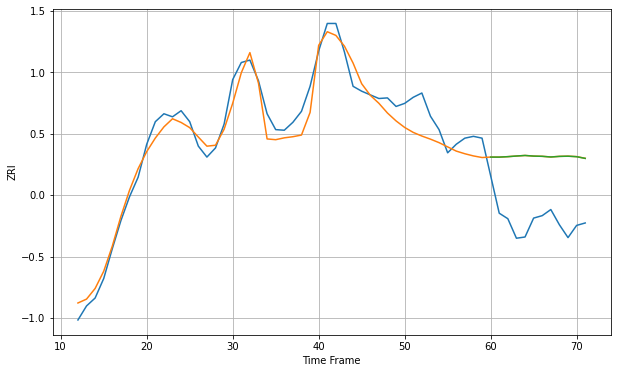

Wall time: 9.82 s
94568 25.12071767693044 106.96690748787975 106.92775661344129 [2734.9905268  2734.94521834 2735.695628   2736.73085391 2737.65353061
 2736.61967895 2736.24656782 2735.14910552 2736.12081774 2736.43178193
 2735.6205172  2732.81897107]
60 60 12


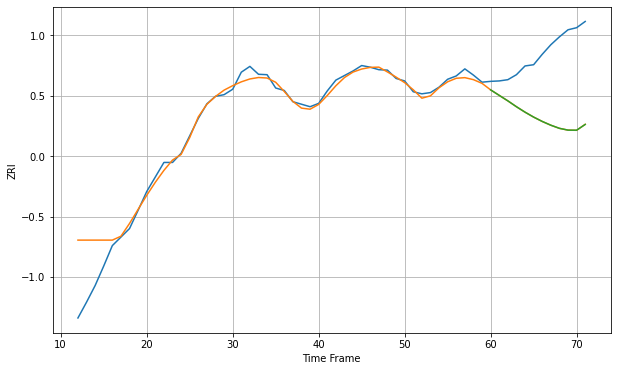

Wall time: 19.1 s
94603 40.1985532097097 165.96574162586586 165.95084658189458 [2357.48181681 2344.26462711 2331.08764353 2316.9982769  2303.9288074
 2292.07193884 2281.62591032 2272.56375736 2265.03717425 2260.72524398
 2260.52410638 2274.35924313]

Got an mse at 0.0099 in round 32 and stopped training

60 60 12


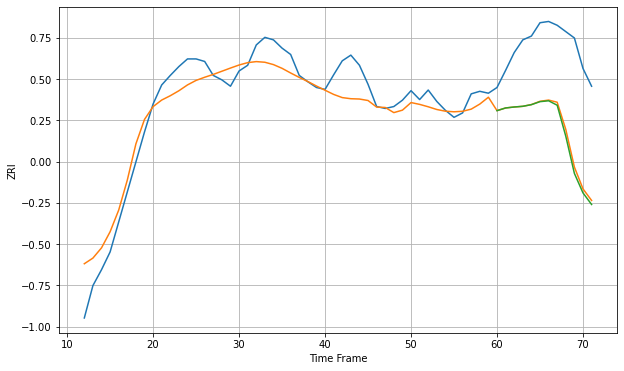

Wall time: 6.49 s
94608 29.47743718549467 133.38907543305567 137.68316375994257 [2762.52062843 2766.77362354 2768.29112901 2769.39749529 2771.95293126
 2776.69815365 2778.07010947 2771.06364112 2722.22413034 2663.70249683
 2632.99842172 2614.72722329]

Got an mse at 0.0098 in round 32 and stopped training

60 60 12


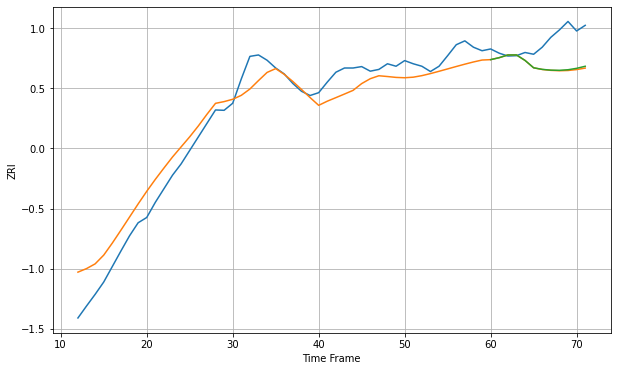

Wall time: 6.91 s
94621 53.202284120566944 79.19217009351169 77.59448525163651 [2500.68721433 2506.33008566 2513.92982951 2514.04959012 2498.53148284
 2477.61444952 2473.12342725 2470.92170198 2470.43312498 2472.07887194
 2476.09160204 2481.92328984]

Got an mse at 0.0097 in round 58 and stopped training

60 60 12


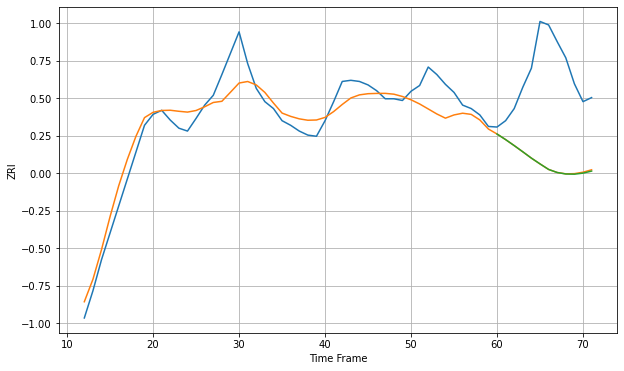

Wall time: 7.85 s
94703 31.245004493028784 161.43288204400383 161.7754459571358 [2750.90919045 2741.22185981 2730.81741622 2720.05912024 2709.08423547
 2699.0998376  2689.50405084 2684.1491909  2681.60862089 2681.27528883
 2683.07693864 2686.61159219]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


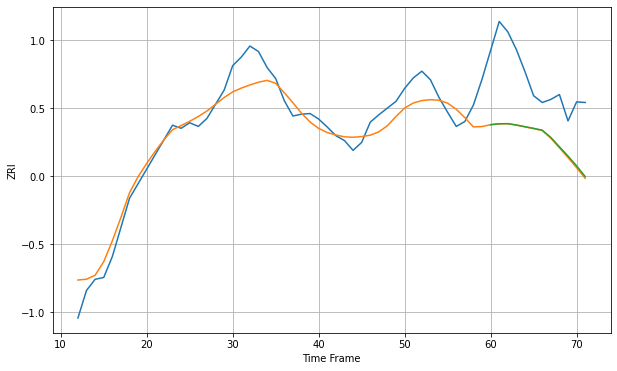

Wall time: 7.08 s
94801 27.70811554524039 105.99361066376099 105.06119729516588 [2206.86670282 2208.36030782 2208.55034757 2206.33341495 2203.57429831
 2200.88175092 2197.90567336 2186.12890427 2170.89326701 2155.71609227
 2139.731808   2122.36245818]

Got an mse at 0.0097 in round 24 and stopped training

60 60 12


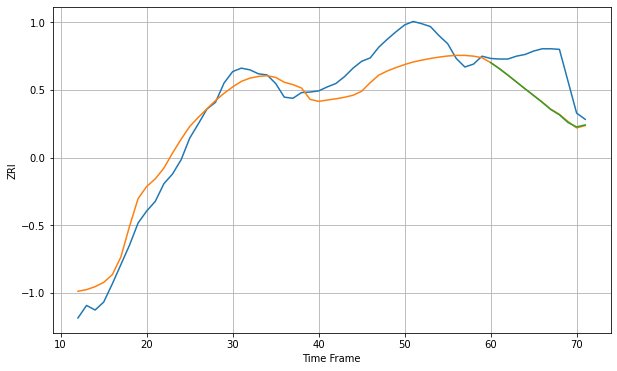

Wall time: 7.27 s
94806 35.08170132628813 65.67729198328699 66.05067684788398 [2137.73467425 2127.29403989 2115.75445665 2103.73471764 2091.68816245
 2079.93259482 2067.96772947 2055.25062272 2045.91947894 2032.37881924
 2024.67881724 2028.24011921]

Got an mse at 0.0098 in round 22 and stopped training

60 60 12


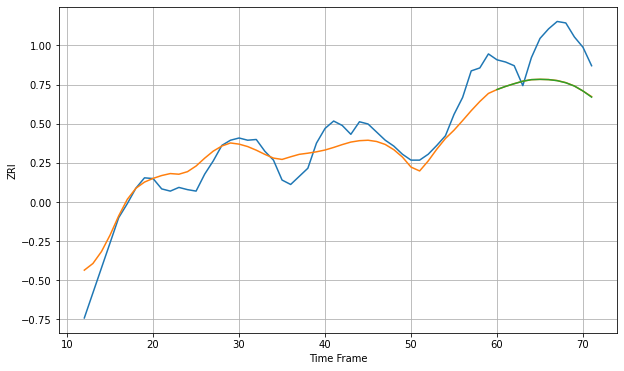

Wall time: 5.91 s
94901 24.205171266802004 53.77214657301103 53.86861028629034 [2594.72288779 2598.97770344 2602.63056477 2605.96837108 2608.10657243
 2608.51826647 2608.16725866 2606.75491282 2603.91830895 2599.42350546
 2592.73923696 2584.43065567]

Got an mse at 0.0099 in round 67 and stopped training

60 60 12


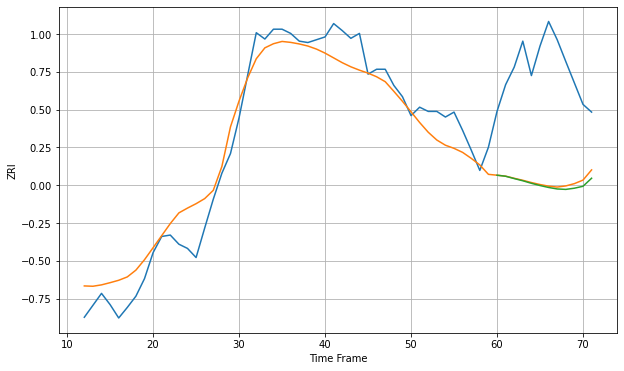

Wall time: 8.06 s
94903 31.880287834764516 163.45347233901202 166.2637456491871 [2556.19082835 2554.69996967 2551.39915088 2548.27117791 2544.66205426
 2541.5095805  2538.74113376 2536.61906184 2535.99349032 2537.70137034
 2540.41448274 2551.87906226]

Got an mse at 0.0100 in round 66 and stopped training

60 60 12


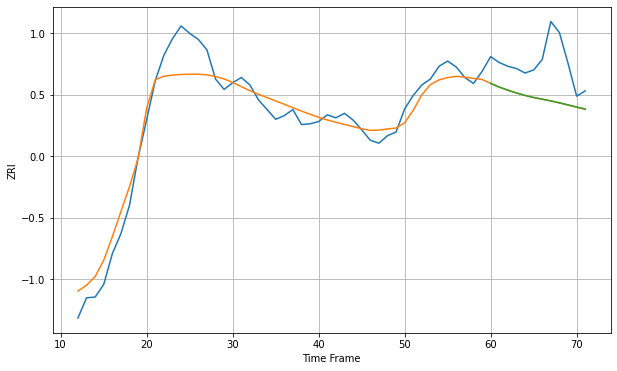

Wall time: 7.83 s
95008 22.580615440402 52.94959362302544 52.89402683465069 [2595.08872474 2590.14100049 2586.03229387 2582.25858828 2579.00837461
 2576.20788372 2573.95557138 2571.63547913 2569.02459892 2566.31261233
 2563.48501095 2560.77928784]

Got an mse at 0.0098 in round 102 and stopped training

60 60 12


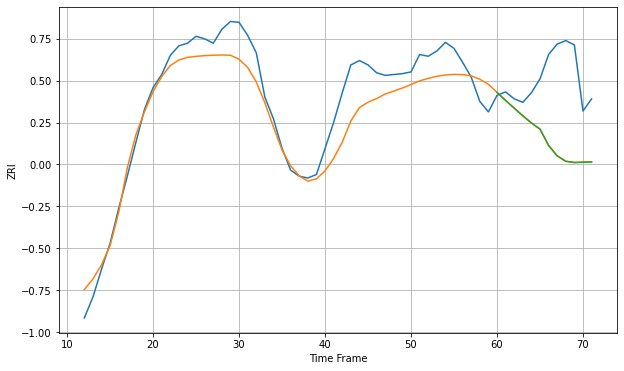

Wall time: 9.31 s
95014 26.49536058219458 80.94971169431071 81.03813209232425 [3212.38361085 3203.1900893  3194.29402685 3185.52655858 3177.31423586
 3170.21929991 3151.40518005 3139.38698448 3133.17397499 3131.70814961
 3132.08336685 3132.38042623]

Got an mse at 0.0099 in round 56 and stopped training

60 60 12


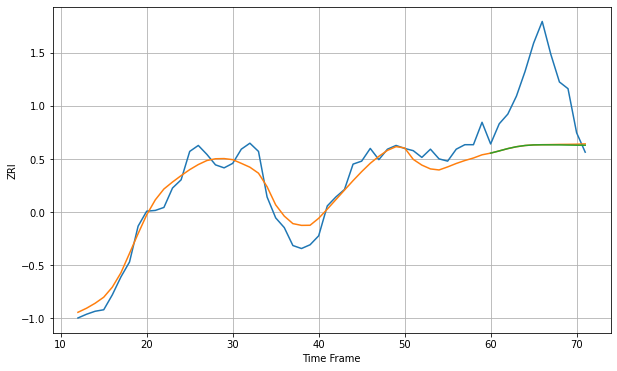

Wall time: 7.48 s
95050 17.557449720140013 87.2276587903274 87.40795934885217 [2663.71355662 2666.68736175 2669.79656327 2672.29629953 2673.93539839
 2674.71671894 2674.87643839 2674.82945337 2674.75615025 2674.52010363
 2674.3284907  2674.30070546]

Got an mse at 0.0098 in round 22 and stopped training

60 60 12


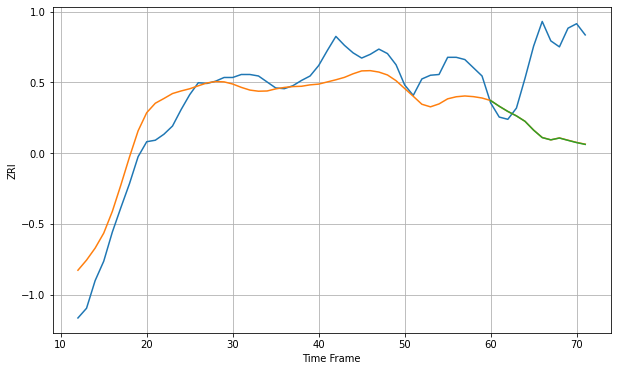

Wall time: 7.27 s
95051 33.1242590175325 108.8353499926373 108.95460067903527 [2806.12762077 2798.47079428 2791.53118182 2785.58610624 2778.30075149
 2766.47222496 2756.5132341  2753.47426337 2755.93440436 2752.82641927
 2749.81340606 2747.40080189]

Got an mse at 0.0098 in round 24 and stopped training

60 60 12


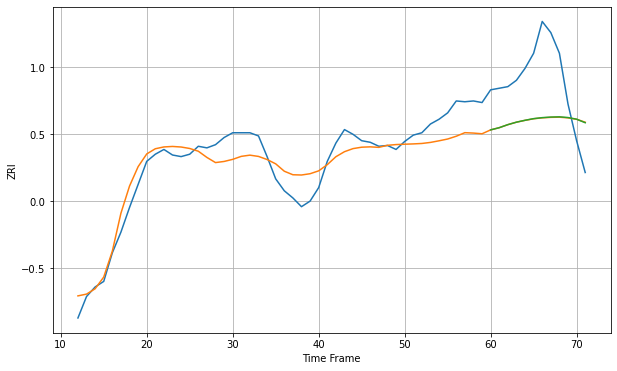

Wall time: 6.6 s
95112 22.38134520580329 69.94075978047599 69.73407965377794 [2532.60791767 2535.37510791 2539.19883748 2542.33236984 2544.68696619
 2546.75625023 2548.01255676 2548.74276059 2549.02844228 2548.13347951
 2546.06206059 2541.63071378]

Got an mse at 0.0099 in round 61 and stopped training

60 60 12


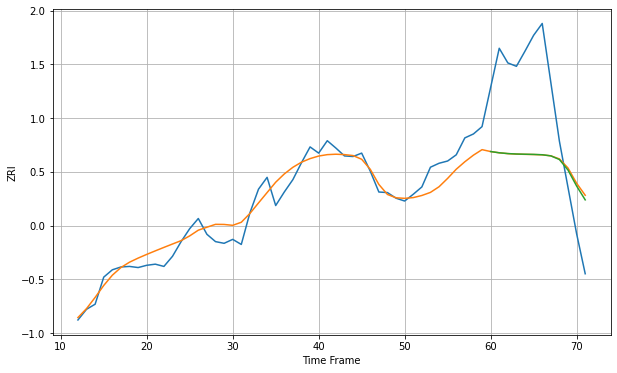

Wall time: 7.56 s
95116 22.772815519205537 151.83646648987173 150.85018782810195 [2526.78283085 2524.59492056 2523.19396554 2522.41339042 2522.02937391
 2521.71336271 2521.11917999 2519.13668669 2512.62730425 2493.88717608
 2465.63525522 2441.08562002]

Got an mse at 0.0100 in round 49 and stopped training

60 60 12


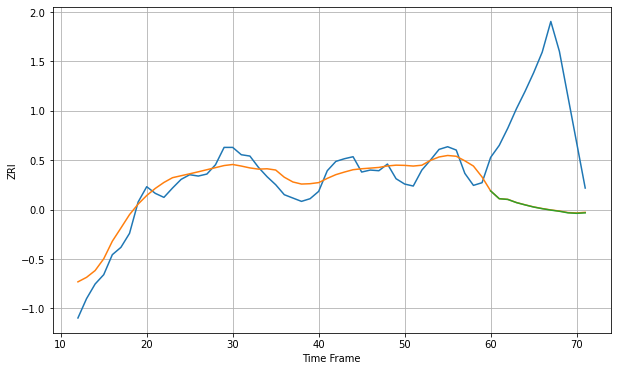

Wall time: 7.23 s
95117 19.6565848191607 169.4999615843819 169.7168090540558 [2501.69580496 2489.99000785 2488.88997866 2484.16497489 2480.71913538
 2477.50668633 2475.03655582 2472.89168452 2471.13498258 2468.78037034
 2468.05711778 2468.76023456]

Got an mse at 0.0099 in round 27 and stopped training

60 60 12


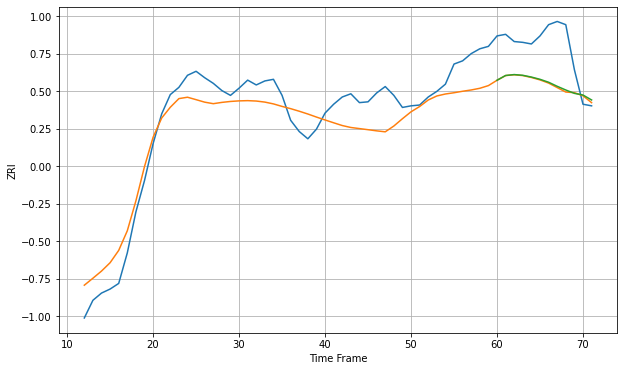

Wall time: 6.38 s
95123 28.6585926890733 53.12556174261571 52.401708553278105 [2742.8094711  2748.77529736 2749.90658872 2749.00884808 2746.81732627
 2744.01461346 2740.37197658 2735.32039797 2730.70537625 2726.5293834
 2724.46589006 2718.30444087]

Got an mse at 0.0100 in round 335 and stopped training

60 60 12


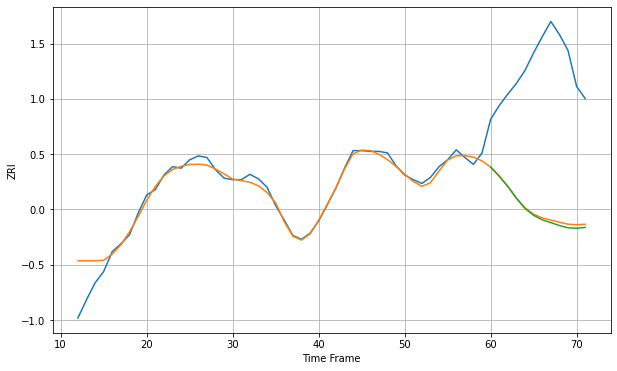

Wall time: 15.4 s
95128 14.70618540860018 187.51103308300574 190.05479290422997 [2524.46336697 2512.57118704 2499.08132982 2483.51450629 2470.2841681
 2461.27495765 2455.47807828 2451.77810903 2447.93774473 2445.05736359
 2444.37271644 2445.54795874]

Got an mse at 0.0099 in round 102 and stopped training

60 60 12


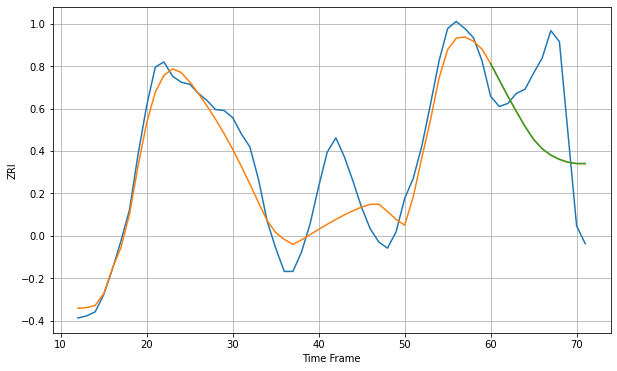

Wall time: 9.12 s
95134 25.786810500179023 67.89363772087623 67.92051085613672 [3132.26851426 3116.25227627 3100.14210094 3084.92929434 3070.21155857
 3057.42415725 3048.16785042 3041.87615438 3037.73532822 3034.86795753
 3033.62333603 3033.62744287]

Got an mse at 0.0098 in round 39 and stopped training

60 60 12


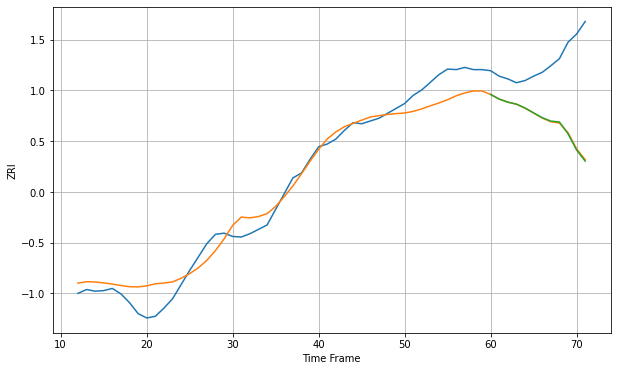

Wall time: 6.89 s
95207 28.525410499297504 122.67023012684756 123.35466623878716 [1196.56456161 1188.09993452 1182.52192399 1178.83038551 1171.75008163
 1162.91339356 1154.13926858 1147.86859525 1146.31432005 1124.70634182
 1095.01381591 1074.68065094]

Got an mse at 0.0097 in round 42 and stopped training

60 60 12


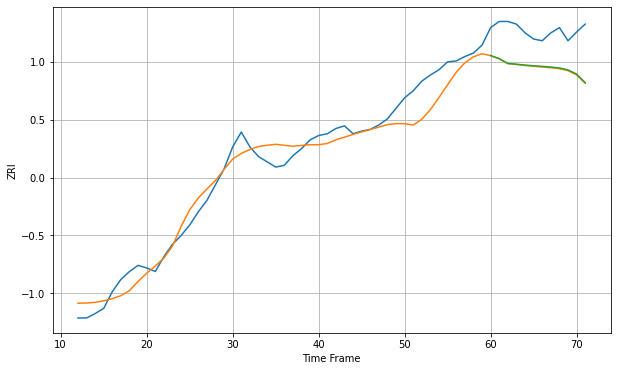

Wall time: 7.65 s
95608 17.298859203189107 43.16963804135926 42.65070791122803 [1414.10939247 1410.58491566 1405.14184041 1404.28751098 1403.31028745
 1402.50749049 1401.81569216 1401.02169205 1399.98019923 1397.7857796
 1393.07127619 1383.15854744]

Got an mse at 0.0100 in round 19 and stopped training

60 60 12


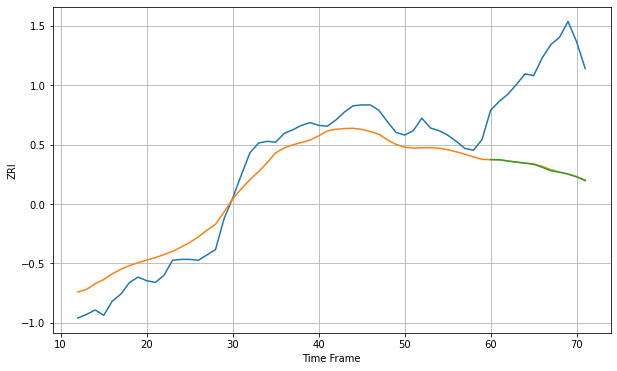

Wall time: 6.4 s
95678 22.08958011225577 117.88810409910828 118.31465637452374 [1645.36057184 1645.23858839 1643.79278313 1642.5305219  1641.32586968
 1640.17585582 1636.75452487 1632.78990274 1631.16397523 1629.00398173
 1625.90832883 1621.62371138]

Got an mse at 0.0099 in round 38 and stopped training

60 60 12


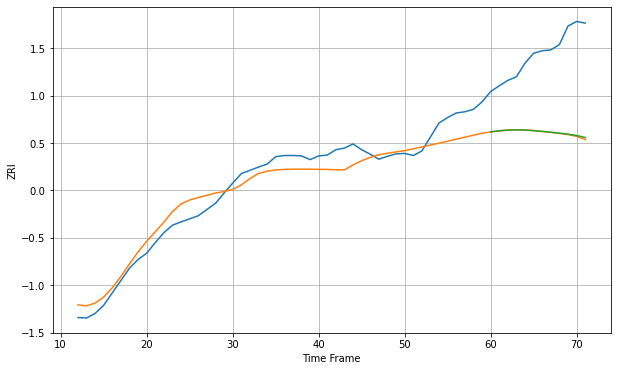

Wall time: 7.03 s
95816 34.2672784513044 196.896665494196 195.90391529476773 [1394.33958693 1396.89072654 1398.51567071 1399.1994252  1398.78098943
 1397.34994837 1395.41343319 1393.41521163 1391.13651269 1388.63683053
 1385.55188192 1380.5984466 ]

Got an mse at 0.0099 in round 40 and stopped training

60 60 12


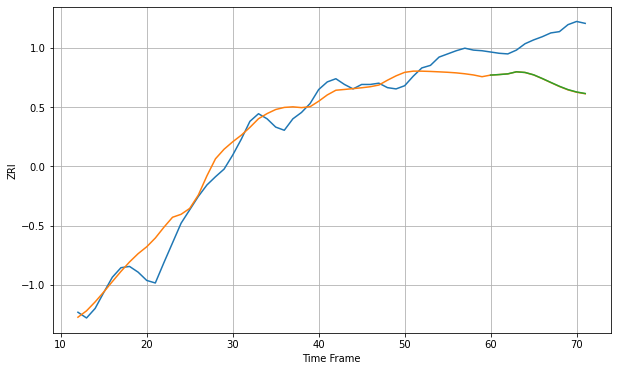

Wall time: 7.52 s
95826 24.537038787332847 72.24023946030773 71.99486682112358 [1403.72147058 1404.5526001  1405.6735489  1408.90252051 1407.87845005
 1404.15904981 1398.40656689 1392.21423463 1386.13663332 1380.89625951
 1377.18064449 1374.79538887]

Got an mse at 0.0097 in round 59 and stopped training

60 60 12


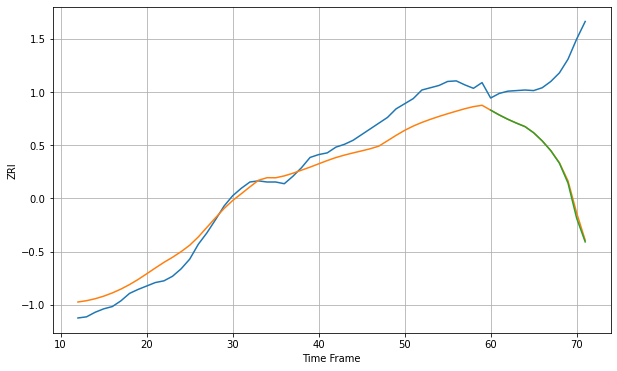

Wall time: 7.58 s
95831 29.997261254046787 170.66154744028293 173.07384762520124 [1513.78207862 1505.35443355 1497.78231702 1491.05325988 1484.90152563
 1474.2719373  1459.96814225 1442.7915936  1420.84001126 1386.0412326
 1324.83495545 1283.1592291 ]

Got an mse at 0.0099 in round 42 and stopped training

60 60 12


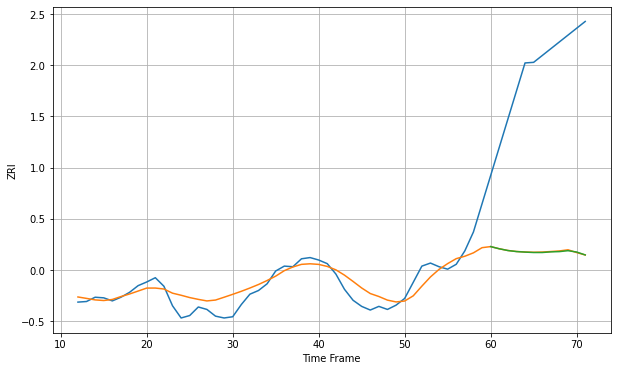

Wall time: 7.01 s
95928 20.605013327469575 300.8948373858566 301.22844471748397 [1369.00499271 1365.42749713 1362.57117642 1360.86695524 1359.96926921
 1359.2958799  1359.30084604 1360.33149246 1360.79371799 1362.28106291
 1360.11463726 1355.34598662]

Got an mse at 0.0100 in round 100 and stopped training

60 60 12


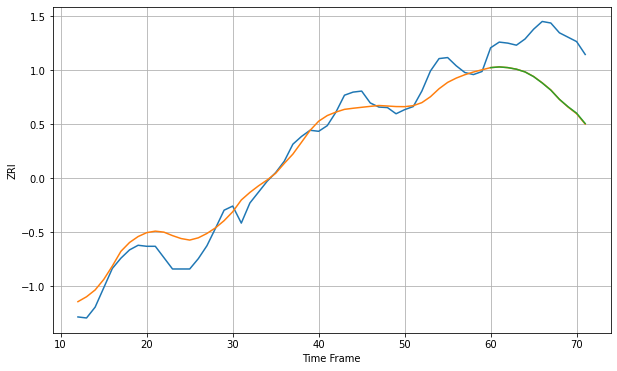

Wall time: 8.5 s
96150 28.299509556066035 101.85153039487031 101.64607285194194 [1660.48178819 1661.83695755 1660.49185545 1657.40762052 1652.12726907
 1643.03966723 1630.73090464 1616.83170168 1598.98791309 1584.70722879
 1572.13597757 1552.02191758]

Got an mse at 0.0100 in round 45 and stopped training

60 60 12


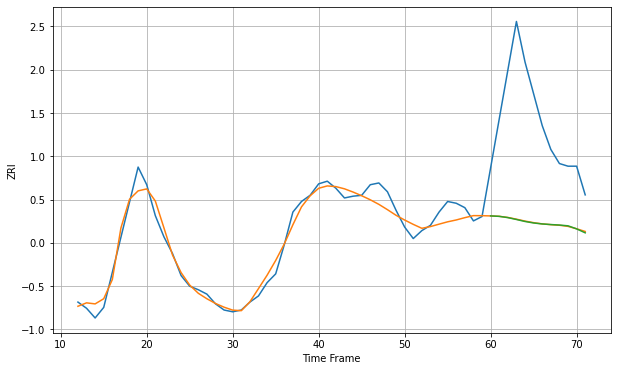

Wall time: 7.65 s
96826 10.699970974710098 123.46623423485556 123.644650840959 [1533.6491715  1533.14003225 1531.73896378 1529.59799371 1527.33917977
 1525.64704959 1524.53765793 1523.86837104 1523.30402635 1522.43168878
 1518.97646512 1514.48415832]

Got an mse at 0.0097 in round 32 and stopped training

60 60 12


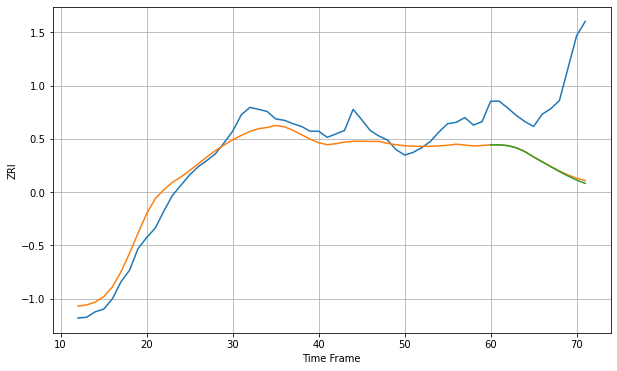

Wall time: 6.99 s
97030 21.803853316333097 116.46892098453418 117.85428150474146 [1333.00171065 1333.05418324 1331.81644905 1328.6525067  1322.96619863
 1315.2166944  1308.05055428 1300.86746696 1293.76655838 1287.28233017
 1281.27651796 1276.52483376]

Got an mse at 0.0099 in round 76 and stopped training

60 60 12


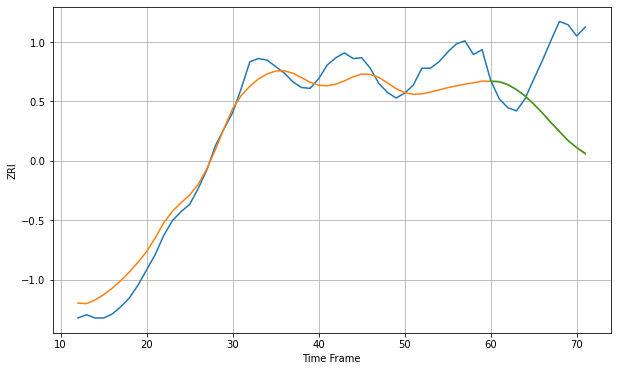

Wall time: 8.38 s
97035 23.9847571830109 91.62215765747364 91.41071761949266 [1551.8059917  1551.26952045 1547.6048389  1541.49108379 1533.54758545
 1523.58885911 1512.64326832 1500.74515949 1489.41056822 1478.31909289
 1469.56193926 1462.47692831]

Got an mse at 0.0098 in round 83 and stopped training

60 60 12


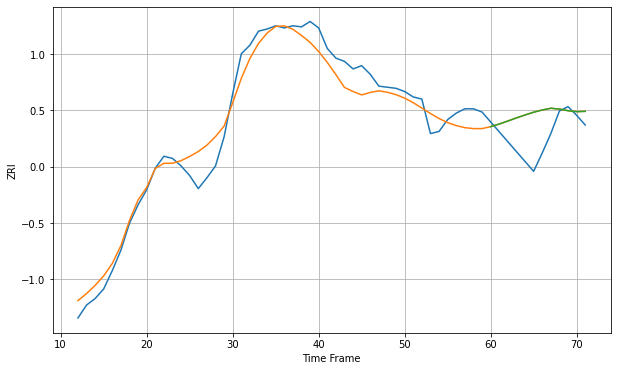

Wall time: 8.78 s
97062 14.498876879527625 26.781583504742283 26.786128790841886 [1442.43625018 1444.86409137 1447.66189941 1450.54075031 1453.27362775
 1455.84838646 1457.88574514 1459.52905739 1458.7182552  1457.22770899
 1456.3199119  1456.58938548]

Got an mse at 0.0099 in round 38 and stopped training

60 60 12


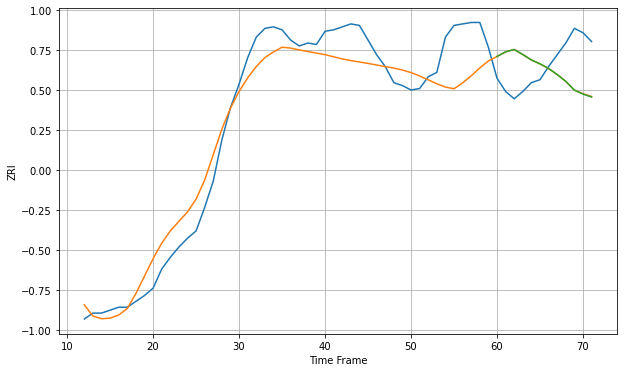

Wall time: 6.7 s
97070 17.60749635531574 27.119926300731144 27.210189000946055 [1367.85561304 1371.00772896 1372.5925407  1369.18409285 1365.46111269
 1362.81208411 1359.64209847 1355.52492792 1350.86130632 1344.88468518
 1342.21560703 1340.18871251]

Got an mse at 0.0099 in round 103 and stopped training

60 60 12


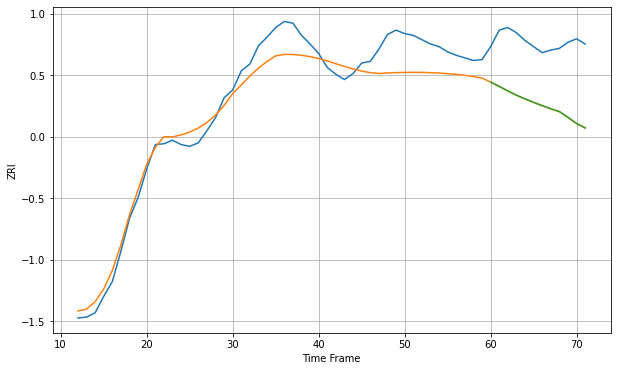

Wall time: 9.29 s
97124 22.198707812123285 73.75949718672996 73.6701468419782 [1469.0659582  1464.10089033 1458.93386203 1453.9168261  1449.71368707
 1445.71322969 1441.90437134 1438.32283398 1435.03306257 1428.49839048
 1421.35174345 1416.09615107]

Got an mse at 0.0098 in round 46 and stopped training

60 60 12


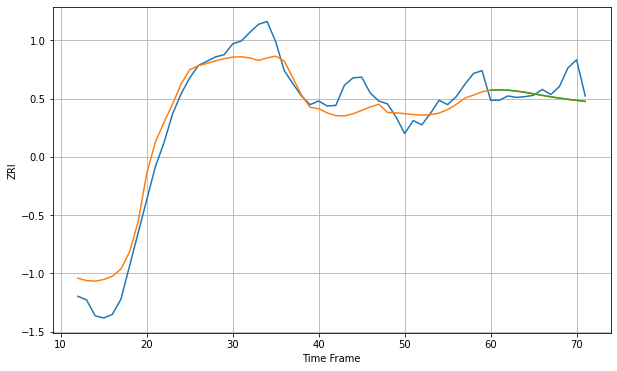

Wall time: 7.3 s
97209 26.673926399323406 22.40584398154784 22.417692438593132 [1741.03568714 1741.46200612 1740.92767258 1739.75696781 1738.01636654
 1735.97647297 1733.85203097 1731.81205688 1729.95855129 1728.33907794
 1726.89056113 1725.48842329]

Got an mse at 0.0100 in round 73 and stopped training

60 60 12


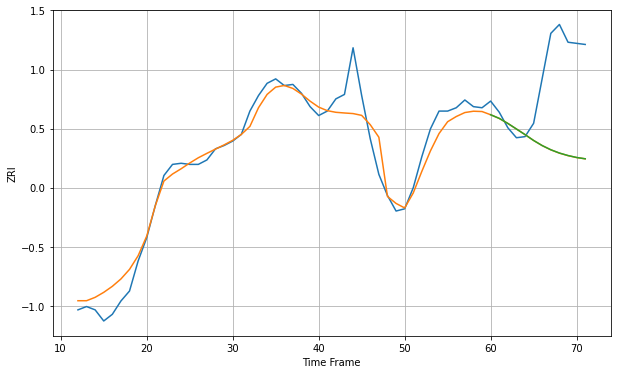

Wall time: 8.16 s
97214 14.412361965540267 70.83598917428543 70.79062194317176 [1567.70328438 1564.41720706 1559.89490029 1554.87732424 1549.83284228
 1544.54014271 1539.93050547 1536.17210236 1533.21470556 1530.97184414
 1529.2294411  1528.05117038]

Got an mse at 0.0099 in round 36 and stopped training

60 60 12


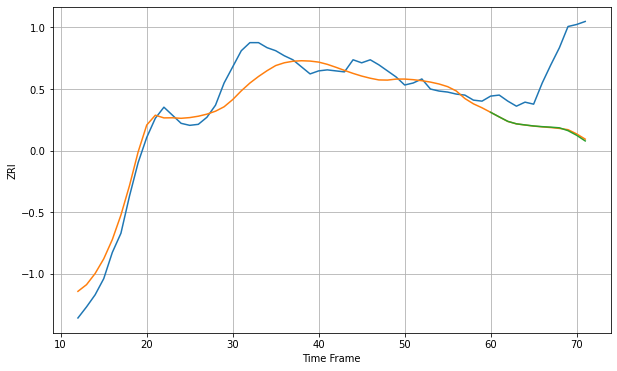

Wall time: 7.11 s
97229 15.465617764972508 64.83478709437124 65.30743485495282 [1426.9120838  1422.36426271 1417.93390084 1415.50281777 1414.40864229
 1413.38355756 1412.6871902  1412.20363742 1411.54028032 1408.73534441
 1404.1727973  1398.53850362]

Got an mse at 0.0099 in round 138 and stopped training

60 60 12


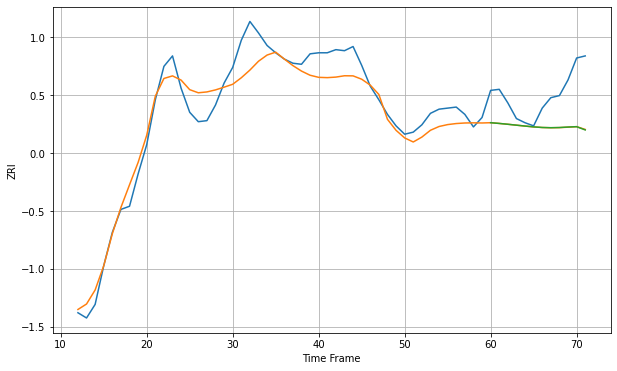

Wall time: 9.5 s
97239 16.843719789590683 36.45348910846678 36.49930246027194 [1606.03026226 1605.332371   1604.53246693 1603.6814999  1602.81450401
 1602.02763686 1601.45950913 1601.24680811 1601.41635073 1601.88857735
 1602.23559749 1599.11769224]

Got an mse at 0.0100 in round 106 and stopped training

60 60 12


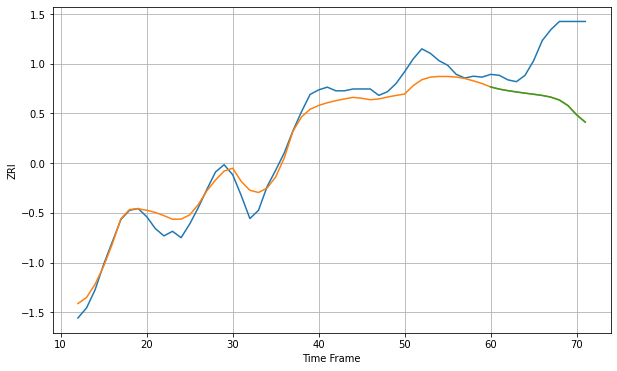

Wall time: 9.4 s
97401 13.899043124979102 64.51030945959764 64.63520263448062 [1267.23575725 1264.86166733 1263.1684899  1261.74155874 1260.43525074
 1259.21125225 1257.90827518 1256.04851031 1252.79635831 1246.6688371
 1236.52588283 1228.66384707]

Got an mse at 0.0099 in round 52 and stopped training

60 60 12


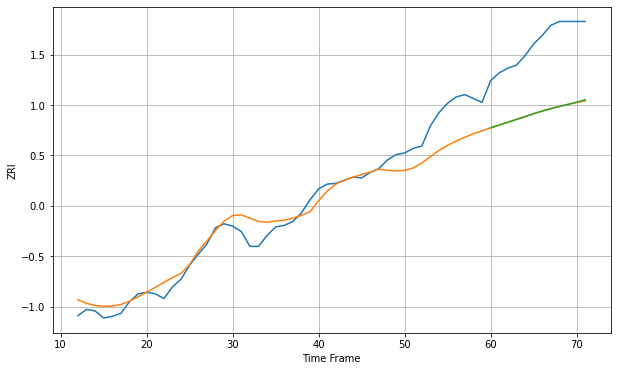

Wall time: 7.94 s
97402 22.587659667164285 90.11989422712234 89.95034285832106 [1086.31480093 1089.9414123  1093.49300898 1097.11476506 1100.70648834
 1104.46791492 1107.87630862 1110.96255674 1113.78544071 1116.46806197
 1119.24163357 1122.40433195]

Got an mse at 0.0100 in round 191 and stopped training

60 60 12


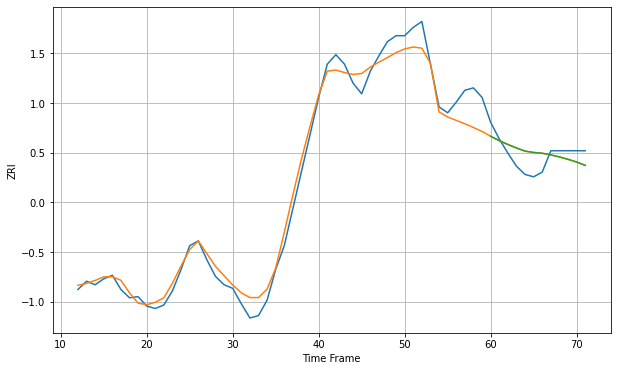

Wall time: 11.3 s
97477 11.627874101234251 12.337932605952382 12.330022806182507 [1058.21534166 1054.51744335 1051.30660081 1048.32722514 1045.68021299
 1044.54954808 1043.88135528 1042.53288803 1040.77605504 1038.78733623
 1036.5151628  1033.67685594]

Got an mse at 0.0098 in round 37 and stopped training

60 60 12


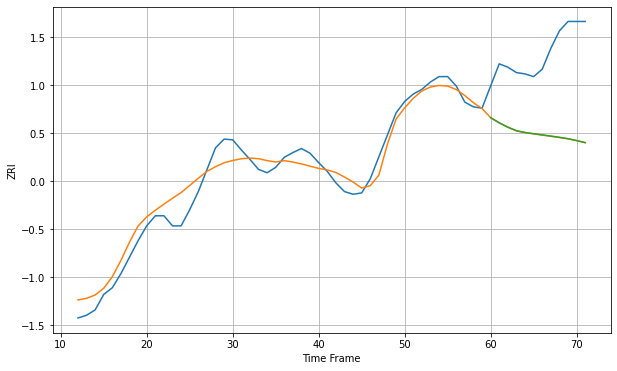

Wall time: 7.95 s
97501 19.287559237542432 124.67027884600803 124.51359162187319 [1088.89625757 1081.29960027 1074.82601112 1069.52255328 1066.8752103
 1065.0229644  1063.26915021 1061.49708661 1059.67639358 1057.62835684
 1054.87756804 1051.82009802]

Got an mse at 0.0100 in round 66 and stopped training

60 60 12


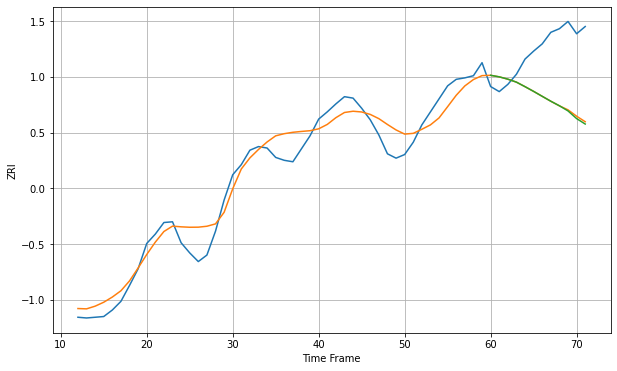

Wall time: 7.72 s
98004 21.590742394741994 79.77745670965514 80.7920343946235 [2275.55452105 2273.42193718 2270.21270865 2266.09908896 2259.83178305
 2253.31420771 2246.48692999 2239.70114022 2233.40372413 2226.30098183
 2215.70735051 2208.17097793]

Got an mse at 0.0097 in round 62 and stopped training

60 60 12


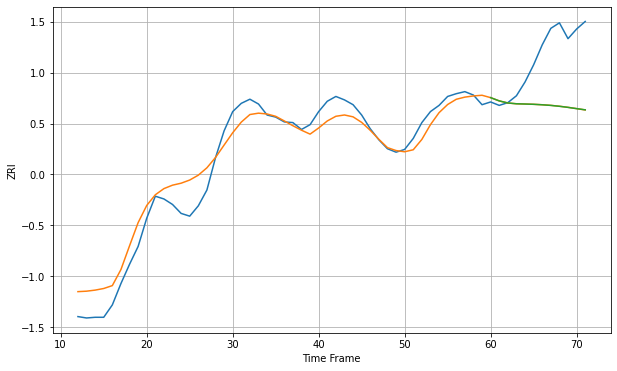

Wall time: 8.25 s
98005 23.404436201768423 81.25138616301646 81.26640410481679 [1966.2657543  1961.54506211 1958.50934038 1957.36026757 1956.99790328
 1956.57725559 1955.89434627 1954.98396596 1953.6882541  1952.12201466
 1950.30286408 1948.55371502]

Got an mse at 0.0096 in round 25 and stopped training

60 60 12


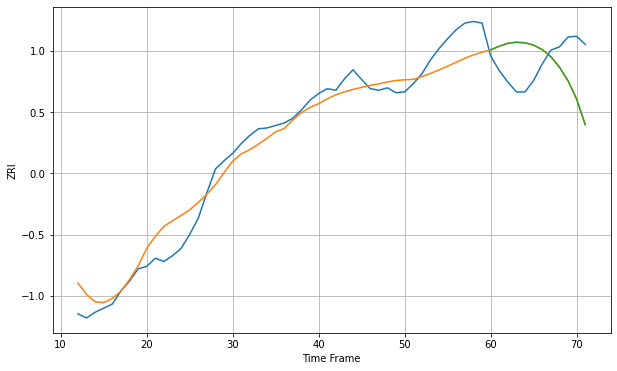

Wall time: 6.36 s
98012 21.59818715392697 51.3178174916521 51.34014903172906 [1784.41222273 1788.70513528 1792.30367917 1793.62349782 1792.88807513
 1790.04294164 1784.67916289 1775.99758687 1763.35623576 1746.64491076
 1724.18630446 1692.97318784]

Got an mse at 0.0099 in round 66 and stopped training

60 60 12


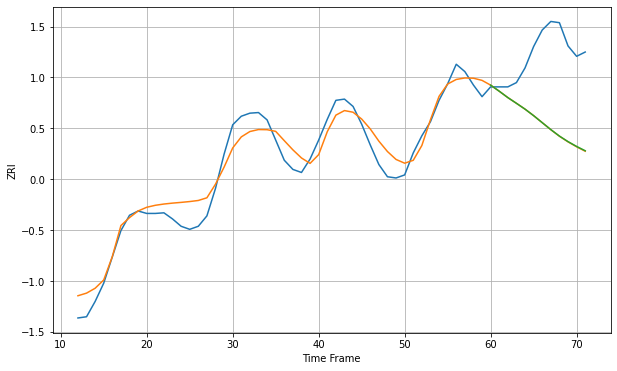

Wall time: 7.34 s
98029 24.107093361664134 122.63254874739096 122.40536514617709 [2123.84961978 2113.91543044 2103.48647391 2094.13371449 2084.57658452
 2073.92982967 2062.50174326 2051.1200397  2040.51641083 2031.46475644
 2023.57754644 2016.52221829]

Got an mse at 0.0098 in round 169 and stopped training

60 60 12


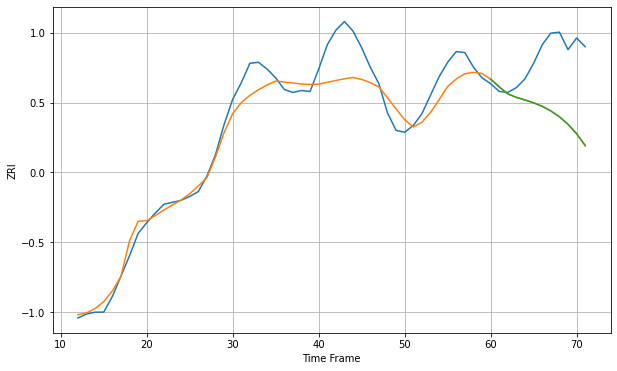

Wall time: 10.2 s
98034 19.912994230647307 62.13838208955645 61.9920550548437 [1836.66607998 1828.69450902 1821.44205071 1817.9263018  1815.23585304
 1812.33991383 1808.70933876 1804.02158729 1797.96213183 1790.29525163
 1780.60637484 1768.5171346 ]

Got an mse at 0.0100 in round 68 and stopped training

60 60 12


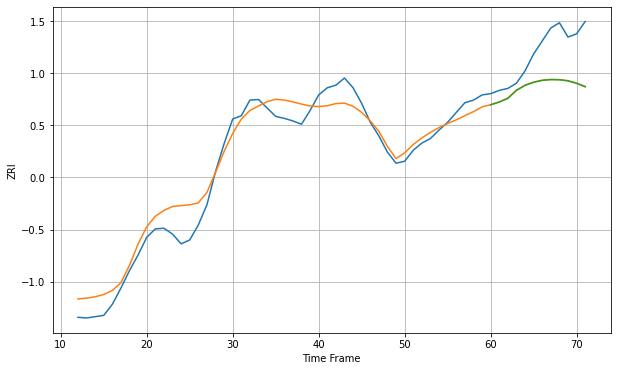

Wall time: 7.72 s
98052 23.394505665138883 58.49114763781714 58.791378175331225 [2103.87424362 2108.1143382  2113.67774121 2125.96505652 2133.73360002
 2138.46470427 2141.43066953 2142.57377325 2142.30005506 2140.59460954
 2136.83981552 2131.4815479 ]

Got an mse at 0.0100 in round 78 and stopped training

60 60 12


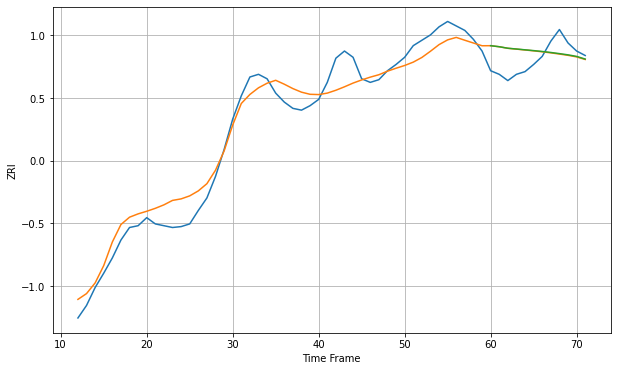

Wall time: 7.64 s
98056 17.55834028917155 22.04459799188659 21.99393034995536 [1661.95269085 1660.79892386 1659.1130901  1658.24384002 1657.35548725
 1656.46412111 1655.49985518 1654.37985436 1653.10758123 1651.72911198
 1649.99381259 1647.02998393]

Got an mse at 0.0096 in round 34 and stopped training

60 60 12


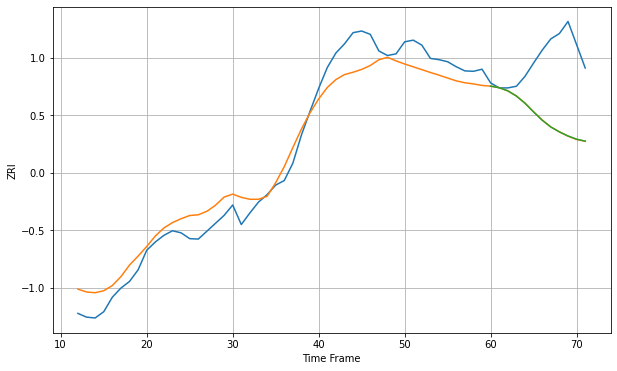

Wall time: 7.06 s
98101 44.8922970664521 160.12573808210223 159.99979706006403 [2560.29617023 2556.42065641 2548.93732317 2536.40072022 2519.09100071
 2498.13203881 2478.25685747 2461.8490426  2450.04502969 2440.27424789
 2432.51649331 2427.86515998]

Got an mse at 0.0099 in round 101 and stopped training

60 60 12


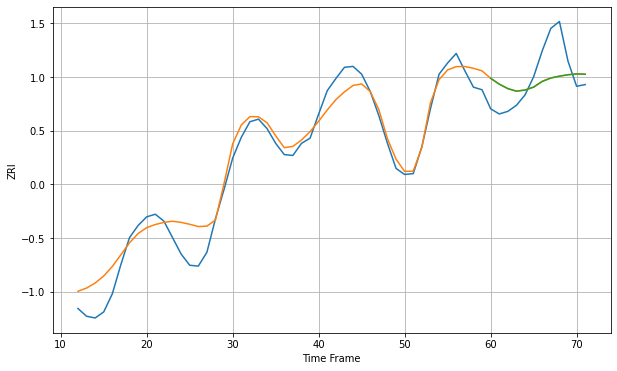

Wall time: 9.07 s
98102 19.581295557585054 32.52232513019292 32.56258008221354 [2027.26718206 2020.51547813 2015.32511421 2012.39554475 2013.65292774
 2017.01772916 2023.58661364 2027.55253885 2029.70831105 2031.36776609
 2032.33242354 2031.89409305]

Got an mse at 0.0100 in round 109 and stopped training

60 60 12


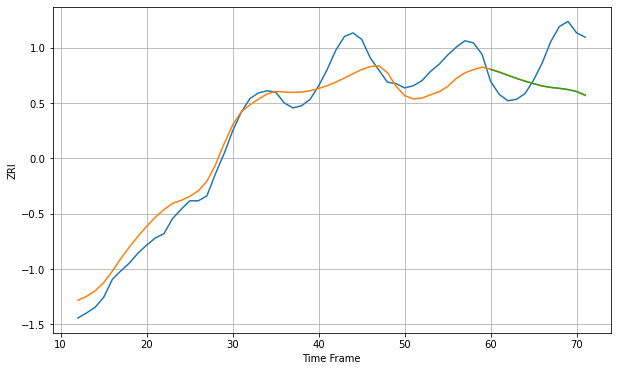

Wall time: 8.86 s
98103 25.76478870743221 56.972071975255204 56.829146505916334 [1907.95388846 1904.2060689  1899.69103331 1895.37223902 1891.49173379
 1888.06698793 1884.68982692 1882.72551998 1881.44972362 1879.70315657
 1877.05815966 1871.97879275]

Got an mse at 0.0098 in round 106 and stopped training

60 60 12


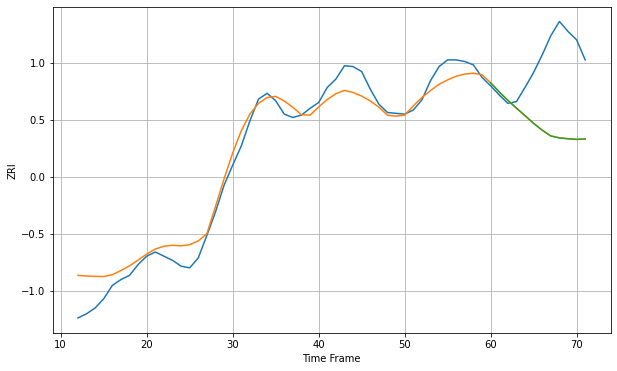

Wall time: 9.69 s
98105 18.32993510578587 84.91849921093781 84.97617111170985 [1822.57849562 1811.64281371 1801.58936462 1792.26663253 1783.23067748
 1773.99599546 1765.79340729 1758.89233962 1756.57628454 1755.52563823
 1754.77228075 1755.30146052]

Got an mse at 0.0098 in round 74 and stopped training

60 60 12


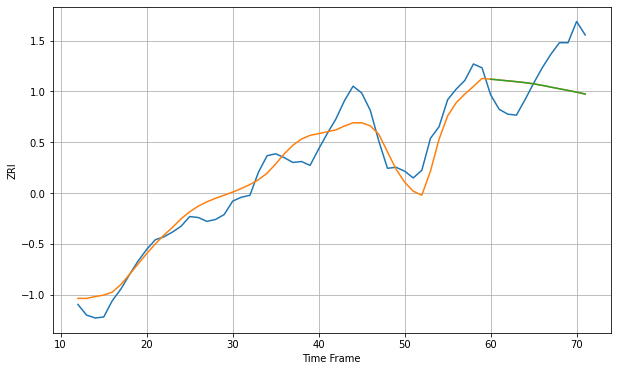

Wall time: 7.75 s
98107 16.69790297449946 39.99349537604627 39.970393883428684 [1952.25616581 1951.36997869 1950.53308793 1949.65055479 1948.68191296
 1947.44269972 1945.8444386  1944.06024209 1942.30216714 1940.63640226
 1938.84150469 1936.89935089]

Got an mse at 0.0100 in round 45 and stopped training

60 60 12


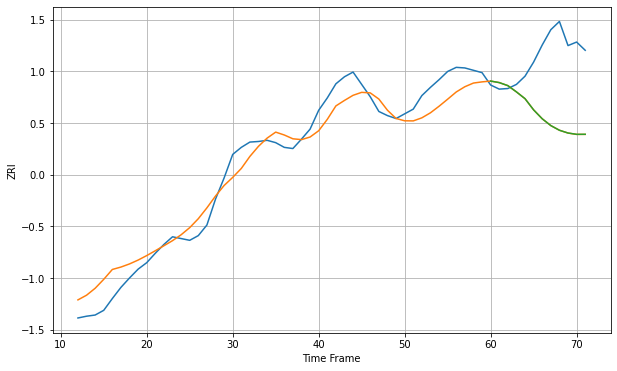

Wall time: 7.25 s
98109 28.233525684332307 112.57616649287421 112.53970344527012 [2066.6927174  2064.09348633 2058.94388985 2048.29188333 2036.73808208
 2017.70215303 2002.57428931 1991.00305276 1983.08697524 1978.38692814
 1976.1578341  1976.25071915]

Got an mse at 0.0099 in round 102 and stopped training

60 60 12


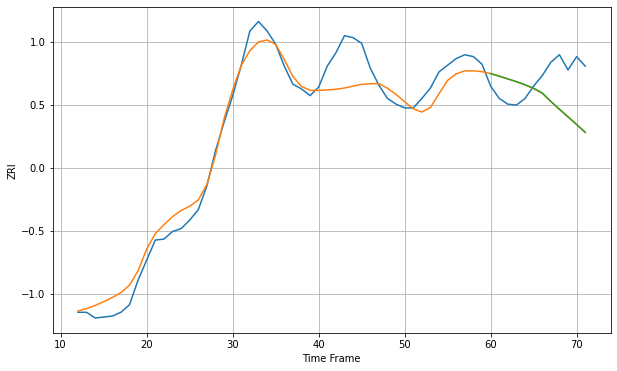

Wall time: 9.34 s
98115 18.658989156600295 40.81995848472471 40.76027922181357 [1851.181197   1848.43797266 1845.55307238 1842.70513374 1839.42501321
 1835.69277702 1830.77258904 1821.98135202 1813.69432006 1805.65820659
 1797.59025511 1789.34201357]

Got an mse at 0.0100 in round 62 and stopped training

60 60 12


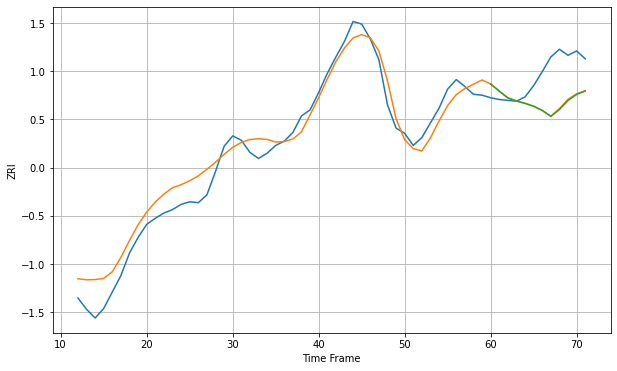

Wall time: 8.69 s
98119 18.376576539533428 39.48961575830765 39.9135934182579 [1907.95650123 1899.66626517 1891.82689256 1888.26765141 1885.59932712
 1882.20579068 1877.43840215 1870.58110698 1878.3561769  1888.90533035
 1895.79197899 1899.74074147]

Got an mse at 0.0099 in round 59 and stopped training

60 60 12


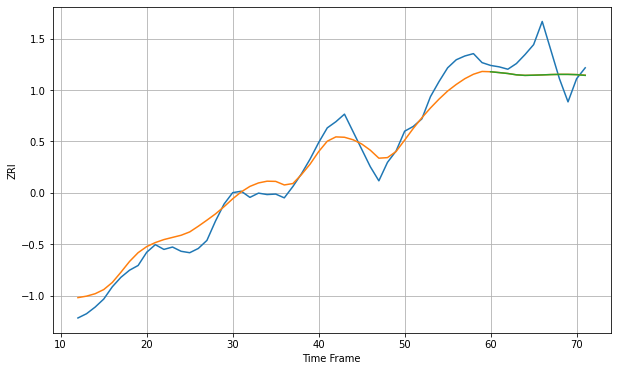

Wall time: 7.55 s
98121 28.257880408985198 46.82514995971131 46.83866308972125 [2298.66170441 2296.87184786 2294.96039157 2292.16767003 2290.96027478
 2291.41198298 2291.97414083 2292.67789114 2293.0757283  2293.04497578
 2292.51229314 2290.99702208]

Got an mse at 0.0100 in round 54 and stopped training

60 60 12


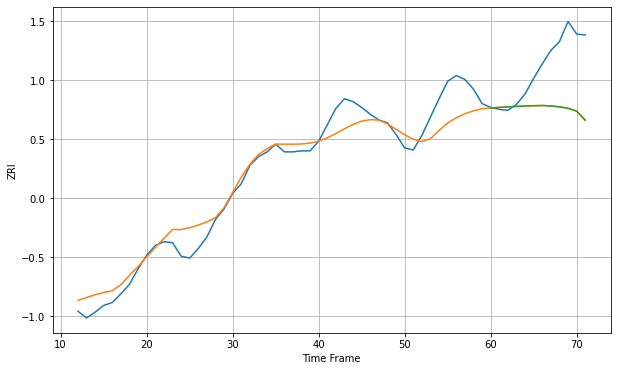

Wall time: 7.73 s
98122 17.480160745284607 52.43334542047475 52.32380308668128 [1888.43330753 1889.03381295 1889.58945069 1890.06860995 1890.45328285
 1890.76325875 1890.95188928 1890.52999985 1889.59109765 1888.13352646
 1885.18778971 1876.06999398]

Got an mse at 0.0098 in round 49 and stopped training

60 60 12


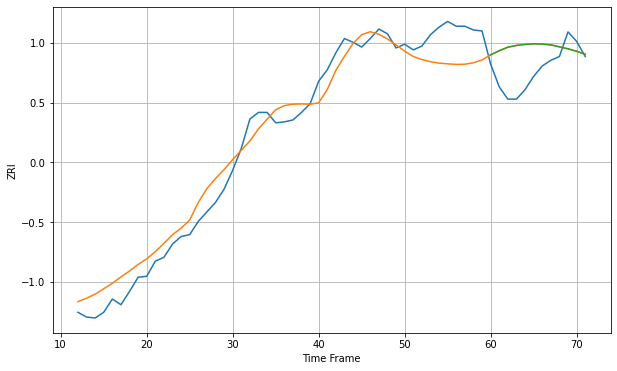

Wall time: 7.03 s
98133 20.62703892378174 32.38923586942597 32.37340127970958 [1740.76895455 1745.117066   1748.8323219  1750.70157583 1751.81100199
 1752.39775881 1752.09767584 1751.25338283 1749.19904792 1747.10690515
 1744.52200686 1741.38858496]

Got an mse at 0.0099 in round 72 and stopped training

60 60 12


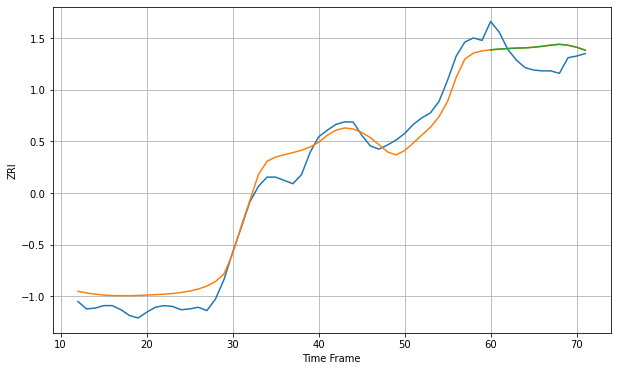

Wall time: 8.86 s
98201 18.379480698877366 23.535114372725467 23.507187607889836 [1459.56468937 1460.45630676 1461.13489751 1461.65654186 1461.92130528
 1462.7168127  1463.81500677 1465.22170232 1466.2629169  1465.10631532
 1462.70403528 1459.08508878]

Got an mse at 0.0099 in round 59 and stopped training

60 60 12


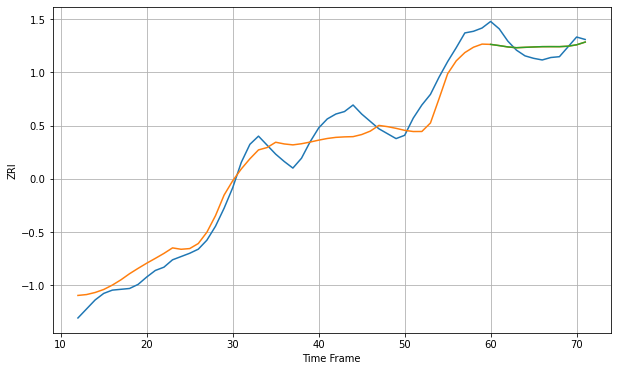

Wall time: 7.02 s
98203 18.48925307392149 13.69578690519454 13.702801128448211 [1513.01311951 1511.54089484 1509.92501992 1508.96662719 1509.44413944
 1509.86204317 1510.24805055 1510.29498576 1510.25645279 1510.81820312
 1512.5222751  1515.87030694]

Got an mse at 0.0099 in round 51 and stopped training

60 60 12


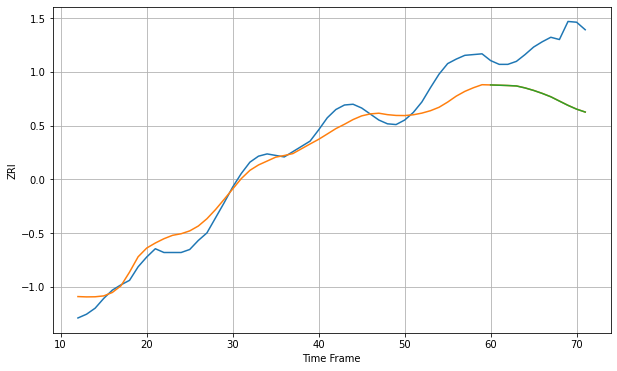

Wall time: 8.48 s
98204 21.59817913033458 73.19463774002767 73.233198332423 [1409.65508146 1409.27386217 1408.87452868 1408.29301737 1405.68348846
 1402.35554734 1398.40149462 1393.90862302 1388.18003602 1382.50091931
 1377.47232615 1373.63701341]

Got an mse at 0.0097 in round 20 and stopped training

60 60 12


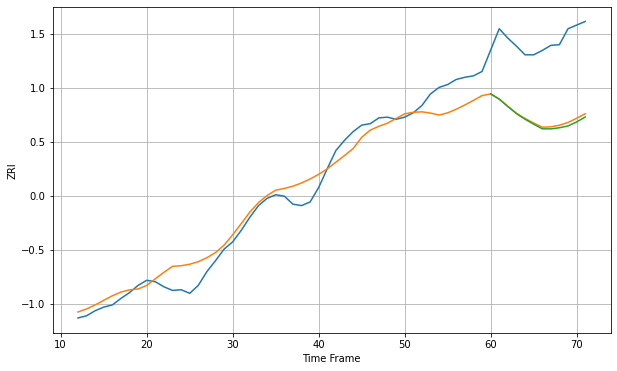

Wall time: 6.22 s
98405 20.80043119737691 105.1509043621043 107.61310275038525 [1212.10336372 1204.87525359 1194.73925319 1184.90317685 1177.16238949
 1170.33939676 1163.92230158 1163.85211687 1165.36841106 1167.89619559
 1173.36557068 1180.21004016]

Got an mse at 0.0100 in round 60 and stopped training

60 60 12


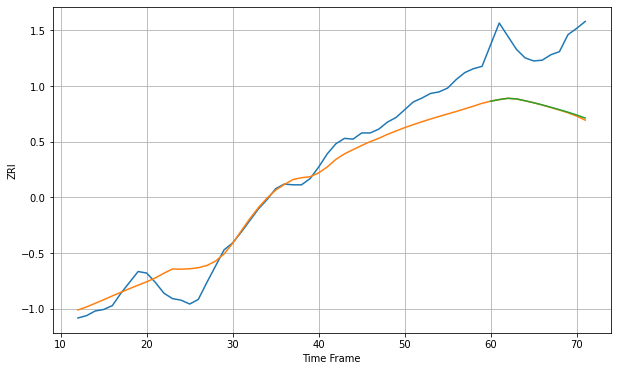

Wall time: 8.19 s
98409 23.204748760744756 83.95667459980474 83.29643044516196 [1221.00885789 1223.10618406 1224.75626805 1223.9672755  1221.61541735
 1219.07639823 1216.23584771 1213.19341904 1210.06829109 1206.81591471
 1203.23678051 1199.25891531]

Got an mse at 0.0097 in round 18 and stopped training

60 60 12


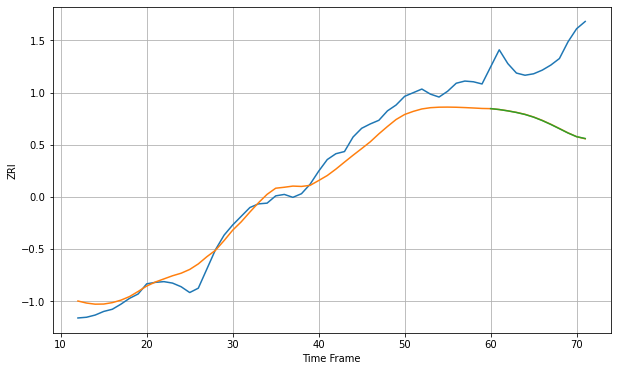

Wall time: 6.62 s
98444 19.156961677974937 94.92158934695114 94.97828917505271 [1192.05780792 1190.80200714 1188.97021895 1186.77254302 1184.01976999
 1180.33315485 1175.68060378 1170.3024353  1164.45832723 1158.52724531
 1153.45171909 1150.93810793]

Got an mse at 0.0099 in round 75 and stopped training

60 60 12


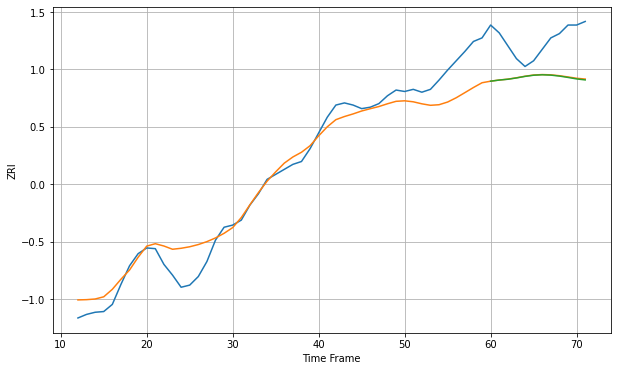

Wall time: 7.68 s
98466 26.463363284940893 56.808277916937534 57.256445170093414 [1332.42179863 1333.98842444 1335.12018359 1336.95119535 1339.11567698
 1340.76681338 1341.36855335 1340.90218975 1339.56052722 1337.66400359
 1335.58538447 1334.1851622 ]

Got an mse at 0.0099 in round 60 and stopped training

60 60 12


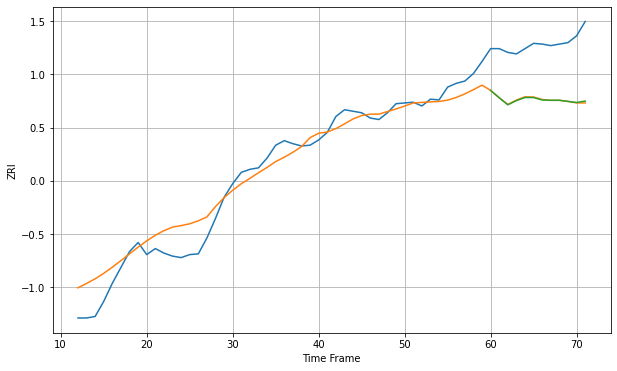

Wall time: 8.43 s
98498 21.777109832220994 74.6177971318269 74.51853175217272 [1347.63069514 1337.791938   1328.57723379 1334.0837268  1338.24197816
 1338.12870776 1334.90966903 1334.5153258  1334.62172689 1332.99905405
 1331.6244577  1333.47208173]

Got an mse at 0.0100 in round 57 and stopped training

60 60 12


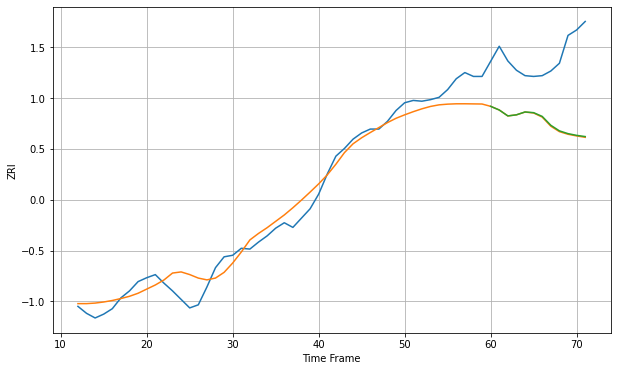

Wall time: 7.43 s
98499 18.37845144326878 89.51481287949508 88.94885049000669 [1241.37874298 1236.65268857 1228.99740599 1230.4069433  1234.11742309
 1233.20009843 1228.35282051 1216.91369773 1209.69873097 1206.11381475
 1203.89225775 1202.3180168 ]

Got an mse at 0.0100 in round 52 and stopped training

60 60 12


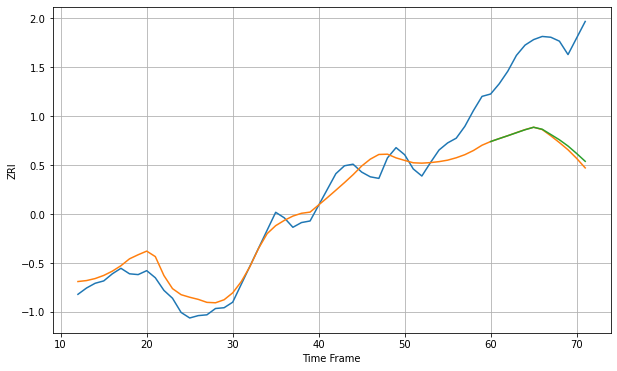

Wall time: 7.91 s
99207 19.625759503087163 117.98062004126564 115.3635336290478 [968.72832674 972.46771064 976.13260334 979.9142448  983.67684545
 986.82443059 984.31147434 977.6725388  970.94613476 963.03507106
 953.597034   943.64228824]

Got an mse at 0.0099 in round 118 and stopped training

60 60 12


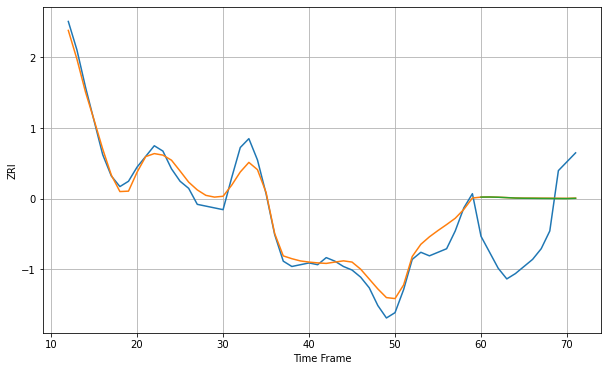

Wall time: 9.33 s
99501 6.063479377693409 31.770506732464472 31.746251249391648 [1265.07855352 1265.12467936 1265.00195634 1264.77510813 1264.53021955
 1264.43206816 1264.39977165 1264.34875656 1264.31747595 1264.26399482
 1264.23703267 1264.40554609]

Got an mse at 0.0099 in round 201 and stopped training

60 60 12


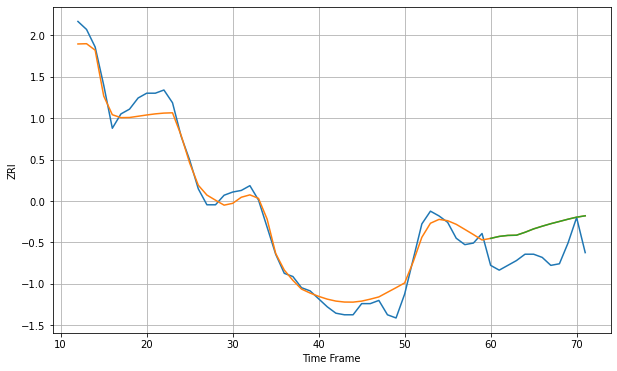

Wall time: 12.1 s
99504 7.342374466480996 18.95460998130202 18.952265561896393 [1432.92844898 1434.16456451 1434.78570421 1434.9152303  1436.75055762
 1438.87776028 1440.56914497 1442.14682259 1443.54224937 1444.9621502
 1446.23156605 1447.09442767]

Got an mse at 0.0100 in round 144 and stopped training

60 60 12


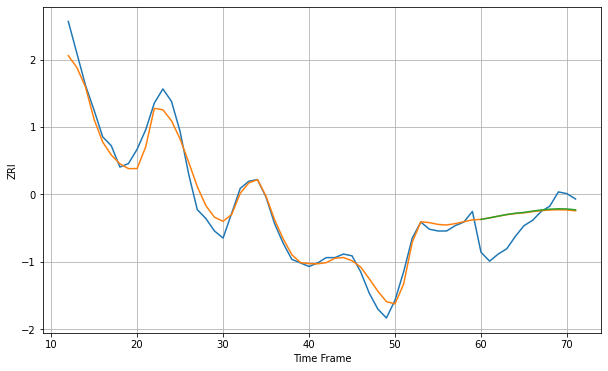

Wall time: 9.65 s
99508 6.204684629250335 13.648112582452905 13.611091834660535 [1274.53818212 1275.39155068 1276.36618523 1277.27992556 1277.97884285
 1278.45496639 1279.20495662 1279.82947796 1280.28421731 1280.48951496
 1280.40078927 1279.90456272]

Got an mse at 0.0096 in round 156 and stopped training

60 60 12


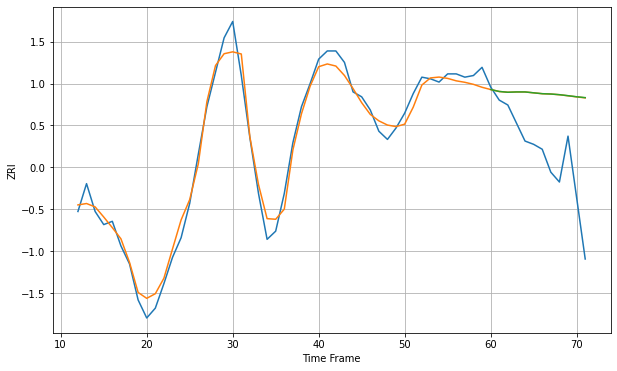

Wall time: 9.83 s
99654 7.084525902816032 43.450964925669076 43.50074298971448 [1327.45554295 1326.25911419 1325.78967667 1325.97579327 1325.97898087
 1325.44026525 1324.91112872 1324.71647502 1324.30747699 1323.68974214
 1323.04302508 1322.50939878]


In [13]:
score_dict = {"zip":[], "RMSE_train":[], "RMSE_test":[], "RMSE_pure":[], "forecast":[]};
with tf.device('/cpu:0'):
    for ZONE in zip_ids:
        %time M_train, M_test, M_pure, forecast = NN_test(ZONE, plot=True);
        print(ZONE, M_train, M_test, M_pure, forecast);

        score_dict["zip"].append(ZONE);
        score_dict["RMSE_train"].append(M_train);
        score_dict["RMSE_test"].append(M_test);
        score_dict["RMSE_pure"].append(M_pure);
        score_dict["forecast"].append(forecast);

In [14]:
print(len(score_dict["RMSE_pure"]), sum(score_dict["RMSE_test"])/len(score_dict["RMSE_test"]),
      sum(score_dict["RMSE_pure"])/len(score_dict["RMSE_pure"]));

1301 63.59484630044278 63.629666435008204


In [15]:
test = pd.DataFrame(score_dict);
test.head()

,zip,RMSE_train,RMSE_test,RMSE_pure,forecast
0,1013,12.452260,66.938795,67.112571,"[1101.395562865738, 1090.189479975954, 1081.72..."
1,1020,10.361150,70.351298,70.880812,"[1124.7026499199935, 1121.4394663327446, 1120...."
2,1040,10.922428,66.946505,66.956585,"[1093.8767490383862, 1088.0655783295265, 1080...."
3,1085,11.220729,60.681239,60.423925,"[1151.9278056994197, 1148.967934629387, 1145.9..."
4,1104,11.679768,53.270777,53.170955,"[1116.8483969627252, 1117.6335434902917, 1117...."


In [16]:
test.to_csv('NN_feature_window_12.csv', index = False)